In [1]:
import matplotlib.pyplot as plt
%matplotlib inline

import numpy as np
import torch
import torch.nn as nn
import torch.optim as optim
import torch.utils as utils
import torchvision.transforms as transforms

from torch.autograd import Variable

import os
import time

from PIL.Image import BICUBIC
from torchvision.datasets import MNIST
from ram import RecurrentAttentionModel
from trainer import *

### MNIST dataset
Testing out this model and training algorithm implementation on the basic MNIST dataset, which is pretty simple so hopefully everything goes well.

In [2]:
num_train_data_copies = 1  # Number of times to load the training dataset (with augmentation)
num_eval_data_copies = 1   # Number of times to load the evaluation dataset (with augmentation)
test_val_split = 0.5       # Percentage of the test set to use as validation data
batch_size = 20            # Batch size for training
eval_batch_size = 20       # Batch size for validation and testing

# Image parameters
num_classes = 10       # Digits 0-9
image_size = 28        # MNIST images are 28x28 b/w images
in_channels = 1        # Number of color channels in the inputs (MNIST dataset is grayscale)

glimpse_sizes = [8]  #[5, 10, 18]
padding = int(np.ceil(glimpse_sizes[-1] / 2))
padded_img_size = image_size + 2*padding

In [3]:
# Down/load MNIST data
mnist_data_loc = os.path.join('data', 'mnist')
data_transforms = transforms.Compose([ # Keep things pretty basic for now
    # Pad images with 0s so the GlimpseSensor won't have to
    transforms.Pad(padding = padding),
    # Converts a PIL Image or numpy.ndarray (H x W x C) in the range [0, 255]
    # to a torch.FloatTensor of shape (C x H x W) in the range [0.0, 1.0]
    transforms.ToTensor(),
])

'''
Can increase the number of images in each dataset by loading up the data again,
applying the (random) transformations, then concatenating it all together
'''
### Training Dataset and DataLoader
all_train_datasets = [
    MNIST(
        root = mnist_data_loc, train = True,
        download = True, transform = data_transforms
    ) for _ in range(num_train_data_copies)
]
train_datasets = utils.data.ConcatDataset(all_train_datasets)
train_data = utils.data.DataLoader(train_datasets, batch_size = batch_size, shuffle = True)
num_train_data = len(train_datasets)
num_train_batches = len(train_data)

### Validation and Test Dataset and DataLoader
all_eval_datasets = [
    MNIST(
        root = mnist_data_loc, train = False,
        download = True, transform = data_transforms
    ) for _ in range(num_eval_data_copies)
]
eval_datasets = utils.data.ConcatDataset(all_eval_datasets)
num_eval_data = len(eval_datasets)

eval_split_pt = int(test_val_split * num_eval_data)
eval_idx = list(range(num_eval_data))
np.random.shuffle(eval_idx)

val_idx, test_idx = eval_idx[:eval_split_pt], eval_idx[eval_split_pt:]

val_sampler = utils.data.sampler.SubsetRandomSampler(val_idx)
val_data = utils.data.DataLoader(
    eval_datasets, batch_size = eval_batch_size, sampler = val_sampler
)
num_val_data = len(val_sampler)
num_val_batches = len(val_data)

test_sampler = utils.data.sampler.SubsetRandomSampler(test_idx)
test_data = utils.data.DataLoader(
    eval_datasets, batch_size = eval_batch_size, sampler = test_sampler
)
num_test_data = len(test_sampler)
num_test_batches = len(test_data)

print('Num:\n- train data: %d (%d batches)\n- val data: %d (%d batches)\n- test data: %d (%d batches)' % (
    num_train_data, num_train_batches, num_val_data, num_val_batches, num_test_data, num_test_batches
))

Num:
- train data: 60000 (3000 batches)
- val data: 5000 (250 batches)
- test data: 5000 (250 batches)


In [4]:
# Basic training hyperparameters
lr = 1e-3
grad_clip = 2
lr_step_size = 1
steps_per_epoch = int(num_train_data_copies * 15)  # Number of times to step the lr scheduler in an epoch
decay_rate = 0.999

# RL training hyperparameters
end_train_ep_early = False     # End each training episode early after a correct classification
assert (end_train_ep_early and batch_size == 1) or not end_train_ep_early
max_ep_len = 6                 # Maximum number of glimpses per episode
num_epochs = 400               # Number of times to go through all of the training examples
early_stopping = int(num_epochs * 0.02)

random_start_loc = True
error_penalty = 0.  # Amount of penalty to apply each time the agent makes an incorrect classification (<= 0.)
gamma = 0.9         # Reward discount factor

# Etc
log_freq = num_train_batches // 10    # How often to print a training log in an epoch
viz_freq = num_train_batches // 5     # How often to visualize the glimpses in an epoch
eval_viz_freq = num_val_batches // 2  # How often to visualize the glimpses in an epoch

### Model
Need to modify class implementation so that any recurrent `nn.Module` instance can be passed in when initializing a new `RecurrentAttentionModel` to make it easier to try this visual attention mechanism out with different core recurrent networks.

In [5]:
# Model hyperparameters
glimpse_g_size = 128    # Size of the transformed Glimpse representation in the GlimpseNetwork
loc_g_size = 128        # Size of the transformed location representation in the GlimpseNetwork
glimpse_net_size = 256  # Size of the GlimpseNetwork output
rnn_state_size = 256
sensor_size = 8         # Size of the glimpses after resizing
g_rep_op = 'mul'

dropout = 0.0
# Standard deviation to use when sampling the glimpse location coordinates from a normal distribution
loc_std = 0.22

In [6]:
# Initialize the network
model = RecurrentAttentionModel(
    image_size = image_size, in_channels = in_channels,
    glimpse_g_size = glimpse_g_size, loc_g_size = loc_g_size,
    glimpse_net_size = glimpse_net_size, g_rep_op = g_rep_op,
    rnn_state_size = rnn_state_size, num_actions = num_classes,
    sensor_size = sensor_size, glimpse_sizes = glimpse_sizes,
    pad_imgs = False, padding = padding, dropout = dropout
)
num_parameters = sum([p.numel() for p in model.parameters()])
print('Model has %d parameters' % num_parameters)

# Criterion, optimizer, learning rate scheduler
class_criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(model.parameters(), lr = lr)
lr_scheduler = optim.lr_scheduler.ExponentialLR(optimizer, gamma = decay_rate)

Model has 547085 parameters


Epoch   1/400) lr = 0.001


H:\Users\Andrew\Anaconda3\envs\conda_jupyter\lib\site-packages\numpy\lib\nanfunctions.py:1315: RuntimeWarning: invalid value encountered in subtract
  np.subtract(arr, avg, out=arr, casting='unsafe')


 b    300/  3000 >> 148.6 ms/b | lr: 9.99e-04 | grad 2norm: 13.69 | grad inf norm: 11.966
         Weights || abs max:  0.40 (     inf) | mean: -5.65e-04 (  inf) | var: 2.02e-03 (     nan)
          Biases || abs max:  0.14 ( 2718.82) | mean:  1.18e-02 ( 1.96) | var: 4.34e-04 (278048.25)
                    class loss: 2.014 | steps: 4.538 | reward:  1.373 | acc.: 29.17%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 130.6 ms/b | lr: 9.98e-04 | grad 2norm: 15.44 | grad inf norm:  9.980
         Weights || abs max:  0.46 ( 8108.41) | mean: -9.22e-04 ( 0.03) | var: 4.43e-03 ( 8899.20)
          Biases || abs max:  0.38 ( 1033.32) | mean:  1.77e-02 ( 1.08) | var: 1.09e-03 (52020.14)
                    class loss: 1.704 | steps: 4.156 | reward:  1.885 | acc.: 41.83%

	Target class: 9 | Discounted rewards: [0.000, 0.000, 0.000, 0.000, 0.000, 0.000]
	                | Baseline rewards:   [0.468, 0.630, 0.968, 1.162, 0.88

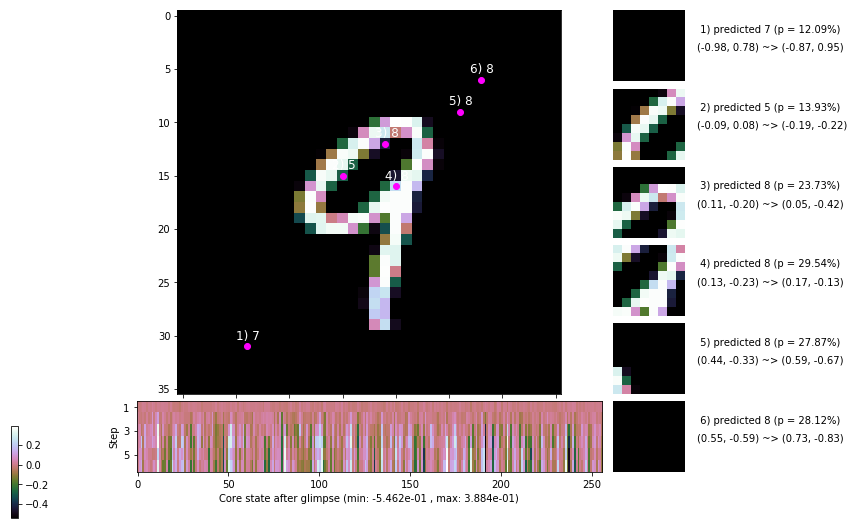

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 145.3 ms/b | lr: 9.96e-04 | grad 2norm: 17.58 | grad inf norm:  9.739
         Weights || abs max:  0.58 ( 4104.55) | mean: -1.04e-03 ( 0.02) | var: 5.99e-03 (  550.97)
          Biases || abs max:  0.60 ( 1938.14) | mean:  1.83e-02 ( 1.71) | var: 1.58e-03 (557231.81)
                    class loss: 1.464 | steps: 3.951 | reward:  2.174 | acc.: 48.40%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 172.4 ms/b | lr: 9.95e-04 | grad 2norm: 17.59 | grad inf norm:  8.383
         Weights || abs max:  0.66 ( 2702.33) | mean: -1.04e-03 ( 0.02) | var: 7.06e-03 (  108.20)
          Biases || abs max:  0.80 (  331.02) | mean:  1.77e-02 ( 0.44) | var: 2.04e-03 ( 4021.57)
                    class loss: 1.377 | steps: 3.762 | reward:  2.404 | acc.: 51.60%

	Target class: 2 | Discounted rewards: [2.786, 3.095, 3.

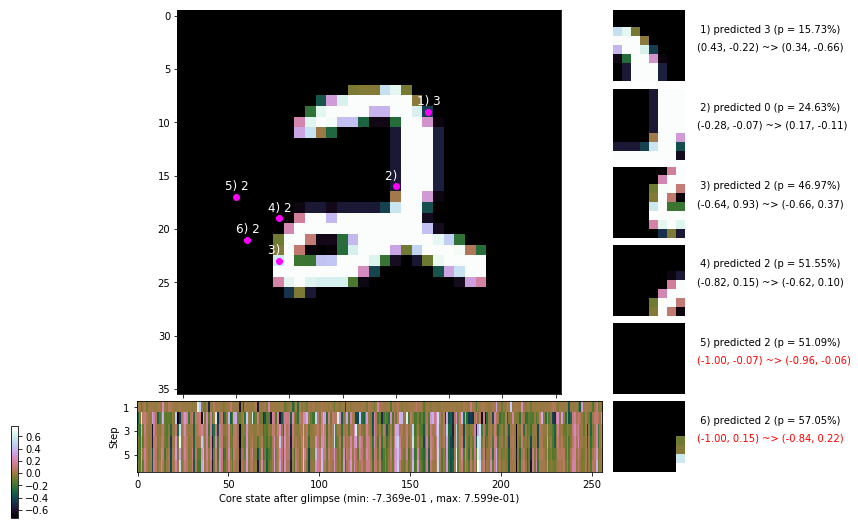

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 196.0 ms/b | lr: 9.93e-04 | grad 2norm: 17.54 | grad inf norm:  7.444
         Weights || abs max:  0.71 ( 3957.41) | mean: -1.11e-03 ( 0.02) | var: 7.95e-03 (  396.66)
          Biases || abs max:  0.96 (  377.78) | mean:  1.62e-02 ( 0.44) | var: 2.56e-03 (  812.58)
                    class loss: 1.337 | steps: 3.715 | reward:  2.448 | acc.: 52.07%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 160.5 ms/b | lr: 9.92e-04 | grad 2norm: 17.65 | grad inf norm:  7.064
         Weights || abs max:  0.73 ( 7968.91) | mean: -1.14e-03 ( 0.03) | var: 8.69e-03 (14743.47)
          Biases || abs max:  1.10 (  603.62) | mean:  1.40e-02 ( 0.62) | var: 3.03e-03 ( 6572.12)
                    class loss: 1.322 | steps: 3.635 | reward:  2.530 | acc.: 53.12%

	Target class: 6 | Discounted rewards: [3.686, 4.095, 3.4

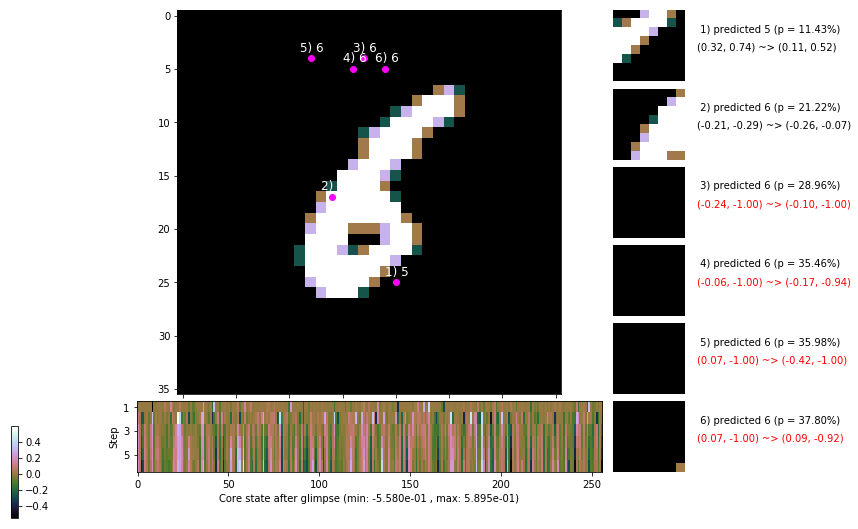

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 134.5 ms/b | lr: 9.90e-04 | grad 2norm: 18.57 | grad inf norm:  6.577
         Weights || abs max:  0.75 ( 2477.28) | mean: -1.12e-03 ( 0.02) | var: 9.34e-03 (  111.85)
          Biases || abs max:  1.22 (  327.85) | mean:  1.25e-02 ( 0.44) | var: 3.55e-03 (  702.31)
                    class loss: 1.257 | steps: 3.514 | reward:  2.680 | acc.: 55.87%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 140.7 ms/b | lr: 9.89e-04 | grad 2norm: 18.64 | grad inf norm:  6.195
         Weights || abs max:  0.83 ( 9387.08) | mean: -1.15e-03 ( 0.03) | var: 9.96e-03 (14798.69)
          Biases || abs max:  1.32 (  716.76) | mean:  1.02e-02 ( 0.77) | var: 4.03e-03 (15289.37)
                    class loss: 1.237 | steps: 3.479 | reward:  2.740 | acc.: 55.87%

	Target class: 0 | Discounted rewards: [0.000, 0.000, 0.0

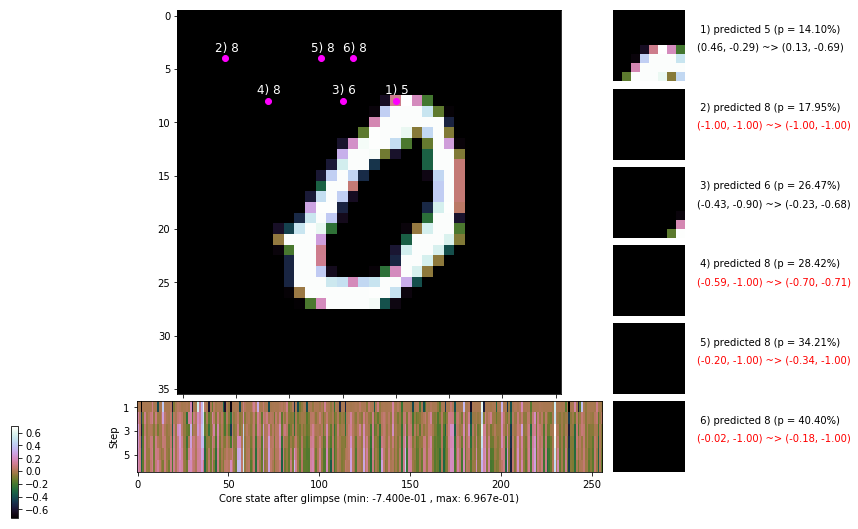

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 141.7 ms/b | lr: 9.87e-04 | grad 2norm: 18.83 | grad inf norm:  6.281
         Weights || abs max:  0.86 ( 3765.02) | mean: -1.12e-03 ( 0.02) | var: 1.05e-02 (  456.44)
          Biases || abs max:  1.40 (  229.69) | mean:  7.96e-03 ( 0.36) | var: 4.48e-03 (  291.23)
                    class loss: 1.263 | steps: 3.552 | reward:  2.661 | acc.: 55.17%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 148.0 ms/b | lr: 9.86e-04 | grad 2norm: 18.76 | grad inf norm:  6.579
         Weights || abs max:  0.89 ( 7135.16) | mean: -1.06e-03 ( 0.02) | var: 1.10e-02 (10760.50)
          Biases || abs max:  1.47 (  339.96) | mean:  5.54e-03 ( 0.39) | var: 4.94e-03 (  869.34)
                    class loss: 1.230 | steps: 3.468 | reward:  2.735 | acc.: 55.70%

	Target class: 3 | Discounted rewards: [1.976, 2.195, 2.4

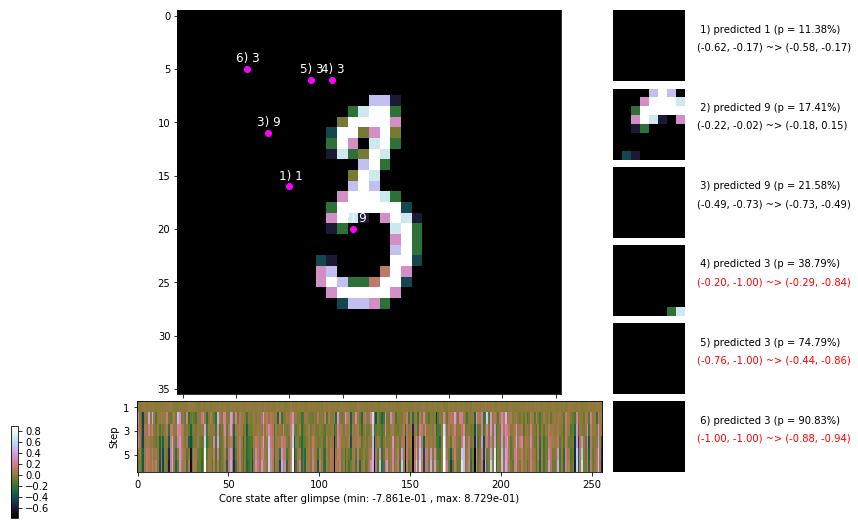

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 7 | Discounted rewards: [0.590, 0.656, 0.729, 0.810, 0.900, 1.000]


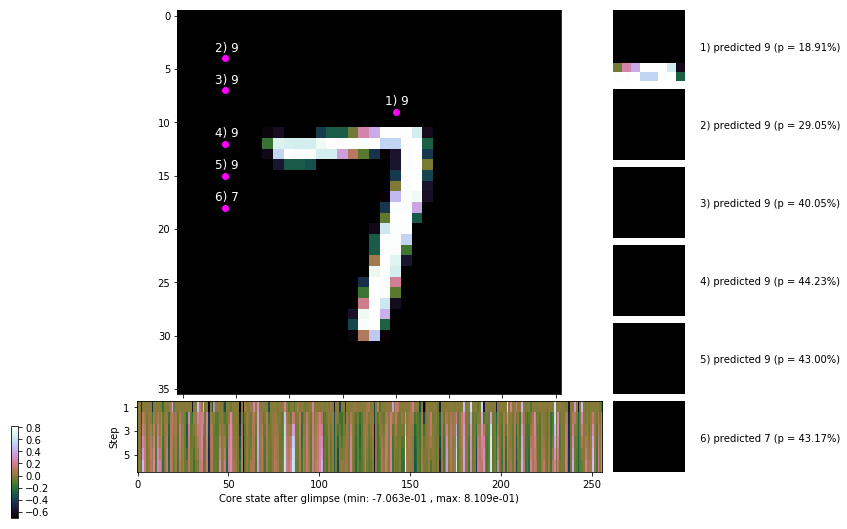


	Target class: 8 | Discounted rewards: [3.686, 4.095, 3.439, 2.710, 1.900, 1.000]


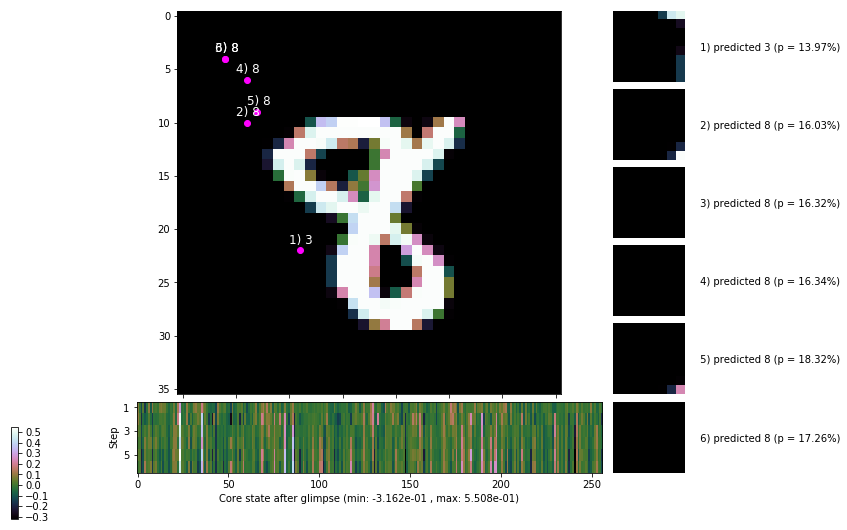

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


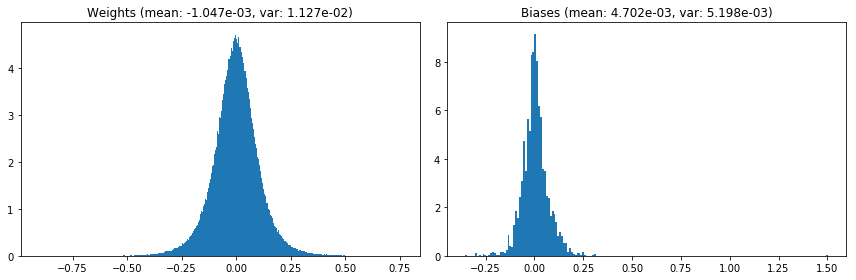

                                      Location network weights and biases


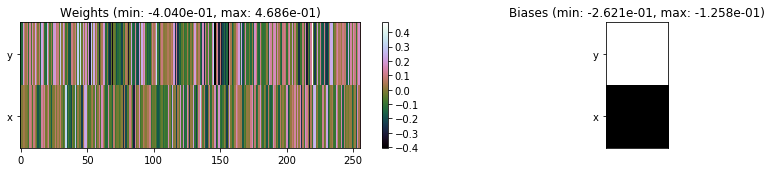

---------------------------------------------------------------------------------------------------------------
Elapsed time:  456.02 sec | TRAIN >> class loss: 1.4204 | steps:  3.777    | reward:  2.3631    | acc.: 49.878% 
                          | VAL   >> class loss: 1.1962 | steps:  3.359    | reward:  2.8814    | acc.: 56.940% 


Epoch   2/400) lr = 0.0009851
 b    300/  3000 >> 151.8 ms/b | lr: 9.84e-04 | grad 2norm: 18.83 | grad inf norm:  6.271
         Weights || abs max:  0.93 ( 6659.64) | mean: -1.05e-03 ( 0.02) | var: 1.15e-02 ( 7405.88)
          Biases || abs max:  1.54 (  386.36) | mean:  3.75e-03 ( 0.44) | var: 5.46e-03 ( 3646.53)
                    class loss: 1.196 | steps: 3.469 | reward:  2.774 | acc.: 57.63%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 156.7 ms/b | lr: 9.83e-04 | grad 2norm: 19.29 | grad inf norm:  6.068
         Weights || abs max:  0.96 ( 6731.11) | mean: -1.05e-03 ( 0.0

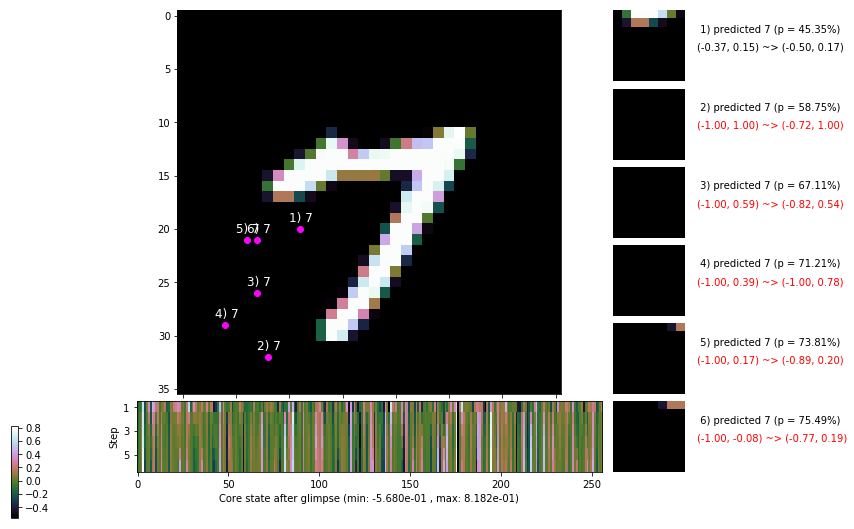

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 160.7 ms/b | lr: 9.81e-04 | grad 2norm: 19.21 | grad inf norm:  6.262
         Weights || abs max:  0.96 ( 4518.99) | mean: -1.06e-03 ( 0.02) | var: 1.25e-02 ( 1127.39)
          Biases || abs max:  1.63 (  547.99) | mean:  9.46e-04 ( 0.49) | var: 6.39e-03 ( 6753.00)
                    class loss: 1.196 | steps: 3.450 | reward:  2.805 | acc.: 57.70%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 156.0 ms/b | lr: 9.80e-04 | grad 2norm: 19.25 | grad inf norm:  6.016
         Weights || abs max:  0.98 ( 2831.58) | mean: -1.10e-03 ( 0.02) | var: 1.29e-02 (  176.02)
          Biases || abs max:  1.66 (  388.38) | mean: -2.30e-03 ( 0.39) | var: 6.93e-03 (  985.91)
                    class loss: 1.206 | steps: 3.454 | reward:  2.786 | acc.: 56.62%

	Target class: 9 | Discounted rewards: [2.195, 2.439, 2.7

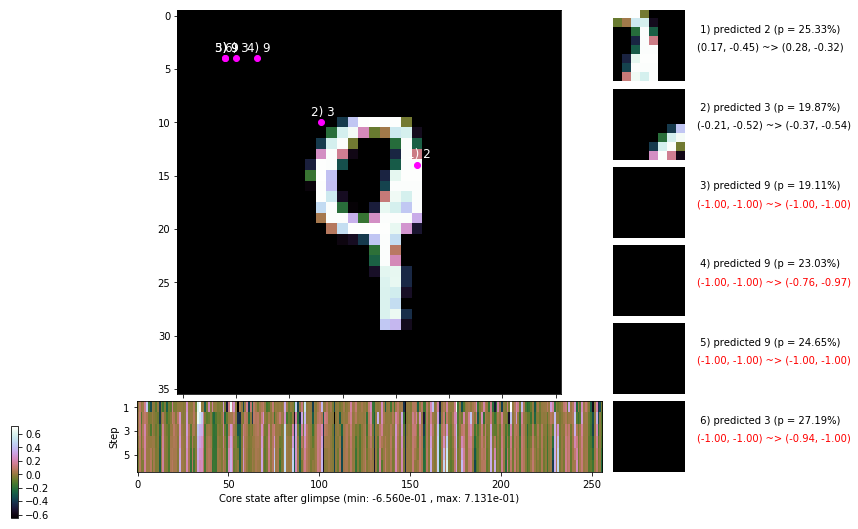

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 161.0 ms/b | lr: 9.78e-04 | grad 2norm: 19.33 | grad inf norm:  6.003
         Weights || abs max:  0.99 ( 3786.70) | mean: -1.08e-03 ( 0.02) | var: 1.33e-02 (  476.77)
          Biases || abs max:  1.69 (  217.41) | mean: -3.90e-03 ( 0.31) | var: 7.35e-03 (  208.69)
                    class loss: 1.200 | steps: 3.438 | reward:  2.794 | acc.: 56.92%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 161.9 ms/b | lr: 9.77e-04 | grad 2norm: 19.78 | grad inf norm:  6.182
         Weights || abs max:  1.00 ( 4498.26) | mean: -1.05e-03 ( 0.02) | var: 1.37e-02 ( 1591.47)
          Biases || abs max:  1.71 (  784.10) | mean: -5.07e-03 ( 0.75) | var: 7.77e-03 (32969.90)
                    class loss: 1.190 | steps: 3.412 | reward:  2.813 | acc.: 56.45%

	Target class: 3 | Discounted rewards: [1.976, 2.195, 2.4

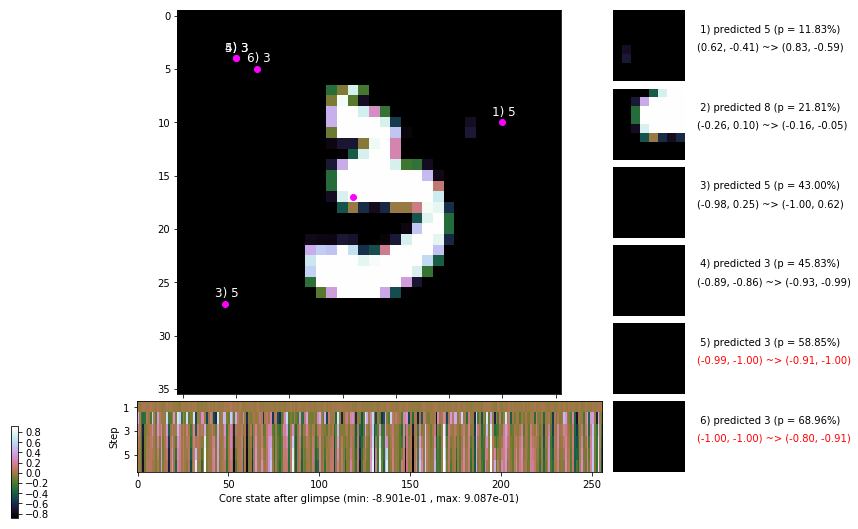

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 163.1 ms/b | lr: 9.75e-04 | grad 2norm: 19.66 | grad inf norm:  6.056
         Weights || abs max:  1.02 ( 3297.08) | mean: -1.06e-03 ( 0.02) | var: 1.41e-02 (  343.42)
          Biases || abs max:  1.73 (  222.47) | mean: -6.60e-03 ( 0.23) | var: 8.25e-03 (  454.42)
                    class loss: 1.200 | steps: 3.432 | reward:  2.798 | acc.: 56.27%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 161.1 ms/b | lr: 9.74e-04 | grad 2norm: 19.74 | grad inf norm:  6.270
         Weights || abs max:  1.02 ( 3341.67) | mean: -1.07e-03 ( 0.02) | var: 1.45e-02 (  292.32)
          Biases || abs max:  1.74 (  583.91) | mean: -8.71e-03 ( 0.46) | var: 8.71e-03 ( 7914.76)
                    class loss: 1.205 | steps: 3.395 | reward:  2.815 | acc.: 55.95%

	Target class: 0 | Discounted rewards: [3.686, 4.095, 3.4

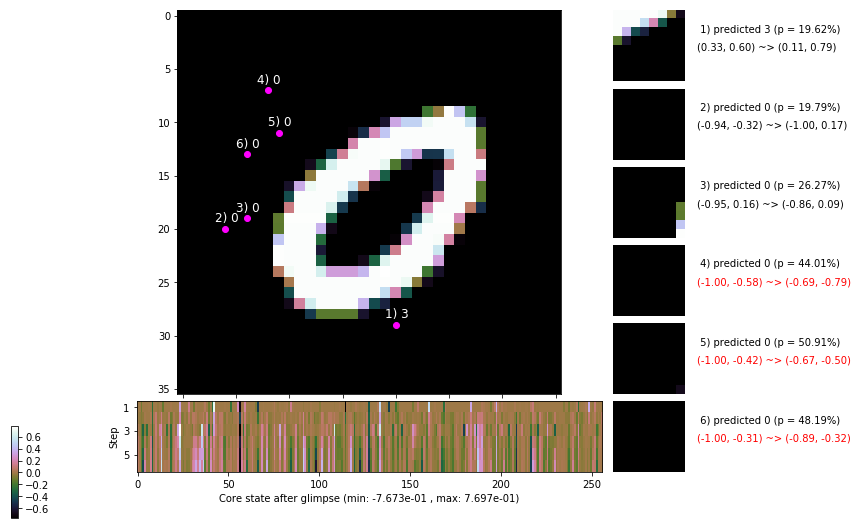

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 153.8 ms/b | lr: 9.72e-04 | grad 2norm: 20.03 | grad inf norm:  6.282
         Weights || abs max:  1.02 (35884.20) | mean: -1.10e-03 ( 0.08) | var: 1.49e-02 (549382.19)
          Biases || abs max:  1.75 (  312.71) | mean: -9.69e-03 ( 0.32) | var: 9.09e-03 ( 1268.63)
                    class loss: 1.212 | steps: 3.445 | reward:  2.775 | acc.: 55.78%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 154.3 ms/b | lr: 9.71e-04 | grad 2norm: 19.91 | grad inf norm:  6.029
         Weights || abs max:  1.04 ( 6188.54) | mean: -1.11e-03 ( 0.02) | var: 1.52e-02 ( 7470.53)
          Biases || abs max:  1.78 (  225.08) | mean: -1.04e-02 ( 0.28) | var: 9.51e-03 (  814.16)
                    class loss: 1.200 | steps: 3.406 | reward:  2.818 | acc.: 55.75%

	Target class: 7 | Discounted rewards: [4.686, 4.095, 3.

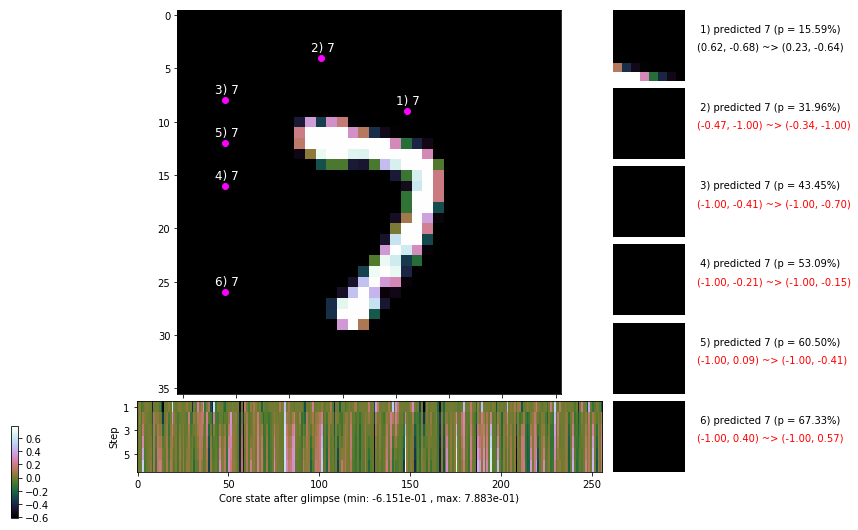

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 7 | Discounted rewards: [0.000, 0.000, 0.000, 0.000, 0.000, 0.000]


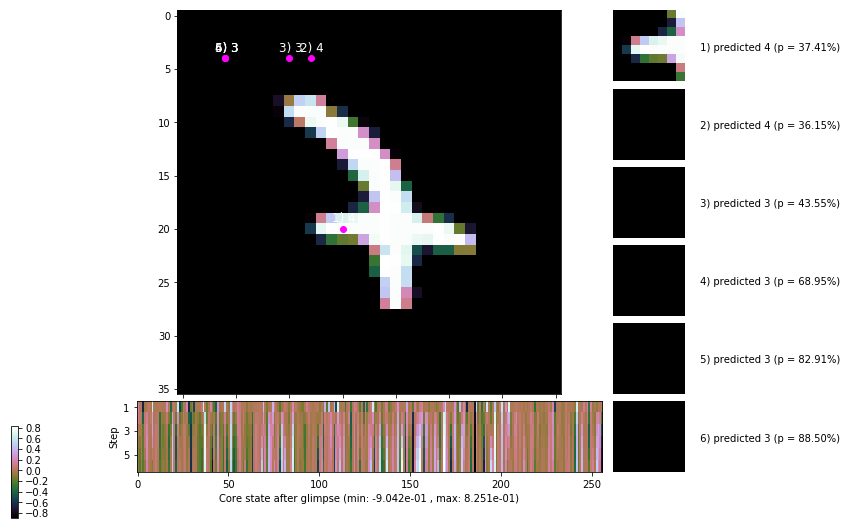


	Target class: 2 | Discounted rewards: [0.000, 0.000, 0.000, 0.000, 0.000, 0.000]


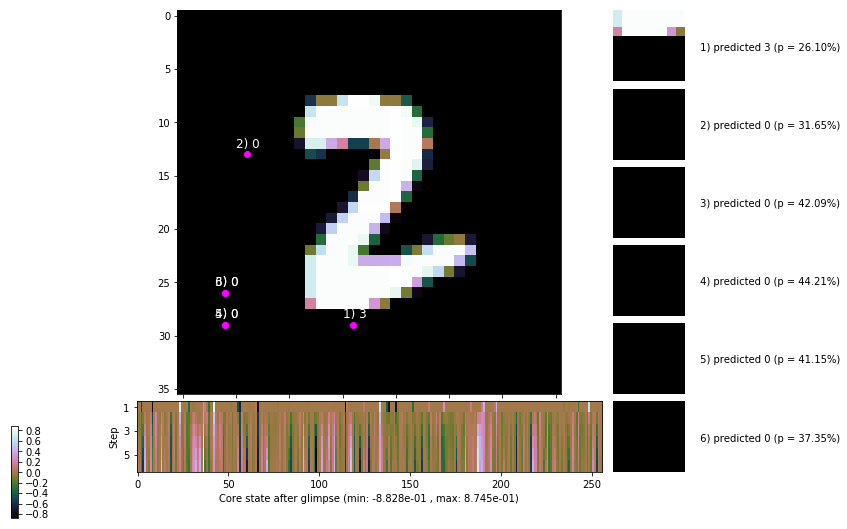

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


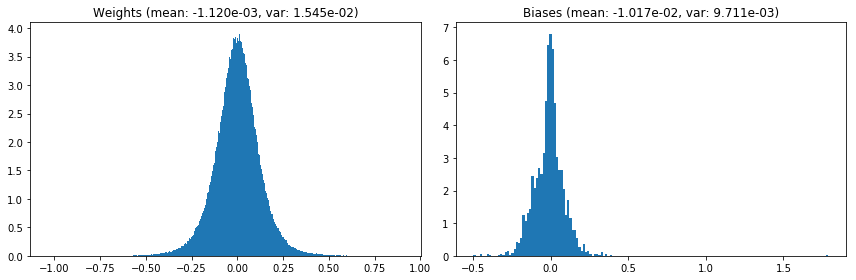

                                      Location network weights and biases


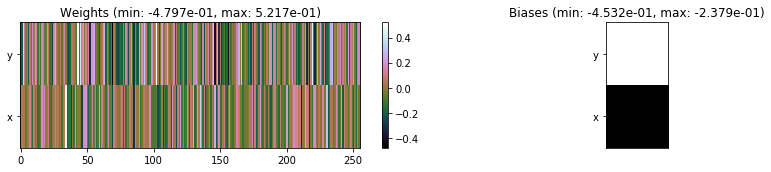

---------------------------------------------------------------------------------------------------------------
Elapsed time:  474.78 sec | TRAIN >> class loss: 1.2017 | steps:  3.438    | reward:  2.7919    | acc.: 56.470% 
                          | VAL   >> class loss: 1.2389 | steps:  3.346    | reward:  2.8506 :( | acc.: 53.740% :(


Epoch   3/400) lr = 0.0009704
 b    300/  3000 >> 152.6 ms/b | lr: 9.69e-04 | grad 2norm: 19.85 | grad inf norm:  6.250
         Weights || abs max:  1.04 ( 4373.04) | mean: -1.19e-03 ( 0.02) | var: 1.56e-02 ( 1185.06)
          Biases || abs max:  1.78 (  666.08) | mean: -1.19e-02 ( 0.46) | var: 9.94e-03 (20711.37)
                    class loss: 1.260 | steps: 3.474 | reward:  2.747 | acc.: 55.12%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 153.4 ms/b | lr: 9.68e-04 | grad 2norm: 19.72 | grad inf norm:  6.094
         Weights || abs max:  1.03 ( 3696.30) | mean: -1.20e-03 ( 0

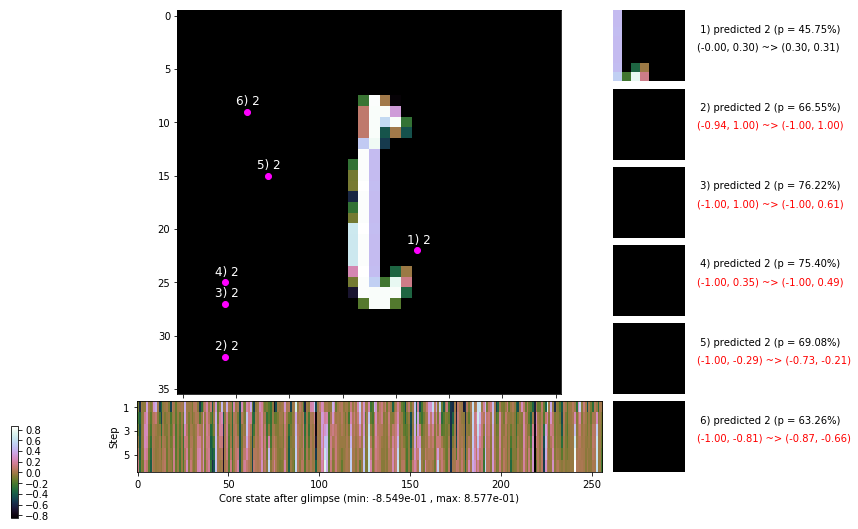

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 153.6 ms/b | lr: 9.67e-04 | grad 2norm: 19.66 | grad inf norm:  6.450
         Weights || abs max:  1.04 ( 2706.71) | mean: -1.17e-03 ( 0.01) | var: 1.63e-02 (  390.06)
          Biases || abs max:  1.77 (  427.70) | mean: -1.57e-02 ( 0.37) | var: 1.07e-02 ( 3512.08)
                    class loss: 1.313 | steps: 3.515 | reward:  2.682 | acc.: 52.95%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 153.9 ms/b | lr: 9.66e-04 | grad 2norm: 19.44 | grad inf norm:  5.978
         Weights || abs max:  1.06 ( 6453.81) | mean: -1.15e-03 ( 0.02) | var: 1.67e-02 ( 2842.50)
          Biases || abs max:  1.75 (  198.99) | mean: -1.77e-02 ( 0.25) | var: 1.12e-02 (  168.37)
                    class loss: 1.311 | steps: 3.542 | reward:  2.668 | acc.: 52.68%

	Target class: 5 | Discounted rewards: [0.000, 0.000, 0.0

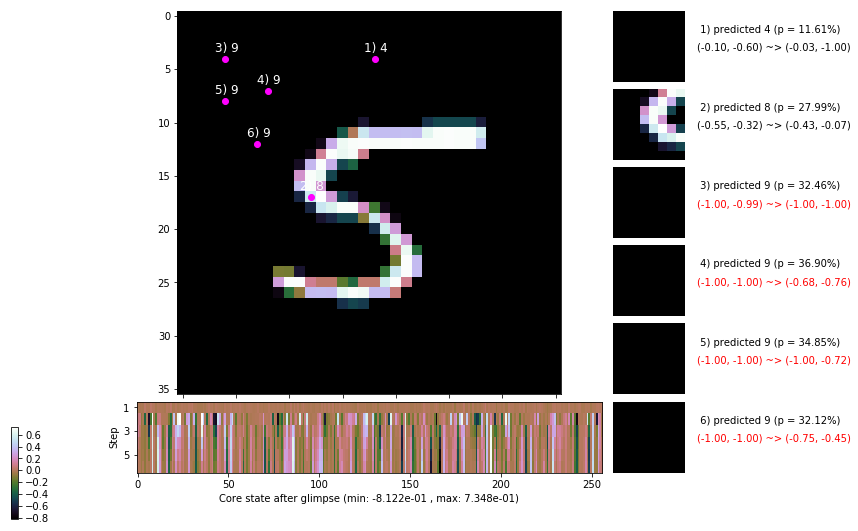

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 154.4 ms/b | lr: 9.64e-04 | grad 2norm: 18.92 | grad inf norm:  6.212
         Weights || abs max:  1.11 ( 2641.78) | mean: -1.14e-03 ( 0.01) | var: 1.71e-02 (  258.52)
          Biases || abs max:  1.73 (  457.03) | mean: -1.91e-02 ( 0.38) | var: 1.16e-02 ( 2534.36)
                    class loss: 1.366 | steps: 3.550 | reward:  2.651 | acc.: 51.57%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 152.2 ms/b | lr: 9.63e-04 | grad 2norm: 19.74 | grad inf norm:  6.160
         Weights || abs max:  1.13 ( 4190.31) | mean: -1.11e-03 ( 0.02) | var: 1.74e-02 ( 2916.82)
          Biases || abs max:  1.71 (  168.61) | mean: -2.05e-02 ( 0.23) | var: 1.20e-02 (  197.81)
                    class loss: 1.366 | steps: 3.584 | reward:  2.626 | acc.: 51.58%

	Target class: 4 | Discounted rewards: [0.000, 0.000, 0.0

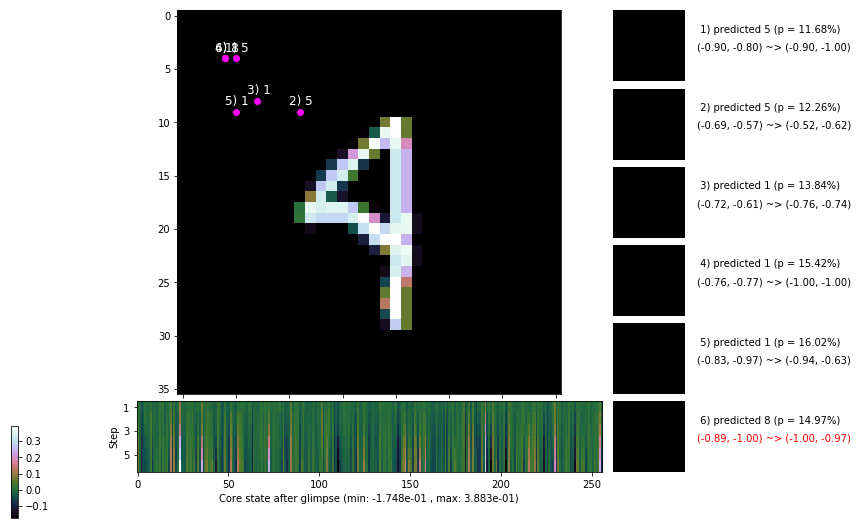

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 156.6 ms/b | lr: 9.61e-04 | grad 2norm: 19.75 | grad inf norm:  6.134
         Weights || abs max:  1.15 ( 2077.99) | mean: -1.18e-03 ( 0.01) | var: 1.78e-02 (   60.10)
          Biases || abs max:  1.68 (  252.09) | mean: -2.16e-02 ( 0.28) | var: 1.24e-02 (  733.39)
                    class loss: 1.390 | steps: 3.616 | reward:  2.549 | acc.: 49.47%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 158.8 ms/b | lr: 9.60e-04 | grad 2norm: 19.40 | grad inf norm:  6.075
         Weights || abs max:  1.16 ( 3204.35) | mean: -1.23e-03 ( 0.01) | var: 1.82e-02 ( 1073.98)
          Biases || abs max:  1.65 (  364.62) | mean: -2.34e-02 ( 0.37) | var: 1.28e-02 ( 2380.57)
                    class loss: 1.389 | steps: 3.605 | reward:  2.567 | acc.: 49.85%

	Target class: 7 | Discounted rewards: [4.686, 4.095, 3.4

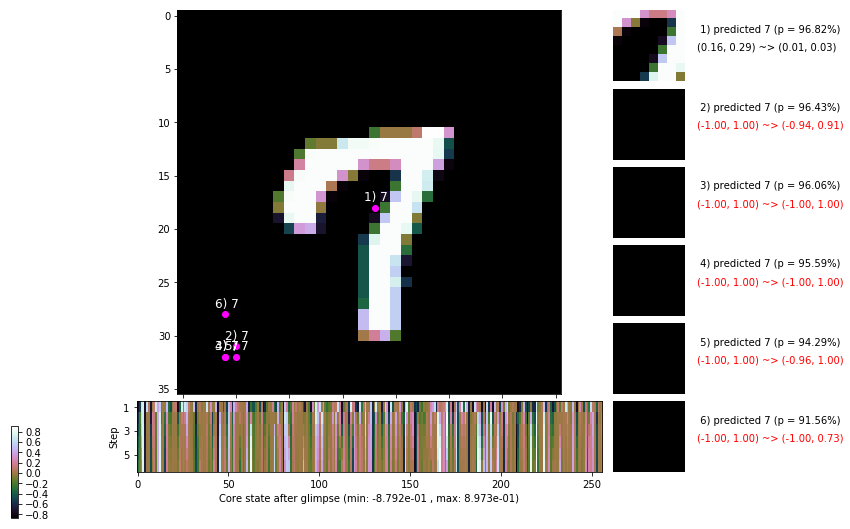

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 170.3 ms/b | lr: 9.58e-04 | grad 2norm: 19.71 | grad inf norm:  6.241
         Weights || abs max:  1.18 ( 1462.99) | mean: -1.21e-03 ( 0.01) | var: 1.85e-02 (   46.65)
          Biases || abs max:  1.64 (  211.51) | mean: -2.42e-02 ( 0.26) | var: 1.31e-02 (  387.18)
                    class loss: 1.399 | steps: 3.623 | reward:  2.539 | acc.: 48.72%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 174.1 ms/b | lr: 9.57e-04 | grad 2norm: 19.71 | grad inf norm:  6.071
         Weights || abs max:  1.21 ( 2591.59) | mean: -1.20e-03 ( 0.01) | var: 1.89e-02 (  417.87)
          Biases || abs max:  1.64 (  235.17) | mean: -2.55e-02 ( 0.29) | var: 1.35e-02 (  389.48)
                    class loss: 1.401 | steps: 3.618 | reward:  2.575 | acc.: 49.52%

	Target class: 3 | Discounted rewards: [0.000, 0.000, 0.0

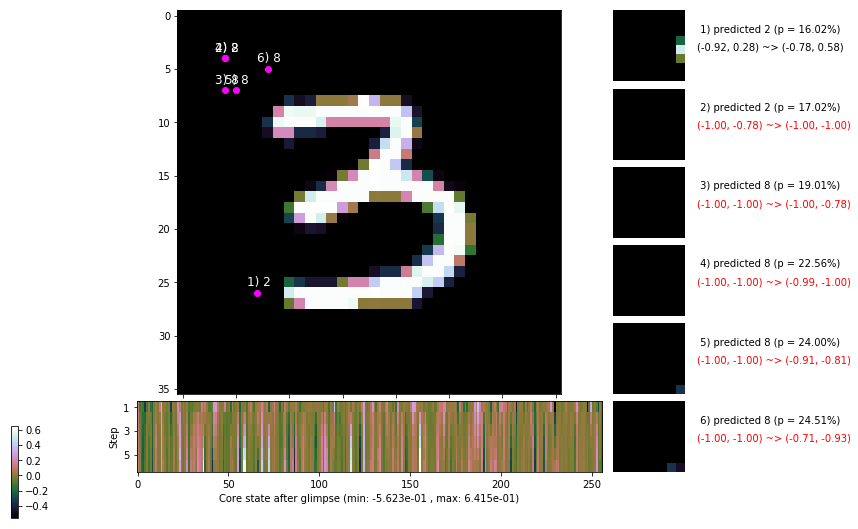

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 7 | Discounted rewards: [4.686, 4.095, 3.439, 2.710, 1.900, 1.000]


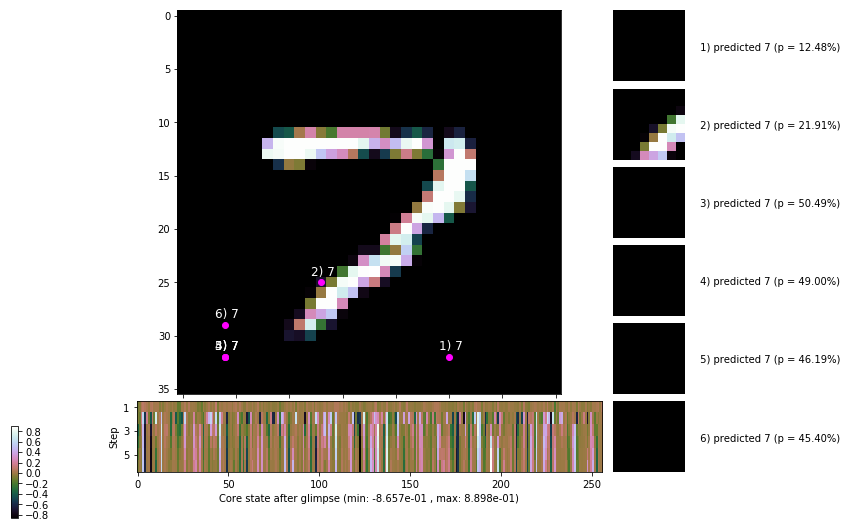


	Target class: 1 | Discounted rewards: [4.686, 4.095, 3.439, 2.710, 1.900, 1.000]


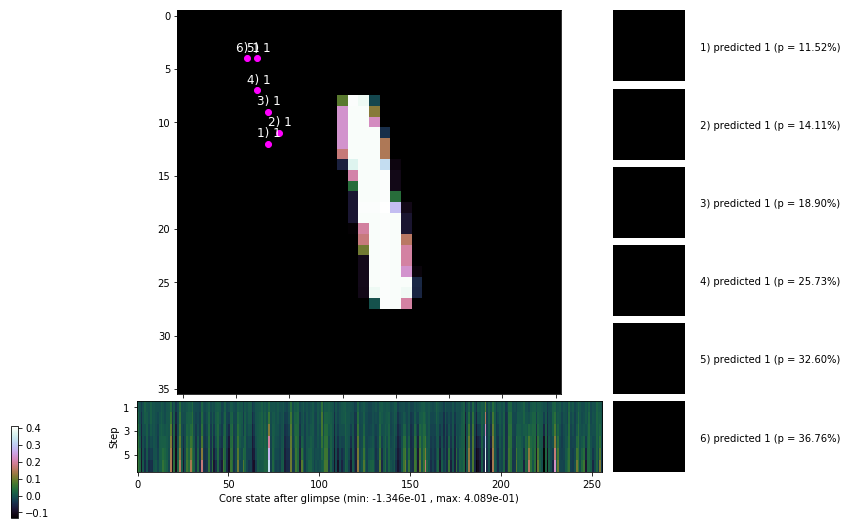

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


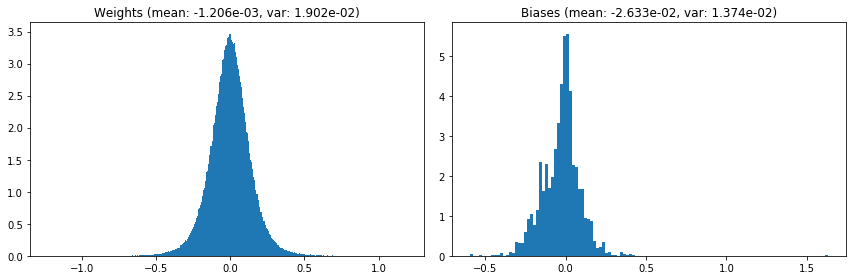

                                      Location network weights and biases


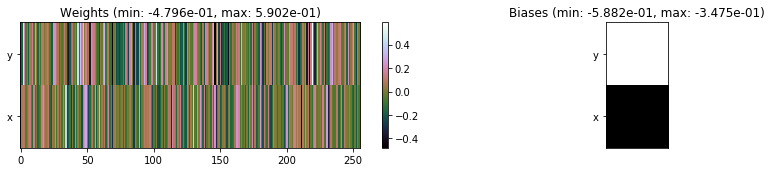

---------------------------------------------------------------------------------------------------------------
Elapsed time:  474.62 sec | TRAIN >> class loss: 1.3447 | steps:  3.558 :( | reward:  2.6354 :( | acc.: 51.588% :(
                          | VAL   >> class loss: 1.4392 | steps:  3.690 :( | reward:  2.5148 :( | acc.: 47.660% :(


Epoch   4/400) lr = 0.000956
 b    300/  3000 >> 162.8 ms/b | lr: 9.55e-04 | grad 2norm: 19.16 | grad inf norm:  6.127
         Weights || abs max:  1.23 ( 3200.08) | mean: -1.23e-03 ( 0.01) | var: 1.92e-02 ( 1475.79)
          Biases || abs max:  1.61 ( 2938.10) | mean: -2.74e-02 ( 1.34) | var: 1.38e-02 (831074.38)
                    class loss: 1.436 | steps: 3.680 | reward:  2.460 | acc.: 47.25%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 162.5 ms/b | lr: 9.54e-04 | grad 2norm: 19.34 | grad inf norm:  6.251
         Weights || abs max:  1.26 (13366.65) | mean: -1.19e-03 (

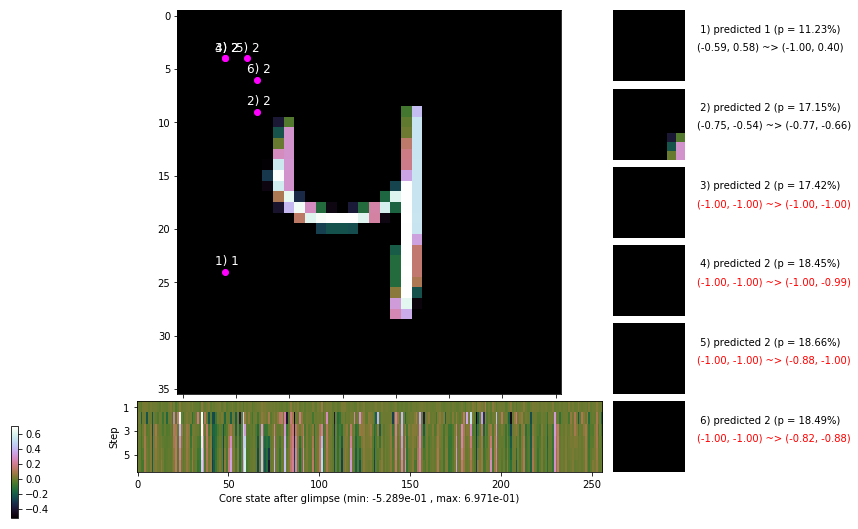

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 166.1 ms/b | lr: 9.52e-04 | grad 2norm: 18.69 | grad inf norm:  5.834
         Weights || abs max:  1.28 ( 1574.72) | mean: -1.18e-03 ( 0.01) | var: 1.99e-02 (   29.36)
          Biases || abs max:  1.57 (  282.94) | mean: -3.04e-02 ( 0.30) | var: 1.48e-02 (  595.06)
                    class loss: 1.468 | steps: 3.738 | reward:  2.440 | acc.: 46.78%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 165.5 ms/b | lr: 9.51e-04 | grad 2norm: 19.08 | grad inf norm:  6.179
         Weights || abs max:  1.29 ( 2581.56) | mean: -1.20e-03 ( 0.01) | var: 2.02e-02 (  335.98)
          Biases || abs max:  1.56 (  263.29) | mean: -3.22e-02 ( 0.25) | var: 1.52e-02 ( 1156.26)
                    class loss: 1.516 | steps: 3.761 | reward:  2.385 | acc.: 45.08%

	Target class: 3 | Discounted rewards: [3.686, 4.095, 3.4

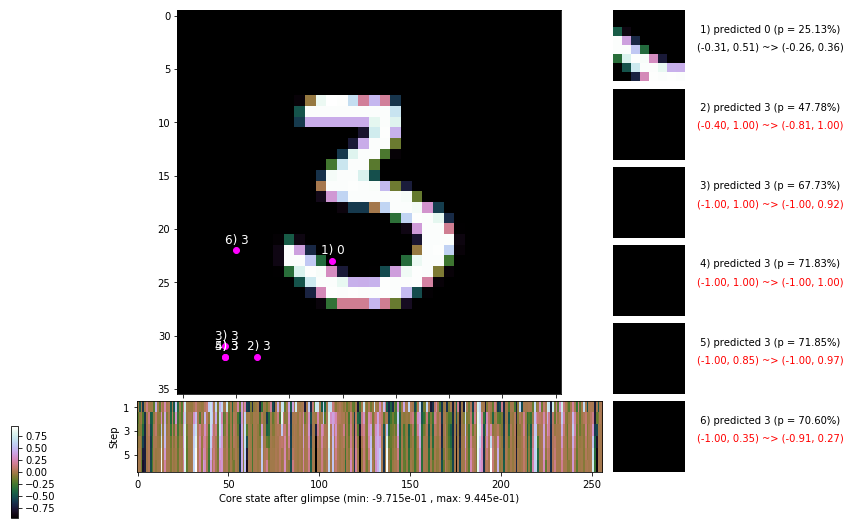

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 164.8 ms/b | lr: 9.49e-04 | grad 2norm: 18.77 | grad inf norm:  5.902
         Weights || abs max:  1.32 ( 2394.26) | mean: -1.17e-03 ( 0.01) | var: 2.05e-02 (  159.27)
          Biases || abs max:  1.53 (  151.47) | mean: -3.40e-02 ( 0.21) | var: 1.56e-02 (   71.49)
                    class loss: 1.502 | steps: 3.758 | reward:  2.398 | acc.: 45.70%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 161.3 ms/b | lr: 9.48e-04 | grad 2norm: 19.50 | grad inf norm:  6.168
         Weights || abs max:  1.33 ( 1513.41) | mean: -1.18e-03 ( 0.01) | var: 2.08e-02 (   22.79)
          Biases || abs max:  1.52 ( 4118.71) | mean: -3.50e-02 ( 1.79) | var: 1.59e-02 (1652971.00)
                    class loss: 1.493 | steps: 3.722 | reward:  2.458 | acc.: 46.95%

	Target class: 8 | Discounted rewards: [0.000, 0.000, 0

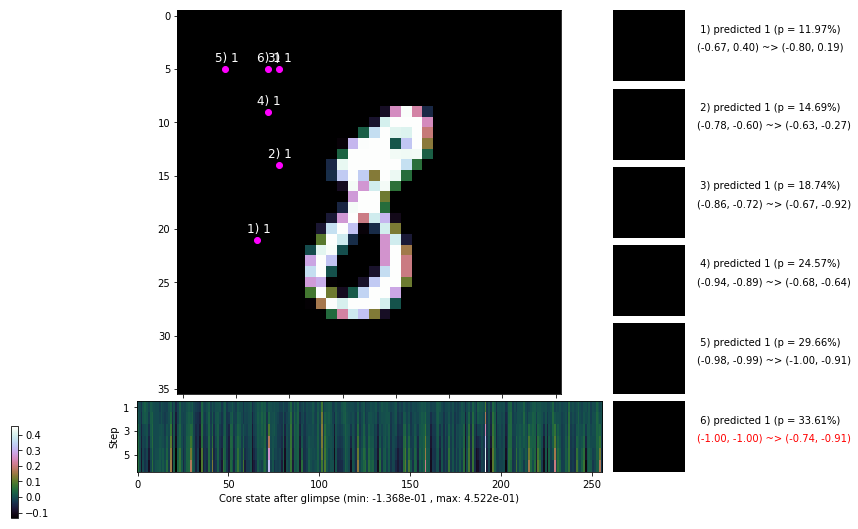

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 168.7 ms/b | lr: 9.46e-04 | grad 2norm: 19.21 | grad inf norm:  5.897
         Weights || abs max:  1.35 ( 1227.94) | mean: -1.17e-03 ( 0.01) | var: 2.11e-02 (   22.76)
          Biases || abs max:  1.51 (  413.98) | mean: -3.58e-02 ( 0.33) | var: 1.63e-02 ( 1629.49)
                    class loss: 1.476 | steps: 3.747 | reward:  2.433 | acc.: 46.12%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 163.2 ms/b | lr: 9.46e-04 | grad 2norm: 19.24 | grad inf norm:  6.221
         Weights || abs max:  1.34 ( 1722.67) | mean: -1.16e-03 ( 0.01) | var: 2.14e-02 (  129.81)
          Biases || abs max:  1.52 (  291.05) | mean: -3.71e-02 ( 0.31) | var: 1.67e-02 ( 3428.47)
                    class loss: 1.477 | steps: 3.714 | reward:  2.463 | acc.: 46.52%

	Target class: 4 | Discounted rewards: [0.000, 0.000, 0.0

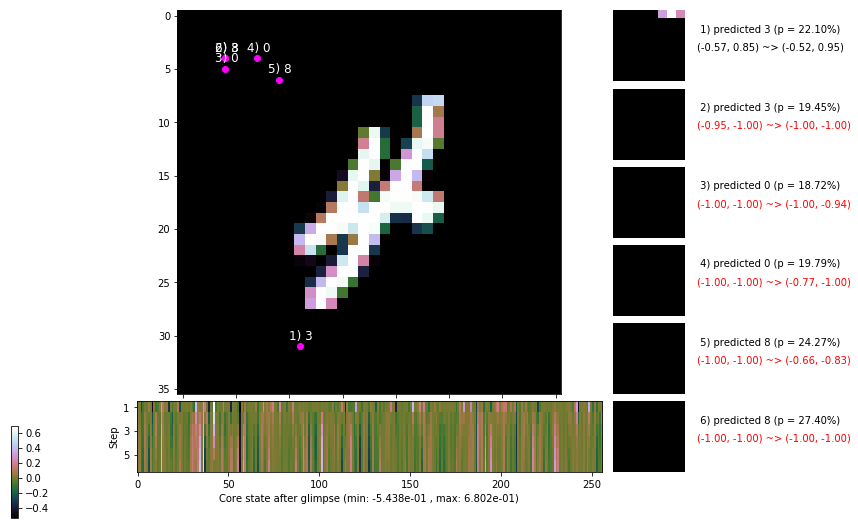

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 163.5 ms/b | lr: 9.44e-04 | grad 2norm: 19.28 | grad inf norm:  6.050
         Weights || abs max:  1.36 ( 2183.52) | mean: -1.15e-03 ( 0.01) | var: 2.18e-02 (   67.95)
          Biases || abs max:  1.52 (  223.77) | mean: -3.74e-02 ( 0.25) | var: 1.70e-02 (  165.74)
                    class loss: 1.476 | steps: 3.712 | reward:  2.450 | acc.: 45.90%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 162.1 ms/b | lr: 9.43e-04 | grad 2norm: 19.56 | grad inf norm:  6.295
         Weights || abs max:  1.38 ( 1976.23) | mean: -1.18e-03 ( 0.01) | var: 2.21e-02 (  145.73)
          Biases || abs max:  1.53 (  197.47) | mean: -3.76e-02 ( 0.23) | var: 1.74e-02 (  344.53)
                    class loss: 1.474 | steps: 3.724 | reward:  2.445 | acc.: 46.40%

	Target class: 9 | Discounted rewards: [1.247, 1.385, 1.5

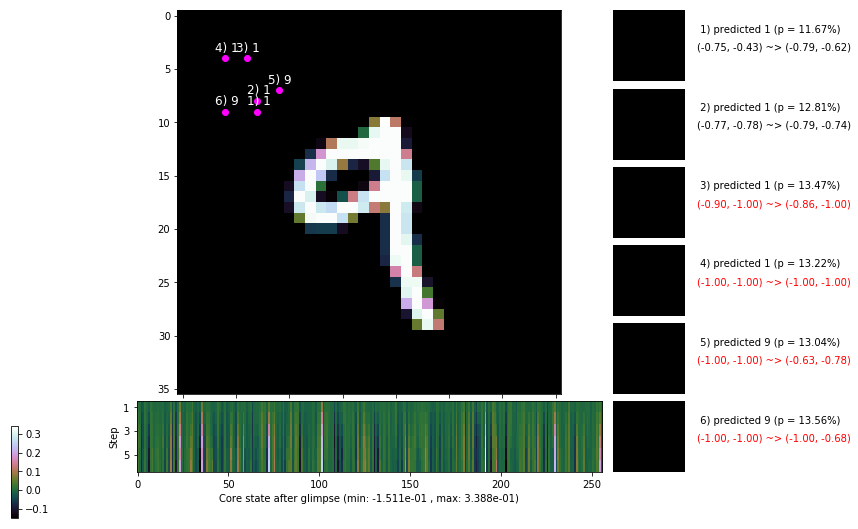

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 5 | Discounted rewards: [0.000, 0.000, 0.000, 0.000, 0.000, 0.000]


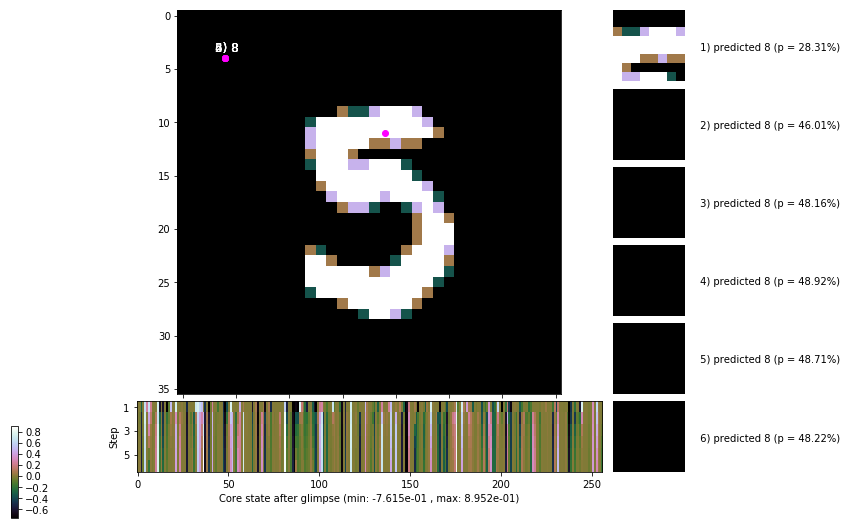


	Target class: 9 | Discounted rewards: [1.247, 1.385, 1.539, 1.710, 1.900, 1.000]


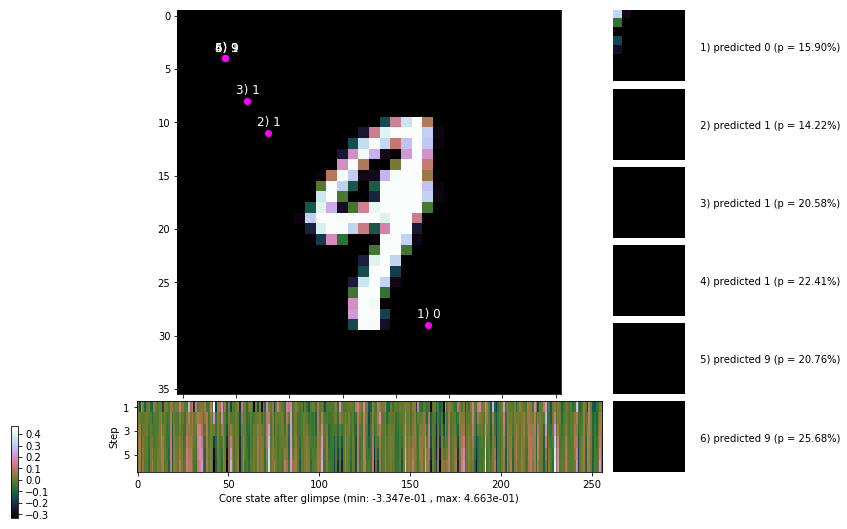

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


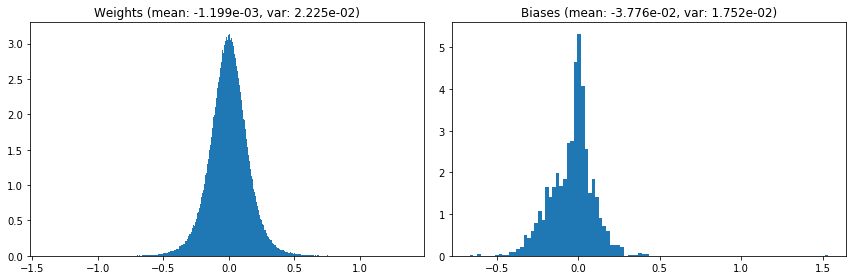

                                      Location network weights and biases


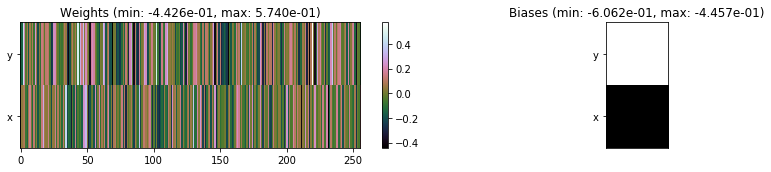

---------------------------------------------------------------------------------------------------------------
Elapsed time:  492.86 sec | TRAIN >> class loss: 1.4802 | steps:  3.727 :( | reward:  2.4360 :( | acc.: 46.325% :(
                          | VAL   >> class loss: 1.4575 | steps:  3.675 :( | reward:  2.5144 :( | acc.: 46.980% :(


Epoch   5/400) lr = 0.0009417
 b    300/  3000 >> 160.1 ms/b | lr: 9.41e-04 | grad 2norm: 19.90 | grad inf norm:  6.287
         Weights || abs max:  1.39 ( 1295.82) | mean: -1.19e-03 ( 0.01) | var: 2.24e-02 (   39.54)
          Biases || abs max:  1.53 (  818.07) | mean: -3.82e-02 ( 0.45) | var: 1.77e-02 (45209.42)
                    class loss: 1.428 | steps: 3.645 | reward:  2.549 | acc.: 48.37%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 161.0 ms/b | lr: 9.40e-04 | grad 2norm: 19.53 | grad inf norm:  6.178
         Weights || abs max:  1.41 ( 2125.39) | mean: -1.20e-03 (

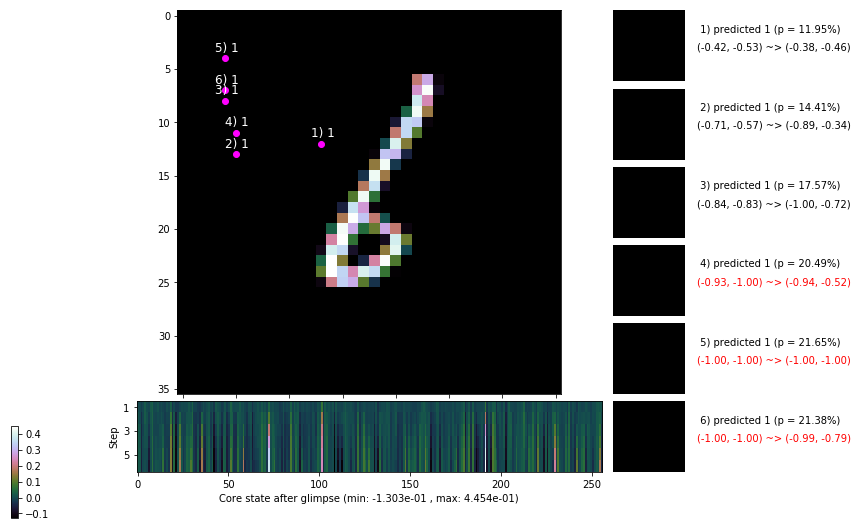

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 163.7 ms/b | lr: 9.38e-04 | grad 2norm: 19.36 | grad inf norm:  5.889
         Weights || abs max:  1.43 ( 1311.28) | mean: -1.20e-03 ( 0.01) | var: 2.30e-02 (   25.46)
          Biases || abs max:  1.52 (  148.51) | mean: -4.06e-02 ( 0.20) | var: 1.85e-02 (  173.43)
                    class loss: 1.436 | steps: 3.700 | reward:  2.486 | acc.: 47.32%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 162.4 ms/b | lr: 9.37e-04 | grad 2norm: 19.00 | grad inf norm:  6.032
         Weights || abs max:  1.47 ( 1362.65) | mean: -1.23e-03 ( 0.01) | var: 2.33e-02 (   57.19)
          Biases || abs max:  1.54 (  275.77) | mean: -4.13e-02 ( 0.22) | var: 1.87e-02 ( 2553.93)
                    class loss: 1.485 | steps: 3.760 | reward:  2.434 | acc.: 46.80%

	Target class: 3 | Discounted rewards: [1.976, 2.195, 2.4

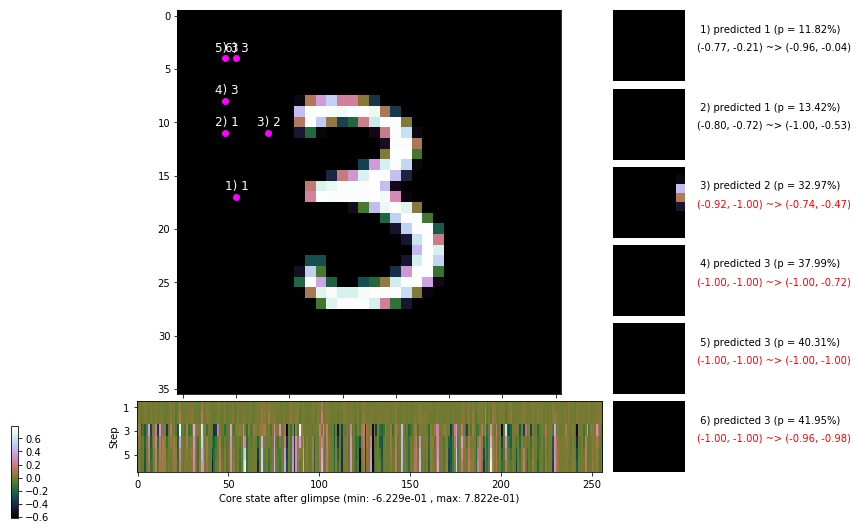

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 177.8 ms/b | lr: 9.35e-04 | grad 2norm: 19.46 | grad inf norm:  6.277
         Weights || abs max:  1.48 ( 2468.11) | mean: -1.19e-03 ( 0.01) | var: 2.37e-02 (  204.18)
          Biases || abs max:  1.52 (  582.36) | mean: -4.24e-02 ( 0.39) | var: 1.90e-02 (10263.18)
                    class loss: 1.481 | steps: 3.715 | reward:  2.430 | acc.: 46.25%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 163.8 ms/b | lr: 9.34e-04 | grad 2norm: 19.57 | grad inf norm:  6.110
         Weights || abs max:  1.49 ( 7007.74) | mean: -1.19e-03 ( 0.02) | var: 2.40e-02 (17945.83)
          Biases || abs max:  1.52 (  411.97) | mean: -4.34e-02 ( 0.30) | var: 1.95e-02 ( 3240.44)
                    class loss: 1.479 | steps: 3.718 | reward:  2.434 | acc.: 46.27%

	Target class: 8 | Discounted rewards: [0.000, 0.000, 0.0

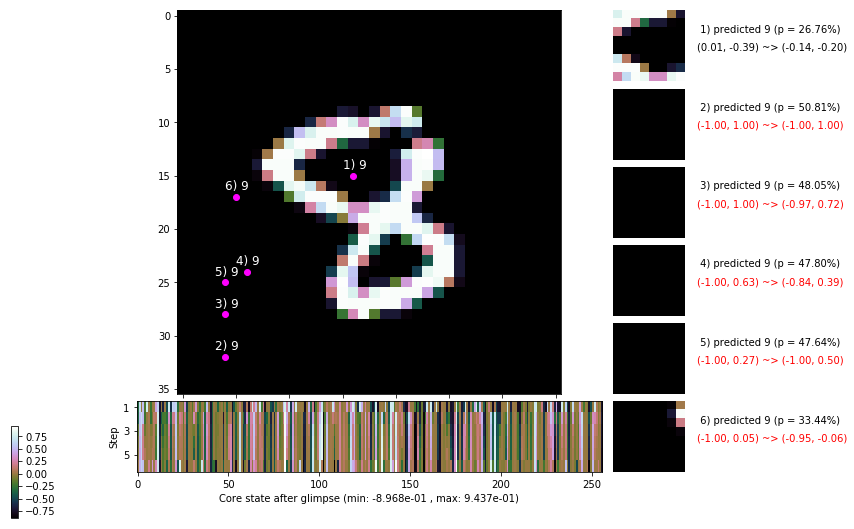

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 168.2 ms/b | lr: 9.32e-04 | grad 2norm: 20.08 | grad inf norm:  6.104
         Weights || abs max:  1.51 ( 1477.16) | mean: -1.20e-03 ( 0.01) | var: 2.43e-02 (   65.88)
          Biases || abs max:  1.53 (  220.00) | mean: -4.37e-02 ( 0.22) | var: 1.97e-02 (  349.85)
                    class loss: 1.432 | steps: 3.693 | reward:  2.499 | acc.: 48.17%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 161.0 ms/b | lr: 9.31e-04 | grad 2norm: 19.68 | grad inf norm:  6.137
         Weights || abs max:  1.52 ( 1695.43) | mean: -1.20e-03 ( 0.01) | var: 2.46e-02 (   84.72)
          Biases || abs max:  1.52 (  255.23) | mean: -4.42e-02 ( 0.25) | var: 2.00e-02 (  758.30)
                    class loss: 1.413 | steps: 3.688 | reward:  2.508 | acc.: 48.57%

	Target class: 0 | Discounted rewards: [3.686, 4.095, 3.4

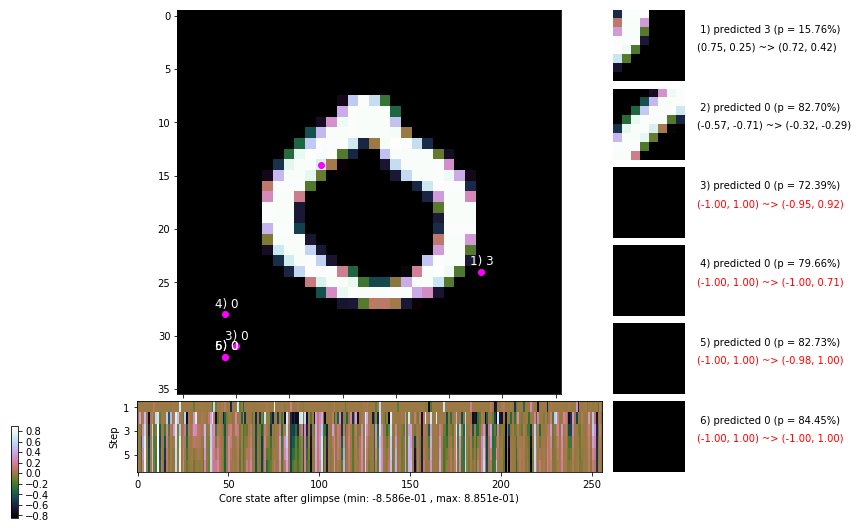

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 165.8 ms/b | lr: 9.30e-04 | grad 2norm: 19.78 | grad inf norm:  6.133
         Weights || abs max:  1.54 ( 2509.21) | mean: -1.22e-03 ( 0.01) | var: 2.49e-02 (  171.88)
          Biases || abs max:  1.54 (  537.66) | mean: -4.43e-02 ( 0.37) | var: 2.03e-02 ( 5045.00)
                    class loss: 1.414 | steps: 3.653 | reward:  2.534 | acc.: 48.88%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 162.4 ms/b | lr: 9.29e-04 | grad 2norm: 19.67 | grad inf norm:  6.121
         Weights || abs max:  1.55 ( 1483.15) | mean: -1.26e-03 ( 0.01) | var: 2.53e-02 (   31.83)
          Biases || abs max:  1.56 (  257.33) | mean: -4.53e-02 ( 0.25) | var: 2.07e-02 (  301.24)
                    class loss: 1.399 | steps: 3.644 | reward:  2.553 | acc.: 48.68%

	Target class: 7 | Discounted rewards: [0.000, 0.000, 0.0

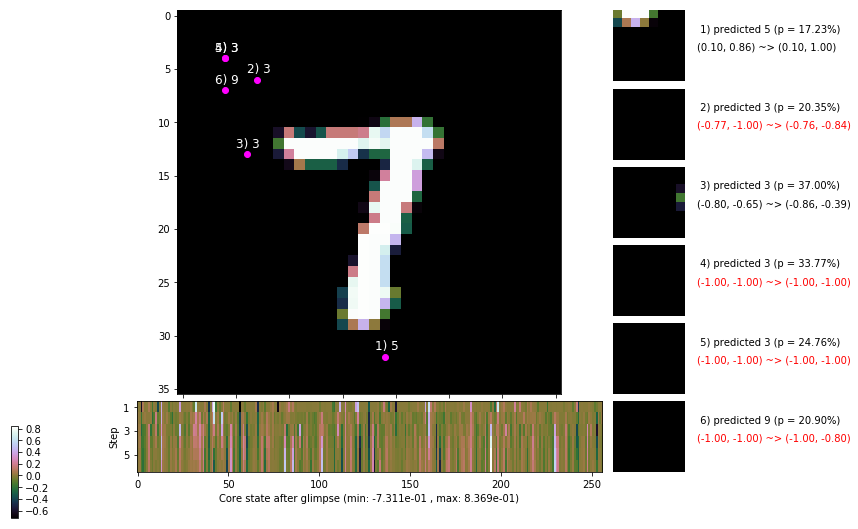

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 4 | Discounted rewards: [2.710, 1.900, 1.000, 0.000, 0.000, 0.000]


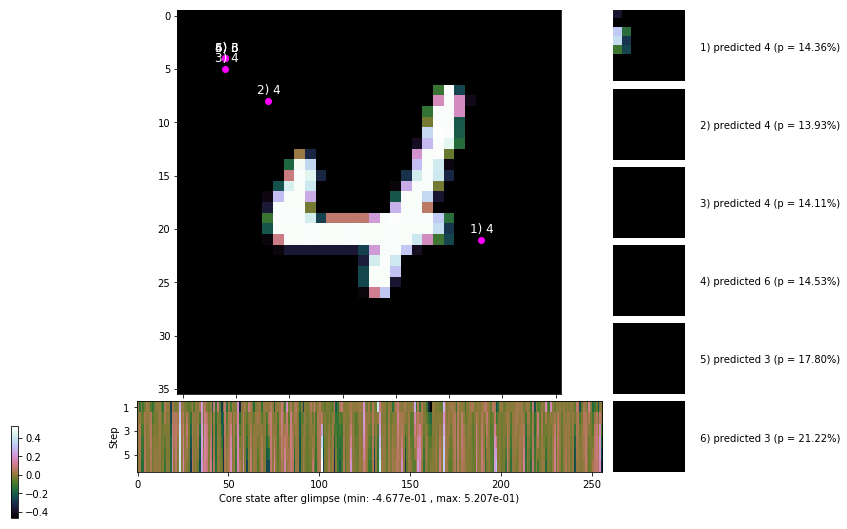


	Target class: 3 | Discounted rewards: [0.000, 0.000, 0.000, 0.000, 0.000, 0.000]


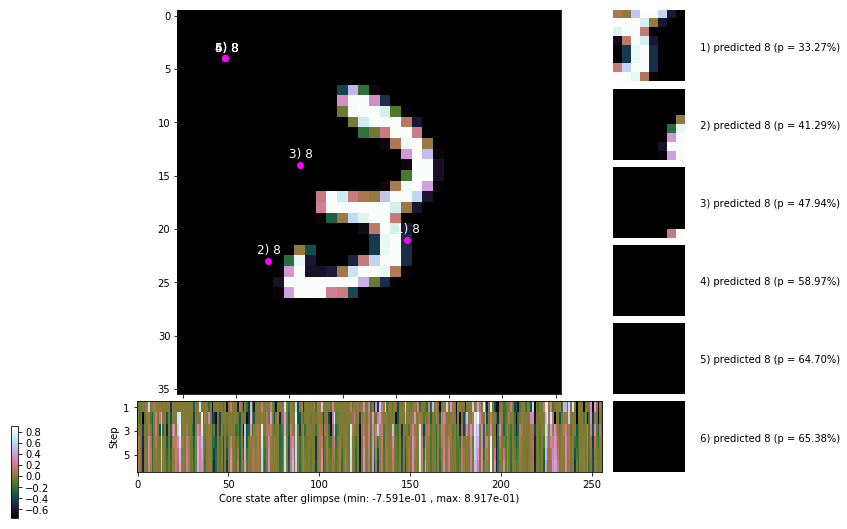

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


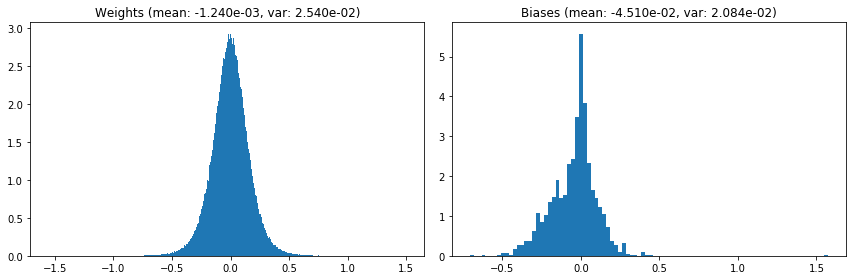

                                      Location network weights and biases


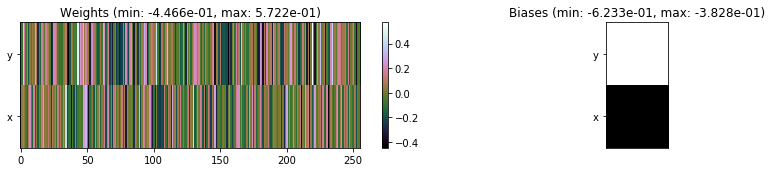

---------------------------------------------------------------------------------------------------------------
Elapsed time:  494.51 sec | TRAIN >> class loss: 1.4439 | steps:  3.695 :( | reward:  2.4856 :( | acc.: 47.610% :(
                          | VAL   >> class loss: 1.4137 | steps:  3.634 :( | reward:  2.5514 :( | acc.: 48.320% :(


Epoch   6/400) lr = 0.0009277
 b    300/  3000 >> 159.5 ms/b | lr: 9.27e-04 | grad 2norm: 20.06 | grad inf norm:  6.250
         Weights || abs max:  1.57 ( 2484.75) | mean: -1.26e-03 ( 0.01) | var: 2.56e-02 ( 1010.71)
          Biases || abs max:  1.58 (  250.10) | mean: -4.54e-02 ( 0.23) | var: 2.09e-02 (  431.49)
                    class loss: 1.430 | steps: 3.695 | reward:  2.501 | acc.: 47.90%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 152.6 ms/b | lr: 9.26e-04 | grad 2norm: 19.63 | grad inf norm:  6.085
         Weights || abs max:  1.59 ( 2166.81) | mean: -1.25e-03 (

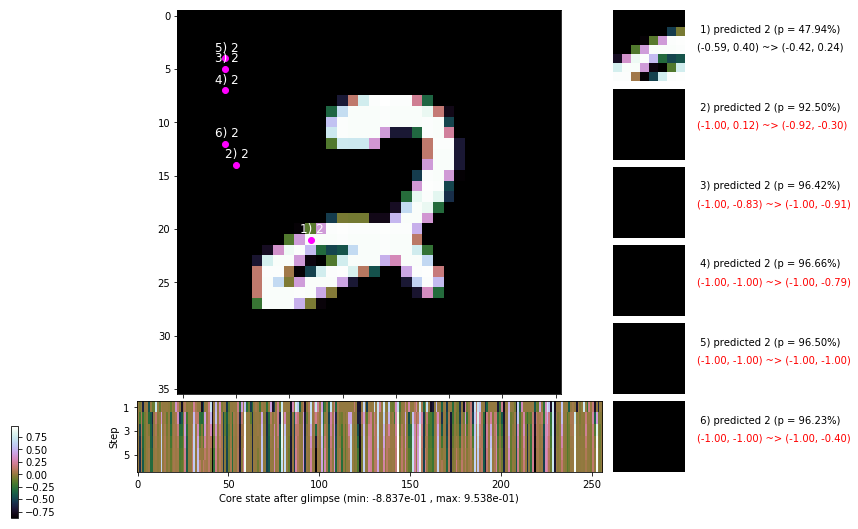

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 154.2 ms/b | lr: 9.24e-04 | grad 2norm: 20.13 | grad inf norm:  6.608
         Weights || abs max:  1.59 ( 1288.64) | mean: -1.27e-03 ( 0.01) | var: 2.61e-02 (   42.48)
          Biases || abs max:  1.59 (  130.27) | mean: -4.69e-02 ( 0.17) | var: 2.14e-02 (   79.31)
                    class loss: 1.410 | steps: 3.667 | reward:  2.527 | acc.: 48.75%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 150.9 ms/b | lr: 9.23e-04 | grad 2norm: 19.84 | grad inf norm:  5.911
         Weights || abs max:  1.60 ( 1894.48) | mean: -1.20e-03 ( 0.01) | var: 2.64e-02 (  130.24)
          Biases || abs max:  1.59 (  153.30) | mean: -4.70e-02 ( 0.18) | var: 2.17e-02 (  150.36)
                    class loss: 1.373 | steps: 3.582 | reward:  2.615 | acc.: 49.70%

	Target class: 8 | Discounted rewards: [3.686, 4.095, 3.4

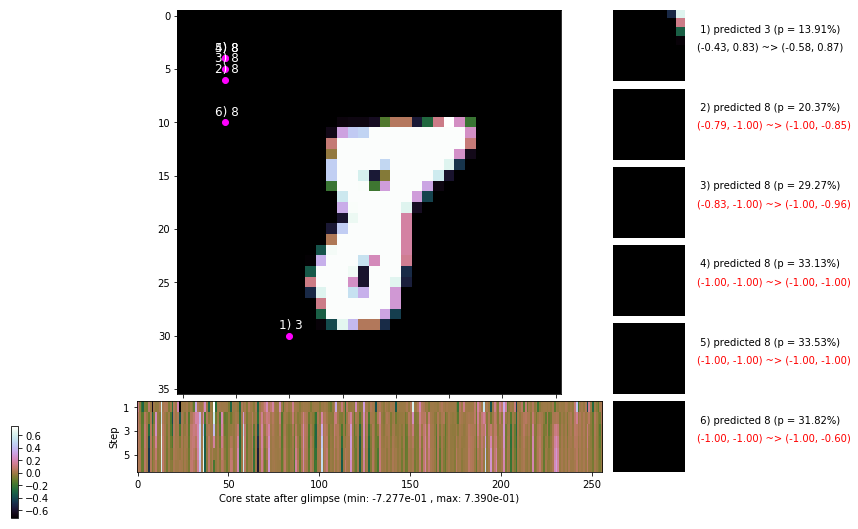

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 152.3 ms/b | lr: 9.21e-04 | grad 2norm: 20.46 | grad inf norm:  6.097
         Weights || abs max:  1.62 ( 2604.87) | mean: -1.12e-03 ( 0.01) | var: 2.67e-02 (  733.95)
          Biases || abs max:  1.60 ( 4103.63) | mean: -4.69e-02 ( 1.73) | var: 2.19e-02 (1778288.50)
                    class loss: 1.370 | steps: 3.557 | reward:  2.650 | acc.: 50.65%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 151.5 ms/b | lr: 9.20e-04 | grad 2norm: 20.28 | grad inf norm:  6.017
         Weights || abs max:  1.63 (  883.77) | mean: -1.14e-03 ( 0.01) | var: 2.70e-02 (    7.78)
          Biases || abs max:  1.61 (  139.35) | mean: -4.81e-02 ( 0.18) | var: 2.23e-02 (   78.10)
                    class loss: 1.397 | steps: 3.675 | reward:  2.534 | acc.: 49.17%

	Target class: 7 | Discounted rewards: [4.686, 4.095, 3

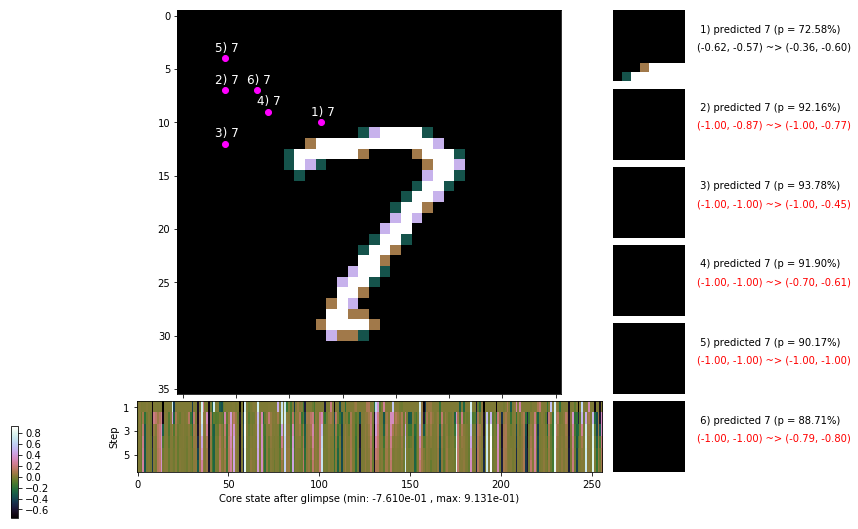

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 155.6 ms/b | lr: 9.18e-04 | grad 2norm: 20.34 | grad inf norm:  6.098
         Weights || abs max:  1.64 ( 3021.87) | mean: -1.15e-03 ( 0.01) | var: 2.73e-02 ( 1134.92)
          Biases || abs max:  1.60 (  182.31) | mean: -4.88e-02 ( 0.20) | var: 2.25e-02 (  182.15)
                    class loss: 1.378 | steps: 3.611 | reward:  2.591 | acc.: 49.95%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 154.2 ms/b | lr: 9.18e-04 | grad 2norm: 20.69 | grad inf norm:  6.006
         Weights || abs max:  1.64 ( 2740.68) | mean: -1.10e-03 ( 0.01) | var: 2.76e-02 (  711.38)
          Biases || abs max:  1.62 (  165.78) | mean: -4.92e-02 ( 0.20) | var: 2.28e-02 (  574.50)
                    class loss: 1.354 | steps: 3.564 | reward:  2.654 | acc.: 50.93%

	Target class: 3 | Discounted rewards: [0.000, 0.000, 0.0

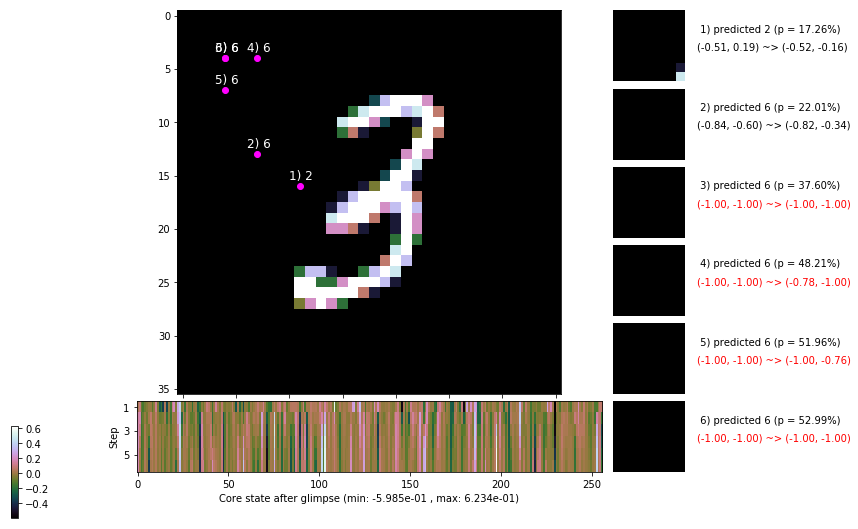

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 153.7 ms/b | lr: 9.16e-04 | grad 2norm: 20.21 | grad inf norm:  6.069
         Weights || abs max:  1.66 ( 1610.79) | mean: -1.06e-03 ( 0.01) | var: 2.79e-02 (   68.50)
          Biases || abs max:  1.63 (  201.30) | mean: -5.00e-02 ( 0.21) | var: 2.31e-02 (  623.29)
                    class loss: 1.342 | steps: 3.538 | reward:  2.675 | acc.: 51.88%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 152.4 ms/b | lr: 9.15e-04 | grad 2norm: 20.33 | grad inf norm:  5.947
         Weights || abs max:  1.67 ( 2214.40) | mean: -1.10e-03 ( 0.01) | var: 2.82e-02 (   89.68)
          Biases || abs max:  1.64 (  256.14) | mean: -5.00e-02 ( 0.26) | var: 2.33e-02 ( 1251.46)
                    class loss: 1.358 | steps: 3.573 | reward:  2.621 | acc.: 50.73%

	Target class: 4 | Discounted rewards: [0.000, 0.000, 0.0

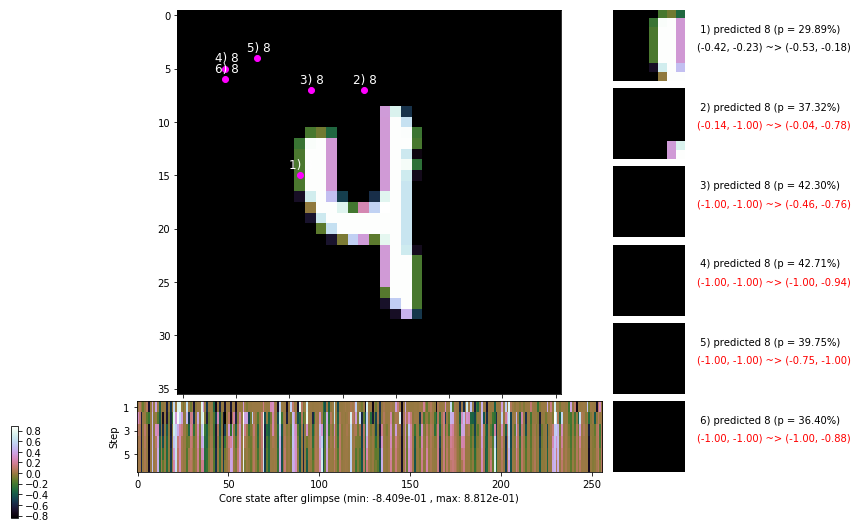

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 7 | Discounted rewards: [4.686, 4.095, 3.439, 2.710, 1.900, 1.000]


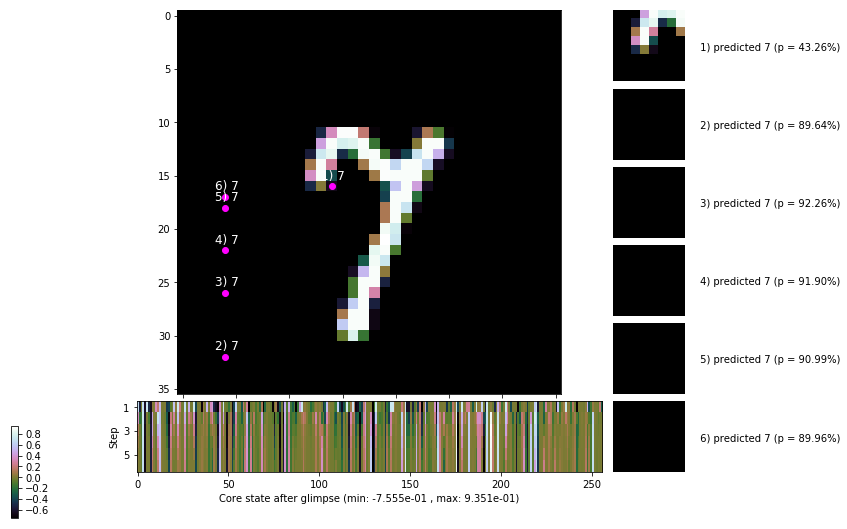


	Target class: 4 | Discounted rewards: [0.000, 0.000, 0.000, 0.000, 0.000, 0.000]


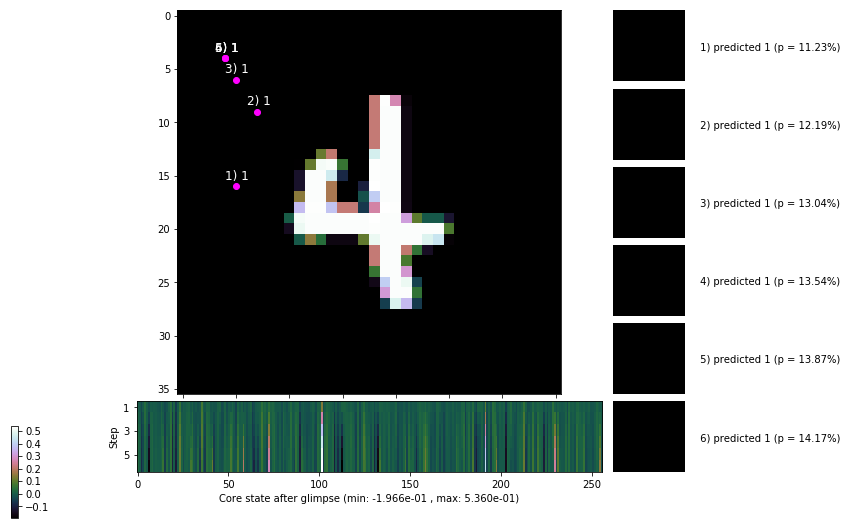

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


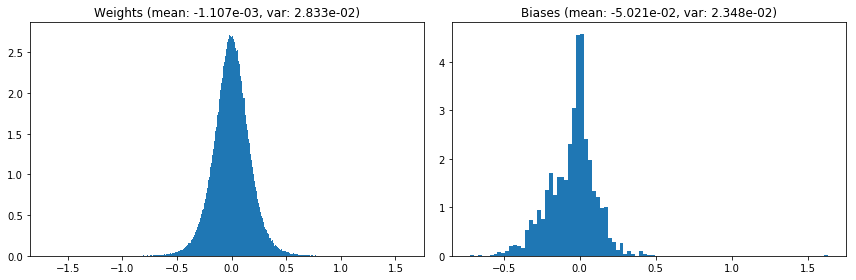

                                      Location network weights and biases


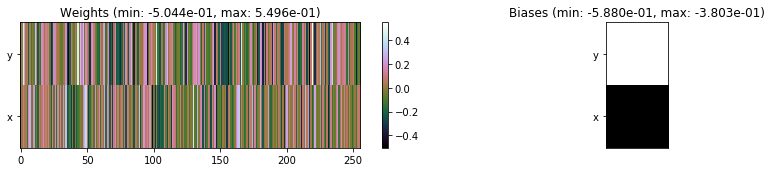

---------------------------------------------------------------------------------------------------------------
Elapsed time:  461.76 sec | TRAIN >> class loss: 1.3851 | steps:  3.615 :( | reward:  2.5881 :( | acc.: 49.812% :(
                          | VAL   >> class loss: 1.3846 | steps:  3.551 :( | reward:  2.6214 :( | acc.: 49.480% :(


Epoch   7/400) lr = 0.0009139
 b    300/  3000 >> 166.1 ms/b | lr: 9.13e-04 | grad 2norm: 20.77 | grad inf norm:  6.231
         Weights || abs max:  1.68 ( 1605.35) | mean: -1.08e-03 ( 0.01) | var: 2.85e-02 (   72.89)
          Biases || abs max:  1.64 (  144.34) | mean: -5.00e-02 ( 0.17) | var: 2.35e-02 (  400.50)
                    class loss: 1.334 | steps: 3.521 | reward:  2.661 | acc.: 51.57%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 177.6 ms/b | lr: 9.12e-04 | grad 2norm: 20.72 | grad inf norm:  5.850
         Weights || abs max:  1.69 ( 4645.54) | mean: -1.07e-03 (

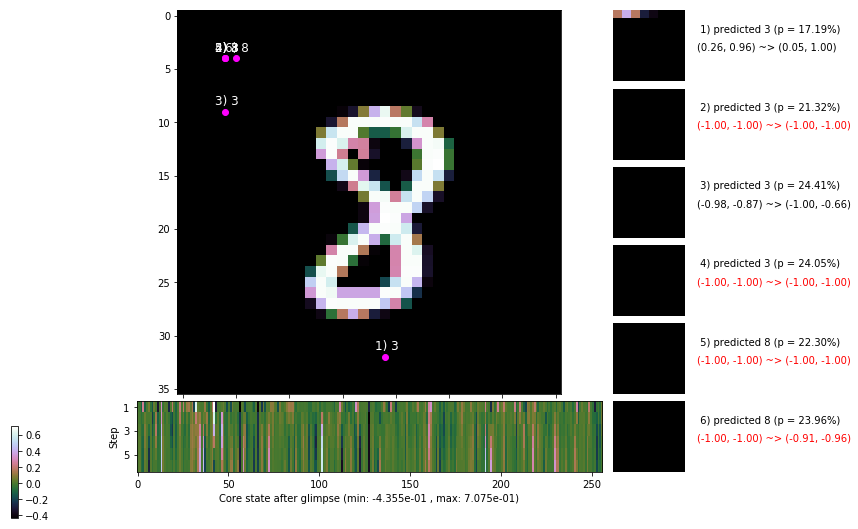

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 200.9 ms/b | lr: 9.10e-04 | grad 2norm: 20.42 | grad inf norm:  6.074
         Weights || abs max:  1.71 ( 2184.62) | mean: -1.09e-03 ( 0.01) | var: 2.90e-02 (  236.97)
          Biases || abs max:  1.67 (  410.45) | mean: -5.08e-02 ( 0.27) | var: 2.41e-02 ( 5634.40)
                    class loss: 1.330 | steps: 3.534 | reward:  2.684 | acc.: 52.38%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 194.5 ms/b | lr: 9.09e-04 | grad 2norm: 20.21 | grad inf norm:  5.891
         Weights || abs max:  1.72 ( 2322.32) | mean: -1.11e-03 ( 0.01) | var: 2.93e-02 (  434.25)
          Biases || abs max:  1.67 (  169.75) | mean: -5.22e-02 ( 0.17) | var: 2.42e-02 (  457.04)
                    class loss: 1.352 | steps: 3.547 | reward:  2.660 | acc.: 50.88%

	Target class: 2 | Discounted rewards: [3.686, 4.095, 3.4

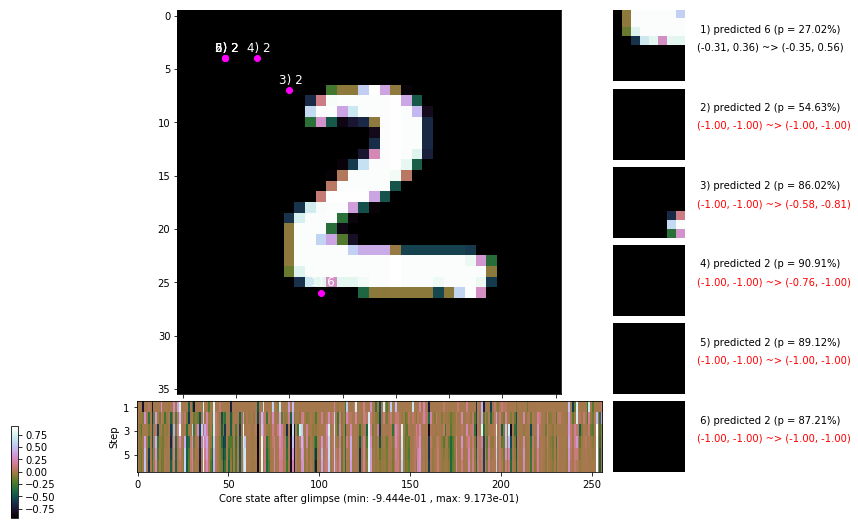

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 204.2 ms/b | lr: 9.08e-04 | grad 2norm: 20.48 | grad inf norm:  5.944
         Weights || abs max:  1.75 ( 1772.66) | mean: -1.14e-03 ( 0.01) | var: 2.95e-02 (   47.63)
          Biases || abs max:  1.68 (  133.94) | mean: -5.27e-02 ( 0.15) | var: 2.44e-02 (  144.16)
                    class loss: 1.299 | steps: 3.509 | reward:  2.721 | acc.: 52.82%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 191.3 ms/b | lr: 9.07e-04 | grad 2norm: 20.61 | grad inf norm:  6.039
         Weights || abs max:  1.75 ( 2419.45) | mean: -1.15e-03 ( 0.01) | var: 2.98e-02 (  154.17)
          Biases || abs max:  1.69 (  174.64) | mean: -5.32e-02 ( 0.19) | var: 2.46e-02 (  166.55)
                    class loss: 1.294 | steps: 3.469 | reward:  2.738 | acc.: 52.52%

	Target class: 7 | Discounted rewards: [3.686, 4.095, 3.4

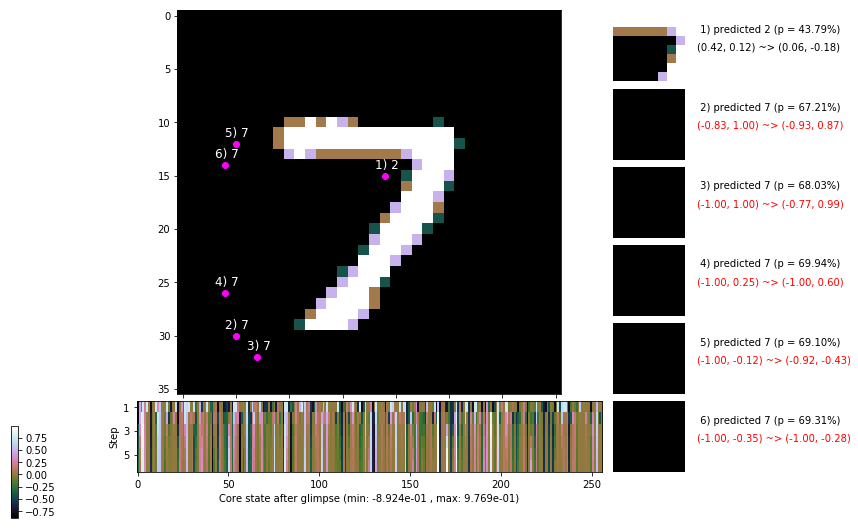

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 190.9 ms/b | lr: 9.05e-04 | grad 2norm: 21.09 | grad inf norm:  6.168
         Weights || abs max:  1.76 ( 4690.95) | mean: -1.14e-03 ( 0.01) | var: 3.01e-02 ( 1585.79)
          Biases || abs max:  1.71 (  224.89) | mean: -5.38e-02 ( 0.20) | var: 2.50e-02 (  388.97)
                    class loss: 1.290 | steps: 3.459 | reward:  2.770 | acc.: 53.83%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 192.3 ms/b | lr: 9.04e-04 | grad 2norm: 20.96 | grad inf norm:  6.190
         Weights || abs max:  1.77 ( 1470.15) | mean: -1.07e-03 ( 0.01) | var: 3.03e-02 (   54.92)
          Biases || abs max:  1.74 (  248.98) | mean: -5.42e-02 ( 0.22) | var: 2.53e-02 (  670.03)
                    class loss: 1.258 | steps: 3.424 | reward:  2.815 | acc.: 53.97%

	Target class: 2 | Discounted rewards: [1.247, 1.385, 1.5

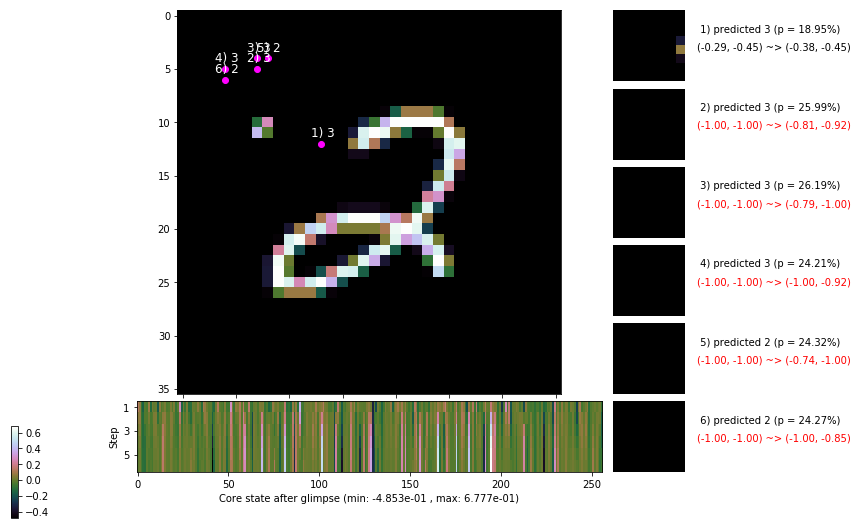

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 220.8 ms/b | lr: 9.02e-04 | grad 2norm: 20.84 | grad inf norm:  6.323
         Weights || abs max:  1.77 ( 5956.08) | mean: -1.03e-03 ( 0.02) | var: 3.06e-02 ( 3394.13)
          Biases || abs max:  1.74 (  421.74) | mean: -5.46e-02 ( 0.28) | var: 2.55e-02 ( 5484.10)
                    class loss: 1.279 | steps: 3.450 | reward:  2.757 | acc.: 53.58%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 201.6 ms/b | lr: 9.01e-04 | grad 2norm: 20.98 | grad inf norm:  6.321
         Weights || abs max:  1.79 ( 3316.82) | mean: -1.03e-03 ( 0.01) | var: 3.09e-02 (  383.19)
          Biases || abs max:  1.75 (  124.87) | mean: -5.46e-02 ( 0.15) | var: 2.57e-02 (   66.14)
                    class loss: 1.283 | steps: 3.456 | reward:  2.735 | acc.: 52.85%

	Target class: 3 | Discounted rewards: [3.786, 3.095, 3.4

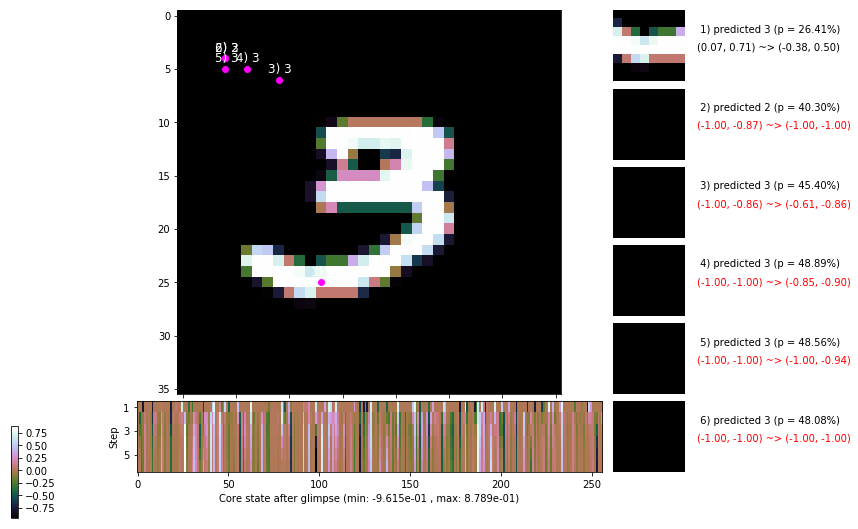

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 4 | Discounted rewards: [3.686, 4.095, 3.439, 2.710, 1.900, 1.000]


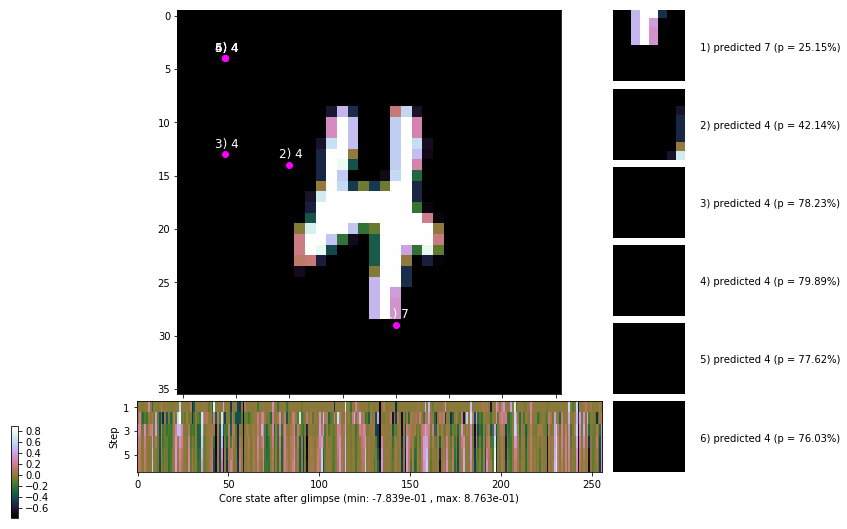


	Target class: 9 | Discounted rewards: [3.095, 3.439, 2.710, 1.900, 1.000, 0.000]


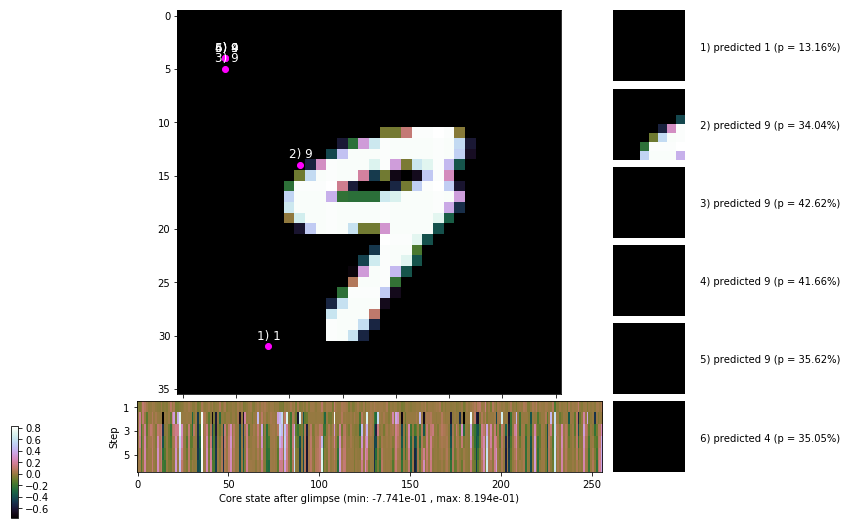

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


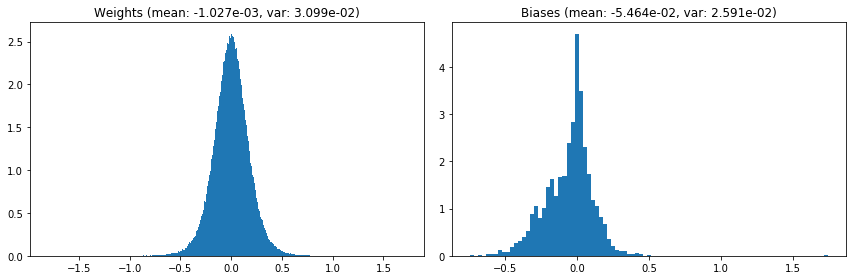

                                      Location network weights and biases


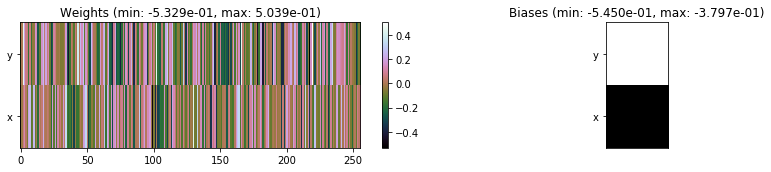

---------------------------------------------------------------------------------------------------------------
Elapsed time:  582.72 sec | TRAIN >> class loss: 1.3040 | steps:  3.488 :( | reward:  2.7216 :( | acc.: 52.612% :(
                          | VAL   >> class loss: 1.2820 | steps:  3.464 :( | reward:  2.7748 :( | acc.: 52.640% :(


Epoch   8/400) lr = 0.0009003
 b    300/  3000 >> 172.0 ms/b | lr: 8.99e-04 | grad 2norm: 20.64 | grad inf norm:  6.176
         Weights || abs max:  1.80 ( 1623.73) | mean: -1.04e-03 ( 0.01) | var: 3.11e-02 (   45.99)
          Biases || abs max:  1.74 (  122.45) | mean: -5.50e-02 ( 0.14) | var: 2.61e-02 (   52.29)
                    class loss: 1.342 | steps: 3.533 | reward:  2.675 | acc.: 51.23%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 160.5 ms/b | lr: 8.98e-04 | grad 2norm: 20.47 | grad inf norm:  6.121
         Weights || abs max:  1.80 ( 1943.76) | mean: -1.08e-03 (

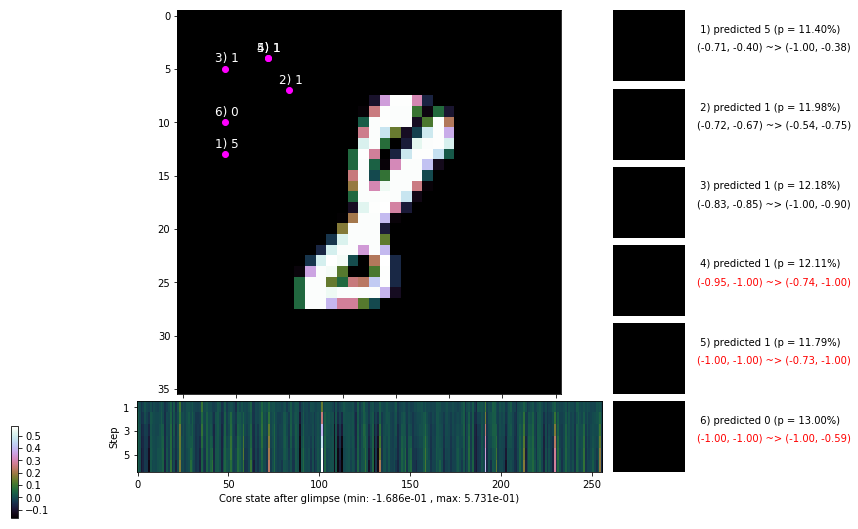

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 175.6 ms/b | lr: 8.97e-04 | grad 2norm: 20.98 | grad inf norm:  6.310
         Weights || abs max:  1.80 ( 1859.31) | mean: -1.10e-03 ( 0.01) | var: 3.16e-02 (   88.33)
          Biases || abs max:  1.73 (  498.36) | mean: -5.61e-02 ( 0.34) | var: 2.65e-02 (10110.89)
                    class loss: 1.289 | steps: 3.518 | reward:  2.717 | acc.: 53.07%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 173.4 ms/b | lr: 8.96e-04 | grad 2norm: 21.16 | grad inf norm:  6.308
         Weights || abs max:  1.82 ( 5466.69) | mean: -1.14e-03 ( 0.02) | var: 3.19e-02 ( 4667.72)
          Biases || abs max:  1.74 (  559.78) | mean: -5.67e-02 ( 0.44) | var: 2.66e-02 (24081.94)
                    class loss: 1.280 | steps: 3.446 | reward:  2.792 | acc.: 53.35%

	Target class: 3 | Discounted rewards: [0.000, 0.000, 0.0

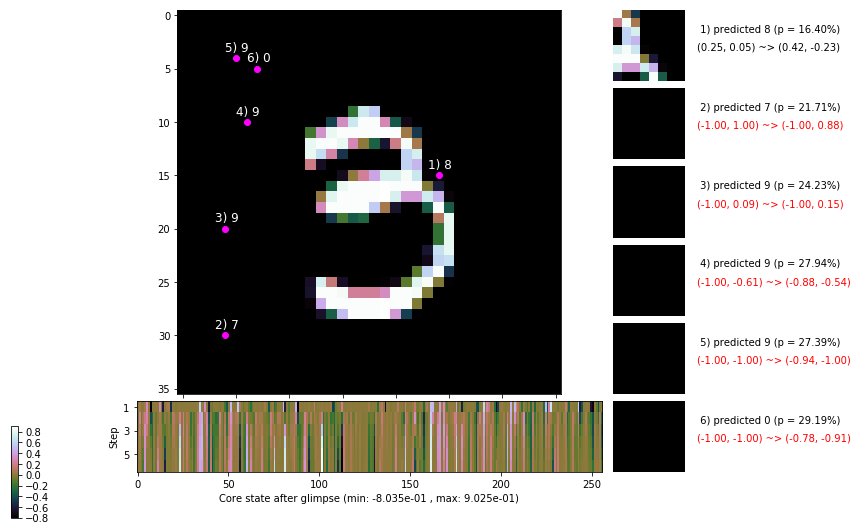

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 175.6 ms/b | lr: 8.94e-04 | grad 2norm: 20.84 | grad inf norm:  5.864
         Weights || abs max:  1.82 ( 1497.79) | mean: -1.18e-03 ( 0.01) | var: 3.21e-02 (  145.74)
          Biases || abs max:  1.75 (  294.47) | mean: -5.71e-02 ( 0.21) | var: 2.68e-02 ( 3368.35)
                    class loss: 1.267 | steps: 3.434 | reward:  2.812 | acc.: 54.97%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 172.0 ms/b | lr: 8.93e-04 | grad 2norm: 20.70 | grad inf norm:  5.982
         Weights || abs max:  1.82 ( 2039.87) | mean: -1.20e-03 ( 0.01) | var: 3.24e-02 (  187.56)
          Biases || abs max:  1.75 (  160.15) | mean: -5.80e-02 ( 0.15) | var: 2.71e-02 (  100.47)
                    class loss: 1.269 | steps: 3.449 | reward:  2.789 | acc.: 53.63%

	Target class: 4 | Discounted rewards: [3.686, 4.095, 3.4

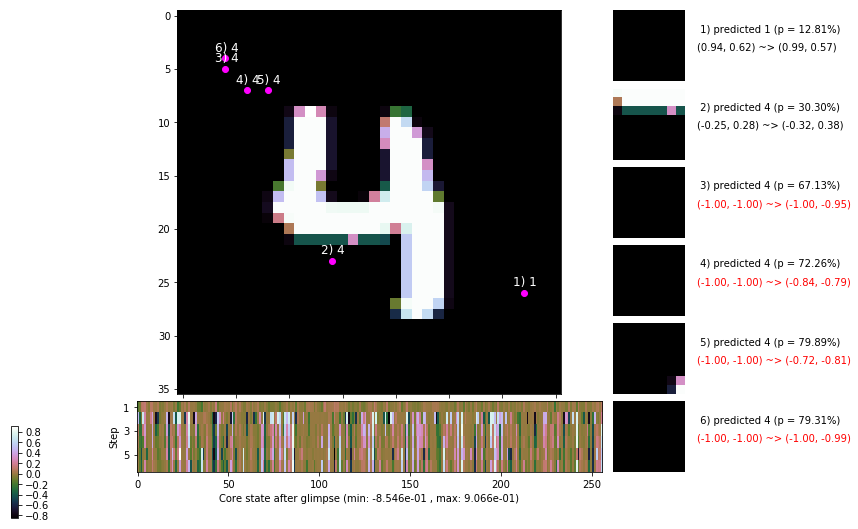

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 175.1 ms/b | lr: 8.91e-04 | grad 2norm: 20.96 | grad inf norm:  6.077
         Weights || abs max:  1.83 ( 2595.47) | mean: -1.18e-03 ( 0.01) | var: 3.27e-02 (  293.03)
          Biases || abs max:  1.78 (   88.21) | mean: -5.83e-02 ( 0.12) | var: 2.74e-02 (   21.65)
                    class loss: 1.236 | steps: 3.414 | reward:  2.852 | acc.: 55.33%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 172.4 ms/b | lr: 8.90e-04 | grad 2norm: 20.70 | grad inf norm:  6.084
         Weights || abs max:  1.84 ( 2924.37) | mean: -1.14e-03 ( 0.01) | var: 3.29e-02 (  439.00)
          Biases || abs max:  1.80 (  114.94) | mean: -5.91e-02 ( 0.14) | var: 2.77e-02 (   47.78)
                    class loss: 1.254 | steps: 3.405 | reward:  2.834 | acc.: 54.70%

	Target class: 9 | Discounted rewards: [3.786, 3.095, 3.4

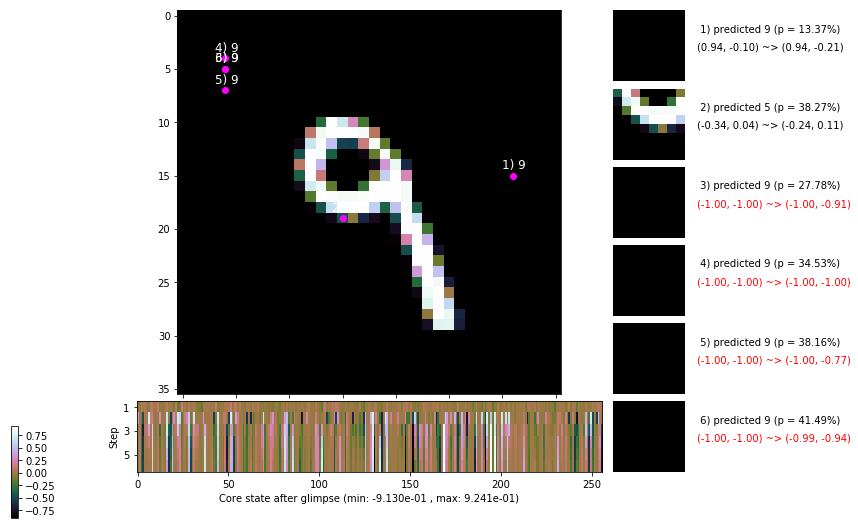

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 175.5 ms/b | lr: 8.89e-04 | grad 2norm: 21.20 | grad inf norm:  5.988
         Weights || abs max:  1.84 ( 8737.92) | mean: -1.11e-03 ( 0.02) | var: 3.31e-02 (28090.41)
          Biases || abs max:  1.82 (  205.78) | mean: -5.91e-02 ( 0.18) | var: 2.78e-02 (  463.80)
                    class loss: 1.237 | steps: 3.400 | reward:  2.863 | acc.: 55.23%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 173.5 ms/b | lr: 8.88e-04 | grad 2norm: 21.09 | grad inf norm:  6.245
         Weights || abs max:  1.86 ( 1875.10) | mean: -1.09e-03 ( 0.01) | var: 3.34e-02 (  120.63)
          Biases || abs max:  1.82 (  219.26) | mean: -5.94e-02 ( 0.19) | var: 2.80e-02 (  988.90)
                    class loss: 1.299 | steps: 3.443 | reward:  2.769 | acc.: 52.87%

	Target class: 9 | Discounted rewards: [0.000, 0.000, 0.0

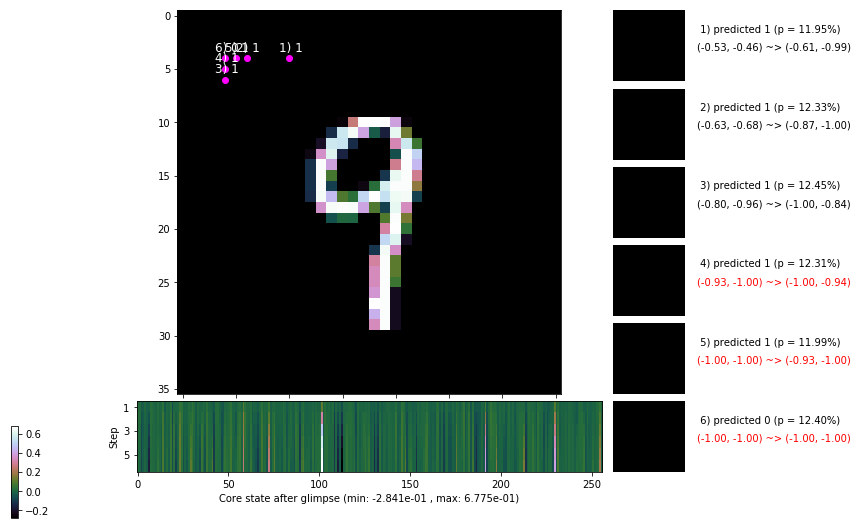

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 8 | Discounted rewards: [3.686, 4.095, 3.439, 2.710, 1.900, 1.000]


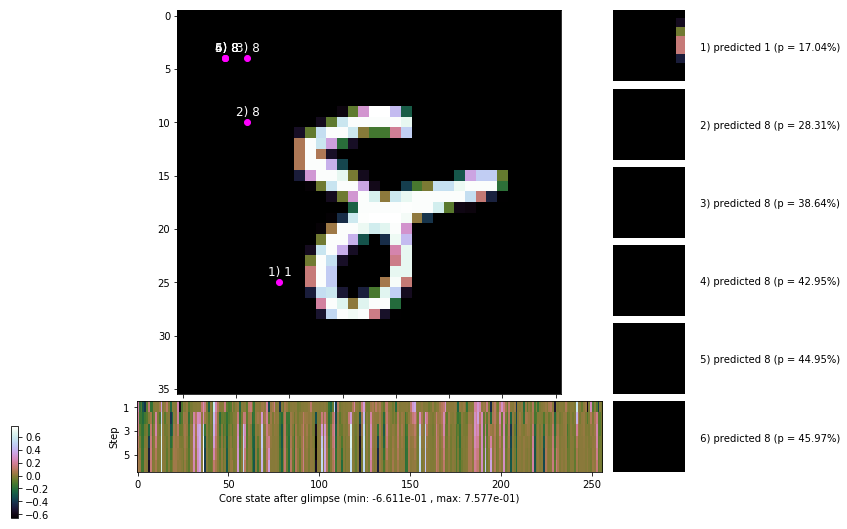


	Target class: 8 | Discounted rewards: [2.786, 3.095, 3.439, 2.710, 1.900, 1.000]


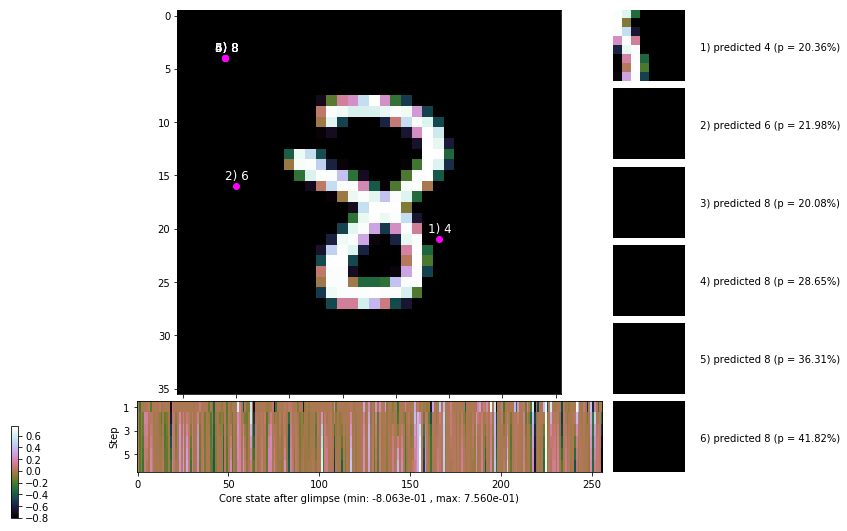

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


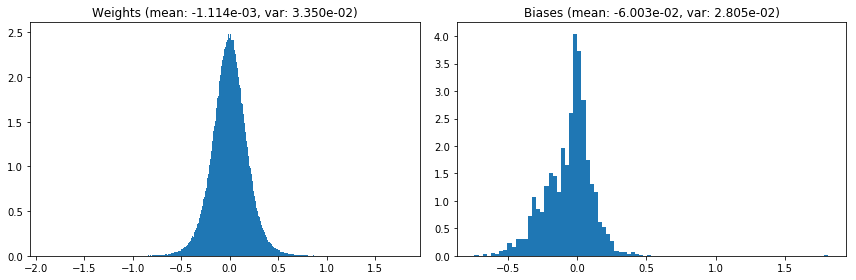

                                      Location network weights and biases


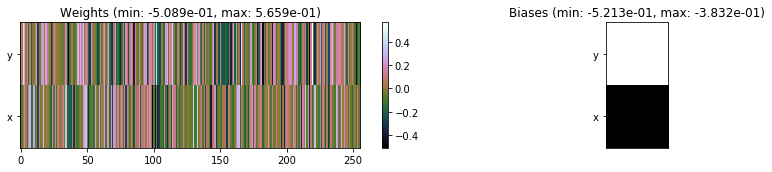

---------------------------------------------------------------------------------------------------------------
Elapsed time:  518.48 sec | TRAIN >> class loss: 1.2791 | steps:  3.455 :( | reward:  2.7815 :( | acc.: 53.702% :(
                          | VAL   >> class loss: 1.2641 | steps:  3.405 :( | reward:  2.8458 :( | acc.: 54.760% :(


Epoch   9/400) lr = 0.0008869
 b    300/  3000 >> 177.5 ms/b | lr: 8.86e-04 | grad 2norm: 21.61 | grad inf norm:  6.364
         Weights || abs max:  1.88 (     inf) | mean: -1.10e-03 (  inf) | var: 3.36e-02 (     nan)
          Biases || abs max:  1.83 (  203.83) | mean: -5.97e-02 ( 0.17) | var: 2.82e-02 (  389.01)
                    class loss: 1.234 | steps: 3.351 | reward:  2.883 | acc.: 55.28%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 188.4 ms/b | lr: 8.85e-04 | grad 2norm: 21.70 | grad inf norm:  6.637
         Weights || abs max:  1.91 ( 1694.22) | mean: -1.12e-03 (

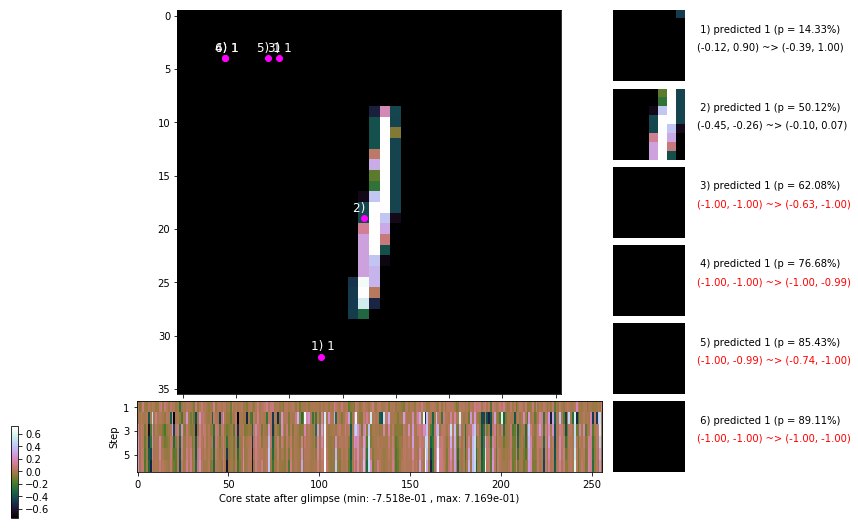

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 187.6 ms/b | lr: 8.83e-04 | grad 2norm: 21.75 | grad inf norm:  6.169
         Weights || abs max:  1.90 ( 3211.19) | mean: -1.08e-03 ( 0.01) | var: 3.41e-02 ( 1085.93)
          Biases || abs max:  1.86 (  161.87) | mean: -6.00e-02 ( 0.16) | var: 2.86e-02 (  114.48)
                    class loss: 1.224 | steps: 3.382 | reward:  2.876 | acc.: 55.90%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 174.1 ms/b | lr: 8.82e-04 | grad 2norm: 21.24 | grad inf norm:  6.137
         Weights || abs max:  1.90 ( 1123.44) | mean: -1.08e-03 ( 0.01) | var: 3.44e-02 (   18.33)
          Biases || abs max:  1.87 (  358.23) | mean: -6.06e-02 ( 0.25) | var: 2.89e-02 ( 2133.68)
                    class loss: 1.218 | steps: 3.401 | reward:  2.884 | acc.: 55.60%

	Target class: 3 | Discounted rewards: [3.686, 4.095, 3.4

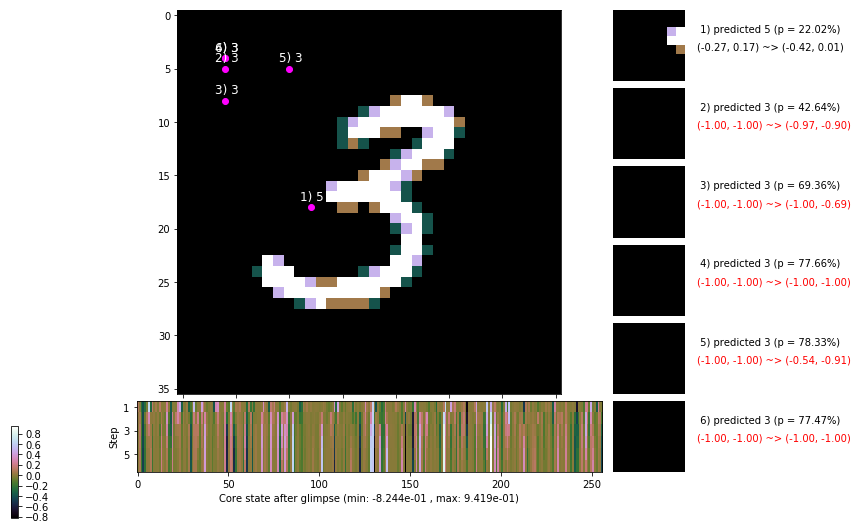

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 166.8 ms/b | lr: 8.81e-04 | grad 2norm: 21.35 | grad inf norm:  5.983
         Weights || abs max:  1.91 ( 1270.52) | mean: -1.04e-03 ( 0.01) | var: 3.46e-02 (   31.76)
          Biases || abs max:  1.88 (  152.71) | mean: -6.03e-02 ( 0.16) | var: 2.90e-02 (  148.92)
                    class loss: 1.228 | steps: 3.360 | reward:  2.907 | acc.: 56.32%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 164.6 ms/b | lr: 8.80e-04 | grad 2norm: 21.26 | grad inf norm:  6.095
         Weights || abs max:  1.93 ( 2166.74) | mean: -1.03e-03 ( 0.01) | var: 3.49e-02 (  853.92)
          Biases || abs max:  1.88 (  110.17) | mean: -6.13e-02 ( 0.14) | var: 2.93e-02 (   39.46)
                    class loss: 1.262 | steps: 3.429 | reward:  2.831 | acc.: 54.63%

	Target class: 3 | Discounted rewards: [4.686, 4.095, 3.4

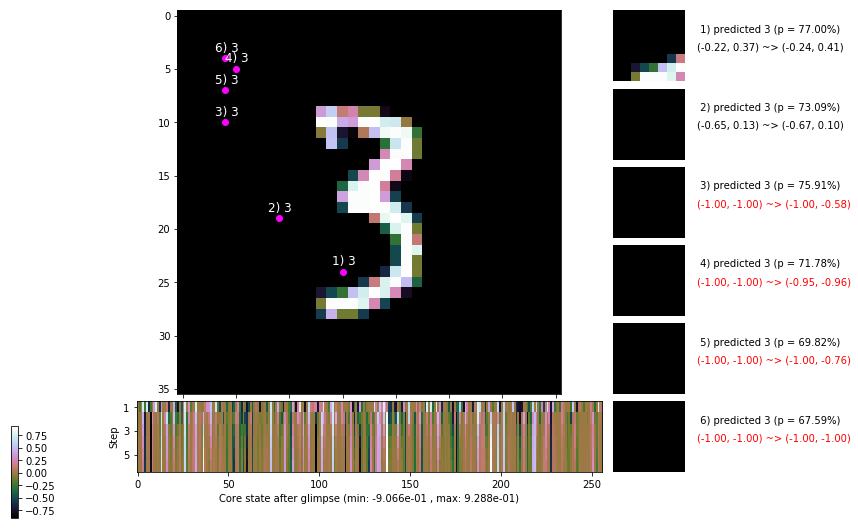

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 165.9 ms/b | lr: 8.78e-04 | grad 2norm: 21.64 | grad inf norm:  6.204
         Weights || abs max:  1.94 (  988.62) | mean: -1.06e-03 ( 0.01) | var: 3.51e-02 (   29.73)
          Biases || abs max:  1.89 ( 1073.23) | mean: -6.20e-02 ( 0.53) | var: 2.95e-02 (74803.30)
                    class loss: 1.222 | steps: 3.356 | reward:  2.930 | acc.: 56.28%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 163.1 ms/b | lr: 8.77e-04 | grad 2norm: 21.24 | grad inf norm:  6.259
         Weights || abs max:  1.94 ( 1704.25) | mean: -1.05e-03 ( 0.01) | var: 3.54e-02 (   99.87)
          Biases || abs max:  1.89 (  143.01) | mean: -6.24e-02 ( 0.15) | var: 2.98e-02 (  151.35)
                    class loss: 1.249 | steps: 3.382 | reward:  2.864 | acc.: 55.17%

	Target class: 9 | Discounted rewards: [1.000, 0.000, 0.0

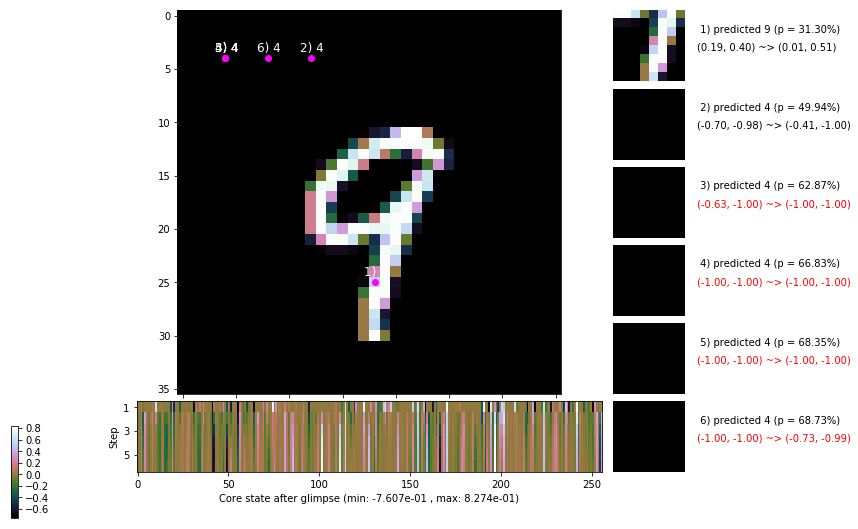

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 166.8 ms/b | lr: 8.75e-04 | grad 2norm: 21.28 | grad inf norm:  6.255
         Weights || abs max:  1.95 (10372.01) | mean: -1.03e-03 ( 0.02) | var: 3.56e-02 (44276.99)
          Biases || abs max:  1.89 (  216.97) | mean: -6.33e-02 ( 0.18) | var: 2.99e-02 (  571.02)
                    class loss: 1.228 | steps: 3.357 | reward:  2.905 | acc.: 56.13%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 165.8 ms/b | lr: 8.75e-04 | grad 2norm: 21.26 | grad inf norm:  6.459
         Weights || abs max:  1.97 ( 2483.62) | mean: -1.04e-03 ( 0.01) | var: 3.59e-02 (  410.94)
          Biases || abs max:  1.90 (  138.88) | mean: -6.32e-02 ( 0.15) | var: 3.01e-02 (   89.90)
                    class loss: 1.235 | steps: 3.386 | reward:  2.870 | acc.: 55.80%

	Target class: 2 | Discounted rewards: [3.686, 4.095, 3.4

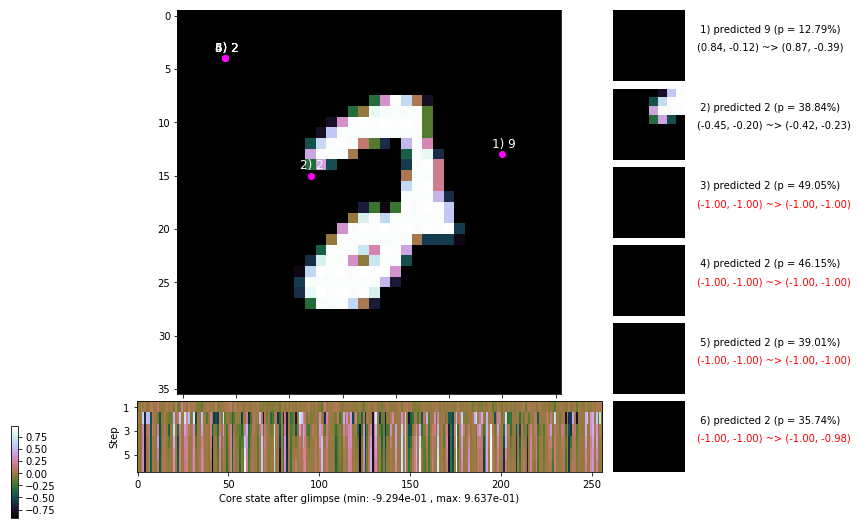

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 9 | Discounted rewards: [0.590, 0.656, 0.729, 0.810, 0.900, 1.000]


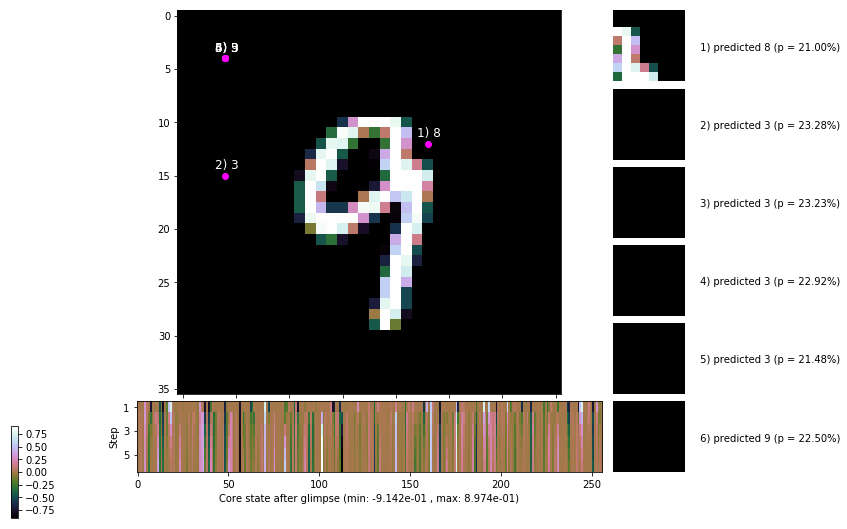


	Target class: 7 | Discounted rewards: [3.686, 4.095, 3.439, 2.710, 1.900, 1.000]


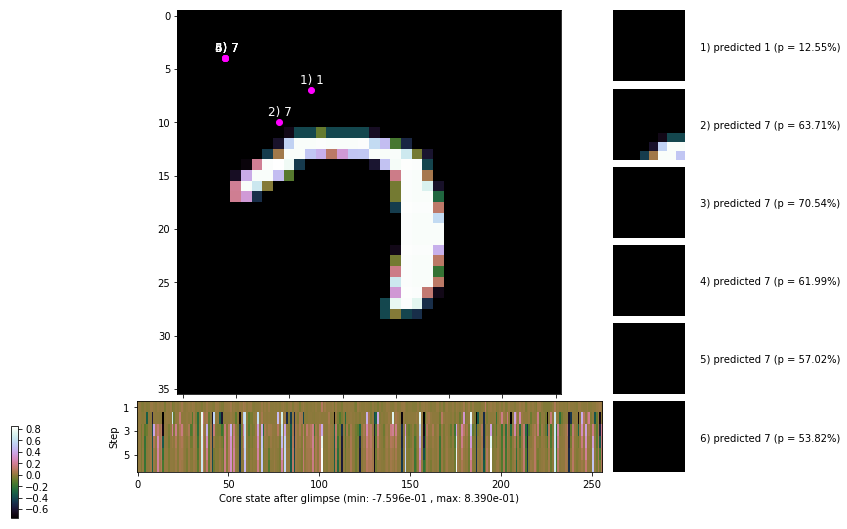

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


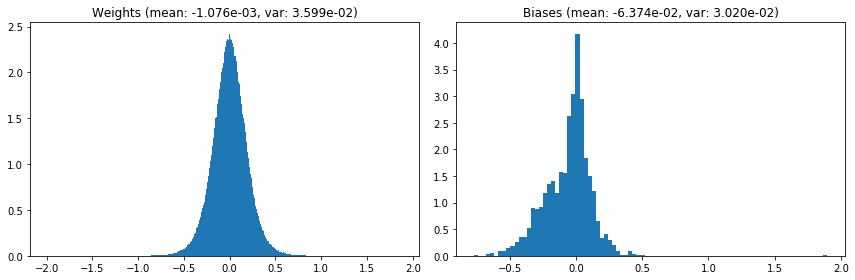

                                      Location network weights and biases


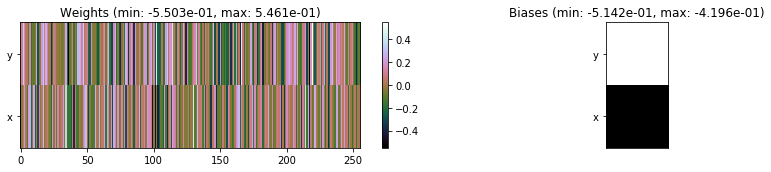

---------------------------------------------------------------------------------------------------------------
Elapsed time:  516.80 sec | TRAIN >> class loss: 1.2322 | steps:  3.374    | reward:  2.8876    | acc.: 55.722% :(
                          | VAL   >> class loss: 1.2325 | steps:  3.329    | reward:  2.9388    | acc.: 55.880% :(


Epoch  10/400) lr = 0.0008737
 b    300/  3000 >> 166.1 ms/b | lr: 8.73e-04 | grad 2norm: 20.91 | grad inf norm:  6.141
         Weights || abs max:  1.98 ( 1350.93) | mean: -1.05e-03 ( 0.01) | var: 3.61e-02 (   19.83)
          Biases || abs max:  1.91 (  127.00) | mean: -6.39e-02 ( 0.13) | var: 3.04e-02 (   64.61)
                    class loss: 1.220 | steps: 3.342 | reward:  2.914 | acc.: 56.38%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 164.5 ms/b | lr: 8.72e-04 | grad 2norm: 21.34 | grad inf norm:  6.020
         Weights || abs max:  1.98 ( 1873.78) | mean: -1.03e-03 (

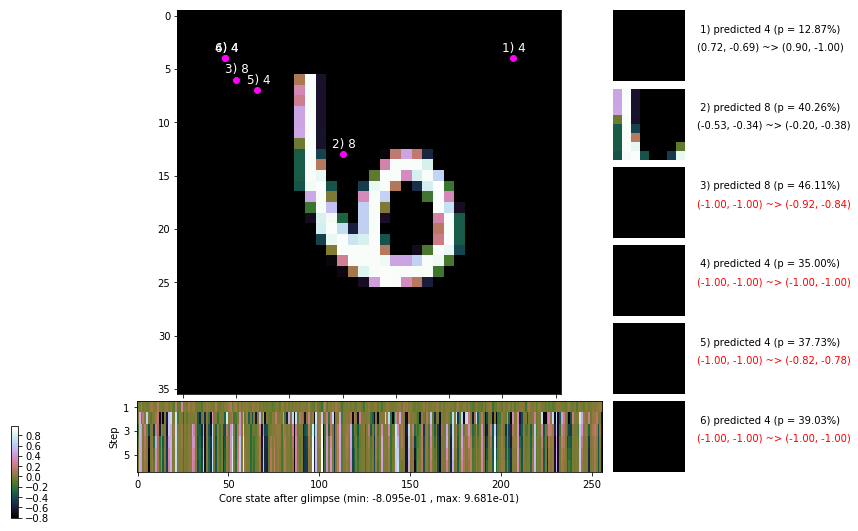

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 168.8 ms/b | lr: 8.70e-04 | grad 2norm: 21.85 | grad inf norm:  6.451
         Weights || abs max:  1.98 ( 2225.75) | mean: -1.05e-03 ( 0.01) | var: 3.66e-02 (  311.78)
          Biases || abs max:  1.91 (   86.48) | mean: -6.42e-02 ( 0.11) | var: 3.08e-02 (   20.16)
                    class loss: 1.248 | steps: 3.380 | reward:  2.886 | acc.: 55.45%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 181.2 ms/b | lr: 8.69e-04 | grad 2norm: 21.47 | grad inf norm:  6.189
         Weights || abs max:  1.98 ( 2151.60) | mean: -1.06e-03 ( 0.01) | var: 3.68e-02 (  125.62)
          Biases || abs max:  1.93 (  138.21) | mean: -6.39e-02 ( 0.14) | var: 3.10e-02 (  158.88)
                    class loss: 1.202 | steps: 3.322 | reward:  2.978 | acc.: 57.62%

	Target class: 0 | Discounted rewards: [1.000, 0.000, 0.0

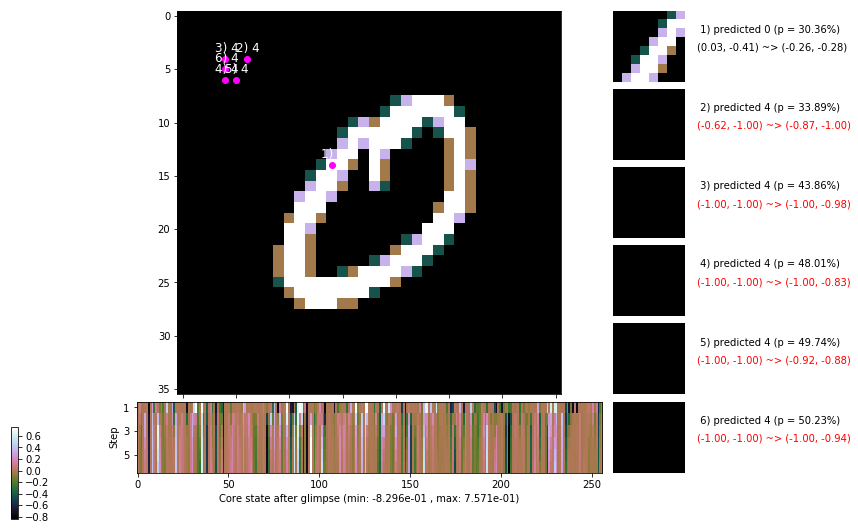

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 181.8 ms/b | lr: 8.68e-04 | grad 2norm: 21.13 | grad inf norm:  6.224
         Weights || abs max:  1.99 ( 1835.00) | mean: -1.07e-03 ( 0.01) | var: 3.71e-02 (   81.80)
          Biases || abs max:  1.93 (  222.55) | mean: -6.43e-02 ( 0.17) | var: 3.13e-02 ( 2190.63)
                    class loss: 1.218 | steps: 3.393 | reward:  2.872 | acc.: 55.53%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 185.8 ms/b | lr: 8.67e-04 | grad 2norm: 20.62 | grad inf norm:  6.130
         Weights || abs max:  2.00 ( 1752.52) | mean: -1.09e-03 ( 0.01) | var: 3.73e-02 (   59.85)
          Biases || abs max:  1.93 (  111.49) | mean: -6.56e-02 ( 0.13) | var: 3.14e-02 (   61.63)
                    class loss: 1.247 | steps: 3.408 | reward:  2.873 | acc.: 55.28%

	Target class: 0 | Discounted rewards: [3.686, 4.095, 3.4

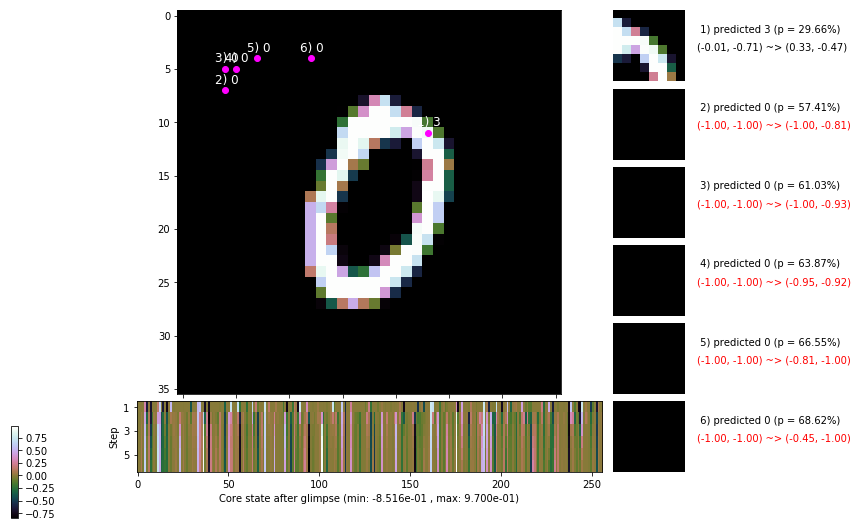

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 183.3 ms/b | lr: 8.65e-04 | grad 2norm: 20.97 | grad inf norm:  6.061
         Weights || abs max:  1.99 ( 5416.52) | mean: -1.12e-03 ( 0.02) | var: 3.75e-02 ( 8951.88)
          Biases || abs max:  1.93 (  149.61) | mean: -6.57e-02 ( 0.14) | var: 3.17e-02 (  208.47)
                    class loss: 1.205 | steps: 3.354 | reward:  2.936 | acc.: 57.03%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 173.0 ms/b | lr: 8.64e-04 | grad 2norm: 21.60 | grad inf norm:  6.274
         Weights || abs max:  1.98 ( 2195.12) | mean: -1.14e-03 ( 0.01) | var: 3.78e-02 (  249.35)
          Biases || abs max:  1.93 (  150.18) | mean: -6.53e-02 ( 0.14) | var: 3.18e-02 (  182.64)
                    class loss: 1.197 | steps: 3.360 | reward:  2.909 | acc.: 56.30%

	Target class: 4 | Discounted rewards: [3.786, 3.095, 3.4

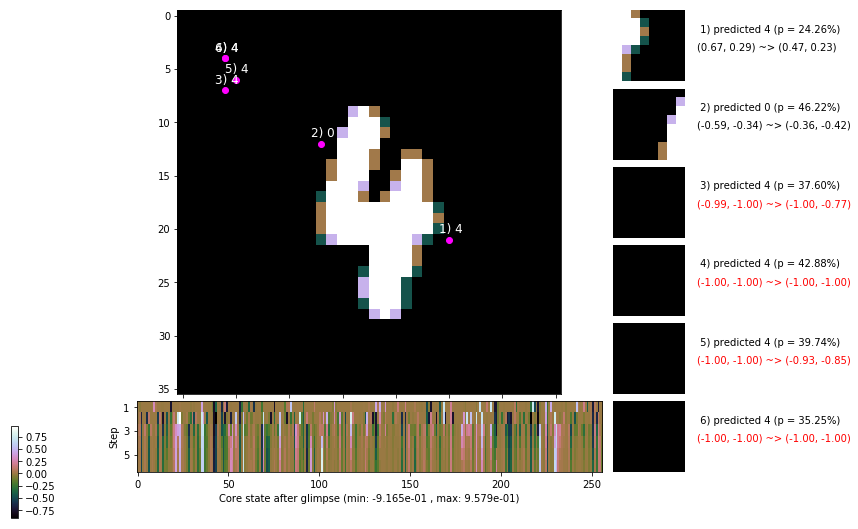

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 173.5 ms/b | lr: 8.62e-04 | grad 2norm: 21.21 | grad inf norm:  5.927
         Weights || abs max:  1.98 ( 2142.26) | mean: -1.16e-03 ( 0.01) | var: 3.80e-02 (  314.22)
          Biases || abs max:  1.93 (  180.50) | mean: -6.57e-02 ( 0.16) | var: 3.19e-02 (  774.10)
                    class loss: 1.200 | steps: 3.332 | reward:  2.933 | acc.: 56.97%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 172.8 ms/b | lr: 8.62e-04 | grad 2norm: 21.98 | grad inf norm:  6.606
         Weights || abs max:  2.00 ( 8463.79) | mean: -1.15e-03 ( 0.02) | var: 3.83e-02 (11389.22)
          Biases || abs max:  1.93 (  215.83) | mean: -6.60e-02 ( 0.17) | var: 3.20e-02 (  640.06)
                    class loss: 1.173 | steps: 3.337 | reward:  2.931 | acc.: 57.38%

	Target class: 4 | Discounted rewards: [1.000, 0.000, 0.0

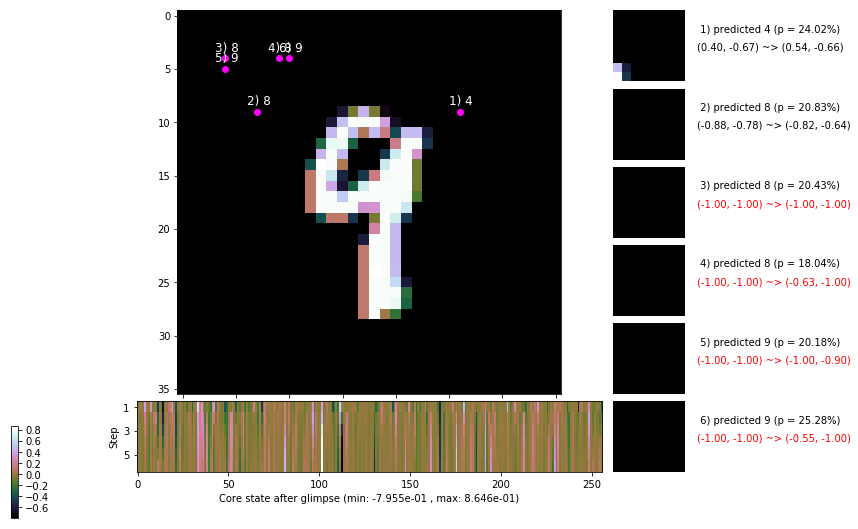

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 0 | Discounted rewards: [3.195, 2.439, 2.710, 1.900, 1.000, 0.000]


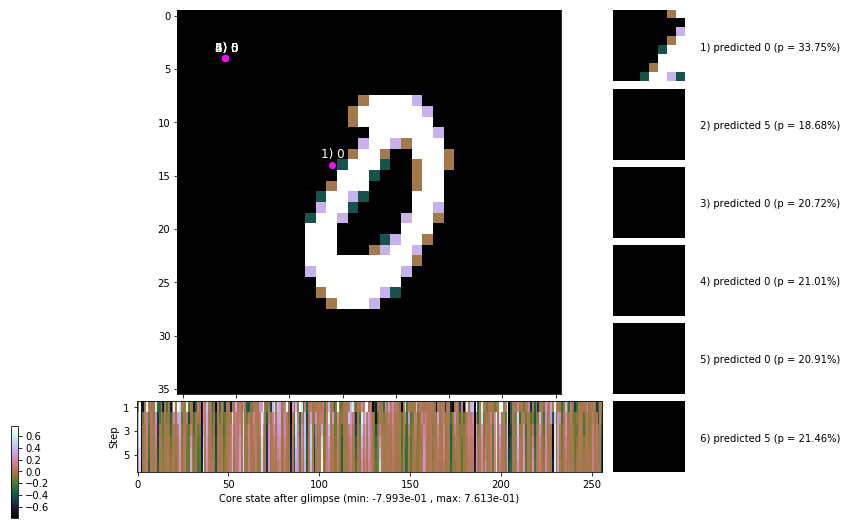


	Target class: 3 | Discounted rewards: [1.710, 1.900, 1.000, 0.000, 0.000, 0.000]


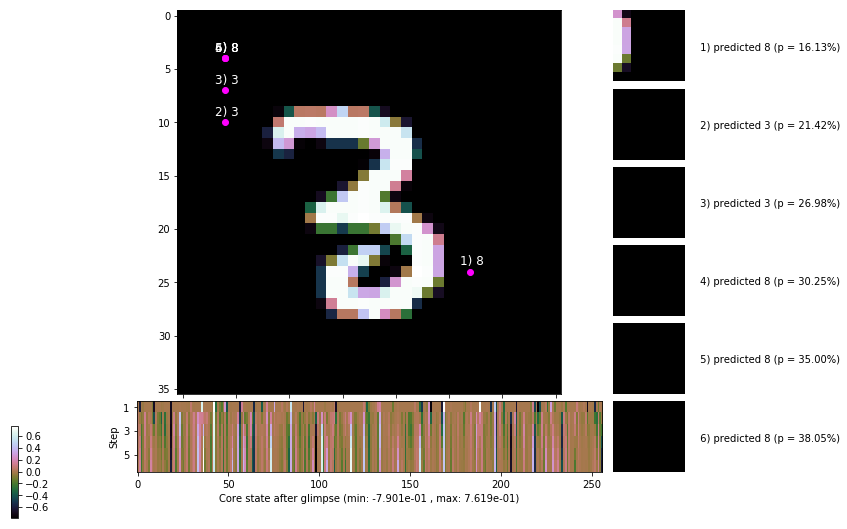

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


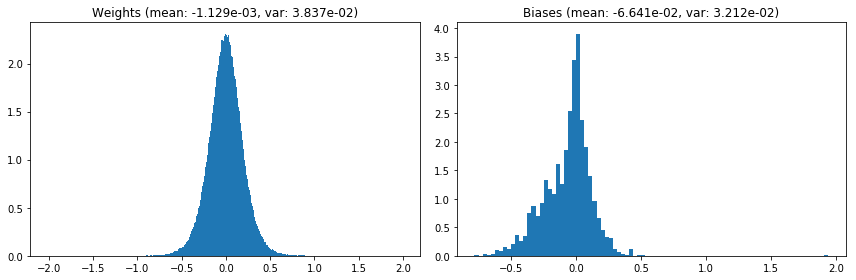

                                      Location network weights and biases


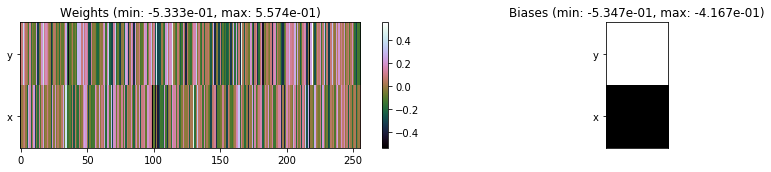

---------------------------------------------------------------------------------------------------------------
Elapsed time:  525.96 sec | TRAIN >> class loss: 1.2134 | steps:  3.359    | reward:  2.9131    | acc.: 56.410% :(
                          | VAL   >> class loss: 1.2185 | steps:  3.301    | reward:  2.9708    | acc.: 56.760% :(


Epoch  11/400) lr = 0.0008606
 b    300/  3000 >> 172.6 ms/b | lr: 8.60e-04 | grad 2norm: 21.07 | grad inf norm:  6.449
         Weights || abs max:  2.02 ( 2869.76) | mean: -1.10e-03 ( 0.01) | var: 3.85e-02 (  963.16)
          Biases || abs max:  1.93 (  145.80) | mean: -6.70e-02 ( 0.14) | var: 3.23e-02 (   79.78)
                    class loss: 1.261 | steps: 3.421 | reward:  2.833 | acc.: 54.35%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 173.9 ms/b | lr: 8.59e-04 | grad 2norm: 20.86 | grad inf norm:  6.079
         Weights || abs max:  2.02 ( 7671.47) | mean: -1.15e-03 (

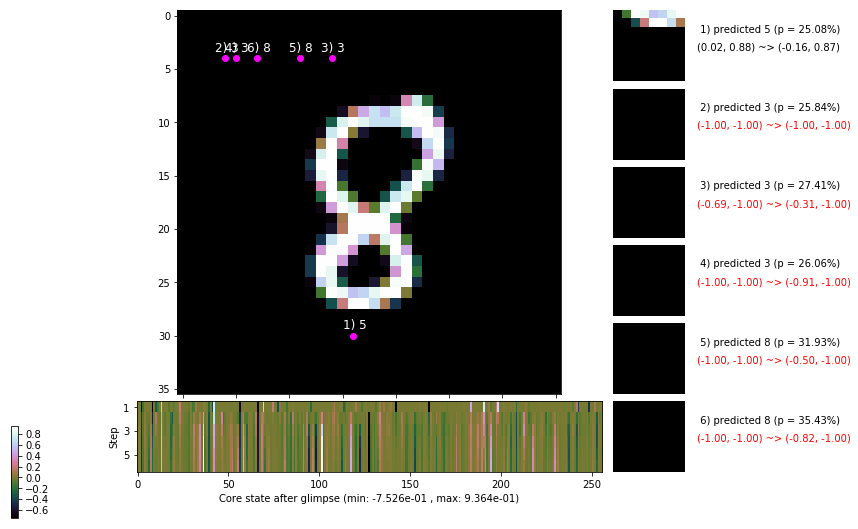

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 198.7 ms/b | lr: 8.57e-04 | grad 2norm: 21.36 | grad inf norm:  6.364
         Weights || abs max:  2.03 ( 1863.84) | mean: -1.12e-03 ( 0.01) | var: 3.89e-02 (  274.05)
          Biases || abs max:  1.94 (  165.37) | mean: -6.81e-02 ( 0.15) | var: 3.26e-02 (  129.44)
                    class loss: 1.200 | steps: 3.345 | reward:  2.949 | acc.: 56.95%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 179.9 ms/b | lr: 8.56e-04 | grad 2norm: 21.43 | grad inf norm:  6.115
         Weights || abs max:  2.04 ( 2040.50) | mean: -1.12e-03 ( 0.01) | var: 3.92e-02 (   97.18)
          Biases || abs max:  1.95 (  200.45) | mean: -6.88e-02 ( 0.16) | var: 3.28e-02 (  586.58)
                    class loss: 1.189 | steps: 3.314 | reward:  2.969 | acc.: 57.23%

	Target class: 7 | Discounted rewards: [0.000, 0.000, 0.0

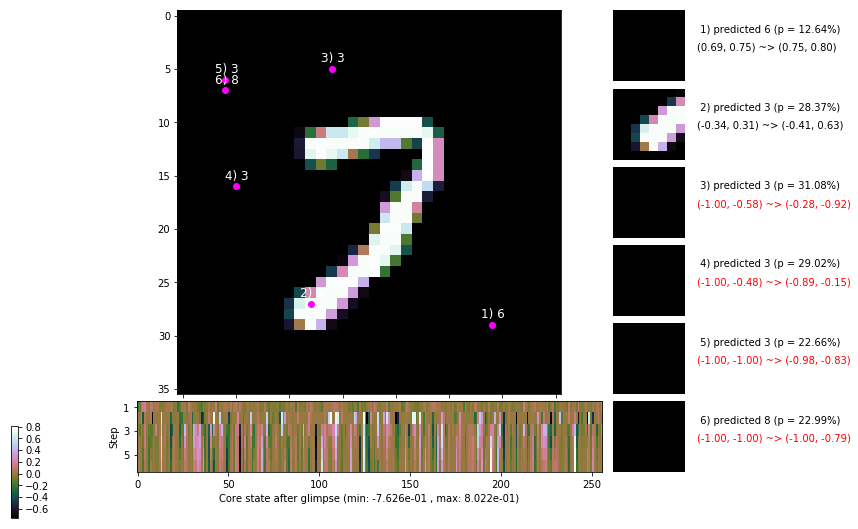

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 176.5 ms/b | lr: 8.55e-04 | grad 2norm: 21.06 | grad inf norm:  5.794
         Weights || abs max:  2.05 ( 2478.00) | mean: -1.11e-03 ( 0.01) | var: 3.94e-02 (  177.04)
          Biases || abs max:  1.96 (  168.59) | mean: -6.94e-02 ( 0.16) | var: 3.31e-02 (  274.12)
                    class loss: 1.177 | steps: 3.313 | reward:  2.972 | acc.: 57.70%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 172.5 ms/b | lr: 8.54e-04 | grad 2norm: 21.25 | grad inf norm:  6.020
         Weights || abs max:  2.05 ( 2003.37) | mean: -1.12e-03 ( 0.01) | var: 3.96e-02 (   63.48)
          Biases || abs max:  1.96 ( 1492.79) | mean: -7.00e-02 ( 0.68) | var: 3.33e-02 (158214.38)
                    class loss: 1.192 | steps: 3.341 | reward:  2.941 | acc.: 56.92%

	Target class: 7 | Discounted rewards: [3.686, 4.095, 3.

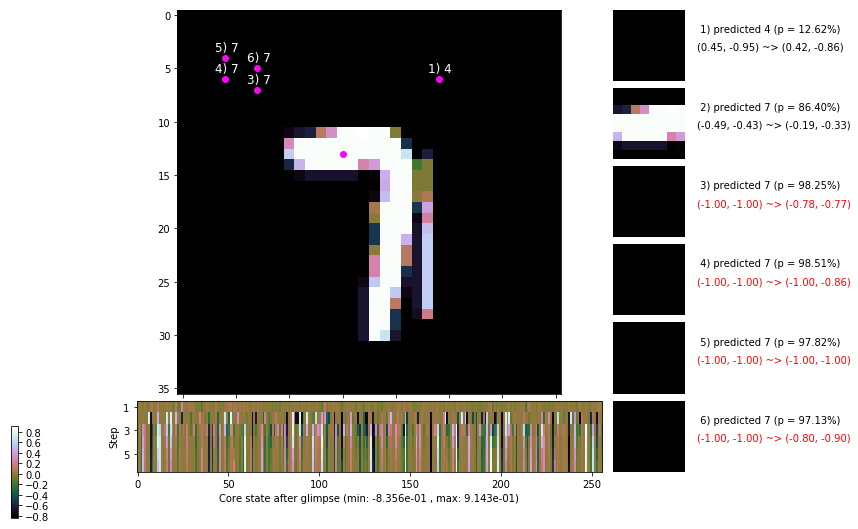

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 175.6 ms/b | lr: 8.52e-04 | grad 2norm: 21.36 | grad inf norm:  5.998
         Weights || abs max:  2.05 ( 1073.70) | mean: -1.11e-03 ( 0.01) | var: 3.98e-02 (   15.44)
          Biases || abs max:  1.97 (   88.84) | mean: -7.01e-02 ( 0.10) | var: 3.33e-02 (   21.75)
                    class loss: 1.142 | steps: 3.295 | reward:  3.013 | acc.: 58.30%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 173.9 ms/b | lr: 8.51e-04 | grad 2norm: 21.81 | grad inf norm:  6.307
         Weights || abs max:  2.05 ( 4402.18) | mean: -1.10e-03 ( 0.01) | var: 4.00e-02 ( 1749.94)
          Biases || abs max:  1.99 (   84.88) | mean: -7.01e-02 ( 0.11) | var: 3.35e-02 (   28.25)
                    class loss: 1.180 | steps: 3.295 | reward:  2.995 | acc.: 57.67%

	Target class: 5 | Discounted rewards: [0.000, 0.000, 0.0

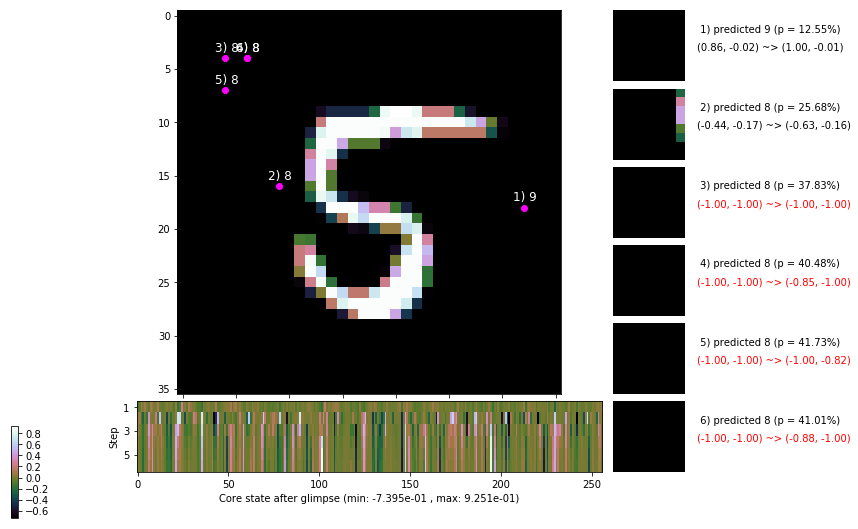

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 174.2 ms/b | lr: 8.50e-04 | grad 2norm: 21.76 | grad inf norm:  6.336
         Weights || abs max:  2.05 ( 2147.78) | mean: -1.07e-03 ( 0.01) | var: 4.03e-02 (   62.50)
          Biases || abs max:  1.99 (   91.76) | mean: -6.99e-02 ( 0.11) | var: 3.38e-02 (   22.66)
                    class loss: 1.163 | steps: 3.280 | reward:  3.011 | acc.: 58.47%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 171.8 ms/b | lr: 8.49e-04 | grad 2norm: 21.83 | grad inf norm:  6.308
         Weights || abs max:  2.05 ( 2197.98) | mean: -1.04e-03 ( 0.01) | var: 4.05e-02 (   96.22)
          Biases || abs max:  2.00 (  155.95) | mean: -7.00e-02 ( 0.14) | var: 3.40e-02 (  140.39)
                    class loss: 1.185 | steps: 3.316 | reward:  2.977 | acc.: 57.47%

	Target class: 7 | Discounted rewards: [1.900, 1.000, 0.0

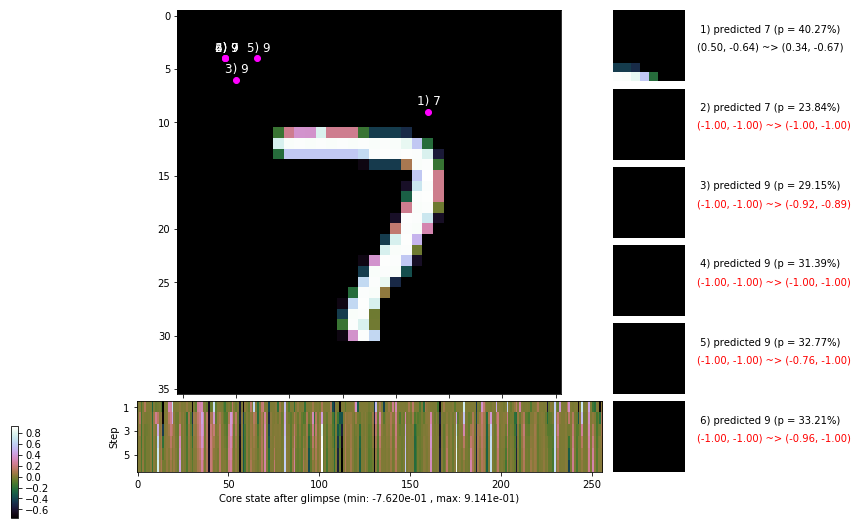

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 2 | Discounted rewards: [2.195, 2.439, 2.710, 1.900, 1.000, 0.000]


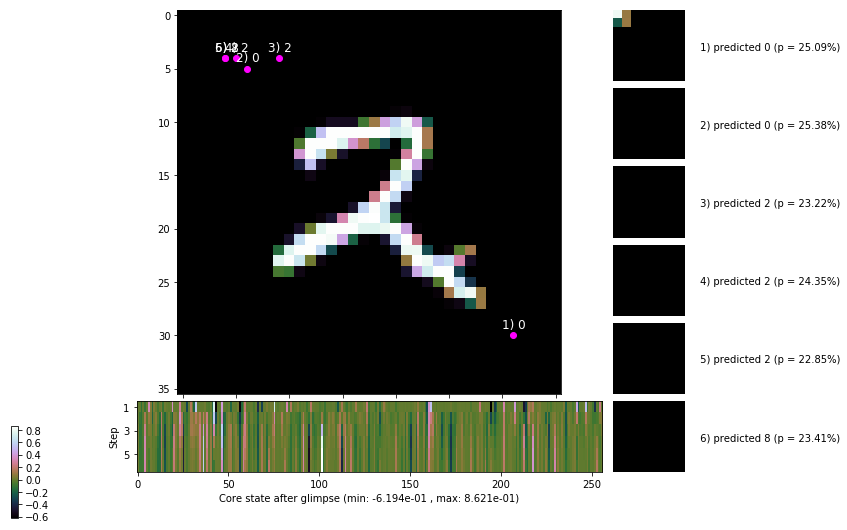


	Target class: 9 | Discounted rewards: [0.000, 0.000, 0.000, 0.000, 0.000, 0.000]


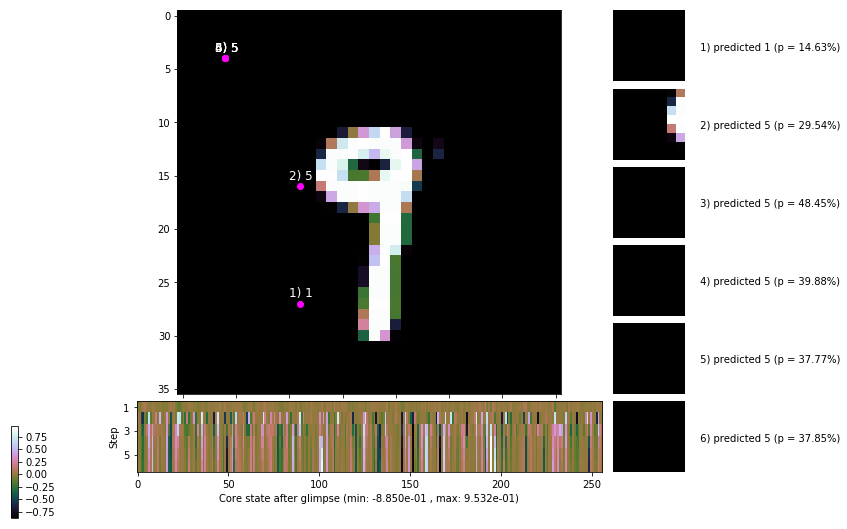

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


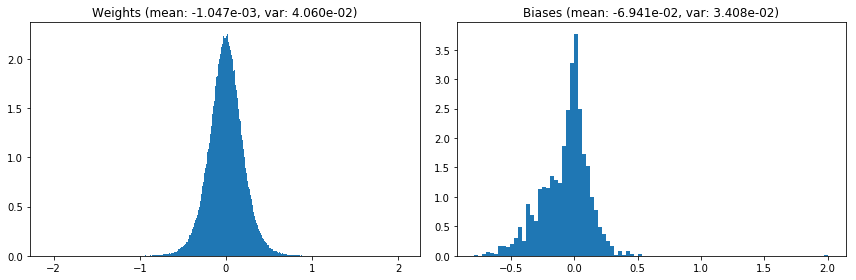

                                      Location network weights and biases


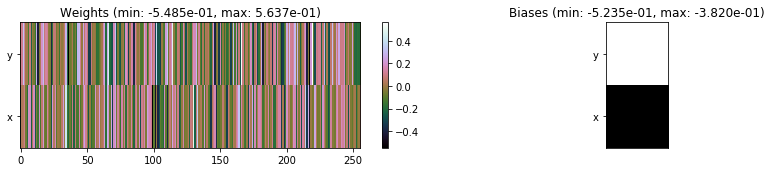

---------------------------------------------------------------------------------------------------------------
Elapsed time:  531.55 sec | TRAIN >> class loss: 1.1910 | steps:  3.328    | reward:  2.9583    | acc.: 57.190% 
                          | VAL   >> class loss: 1.2218 | steps:  3.296    | reward:  2.9646 :( | acc.: 56.060% :(


Epoch  12/400) lr = 0.0008478
 b    300/  3000 >> 171.3 ms/b | lr: 8.47e-04 | grad 2norm: 21.65 | grad inf norm:  6.407
         Weights || abs max:  2.08 ( 1485.20) | mean: -1.04e-03 ( 0.01) | var: 4.07e-02 (   56.01)
          Biases || abs max:  2.01 (  193.53) | mean: -6.99e-02 ( 0.15) | var: 3.42e-02 (  318.10)
                    class loss: 1.169 | steps: 3.275 | reward:  3.020 | acc.: 58.05%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 174.0 ms/b | lr: 8.46e-04 | grad 2norm: 21.46 | grad inf norm:  6.181
         Weights || abs max:  2.09 ( 2413.97) | mean: -1.02e-03 ( 0

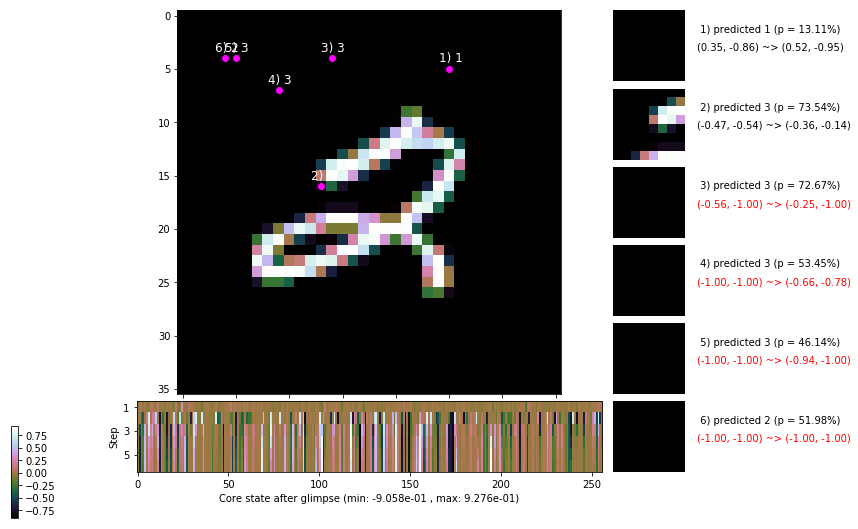

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 174.6 ms/b | lr: 8.44e-04 | grad 2norm: 21.41 | grad inf norm:  6.156
         Weights || abs max:  2.08 ( 1726.62) | mean: -1.04e-03 ( 0.01) | var: 4.11e-02 (   68.08)
          Biases || abs max:  2.03 (  135.51) | mean: -7.08e-02 ( 0.13) | var: 3.47e-02 (  176.54)
                    class loss: 1.150 | steps: 3.260 | reward:  3.025 | acc.: 57.98%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 192.5 ms/b | lr: 8.44e-04 | grad 2norm: 21.91 | grad inf norm:  6.466
         Weights || abs max:  2.08 ( 2607.39) | mean: -1.07e-03 ( 0.01) | var: 4.13e-02 (  380.47)
          Biases || abs max:  2.05 (  243.55) | mean: -7.12e-02 ( 0.20) | var: 3.48e-02 (  920.05)
                    class loss: 1.174 | steps: 3.240 | reward:  3.042 | acc.: 58.08%

	Target class: 4 | Discounted rewards: [4.686, 4.095, 3.4

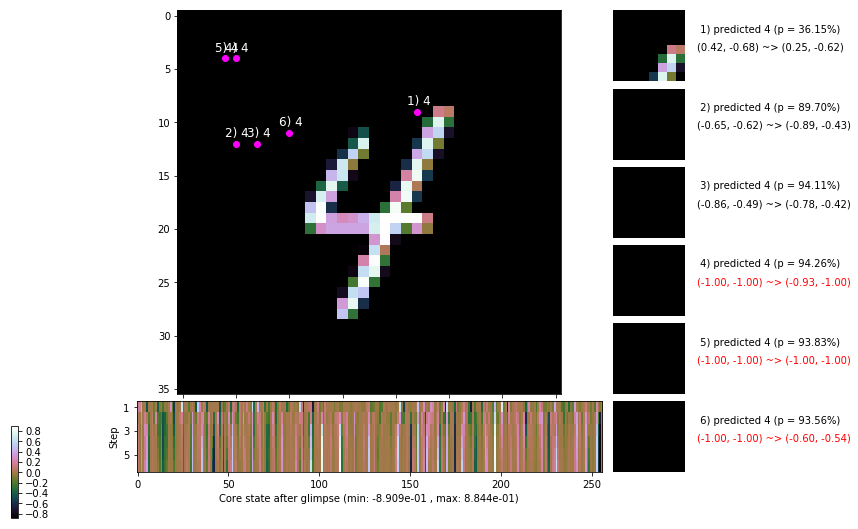

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 186.3 ms/b | lr: 8.42e-04 | grad 2norm: 21.48 | grad inf norm:  6.498
         Weights || abs max:  2.11 ( 3238.87) | mean: -1.08e-03 ( 0.01) | var: 4.16e-02 (  339.25)
          Biases || abs max:  2.05 (  123.04) | mean: -7.15e-02 ( 0.13) | var: 3.50e-02 (   65.72)
                    class loss: 1.165 | steps: 3.270 | reward:  3.029 | acc.: 58.82%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 162.6 ms/b | lr: 8.41e-04 | grad 2norm: 21.46 | grad inf norm:  6.172
         Weights || abs max:  2.13 ( 2347.56) | mean: -1.10e-03 ( 0.01) | var: 4.18e-02 (  264.65)
          Biases || abs max:  2.06 ( 1280.45) | mean: -7.22e-02 ( 0.57) | var: 3.53e-02 (163096.36)
                    class loss: 1.154 | steps: 3.251 | reward:  3.064 | acc.: 58.90%

	Target class: 0 | Discounted rewards: [0.590, 0.656, 0.

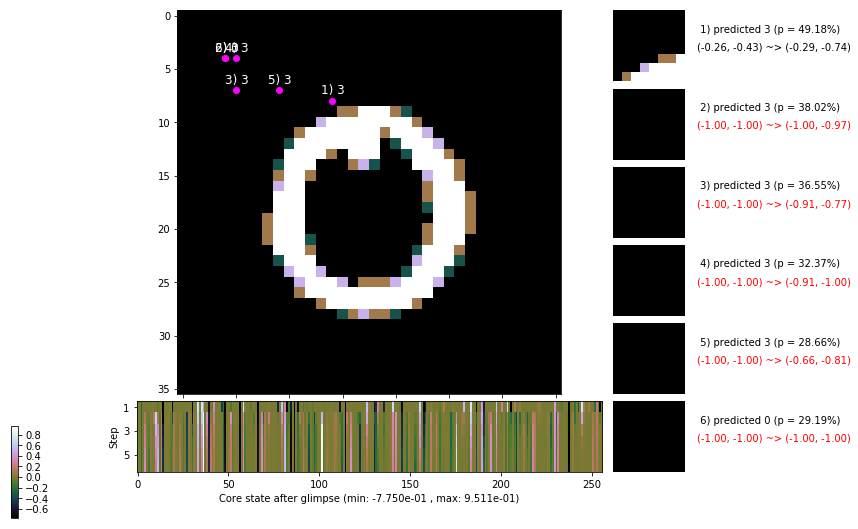

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 161.1 ms/b | lr: 8.39e-04 | grad 2norm: 21.38 | grad inf norm:  5.859
         Weights || abs max:  2.13 ( 2250.23) | mean: -1.07e-03 ( 0.01) | var: 4.20e-02 (  169.73)
          Biases || abs max:  2.07 (   64.07) | mean: -7.18e-02 ( 0.09) | var: 3.54e-02 (    9.11)
                    class loss: 1.162 | steps: 3.318 | reward:  2.982 | acc.: 58.10%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 158.4 ms/b | lr: 8.39e-04 | grad 2norm: 21.49 | grad inf norm:  6.006
         Weights || abs max:  2.14 ( 2677.98) | mean: -1.06e-03 ( 0.01) | var: 4.22e-02 (  760.10)
          Biases || abs max:  2.07 (  247.54) | mean: -7.17e-02 ( 0.19) | var: 3.56e-02 ( 1327.04)
                    class loss: 1.160 | steps: 3.278 | reward:  3.010 | acc.: 58.07%

	Target class: 5 | Discounted rewards: [0.000, 0.000, 0.0

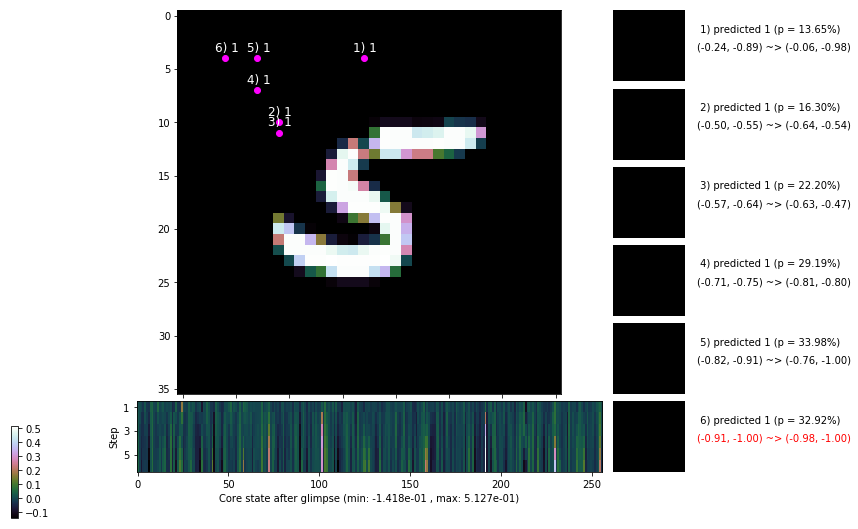

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 161.9 ms/b | lr: 8.37e-04 | grad 2norm: 21.62 | grad inf norm:  6.403
         Weights || abs max:  2.14 ( 2007.37) | mean: -1.05e-03 ( 0.01) | var: 4.24e-02 (  121.22)
          Biases || abs max:  2.07 (  173.05) | mean: -7.19e-02 ( 0.16) | var: 3.58e-02 (  445.13)
                    class loss: 1.150 | steps: 3.287 | reward:  3.021 | acc.: 58.78%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 158.9 ms/b | lr: 8.36e-04 | grad 2norm: 21.84 | grad inf norm:  6.502
         Weights || abs max:  2.14 (     inf) | mean: -1.02e-03 (  inf) | var: 4.27e-02 (     nan)
          Biases || abs max:  2.08 (  201.42) | mean: -7.22e-02 ( 0.15) | var: 3.59e-02 (  827.06)
                    class loss: 1.167 | steps: 3.261 | reward:  3.042 | acc.: 58.82%

	Target class: 5 | Discounted rewards: [4.686, 4.095, 3.4

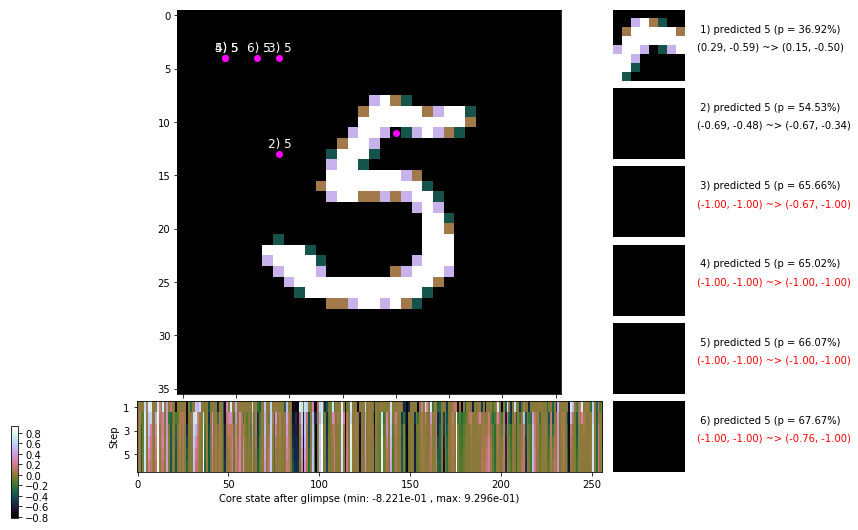

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 4 | Discounted rewards: [4.686, 4.095, 3.439, 2.710, 1.900, 1.000]


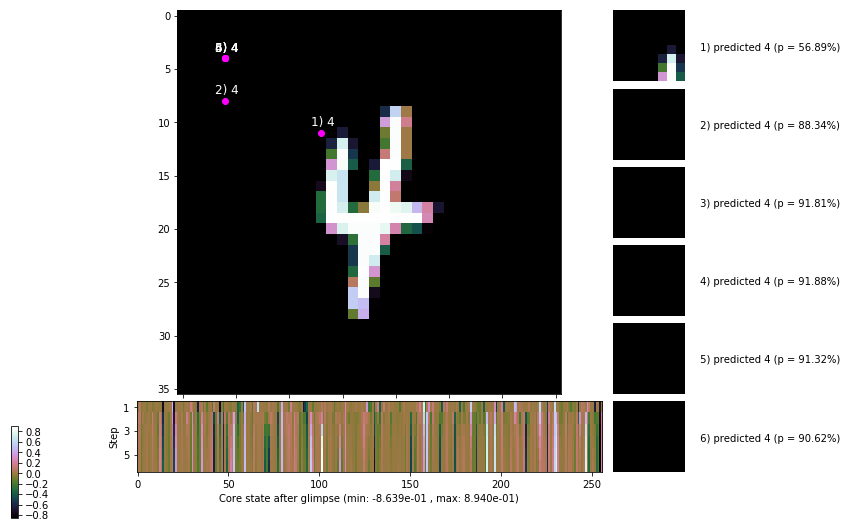


	Target class: 5 | Discounted rewards: [0.000, 0.000, 0.000, 0.000, 0.000, 0.000]


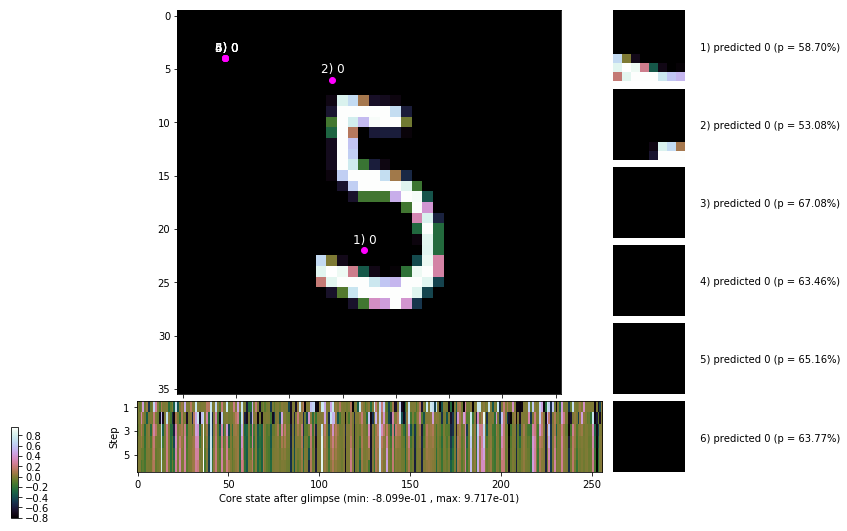

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


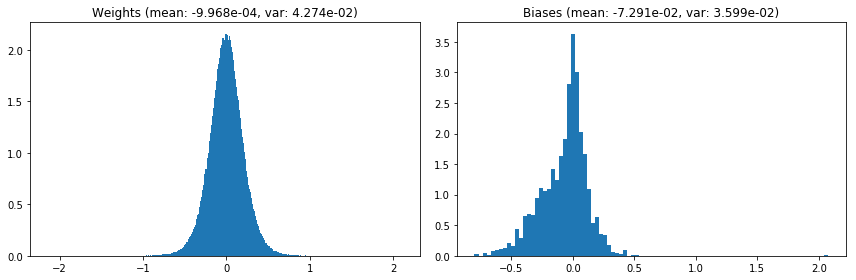

                                      Location network weights and biases


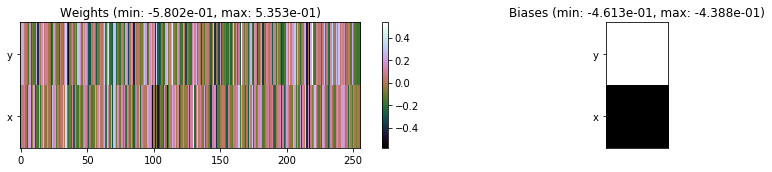

---------------------------------------------------------------------------------------------------------------
Elapsed time:  511.20 sec | TRAIN >> class loss: 1.1616 | steps:  3.272    | reward:  3.0264    | acc.: 58.395% 
                          | VAL   >> class loss: 1.1873 | steps:  3.232    | reward:  3.0294    | acc.: 57.420% 


Epoch  13/400) lr = 0.0008352
 b    300/  3000 >> 157.7 ms/b | lr: 8.34e-04 | grad 2norm: 21.32 | grad inf norm:  6.090
         Weights || abs max:  2.14 ( 7648.74) | mean: -1.00e-03 ( 0.02) | var: 4.29e-02 (19967.59)
          Biases || abs max:  2.08 (  101.22) | mean: -7.28e-02 ( 0.12) | var: 3.59e-02 (   67.04)
                    class loss: 1.149 | steps: 3.252 | reward:  3.049 | acc.: 58.83%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 158.3 ms/b | lr: 8.34e-04 | grad 2norm: 21.66 | grad inf norm:  6.238
         Weights || abs max:  2.14 ( 4429.38) | mean: -1.00e-03 ( 0.0

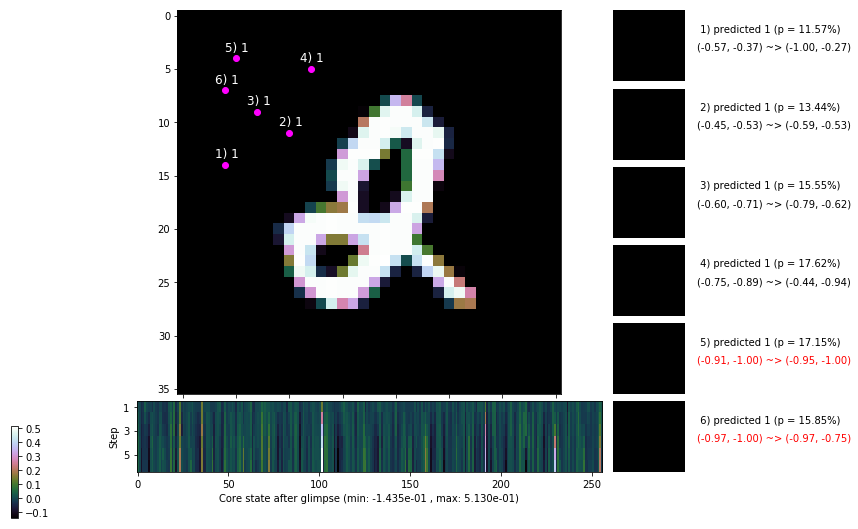

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 160.5 ms/b | lr: 8.32e-04 | grad 2norm: 21.47 | grad inf norm:  6.477
         Weights || abs max:  2.15 ( 1597.62) | mean: -9.73e-04 ( 0.01) | var: 4.33e-02 (   39.22)
          Biases || abs max:  2.09 (  162.92) | mean: -7.37e-02 ( 0.14) | var: 3.64e-02 (  242.52)
                    class loss: 1.147 | steps: 3.267 | reward:  3.064 | acc.: 59.87%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 158.4 ms/b | lr: 8.31e-04 | grad 2norm: 21.53 | grad inf norm:  6.525
         Weights || abs max:  2.15 ( 2207.50) | mean: -9.31e-04 ( 0.01) | var: 4.35e-02 (  236.55)
          Biases || abs max:  2.09 (  119.51) | mean: -7.45e-02 ( 0.12) | var: 3.66e-02 (   52.69)
                    class loss: 1.177 | steps: 3.297 | reward:  3.001 | acc.: 58.12%

	Target class: 6 | Discounted rewards: [4.686, 4.095, 3.4

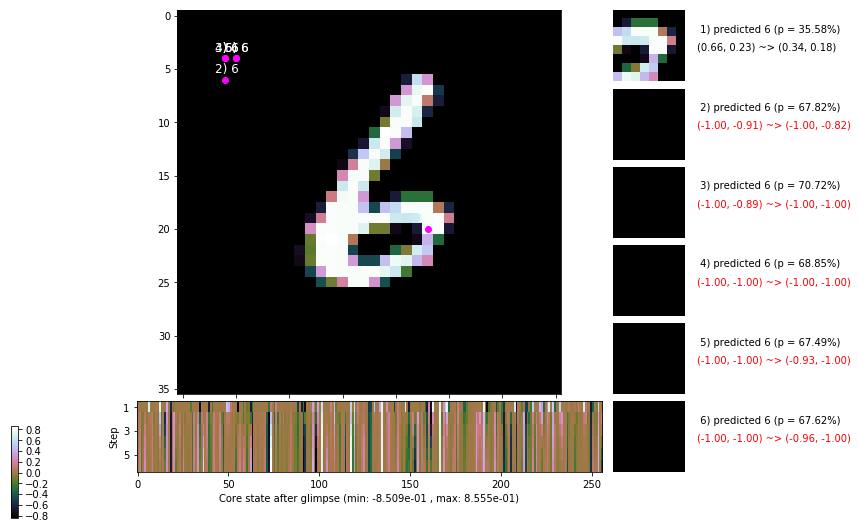

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 160.7 ms/b | lr: 8.29e-04 | grad 2norm: 21.86 | grad inf norm:  6.285
         Weights || abs max:  2.15 ( 1814.36) | mean: -9.44e-04 ( 0.01) | var: 4.37e-02 (   75.31)
          Biases || abs max:  2.09 (  113.34) | mean: -7.46e-02 ( 0.13) | var: 3.66e-02 (   97.32)
                    class loss: 1.122 | steps: 3.192 | reward:  3.113 | acc.: 60.07%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 174.6 ms/b | lr: 8.29e-04 | grad 2norm: 22.11 | grad inf norm:  6.226
         Weights || abs max:  2.15 ( 2730.54) | mean: -9.44e-04 ( 0.01) | var: 4.38e-02 (  310.42)
          Biases || abs max:  2.10 (  257.64) | mean: -7.49e-02 ( 0.17) | var: 3.69e-02 ( 1692.46)
                    class loss: 1.138 | steps: 3.257 | reward:  3.056 | acc.: 59.70%

	Target class: 6 | Discounted rewards: [2.786, 3.095, 3.4

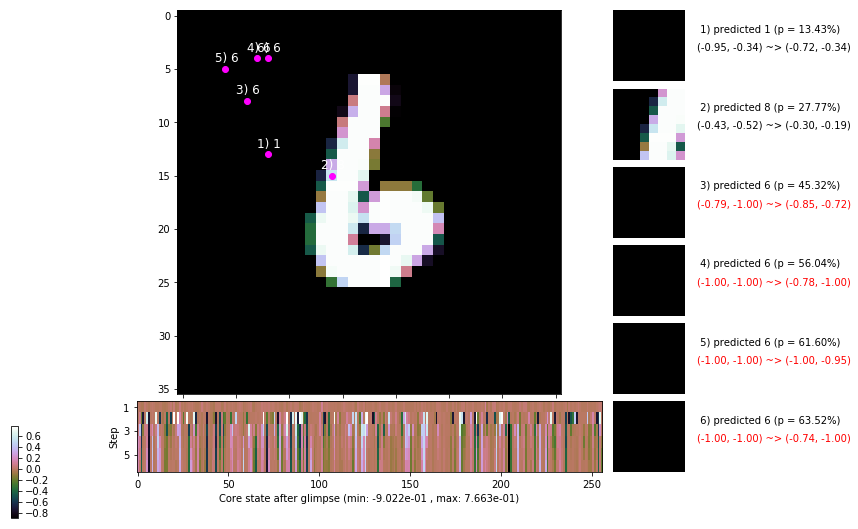

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 171.7 ms/b | lr: 8.27e-04 | grad 2norm: 21.92 | grad inf norm:  6.045
         Weights || abs max:  2.14 (     inf) | mean: -9.28e-04 (  inf) | var: 4.40e-02 (     nan)
          Biases || abs max:  2.11 (  109.37) | mean: -7.53e-02 ( 0.10) | var: 3.71e-02 (  210.86)
                    class loss: 1.096 | steps: 3.169 | reward:  3.137 | acc.: 60.63%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 158.8 ms/b | lr: 8.26e-04 | grad 2norm: 22.17 | grad inf norm:  6.221
         Weights || abs max:  2.16 ( 4838.08) | mean: -9.06e-04 ( 0.01) | var: 4.42e-02 ( 4787.45)
          Biases || abs max:  2.11 (   68.86) | mean: -7.59e-02 ( 0.10) | var: 3.72e-02 (   20.92)
                    class loss: 1.115 | steps: 3.229 | reward:  3.074 | acc.: 59.32%

	Target class: 8 | Discounted rewards: [4.686, 4.095, 3.4

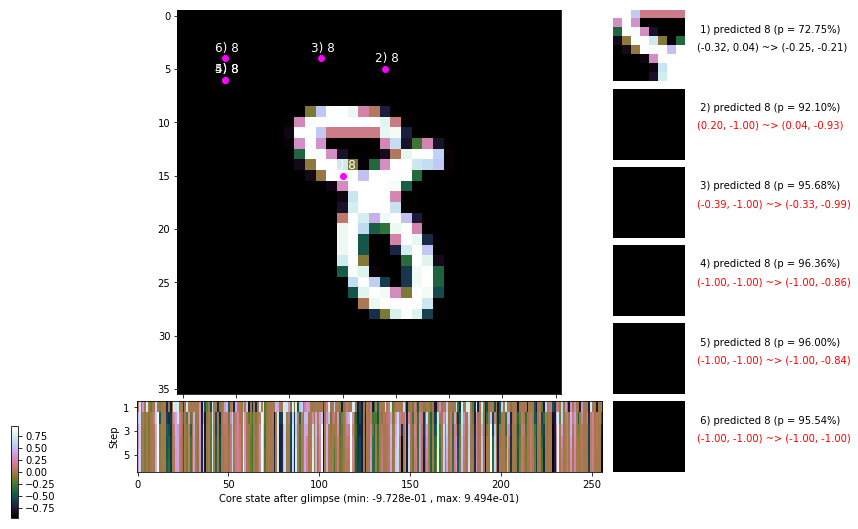

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 159.2 ms/b | lr: 8.24e-04 | grad 2norm: 22.15 | grad inf norm:  6.287
         Weights || abs max:  2.15 ( 3860.81) | mean: -9.15e-04 ( 0.01) | var: 4.44e-02 ( 1929.03)
          Biases || abs max:  2.13 (  137.70) | mean: -7.59e-02 ( 0.11) | var: 3.73e-02 (  301.82)
                    class loss: 1.078 | steps: 3.163 | reward:  3.150 | acc.: 61.53%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 158.6 ms/b | lr: 8.24e-04 | grad 2norm: 21.88 | grad inf norm:  6.036
         Weights || abs max:  2.15 ( 3042.66) | mean: -9.09e-04 ( 0.01) | var: 4.46e-02 (  640.48)
          Biases || abs max:  2.15 (  128.46) | mean: -7.64e-02 ( 0.11) | var: 3.75e-02 (  139.42)
                    class loss: 1.080 | steps: 3.148 | reward:  3.175 | acc.: 61.82%

	Target class: 7 | Discounted rewards: [0.000, 0.000, 0.0

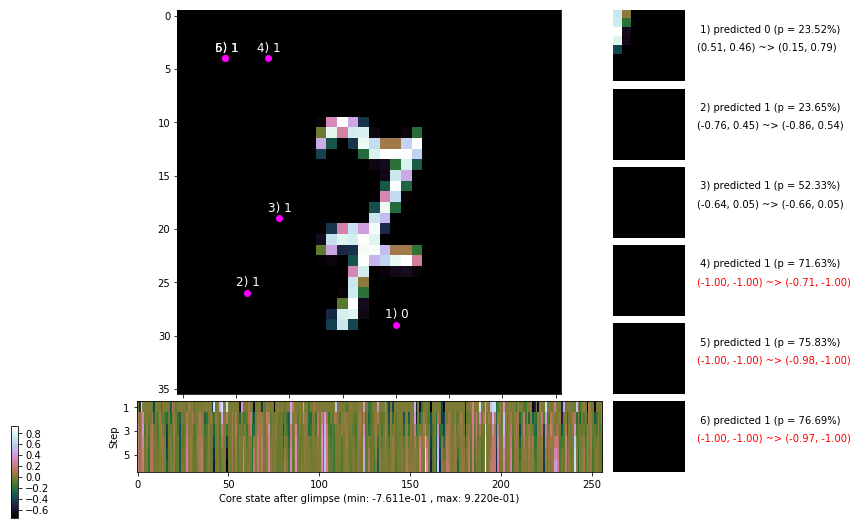

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 0 | Discounted rewards: [0.900, 1.000, 0.000, 0.000, 0.000, 0.000]


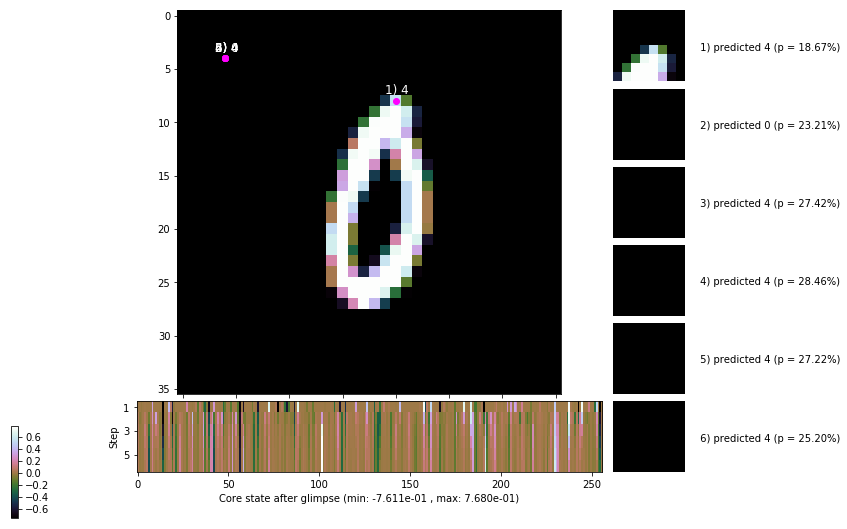


	Target class: 9 | Discounted rewards: [0.000, 0.000, 0.000, 0.000, 0.000, 0.000]


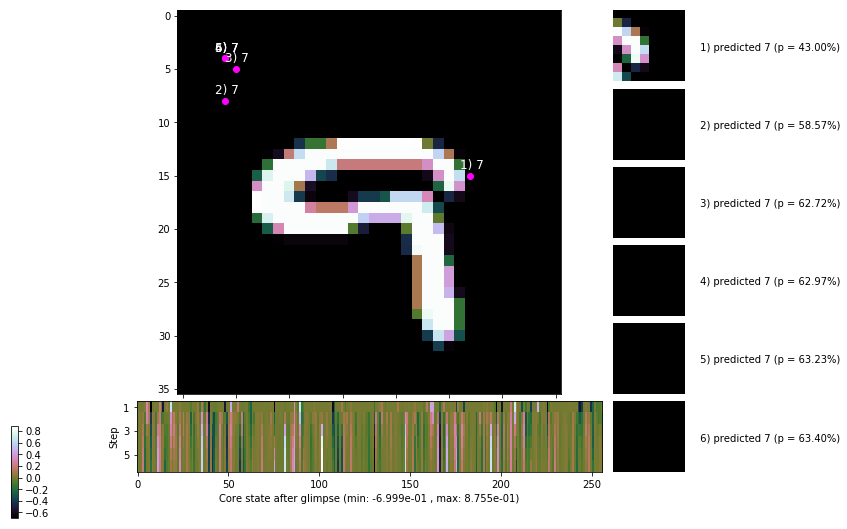

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


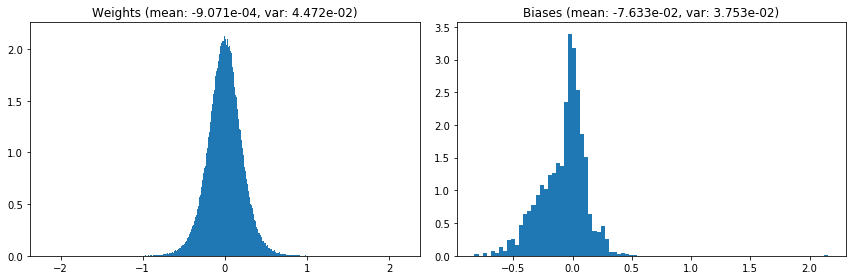

                                      Location network weights and biases


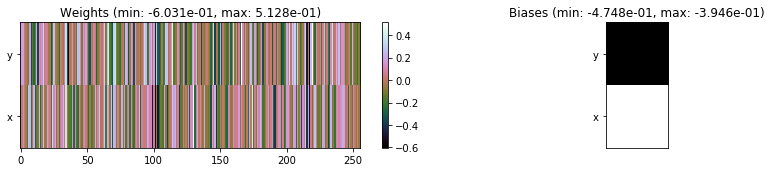

---------------------------------------------------------------------------------------------------------------
Elapsed time:  486.18 sec | TRAIN >> class loss: 1.1280 | steps:  3.222    | reward:  3.0864    | acc.: 59.847% 
                          | VAL   >> class loss: 1.0364 | steps:  3.087    | reward:  3.2556    | acc.: 62.540% 


Epoch  14/400) lr = 0.0008228
 b    300/  3000 >> 158.9 ms/b | lr: 8.22e-04 | grad 2norm: 22.26 | grad inf norm:  6.226
         Weights || abs max:  2.16 ( 2784.87) | mean: -9.12e-04 ( 0.01) | var: 4.48e-02 (  552.65)
          Biases || abs max:  2.15 (  112.62) | mean: -7.67e-02 ( 0.11) | var: 3.76e-02 (  107.10)
                    class loss: 1.113 | steps: 3.211 | reward:  3.092 | acc.: 60.05%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 159.1 ms/b | lr: 8.21e-04 | grad 2norm: 21.78 | grad inf norm:  6.022
         Weights || abs max:  2.17 ( 2094.64) | mean: -9.16e-04 ( 0.0

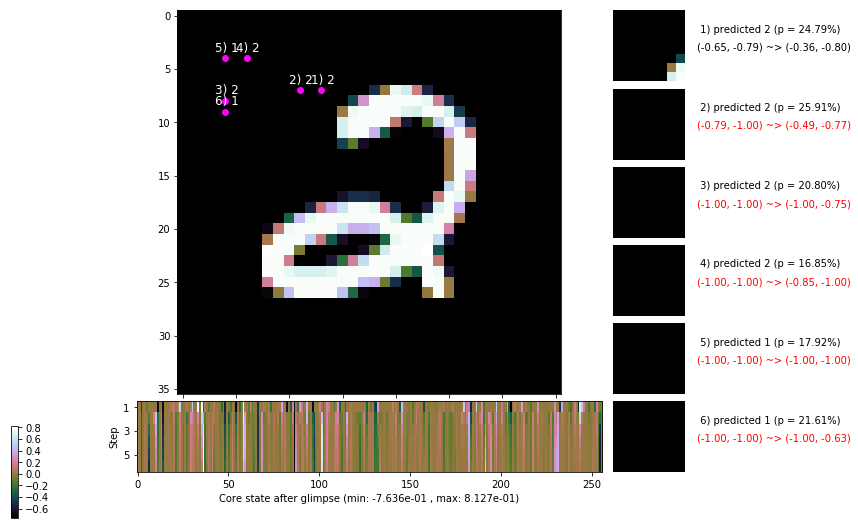

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 161.6 ms/b | lr: 8.19e-04 | grad 2norm: 21.66 | grad inf norm:  6.232
         Weights || abs max:  2.18 ( 1950.49) | mean: -9.22e-04 ( 0.01) | var: 4.52e-02 (   65.10)
          Biases || abs max:  2.16 (  137.76) | mean: -7.73e-02 ( 0.14) | var: 3.79e-02 (  599.01)
                    class loss: 1.169 | steps: 3.234 | reward:  3.050 | acc.: 58.83%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 159.7 ms/b | lr: 8.19e-04 | grad 2norm: 21.91 | grad inf norm:  6.144
         Weights || abs max:  2.19 ( 3627.71) | mean: -9.12e-04 ( 0.01) | var: 4.54e-02 ( 2532.59)
          Biases || abs max:  2.16 (   88.22) | mean: -7.73e-02 ( 0.10) | var: 3.79e-02 (   26.43)
                    class loss: 1.141 | steps: 3.209 | reward:  3.069 | acc.: 58.78%

	Target class: 3 | Discounted rewards: [0.000, 0.000, 0.0

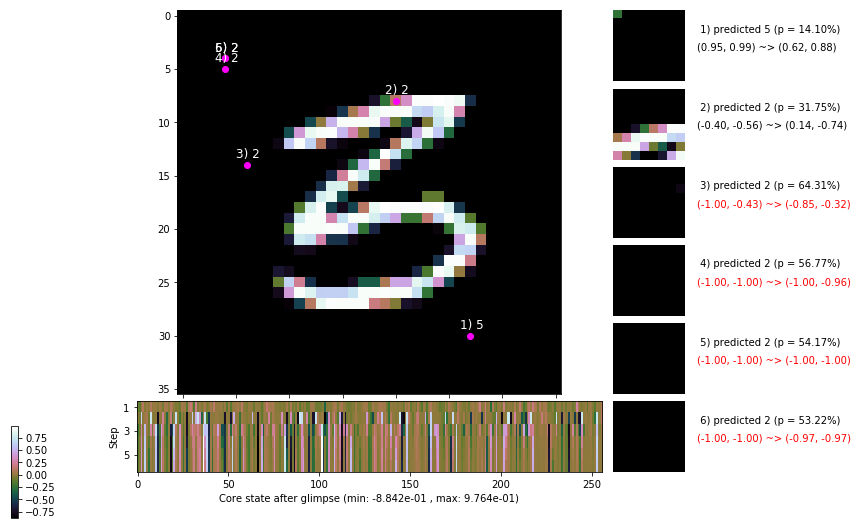

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 161.6 ms/b | lr: 8.17e-04 | grad 2norm: 21.53 | grad inf norm:  5.896
         Weights || abs max:  2.18 ( 1378.41) | mean: -9.28e-04 ( 0.01) | var: 4.56e-02 (   70.70)
          Biases || abs max:  2.16 (  108.19) | mean: -7.82e-02 ( 0.10) | var: 3.81e-02 (   73.40)
                    class loss: 1.143 | steps: 3.268 | reward:  3.015 | acc.: 58.33%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 161.1 ms/b | lr: 8.16e-04 | grad 2norm: 21.82 | grad inf norm:  6.236
         Weights || abs max:  2.19 ( 1486.24) | mean: -9.42e-04 ( 0.01) | var: 4.58e-02 (   31.59)
          Biases || abs max:  2.18 (   77.53) | mean: -7.82e-02 ( 0.08) | var: 3.84e-02 (   19.38)
                    class loss: 1.102 | steps: 3.166 | reward:  3.139 | acc.: 60.62%

	Target class: 7 | Discounted rewards: [2.195, 2.439, 2.7

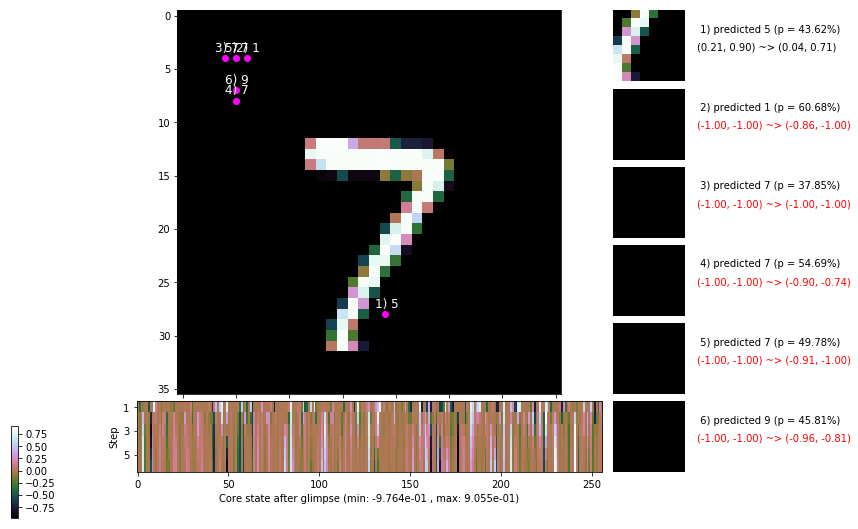

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 160.9 ms/b | lr: 8.15e-04 | grad 2norm: 21.61 | grad inf norm:  6.329
         Weights || abs max:  2.20 ( 2142.71) | mean: -9.25e-04 ( 0.01) | var: 4.60e-02 (  107.34)
          Biases || abs max:  2.18 (  212.66) | mean: -7.84e-02 ( 0.17) | var: 3.85e-02 (  701.97)
                    class loss: 1.098 | steps: 3.212 | reward:  3.117 | acc.: 60.80%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 174.5 ms/b | lr: 8.14e-04 | grad 2norm: 22.01 | grad inf norm:  6.461
         Weights || abs max:  2.20 ( 1284.93) | mean: -8.90e-04 ( 0.01) | var: 4.62e-02 (   16.24)
          Biases || abs max:  2.18 (  200.37) | mean: -7.85e-02 ( 0.15) | var: 3.88e-02 (  618.48)
                    class loss: 1.118 | steps: 3.240 | reward:  3.086 | acc.: 60.45%

	Target class: 5 | Discounted rewards: [4.686, 4.095, 3.4

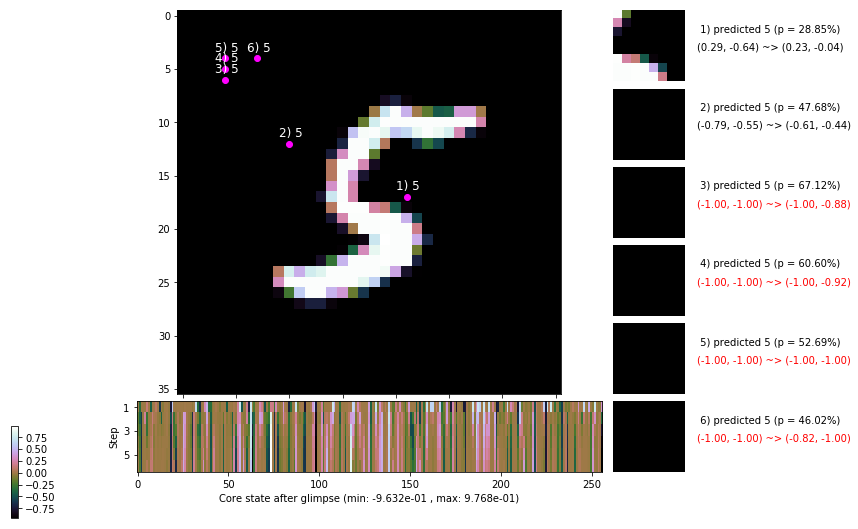

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 187.6 ms/b | lr: 8.12e-04 | grad 2norm: 21.62 | grad inf norm:  6.028
         Weights || abs max:  2.21 ( 3912.98) | mean: -8.88e-04 ( 0.01) | var: 4.64e-02 (  683.43)
          Biases || abs max:  2.19 (   78.87) | mean: -7.89e-02 ( 0.10) | var: 3.91e-02 (   13.94)
                    class loss: 1.134 | steps: 3.200 | reward:  3.124 | acc.: 60.00%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 156.2 ms/b | lr: 8.11e-04 | grad 2norm: 21.42 | grad inf norm:  6.005
         Weights || abs max:  2.22 ( 4449.79) | mean: -8.92e-04 ( 0.01) | var: 4.65e-02 ( 3714.80)
          Biases || abs max:  2.20 (   79.93) | mean: -7.91e-02 ( 0.09) | var: 3.93e-02 (   22.00)
                    class loss: 1.146 | steps: 3.203 | reward:  3.084 | acc.: 59.03%

	Target class: 4 | Discounted rewards: [4.686, 4.095, 3.4

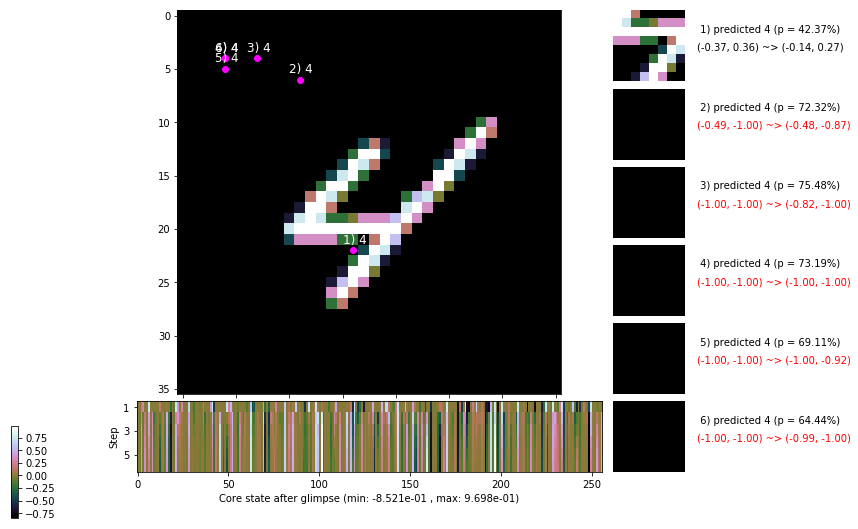

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 2 | Discounted rewards: [2.786, 3.095, 3.439, 2.710, 1.900, 1.000]


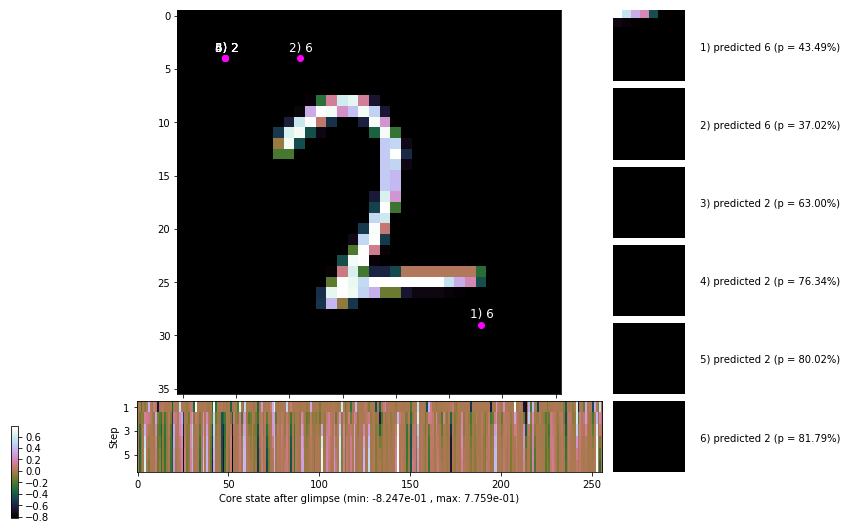


	Target class: 1 | Discounted rewards: [4.686, 4.095, 3.439, 2.710, 1.900, 1.000]


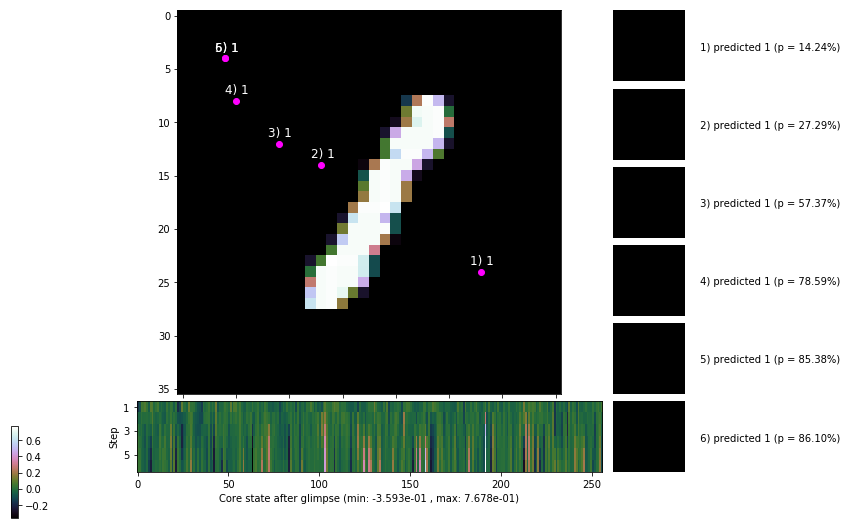

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


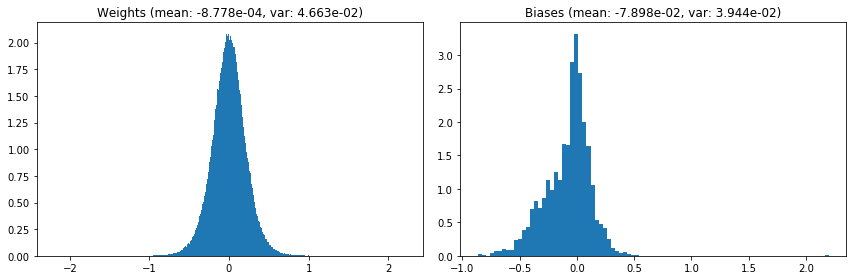

                                      Location network weights and biases


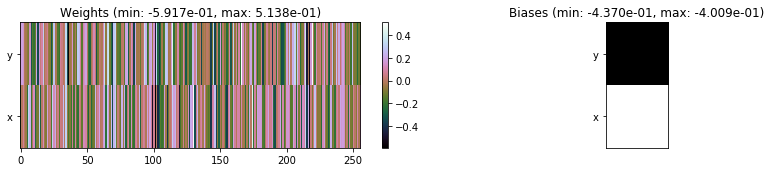

---------------------------------------------------------------------------------------------------------------
Elapsed time:  493.06 sec | TRAIN >> class loss: 1.1281 | steps:  3.212    | reward:  3.0890    | acc.: 59.730% :(
                          | VAL   >> class loss: 1.1074 | steps:  3.184 :( | reward:  3.1638 :( | acc.: 60.720% :(


Epoch  15/400) lr = 0.0008105
 b    300/  3000 >> 152.3 ms/b | lr: 8.10e-04 | grad 2norm: 21.33 | grad inf norm:  6.082
         Weights || abs max:  2.22 ( 2778.69) | mean: -8.91e-04 ( 0.01) | var: 4.67e-02 (  227.26)
          Biases || abs max:  2.20 (  472.84) | mean: -7.90e-02 ( 0.25) | var: 3.95e-02 ( 9175.68)
                    class loss: 1.121 | steps: 3.241 | reward:  3.100 | acc.: 60.18%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 155.4 ms/b | lr: 8.09e-04 | grad 2norm: 21.63 | grad inf norm:  5.905
         Weights || abs max:  2.22 ( 1554.77) | mean: -8.89e-04 (

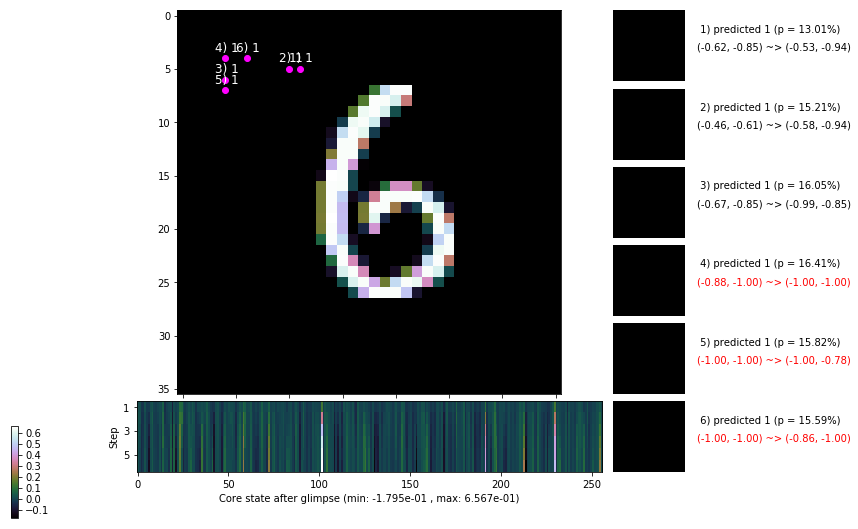

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 156.9 ms/b | lr: 8.07e-04 | grad 2norm: 21.92 | grad inf norm:  6.237
         Weights || abs max:  2.22 ( 2246.04) | mean: -8.75e-04 ( 0.01) | var: 4.71e-02 (  232.62)
          Biases || abs max:  2.22 (  200.08) | mean: -7.94e-02 ( 0.17) | var: 3.98e-02 ( 1829.56)
                    class loss: 1.115 | steps: 3.151 | reward:  3.156 | acc.: 60.92%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 154.2 ms/b | lr: 8.06e-04 | grad 2norm: 21.59 | grad inf norm:  6.177
         Weights || abs max:  2.24 ( 2105.73) | mean: -8.62e-04 ( 0.01) | var: 4.73e-02 (  236.12)
          Biases || abs max:  2.22 (  287.73) | mean: -8.00e-02 ( 0.16) | var: 4.00e-02 ( 2534.84)
                    class loss: 1.133 | steps: 3.209 | reward:  3.078 | acc.: 58.80%

	Target class: 4 | Discounted rewards: [0.000, 0.000, 0.0

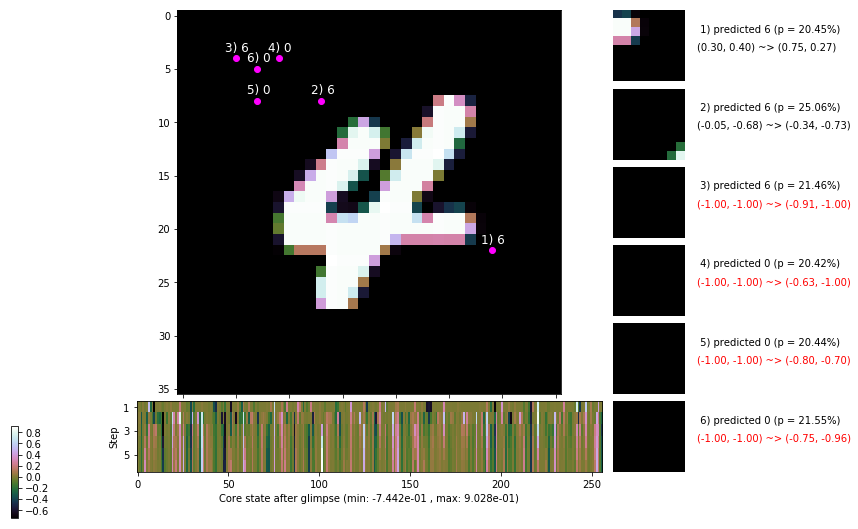

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 156.6 ms/b | lr: 8.05e-04 | grad 2norm: 22.25 | grad inf norm:  6.551
         Weights || abs max:  2.24 ( 3293.77) | mean: -8.43e-04 ( 0.01) | var: 4.75e-02 ( 1446.11)
          Biases || abs max:  2.23 (   96.13) | mean: -7.91e-02 ( 0.09) | var: 3.99e-02 (   92.42)
                    class loss: 1.088 | steps: 3.139 | reward:  3.171 | acc.: 61.08%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 154.7 ms/b | lr: 8.04e-04 | grad 2norm: 21.85 | grad inf norm:  6.158
         Weights || abs max:  2.24 ( 3779.93) | mean: -8.70e-04 ( 0.01) | var: 4.76e-02 (  611.85)
          Biases || abs max:  2.23 (  131.78) | mean: -8.00e-02 ( 0.10) | var: 4.00e-02 (  746.65)
                    class loss: 1.085 | steps: 3.148 | reward:  3.166 | acc.: 61.23%

	Target class: 9 | Discounted rewards: [3.686, 4.095, 3.4

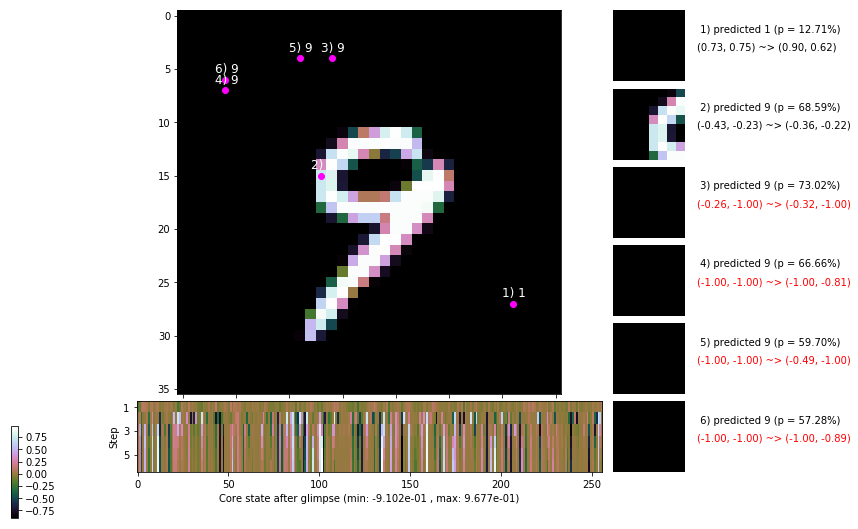

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 155.7 ms/b | lr: 8.02e-04 | grad 2norm: 21.46 | grad inf norm:  6.102
         Weights || abs max:  2.24 ( 1689.11) | mean: -8.59e-04 ( 0.01) | var: 4.78e-02 (  156.75)
          Biases || abs max:  2.24 (   89.34) | mean: -8.02e-02 ( 0.09) | var: 4.02e-02 (   85.04)
                    class loss: 1.108 | steps: 3.189 | reward:  3.131 | acc.: 60.38%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 154.4 ms/b | lr: 8.02e-04 | grad 2norm: 21.80 | grad inf norm:  6.125
         Weights || abs max:  2.24 ( 2077.21) | mean: -8.07e-04 ( 0.01) | var: 4.80e-02 (  486.72)
          Biases || abs max:  2.23 (   96.17) | mean: -8.04e-02 ( 0.10) | var: 4.02e-02 (   44.65)
                    class loss: 1.111 | steps: 3.172 | reward:  3.143 | acc.: 60.48%

	Target class: 4 | Discounted rewards: [0.000, 0.000, 0.0

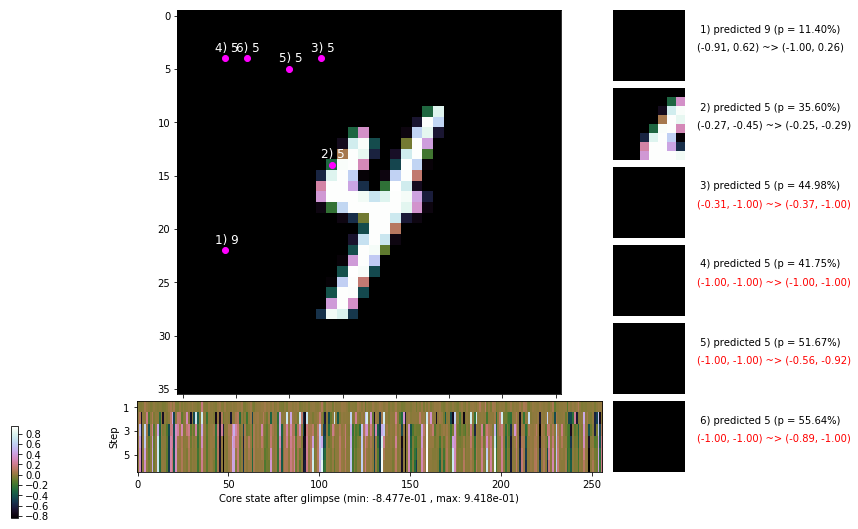

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 158.0 ms/b | lr: 8.00e-04 | grad 2norm: 21.84 | grad inf norm:  6.147
         Weights || abs max:  2.24 ( 1342.60) | mean: -7.66e-04 ( 0.01) | var: 4.82e-02 (   27.91)
          Biases || abs max:  2.23 (   85.68) | mean: -8.07e-02 ( 0.09) | var: 4.04e-02 (   43.54)
                    class loss: 1.080 | steps: 3.181 | reward:  3.163 | acc.: 61.20%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 159.3 ms/b | lr: 7.99e-04 | grad 2norm: 21.98 | grad inf norm:  6.704
         Weights || abs max:  2.24 ( 2008.86) | mean: -7.64e-04 ( 0.01) | var: 4.84e-02 (  234.04)
          Biases || abs max:  2.24 (  132.97) | mean: -8.08e-02 ( 0.11) | var: 4.05e-02 (  146.23)
                    class loss: 1.116 | steps: 3.219 | reward:  3.122 | acc.: 60.57%

	Target class: 1 | Discounted rewards: [4.686, 4.095, 3.4

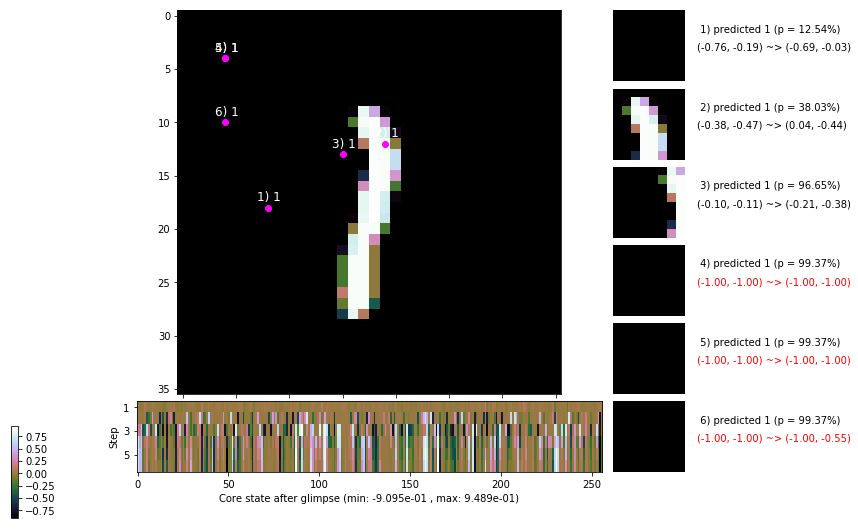

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 3 | Discounted rewards: [1.247, 1.385, 1.539, 1.710, 1.900, 1.000]


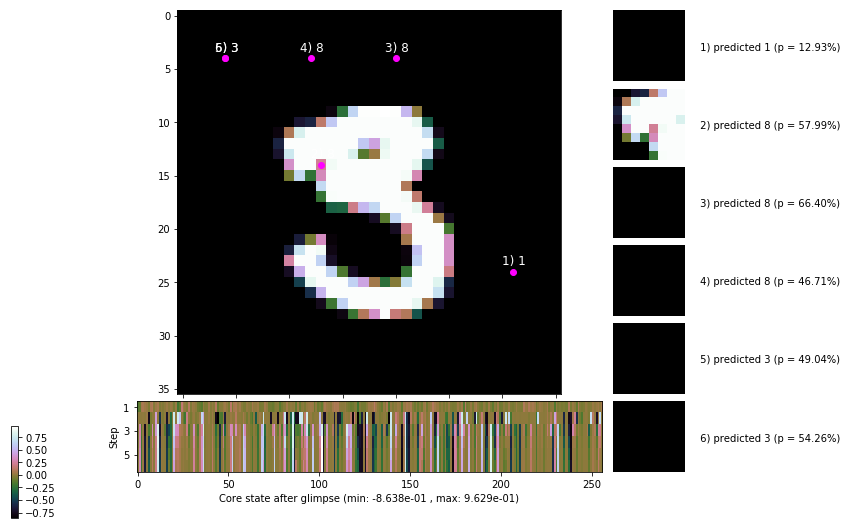


	Target class: 5 | Discounted rewards: [0.000, 0.000, 0.000, 0.000, 0.000, 0.000]


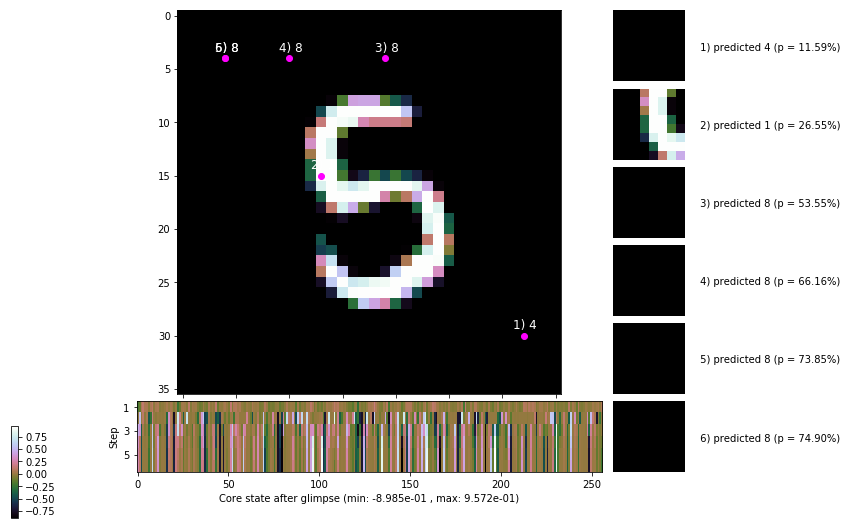

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


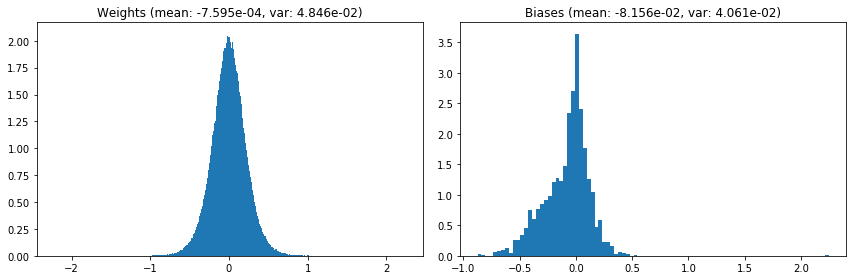

                                      Location network weights and biases


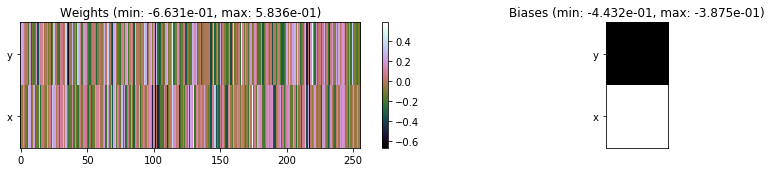

---------------------------------------------------------------------------------------------------------------
Elapsed time:  467.96 sec | TRAIN >> class loss: 1.1082 | steps:  3.186    | reward:  3.1344    | acc.: 60.485% 
                          | VAL   >> class loss: 1.0698 | steps:  3.066    | reward:  3.2354 :( | acc.: 61.600% :(


Epoch  16/400) lr = 0.0007984
 b    300/  3000 >> 185.6 ms/b | lr: 7.98e-04 | grad 2norm: 22.07 | grad inf norm:  6.315
         Weights || abs max:  2.24 ( 1414.58) | mean: -7.49e-04 ( 0.01) | var: 4.86e-02 (   74.29)
          Biases || abs max:  2.24 (  194.61) | mean: -8.17e-02 ( 0.15) | var: 4.06e-02 (  200.20)
                    class loss: 1.097 | steps: 3.185 | reward:  3.159 | acc.: 61.17%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 155.2 ms/b | lr: 7.97e-04 | grad 2norm: 21.67 | grad inf norm:  6.129
         Weights || abs max:  2.24 ( 1382.38) | mean: -7.29e-04 ( 0

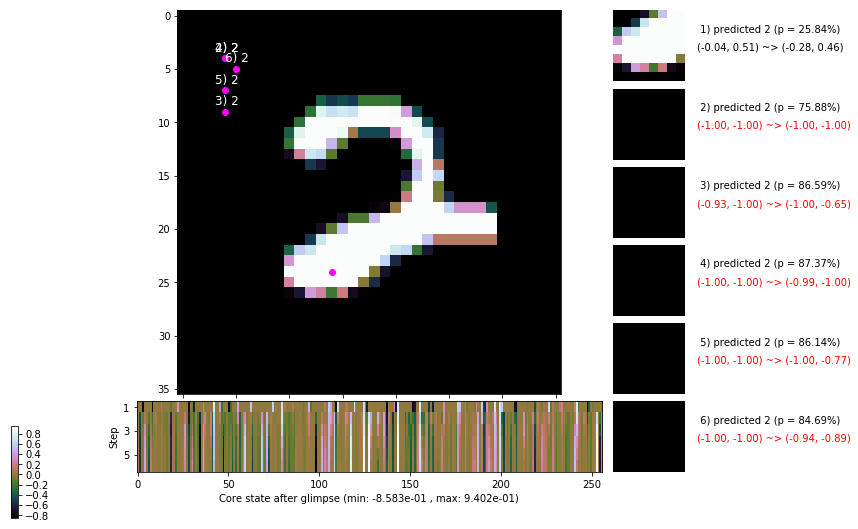

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 158.9 ms/b | lr: 7.95e-04 | grad 2norm: 22.24 | grad inf norm:  6.073
         Weights || abs max:  2.25 ( 3036.87) | mean: -7.17e-04 ( 0.01) | var: 4.89e-02 ( 1091.54)
          Biases || abs max:  2.25 (   77.06) | mean: -8.27e-02 ( 0.08) | var: 4.10e-02 (   22.49)
                    class loss: 1.037 | steps: 3.097 | reward:  3.257 | acc.: 63.20%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 153.8 ms/b | lr: 7.94e-04 | grad 2norm: 21.79 | grad inf norm:  6.247
         Weights || abs max:  2.27 ( 3819.95) | mean: -6.72e-04 ( 0.01) | var: 4.91e-02 ( 2942.06)
          Biases || abs max:  2.27 (   71.99) | mean: -8.25e-02 ( 0.09) | var: 4.13e-02 (   15.27)
                    class loss: 1.089 | steps: 3.164 | reward:  3.196 | acc.: 62.17%

	Target class: 5 | Discounted rewards: [0.000, 0.000, 0.0

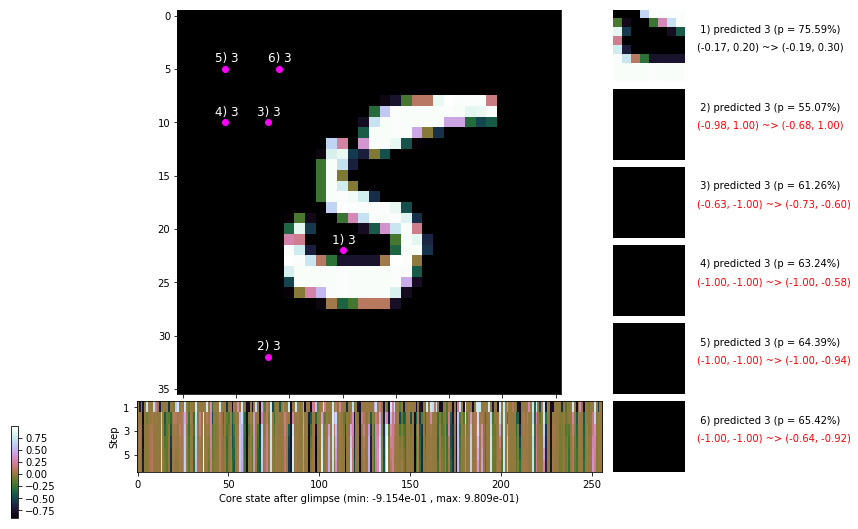

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 156.2 ms/b | lr: 7.93e-04 | grad 2norm: 21.73 | grad inf norm:  5.873
         Weights || abs max:  2.27 ( 1417.60) | mean: -6.52e-04 ( 0.01) | var: 4.93e-02 (   51.94)
          Biases || abs max:  2.27 (   79.93) | mean: -8.24e-02 ( 0.08) | var: 4.16e-02 (   38.19)
                    class loss: 1.059 | steps: 3.154 | reward:  3.189 | acc.: 62.35%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 154.5 ms/b | lr: 7.92e-04 | grad 2norm: 21.65 | grad inf norm:  5.948
         Weights || abs max:  2.28 ( 1421.36) | mean: -6.63e-04 ( 0.01) | var: 4.95e-02 (   25.34)
          Biases || abs max:  2.28 (  125.14) | mean: -8.23e-02 ( 0.11) | var: 4.18e-02 (   75.97)
                    class loss: 1.071 | steps: 3.114 | reward:  3.230 | acc.: 62.75%

	Target class: 9 | Discounted rewards: [0.000, 0.000, 0.0

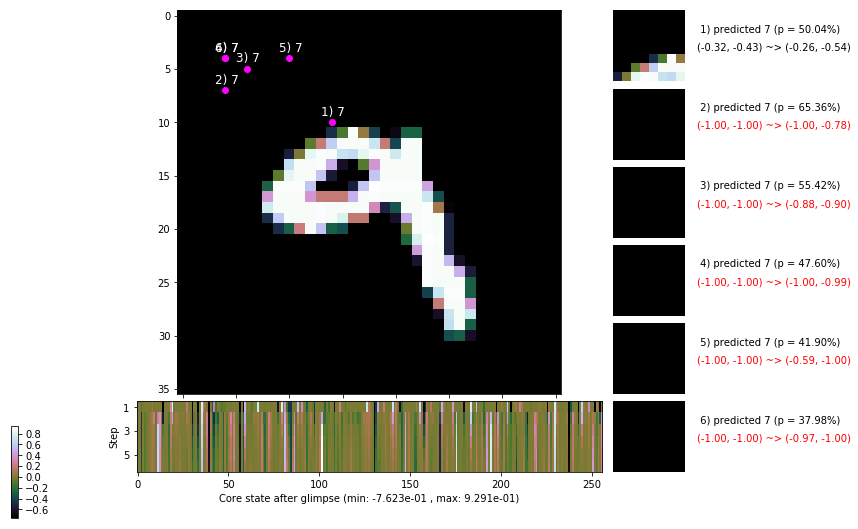

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 157.6 ms/b | lr: 7.90e-04 | grad 2norm: 21.61 | grad inf norm:  6.356
         Weights || abs max:  2.27 ( 2139.58) | mean: -6.72e-04 ( 0.01) | var: 4.96e-02 (  402.36)
          Biases || abs max:  2.27 (   99.66) | mean: -8.26e-02 ( 0.10) | var: 4.19e-02 (   53.24)
                    class loss: 1.101 | steps: 3.189 | reward:  3.129 | acc.: 60.80%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 154.4 ms/b | lr: 7.90e-04 | grad 2norm: 21.37 | grad inf norm:  5.970
         Weights || abs max:  2.28 ( 1969.31) | mean: -6.93e-04 ( 0.01) | var: 4.98e-02 (   80.12)
          Biases || abs max:  2.26 (   70.24) | mean: -8.34e-02 ( 0.08) | var: 4.20e-02 (   15.94)
                    class loss: 1.105 | steps: 3.207 | reward:  3.128 | acc.: 60.93%

	Target class: 2 | Discounted rewards: [2.786, 3.095, 3.4

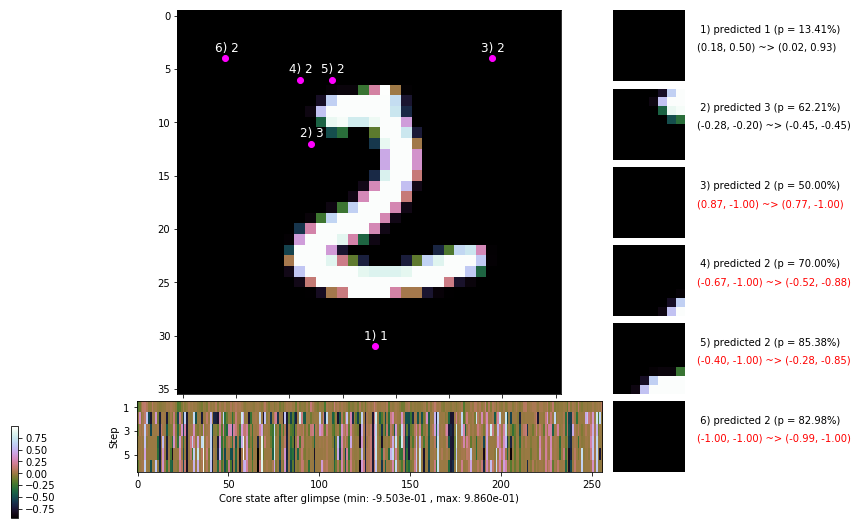

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 153.7 ms/b | lr: 7.88e-04 | grad 2norm: 21.42 | grad inf norm:  6.038
         Weights || abs max:  2.29 ( 2551.69) | mean: -7.09e-04 ( 0.01) | var: 5.00e-02 (  501.80)
          Biases || abs max:  2.26 (  175.13) | mean: -8.36e-02 ( 0.13) | var: 4.22e-02 (  303.11)
                    class loss: 1.070 | steps: 3.164 | reward:  3.178 | acc.: 61.67%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 153.3 ms/b | lr: 7.87e-04 | grad 2norm: 21.38 | grad inf norm:  6.088
         Weights || abs max:  2.30 ( 1422.32) | mean: -7.09e-04 ( 0.01) | var: 5.01e-02 (   79.46)
          Biases || abs max:  2.26 (   58.28) | mean: -8.42e-02 ( 0.07) | var: 4.24e-02 (   12.49)
                    class loss: 1.104 | steps: 3.182 | reward:  3.114 | acc.: 60.10%

	Target class: 6 | Discounted rewards: [4.686, 4.095, 3.4

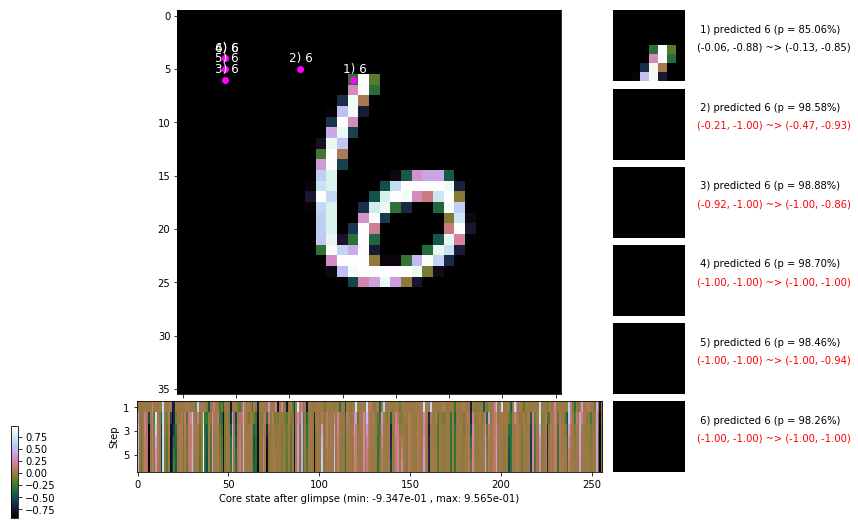

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 6 | Discounted rewards: [2.786, 3.095, 3.439, 2.710, 1.900, 1.000]


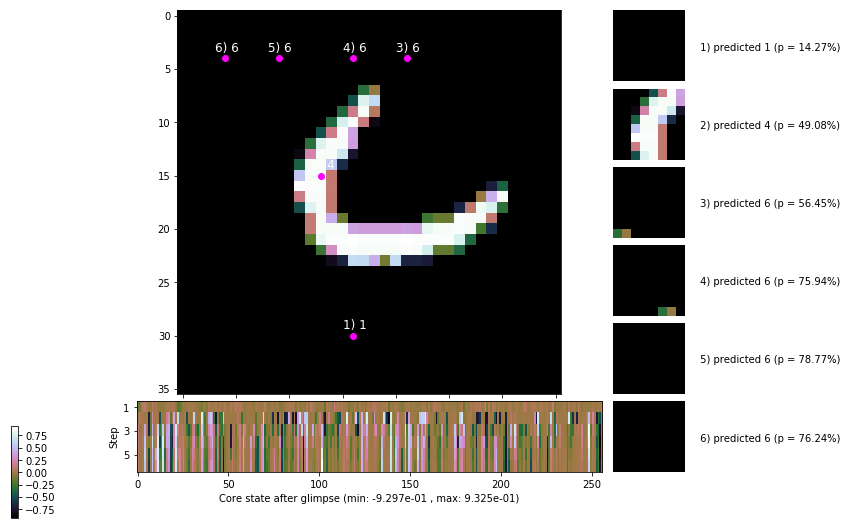


	Target class: 2 | Discounted rewards: [1.247, 1.385, 1.539, 1.710, 1.900, 1.000]


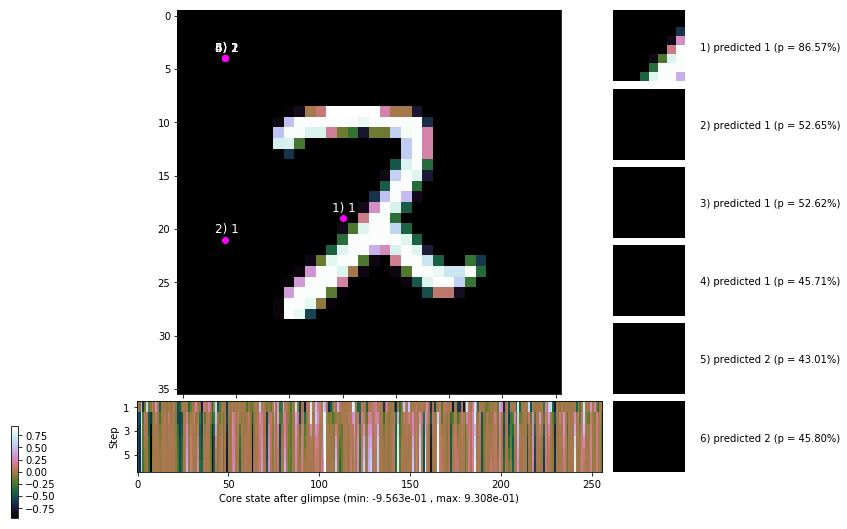

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


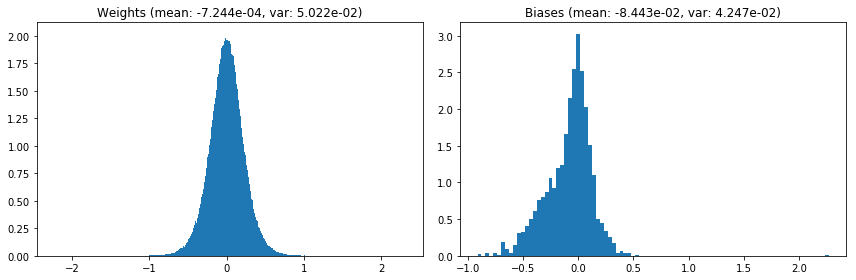

                                      Location network weights and biases


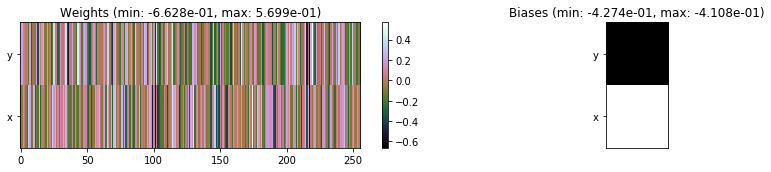

---------------------------------------------------------------------------------------------------------------
Elapsed time:  475.74 sec | TRAIN >> class loss: 1.0793 | steps:  3.160    | reward:  3.1813    | acc.: 61.758% 
                          | VAL   >> class loss: 1.0507 | steps:  3.080 :( | reward:  3.2382 :( | acc.: 62.280% :(


Epoch  17/400) lr = 0.0007865
 b    300/  3000 >> 153.8 ms/b | lr: 7.86e-04 | grad 2norm: 21.70 | grad inf norm:  6.318
         Weights || abs max:  2.31 ( 5105.50) | mean: -7.29e-04 ( 0.01) | var: 5.03e-02 ( 3419.87)
          Biases || abs max:  2.28 (  133.73) | mean: -8.45e-02 ( 0.10) | var: 4.25e-02 (  724.94)
                    class loss: 1.089 | steps: 3.173 | reward:  3.167 | acc.: 62.02%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 152.5 ms/b | lr: 7.85e-04 | grad 2norm: 22.07 | grad inf norm:  6.455
         Weights || abs max:  2.31 ( 2848.99) | mean: -7.08e-04 ( 0

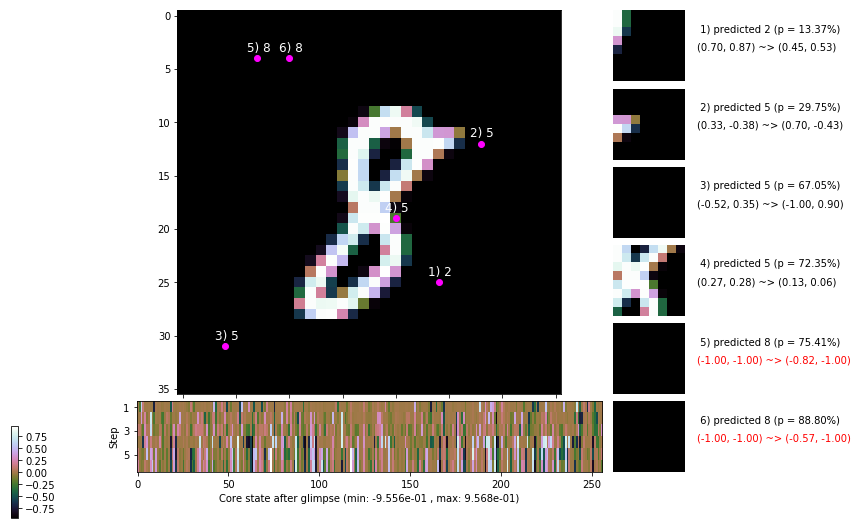

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 180.4 ms/b | lr: 7.83e-04 | grad 2norm: 21.84 | grad inf norm:  6.172
         Weights || abs max:  2.31 ( 1233.42) | mean: -7.26e-04 ( 0.01) | var: 5.06e-02 (   96.30)
          Biases || abs max:  2.27 (  436.25) | mean: -8.51e-02 ( 0.23) | var: 4.28e-02 (16407.85)
                    class loss: 1.088 | steps: 3.171 | reward:  3.152 | acc.: 60.67%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 165.7 ms/b | lr: 7.83e-04 | grad 2norm: 21.95 | grad inf norm:  6.206
         Weights || abs max:  2.31 ( 1552.11) | mean: -7.33e-04 ( 0.01) | var: 5.08e-02 (   94.42)
          Biases || abs max:  2.27 (   82.49) | mean: -8.56e-02 ( 0.08) | var: 4.29e-02 (   32.29)
                    class loss: 1.063 | steps: 3.127 | reward:  3.202 | acc.: 61.45%

	Target class: 0 | Discounted rewards: [2.786, 3.095, 3.4

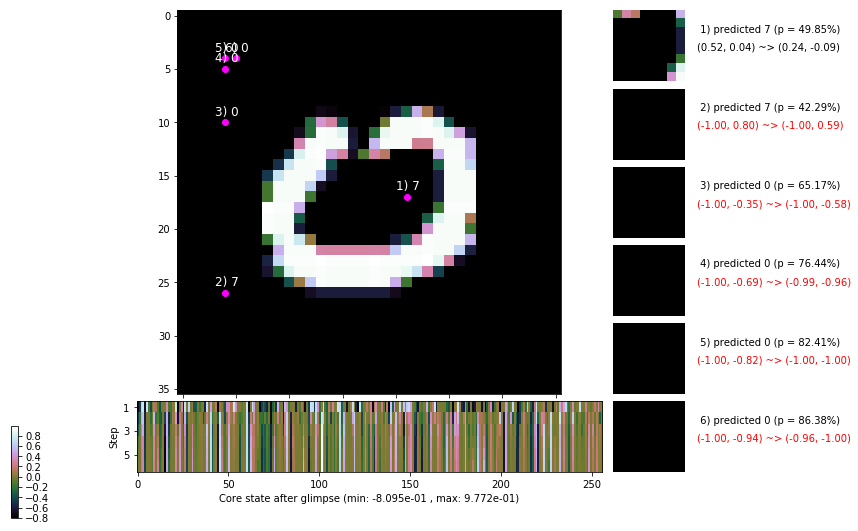

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 154.7 ms/b | lr: 7.81e-04 | grad 2norm: 22.09 | grad inf norm:  6.400
         Weights || abs max:  2.31 ( 1508.76) | mean: -6.94e-04 ( 0.01) | var: 5.10e-02 (   85.85)
          Biases || abs max:  2.29 (  257.77) | mean: -8.53e-02 ( 0.16) | var: 4.30e-02 ( 2585.65)
                    class loss: 1.018 | steps: 3.115 | reward:  3.250 | acc.: 63.85%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 152.9 ms/b | lr: 7.80e-04 | grad 2norm: 21.64 | grad inf norm:  6.340
         Weights || abs max:  2.32 ( 2902.76) | mean: -7.01e-04 ( 0.01) | var: 5.12e-02 ( 1046.85)
          Biases || abs max:  2.30 (  196.29) | mean: -8.53e-02 ( 0.13) | var: 4.32e-02 (  539.66)
                    class loss: 1.038 | steps: 3.101 | reward:  3.231 | acc.: 62.87%

	Target class: 1 | Discounted rewards: [3.686, 4.095, 3.4

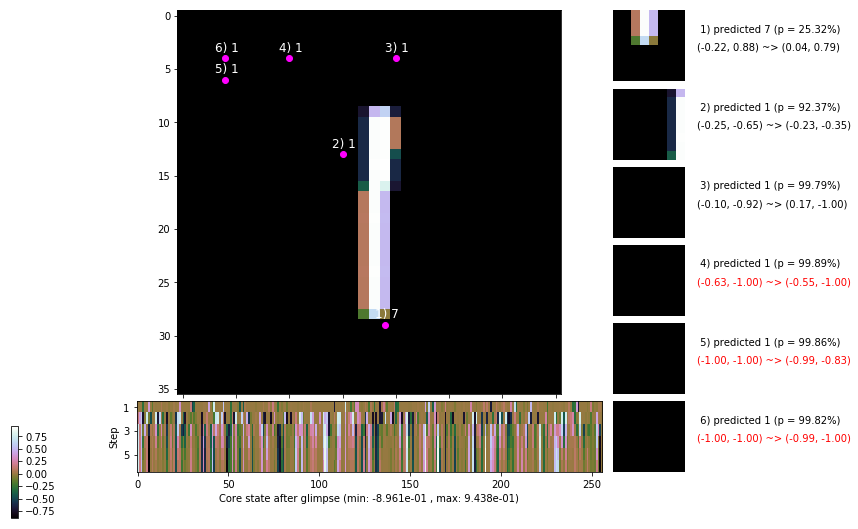

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 154.6 ms/b | lr: 7.79e-04 | grad 2norm: 21.60 | grad inf norm:  6.172
         Weights || abs max:  2.32 ( 2056.82) | mean: -6.73e-04 ( 0.01) | var: 5.14e-02 (  177.61)
          Biases || abs max:  2.31 (  165.89) | mean: -8.53e-02 ( 0.13) | var: 4.34e-02 (  175.17)
                    class loss: 1.071 | steps: 3.157 | reward:  3.177 | acc.: 61.58%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 154.9 ms/b | lr: 7.78e-04 | grad 2norm: 21.45 | grad inf norm:  6.089
         Weights || abs max:  2.34 ( 1033.13) | mean: -6.72e-04 ( 0.01) | var: 5.15e-02 (   20.69)
          Biases || abs max:  2.29 (  100.01) | mean: -8.63e-02 ( 0.11) | var: 4.36e-02 (   89.28)
                    class loss: 1.105 | steps: 3.167 | reward:  3.148 | acc.: 60.70%

	Target class: 7 | Discounted rewards: [0.000, 0.000, 0.0

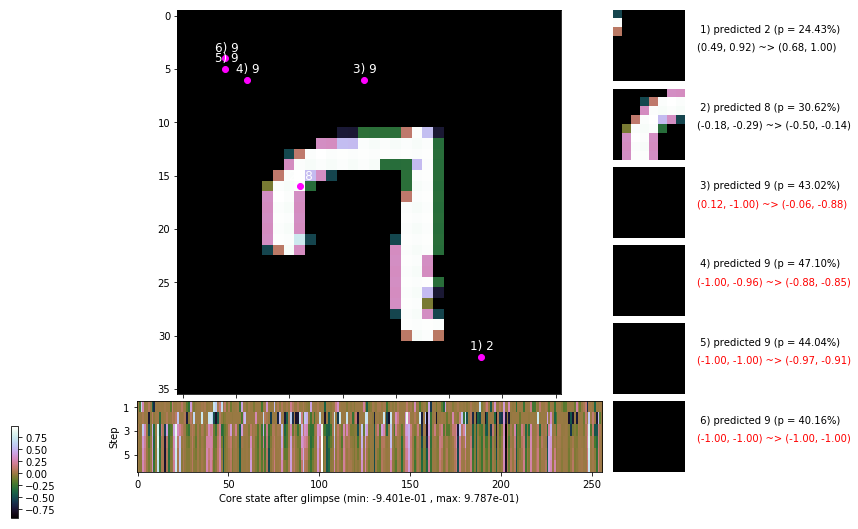

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 154.0 ms/b | lr: 7.76e-04 | grad 2norm: 21.61 | grad inf norm:  6.443
         Weights || abs max:  2.34 ( 2435.09) | mean: -7.05e-04 ( 0.01) | var: 5.17e-02 (  384.70)
          Biases || abs max:  2.29 (  108.92) | mean: -8.66e-02 ( 0.10) | var: 4.38e-02 (   76.03)
                    class loss: 1.100 | steps: 3.160 | reward:  3.158 | acc.: 61.22%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 154.0 ms/b | lr: 7.76e-04 | grad 2norm: 21.17 | grad inf norm:  6.213
         Weights || abs max:  2.33 ( 2796.27) | mean: -6.85e-04 ( 0.01) | var: 5.18e-02 ( 1104.68)
          Biases || abs max:  2.30 (   61.35) | mean: -8.65e-02 ( 0.08) | var: 4.41e-02 (   14.59)
                    class loss: 1.077 | steps: 3.135 | reward:  3.188 | acc.: 61.83%

	Target class: 6 | Discounted rewards: [3.686, 4.095, 3.4

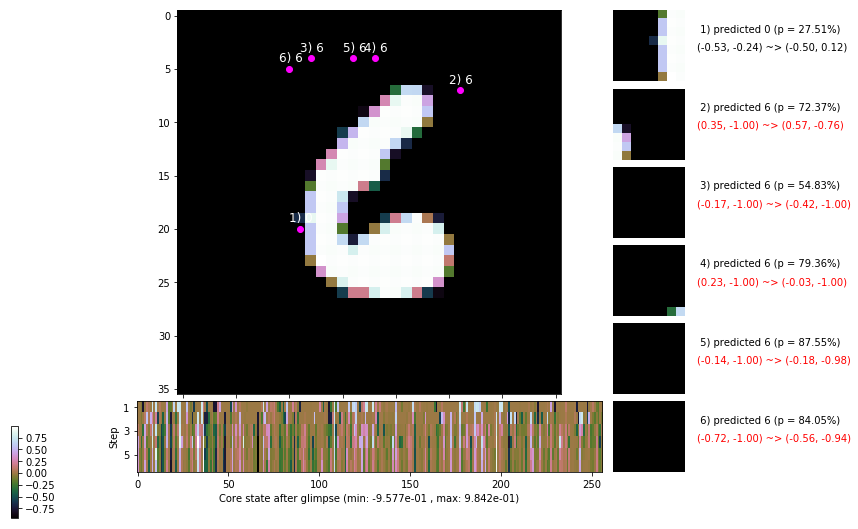

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 8 | Discounted rewards: [0.000, 0.000, 0.000, 0.000, 0.000, 0.000]


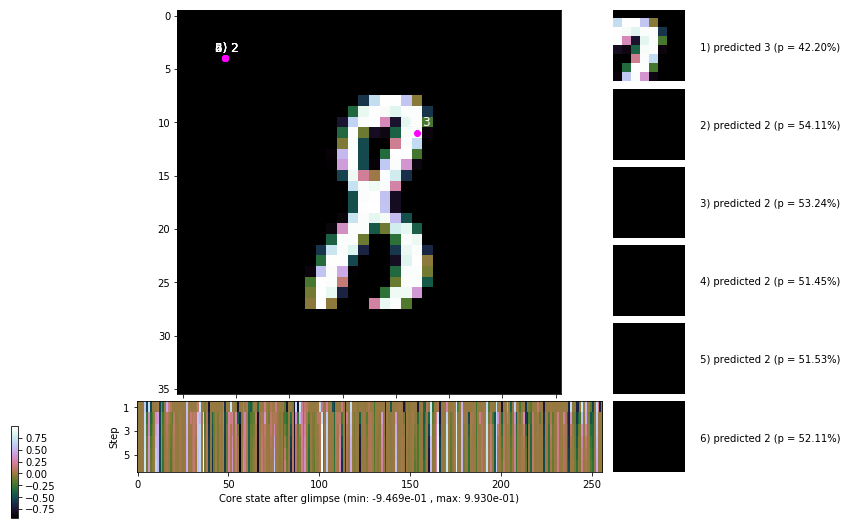


	Target class: 1 | Discounted rewards: [4.686, 4.095, 3.439, 2.710, 1.900, 1.000]


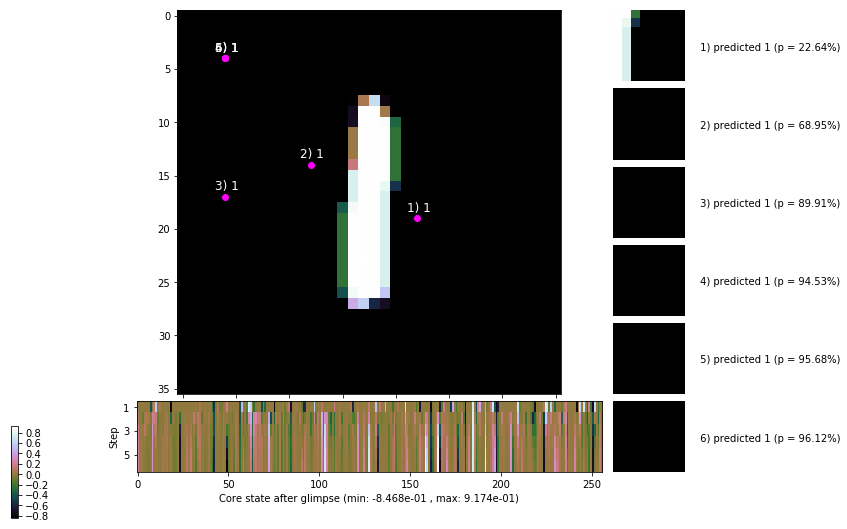

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


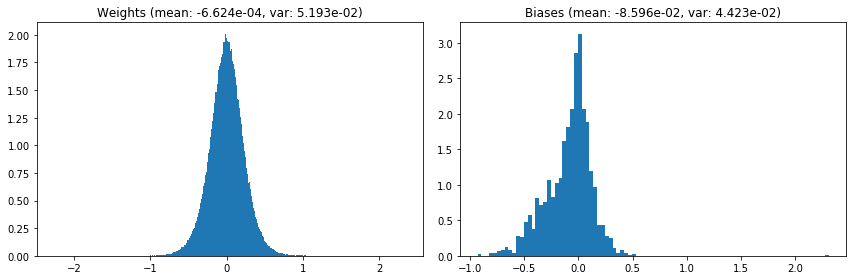

                                      Location network weights and biases


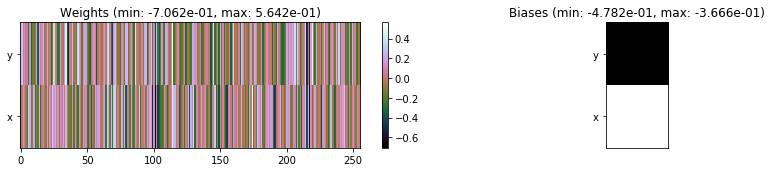

---------------------------------------------------------------------------------------------------------------
Elapsed time:  473.82 sec | TRAIN >> class loss: 1.0729 | steps:  3.146    | reward:  3.1851    | acc.: 61.767% 
                          | VAL   >> class loss: 1.0139 | steps:  3.043    | reward:  3.3306    | acc.: 64.000% 


Epoch  18/400) lr = 0.0007748
 b    300/  3000 >> 152.0 ms/b | lr: 7.74e-04 | grad 2norm: 21.57 | grad inf norm:  6.164
         Weights || abs max:  2.34 ( 1240.51) | mean: -6.68e-04 ( 0.01) | var: 5.20e-02 (   25.94)
          Biases || abs max:  2.31 (  141.86) | mean: -8.68e-02 ( 0.12) | var: 4.43e-02 (  160.75)
                    class loss: 1.097 | steps: 3.200 | reward:  3.121 | acc.: 59.97%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 153.0 ms/b | lr: 7.73e-04 | grad 2norm: 21.68 | grad inf norm:  6.441
         Weights || abs max:  2.35 ( 1354.22) | mean: -6.97e-04 ( 0.0

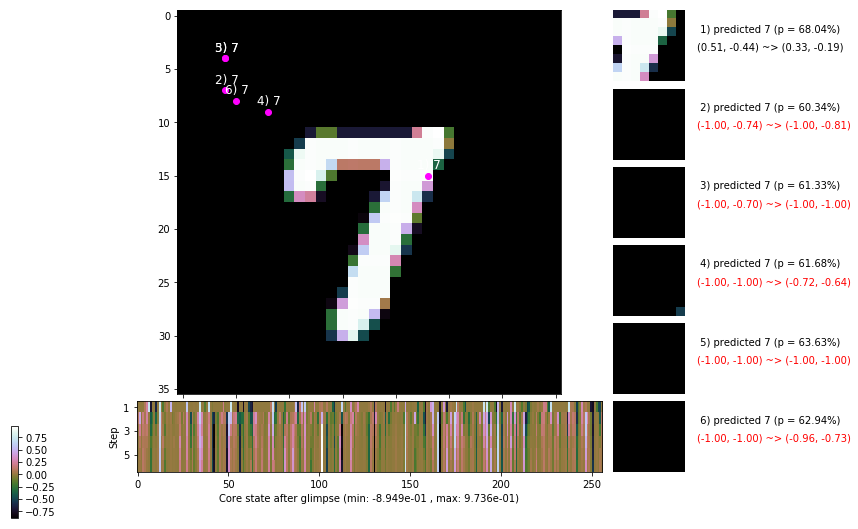

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 156.3 ms/b | lr: 7.72e-04 | grad 2norm: 21.44 | grad inf norm:  6.235
         Weights || abs max:  2.35 ( 1502.65) | mean: -7.14e-04 ( 0.01) | var: 5.23e-02 (   64.11)
          Biases || abs max:  2.31 (  178.36) | mean: -8.72e-02 ( 0.13) | var: 4.45e-02 (  918.37)
                    class loss: 1.063 | steps: 3.095 | reward:  3.243 | acc.: 62.48%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 150.5 ms/b | lr: 7.71e-04 | grad 2norm: 21.61 | grad inf norm:  6.205
         Weights || abs max:  2.36 ( 1800.64) | mean: -6.77e-04 ( 0.01) | var: 5.25e-02 (   44.38)
          Biases || abs max:  2.31 (  130.25) | mean: -8.70e-02 ( 0.12) | var: 4.46e-02 (  362.15)
                    class loss: 1.063 | steps: 3.134 | reward:  3.192 | acc.: 62.00%

	Target class: 5 | Discounted rewards: [4.686, 4.095, 3.4

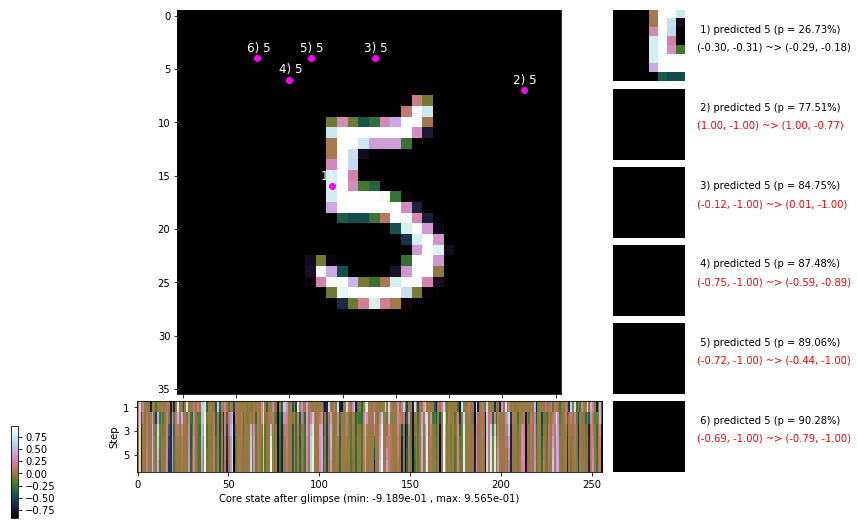

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 163.7 ms/b | lr: 7.69e-04 | grad 2norm: 21.59 | grad inf norm:  5.815
         Weights || abs max:  2.36 ( 2036.46) | mean: -7.10e-04 ( 0.01) | var: 5.27e-02 (  158.77)
          Biases || abs max:  2.31 (  194.37) | mean: -8.72e-02 ( 0.15) | var: 4.47e-02 (  181.20)
                    class loss: 1.057 | steps: 3.143 | reward:  3.191 | acc.: 61.77%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 172.4 ms/b | lr: 7.69e-04 | grad 2norm: 21.45 | grad inf norm:  5.953
         Weights || abs max:  2.36 ( 2025.82) | mean: -7.09e-04 ( 0.01) | var: 5.28e-02 (  159.40)
          Biases || abs max:  2.31 (   84.79) | mean: -8.79e-02 ( 0.09) | var: 4.48e-02 (   89.68)
                    class loss: 1.031 | steps: 3.093 | reward:  3.248 | acc.: 63.40%

	Target class: 1 | Discounted rewards: [4.686, 4.095, 3.4

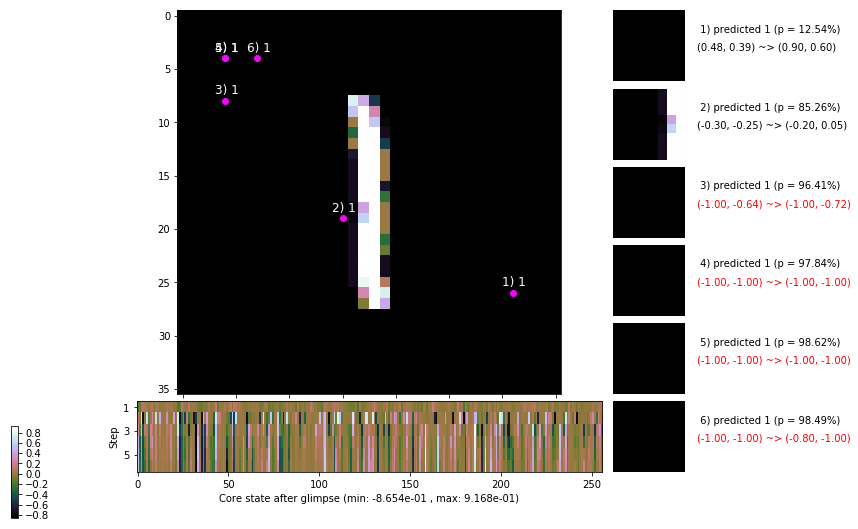

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 153.7 ms/b | lr: 7.67e-04 | grad 2norm: 21.64 | grad inf norm:  6.295
         Weights || abs max:  2.37 ( 2039.48) | mean: -7.35e-04 ( 0.01) | var: 5.30e-02 (  385.34)
          Biases || abs max:  2.32 (   68.41) | mean: -8.80e-02 ( 0.08) | var: 4.49e-02 (   20.68)
                    class loss: 1.026 | steps: 3.129 | reward:  3.261 | acc.: 63.72%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 153.2 ms/b | lr: 7.66e-04 | grad 2norm: 21.34 | grad inf norm:  5.691
         Weights || abs max:  2.38 ( 3807.47) | mean: -7.28e-04 ( 0.01) | var: 5.31e-02 ( 2644.92)
          Biases || abs max:  2.32 (  395.29) | mean: -8.88e-02 ( 0.21) | var: 4.50e-02 (10429.35)
                    class loss: 1.027 | steps: 3.103 | reward:  3.264 | acc.: 63.43%

	Target class: 0 | Discounted rewards: [0.000, 0.000, 0.0

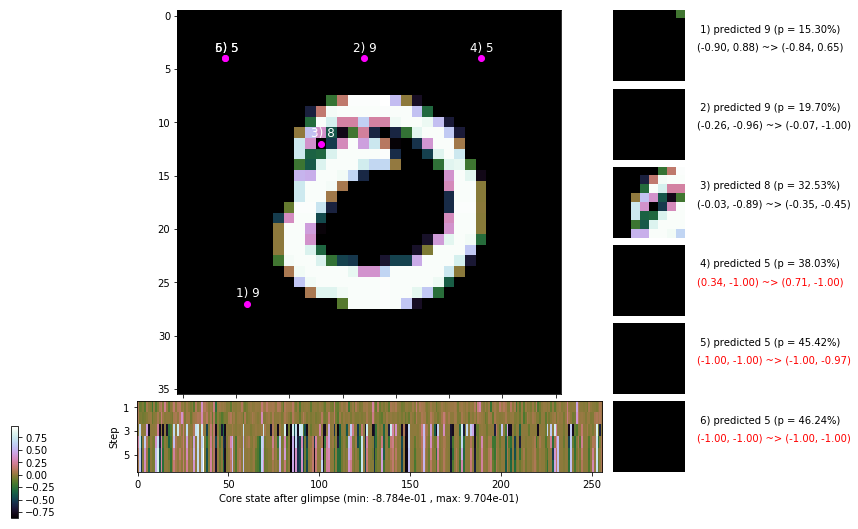

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 156.1 ms/b | lr: 7.65e-04 | grad 2norm: 21.37 | grad inf norm:  5.909
         Weights || abs max:  2.38 ( 1356.56) | mean: -7.51e-04 ( 0.01) | var: 5.33e-02 (   22.33)
          Biases || abs max:  2.33 (  179.00) | mean: -8.85e-02 ( 0.12) | var: 4.52e-02 ( 2018.25)
                    class loss: 1.015 | steps: 3.077 | reward:  3.288 | acc.: 63.85%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 150.7 ms/b | lr: 7.64e-04 | grad 2norm: 21.65 | grad inf norm:  5.919
         Weights || abs max:  2.39 ( 3365.40) | mean: -7.83e-04 ( 0.01) | var: 5.35e-02 ( 1567.26)
          Biases || abs max:  2.33 (  550.55) | mean: -8.86e-02 ( 0.46) | var: 4.53e-02 (57234.90)
                    class loss: 1.043 | steps: 3.114 | reward:  3.220 | acc.: 62.08%

	Target class: 6 | Discounted rewards: [3.686, 4.095, 3.4

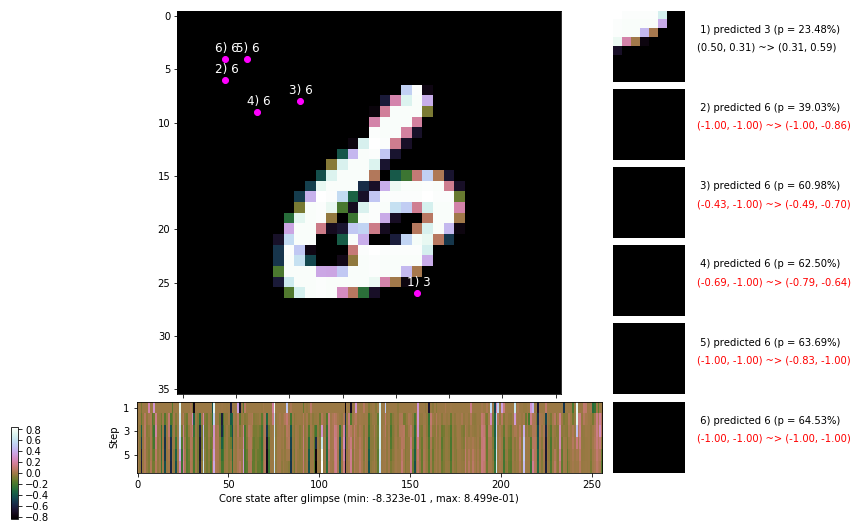

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 8 | Discounted rewards: [3.686, 4.095, 3.439, 2.710, 1.900, 1.000]


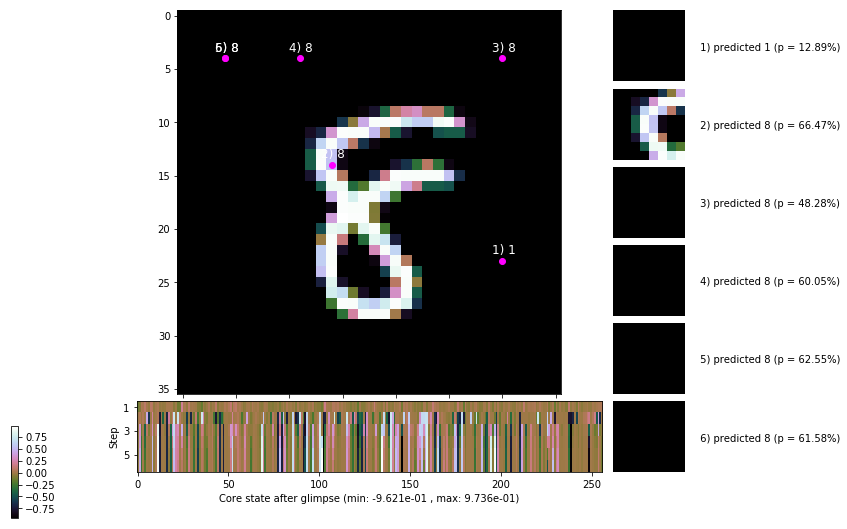


	Target class: 0 | Discounted rewards: [3.686, 4.095, 3.439, 2.710, 1.900, 1.000]


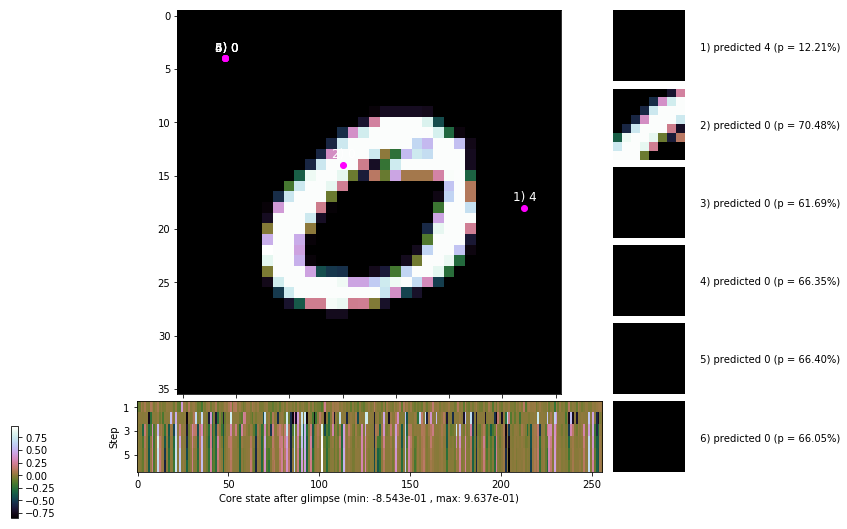

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


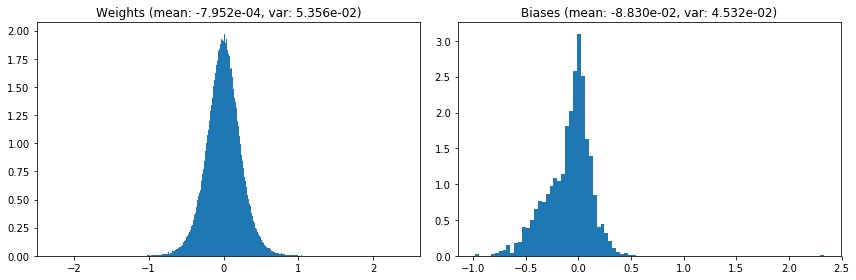

                                      Location network weights and biases


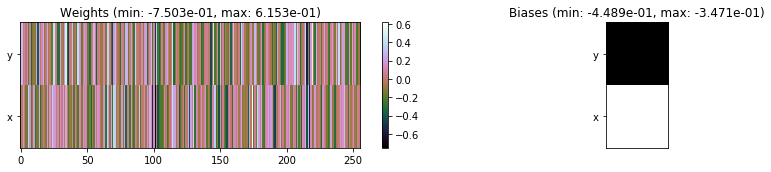

---------------------------------------------------------------------------------------------------------------
Elapsed time:  469.23 sec | TRAIN >> class loss: 1.0464 | steps:  3.120    | reward:  3.2250    | acc.: 62.517% 
                          | VAL   >> class loss: 1.0001 | steps:  3.000    | reward:  3.3766    | acc.: 64.520% 


Epoch  19/400) lr = 0.0007633
 b    300/  3000 >> 151.4 ms/b | lr: 7.63e-04 | grad 2norm: 21.90 | grad inf norm:  6.074
         Weights || abs max:  2.40 ( 1846.14) | mean: -8.29e-04 ( 0.01) | var: 5.36e-02 (  136.23)
          Biases || abs max:  2.33 (  114.30) | mean: -8.86e-02 ( 0.11) | var: 4.53e-02 (   85.20)
                    class loss: 1.005 | steps: 3.075 | reward:  3.307 | acc.: 64.10%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 153.1 ms/b | lr: 7.62e-04 | grad 2norm: 21.15 | grad inf norm:  5.789
         Weights || abs max:  2.40 ( 9813.95) | mean: -8.34e-04 ( 0.0

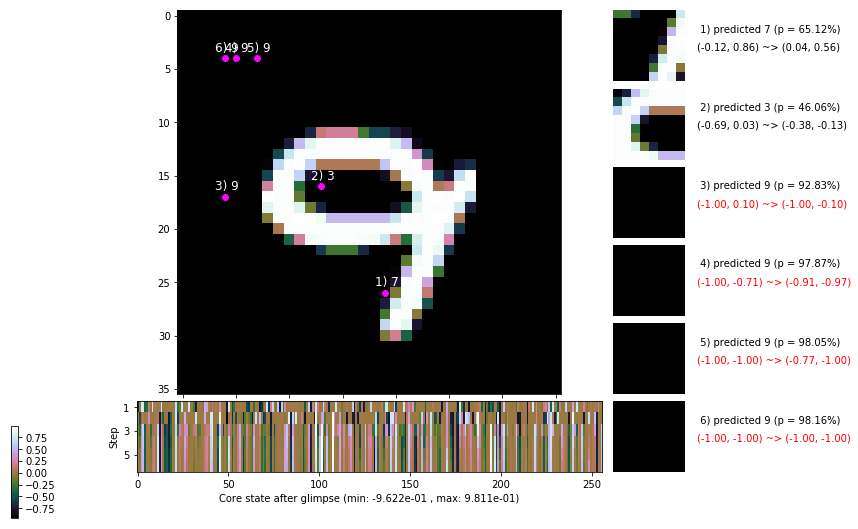

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 156.1 ms/b | lr: 7.60e-04 | grad 2norm: 20.69 | grad inf norm:  5.575
         Weights || abs max:  2.42 ( 1533.29) | mean: -8.18e-04 ( 0.01) | var: 5.40e-02 (   60.32)
          Biases || abs max:  2.34 (  119.46) | mean: -8.92e-02 ( 0.11) | var: 4.57e-02 (  159.97)
                    class loss: 1.048 | steps: 3.100 | reward:  3.267 | acc.: 63.23%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 152.1 ms/b | lr: 7.59e-04 | grad 2norm: 21.29 | grad inf norm:  6.240
         Weights || abs max:  2.41 ( 2579.14) | mean: -7.98e-04 ( 0.01) | var: 5.41e-02 (  348.74)
          Biases || abs max:  2.34 (   72.31) | mean: -8.94e-02 ( 0.08) | var: 4.60e-02 (   28.74)
                    class loss: 1.070 | steps: 3.116 | reward:  3.200 | acc.: 61.78%

	Target class: 7 | Discounted rewards: [0.000, 0.000, 0.0

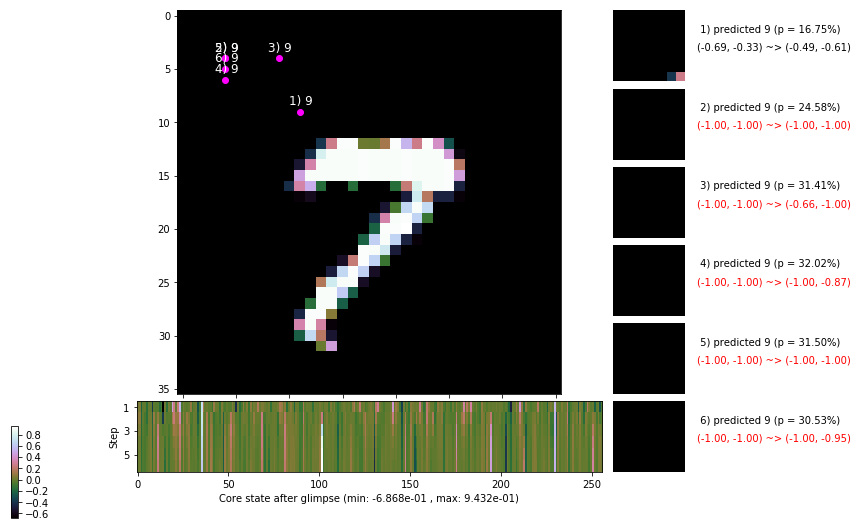

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 155.2 ms/b | lr: 7.58e-04 | grad 2norm: 21.19 | grad inf norm:  6.035
         Weights || abs max:  2.42 ( 1399.51) | mean: -8.46e-04 ( 0.01) | var: 5.43e-02 (   69.68)
          Biases || abs max:  2.33 (  113.90) | mean: -8.93e-02 ( 0.09) | var: 4.62e-02 (  298.40)
                    class loss: 1.087 | steps: 3.190 | reward:  3.156 | acc.: 61.40%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 152.7 ms/b | lr: 7.57e-04 | grad 2norm: 21.18 | grad inf norm:  6.161
         Weights || abs max:  2.42 ( 2811.74) | mean: -8.23e-04 ( 0.01) | var: 5.45e-02 ( 1934.06)
          Biases || abs max:  2.33 (  200.53) | mean: -8.91e-02 ( 0.14) | var: 4.65e-02 (  311.57)
                    class loss: 1.064 | steps: 3.152 | reward:  3.188 | acc.: 61.80%

	Target class: 4 | Discounted rewards: [1.000, 0.000, 0.0

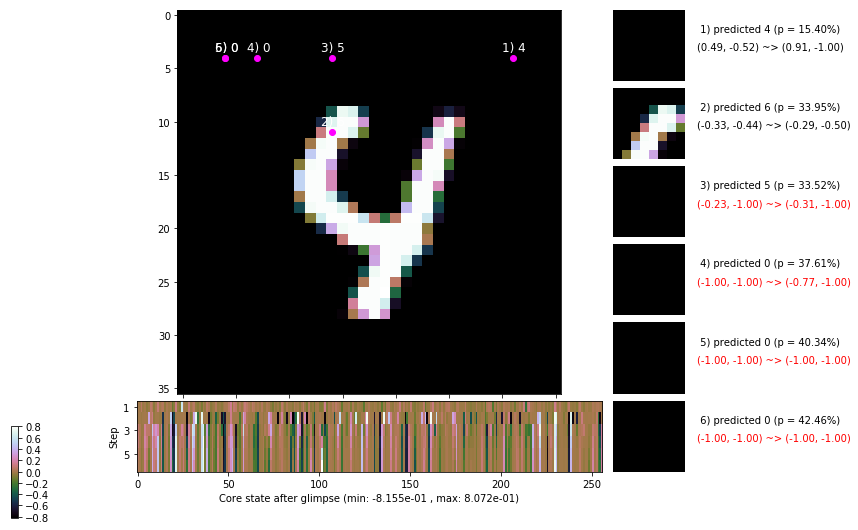

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 154.9 ms/b | lr: 7.56e-04 | grad 2norm: 21.57 | grad inf norm:  6.492
         Weights || abs max:  2.43 ( 4461.68) | mean: -7.96e-04 ( 0.01) | var: 5.46e-02 ( 1383.71)
          Biases || abs max:  2.33 (   66.17) | mean: -9.01e-02 ( 0.08) | var: 4.67e-02 (   43.90)
                    class loss: 1.084 | steps: 3.183 | reward:  3.171 | acc.: 61.38%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 175.1 ms/b | lr: 7.55e-04 | grad 2norm: 21.73 | grad inf norm:  6.165
         Weights || abs max:  2.42 ( 6055.73) | mean: -7.79e-04 ( 0.02) | var: 5.47e-02 (11273.62)
          Biases || abs max:  2.33 (  161.63) | mean: -9.04e-02 ( 0.12) | var: 4.68e-02 (  266.10)
                    class loss: 1.031 | steps: 3.107 | reward:  3.258 | acc.: 63.20%

	Target class: 3 | Discounted rewards: [3.686, 4.095, 3.4

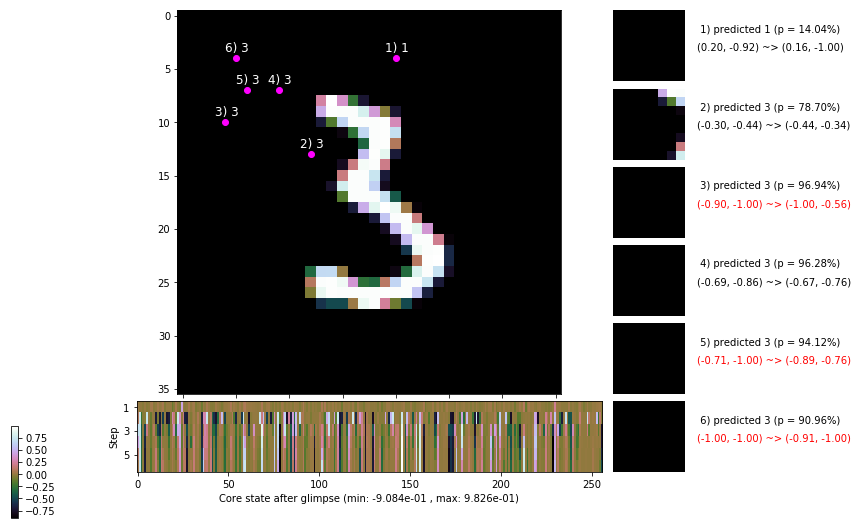

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 162.9 ms/b | lr: 7.53e-04 | grad 2norm: 21.68 | grad inf norm:  6.224
         Weights || abs max:  2.42 ( 1373.69) | mean: -7.58e-04 ( 0.01) | var: 5.49e-02 (   39.44)
          Biases || abs max:  2.34 (   78.18) | mean: -9.07e-02 ( 0.09) | var: 4.68e-02 (   75.87)
                    class loss: 1.043 | steps: 3.108 | reward:  3.243 | acc.: 62.72%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 152.4 ms/b | lr: 7.53e-04 | grad 2norm: 21.54 | grad inf norm:  6.048
         Weights || abs max:  2.42 ( 1686.52) | mean: -7.38e-04 ( 0.01) | var: 5.51e-02 (   57.38)
          Biases || abs max:  2.33 (  100.08) | mean: -9.12e-02 ( 0.09) | var: 4.69e-02 (   47.55)
                    class loss: 1.062 | steps: 3.170 | reward:  3.176 | acc.: 61.70%

	Target class: 4 | Discounted rewards: [3.686, 4.095, 3.4

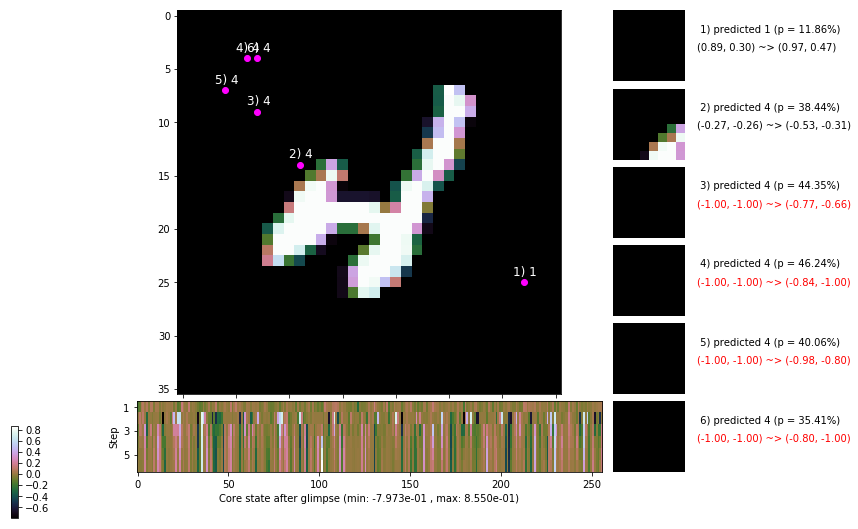

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 9 | Discounted rewards: [2.786, 3.095, 3.439, 2.710, 1.900, 1.000]


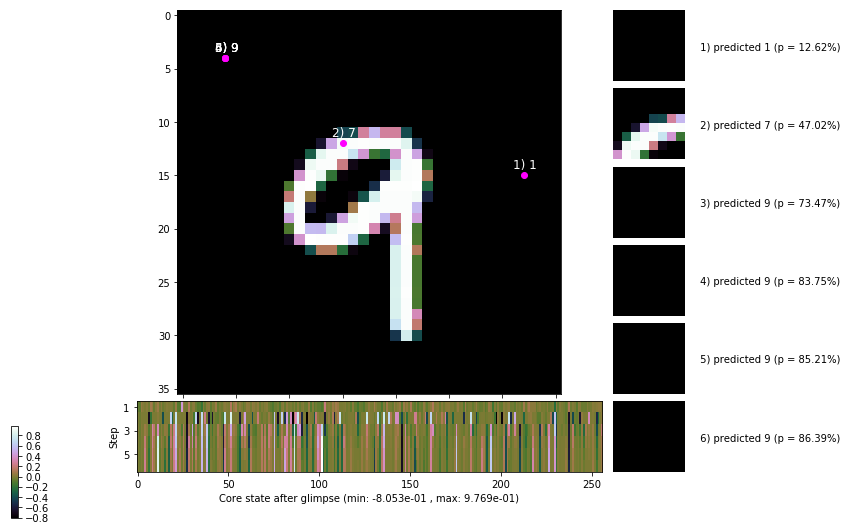


	Target class: 8 | Discounted rewards: [0.000, 0.000, 0.000, 0.000, 0.000, 0.000]


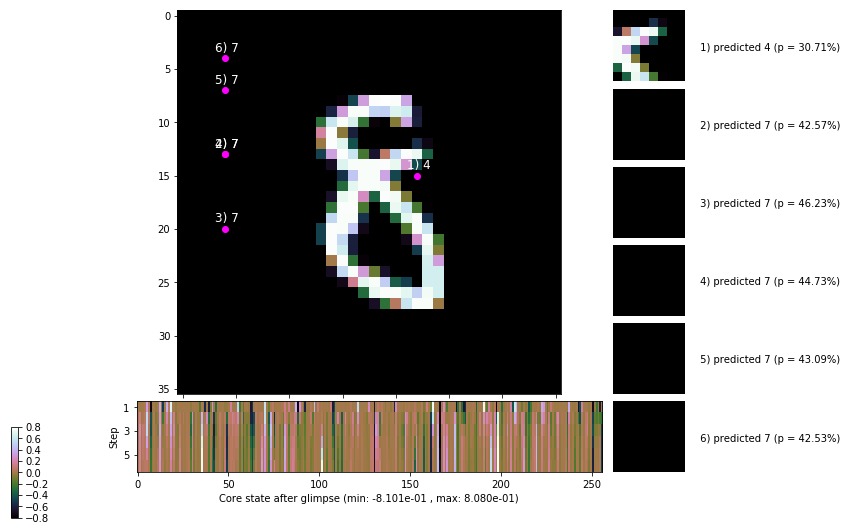

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


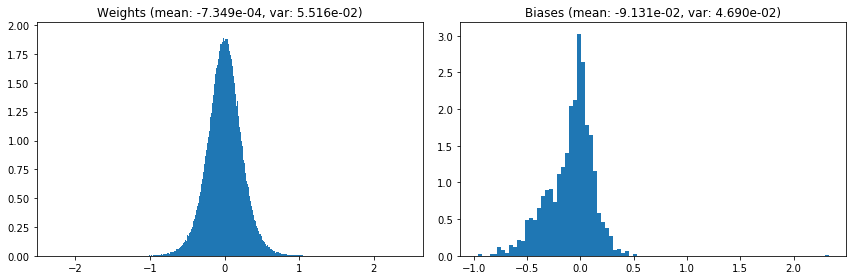

                                      Location network weights and biases


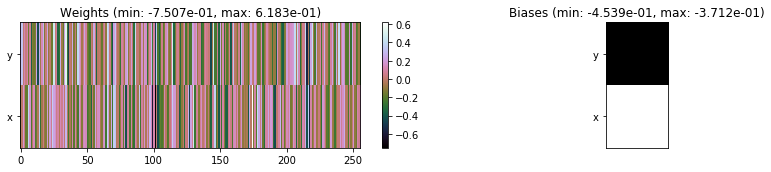

---------------------------------------------------------------------------------------------------------------
Elapsed time:  470.37 sec | TRAIN >> class loss: 1.0509 | steps:  3.131 :( | reward:  3.2233 :( | acc.: 62.523% 
                          | VAL   >> class loss: 1.0061 | steps:  2.997    | reward:  3.3508 :( | acc.: 64.320% :(


Epoch  20/400) lr = 0.0007519
 b    300/  3000 >> 151.9 ms/b | lr: 7.51e-04 | grad 2norm: 21.73 | grad inf norm:  6.099
         Weights || abs max:  2.43 (  822.18) | mean: -7.19e-04 ( 0.01) | var: 5.52e-02 (    6.08)
          Biases || abs max:  2.34 (   98.17) | mean: -9.11e-02 ( 0.10) | var: 4.68e-02 (   96.59)
                    class loss: 1.029 | steps: 3.037 | reward:  3.292 | acc.: 63.72%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 151.1 ms/b | lr: 7.50e-04 | grad 2norm: 21.17 | grad inf norm:  6.115
         Weights || abs max:  2.43 ( 1582.46) | mean: -7.35e-04 ( 0

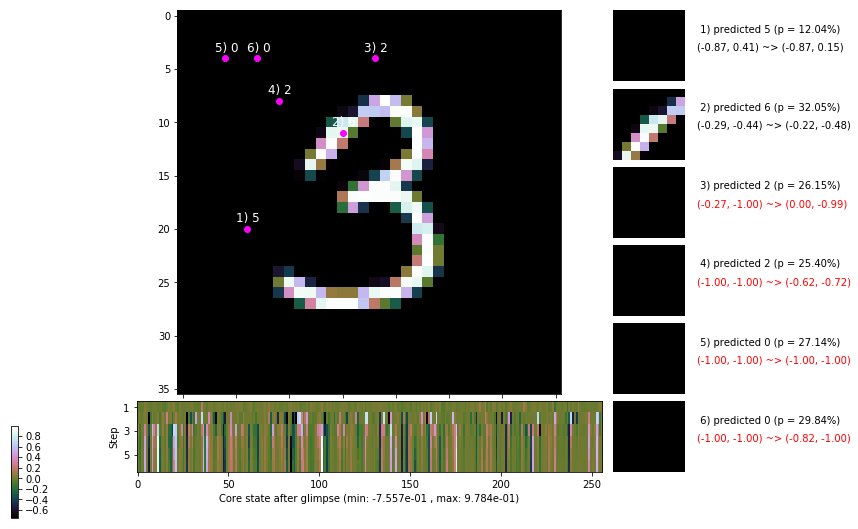

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 155.3 ms/b | lr: 7.49e-04 | grad 2norm: 21.65 | grad inf norm:  6.227
         Weights || abs max:  2.43 ( 1500.98) | mean: -7.75e-04 ( 0.01) | var: 5.56e-02 (   38.80)
          Biases || abs max:  2.35 (   96.23) | mean: -9.14e-02 ( 0.09) | var: 4.73e-02 (   62.78)
                    class loss: 1.063 | steps: 3.119 | reward:  3.227 | acc.: 62.85%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 151.0 ms/b | lr: 7.48e-04 | grad 2norm: 21.48 | grad inf norm:  6.410
         Weights || abs max:  2.43 (  946.77) | mean: -7.99e-04 ( 0.01) | var: 5.57e-02 (   51.69)
          Biases || abs max:  2.34 (  200.83) | mean: -9.14e-02 ( 0.13) | var: 4.76e-02 ( 2050.21)
                    class loss: 1.061 | steps: 3.094 | reward:  3.210 | acc.: 62.37%

	Target class: 7 | Discounted rewards: [0.000, 0.000, 0.0

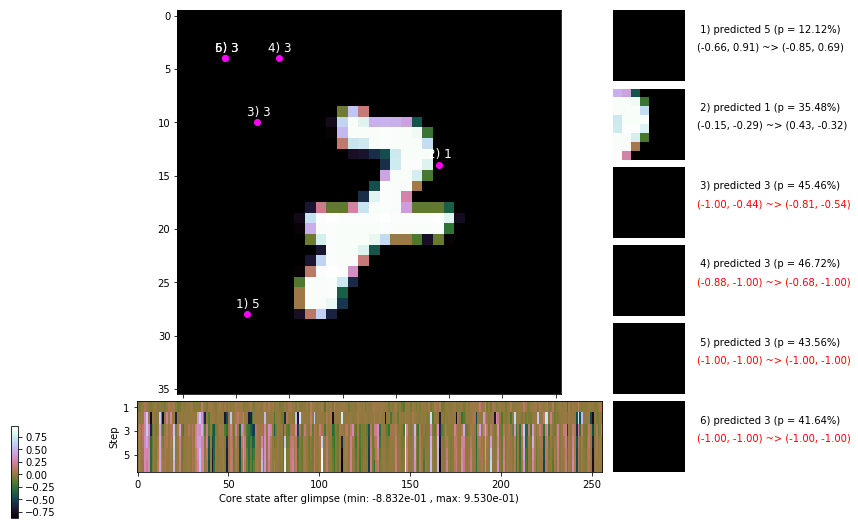

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 154.5 ms/b | lr: 7.47e-04 | grad 2norm: 21.38 | grad inf norm:  6.110
         Weights || abs max:  2.44 (  981.20) | mean: -8.20e-04 ( 0.01) | var: 5.59e-02 (   10.82)
          Biases || abs max:  2.34 (  193.55) | mean: -9.17e-02 ( 0.13) | var: 4.76e-02 ( 1186.80)
                    class loss: 1.063 | steps: 3.111 | reward:  3.208 | acc.: 62.52%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 152.3 ms/b | lr: 7.46e-04 | grad 2norm: 21.35 | grad inf norm:  6.231
         Weights || abs max:  2.44 ( 2362.88) | mean: -8.36e-04 ( 0.01) | var: 5.60e-02 (  334.18)
          Biases || abs max:  2.34 (   88.30) | mean: -9.21e-02 ( 0.09) | var: 4.76e-02 (   41.92)
                    class loss: 1.041 | steps: 3.083 | reward:  3.255 | acc.: 63.43%

	Target class: 7 | Discounted rewards: [0.000, 0.000, 0.0

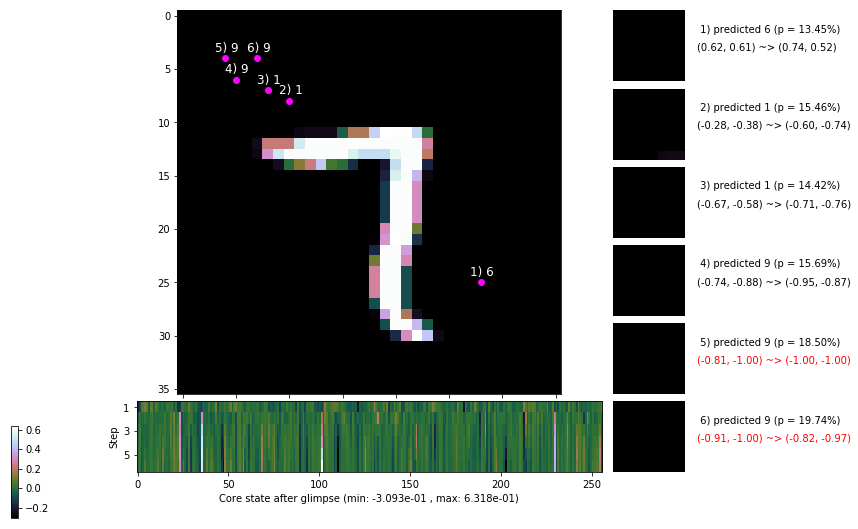

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 153.1 ms/b | lr: 7.44e-04 | grad 2norm: 21.75 | grad inf norm:  6.374
         Weights || abs max:  2.44 ( 3250.09) | mean: -8.59e-04 ( 0.01) | var: 5.61e-02 ( 1995.26)
          Biases || abs max:  2.34 (  152.01) | mean: -9.25e-02 ( 0.12) | var: 4.77e-02 (  198.14)
                    class loss: 1.033 | steps: 3.074 | reward:  3.265 | acc.: 63.52%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 152.2 ms/b | lr: 7.44e-04 | grad 2norm: 21.28 | grad inf norm:  6.023
         Weights || abs max:  2.45 ( 1974.14) | mean: -8.47e-04 ( 0.01) | var: 5.63e-02 (  219.09)
          Biases || abs max:  2.34 (17911.66) | mean: -9.23e-02 (13.96) | var: 4.78e-02 (73982616.00)
                    class loss: 1.044 | steps: 3.099 | reward:  3.237 | acc.: 63.12%

	Target class: 3 | Discounted rewards: [1.000, 0.000, 

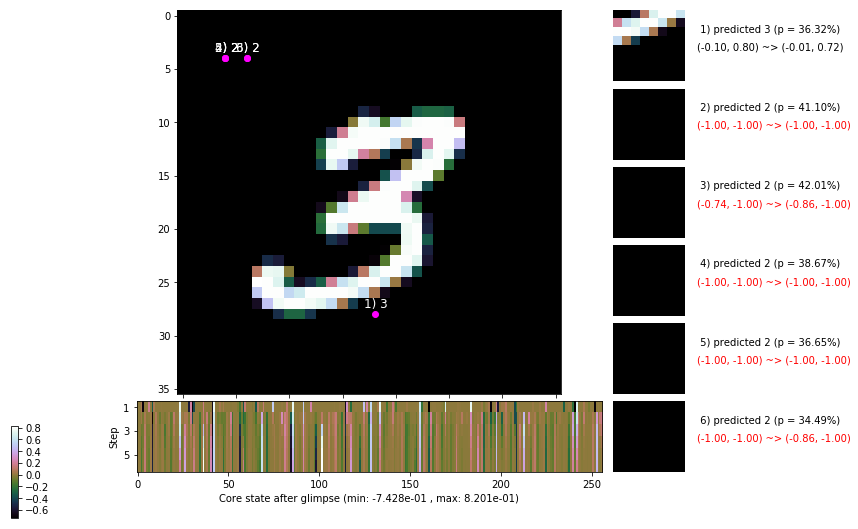

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 154.2 ms/b | lr: 7.42e-04 | grad 2norm: 21.33 | grad inf norm:  5.992
         Weights || abs max:  2.45 ( 1809.92) | mean: -8.05e-04 ( 0.01) | var: 5.64e-02 (   85.87)
          Biases || abs max:  2.35 (  120.08) | mean: -9.23e-02 ( 0.11) | var: 4.78e-02 (  154.76)
                    class loss: 1.018 | steps: 3.066 | reward:  3.292 | acc.: 63.93%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 151.7 ms/b | lr: 7.41e-04 | grad 2norm: 21.50 | grad inf norm:  6.149
         Weights || abs max:  2.46 ( 2736.89) | mean: -8.24e-04 ( 0.01) | var: 5.66e-02 (  411.01)
          Biases || abs max:  2.35 (  137.61) | mean: -9.26e-02 ( 0.13) | var: 4.80e-02 (  386.22)
                    class loss: 1.022 | steps: 3.111 | reward:  3.226 | acc.: 63.45%

	Target class: 8 | Discounted rewards: [2.876, 3.195, 2.4

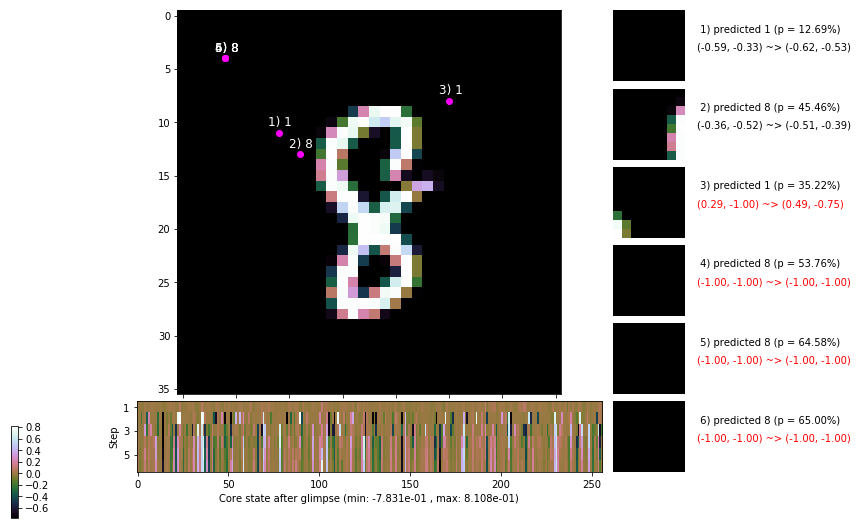

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 4 | Discounted rewards: [4.686, 4.095, 3.439, 2.710, 1.900, 1.000]


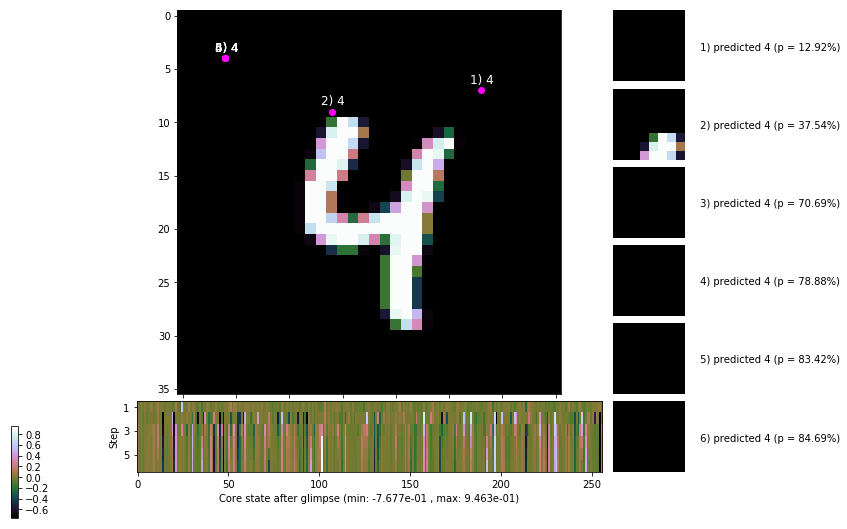


	Target class: 4 | Discounted rewards: [0.810, 0.900, 1.000, 0.000, 0.000, 0.000]


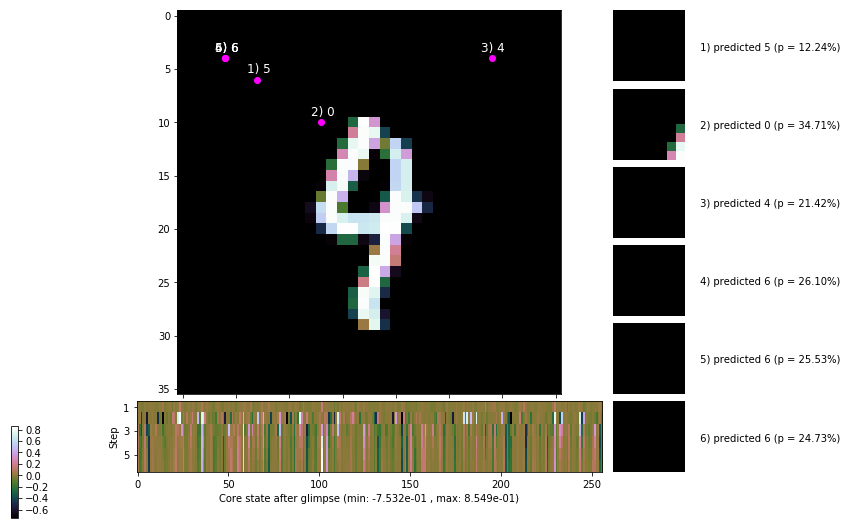

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


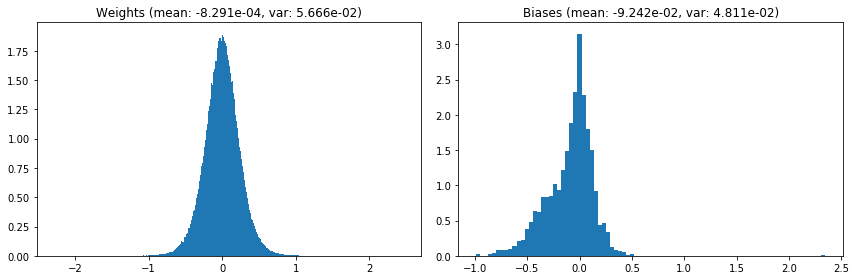

                                      Location network weights and biases


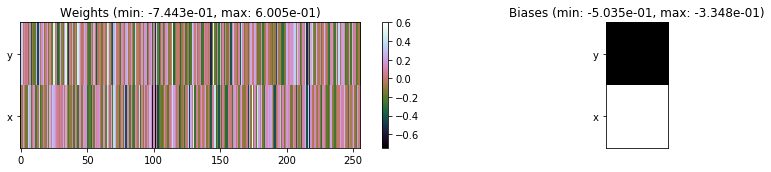

---------------------------------------------------------------------------------------------------------------
Elapsed time:  458.94 sec | TRAIN >> class loss: 1.0406 | steps:  3.089    | reward:  3.2466    | acc.: 63.223% 
                          | VAL   >> class loss: 1.0246 | steps:  3.006 :( | reward:  3.3202 :( | acc.: 63.180% :(


Epoch  21/400) lr = 0.0007407
 b    300/  3000 >> 173.9 ms/b | lr: 7.40e-04 | grad 2norm: 21.18 | grad inf norm:  6.297
         Weights || abs max:  2.46 (  889.92) | mean: -8.21e-04 ( 0.01) | var: 5.67e-02 (    9.01)
          Biases || abs max:  2.34 (   58.47) | mean: -9.29e-02 ( 0.08) | var: 4.83e-02 (    8.51)
                    class loss: 1.078 | steps: 3.104 | reward:  3.225 | acc.: 62.75%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 154.2 ms/b | lr: 7.39e-04 | grad 2norm: 21.47 | grad inf norm:  6.457
         Weights || abs max:  2.46 ( 3617.01) | mean: -8.30e-04 ( 0

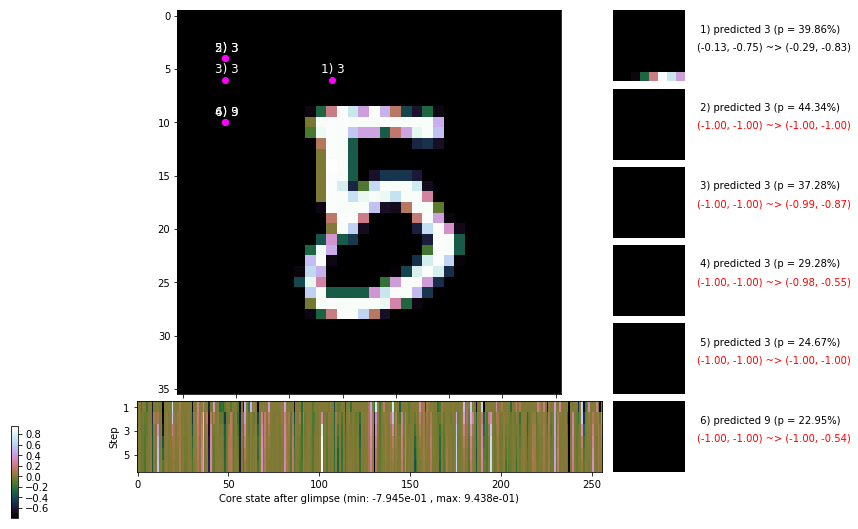

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 155.7 ms/b | lr: 7.38e-04 | grad 2norm: 21.16 | grad inf norm:  6.289
         Weights || abs max:  2.46 ( 1407.81) | mean: -8.25e-04 ( 0.01) | var: 5.70e-02 (   26.86)
          Biases || abs max:  2.33 (  206.97) | mean: -9.38e-02 ( 0.15) | var: 4.87e-02 (  514.52)
                    class loss: 1.047 | steps: 3.083 | reward:  3.253 | acc.: 63.33%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 151.6 ms/b | lr: 7.37e-04 | grad 2norm: 20.96 | grad inf norm:  5.891
         Weights || abs max:  2.46 ( 1662.39) | mean: -8.39e-04 ( 0.01) | var: 5.72e-02 (  101.77)
          Biases || abs max:  2.34 (  116.41) | mean: -9.36e-02 ( 0.13) | var: 4.88e-02 (  416.14)
                    class loss: 1.032 | steps: 3.082 | reward:  3.244 | acc.: 62.60%

	Target class: 6 | Discounted rewards: [1.976, 2.195, 2.4

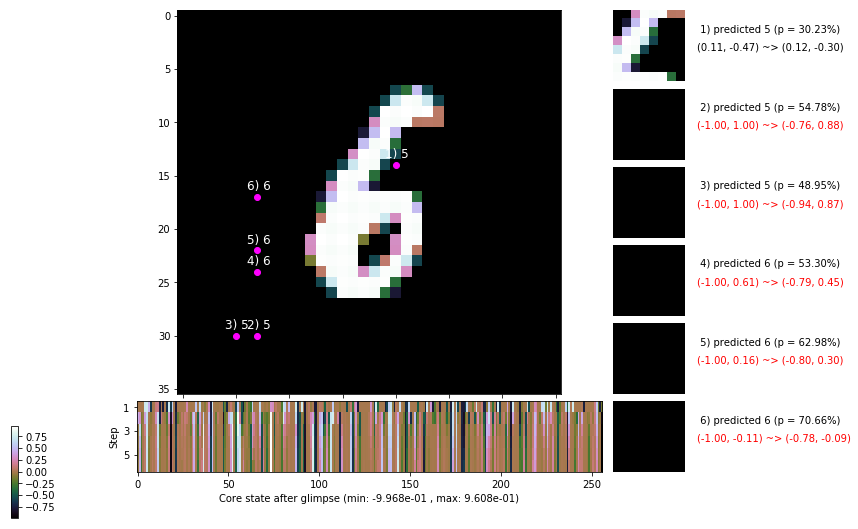

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 156.0 ms/b | lr: 7.36e-04 | grad 2norm: 20.95 | grad inf norm:  5.954
         Weights || abs max:  2.46 ( 1395.17) | mean: -8.54e-04 ( 0.01) | var: 5.74e-02 (   28.67)
          Biases || abs max:  2.33 (  113.71) | mean: -9.40e-02 ( 0.12) | var: 4.89e-02 (  178.66)
                    class loss: 1.043 | steps: 3.096 | reward:  3.238 | acc.: 63.32%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 154.0 ms/b | lr: 7.35e-04 | grad 2norm: 20.95 | grad inf norm:  5.969
         Weights || abs max:  2.46 ( 1829.09) | mean: -8.47e-04 ( 0.01) | var: 5.75e-02 (   58.01)
          Biases || abs max:  2.34 (   96.26) | mean: -9.41e-02 ( 0.10) | var: 4.91e-02 (   50.03)
                    class loss: 1.036 | steps: 3.077 | reward:  3.268 | acc.: 63.23%

	Target class: 7 | Discounted rewards: [0.000, 0.000, 0.0

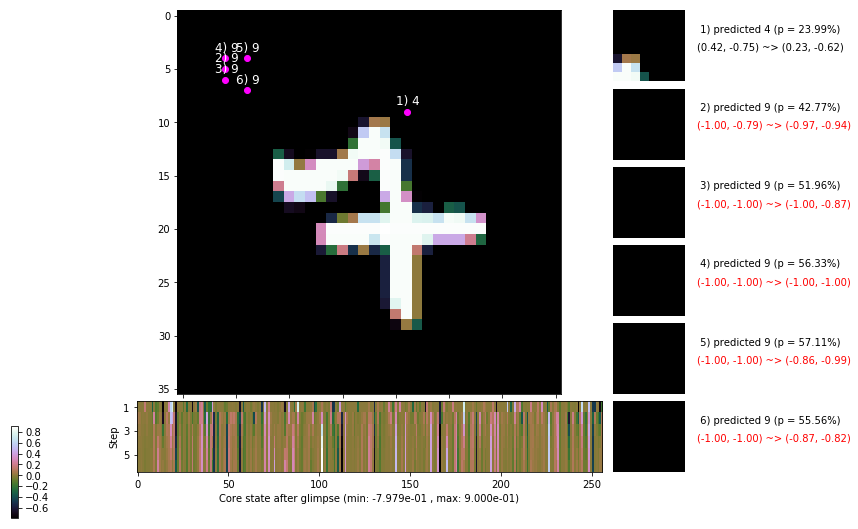

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 154.3 ms/b | lr: 7.33e-04 | grad 2norm: 21.44 | grad inf norm:  6.289
         Weights || abs max:  2.47 ( 2392.15) | mean: -8.60e-04 ( 0.01) | var: 5.77e-02 (  161.79)
          Biases || abs max:  2.35 (   52.02) | mean: -9.44e-02 ( 0.07) | var: 4.94e-02 (    5.17)
                    class loss: 1.035 | steps: 3.074 | reward:  3.255 | acc.: 62.55%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 153.1 ms/b | lr: 7.33e-04 | grad 2norm: 20.89 | grad inf norm:  6.200
         Weights || abs max:  2.47 ( 4539.88) | mean: -8.97e-04 ( 0.01) | var: 5.78e-02 ( 5954.42)
          Biases || abs max:  2.35 (  149.74) | mean: -9.45e-02 ( 0.13) | var: 4.94e-02 (  419.33)
                    class loss: 1.034 | steps: 3.079 | reward:  3.249 | acc.: 63.07%

	Target class: 2 | Discounted rewards: [0.000, 0.000, 0.0

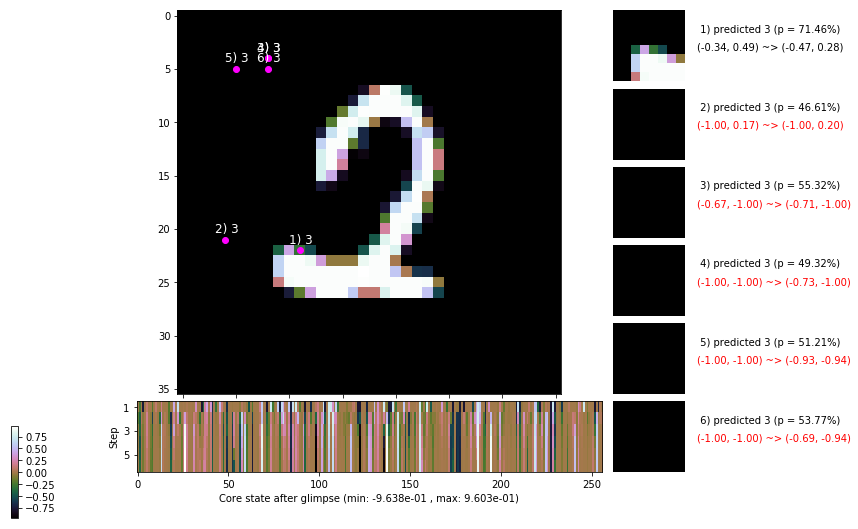

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 155.0 ms/b | lr: 7.31e-04 | grad 2norm: 20.97 | grad inf norm:  6.070
         Weights || abs max:  2.47 ( 3342.40) | mean: -8.83e-04 ( 0.01) | var: 5.80e-02 (  603.99)
          Biases || abs max:  2.35 (  137.27) | mean: -9.50e-02 ( 0.13) | var: 4.97e-02 (  591.43)
                    class loss: 1.044 | steps: 3.075 | reward:  3.260 | acc.: 63.38%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 152.1 ms/b | lr: 7.30e-04 | grad 2norm: 21.39 | grad inf norm:  6.268
         Weights || abs max:  2.47 ( 7294.83) | mean: -8.43e-04 ( 0.02) | var: 5.81e-02 (16508.64)
          Biases || abs max:  2.35 ( 5290.98) | mean: -9.49e-02 ( 2.11) | var: 4.98e-02 (3142105.50)
                    class loss: 1.018 | steps: 3.099 | reward:  3.247 | acc.: 63.18%

	Target class: 9 | Discounted rewards: [1.976, 2.195, 2

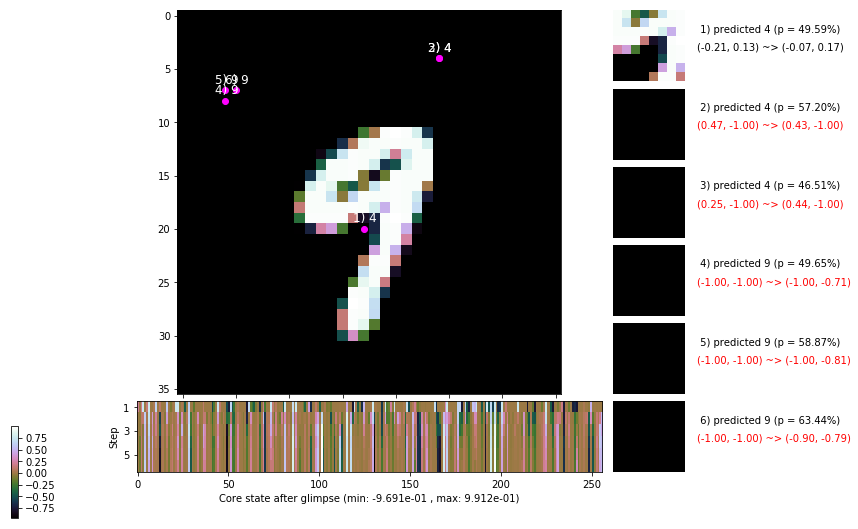

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 1 | Discounted rewards: [3.686, 4.095, 3.439, 2.710, 1.900, 1.000]


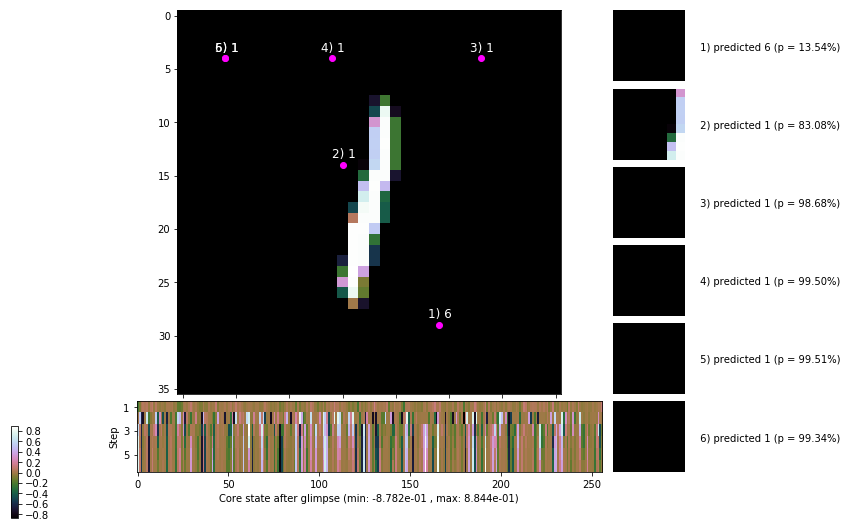


	Target class: 2 | Discounted rewards: [1.539, 1.710, 1.900, 1.000, 0.000, 0.000]


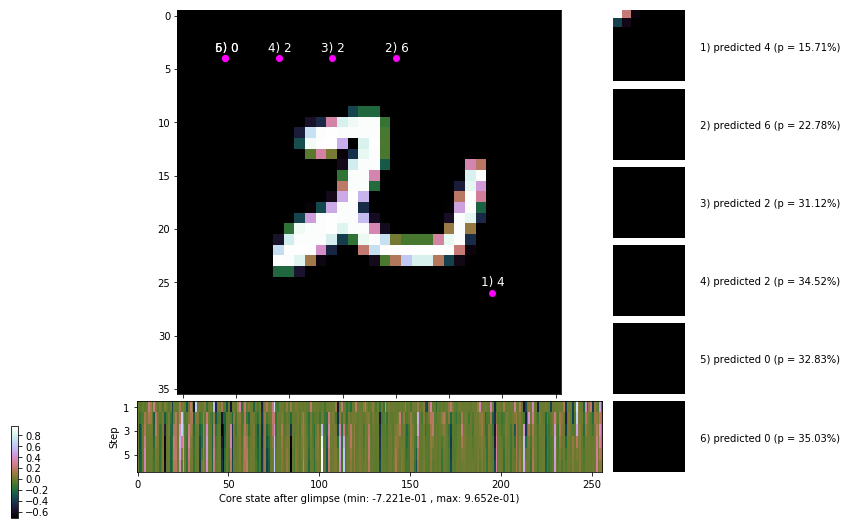

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


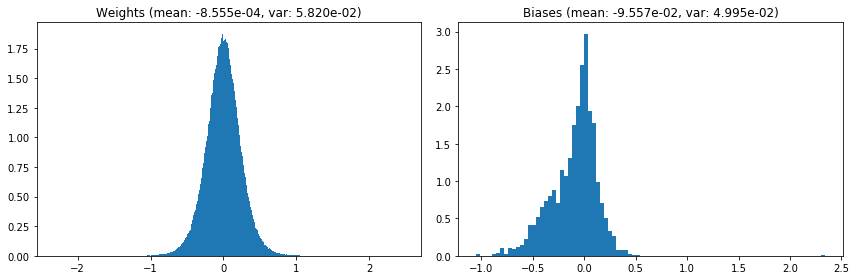

                                      Location network weights and biases


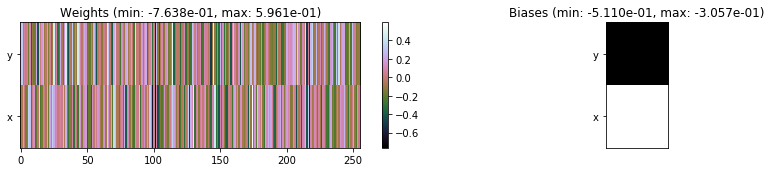

---------------------------------------------------------------------------------------------------------------
Elapsed time:  468.54 sec | TRAIN >> class loss: 1.0419 | steps:  3.089 :( | reward:  3.2447 :( | acc.: 62.987% :(
                          | VAL   >> class loss: 0.9475 | steps:  2.931    | reward:  3.4368    | acc.: 65.860% 


Epoch  22/400) lr = 0.0007297
 b    300/  3000 >> 154.5 ms/b | lr: 7.29e-04 | grad 2norm: 21.00 | grad inf norm:  6.211
         Weights || abs max:  2.48 ( 2144.96) | mean: -8.63e-04 ( 0.01) | var: 5.83e-02 (  133.95)
          Biases || abs max:  2.35 (   94.56) | mean: -9.56e-02 ( 0.10) | var: 4.99e-02 (   35.08)
                    class loss: 1.032 | steps: 3.063 | reward:  3.275 | acc.: 63.00%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 150.6 ms/b | lr: 7.28e-04 | grad 2norm: 21.32 | grad inf norm:  6.044
         Weights || abs max:  2.48 ( 4899.40) | mean: -8.53e-04 ( 0

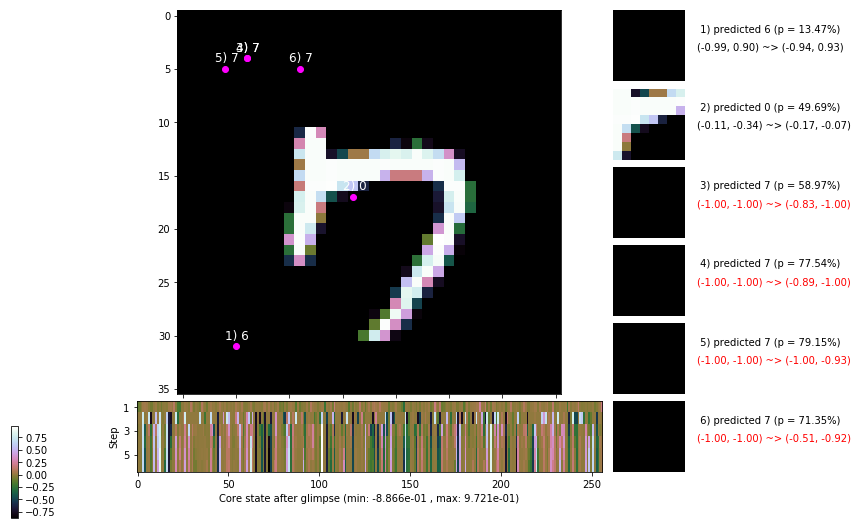

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 173.7 ms/b | lr: 7.27e-04 | grad 2norm: 21.04 | grad inf norm:  6.219
         Weights || abs max:  2.48 ( 9408.91) | mean: -8.72e-04 ( 0.02) | var: 5.86e-02 (18932.36)
          Biases || abs max:  2.34 (  146.32) | mean: -9.60e-02 ( 0.13) | var: 5.00e-02 (  649.45)
                    class loss: 1.050 | steps: 3.135 | reward:  3.213 | acc.: 62.43%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 163.0 ms/b | lr: 7.26e-04 | grad 2norm: 21.12 | grad inf norm:  6.135
         Weights || abs max:  2.48 ( 1198.02) | mean: -8.91e-04 ( 0.01) | var: 5.87e-02 (   26.16)
          Biases || abs max:  2.34 (  445.76) | mean: -9.61e-02 ( 0.38) | var: 5.01e-02 (30057.86)
                    class loss: 1.021 | steps: 3.110 | reward:  3.282 | acc.: 64.00%

	Target class: 4 | Discounted rewards: [4.686, 4.095, 3.4

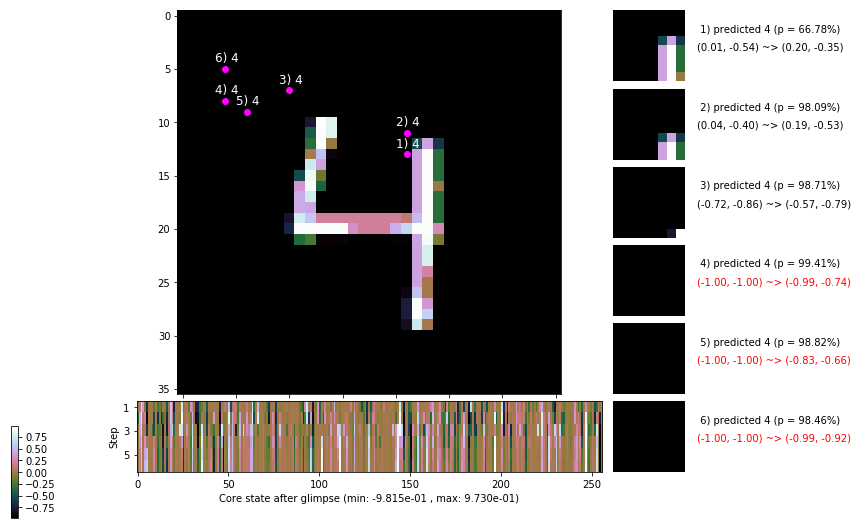

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 154.1 ms/b | lr: 7.25e-04 | grad 2norm: 21.17 | grad inf norm:  6.319
         Weights || abs max:  2.48 (26552.03) | mean: -8.74e-04 ( 0.05) | var: 5.89e-02 (364225.16)
          Biases || abs max:  2.35 (  153.34) | mean: -9.59e-02 ( 0.14) | var: 5.02e-02 (  542.00)
                    class loss: 1.032 | steps: 3.036 | reward:  3.320 | acc.: 64.40%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 153.2 ms/b | lr: 7.24e-04 | grad 2norm: 20.85 | grad inf norm:  6.491
         Weights || abs max:  2.49 ( 1582.38) | mean: -8.59e-04 ( 0.01) | var: 5.90e-02 (   62.54)
          Biases || abs max:  2.35 (   85.47) | mean: -9.59e-02 ( 0.09) | var: 5.03e-02 (   41.76)
                    class loss: 1.076 | steps: 3.145 | reward:  3.187 | acc.: 61.73%

	Target class: 2 | Discounted rewards: [2.876, 3.195, 2.

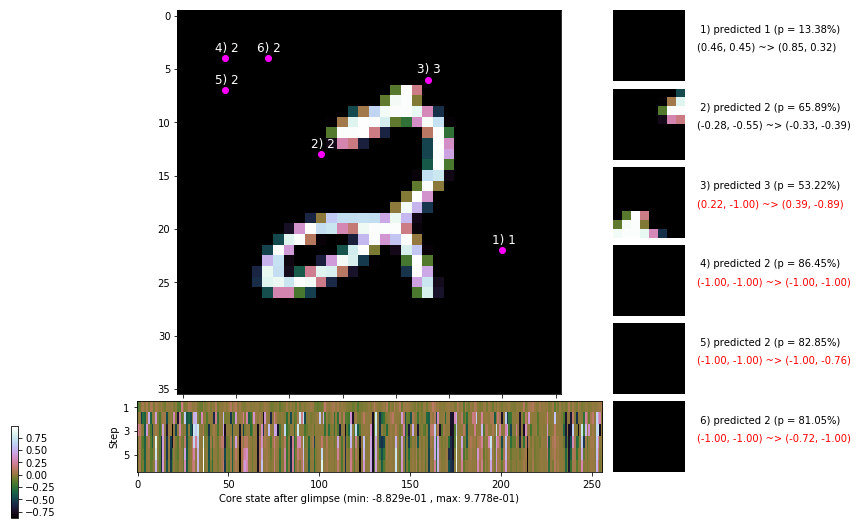

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 153.8 ms/b | lr: 7.22e-04 | grad 2norm: 21.14 | grad inf norm:  6.349
         Weights || abs max:  2.49 ( 1383.35) | mean: -8.28e-04 ( 0.01) | var: 5.91e-02 (   85.44)
          Biases || abs max:  2.35 (  649.51) | mean: -9.62e-02 ( 0.31) | var: 5.02e-02 (15938.04)
                    class loss: 1.054 | steps: 3.131 | reward:  3.208 | acc.: 61.98%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 151.2 ms/b | lr: 7.22e-04 | grad 2norm: 20.86 | grad inf norm:  6.043
         Weights || abs max:  2.49 (  992.25) | mean: -8.16e-04 ( 0.01) | var: 5.93e-02 (   20.98)
          Biases || abs max:  2.34 (   63.18) | mean: -9.69e-02 ( 0.08) | var: 5.03e-02 (   12.00)
                    class loss: 1.064 | steps: 3.090 | reward:  3.230 | acc.: 62.47%

	Target class: 6 | Discounted rewards: [0.000, 0.000, 0.0

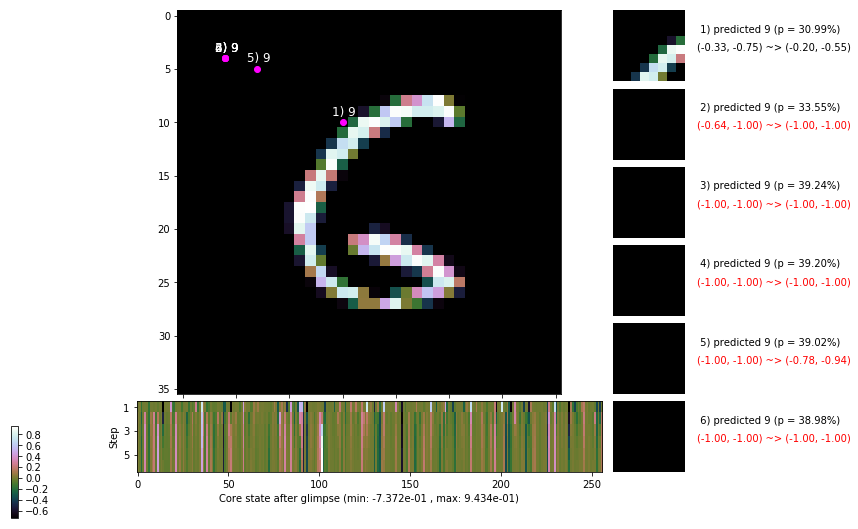

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 154.0 ms/b | lr: 7.20e-04 | grad 2norm: 21.10 | grad inf norm:  6.351
         Weights || abs max:  2.50 ( 3448.54) | mean: -7.97e-04 ( 0.01) | var: 5.94e-02 ( 2239.85)
          Biases || abs max:  2.35 (  479.19) | mean: -9.68e-02 ( 0.36) | var: 5.06e-02 (11173.08)
                    class loss: 1.034 | steps: 3.062 | reward:  3.270 | acc.: 63.33%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 150.3 ms/b | lr: 7.20e-04 | grad 2norm: 20.78 | grad inf norm:  6.195
         Weights || abs max:  2.50 ( 1875.71) | mean: -7.74e-04 ( 0.01) | var: 5.96e-02 (   98.48)
          Biases || abs max:  2.36 (  147.35) | mean: -9.65e-02 ( 0.12) | var: 5.06e-02 (  225.79)
                    class loss: 0.997 | steps: 3.011 | reward:  3.328 | acc.: 64.12%

	Target class: 9 | Discounted rewards: [1.976, 2.195, 2.4

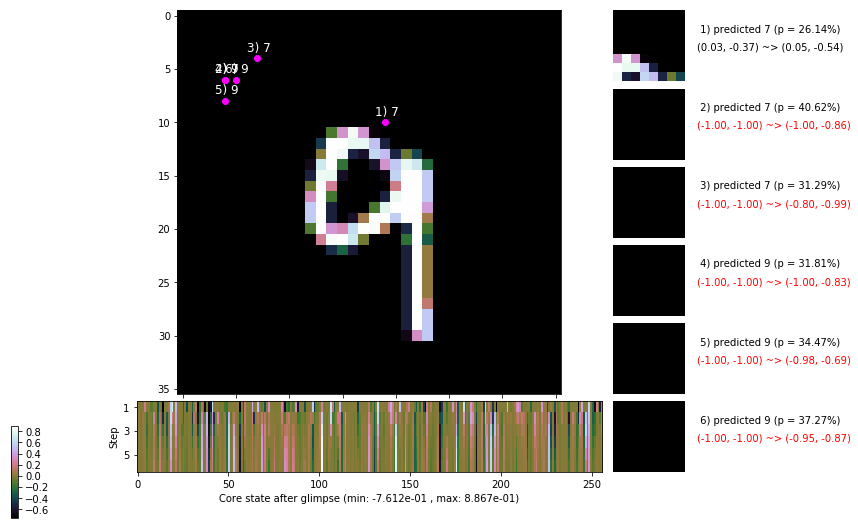

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 7 | Discounted rewards: [0.000, 0.000, 0.000, 0.000, 0.000, 0.000]


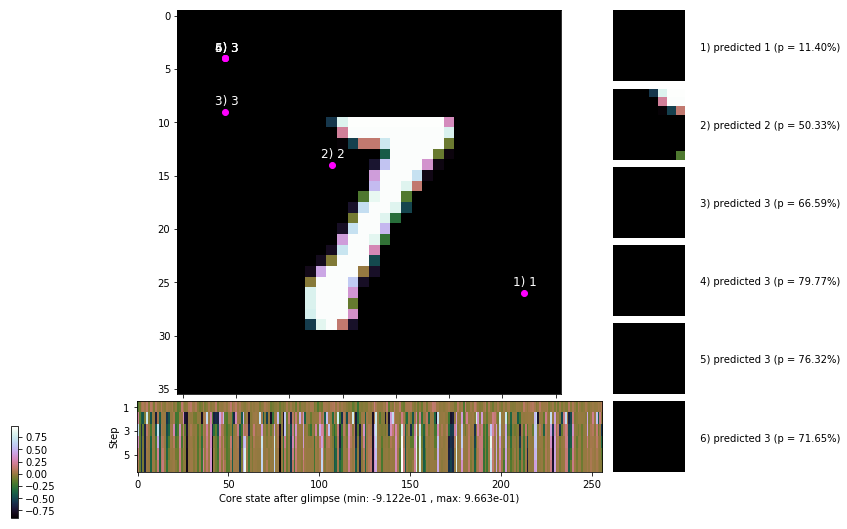


	Target class: 8 | Discounted rewards: [0.900, 1.000, 0.000, 0.000, 0.000, 0.000]


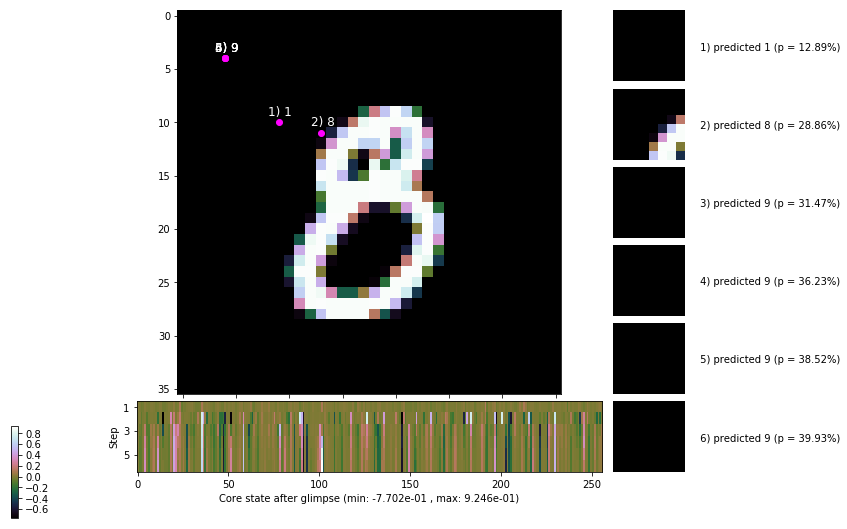

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


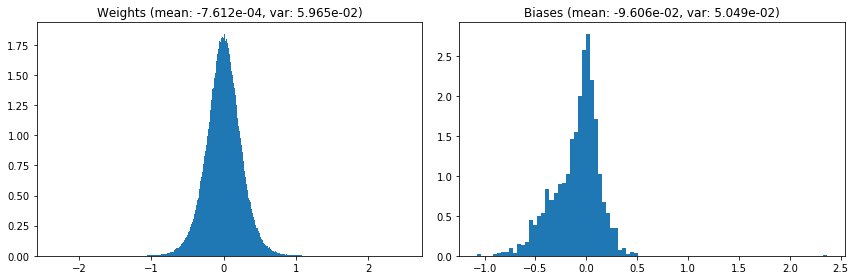

                                      Location network weights and biases


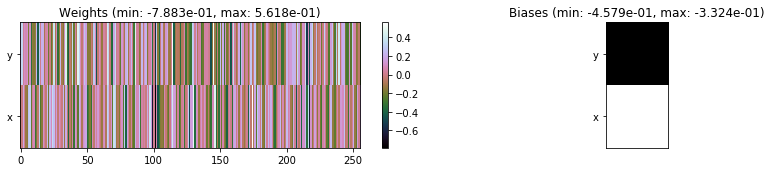

---------------------------------------------------------------------------------------------------------------
Elapsed time:  468.16 sec | TRAIN >> class loss: 1.0434 | steps:  3.092 :( | reward:  3.2485    | acc.: 62.825% :(
                          | VAL   >> class loss: 0.9862 | steps:  3.006 :( | reward:  3.3772 :( | acc.: 64.540% :(


Epoch  23/400) lr = 0.0007188
 b    300/  3000 >> 154.0 ms/b | lr: 7.18e-04 | grad 2norm: 21.00 | grad inf norm:  5.911
         Weights || abs max:  2.51 ( 1476.63) | mean: -7.51e-04 ( 0.01) | var: 5.97e-02 (   22.77)
          Biases || abs max:  2.37 (  133.93) | mean: -9.67e-02 ( 0.11) | var: 5.07e-02 (  154.71)
                    class loss: 1.022 | steps: 3.082 | reward:  3.276 | acc.: 63.87%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 151.9 ms/b | lr: 7.17e-04 | grad 2norm: 20.82 | grad inf norm:  5.939
         Weights || abs max:  2.51 ( 1552.82) | mean: -7.43e-04 (

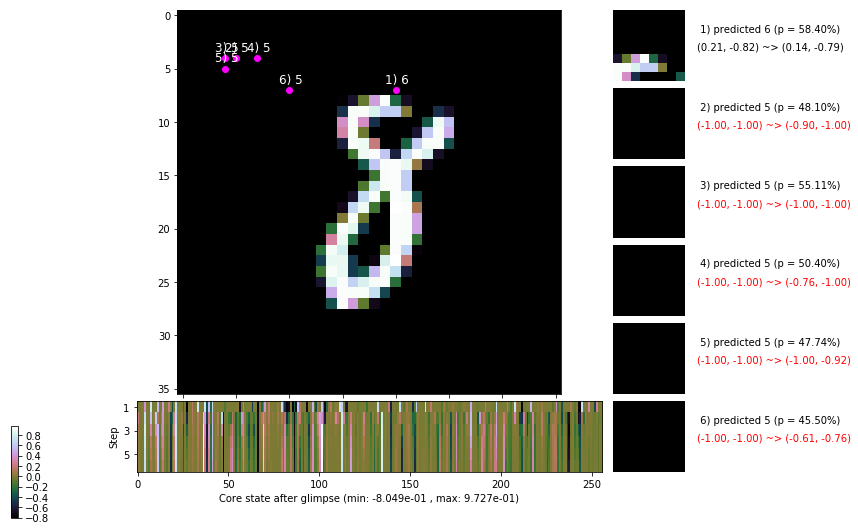

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 153.9 ms/b | lr: 7.16e-04 | grad 2norm: 20.86 | grad inf norm:  6.193
         Weights || abs max:  2.52 ( 1639.65) | mean: -7.23e-04 ( 0.01) | var: 6.00e-02 (   33.26)
          Biases || abs max:  2.36 (  108.34) | mean: -9.72e-02 ( 0.10) | var: 5.08e-02 (   65.50)
                    class loss: 1.054 | steps: 3.103 | reward:  3.210 | acc.: 62.07%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 152.7 ms/b | lr: 7.15e-04 | grad 2norm: 20.54 | grad inf norm:  5.663
         Weights || abs max:  2.52 ( 1796.87) | mean: -6.90e-04 ( 0.01) | var: 6.01e-02 (  115.15)
          Biases || abs max:  2.37 (   90.92) | mean: -9.70e-02 ( 0.09) | var: 5.09e-02 (   39.76)
                    class loss: 1.016 | steps: 3.080 | reward:  3.257 | acc.: 63.33%

	Target class: 4 | Discounted rewards: [4.686, 4.095, 3.4

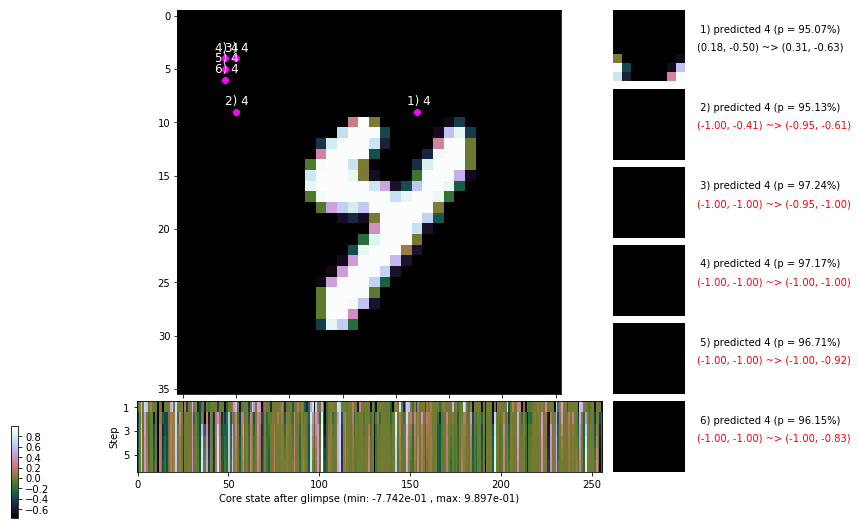

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 155.7 ms/b | lr: 7.14e-04 | grad 2norm: 20.91 | grad inf norm:  5.759
         Weights || abs max:  2.53 ( 3137.81) | mean: -6.68e-04 ( 0.01) | var: 6.03e-02 ( 1126.44)
          Biases || abs max:  2.38 (  120.13) | mean: -9.69e-02 ( 0.11) | var: 5.09e-02 (   71.06)
                    class loss: 0.980 | steps: 3.028 | reward:  3.319 | acc.: 65.13%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 176.8 ms/b | lr: 7.13e-04 | grad 2norm: 21.07 | grad inf norm:  6.109
         Weights || abs max:  2.53 ( 1996.92) | mean: -6.72e-04 ( 0.01) | var: 6.04e-02 (  184.17)
          Biases || abs max:  2.38 (  444.91) | mean: -9.69e-02 ( 0.24) | var: 5.09e-02 (11538.67)
                    class loss: 0.987 | steps: 3.025 | reward:  3.322 | acc.: 64.45%

	Target class: 9 | Discounted rewards: [4.686, 4.095, 3.4

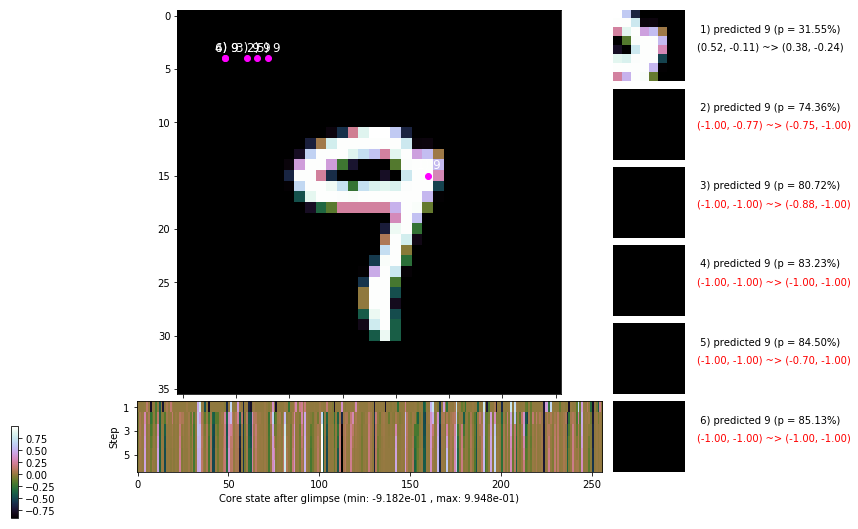

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 156.8 ms/b | lr: 7.12e-04 | grad 2norm: 20.98 | grad inf norm:  5.829
         Weights || abs max:  2.53 ( 1135.52) | mean: -6.95e-04 ( 0.01) | var: 6.06e-02 (   61.34)
          Biases || abs max:  2.39 (  100.61) | mean: -9.70e-02 ( 0.10) | var: 5.11e-02 (   48.52)
                    class loss: 0.985 | steps: 3.062 | reward:  3.311 | acc.: 65.12%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 156.1 ms/b | lr: 7.11e-04 | grad 2norm: 21.00 | grad inf norm:  5.945
         Weights || abs max:  2.53 ( 1577.41) | mean: -7.32e-04 ( 0.01) | var: 6.07e-02 (  142.79)
          Biases || abs max:  2.39 (   66.35) | mean: -9.73e-02 ( 0.08) | var: 5.12e-02 (   16.53)
                    class loss: 1.013 | steps: 3.070 | reward:  3.294 | acc.: 63.97%

	Target class: 9 | Discounted rewards: [0.810, 0.900, 1.0

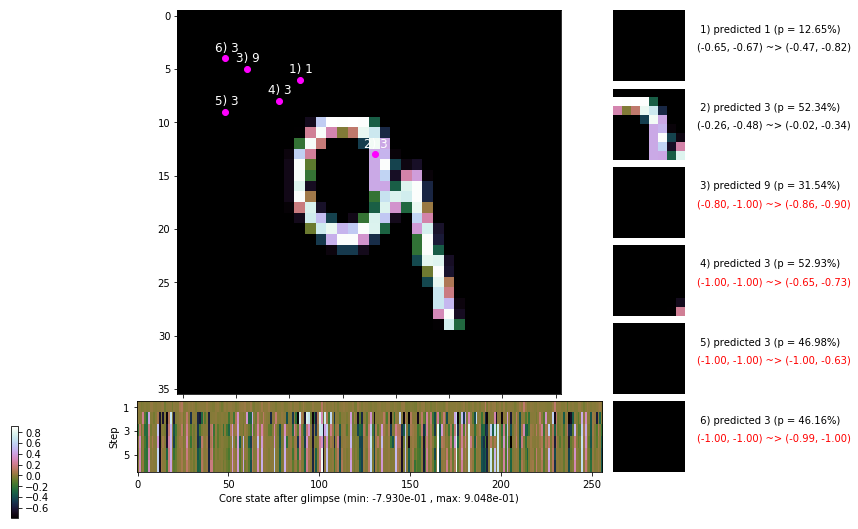

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 153.8 ms/b | lr: 7.10e-04 | grad 2norm: 21.19 | grad inf norm:  6.256
         Weights || abs max:  2.54 ( 1991.87) | mean: -7.12e-04 ( 0.01) | var: 6.08e-02 (  153.07)
          Biases || abs max:  2.39 (  128.89) | mean: -9.77e-02 ( 0.11) | var: 5.15e-02 (  122.17)
                    class loss: 0.987 | steps: 3.035 | reward:  3.326 | acc.: 64.67%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 150.7 ms/b | lr: 7.09e-04 | grad 2norm: 21.37 | grad inf norm:  5.987
         Weights || abs max:  2.54 ( 1593.23) | mean: -7.04e-04 ( 0.01) | var: 6.10e-02 (  127.51)
          Biases || abs max:  2.40 (   57.89) | mean: -9.77e-02 ( 0.07) | var: 5.16e-02 (   13.67)
                    class loss: 0.965 | steps: 3.022 | reward:  3.363 | acc.: 65.73%

	Target class: 8 | Discounted rewards: [4.686, 4.095, 3.4

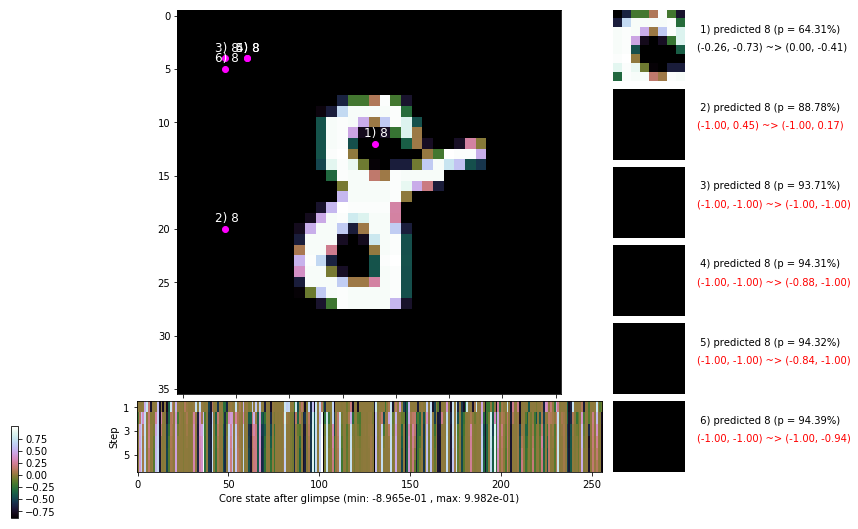

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 2 | Discounted rewards: [1.247, 1.385, 1.539, 1.710, 1.900, 1.000]


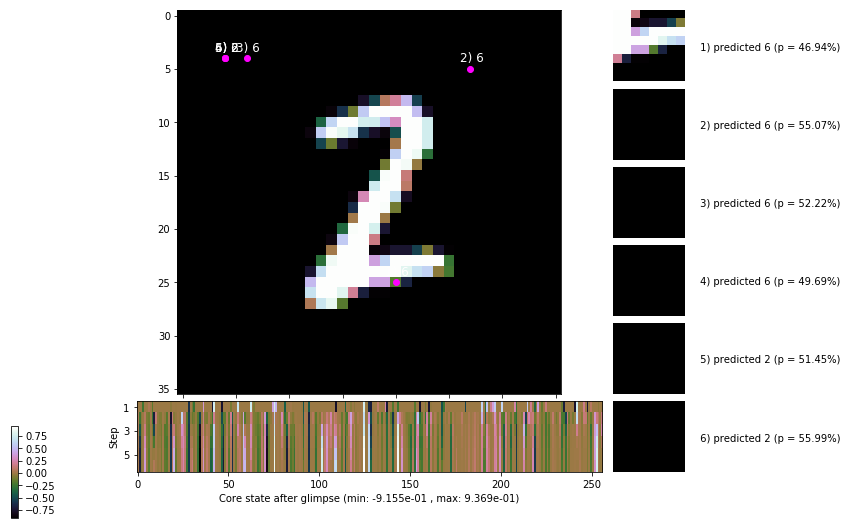


	Target class: 8 | Discounted rewards: [3.686, 4.095, 3.439, 2.710, 1.900, 1.000]


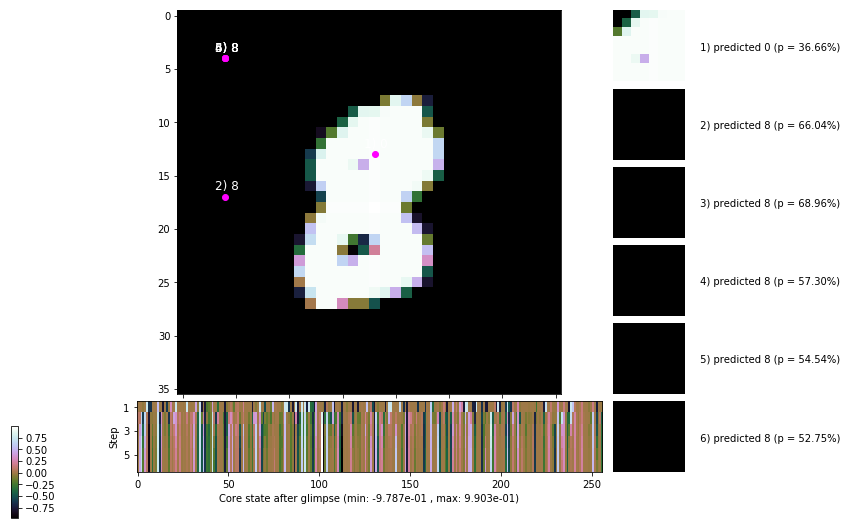

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


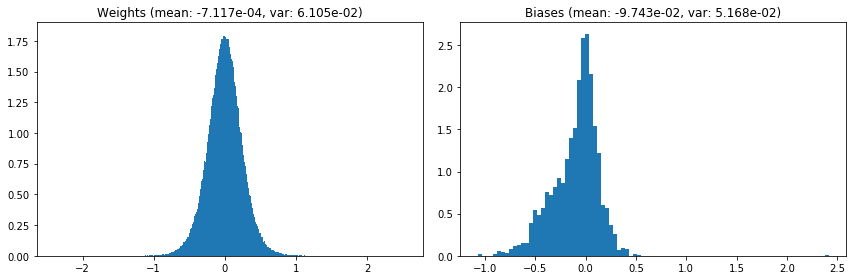

                                      Location network weights and biases


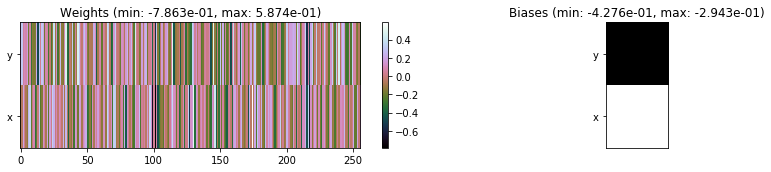

---------------------------------------------------------------------------------------------------------------
Elapsed time:  469.33 sec | TRAIN >> class loss: 1.0032 | steps:  3.059    | reward:  3.2961    | acc.: 64.207% 
                          | VAL   >> class loss: 0.9073 | steps:  2.915    | reward:  3.4514    | acc.: 66.420% 


Epoch  24/400) lr = 0.0007081
 b    300/  3000 >> 151.5 ms/b | lr: 7.07e-04 | grad 2norm: 21.73 | grad inf norm:  6.511
         Weights || abs max:  2.54 ( 2386.93) | mean: -7.35e-04 ( 0.01) | var: 6.11e-02 (  512.40)
          Biases || abs max:  2.41 (  158.24) | mean: -9.73e-02 ( 0.11) | var: 5.16e-02 (  691.80)
                    class loss: 1.003 | steps: 3.090 | reward:  3.293 | acc.: 64.32%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 153.4 ms/b | lr: 7.07e-04 | grad 2norm: 21.19 | grad inf norm:  6.111
         Weights || abs max:  2.54 ( 1405.52) | mean: -7.44e-04 ( 0.0

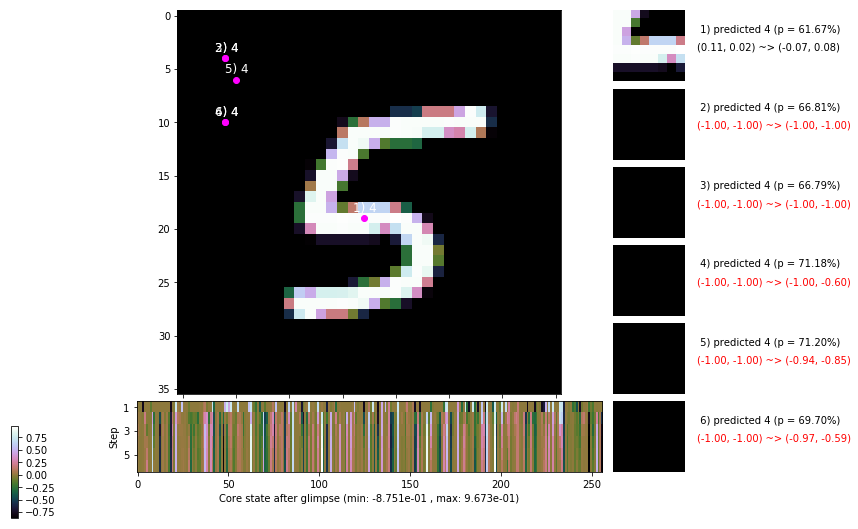

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 153.6 ms/b | lr: 7.05e-04 | grad 2norm: 21.20 | grad inf norm:  5.968
         Weights || abs max:  2.55 ( 1596.09) | mean: -7.42e-04 ( 0.01) | var: 6.14e-02 (   71.52)
          Biases || abs max:  2.41 (  183.61) | mean: -9.87e-02 ( 0.13) | var: 5.18e-02 (  422.92)
                    class loss: 0.964 | steps: 3.037 | reward:  3.361 | acc.: 65.48%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 153.0 ms/b | lr: 7.05e-04 | grad 2norm: 21.13 | grad inf norm:  5.973
         Weights || abs max:  2.55 ( 3884.05) | mean: -7.13e-04 ( 0.01) | var: 6.15e-02 ( 4813.29)
          Biases || abs max:  2.43 (  161.51) | mean: -9.85e-02 ( 0.12) | var: 5.20e-02 (  605.58)
                    class loss: 0.963 | steps: 3.010 | reward:  3.382 | acc.: 66.05%

	Target class: 1 | Discounted rewards: [4.686, 4.095, 3.4

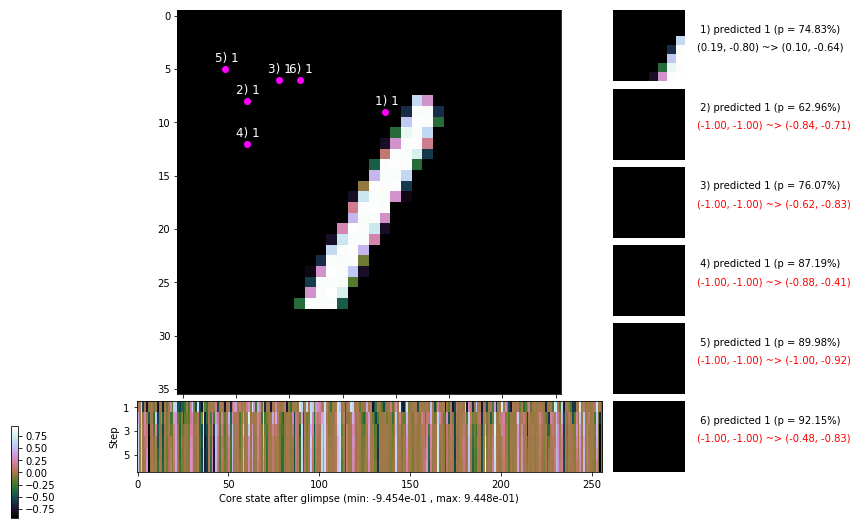

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 155.2 ms/b | lr: 7.03e-04 | grad 2norm: 20.90 | grad inf norm:  5.615
         Weights || abs max:  2.56 ( 2720.46) | mean: -7.35e-04 ( 0.01) | var: 6.16e-02 (  615.58)
          Biases || abs max:  2.43 (  132.80) | mean: -9.85e-02 ( 0.12) | var: 5.21e-02 (   96.41)
                    class loss: 0.975 | steps: 3.052 | reward:  3.353 | acc.: 65.80%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 154.2 ms/b | lr: 7.02e-04 | grad 2norm: 21.42 | grad inf norm:  6.258
         Weights || abs max:  2.56 ( 6799.07) | mean: -7.71e-04 ( 0.02) | var: 6.18e-02 (17458.69)
          Biases || abs max:  2.42 (   98.11) | mean: -9.87e-02 ( 0.10) | var: 5.23e-02 (   72.93)
                    class loss: 0.958 | steps: 3.010 | reward:  3.345 | acc.: 65.20%

	Target class: 5 | Discounted rewards: [0.000, 0.000, 0.0

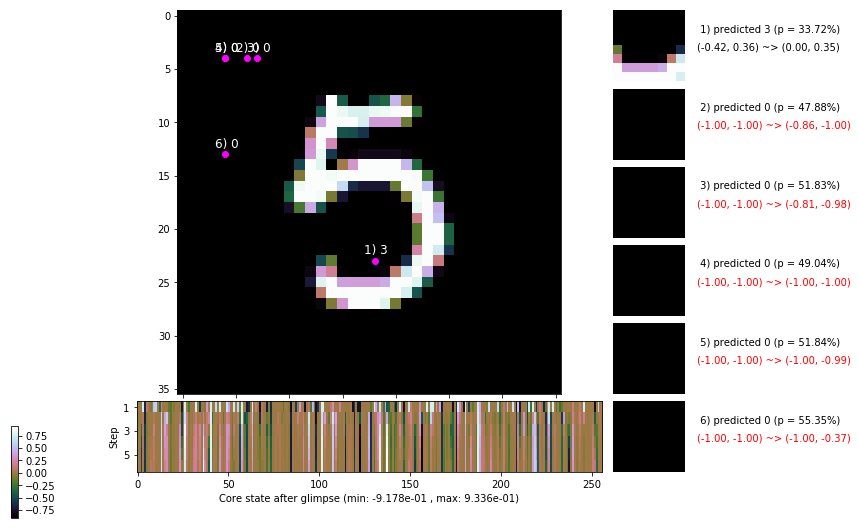

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 153.9 ms/b | lr: 7.01e-04 | grad 2norm: 21.26 | grad inf norm:  6.238
         Weights || abs max:  2.56 ( 1733.56) | mean: -7.69e-04 ( 0.01) | var: 6.19e-02 (  117.60)
          Biases || abs max:  2.42 (  116.96) | mean: -9.85e-02 ( 0.10) | var: 5.23e-02 (  145.80)
                    class loss: 0.942 | steps: 3.009 | reward:  3.381 | acc.: 66.27%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 158.3 ms/b | lr: 7.00e-04 | grad 2norm: 21.68 | grad inf norm:  6.398
         Weights || abs max:  2.57 ( 2007.54) | mean: -7.49e-04 ( 0.01) | var: 6.20e-02 (  387.34)
          Biases || abs max:  2.43 (   69.57) | mean: -9.87e-02 ( 0.08) | var: 5.24e-02 (   14.28)
                    class loss: 0.975 | steps: 3.010 | reward:  3.353 | acc.: 65.30%

	Target class: 9 | Discounted rewards: [0.900, 1.000, 0.0

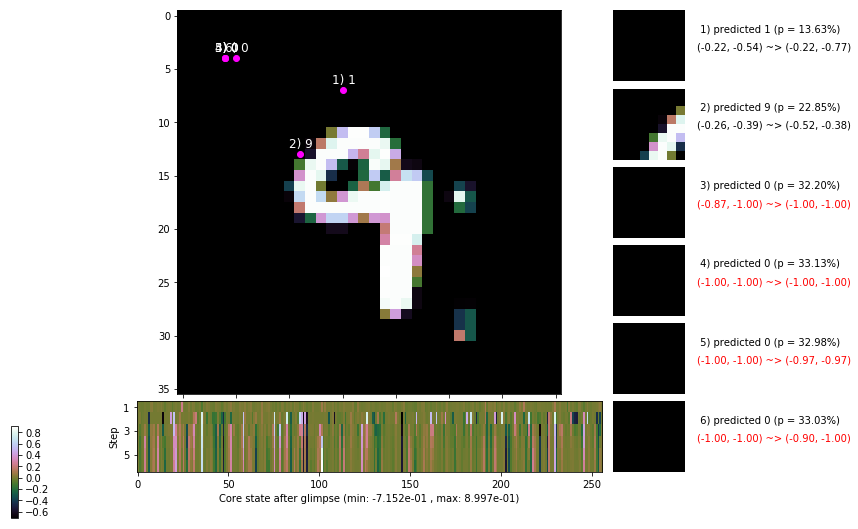

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 175.0 ms/b | lr: 6.99e-04 | grad 2norm: 21.45 | grad inf norm:  6.022
         Weights || abs max:  2.57 ( 3622.18) | mean: -7.54e-04 ( 0.01) | var: 6.22e-02 ( 2348.77)
          Biases || abs max:  2.44 (  136.87) | mean: -9.89e-02 ( 0.11) | var: 5.24e-02 (  223.02)
                    class loss: 0.945 | steps: 2.970 | reward:  3.395 | acc.: 66.17%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 152.2 ms/b | lr: 6.98e-04 | grad 2norm: 21.58 | grad inf norm:  6.086
         Weights || abs max:  2.58 ( 2698.48) | mean: -7.49e-04 ( 0.01) | var: 6.23e-02 (  176.96)
          Biases || abs max:  2.44 (  121.94) | mean: -9.95e-02 ( 0.12) | var: 5.26e-02 (  326.97)
                    class loss: 0.948 | steps: 2.955 | reward:  3.418 | acc.: 66.13%

	Target class: 7 | Discounted rewards: [2.786, 3.095, 3.4

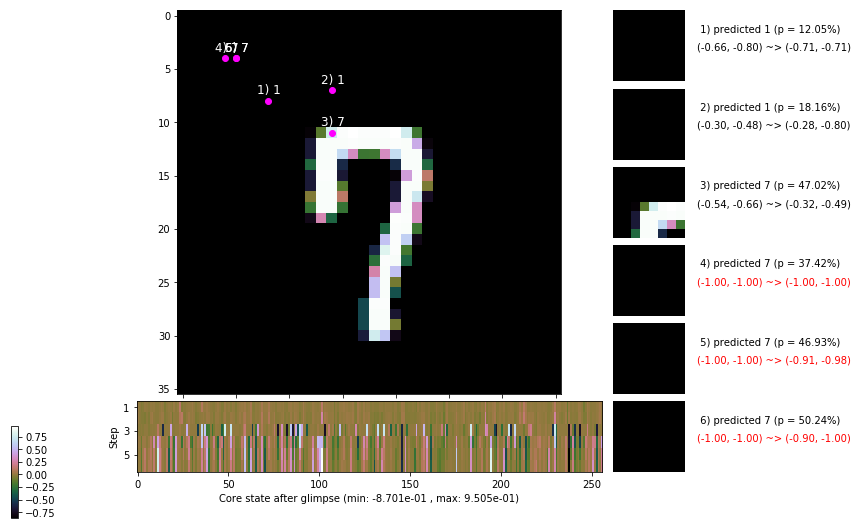

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 3 | Discounted rewards: [3.686, 4.095, 3.439, 2.710, 1.900, 1.000]


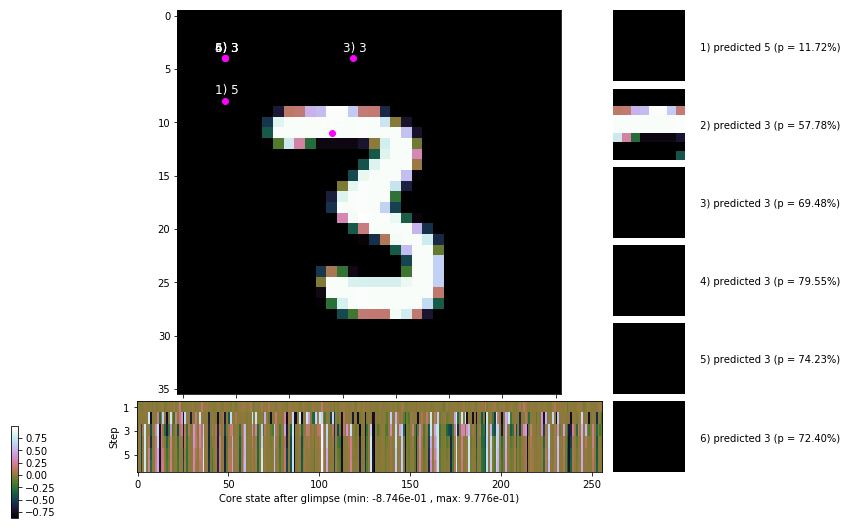


	Target class: 1 | Discounted rewards: [4.686, 4.095, 3.439, 2.710, 1.900, 1.000]


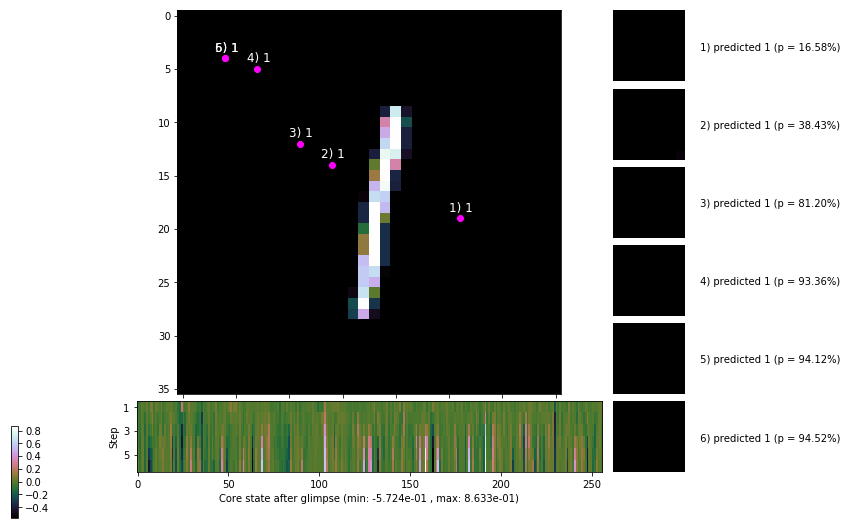

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


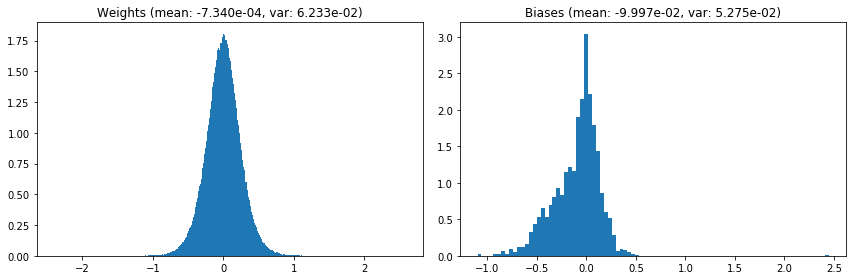

                                      Location network weights and biases


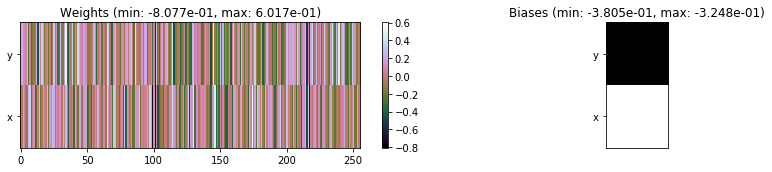

---------------------------------------------------------------------------------------------------------------
Elapsed time:  468.76 sec | TRAIN >> class loss: 0.9676 | steps:  3.021    | reward:  3.3582    | acc.: 65.520% 
                          | VAL   >> class loss: 0.9112 | steps:  2.928 :( | reward:  3.4726    | acc.: 67.060% 


Epoch  25/400) lr = 0.0006976
 b    300/  3000 >> 152.4 ms/b | lr: 6.97e-04 | grad 2norm: 21.25 | grad inf norm:  6.156
         Weights || abs max:  2.58 ( 3236.53) | mean: -7.34e-04 ( 0.01) | var: 6.24e-02 ( 2511.92)
          Biases || abs max:  2.44 (   45.86) | mean: -9.99e-02 ( 0.07) | var: 5.29e-02 (   14.57)
                    class loss: 0.976 | steps: 3.008 | reward:  3.340 | acc.: 64.83%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 152.0 ms/b | lr: 6.96e-04 | grad 2norm: 20.90 | grad inf norm:  6.044
         Weights || abs max:  2.58 ( 3537.73) | mean: -7.53e-04 ( 0.0

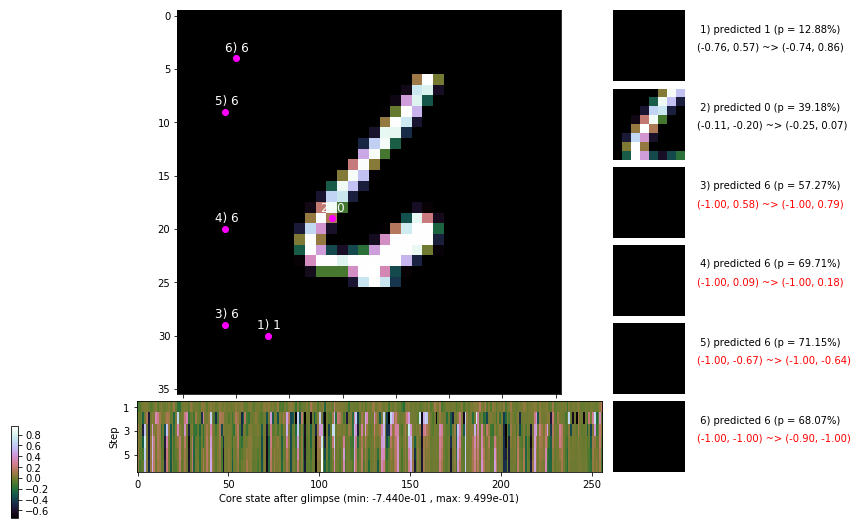

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 155.4 ms/b | lr: 6.95e-04 | grad 2norm: 21.71 | grad inf norm:  6.249
         Weights || abs max:  2.58 ( 1270.26) | mean: -7.75e-04 ( 0.01) | var: 6.27e-02 (   32.35)
          Biases || abs max:  2.45 (   79.86) | mean: -9.95e-02 ( 0.08) | var: 5.32e-02 (   29.93)
                    class loss: 0.937 | steps: 2.961 | reward:  3.410 | acc.: 66.25%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 152.6 ms/b | lr: 6.94e-04 | grad 2norm: 21.41 | grad inf norm:  5.958
         Weights || abs max:  2.57 ( 3082.52) | mean: -7.96e-04 ( 0.01) | var: 6.28e-02 (  570.66)
          Biases || abs max:  2.44 (  144.99) | mean: -9.96e-02 ( 0.11) | var: 5.34e-02 (  198.86)
                    class loss: 0.948 | steps: 2.995 | reward:  3.395 | acc.: 66.12%

	Target class: 7 | Discounted rewards: [1.000, 0.000, 0.0

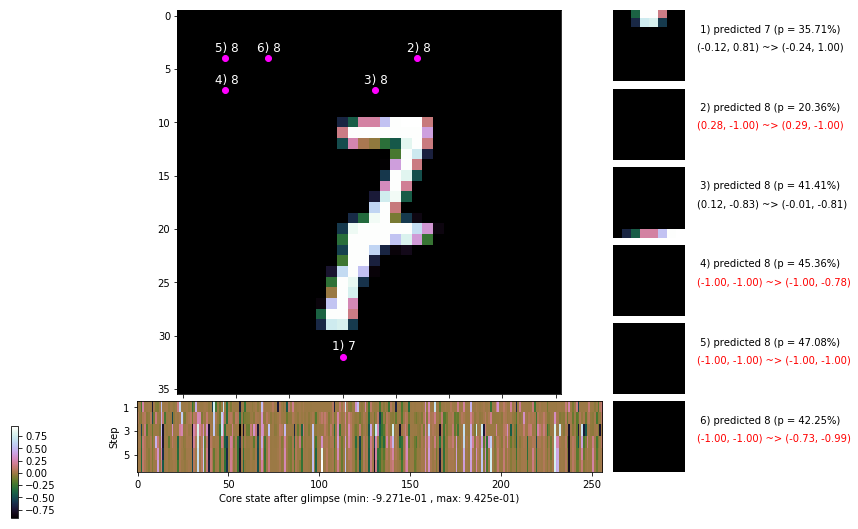

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 155.2 ms/b | lr: 6.93e-04 | grad 2norm: 21.79 | grad inf norm:  6.265
         Weights || abs max:  2.58 ( 5862.00) | mean: -8.13e-04 ( 0.02) | var: 6.29e-02 ( 3348.90)
          Biases || abs max:  2.44 (  120.74) | mean: -1.00e-01 ( 0.10) | var: 5.33e-02 (  231.84)
                    class loss: 0.943 | steps: 2.989 | reward:  3.374 | acc.: 65.90%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 154.7 ms/b | lr: 6.92e-04 | grad 2norm: 21.09 | grad inf norm:  5.882
         Weights || abs max:  2.58 ( 2010.62) | mean: -8.24e-04 ( 0.01) | var: 6.31e-02 (   98.28)
          Biases || abs max:  2.45 (  105.61) | mean: -1.01e-01 ( 0.10) | var: 5.35e-02 (   64.03)
                    class loss: 0.964 | steps: 3.009 | reward:  3.338 | acc.: 65.65%

	Target class: 8 | Discounted rewards: [2.786, 3.095, 3.4

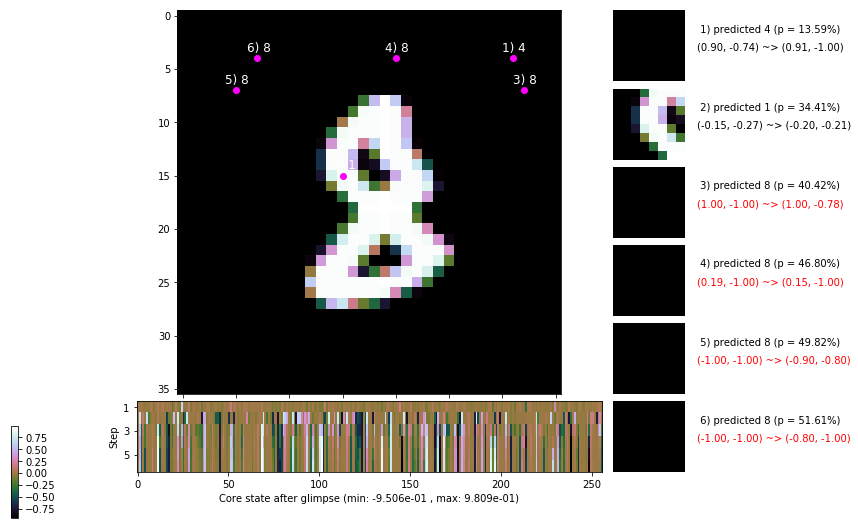

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 152.7 ms/b | lr: 6.91e-04 | grad 2norm: 21.19 | grad inf norm:  6.129
         Weights || abs max:  2.58 ( 6045.45) | mean: -8.40e-04 ( 0.02) | var: 6.32e-02 ( 9316.21)
          Biases || abs max:  2.45 (   70.46) | mean: -1.02e-01 ( 0.08) | var: 5.36e-02 (   38.68)
                    class loss: 0.950 | steps: 2.993 | reward:  3.382 | acc.: 66.45%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 153.1 ms/b | lr: 6.90e-04 | grad 2norm: 21.26 | grad inf norm:  5.997
         Weights || abs max:  2.58 ( 2505.54) | mean: -8.40e-04 ( 0.01) | var: 6.33e-02 (  200.06)
          Biases || abs max:  2.45 (  128.49) | mean: -1.01e-01 ( 0.10) | var: 5.36e-02 (  273.00)
                    class loss: 0.909 | steps: 2.938 | reward:  3.445 | acc.: 67.18%

	Target class: 3 | Discounted rewards: [3.686, 4.095, 3.4

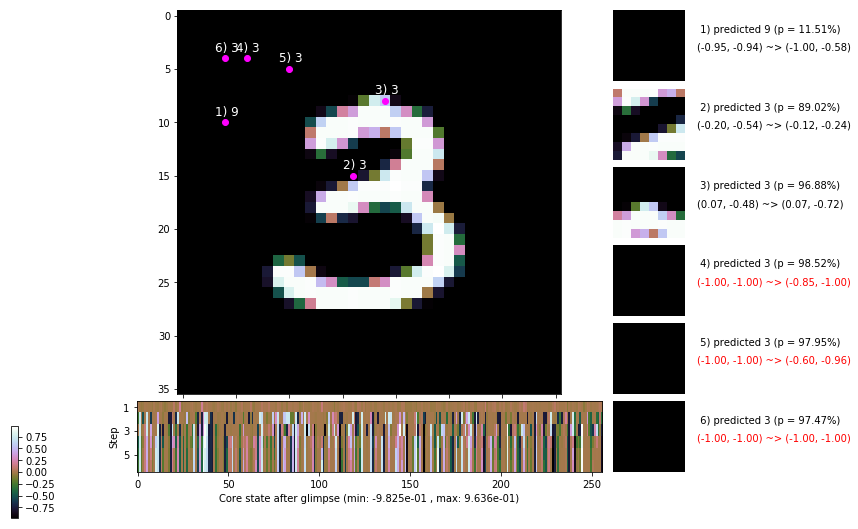

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 155.8 ms/b | lr: 6.89e-04 | grad 2norm: 21.02 | grad inf norm:  5.978
         Weights || abs max:  2.58 ( 1991.95) | mean: -8.16e-04 ( 0.01) | var: 6.34e-02 (  279.29)
          Biases || abs max:  2.45 (   89.74) | mean: -1.02e-01 ( 0.09) | var: 5.39e-02 (   22.68)
                    class loss: 0.977 | steps: 3.034 | reward:  3.348 | acc.: 65.33%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 154.3 ms/b | lr: 6.88e-04 | grad 2norm: 21.12 | grad inf norm:  6.074
         Weights || abs max:  2.59 ( 1718.15) | mean: -8.15e-04 ( 0.01) | var: 6.35e-02 (  216.63)
          Biases || abs max:  2.44 (  146.79) | mean: -1.02e-01 ( 0.10) | var: 5.39e-02 (  944.43)
                    class loss: 0.988 | steps: 3.042 | reward:  3.342 | acc.: 65.00%

	Target class: 1 | Discounted rewards: [4.686, 4.095, 3.4

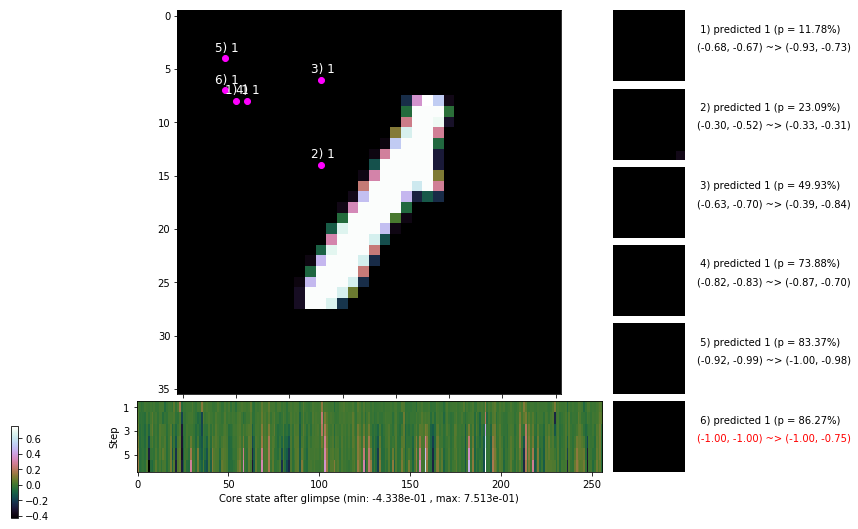

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 7 | Discounted rewards: [3.686, 4.095, 3.439, 2.710, 1.900, 1.000]


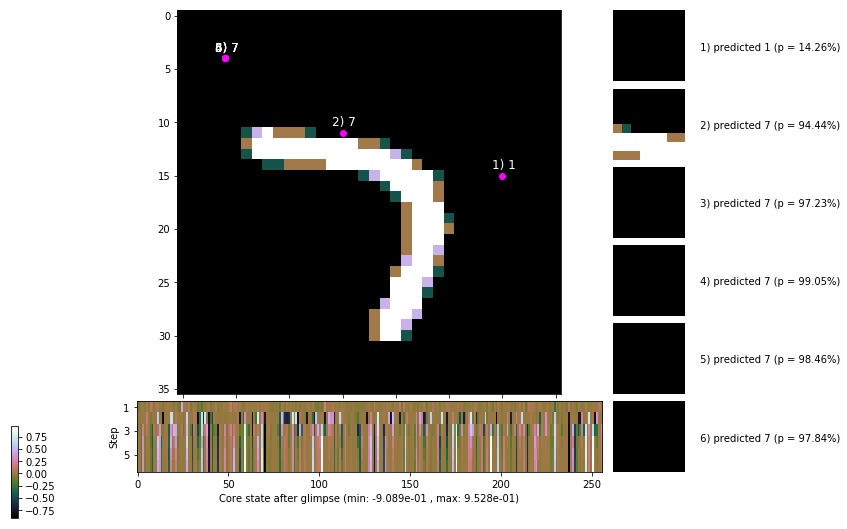


	Target class: 2 | Discounted rewards: [0.000, 0.000, 0.000, 0.000, 0.000, 0.000]


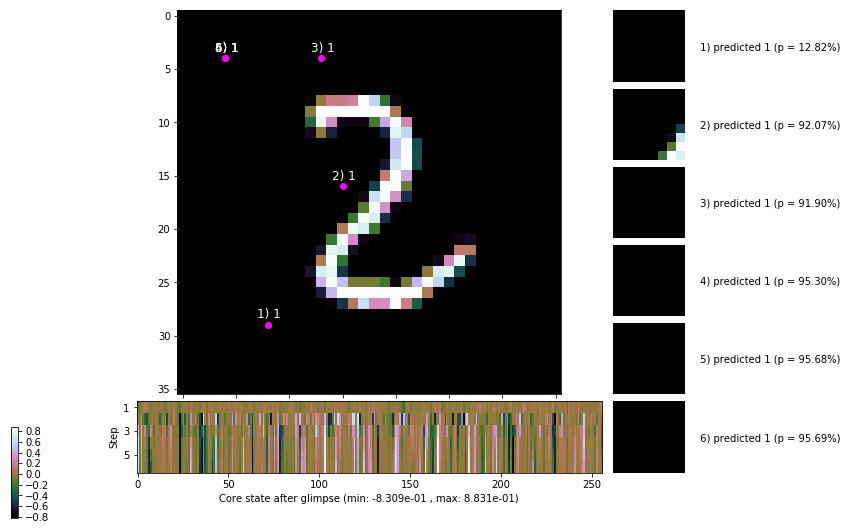

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


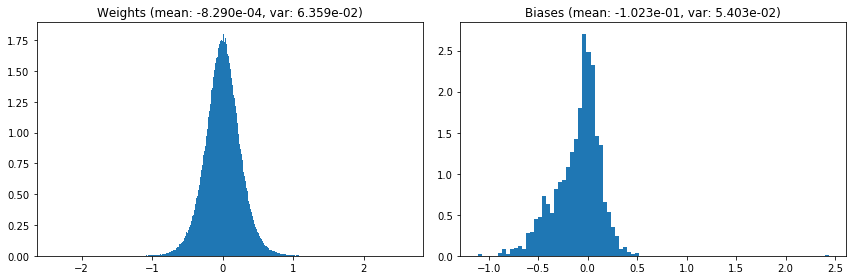

                                      Location network weights and biases


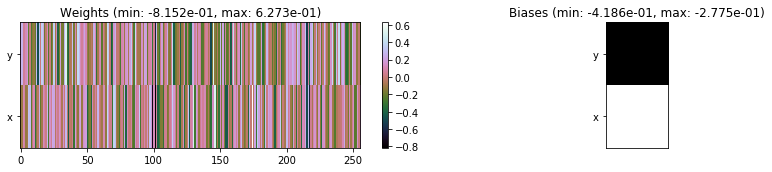

---------------------------------------------------------------------------------------------------------------
Elapsed time:  461.96 sec | TRAIN >> class loss: 0.9550 | steps:  2.998    | reward:  3.3742    | acc.: 65.842% 
                          | VAL   >> class loss: 0.9252 | steps:  2.943 :( | reward:  3.4820    | acc.: 66.660% :(


Epoch  26/400) lr = 0.0006872
 b    300/  3000 >> 174.2 ms/b | lr: 6.86e-04 | grad 2norm: 21.01 | grad inf norm:  5.816
         Weights || abs max:  2.59 ( 1994.61) | mean: -8.00e-04 ( 0.01) | var: 6.37e-02 (   74.09)
          Biases || abs max:  2.43 (   76.57) | mean: -1.02e-01 ( 0.07) | var: 5.41e-02 (   58.93)
                    class loss: 0.962 | steps: 2.982 | reward:  3.392 | acc.: 65.82%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 158.3 ms/b | lr: 6.86e-04 | grad 2norm: 21.36 | grad inf norm:  6.171
         Weights || abs max:  2.59 (11253.30) | mean: -7.40e-04 ( 0

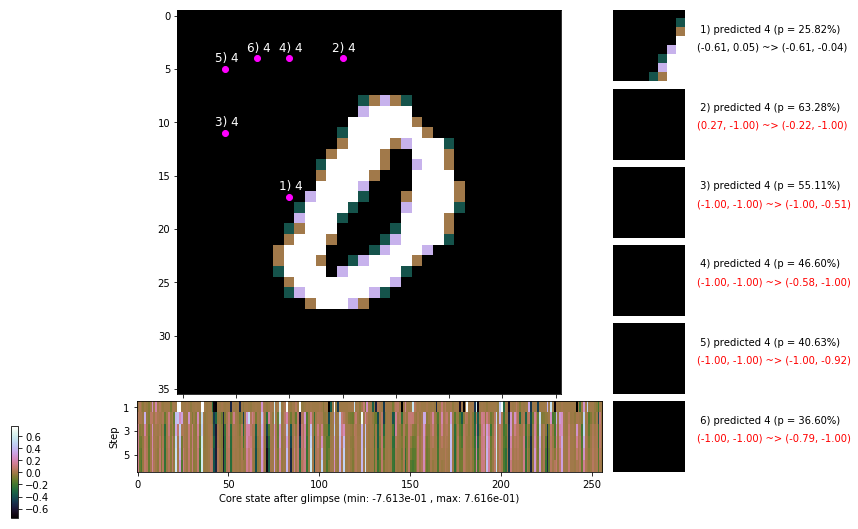

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 153.5 ms/b | lr: 6.84e-04 | grad 2norm: 20.78 | grad inf norm:  5.737
         Weights || abs max:  2.59 ( 9899.65) | mean: -7.49e-04 ( 0.02) | var: 6.39e-02 (40194.10)
          Biases || abs max:  2.45 (  120.27) | mean: -1.03e-01 ( 0.10) | var: 5.43e-02 (   74.51)
                    class loss: 0.941 | steps: 2.988 | reward:  3.417 | acc.: 66.93%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 154.7 ms/b | lr: 6.84e-04 | grad 2norm: 20.82 | grad inf norm:  5.955
         Weights || abs max:  2.59 ( 2402.44) | mean: -7.58e-04 ( 0.01) | var: 6.40e-02 (  342.93)
          Biases || abs max:  2.45 (  923.76) | mean: -1.03e-01 ( 0.41) | var: 5.44e-02 (58476.27)
                    class loss: 0.947 | steps: 2.983 | reward:  3.375 | acc.: 65.33%

	Target class: 7 | Discounted rewards: [0.000, 0.000, 0.0

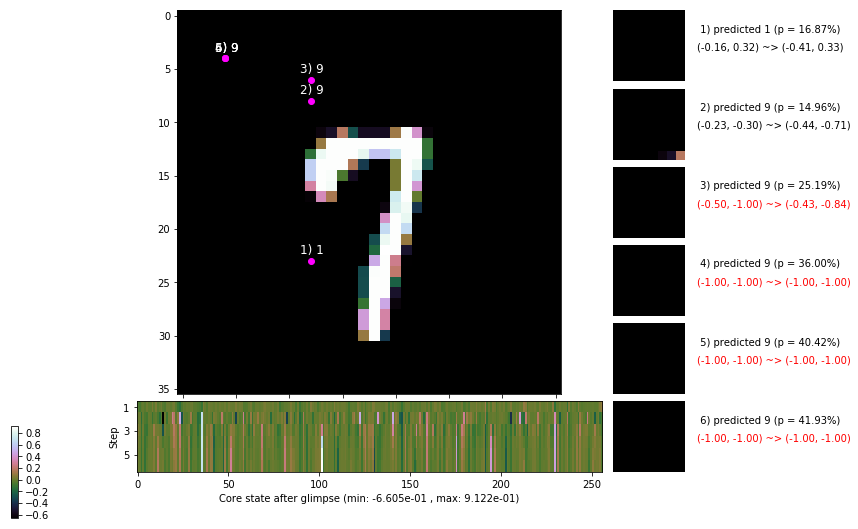

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 154.3 ms/b | lr: 6.82e-04 | grad 2norm: 21.14 | grad inf norm:  6.073
         Weights || abs max:  2.59 ( 4837.82) | mean: -7.44e-04 ( 0.01) | var: 6.42e-02 ( 5497.90)
          Biases || abs max:  2.45 (  242.06) | mean: -1.03e-01 ( 0.16) | var: 5.46e-02 (  913.22)
                    class loss: 0.933 | steps: 2.968 | reward:  3.428 | acc.: 66.87%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 151.5 ms/b | lr: 6.82e-04 | grad 2norm: 21.02 | grad inf norm:  5.909
         Weights || abs max:  2.60 ( 5146.31) | mean: -7.08e-04 ( 0.01) | var: 6.43e-02 ( 2623.26)
          Biases || abs max:  2.46 (  140.55) | mean: -1.03e-01 ( 0.10) | var: 5.46e-02 (  286.91)
                    class loss: 0.905 | steps: 2.996 | reward:  3.413 | acc.: 67.05%

	Target class: 4 | Discounted rewards: [3.686, 4.095, 3.4

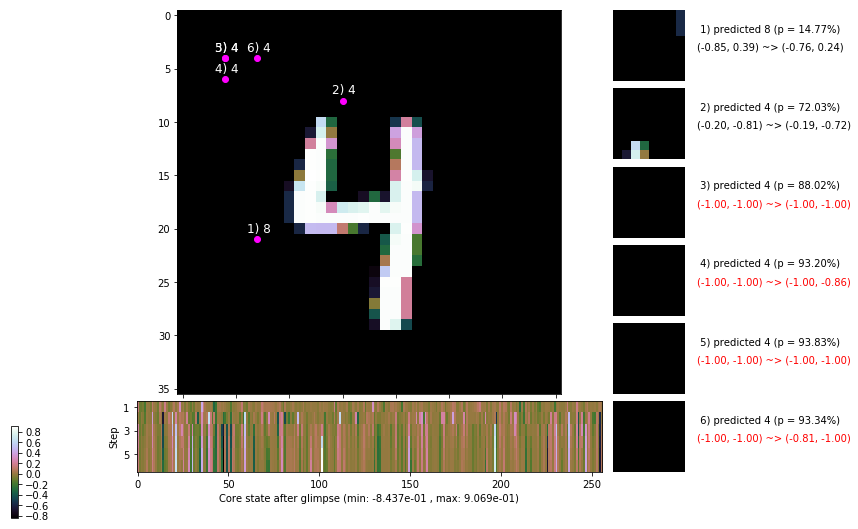

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 154.1 ms/b | lr: 6.80e-04 | grad 2norm: 21.13 | grad inf norm:  6.003
         Weights || abs max:  2.60 ( 1842.04) | mean: -7.21e-04 ( 0.01) | var: 6.44e-02 (  166.54)
          Biases || abs max:  2.46 (  231.78) | mean: -1.03e-01 ( 0.15) | var: 5.48e-02 ( 1703.31)
                    class loss: 0.946 | steps: 2.947 | reward:  3.449 | acc.: 66.87%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 151.8 ms/b | lr: 6.80e-04 | grad 2norm: 21.52 | grad inf norm:  6.389
         Weights || abs max:  2.60 ( 1310.88) | mean: -7.23e-04 ( 0.01) | var: 6.45e-02 (   52.66)
          Biases || abs max:  2.47 (  117.63) | mean: -1.03e-01 ( 0.11) | var: 5.48e-02 (  393.90)
                    class loss: 0.927 | steps: 3.000 | reward:  3.421 | acc.: 67.22%

	Target class: 1 | Discounted rewards: [2.976, 2.195, 2.4

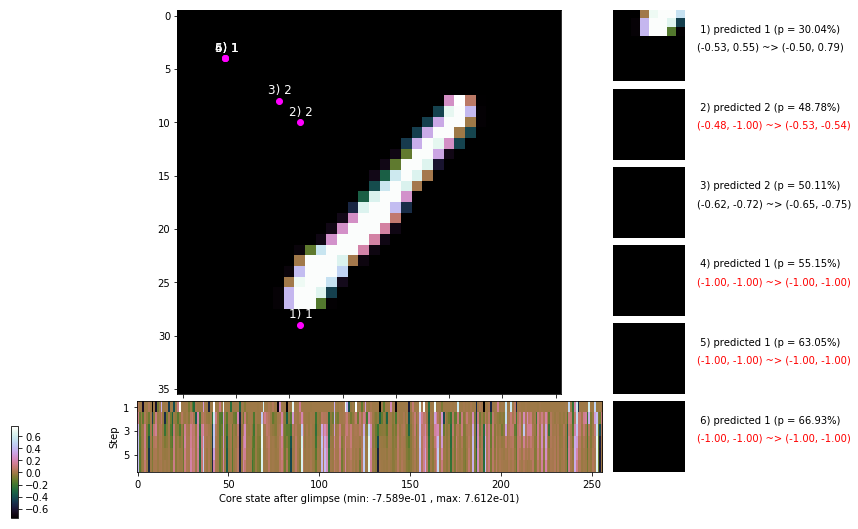

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 155.1 ms/b | lr: 6.78e-04 | grad 2norm: 21.19 | grad inf norm:  6.119
         Weights || abs max:  2.61 ( 1406.63) | mean: -7.15e-04 ( 0.01) | var: 6.46e-02 (   28.10)
          Biases || abs max:  2.48 (   71.96) | mean: -1.04e-01 ( 0.09) | var: 5.50e-02 (   14.67)
                    class loss: 0.899 | steps: 2.910 | reward:  3.502 | acc.: 68.12%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 151.4 ms/b | lr: 6.78e-04 | grad 2norm: 21.06 | grad inf norm:  5.702
         Weights || abs max:  2.61 ( 2264.28) | mean: -6.90e-04 ( 0.01) | var: 6.47e-02 (  456.01)
          Biases || abs max:  2.48 (  197.42) | mean: -1.04e-01 ( 0.14) | var: 5.50e-02 (  536.64)
                    class loss: 0.920 | steps: 2.969 | reward:  3.447 | acc.: 67.87%

	Target class: 2 | Discounted rewards: [2.786, 3.095, 3.4

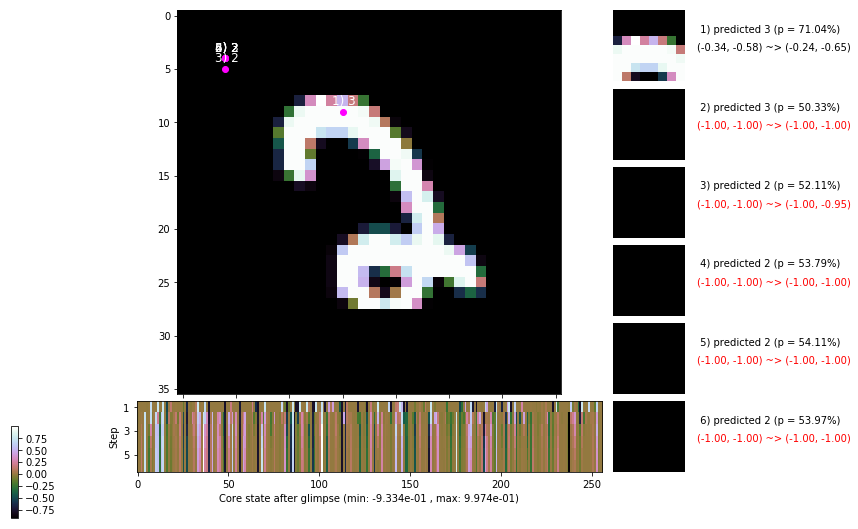

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 3 | Discounted rewards: [0.000, 0.000, 0.000, 0.000, 0.000, 0.000]


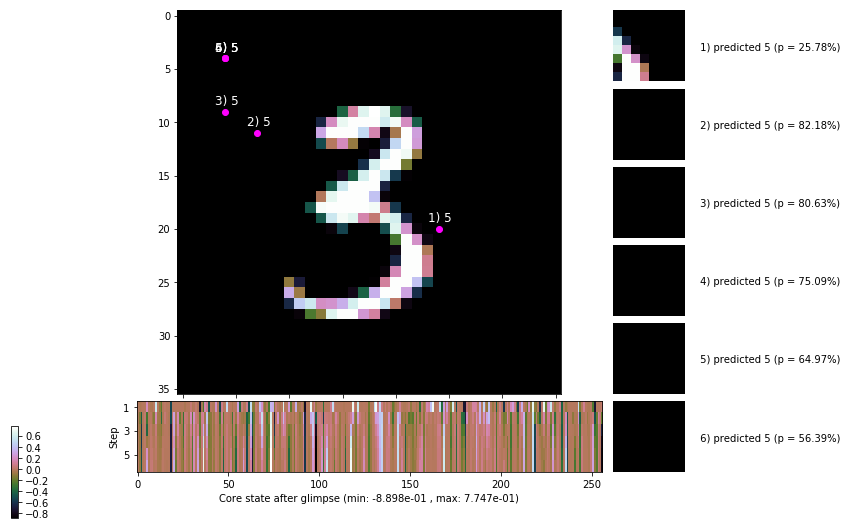


	Target class: 8 | Discounted rewards: [0.000, 0.000, 0.000, 0.000, 0.000, 0.000]


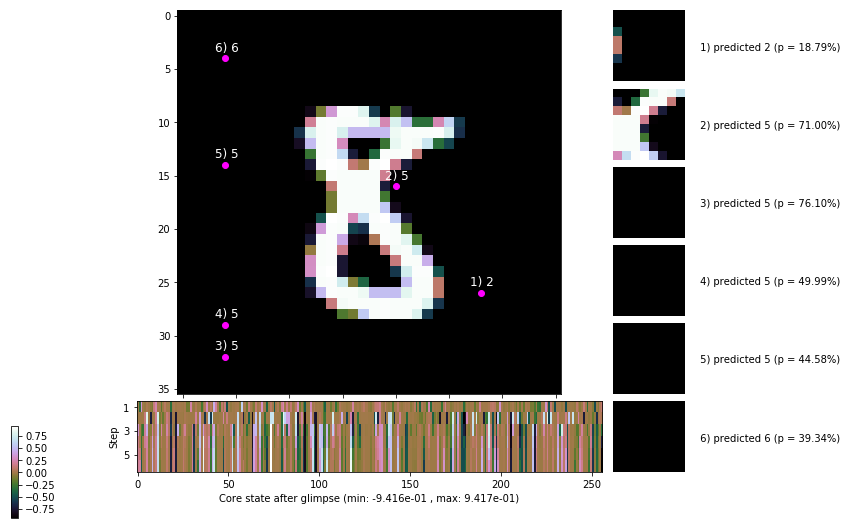

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


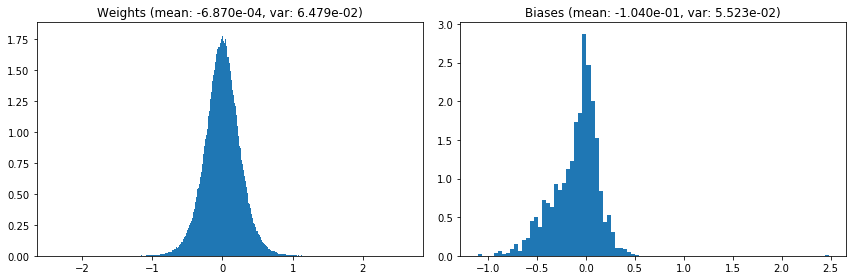

                                      Location network weights and biases


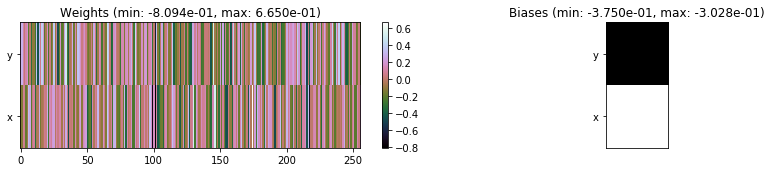

---------------------------------------------------------------------------------------------------------------
Elapsed time:  468.40 sec | TRAIN >> class loss: 0.9308 | steps:  2.970    | reward:  3.4290    | acc.: 66.942% 
                          | VAL   >> class loss: 0.8934 | steps:  2.894    | reward:  3.5324    | acc.: 68.340% 


Epoch  27/400) lr = 0.0006769
 b    300/  3000 >> 152.6 ms/b | lr: 6.76e-04 | grad 2norm: 21.00 | grad inf norm:  5.944
         Weights || abs max:  2.60 ( 2261.00) | mean: -6.74e-04 ( 0.01) | var: 6.48e-02 (  367.21)
          Biases || abs max:  2.48 (   90.79) | mean: -1.04e-01 ( 0.09) | var: 5.52e-02 (   72.85)
                    class loss: 0.935 | steps: 3.003 | reward:  3.385 | acc.: 66.10%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 152.5 ms/b | lr: 6.76e-04 | grad 2norm: 21.44 | grad inf norm:  5.922
         Weights || abs max:  2.61 ( 1517.93) | mean: -6.78e-04 ( 0.0

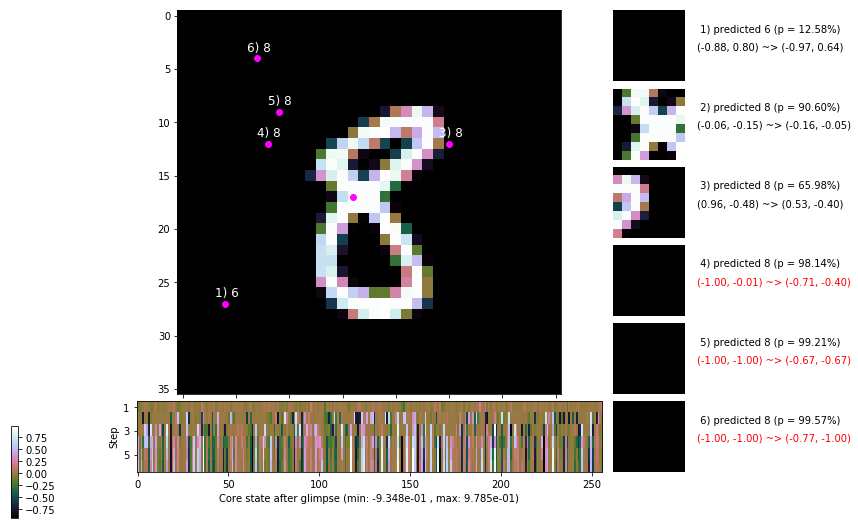

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 158.9 ms/b | lr: 6.74e-04 | grad 2norm: 21.17 | grad inf norm:  5.859
         Weights || abs max:  2.61 ( 2222.28) | mean: -6.79e-04 ( 0.01) | var: 6.51e-02 (  521.39)
          Biases || abs max:  2.48 (  200.77) | mean: -1.04e-01 ( 0.15) | var: 5.55e-02 (  714.24)
                    class loss: 0.902 | steps: 2.930 | reward:  3.460 | acc.: 67.83%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 177.9 ms/b | lr: 6.74e-04 | grad 2norm: 20.92 | grad inf norm:  5.825
         Weights || abs max:  2.61 ( 1892.13) | mean: -6.86e-04 ( 0.01) | var: 6.52e-02 (  110.54)
          Biases || abs max:  2.48 (   92.20) | mean: -1.04e-01 ( 0.08) | var: 5.55e-02 (   35.77)
                    class loss: 0.897 | steps: 2.904 | reward:  3.479 | acc.: 68.08%

	Target class: 8 | Discounted rewards: [2.786, 3.095, 3.4

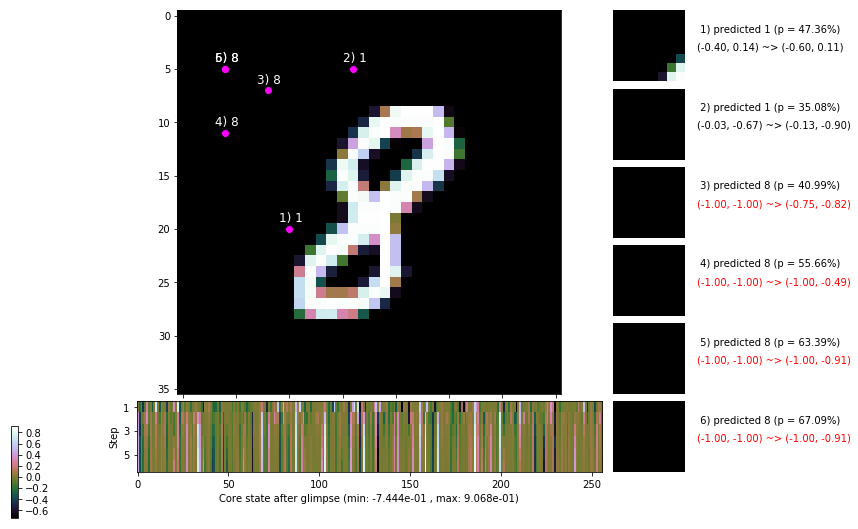

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 155.5 ms/b | lr: 6.72e-04 | grad 2norm: 21.27 | grad inf norm:  6.088
         Weights || abs max:  2.62 ( 7900.42) | mean: -6.86e-04 ( 0.02) | var: 6.53e-02 (22429.42)
          Biases || abs max:  2.49 (   81.37) | mean: -1.04e-01 ( 0.08) | var: 5.56e-02 (   14.32)
                    class loss: 0.895 | steps: 2.947 | reward:  3.460 | acc.: 68.35%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 152.5 ms/b | lr: 6.72e-04 | grad 2norm: 21.17 | grad inf norm:  5.984
         Weights || abs max:  2.62 ( 2627.38) | mean: -7.03e-04 ( 0.01) | var: 6.54e-02 (  227.91)
          Biases || abs max:  2.49 (  110.81) | mean: -1.04e-01 ( 0.10) | var: 5.55e-02 (   47.96)
                    class loss: 0.875 | steps: 2.885 | reward:  3.527 | acc.: 68.97%

	Target class: 7 | Discounted rewards: [3.686, 4.095, 3.4

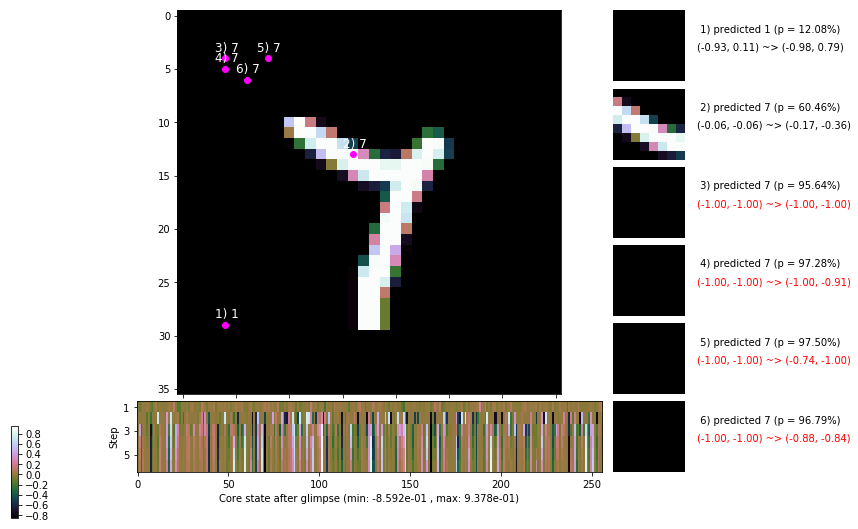

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 153.3 ms/b | lr: 6.70e-04 | grad 2norm: 21.26 | grad inf norm:  6.022
         Weights || abs max:  2.64 ( 2085.44) | mean: -7.13e-04 ( 0.01) | var: 6.55e-02 (  197.25)
          Biases || abs max:  2.50 (  100.53) | mean: -1.04e-01 ( 0.09) | var: 5.58e-02 (   72.30)
                    class loss: 0.888 | steps: 2.903 | reward:  3.484 | acc.: 68.38%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 152.4 ms/b | lr: 6.70e-04 | grad 2norm: 21.33 | grad inf norm:  6.132
         Weights || abs max:  2.63 ( 1932.99) | mean: -7.30e-04 ( 0.01) | var: 6.56e-02 (  165.01)
          Biases || abs max:  2.50 (  119.88) | mean: -1.05e-01 ( 0.10) | var: 5.59e-02 (  165.02)
                    class loss: 0.889 | steps: 2.937 | reward:  3.457 | acc.: 68.00%

	Target class: 0 | Discounted rewards: [1.590, 0.656, 0.7

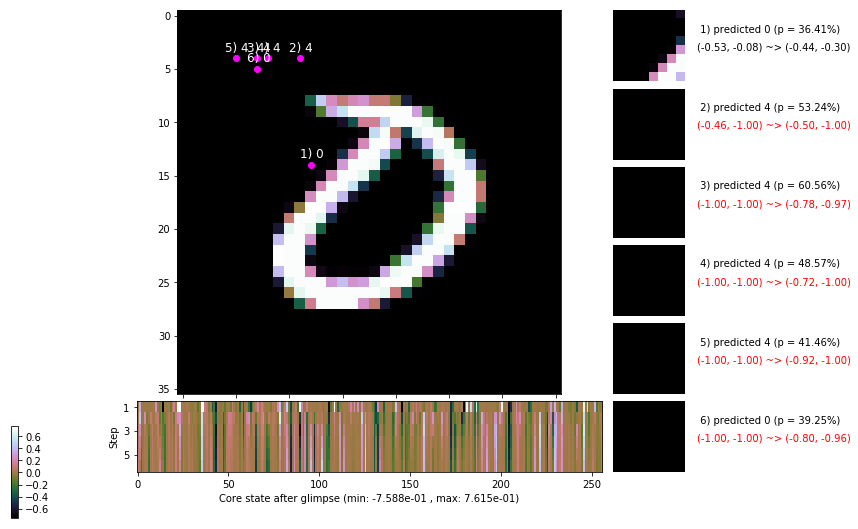

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 156.0 ms/b | lr: 6.68e-04 | grad 2norm: 21.08 | grad inf norm:  6.009
         Weights || abs max:  2.65 ( 2342.92) | mean: -7.13e-04 ( 0.01) | var: 6.58e-02 (  278.47)
          Biases || abs max:  2.50 (  202.77) | mean: -1.05e-01 ( 0.13) | var: 5.61e-02 ( 1143.48)
                    class loss: 0.903 | steps: 2.981 | reward:  3.447 | acc.: 68.10%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 151.4 ms/b | lr: 6.68e-04 | grad 2norm: 21.26 | grad inf norm:  6.215
         Weights || abs max:  2.65 ( 1362.08) | mean: -6.93e-04 ( 0.01) | var: 6.59e-02 (  101.63)
          Biases || abs max:  2.51 (   82.20) | mean: -1.05e-01 ( 0.08) | var: 5.60e-02 (   29.07)
                    class loss: 0.921 | steps: 2.990 | reward:  3.417 | acc.: 67.08%

	Target class: 6 | Discounted rewards: [3.686, 4.095, 3.4

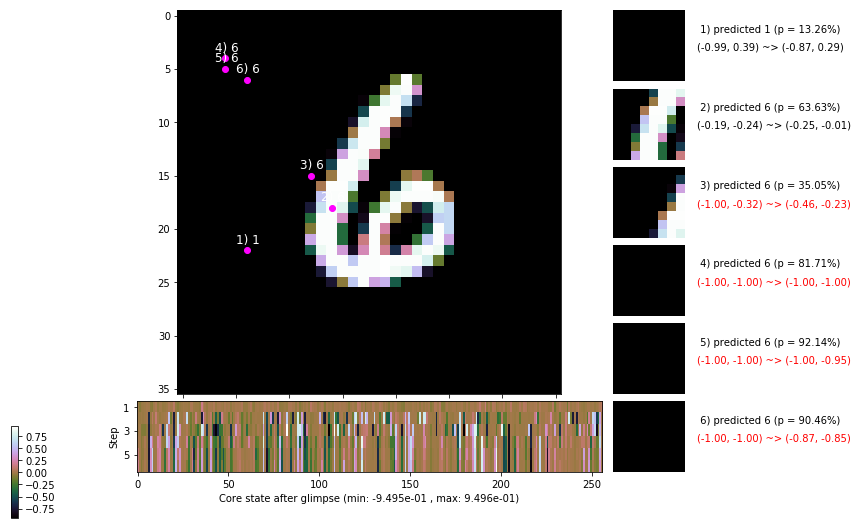

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 7 | Discounted rewards: [0.000, 0.000, 0.000, 0.000, 0.000, 0.000]


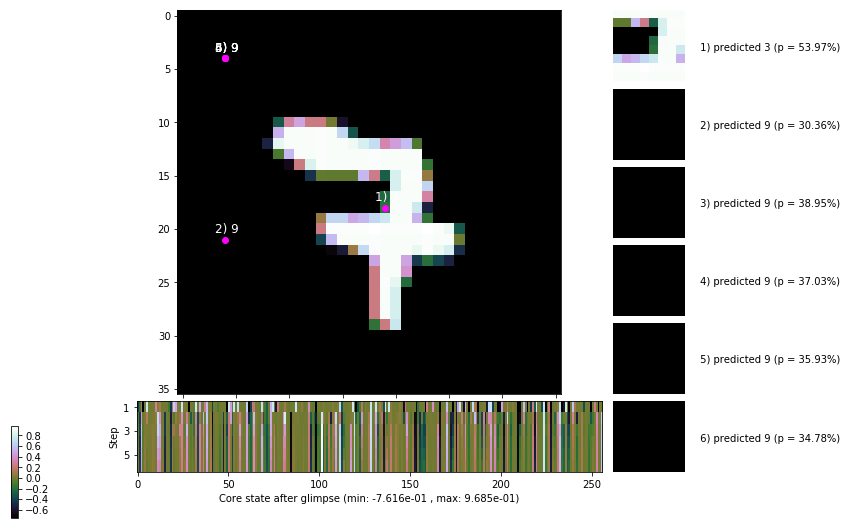


	Target class: 7 | Discounted rewards: [0.000, 0.000, 0.000, 0.000, 0.000, 0.000]


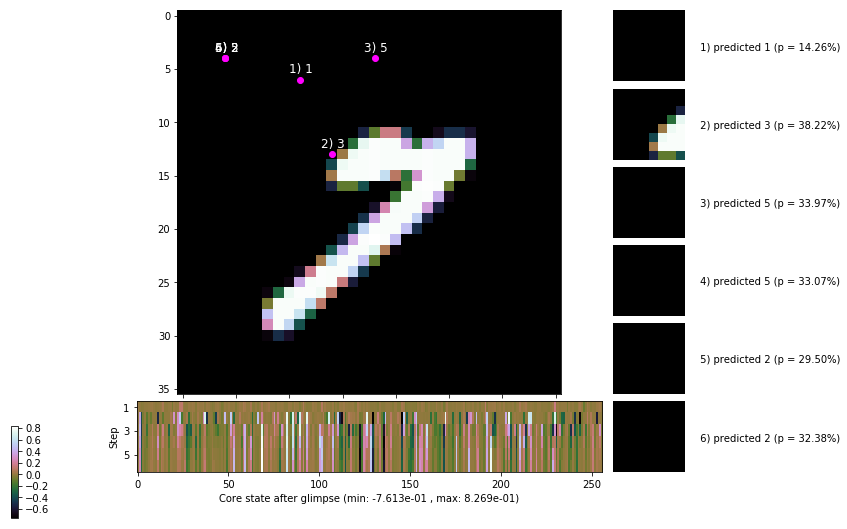

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


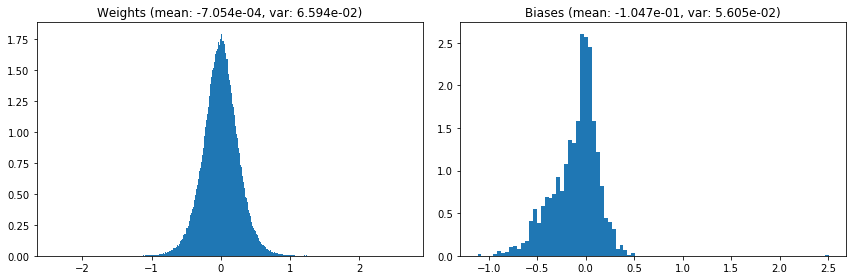

                                      Location network weights and biases


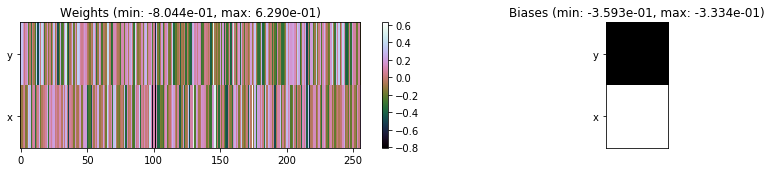

---------------------------------------------------------------------------------------------------------------
Elapsed time:  469.51 sec | TRAIN >> class loss: 0.9013 | steps:  2.943    | reward:  3.4542    | acc.: 67.862% 
                          | VAL   >> class loss: 0.8517 | steps:  2.848    | reward:  3.5940    | acc.: 69.900% 


Epoch  28/400) lr = 0.0006668
 b    300/  3000 >> 152.6 ms/b | lr: 6.66e-04 | grad 2norm: 21.16 | grad inf norm:  5.867
         Weights || abs max:  2.66 ( 8128.94) | mean: -7.06e-04 ( 0.02) | var: 6.60e-02 (25401.27)
          Biases || abs max:  2.51 (  103.34) | mean: -1.05e-01 ( 0.09) | var: 5.62e-02 (   72.10)
                    class loss: 0.894 | steps: 2.946 | reward:  3.468 | acc.: 67.92%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 151.5 ms/b | lr: 6.66e-04 | grad 2norm: 21.11 | grad inf norm:  5.945
         Weights || abs max:  2.65 ( 1268.08) | mean: -6.96e-04 ( 0.0

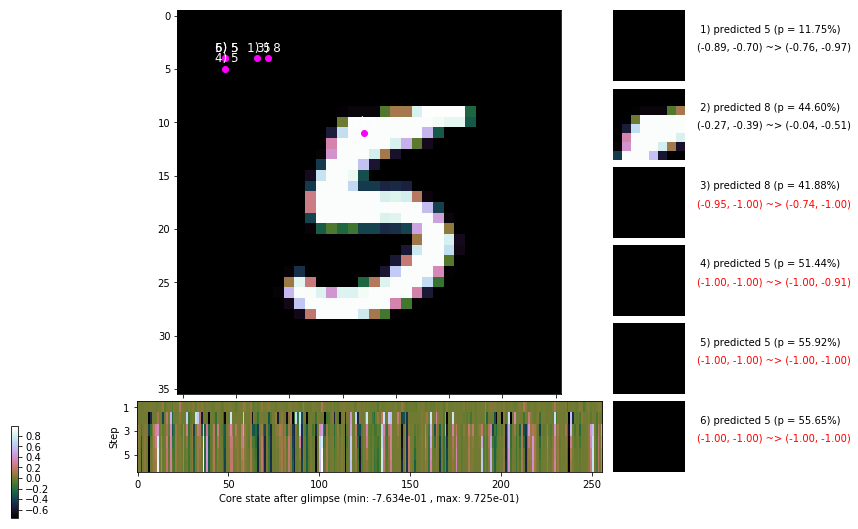

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 154.0 ms/b | lr: 6.64e-04 | grad 2norm: 21.16 | grad inf norm:  6.163
         Weights || abs max:  2.65 ( 1340.60) | mean: -6.74e-04 ( 0.01) | var: 6.62e-02 (   49.36)
          Biases || abs max:  2.51 (   44.71) | mean: -1.05e-01 ( 0.06) | var: 5.62e-02 (    7.41)
                    class loss: 0.922 | steps: 2.988 | reward:  3.401 | acc.: 66.75%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 153.0 ms/b | lr: 6.64e-04 | grad 2norm: 20.85 | grad inf norm:  5.799
         Weights || abs max:  2.67 ( 1604.98) | mean: -6.56e-04 ( 0.01) | var: 6.63e-02 (   88.12)
          Biases || abs max:  2.51 (   47.14) | mean: -1.05e-01 ( 0.06) | var: 5.64e-02 (    6.29)
                    class loss: 0.933 | steps: 2.978 | reward:  3.406 | acc.: 66.47%

	Target class: 6 | Discounted rewards: [3.686, 4.095, 3.4

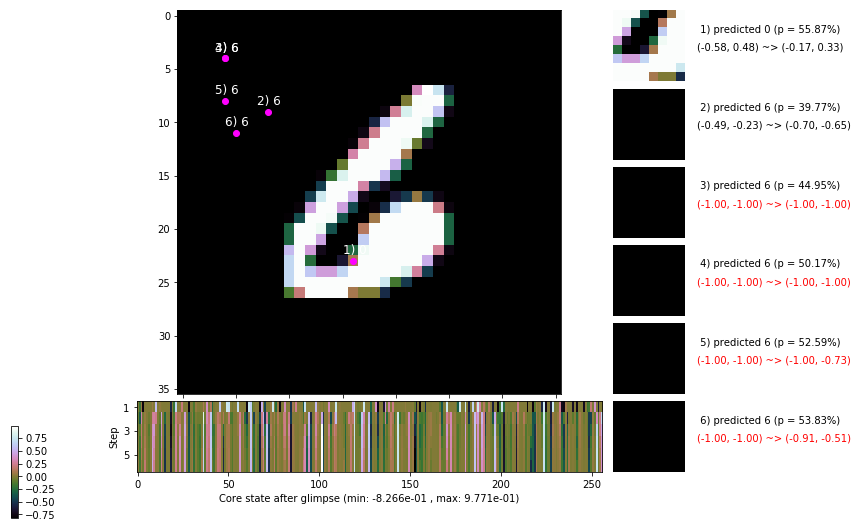

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 152.7 ms/b | lr: 6.62e-04 | grad 2norm: 21.07 | grad inf norm:  6.050
         Weights || abs max:  2.68 ( 3876.90) | mean: -6.46e-04 ( 0.01) | var: 6.64e-02 ( 1531.65)
          Biases || abs max:  2.51 (   83.81) | mean: -1.05e-01 ( 0.08) | var: 5.65e-02 (   28.05)
                    class loss: 0.920 | steps: 2.943 | reward:  3.441 | acc.: 67.43%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 166.9 ms/b | lr: 6.62e-04 | grad 2norm: 20.77 | grad inf norm:  5.783
         Weights || abs max:  2.69 (  754.03) | mean: -6.77e-04 ( 0.01) | var: 6.65e-02 (    7.24)
          Biases || abs max:  2.51 (   95.90) | mean: -1.06e-01 ( 0.10) | var: 5.66e-02 (  401.71)
                    class loss: 0.934 | steps: 2.977 | reward:  3.415 | acc.: 66.68%

	Target class: 5 | Discounted rewards: [0.000, 0.000, 0.0

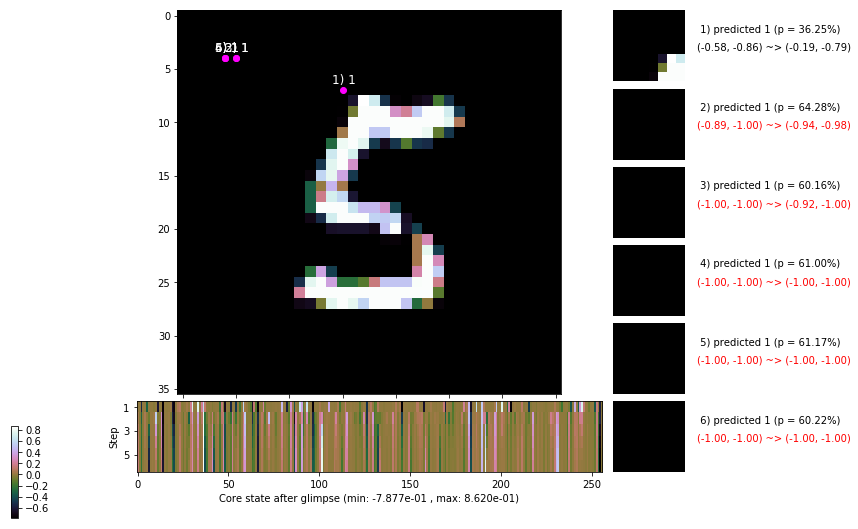

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 170.5 ms/b | lr: 6.60e-04 | grad 2norm: 20.91 | grad inf norm:  6.045
         Weights || abs max:  2.68 ( 1132.36) | mean: -6.79e-04 ( 0.01) | var: 6.67e-02 (   11.66)
          Biases || abs max:  2.52 (  692.05) | mean: -1.05e-01 ( 0.33) | var: 5.68e-02 (38539.98)
                    class loss: 0.909 | steps: 2.945 | reward:  3.469 | acc.: 67.87%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 151.6 ms/b | lr: 6.60e-04 | grad 2norm: 20.74 | grad inf norm:  5.882
         Weights || abs max:  2.70 ( 1858.23) | mean: -6.64e-04 ( 0.01) | var: 6.68e-02 (  372.29)
          Biases || abs max:  2.52 (  154.48) | mean: -1.05e-01 ( 0.11) | var: 5.69e-02 (  332.76)
                    class loss: 0.937 | steps: 3.010 | reward:  3.382 | acc.: 66.25%

	Target class: 4 | Discounted rewards: [0.000, 0.000, 0.0

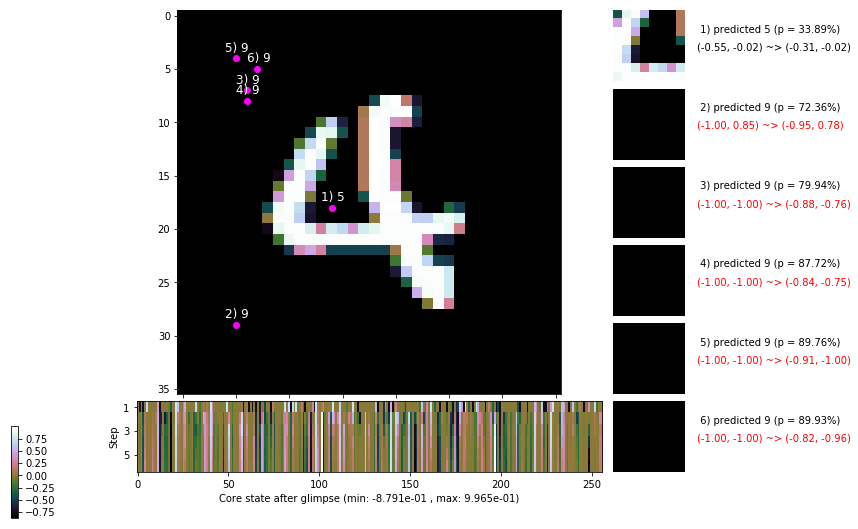

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 155.7 ms/b | lr: 6.58e-04 | grad 2norm: 20.77 | grad inf norm:  6.060
         Weights || abs max:  2.69 ( 1002.33) | mean: -6.57e-04 ( 0.01) | var: 6.69e-02 (   18.62)
          Biases || abs max:  2.51 (  298.08) | mean: -1.06e-01 ( 0.20) | var: 5.71e-02 ( 3513.74)
                    class loss: 0.902 | steps: 2.945 | reward:  3.477 | acc.: 68.30%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 150.2 ms/b | lr: 6.58e-04 | grad 2norm: 20.90 | grad inf norm:  6.189
         Weights || abs max:  2.70 ( 2071.83) | mean: -6.57e-04 ( 0.01) | var: 6.70e-02 (  679.00)
          Biases || abs max:  2.52 (  111.29) | mean: -1.06e-01 ( 0.10) | var: 5.74e-02 (   35.28)
                    class loss: 0.939 | steps: 2.994 | reward:  3.400 | acc.: 66.32%

	Target class: 7 | Discounted rewards: [4.686, 4.095, 3.4

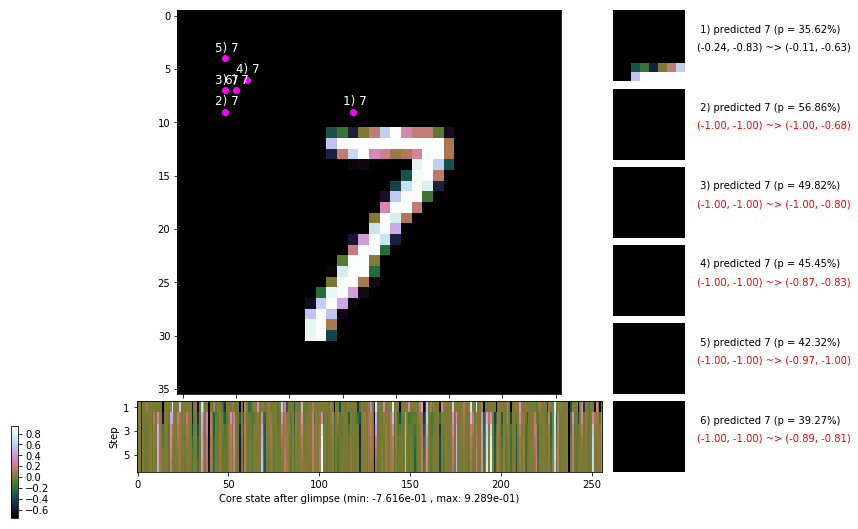

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 9 | Discounted rewards: [3.686, 4.095, 3.439, 2.710, 1.900, 1.000]


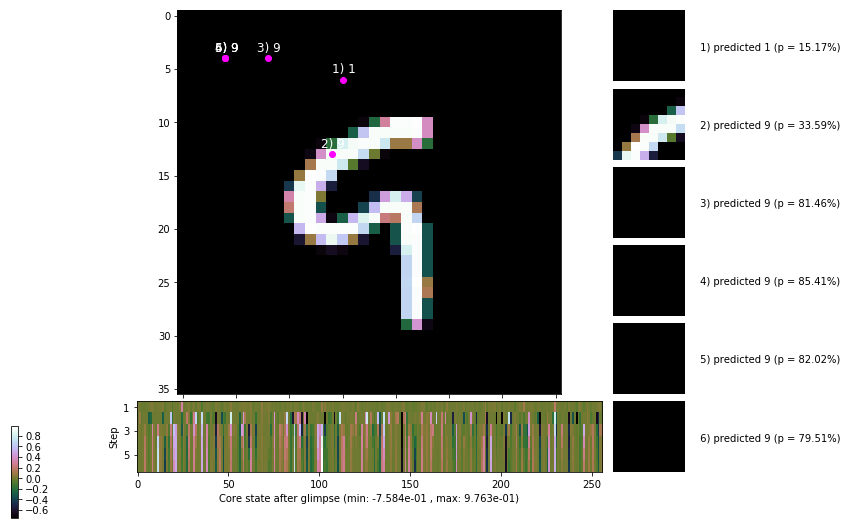


	Target class: 7 | Discounted rewards: [2.786, 3.095, 3.439, 2.710, 1.900, 1.000]


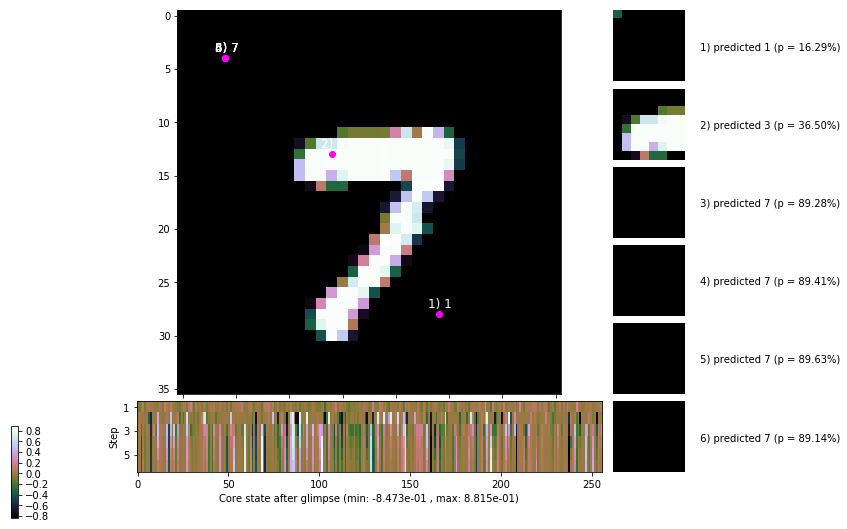

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


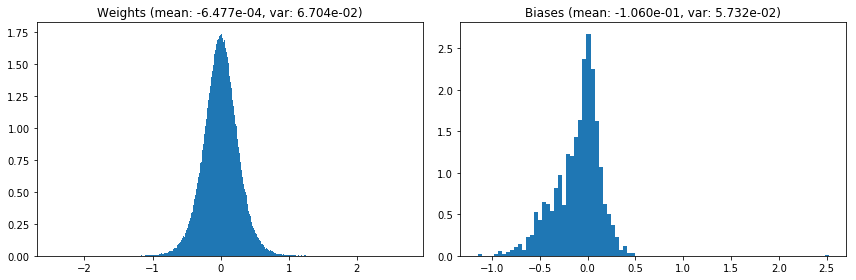

                                      Location network weights and biases


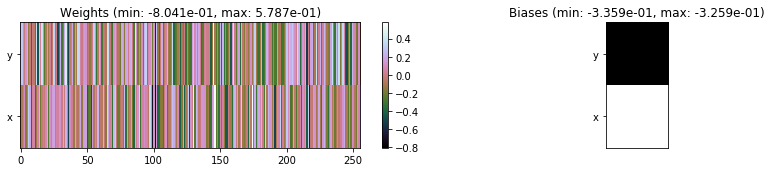

---------------------------------------------------------------------------------------------------------------
Elapsed time:  468.33 sec | TRAIN >> class loss: 0.9190 | steps:  2.968 :( | reward:  3.4270 :( | acc.: 67.102% :(
                          | VAL   >> class loss: 0.8656 | steps:  2.843    | reward:  3.5808 :( | acc.: 69.260% :(


Epoch  29/400) lr = 0.0006569
 b    300/  3000 >> 154.2 ms/b | lr: 6.56e-04 | grad 2norm: 20.68 | grad inf norm:  5.964
         Weights || abs max:  2.71 ( 1222.12) | mean: -6.26e-04 ( 0.01) | var: 6.71e-02 (   39.75)
          Biases || abs max:  2.52 (   59.06) | mean: -1.06e-01 ( 0.07) | var: 5.73e-02 (   17.33)
                    class loss: 0.883 | steps: 2.917 | reward:  3.491 | acc.: 68.75%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 153.8 ms/b | lr: 6.56e-04 | grad 2norm: 21.20 | grad inf norm:  6.083
         Weights || abs max:  2.72 ( 2993.68) | mean: -6.28e-04 (

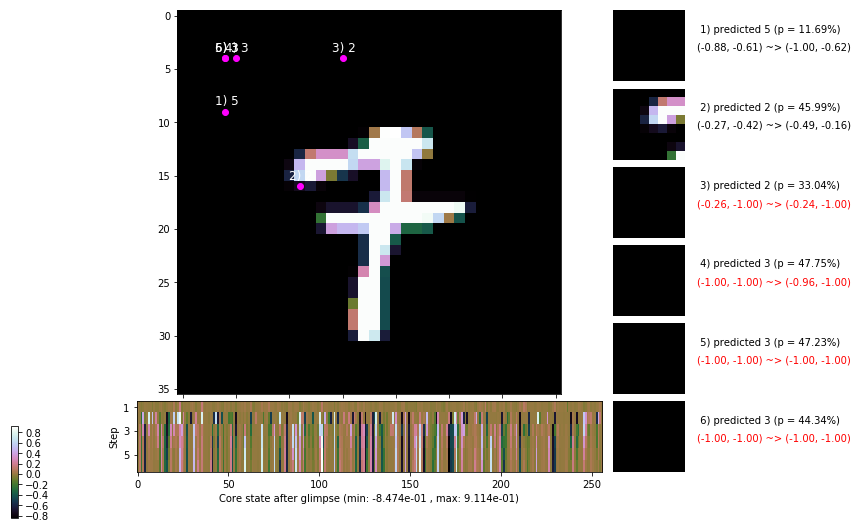

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 154.4 ms/b | lr: 6.54e-04 | grad 2norm: 21.10 | grad inf norm:  6.369
         Weights || abs max:  2.73 ( 1742.03) | mean: -6.48e-04 ( 0.01) | var: 6.73e-02 (   75.15)
          Biases || abs max:  2.52 (  168.03) | mean: -1.06e-01 ( 0.13) | var: 5.74e-02 (  425.39)
                    class loss: 0.897 | steps: 2.947 | reward:  3.458 | acc.: 68.05%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 152.9 ms/b | lr: 6.54e-04 | grad 2norm: 21.31 | grad inf norm:  6.118
         Weights || abs max:  2.74 ( 1880.02) | mean: -6.25e-04 ( 0.01) | var: 6.74e-02 (  191.27)
          Biases || abs max:  2.52 (  223.39) | mean: -1.06e-01 ( 0.14) | var: 5.74e-02 ( 2073.82)
                    class loss: 0.905 | steps: 2.960 | reward:  3.451 | acc.: 67.93%

	Target class: 6 | Discounted rewards: [3.686, 4.095, 3.4

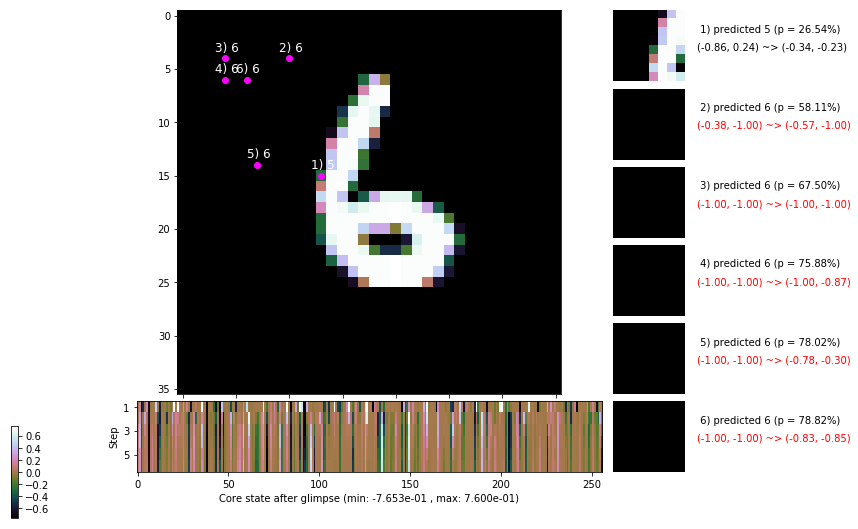

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 155.0 ms/b | lr: 6.52e-04 | grad 2norm: 20.96 | grad inf norm:  5.838
         Weights || abs max:  2.74 ( 1114.85) | mean: -5.93e-04 ( 0.01) | var: 6.75e-02 (   17.84)
          Biases || abs max:  2.53 (  115.22) | mean: -1.06e-01 ( 0.11) | var: 5.74e-02 (  133.42)
                    class loss: 0.878 | steps: 2.918 | reward:  3.497 | acc.: 68.87%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 152.8 ms/b | lr: 6.52e-04 | grad 2norm: 20.98 | grad inf norm:  5.941
         Weights || abs max:  2.75 ( 1620.88) | mean: -5.92e-04 ( 0.01) | var: 6.76e-02 (  111.23)
          Biases || abs max:  2.54 (  287.02) | mean: -1.07e-01 ( 0.18) | var: 5.77e-02 ( 1406.39)
                    class loss: 0.891 | steps: 2.931 | reward:  3.488 | acc.: 68.30%

	Target class: 0 | Discounted rewards: [0.000, 0.000, 0.0

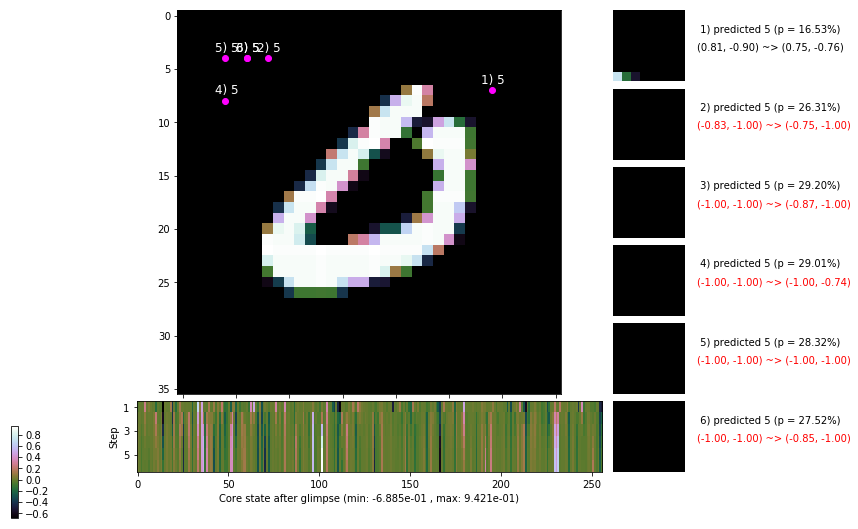

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 154.0 ms/b | lr: 6.50e-04 | grad 2norm: 20.74 | grad inf norm:  6.027
         Weights || abs max:  2.76 ( 1101.19) | mean: -5.84e-04 ( 0.01) | var: 6.77e-02 (   39.53)
          Biases || abs max:  2.54 (  694.64) | mean: -1.06e-01 ( 0.34) | var: 5.81e-02 (43230.57)
                    class loss: 0.936 | steps: 2.998 | reward:  3.412 | acc.: 66.85%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 150.1 ms/b | lr: 6.50e-04 | grad 2norm: 20.81 | grad inf norm:  6.094
         Weights || abs max:  2.76 ( 1000.77) | mean: -5.54e-04 ( 0.01) | var: 6.79e-02 (   20.97)
          Biases || abs max:  2.53 (  269.44) | mean: -1.07e-01 ( 0.16) | var: 5.82e-02 ( 3586.65)
                    class loss: 0.938 | steps: 2.957 | reward:  3.417 | acc.: 66.48%

	Target class: 3 | Discounted rewards: [3.686, 4.095, 3.4

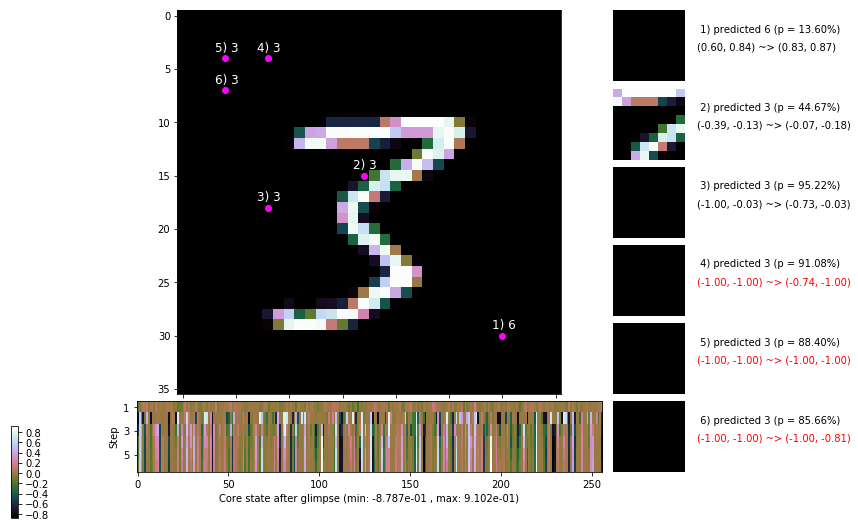

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 164.5 ms/b | lr: 6.48e-04 | grad 2norm: 20.85 | grad inf norm:  6.108
         Weights || abs max:  2.77 ( 1358.81) | mean: -5.79e-04 ( 0.01) | var: 6.80e-02 (   35.67)
          Biases || abs max:  2.53 (  103.05) | mean: -1.07e-01 ( 0.10) | var: 5.83e-02 (   92.11)
                    class loss: 0.941 | steps: 3.011 | reward:  3.394 | acc.: 67.28%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 170.9 ms/b | lr: 6.48e-04 | grad 2norm: 20.72 | grad inf norm:  5.961
         Weights || abs max:  2.78 ( 1966.01) | mean: -6.25e-04 ( 0.01) | var: 6.81e-02 (  242.33)
          Biases || abs max:  2.52 (  289.17) | mean: -1.07e-01 ( 0.17) | var: 5.86e-02 ( 1692.65)
                    class loss: 0.918 | steps: 2.951 | reward:  3.448 | acc.: 67.58%

	Target class: 9 | Discounted rewards: [2.786, 3.095, 3.4

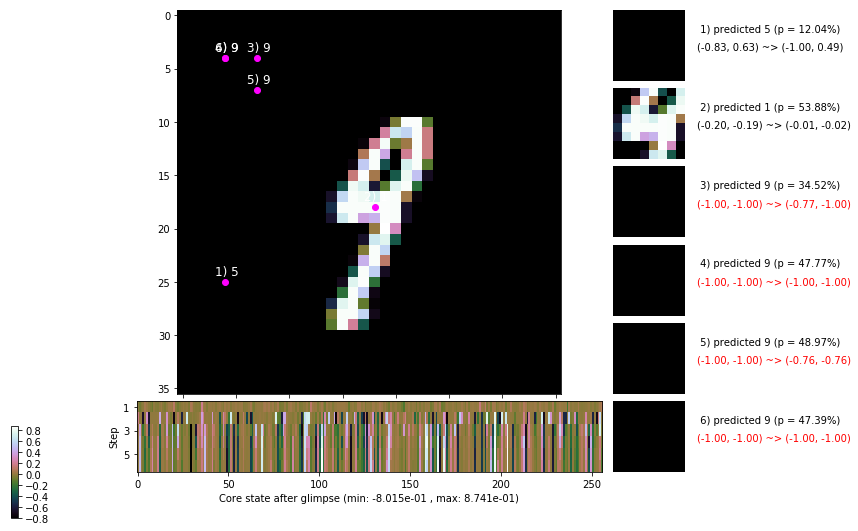

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 4 | Discounted rewards: [2.786, 3.095, 3.439, 2.710, 1.900, 1.000]


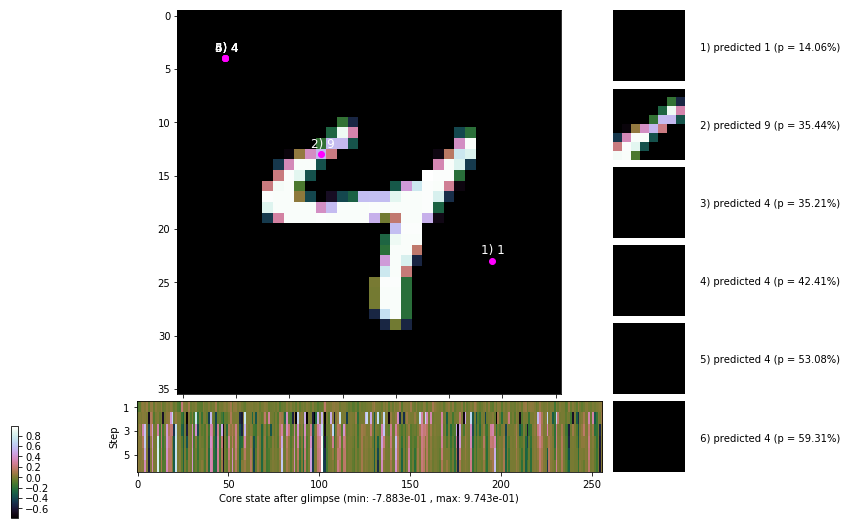


	Target class: 8 | Discounted rewards: [4.686, 4.095, 3.439, 2.710, 1.900, 1.000]


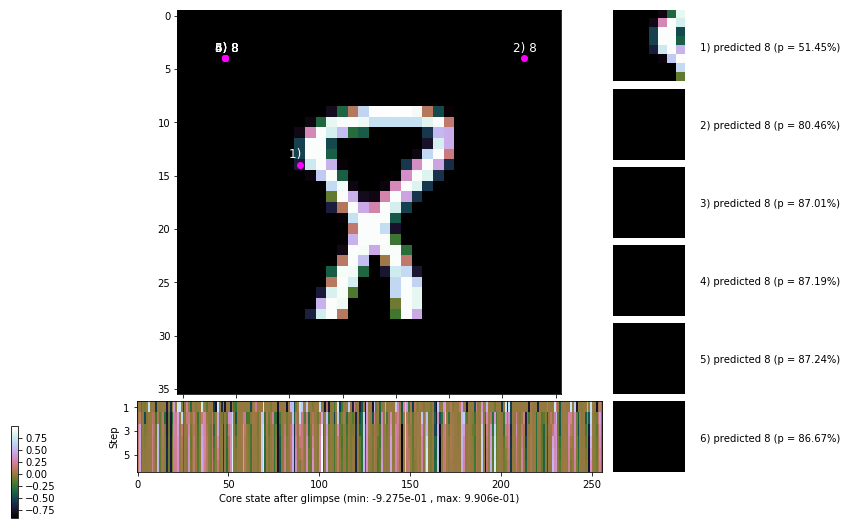

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


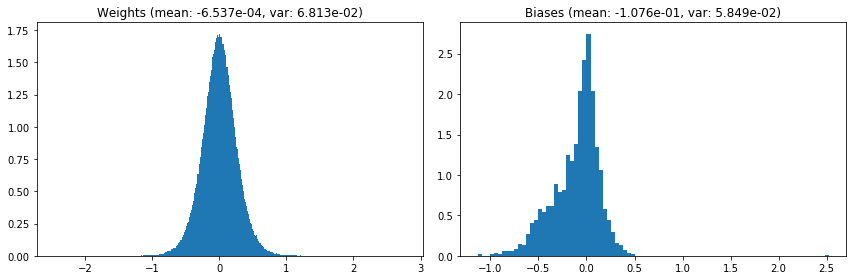

                                      Location network weights and biases


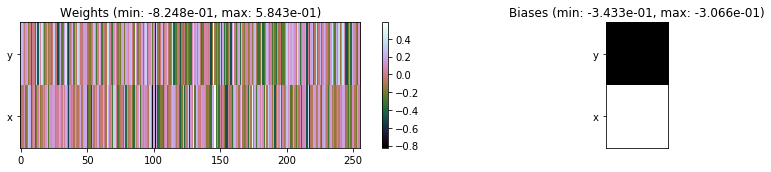

---------------------------------------------------------------------------------------------------------------
Elapsed time:  469.48 sec | TRAIN >> class loss: 0.9117 | steps:  2.956 :( | reward:  3.4472 :( | acc.: 67.708% :(
                          | VAL   >> class loss: 0.8687 | steps:  2.850 :( | reward:  3.5456 :( | acc.: 68.440% :(


Epoch  30/400) lr = 0.0006471
 b    300/  3000 >> 154.5 ms/b | lr: 6.46e-04 | grad 2norm: 20.67 | grad inf norm:  6.051
         Weights || abs max:  2.77 (16163.86) | mean: -6.47e-04 ( 0.03) | var: 6.82e-02 (121179.80)
          Biases || abs max:  2.52 (  259.16) | mean: -1.07e-01 ( 0.16) | var: 5.85e-02 ( 1600.55)
                    class loss: 0.913 | steps: 2.941 | reward:  3.458 | acc.: 68.12%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 151.5 ms/b | lr: 6.46e-04 | grad 2norm: 20.59 | grad inf norm:  5.699
         Weights || abs max:  2.77 ( 1964.26) | mean: -6.37e-04 

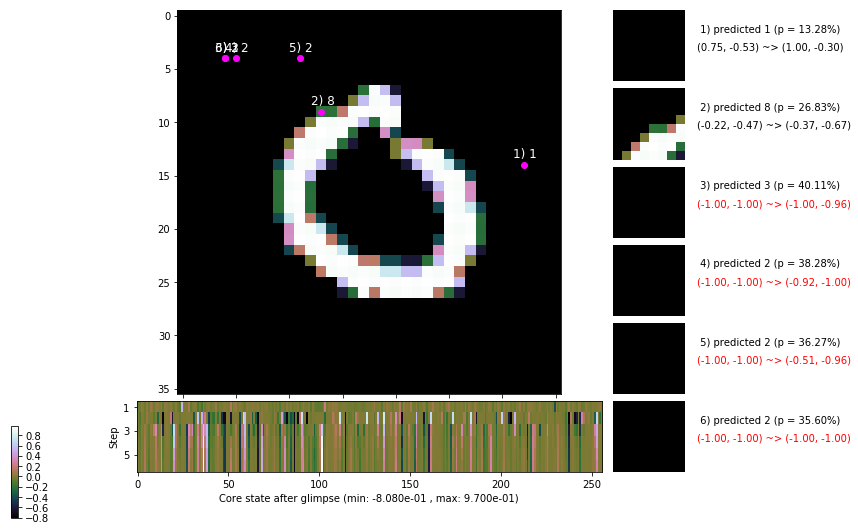

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 155.2 ms/b | lr: 6.45e-04 | grad 2norm: 20.75 | grad inf norm:  5.930
         Weights || abs max:  2.78 ( 1211.83) | mean: -6.20e-04 ( 0.01) | var: 6.84e-02 (   18.60)
          Biases || abs max:  2.51 (  160.48) | mean: -1.08e-01 ( 0.15) | var: 5.86e-02 (  683.96)
                    class loss: 0.890 | steps: 2.921 | reward:  3.487 | acc.: 68.08%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 152.4 ms/b | lr: 6.44e-04 | grad 2norm: 20.85 | grad inf norm:  6.246
         Weights || abs max:  2.78 ( 1637.29) | mean: -5.98e-04 ( 0.01) | var: 6.85e-02 (  187.18)
          Biases || abs max:  2.52 (   85.85) | mean: -1.07e-01 ( 0.08) | var: 5.87e-02 (   37.77)
                    class loss: 0.923 | steps: 2.956 | reward:  3.439 | acc.: 67.05%

	Target class: 0 | Discounted rewards: [2.786, 3.095, 3.4

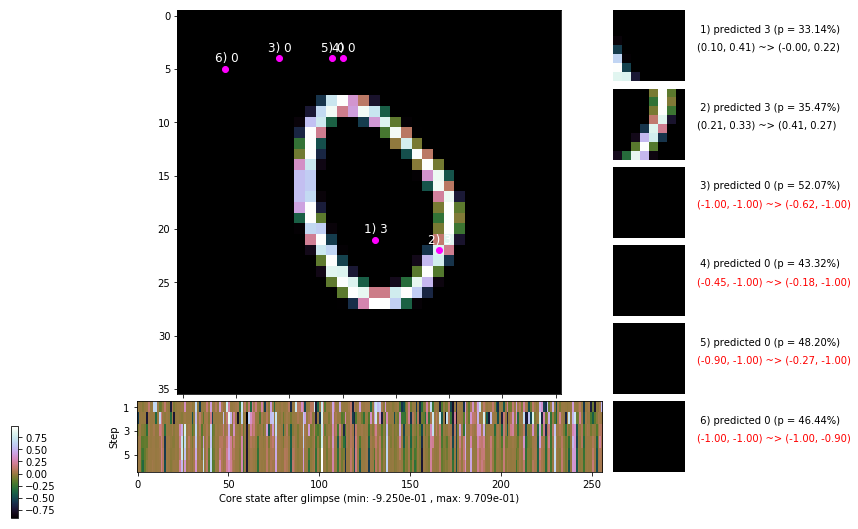

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 153.2 ms/b | lr: 6.43e-04 | grad 2norm: 20.82 | grad inf norm:  5.971
         Weights || abs max:  2.79 ( 1571.41) | mean: -5.85e-04 ( 0.01) | var: 6.86e-02 (  173.57)
          Biases || abs max:  2.52 (  119.24) | mean: -1.07e-01 ( 0.10) | var: 5.86e-02 (  117.40)
                    class loss: 0.903 | steps: 2.948 | reward:  3.461 | acc.: 67.50%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 152.1 ms/b | lr: 6.42e-04 | grad 2norm: 20.75 | grad inf norm:  5.742
         Weights || abs max:  2.79 ( 1538.23) | mean: -5.78e-04 ( 0.01) | var: 6.87e-02 (   80.85)
          Biases || abs max:  2.52 (   84.16) | mean: -1.08e-01 ( 0.09) | var: 5.88e-02 (   25.85)
                    class loss: 0.916 | steps: 2.982 | reward:  3.433 | acc.: 67.17%

	Target class: 9 | Discounted rewards: [2.057, 2.285, 2.5

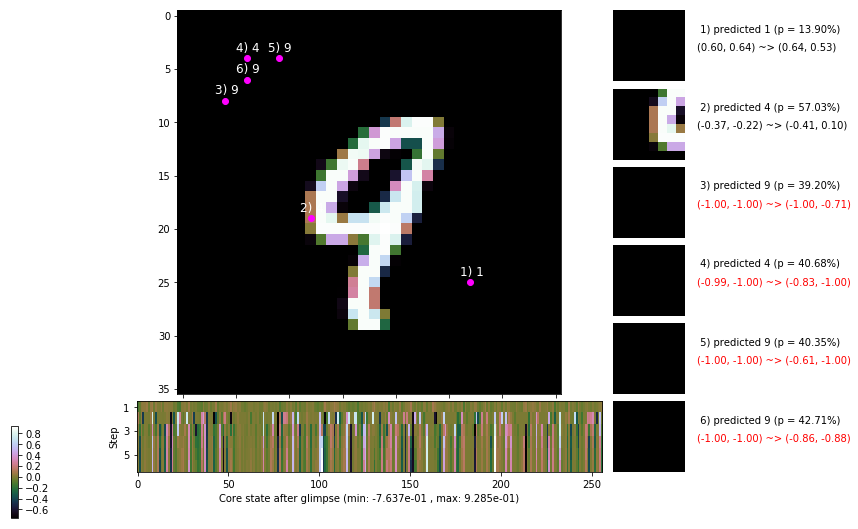

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 154.5 ms/b | lr: 6.41e-04 | grad 2norm: 20.63 | grad inf norm:  6.106
         Weights || abs max:  2.80 ( 2380.47) | mean: -5.67e-04 ( 0.01) | var: 6.88e-02 (  145.47)
          Biases || abs max:  2.52 (  143.41) | mean: -1.08e-01 ( 0.10) | var: 5.89e-02 (  979.32)
                    class loss: 0.906 | steps: 2.936 | reward:  3.469 | acc.: 67.90%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 152.4 ms/b | lr: 6.40e-04 | grad 2norm: 20.55 | grad inf norm:  5.941
         Weights || abs max:  2.81 ( 3141.97) | mean: -5.58e-04 ( 0.01) | var: 6.89e-02 (  431.30)
          Biases || abs max:  2.53 (   77.97) | mean: -1.08e-01 ( 0.08) | var: 5.88e-02 (   22.60)
                    class loss: 0.884 | steps: 2.903 | reward:  3.495 | acc.: 68.70%

	Target class: 1 | Discounted rewards: [2.786, 3.095, 3.4

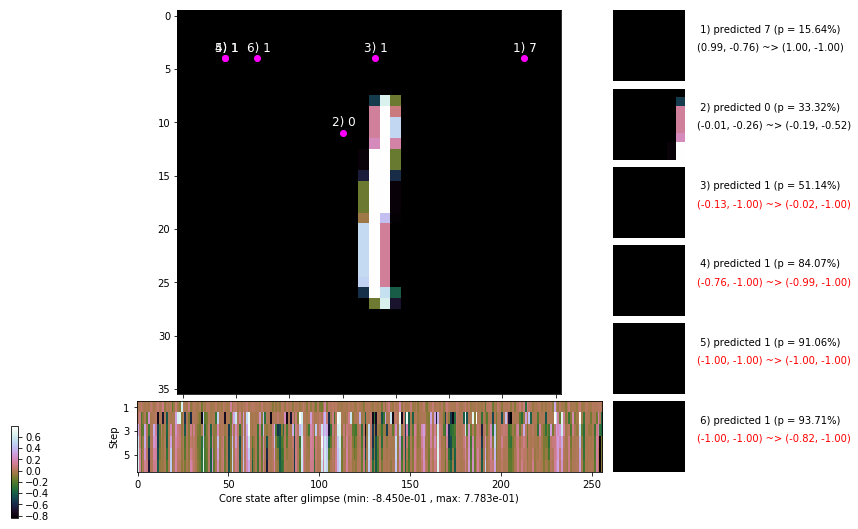

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 155.3 ms/b | lr: 6.39e-04 | grad 2norm: 20.43 | grad inf norm:  5.950
         Weights || abs max:  2.82 ( 2471.20) | mean: -5.70e-04 ( 0.01) | var: 6.90e-02 (  184.25)
          Biases || abs max:  2.53 (  175.78) | mean: -1.08e-01 ( 0.14) | var: 5.88e-02 (  379.37)
                    class loss: 0.878 | steps: 2.924 | reward:  3.495 | acc.: 68.73%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 151.6 ms/b | lr: 6.38e-04 | grad 2norm: 20.64 | grad inf norm:  5.878
         Weights || abs max:  2.83 ( 1908.88) | mean: -5.90e-04 ( 0.01) | var: 6.91e-02 (  201.29)
          Biases || abs max:  2.53 (   86.30) | mean: -1.09e-01 ( 0.08) | var: 5.90e-02 (   38.82)
                    class loss: 0.922 | steps: 2.986 | reward:  3.434 | acc.: 67.57%

	Target class: 4 | Discounted rewards: [4.686, 4.095, 3.4

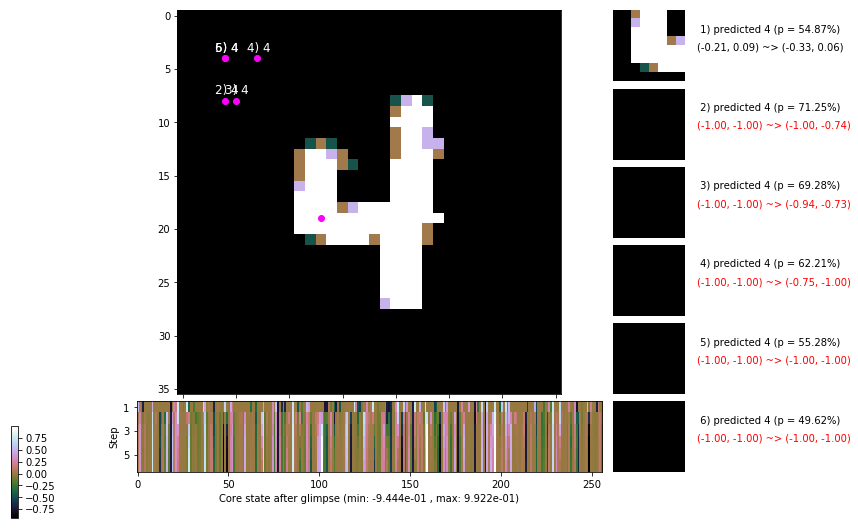

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 9 | Discounted rewards: [0.000, 0.000, 0.000, 0.000, 0.000, 0.000]


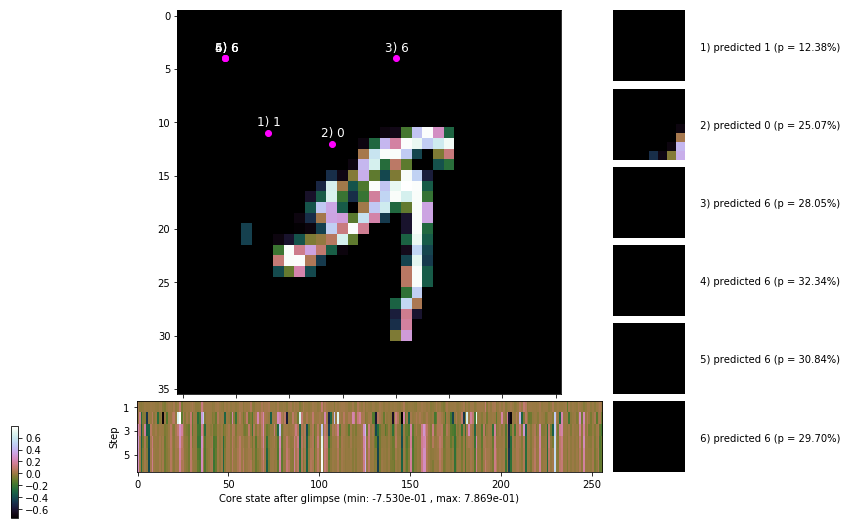


	Target class: 5 | Discounted rewards: [3.686, 4.095, 3.439, 2.710, 1.900, 1.000]


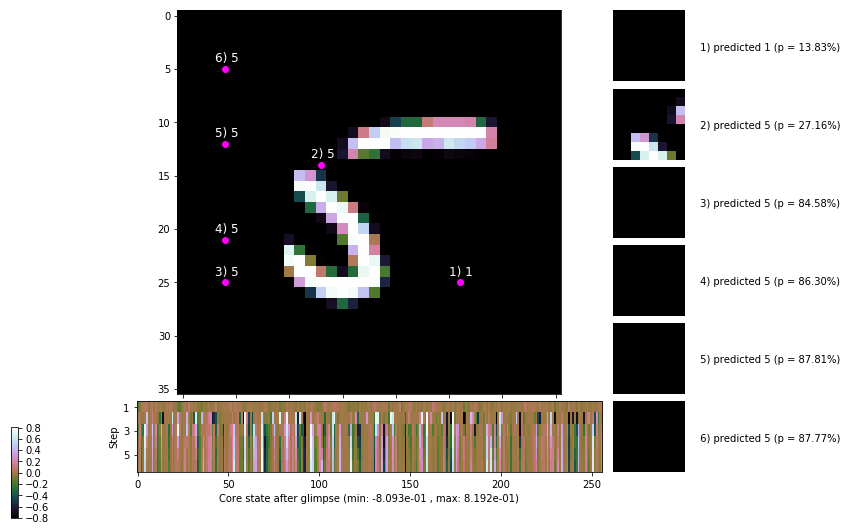

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


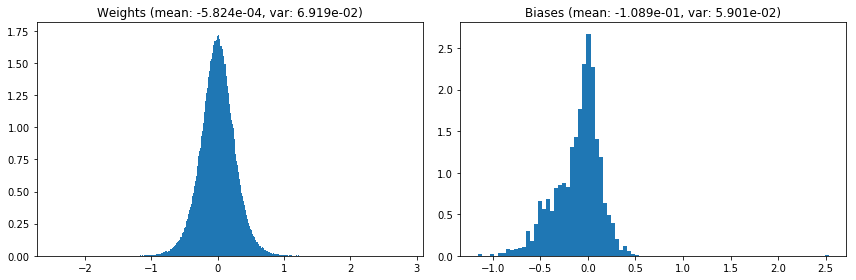

                                      Location network weights and biases


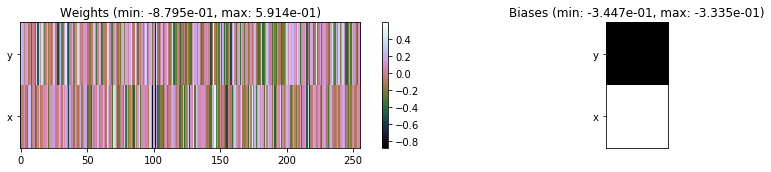

---------------------------------------------------------------------------------------------------------------
Elapsed time:  460.49 sec | TRAIN >> class loss: 0.9036 | steps:  2.943    | reward:  3.4614    | acc.: 67.872% 
                          | VAL   >> class loss: 0.8663 | steps:  2.824    | reward:  3.5998    | acc.: 69.200% :(


Epoch  31/400) lr = 0.0006375
 b    300/  3000 >> 155.6 ms/b | lr: 6.37e-04 | grad 2norm: 20.37 | grad inf norm:  5.796
         Weights || abs max:  2.83 ( 3652.69) | mean: -5.87e-04 ( 0.01) | var: 6.92e-02 ( 2488.10)
          Biases || abs max:  2.53 (   59.30) | mean: -1.09e-01 ( 0.06) | var: 5.90e-02 (   37.50)
                    class loss: 0.913 | steps: 2.922 | reward:  3.472 | acc.: 67.47%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 168.8 ms/b | lr: 6.36e-04 | grad 2norm: 20.87 | grad inf norm:  6.022
         Weights || abs max:  2.83 ( 1711.02) | mean: -5.62e-04 ( 0

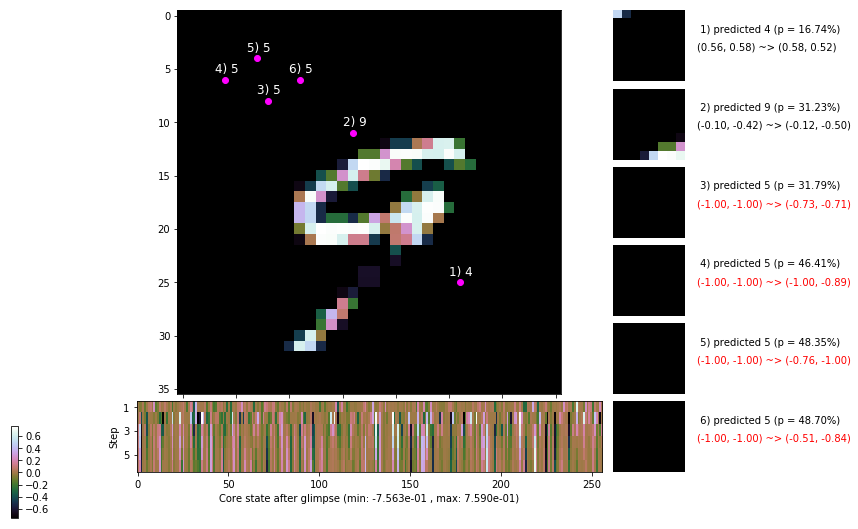

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 160.9 ms/b | lr: 6.35e-04 | grad 2norm: 20.51 | grad inf norm:  5.825
         Weights || abs max:  2.83 ( 1367.19) | mean: -5.40e-04 ( 0.01) | var: 6.94e-02 (   21.93)
          Biases || abs max:  2.53 (  107.79) | mean: -1.09e-01 ( 0.09) | var: 5.90e-02 (  115.03)
                    class loss: 0.902 | steps: 2.956 | reward:  3.447 | acc.: 67.67%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 160.9 ms/b | lr: 6.34e-04 | grad 2norm: 20.78 | grad inf norm:  6.005
         Weights || abs max:  2.84 ( 1436.15) | mean: -5.45e-04 ( 0.01) | var: 6.95e-02 (   26.22)
          Biases || abs max:  2.53 (  579.94) | mean: -1.09e-01 ( 0.28) | var: 5.92e-02 (21189.72)
                    class loss: 0.873 | steps: 2.917 | reward:  3.514 | acc.: 69.18%

	Target class: 5 | Discounted rewards: [4.686, 4.095, 3.4

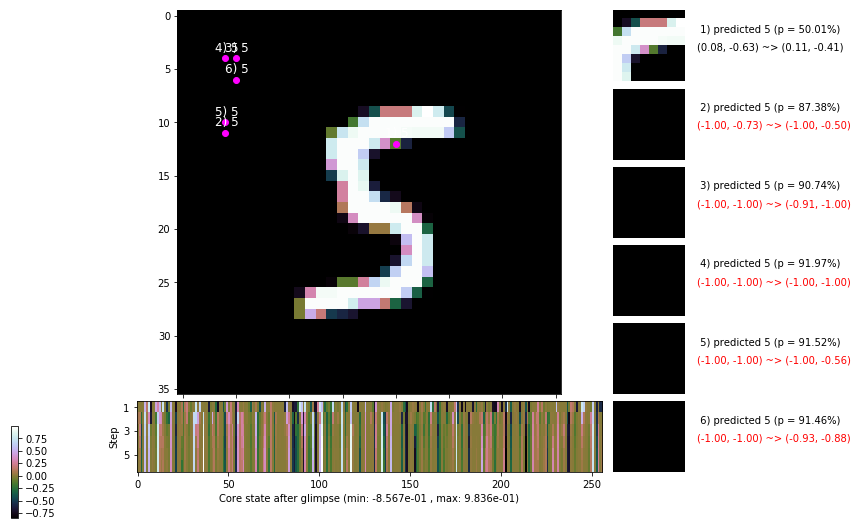

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 154.7 ms/b | lr: 6.33e-04 | grad 2norm: 20.92 | grad inf norm:  6.133
         Weights || abs max:  2.85 ( 1904.31) | mean: -5.53e-04 ( 0.01) | var: 6.96e-02 (  567.30)
          Biases || abs max:  2.54 (   98.08) | mean: -1.09e-01 ( 0.09) | var: 5.94e-02 (   71.70)
                    class loss: 0.910 | steps: 2.952 | reward:  3.474 | acc.: 68.12%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 154.4 ms/b | lr: 6.32e-04 | grad 2norm: 20.81 | grad inf norm:  5.888
         Weights || abs max:  2.86 (15583.83) | mean: -5.62e-04 ( 0.03) | var: 6.98e-02 (104593.06)
          Biases || abs max:  2.54 (  239.56) | mean: -1.09e-01 ( 0.14) | var: 5.93e-02 ( 2101.88)
                    class loss: 0.896 | steps: 2.932 | reward:  3.496 | acc.: 68.15%

	Target class: 1 | Discounted rewards: [3.686, 4.095, 3.

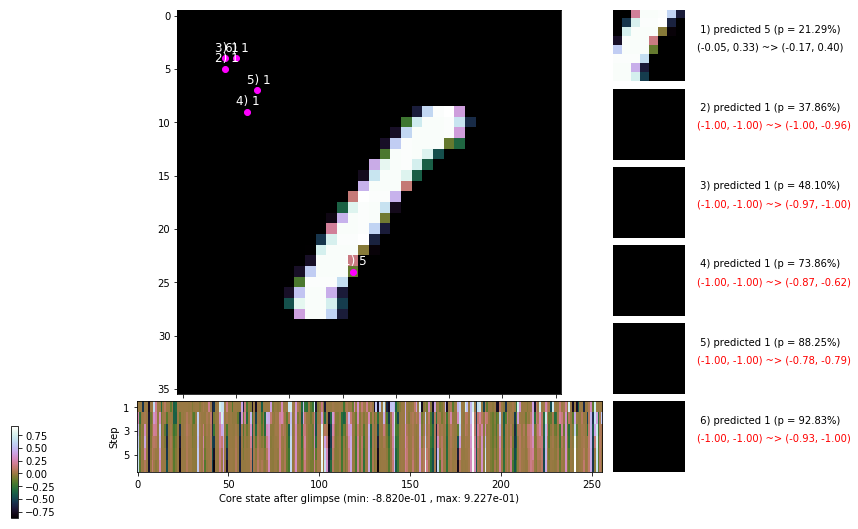

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 154.5 ms/b | lr: 6.31e-04 | grad 2norm: 20.74 | grad inf norm:  6.165
         Weights || abs max:  2.86 ( 2410.39) | mean: -5.37e-04 ( 0.01) | var: 6.99e-02 (  466.39)
          Biases || abs max:  2.54 (   90.51) | mean: -1.09e-01 ( 0.09) | var: 5.93e-02 (   57.19)
                    class loss: 0.905 | steps: 2.914 | reward:  3.466 | acc.: 67.62%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 153.0 ms/b | lr: 6.31e-04 | grad 2norm: 20.54 | grad inf norm:  5.813
         Weights || abs max:  2.87 ( 4707.12) | mean: -5.18e-04 ( 0.01) | var: 7.00e-02 ( 4404.16)
          Biases || abs max:  2.54 (  143.23) | mean: -1.09e-01 ( 0.10) | var: 5.94e-02 (  316.32)
                    class loss: 0.915 | steps: 2.966 | reward:  3.449 | acc.: 67.82%

	Target class: 8 | Discounted rewards: [3.686, 4.095, 3.4

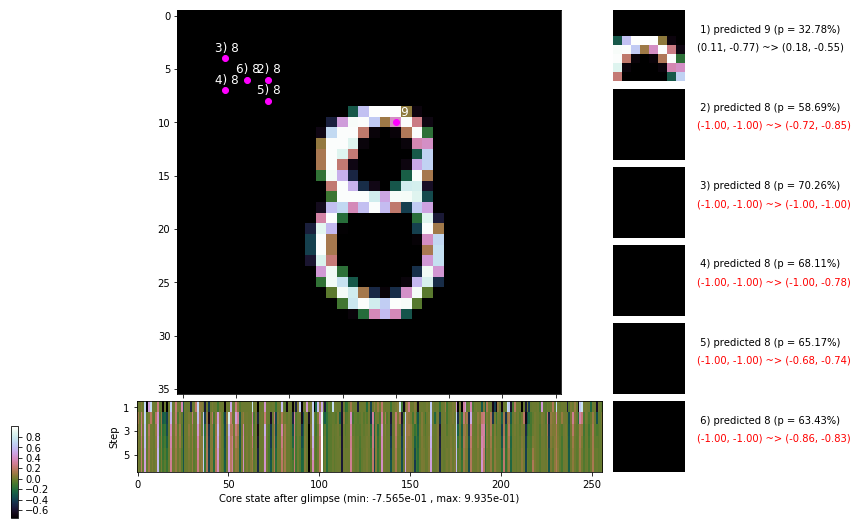

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 153.8 ms/b | lr: 6.29e-04 | grad 2norm: 20.90 | grad inf norm:  6.221
         Weights || abs max:  2.88 ( 3313.26) | mean: -4.98e-04 ( 0.01) | var: 7.00e-02 ( 1073.73)
          Biases || abs max:  2.54 (   77.36) | mean: -1.09e-01 ( 0.08) | var: 5.95e-02 (   20.17)
                    class loss: 0.863 | steps: 2.853 | reward:  3.565 | acc.: 69.63%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 151.8 ms/b | lr: 6.29e-04 | grad 2norm: 20.72 | grad inf norm:  5.888
         Weights || abs max:  2.88 ( 1756.21) | mean: -4.99e-04 ( 0.01) | var: 7.01e-02 (   83.44)
          Biases || abs max:  2.55 (  138.34) | mean: -1.09e-01 ( 0.12) | var: 5.96e-02 (  155.05)
                    class loss: 0.852 | steps: 2.850 | reward:  3.576 | acc.: 70.62%

	Target class: 1 | Discounted rewards: [4.686, 4.095, 3.4

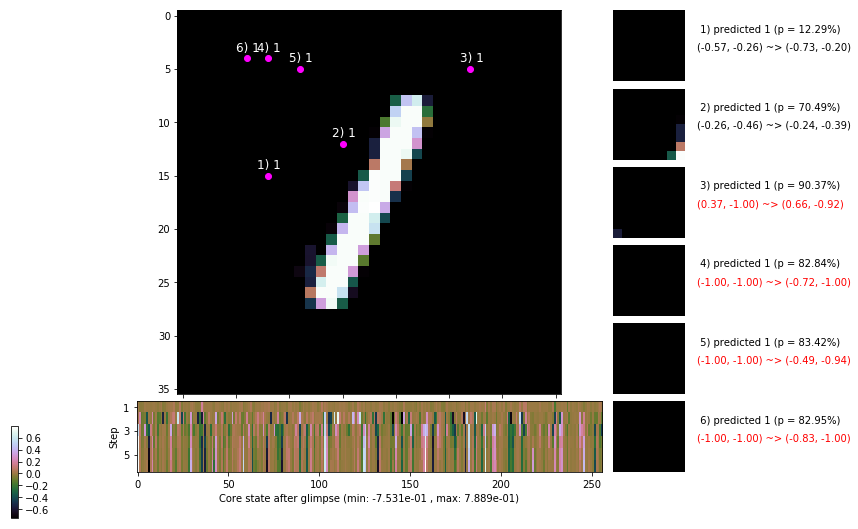

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 1 | Discounted rewards: [3.686, 4.095, 3.439, 2.710, 1.900, 1.000]


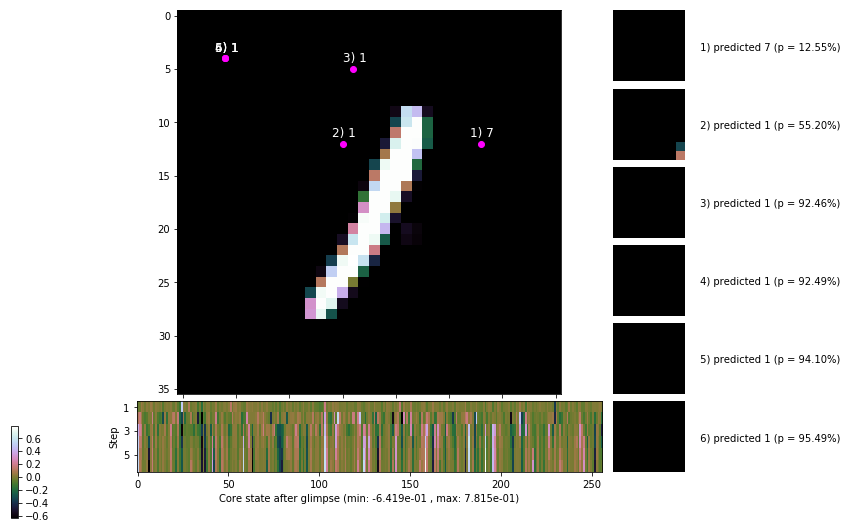


	Target class: 7 | Discounted rewards: [1.000, 0.000, 0.000, 0.000, 0.000, 0.000]


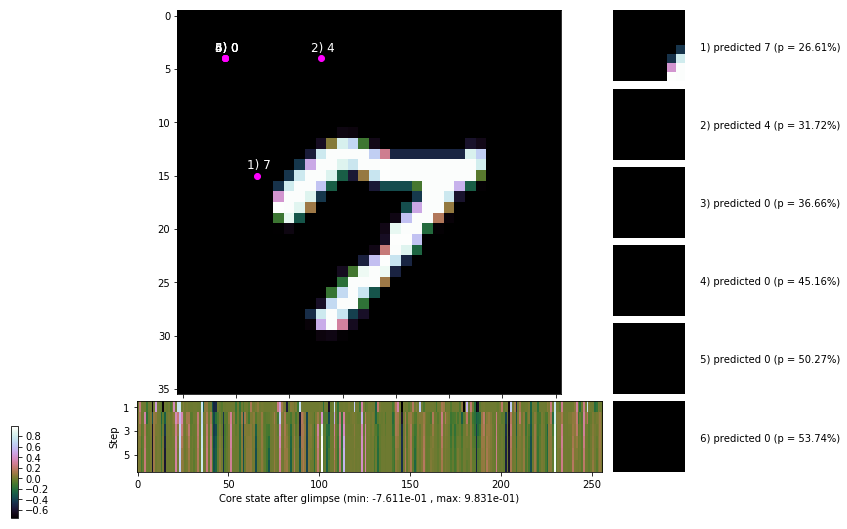

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


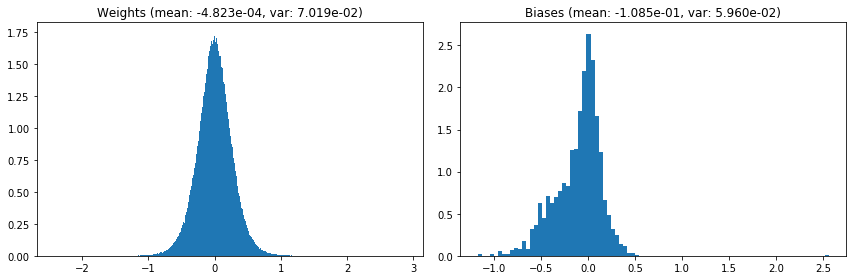

                                      Location network weights and biases


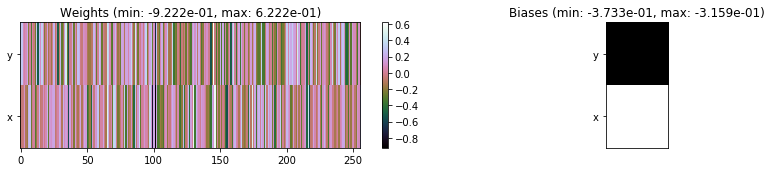

---------------------------------------------------------------------------------------------------------------
Elapsed time:  471.14 sec | TRAIN >> class loss: 0.8943 | steps:  2.918    | reward:  3.4940    | acc.: 68.423% 
                          | VAL   >> class loss: 0.8931 | steps:  2.857 :( | reward:  3.5360 :( | acc.: 68.320% :(


Epoch  32/400) lr = 0.000628
 b    300/  3000 >> 152.8 ms/b | lr: 6.27e-04 | grad 2norm: 20.85 | grad inf norm:  6.183
         Weights || abs max:  2.87 ( 1891.41) | mean: -4.83e-04 ( 0.01) | var: 7.02e-02 (   52.81)
          Biases || abs max:  2.56 (  159.57) | mean: -1.09e-01 ( 0.12) | var: 5.97e-02 (  230.44)
                    class loss: 0.860 | steps: 2.908 | reward:  3.511 | acc.: 69.37%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 152.3 ms/b | lr: 6.27e-04 | grad 2norm: 20.93 | grad inf norm:  6.306
         Weights || abs max:  2.88 (11331.84) | mean: -4.94e-04 ( 0.

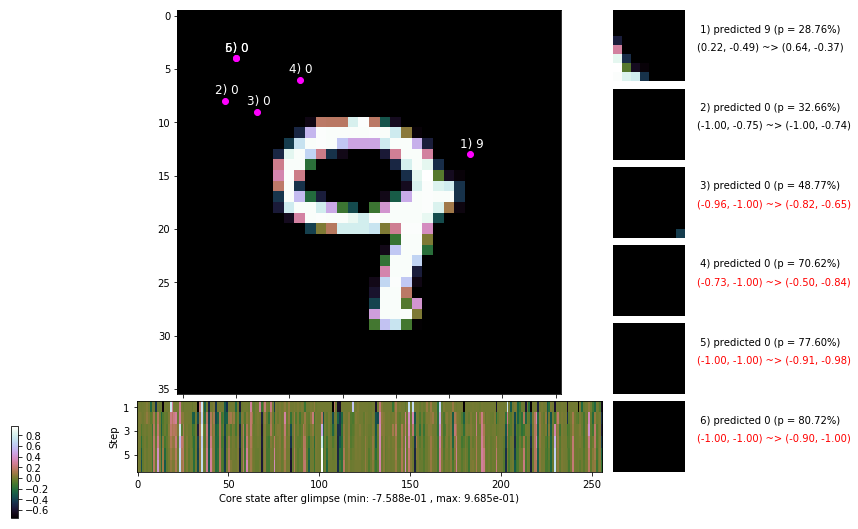

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 154.0 ms/b | lr: 6.25e-04 | grad 2norm: 20.67 | grad inf norm:  5.864
         Weights || abs max:  2.89 ( 2268.40) | mean: -5.02e-04 ( 0.01) | var: 7.04e-02 (  132.69)
          Biases || abs max:  2.55 (  135.13) | mean: -1.10e-01 ( 0.10) | var: 5.98e-02 (  133.96)
                    class loss: 0.929 | steps: 2.954 | reward:  3.437 | acc.: 67.13%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 160.4 ms/b | lr: 6.25e-04 | grad 2norm: 20.47 | grad inf norm:  6.062
         Weights || abs max:  2.90 ( 1698.60) | mean: -5.02e-04 ( 0.01) | var: 7.05e-02 (   41.27)
          Biases || abs max:  2.55 (  172.95) | mean: -1.10e-01 ( 0.12) | var: 5.98e-02 (  387.07)
                    class loss: 0.902 | steps: 2.963 | reward:  3.451 | acc.: 67.78%

	Target class: 3 | Discounted rewards: [1.247, 1.385, 1.5

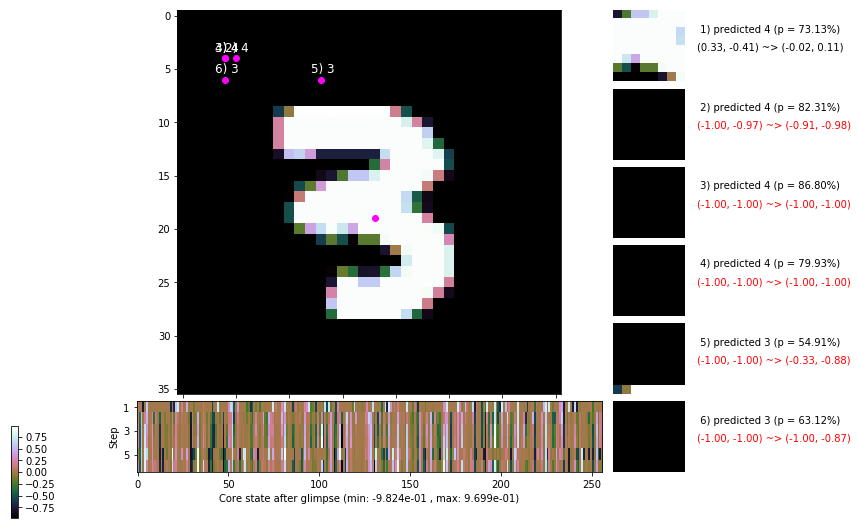

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 169.5 ms/b | lr: 6.24e-04 | grad 2norm: 20.49 | grad inf norm:  5.933
         Weights || abs max:  2.90 ( 3110.12) | mean: -4.96e-04 ( 0.01) | var: 7.06e-02 (  998.27)
          Biases || abs max:  2.53 (  251.47) | mean: -1.10e-01 ( 0.15) | var: 5.99e-02 (  744.18)
                    class loss: 0.944 | steps: 3.016 | reward:  3.384 | acc.: 66.25%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 161.8 ms/b | lr: 6.23e-04 | grad 2norm: 20.57 | grad inf norm:  5.909
         Weights || abs max:  2.91 ( 2848.17) | mean: -4.70e-04 ( 0.01) | var: 7.07e-02 (  165.66)
          Biases || abs max:  2.53 (  167.71) | mean: -1.10e-01 ( 0.12) | var: 5.99e-02 (  223.21)
                    class loss: 0.942 | steps: 2.977 | reward:  3.420 | acc.: 67.10%

	Target class: 8 | Discounted rewards: [0.000, 0.000, 0.0

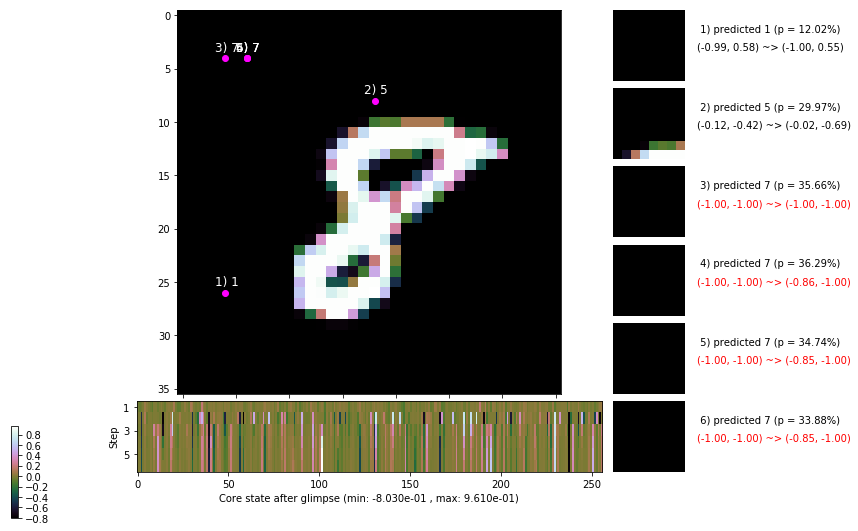

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 158.2 ms/b | lr: 6.22e-04 | grad 2norm: 20.45 | grad inf norm:  5.975
         Weights || abs max:  2.91 ( 2303.85) | mean: -4.80e-04 ( 0.01) | var: 7.08e-02 (  239.70)
          Biases || abs max:  2.53 (  160.03) | mean: -1.10e-01 ( 0.11) | var: 6.01e-02 (  233.52)
                    class loss: 0.962 | steps: 2.991 | reward:  3.383 | acc.: 65.85%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 151.7 ms/b | lr: 6.21e-04 | grad 2norm: 20.12 | grad inf norm:  6.089
         Weights || abs max:  2.91 ( 2696.03) | mean: -4.88e-04 ( 0.01) | var: 7.09e-02 (  339.53)
          Biases || abs max:  2.52 (  129.84) | mean: -1.11e-01 ( 0.10) | var: 6.04e-02 (  114.22)
                    class loss: 0.955 | steps: 2.998 | reward:  3.397 | acc.: 66.25%

	Target class: 1 | Discounted rewards: [4.686, 4.095, 3.4

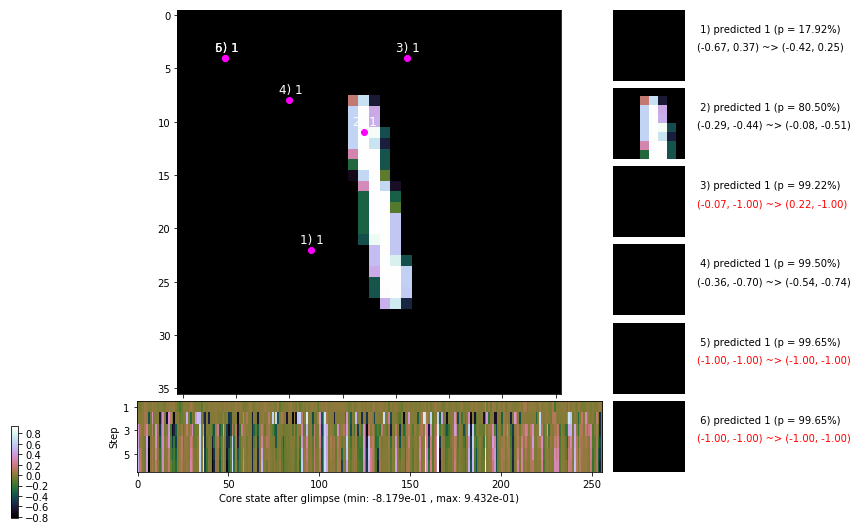

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 154.4 ms/b | lr: 6.20e-04 | grad 2norm: 20.20 | grad inf norm:  5.834
         Weights || abs max:  2.91 ( 1875.38) | mean: -5.23e-04 ( 0.01) | var: 7.10e-02 (  175.09)
          Biases || abs max:  2.52 (  231.87) | mean: -1.11e-01 ( 0.14) | var: 6.03e-02 ( 1860.61)
                    class loss: 0.912 | steps: 2.951 | reward:  3.470 | acc.: 67.90%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 152.6 ms/b | lr: 6.19e-04 | grad 2norm: 20.22 | grad inf norm:  5.984
         Weights || abs max:  2.91 ( 1716.23) | mean: -5.25e-04 ( 0.01) | var: 7.11e-02 (   96.58)
          Biases || abs max:  2.52 (  138.03) | mean: -1.11e-01 ( 0.13) | var: 6.02e-02 (  246.99)
                    class loss: 0.911 | steps: 2.923 | reward:  3.474 | acc.: 67.88%

	Target class: 2 | Discounted rewards: [2.786, 3.095, 3.4

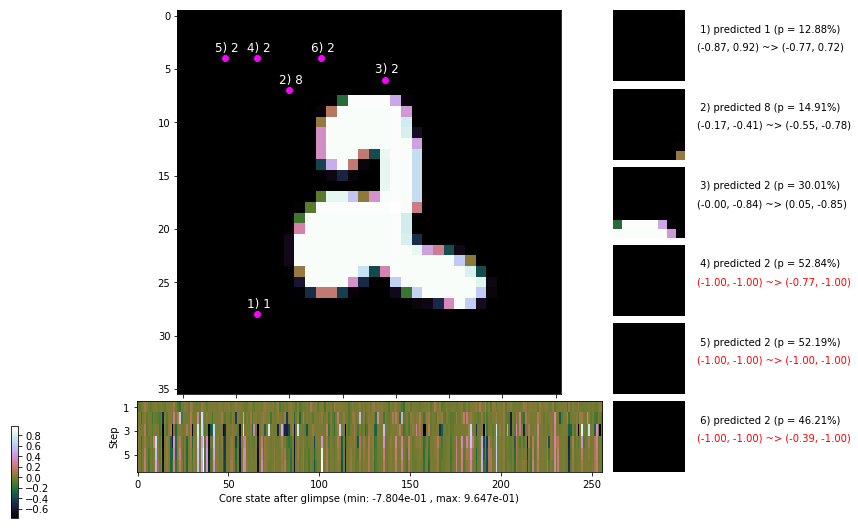

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 6 | Discounted rewards: [4.686, 4.095, 3.439, 2.710, 1.900, 1.000]


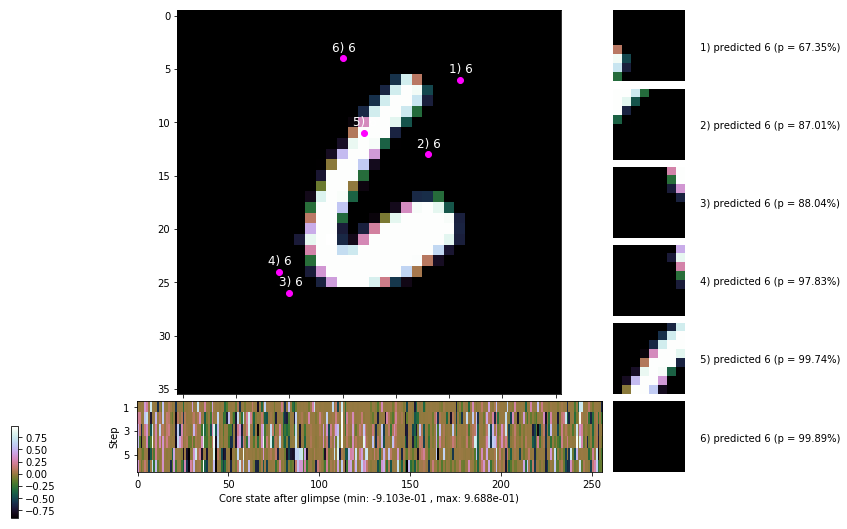


	Target class: 6 | Discounted rewards: [2.786, 3.095, 3.439, 2.710, 1.900, 1.000]


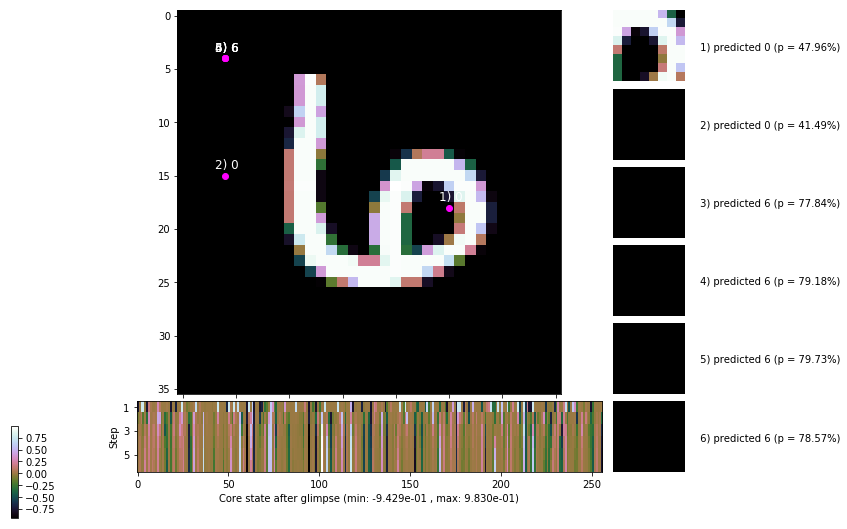

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


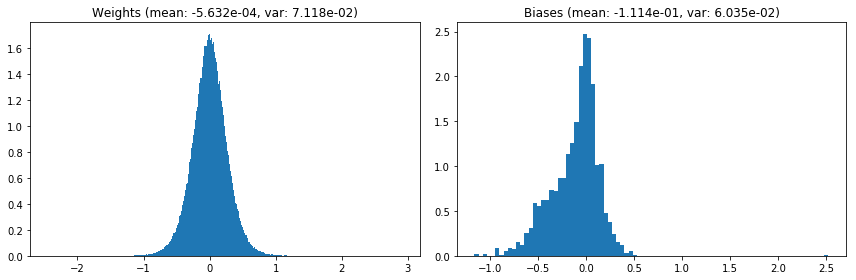

                                      Location network weights and biases


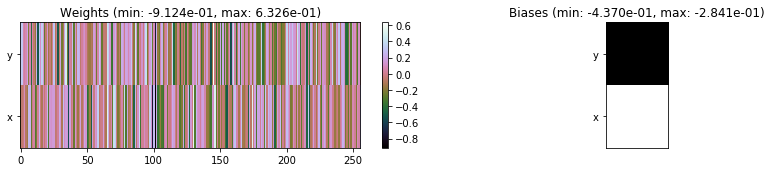

---------------------------------------------------------------------------------------------------------------
Elapsed time:  471.02 sec | TRAIN >> class loss: 0.9210 | steps:  2.961 :( | reward:  3.4392 :( | acc.: 67.370% :(
                          | VAL   >> class loss: 0.9335 | steps:  2.927 :( | reward:  3.4650 :( | acc.: 66.720% :(


Epoch  33/400) lr = 0.0006186
 b    300/  3000 >> 152.9 ms/b | lr: 6.18e-04 | grad 2norm: 20.37 | grad inf norm:  6.210
         Weights || abs max:  2.90 ( 1556.02) | mean: -5.72e-04 ( 0.01) | var: 7.12e-02 (  122.94)
          Biases || abs max:  2.52 (   97.10) | mean: -1.11e-01 ( 0.09) | var: 6.05e-02 (  168.03)
                    class loss: 0.938 | steps: 2.980 | reward:  3.430 | acc.: 66.83%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 154.6 ms/b | lr: 6.17e-04 | grad 2norm: 20.14 | grad inf norm:  5.851
         Weights || abs max:  2.90 ( 2312.30) | mean: -5.42e-04 (

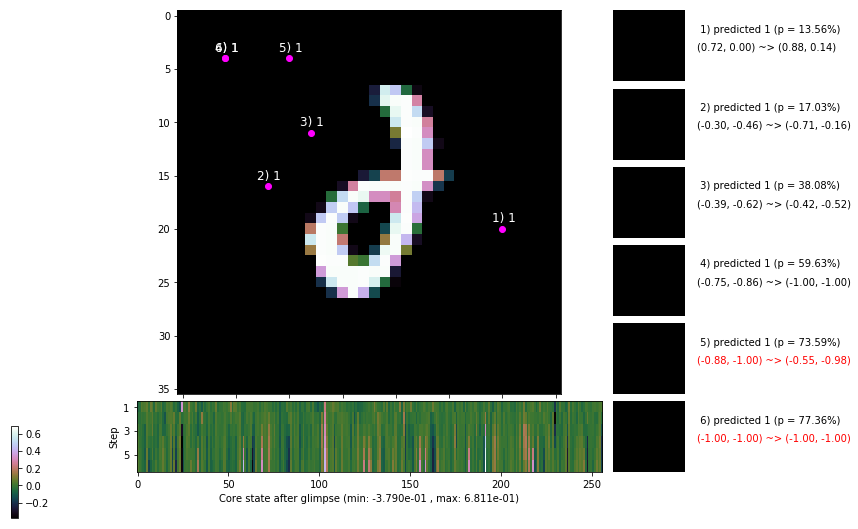

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 154.7 ms/b | lr: 6.16e-04 | grad 2norm: 20.39 | grad inf norm:  6.078
         Weights || abs max:  2.92 ( 2150.16) | mean: -4.99e-04 ( 0.01) | var: 7.14e-02 (   58.20)
          Biases || abs max:  2.51 (   56.61) | mean: -1.11e-01 ( 0.07) | var: 6.06e-02 (   19.27)
                    class loss: 0.944 | steps: 3.007 | reward:  3.392 | acc.: 66.13%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 154.2 ms/b | lr: 6.16e-04 | grad 2norm: 20.46 | grad inf norm:  6.310
         Weights || abs max:  2.92 (     inf) | mean: -5.02e-04 (  inf) | var: 7.15e-02 (     nan)
          Biases || abs max:  2.51 (   94.94) | mean: -1.11e-01 ( 0.09) | var: 6.06e-02 (   35.37)
                    class loss: 0.920 | steps: 2.984 | reward:  3.446 | acc.: 67.60%

	Target class: 0 | Discounted rewards: [0.000, 0.000, 0.0

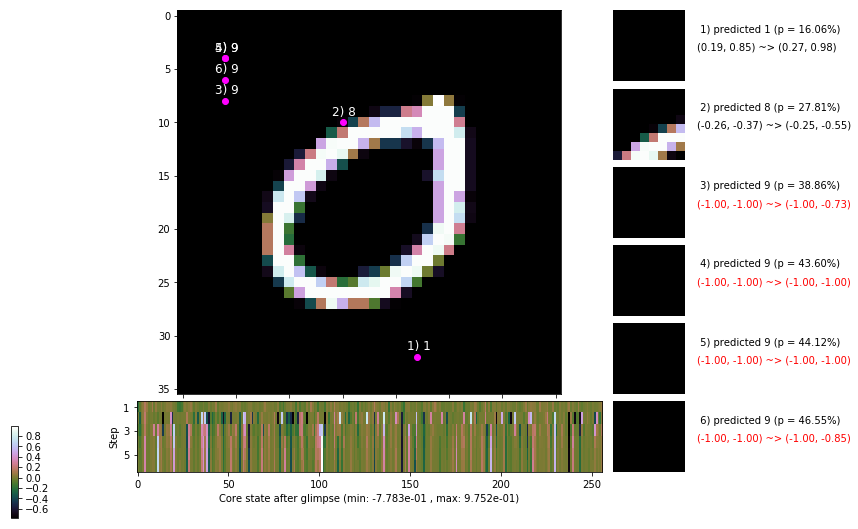

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 155.8 ms/b | lr: 6.14e-04 | grad 2norm: 20.29 | grad inf norm:  6.402
         Weights || abs max:  2.93 ( 1011.27) | mean: -5.15e-04 ( 0.01) | var: 7.16e-02 (   12.47)
          Biases || abs max:  2.50 (  196.24) | mean: -1.11e-01 ( 0.14) | var: 6.09e-02 (  444.19)
                    class loss: 0.965 | steps: 3.022 | reward:  3.389 | acc.: 66.10%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 153.6 ms/b | lr: 6.14e-04 | grad 2norm: 20.34 | grad inf norm:  6.123
         Weights || abs max:  2.93 ( 1269.81) | mean: -5.28e-04 ( 0.01) | var: 7.17e-02 (   36.41)
          Biases || abs max:  2.49 (  127.15) | mean: -1.12e-01 ( 0.11) | var: 6.11e-02 (  167.90)
                    class loss: 0.960 | steps: 3.022 | reward:  3.365 | acc.: 65.72%

	Target class: 4 | Discounted rewards: [3.686, 4.095, 3.4

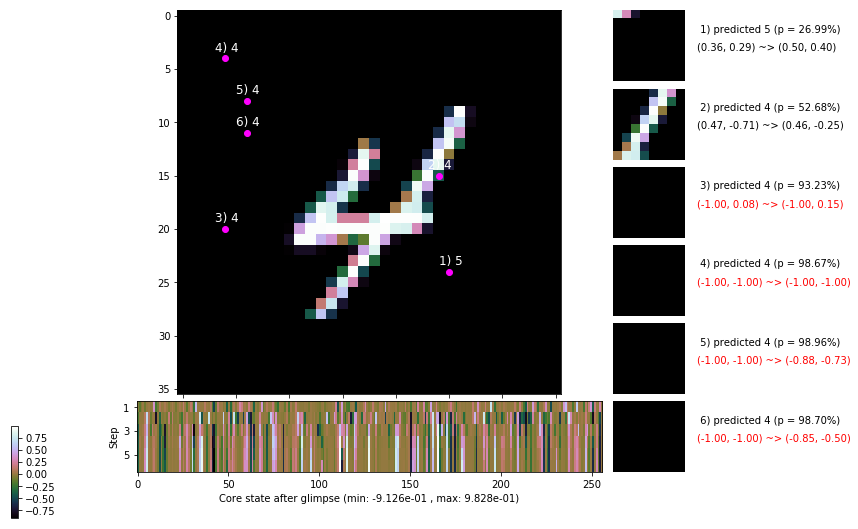

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 164.7 ms/b | lr: 6.12e-04 | grad 2norm: 19.93 | grad inf norm:  5.766
         Weights || abs max:  2.93 ( 1886.15) | mean: -5.77e-04 ( 0.01) | var: 7.18e-02 (  127.56)
          Biases || abs max:  2.48 (  150.72) | mean: -1.12e-01 ( 0.11) | var: 6.13e-02 (  360.53)
                    class loss: 0.937 | steps: 3.006 | reward:  3.421 | acc.: 66.90%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 163.9 ms/b | lr: 6.12e-04 | grad 2norm: 20.84 | grad inf norm:  6.215
         Weights || abs max:  2.93 ( 1957.07) | mean: -6.01e-04 ( 0.01) | var: 7.19e-02 (  181.42)
          Biases || abs max:  2.48 (  158.24) | mean: -1.12e-01 ( 0.11) | var: 6.14e-02 (  338.08)
                    class loss: 0.929 | steps: 2.980 | reward:  3.428 | acc.: 66.75%

	Target class: 0 | Discounted rewards: [0.000, 0.000, 0.0

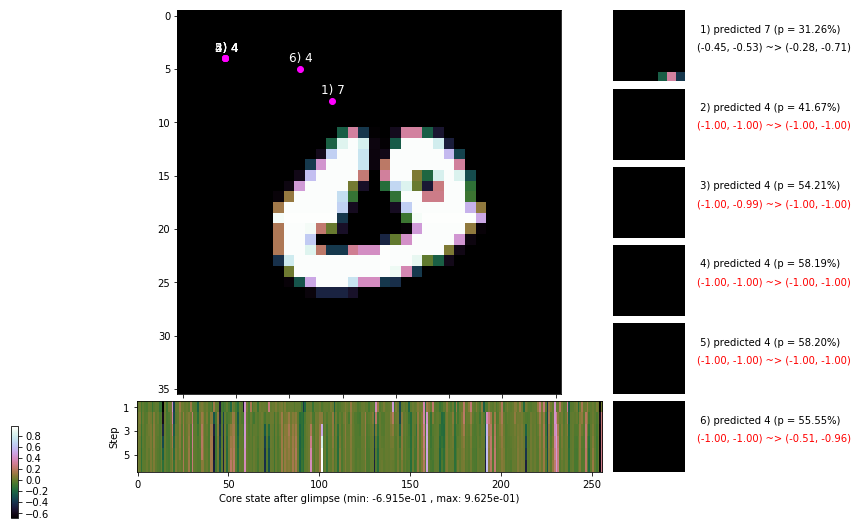

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 166.2 ms/b | lr: 6.11e-04 | grad 2norm: 20.19 | grad inf norm:  5.833
         Weights || abs max:  2.92 ( 1641.37) | mean: -5.89e-04 ( 0.01) | var: 7.20e-02 (  137.59)
          Biases || abs max:  2.48 (  223.32) | mean: -1.12e-01 ( 0.14) | var: 6.15e-02 ( 1297.21)
                    class loss: 0.920 | steps: 2.993 | reward:  3.429 | acc.: 67.52%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 156.8 ms/b | lr: 6.10e-04 | grad 2norm: 20.90 | grad inf norm:  6.349
         Weights || abs max:  2.93 ( 2336.68) | mean: -6.16e-04 ( 0.01) | var: 7.21e-02 (  331.49)
          Biases || abs max:  2.49 (   68.39) | mean: -1.12e-01 ( 0.07) | var: 6.15e-02 (   62.04)
                    class loss: 0.908 | steps: 2.956 | reward:  3.478 | acc.: 68.05%

	Target class: 6 | Discounted rewards: [2.786, 3.095, 3.4

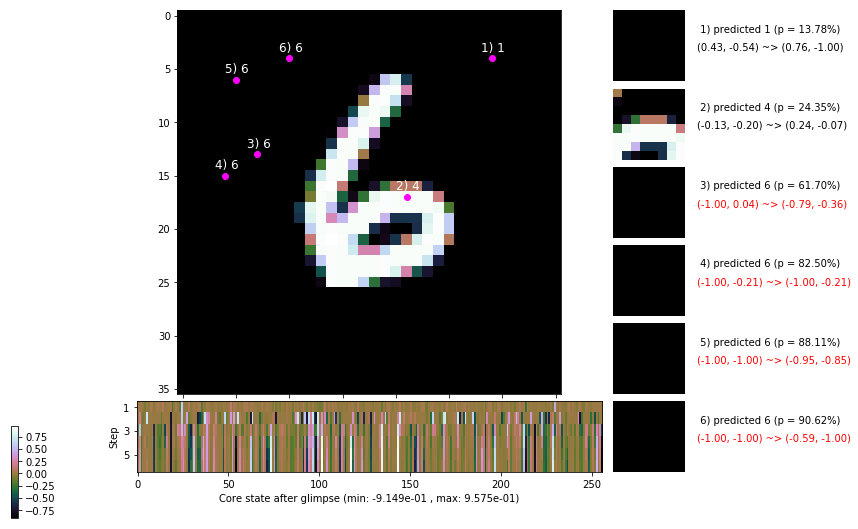

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 7 | Discounted rewards: [1.000, 0.000, 0.000, 0.000, 0.000, 0.000]


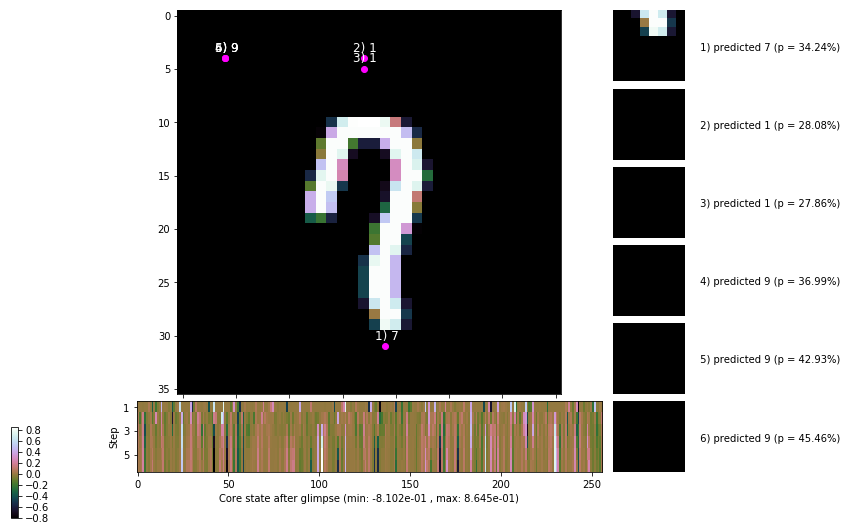


	Target class: 7 | Discounted rewards: [4.686, 4.095, 3.439, 2.710, 1.900, 1.000]


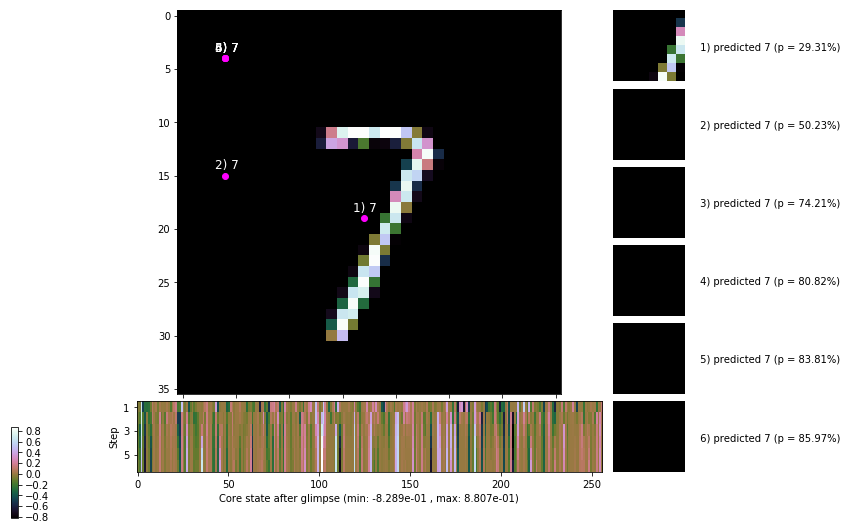

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


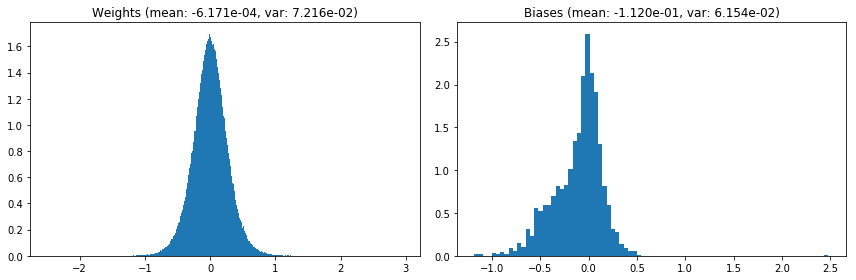

                                      Location network weights and biases


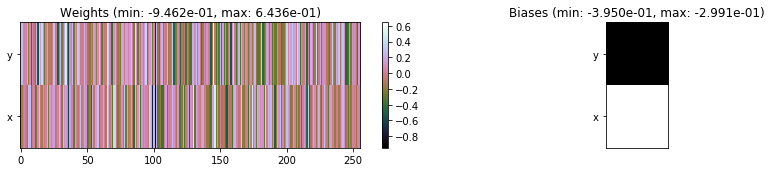

---------------------------------------------------------------------------------------------------------------
Elapsed time:  473.83 sec | TRAIN >> class loss: 0.9369 | steps:  2.992 :( | reward:  3.4200 :( | acc.: 66.818% :(
                          | VAL   >> class loss: 0.8639 | steps:  2.845 :( | reward:  3.5754 :( | acc.: 69.380% :(


Epoch  34/400) lr = 0.0006094
 b    300/  3000 >> 155.8 ms/b | lr: 6.09e-04 | grad 2norm: 20.80 | grad inf norm:  6.233
         Weights || abs max:  2.93 ( 3407.46) | mean: -6.25e-04 ( 0.01) | var: 7.22e-02 ( 2183.25)
          Biases || abs max:  2.49 (  100.45) | mean: -1.12e-01 ( 0.08) | var: 6.17e-02 (   87.38)
                    class loss: 0.900 | steps: 2.941 | reward:  3.474 | acc.: 67.68%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 153.1 ms/b | lr: 6.08e-04 | grad 2norm: 20.23 | grad inf norm:  5.988
         Weights || abs max:  2.93 ( 3296.93) | mean: -6.23e-04 (

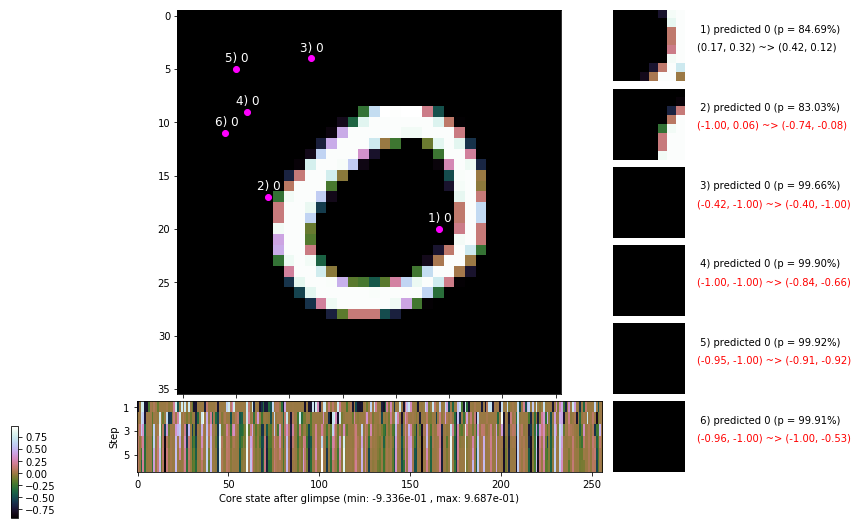

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 154.3 ms/b | lr: 6.07e-04 | grad 2norm: 20.86 | grad inf norm:  5.962
         Weights || abs max:  2.93 ( 1950.57) | mean: -6.53e-04 ( 0.01) | var: 7.24e-02 (   68.00)
          Biases || abs max:  2.51 (   72.39) | mean: -1.12e-01 ( 0.08) | var: 6.15e-02 (   21.12)
                    class loss: 0.879 | steps: 2.900 | reward:  3.521 | acc.: 68.53%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 153.9 ms/b | lr: 6.06e-04 | grad 2norm: 20.47 | grad inf norm:  5.949
         Weights || abs max:  2.94 ( 1550.45) | mean: -6.65e-04 ( 0.01) | var: 7.25e-02 (  164.08)
          Biases || abs max:  2.51 (  108.72) | mean: -1.12e-01 ( 0.09) | var: 6.15e-02 (  178.63)
                    class loss: 0.876 | steps: 2.912 | reward:  3.503 | acc.: 68.73%

	Target class: 7 | Discounted rewards: [3.686, 4.095, 3.4

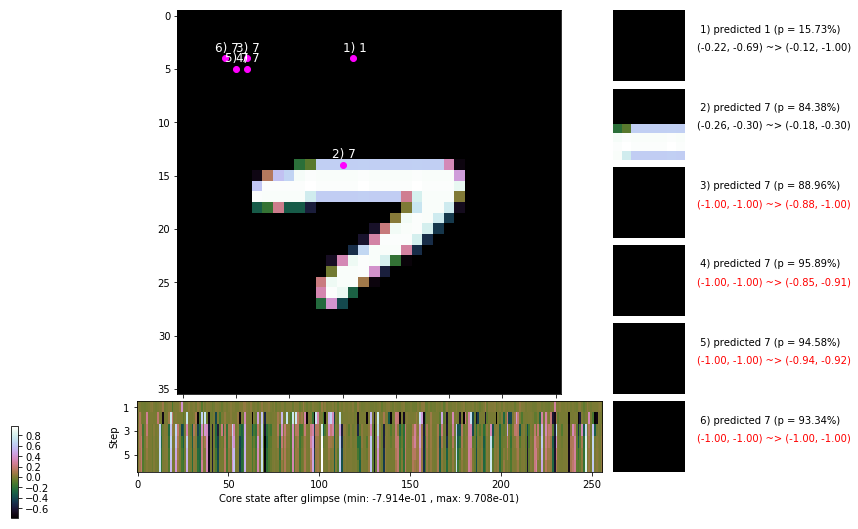

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 154.8 ms/b | lr: 6.05e-04 | grad 2norm: 20.66 | grad inf norm:  5.915
         Weights || abs max:  2.95 ( 4342.19) | mean: -6.67e-04 ( 0.01) | var: 7.26e-02 ( 1150.84)
          Biases || abs max:  2.51 (   89.71) | mean: -1.12e-01 ( 0.09) | var: 6.18e-02 (   43.93)
                    class loss: 0.910 | steps: 2.951 | reward:  3.475 | acc.: 67.93%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 155.9 ms/b | lr: 6.05e-04 | grad 2norm: 20.59 | grad inf norm:  5.868
         Weights || abs max:  2.96 ( 2063.14) | mean: -7.00e-04 ( 0.01) | var: 7.27e-02 (  119.68)
          Biases || abs max:  2.51 (  203.05) | mean: -1.13e-01 ( 0.13) | var: 6.20e-02 (  535.36)
                    class loss: 0.877 | steps: 2.937 | reward:  3.508 | acc.: 68.77%

	Target class: 6 | Discounted rewards: [3.686, 4.095, 3.4

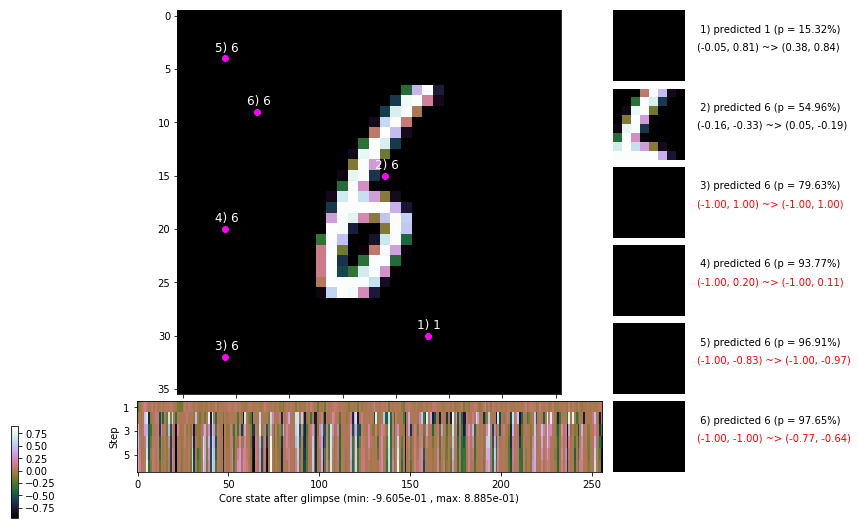

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 156.2 ms/b | lr: 6.03e-04 | grad 2norm: 20.18 | grad inf norm:  5.647
         Weights || abs max:  2.96 ( 1470.81) | mean: -7.03e-04 ( 0.01) | var: 7.28e-02 (   87.05)
          Biases || abs max:  2.52 (  130.68) | mean: -1.13e-01 ( 0.12) | var: 6.20e-02 (  126.63)
                    class loss: 0.886 | steps: 2.948 | reward:  3.493 | acc.: 68.65%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 153.6 ms/b | lr: 6.03e-04 | grad 2norm: 20.24 | grad inf norm:  5.854
         Weights || abs max:  2.98 ( 3720.28) | mean: -6.95e-04 ( 0.01) | var: 7.28e-02 ( 1011.35)
          Biases || abs max:  2.51 (  220.81) | mean: -1.13e-01 ( 0.20) | var: 6.20e-02 ( 3210.92)
                    class loss: 0.927 | steps: 2.959 | reward:  3.458 | acc.: 67.50%

	Target class: 1 | Discounted rewards: [4.686, 4.095, 3.4

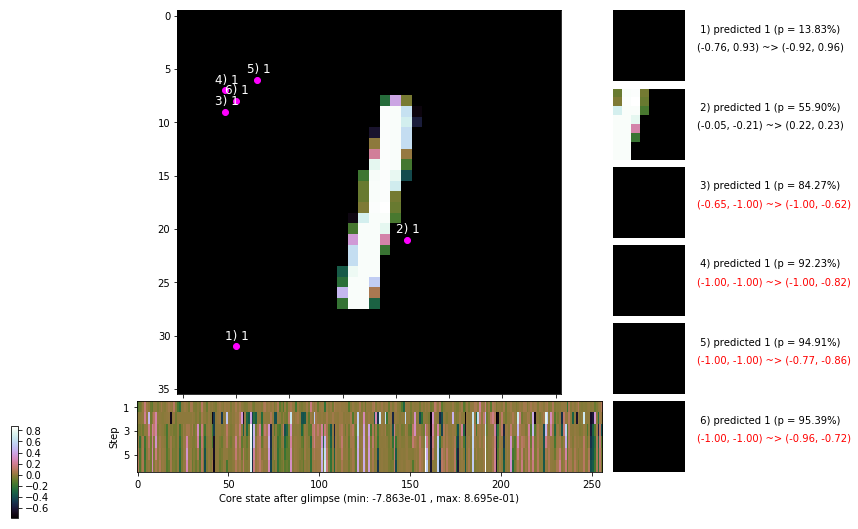

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 163.4 ms/b | lr: 6.02e-04 | grad 2norm: 20.45 | grad inf norm:  6.036
         Weights || abs max:  2.98 ( 1142.73) | mean: -6.73e-04 ( 0.01) | var: 7.29e-02 (   14.98)
          Biases || abs max:  2.51 (  137.94) | mean: -1.13e-01 ( 0.11) | var: 6.21e-02 (  148.82)
                    class loss: 0.896 | steps: 2.919 | reward:  3.507 | acc.: 68.22%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 155.8 ms/b | lr: 6.01e-04 | grad 2norm: 20.37 | grad inf norm:  5.906
         Weights || abs max:  2.97 ( 4893.88) | mean: -6.66e-04 ( 0.01) | var: 7.31e-02 ( 4719.07)
          Biases || abs max:  2.52 (  259.73) | mean: -1.13e-01 ( 0.16) | var: 6.23e-02 ( 1054.96)
                    class loss: 0.890 | steps: 2.943 | reward:  3.494 | acc.: 68.47%

	Target class: 0 | Discounted rewards: [4.686, 4.095, 3.4

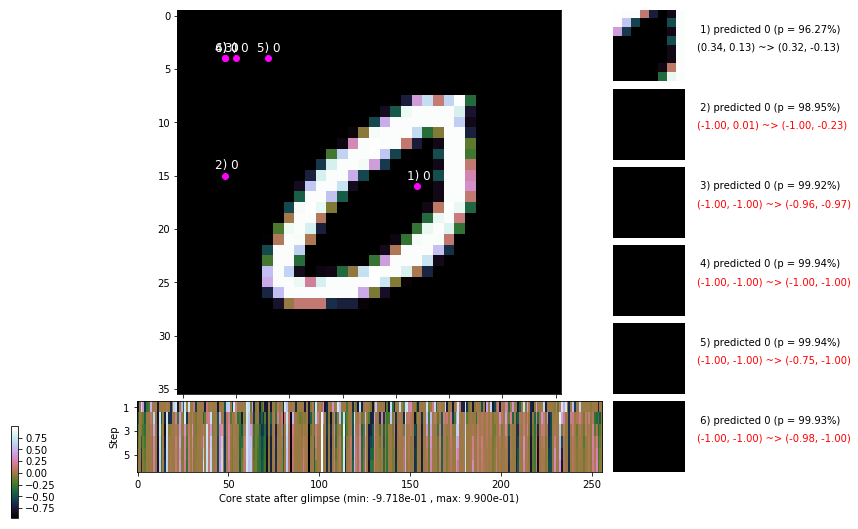

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 0 | Discounted rewards: [0.000, 0.000, 0.000, 0.000, 0.000, 0.000]


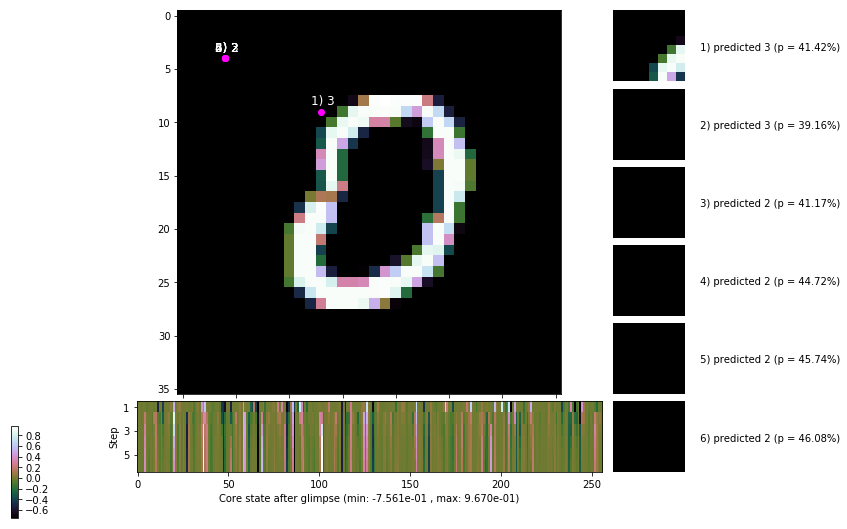


	Target class: 8 | Discounted rewards: [0.000, 0.000, 0.000, 0.000, 0.000, 0.000]


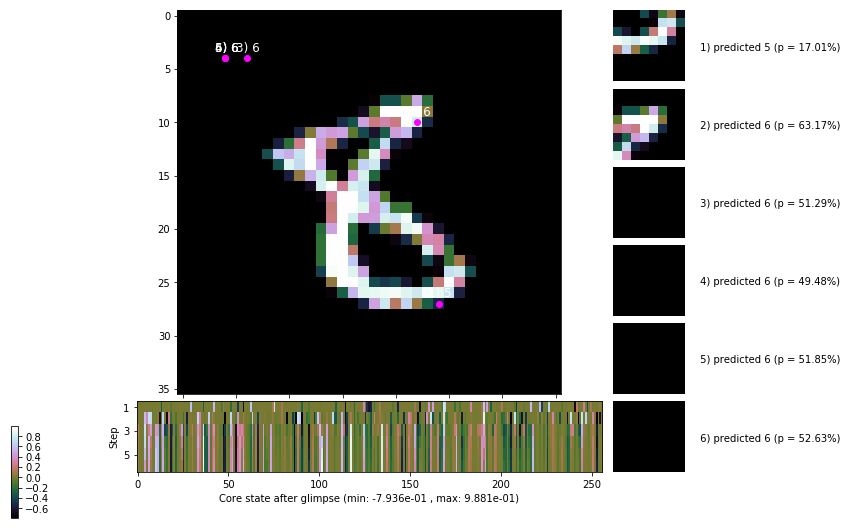

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


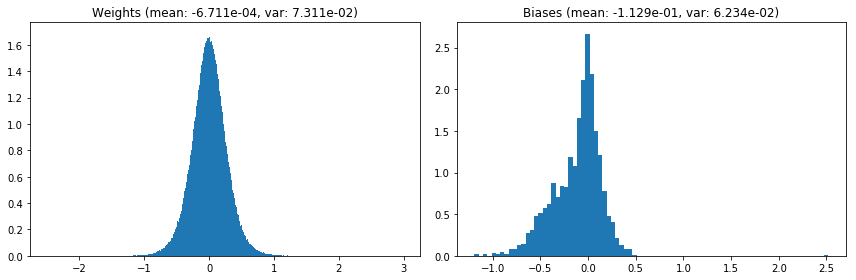

                                      Location network weights and biases


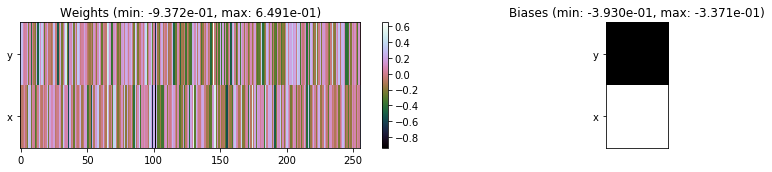

---------------------------------------------------------------------------------------------------------------
Elapsed time:  467.81 sec | TRAIN >> class loss: 0.8890 | steps:  2.929 :( | reward:  3.5022    | acc.: 68.463% 
                          | VAL   >> class loss: 0.8491 | steps:  2.840 :( | reward:  3.6148    | acc.: 69.920% 


Epoch  35/400) lr = 0.0006003
 b    300/  3000 >> 162.9 ms/b | lr: 6.00e-04 | grad 2norm: 20.45 | grad inf norm:  5.993
         Weights || abs max:  2.97 ( 2574.51) | mean: -6.82e-04 ( 0.01) | var: 7.31e-02 (  565.22)
          Biases || abs max:  2.52 (  156.53) | mean: -1.13e-01 ( 0.12) | var: 6.24e-02 (  183.60)
                    class loss: 0.931 | steps: 2.988 | reward:  3.424 | acc.: 66.90%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 161.6 ms/b | lr: 5.99e-04 | grad 2norm: 20.05 | grad inf norm:  5.947
         Weights || abs max:  2.97 ( 2903.73) | mean: -6.84e-04 ( 0.0

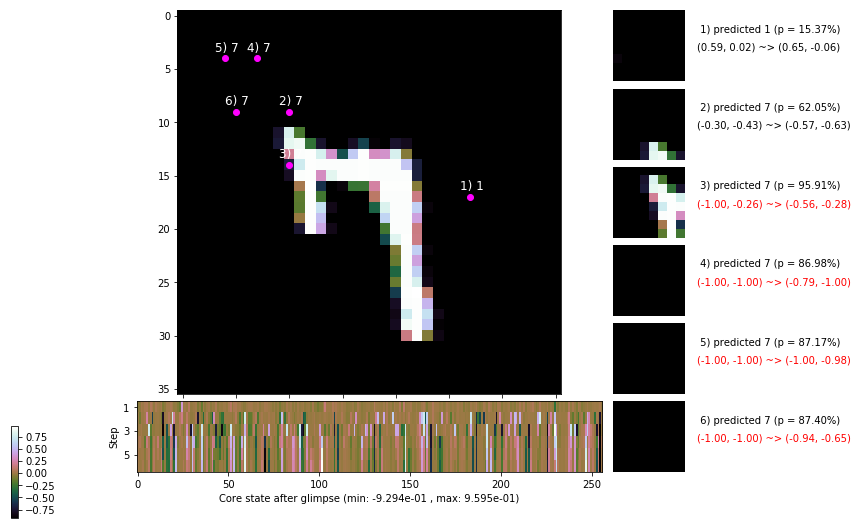

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 155.0 ms/b | lr: 5.98e-04 | grad 2norm: 20.38 | grad inf norm:  6.166
         Weights || abs max:  2.97 ( 1515.70) | mean: -6.26e-04 ( 0.01) | var: 7.33e-02 (   47.75)
          Biases || abs max:  2.51 (  105.31) | mean: -1.13e-01 ( 0.10) | var: 6.24e-02 (   72.98)
                    class loss: 0.917 | steps: 2.974 | reward:  3.443 | acc.: 67.37%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 154.3 ms/b | lr: 5.97e-04 | grad 2norm: 20.52 | grad inf norm:  6.196
         Weights || abs max:  2.99 ( 2166.90) | mean: -6.25e-04 ( 0.01) | var: 7.34e-02 (  206.35)
          Biases || abs max:  2.51 (  100.46) | mean: -1.13e-01 ( 0.09) | var: 6.26e-02 (  175.31)
                    class loss: 0.926 | steps: 2.988 | reward:  3.418 | acc.: 66.80%

	Target class: 4 | Discounted rewards: [0.000, 0.000, 0.0

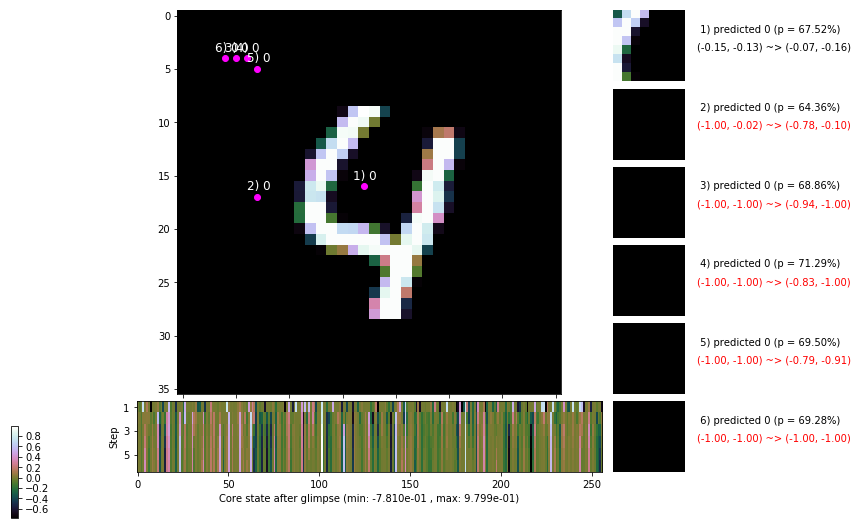

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 154.6 ms/b | lr: 5.96e-04 | grad 2norm: 20.34 | grad inf norm:  6.115
         Weights || abs max:  2.99 (13194.06) | mean: -6.48e-04 ( 0.03) | var: 7.35e-02 (68214.80)
          Biases || abs max:  2.50 (   65.83) | mean: -1.13e-01 ( 0.08) | var: 6.27e-02 (    9.34)
                    class loss: 0.904 | steps: 2.941 | reward:  3.467 | acc.: 68.03%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 151.9 ms/b | lr: 5.96e-04 | grad 2norm: 20.68 | grad inf norm:  6.048
         Weights || abs max:  2.99 ( 1240.37) | mean: -6.67e-04 ( 0.01) | var: 7.36e-02 (   18.38)
          Biases || abs max:  2.51 (  105.36) | mean: -1.13e-01 ( 0.10) | var: 6.27e-02 (  105.47)
                    class loss: 0.906 | steps: 2.929 | reward:  3.479 | acc.: 68.27%

	Target class: 1 | Discounted rewards: [4.686, 4.095, 3.4

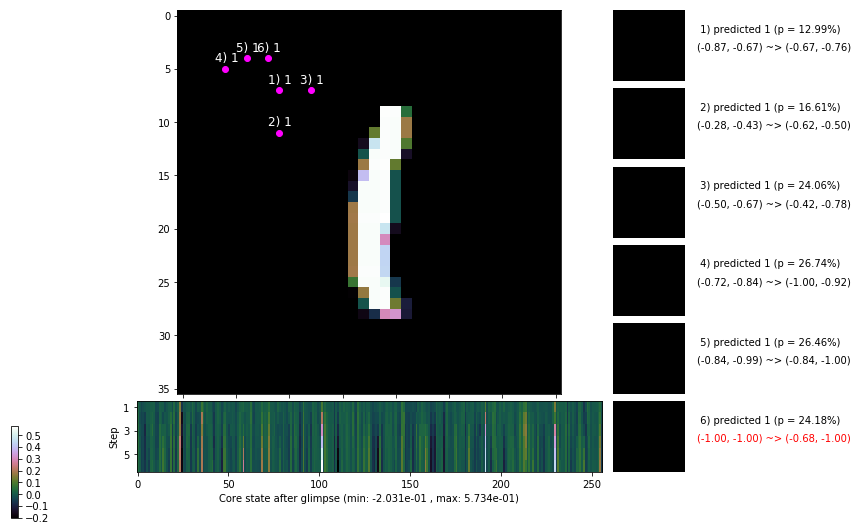

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 152.5 ms/b | lr: 5.94e-04 | grad 2norm: 20.18 | grad inf norm:  6.064
         Weights || abs max:  3.00 ( 2755.02) | mean: -6.69e-04 ( 0.01) | var: 7.37e-02 (  254.08)
          Biases || abs max:  2.51 ( 2481.54) | mean: -1.13e-01 ( 1.23) | var: 6.28e-02 (469101.25)
                    class loss: 0.929 | steps: 2.971 | reward:  3.425 | acc.: 67.07%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 151.6 ms/b | lr: 5.94e-04 | grad 2norm: 20.40 | grad inf norm:  5.767
         Weights || abs max:  3.01 ( 5610.96) | mean: -6.81e-04 ( 0.02) | var: 7.38e-02 ( 4173.21)
          Biases || abs max:  2.51 (  116.49) | mean: -1.13e-01 ( 0.10) | var: 6.28e-02 (   60.65)
                    class loss: 0.933 | steps: 2.985 | reward:  3.402 | acc.: 67.05%

	Target class: 0 | Discounted rewards: [0.000, 0.000, 0.

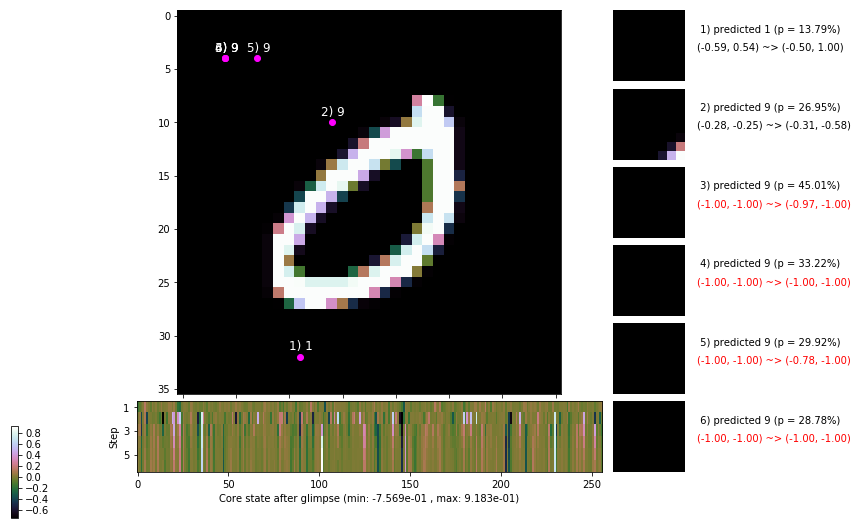

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 156.3 ms/b | lr: 5.93e-04 | grad 2norm: 20.23 | grad inf norm:  5.957
         Weights || abs max:  3.02 ( 1550.82) | mean: -7.11e-04 ( 0.01) | var: 7.39e-02 (   38.34)
          Biases || abs max:  2.51 (  164.19) | mean: -1.13e-01 ( 0.12) | var: 6.29e-02 ( 1124.33)
                    class loss: 0.920 | steps: 2.957 | reward:  3.446 | acc.: 67.33%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 153.7 ms/b | lr: 5.92e-04 | grad 2norm: 20.26 | grad inf norm:  5.974
         Weights || abs max:  3.02 (18515.40) | mean: -7.07e-04 ( 0.04) | var: 7.39e-02 (111202.82)
          Biases || abs max:  2.50 (  109.68) | mean: -1.14e-01 ( 0.09) | var: 6.29e-02 (  105.75)
                    class loss: 0.945 | steps: 2.984 | reward:  3.422 | acc.: 67.27%

	Target class: 5 | Discounted rewards: [0.000, 0.000, 0.

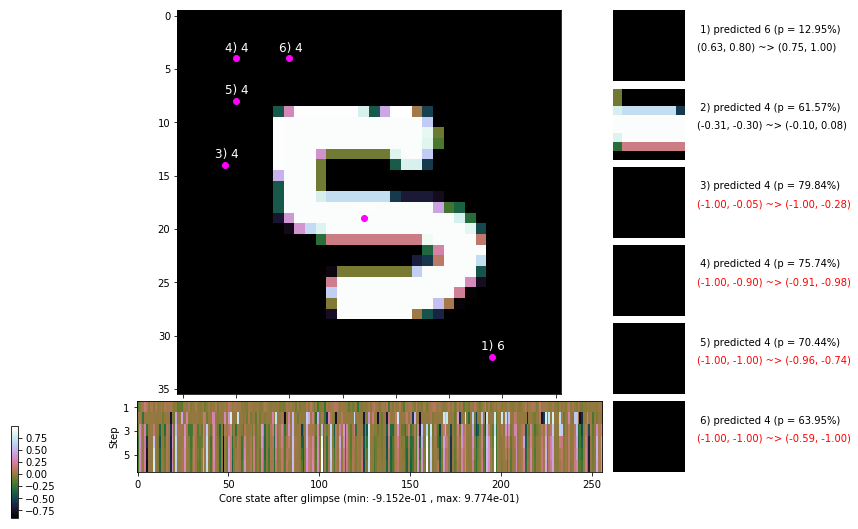

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 7 | Discounted rewards: [3.686, 4.095, 3.439, 2.710, 1.900, 1.000]


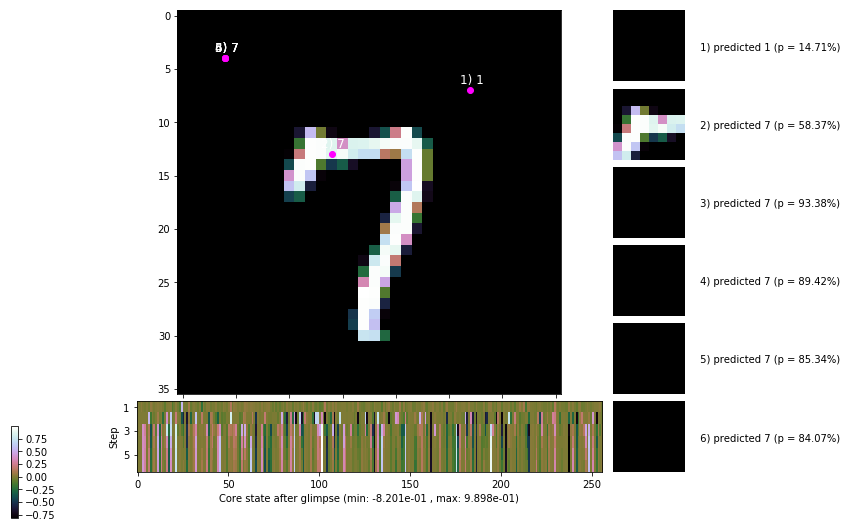


	Target class: 2 | Discounted rewards: [2.786, 3.095, 3.439, 2.710, 1.900, 1.000]


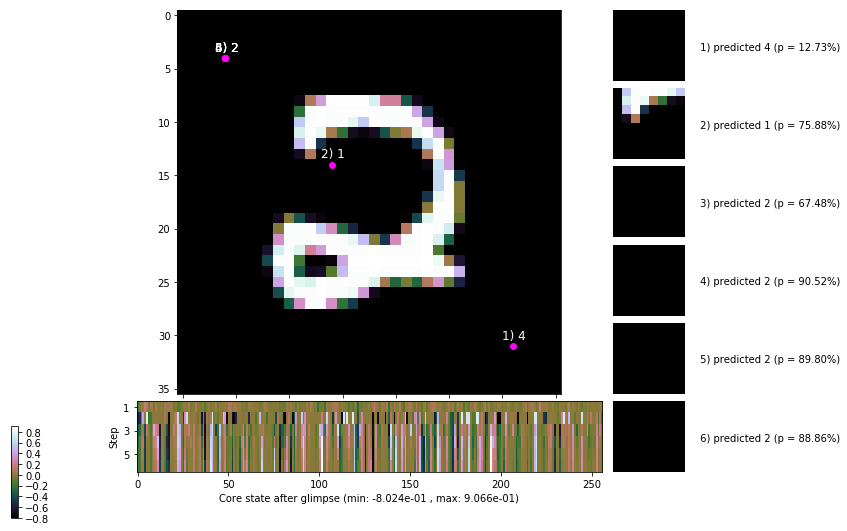

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


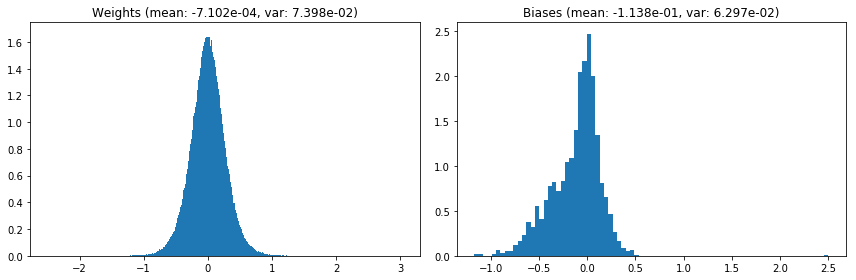

                                      Location network weights and biases


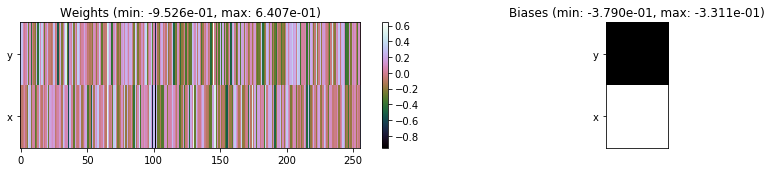

---------------------------------------------------------------------------------------------------------------
Elapsed time:  466.97 sec | TRAIN >> class loss: 0.9259 | steps:  2.972 :( | reward:  3.4319 :( | acc.: 67.245% :(
                          | VAL   >> class loss: 0.9051 | steps:  2.894 :( | reward:  3.5024 :( | acc.: 67.260% :(


Epoch  36/400) lr = 0.0005914
 b    300/  3000 >> 154.8 ms/b | lr: 5.91e-04 | grad 2norm: 20.50 | grad inf norm:  6.098
         Weights || abs max:  3.02 ( 3354.52) | mean: -7.21e-04 ( 0.01) | var: 7.40e-02 (  515.01)
          Biases || abs max:  2.50 (  232.90) | mean: -1.14e-01 ( 0.21) | var: 6.30e-02 ( 2561.26)
                    class loss: 0.918 | steps: 3.002 | reward:  3.441 | acc.: 67.90%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 161.0 ms/b | lr: 5.90e-04 | grad 2norm: 20.01 | grad inf norm:  5.962
         Weights || abs max:  3.03 ( 2908.95) | mean: -7.46e-04 (

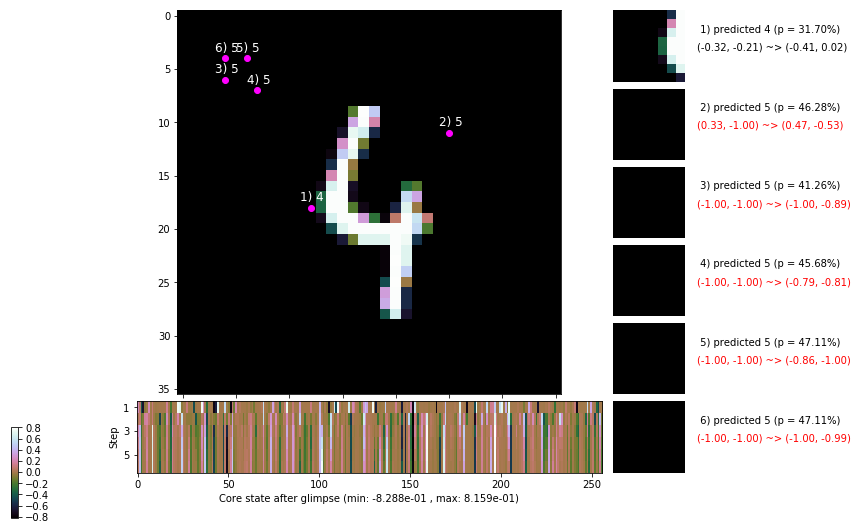

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 168.2 ms/b | lr: 5.89e-04 | grad 2norm: 20.39 | grad inf norm:  6.019
         Weights || abs max:  3.03 ( 2329.81) | mean: -7.37e-04 ( 0.01) | var: 7.42e-02 (  167.54)
          Biases || abs max:  2.50 (  158.90) | mean: -1.15e-01 ( 0.12) | var: 6.34e-02 (  175.88)
                    class loss: 0.965 | steps: 2.999 | reward:  3.396 | acc.: 66.42%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 163.0 ms/b | lr: 5.88e-04 | grad 2norm: 19.72 | grad inf norm:  5.648
         Weights || abs max:  3.02 ( 2782.34) | mean: -7.14e-04 ( 0.01) | var: 7.43e-02 (  290.84)
          Biases || abs max:  2.49 (  391.01) | mean: -1.15e-01 ( 0.20) | var: 6.34e-02 (13280.07)
                    class loss: 0.939 | steps: 2.969 | reward:  3.436 | acc.: 67.10%

	Target class: 2 | Discounted rewards: [2.786, 3.095, 3.4

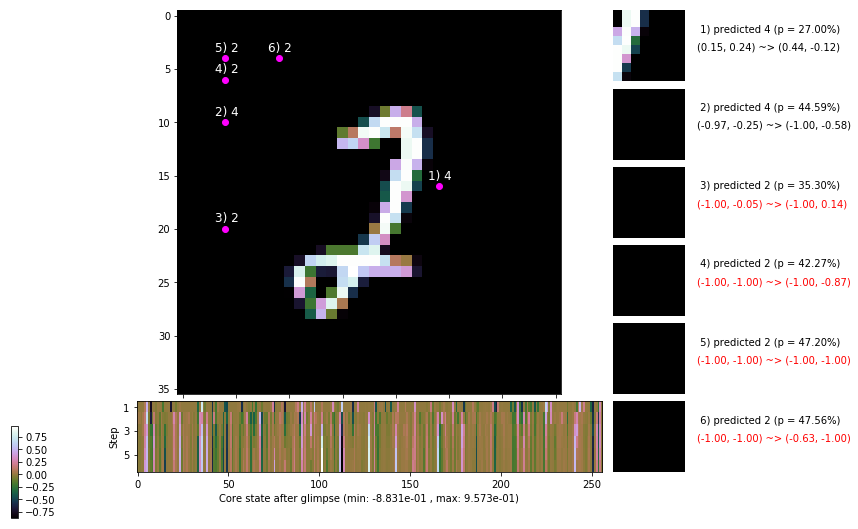

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 158.3 ms/b | lr: 5.87e-04 | grad 2norm: 20.11 | grad inf norm:  5.673
         Weights || abs max:  3.02 ( 2102.11) | mean: -7.04e-04 ( 0.01) | var: 7.44e-02 (   52.31)
          Biases || abs max:  2.49 (  125.62) | mean: -1.15e-01 ( 0.10) | var: 6.34e-02 (  251.11)
                    class loss: 0.924 | steps: 2.972 | reward:  3.425 | acc.: 67.07%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 154.4 ms/b | lr: 5.87e-04 | grad 2norm: 20.16 | grad inf norm:  5.721
         Weights || abs max:  3.02 ( 1708.46) | mean: -6.81e-04 ( 0.01) | var: 7.45e-02 (   56.66)
          Biases || abs max:  2.49 (   86.13) | mean: -1.15e-01 ( 0.09) | var: 6.36e-02 (   39.52)
                    class loss: 0.892 | steps: 2.943 | reward:  3.476 | acc.: 68.42%

	Target class: 1 | Discounted rewards: [4.686, 4.095, 3.4

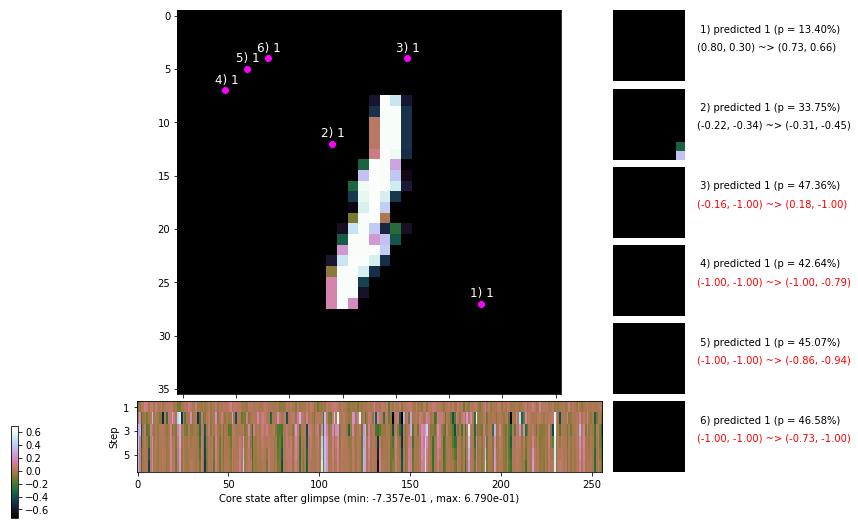

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 156.9 ms/b | lr: 5.86e-04 | grad 2norm: 20.14 | grad inf norm:  6.127
         Weights || abs max:  3.03 ( 2313.11) | mean: -6.93e-04 ( 0.01) | var: 7.46e-02 (  484.54)
          Biases || abs max:  2.50 (  118.82) | mean: -1.15e-01 ( 0.12) | var: 6.37e-02 (  305.31)
                    class loss: 0.911 | steps: 2.999 | reward:  3.417 | acc.: 67.75%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 151.2 ms/b | lr: 5.85e-04 | grad 2norm: 20.51 | grad inf norm:  6.139
         Weights || abs max:  3.03 ( 3117.44) | mean: -7.26e-04 ( 0.01) | var: 7.46e-02 ( 1044.68)
          Biases || abs max:  2.49 (   97.30) | mean: -1.16e-01 ( 0.09) | var: 6.37e-02 (   87.30)
                    class loss: 0.898 | steps: 2.914 | reward:  3.495 | acc.: 68.90%

	Target class: 9 | Discounted rewards: [2.786, 3.095, 3.4

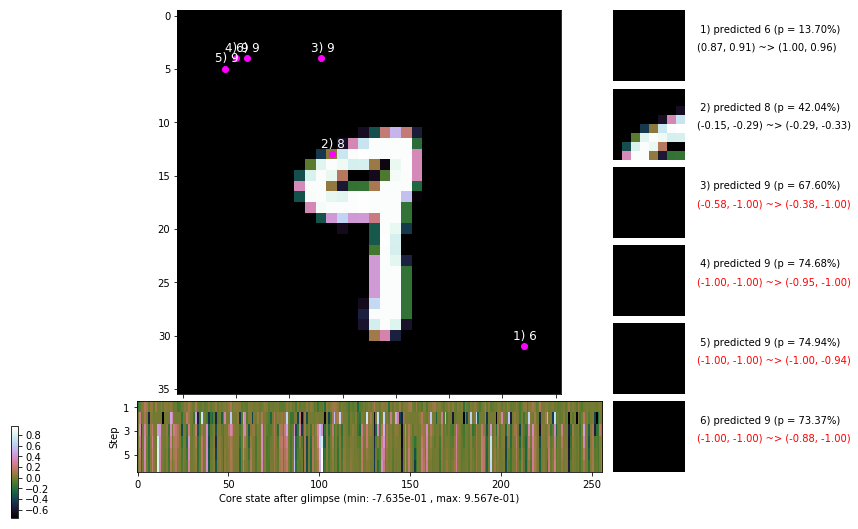

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 156.6 ms/b | lr: 5.84e-04 | grad 2norm: 20.27 | grad inf norm:  5.919
         Weights || abs max:  3.04 ( 1854.11) | mean: -7.21e-04 ( 0.01) | var: 7.47e-02 (  149.43)
          Biases || abs max:  2.50 (  108.75) | mean: -1.16e-01 ( 0.09) | var: 6.39e-02 (   60.48)
                    class loss: 0.894 | steps: 2.951 | reward:  3.485 | acc.: 68.57%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 150.6 ms/b | lr: 5.83e-04 | grad 2norm: 20.36 | grad inf norm:  6.118
         Weights || abs max:  3.06 (  962.31) | mean: -7.31e-04 ( 0.01) | var: 7.48e-02 (   11.69)
          Biases || abs max:  2.50 (   87.65) | mean: -1.16e-01 ( 0.08) | var: 6.40e-02 (   69.24)
                    class loss: 0.918 | steps: 2.975 | reward:  3.410 | acc.: 67.15%

	Target class: 5 | Discounted rewards: [1.900, 1.000, 0.0

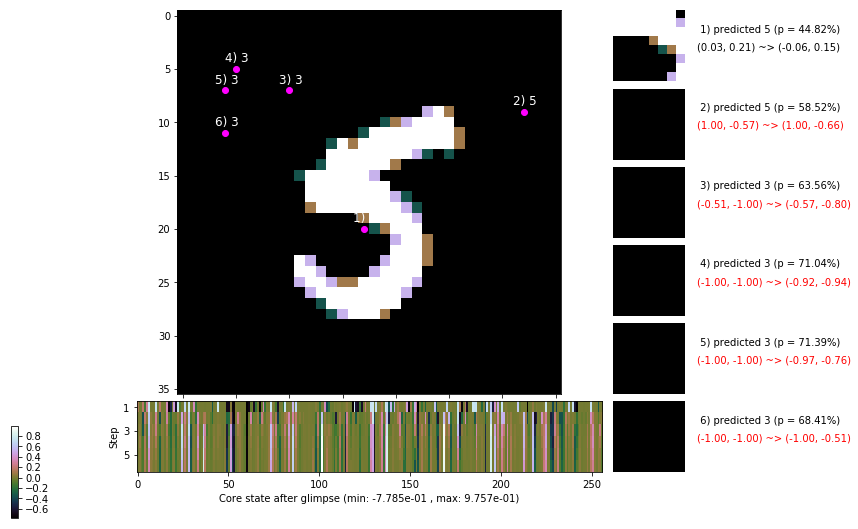

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 9 | Discounted rewards: [3.686, 4.095, 3.439, 2.710, 1.900, 1.000]


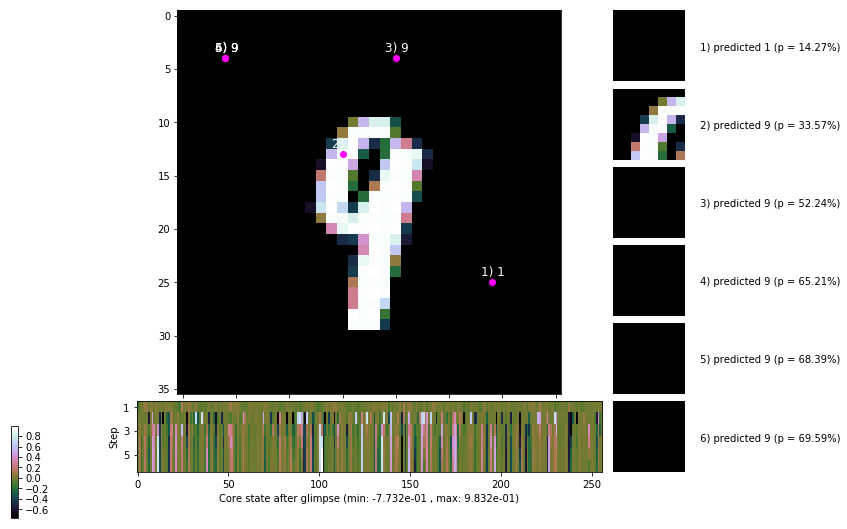


	Target class: 7 | Discounted rewards: [3.686, 4.095, 3.439, 2.710, 1.900, 1.000]


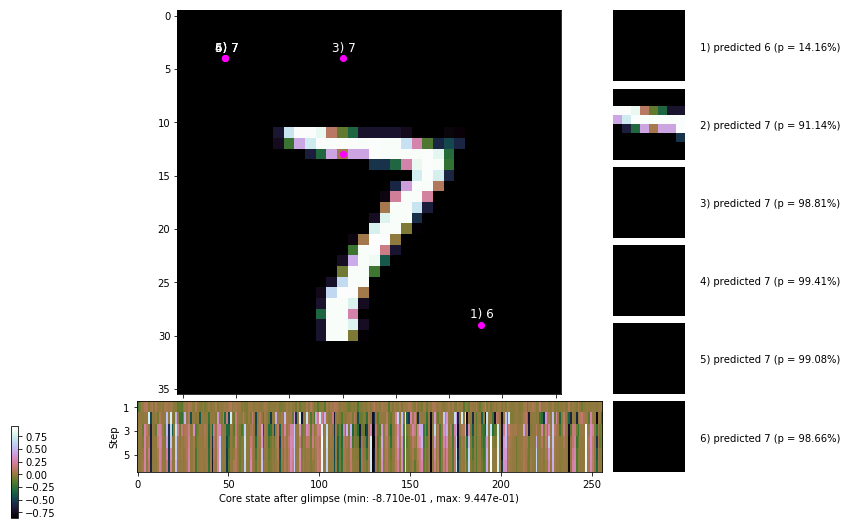

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


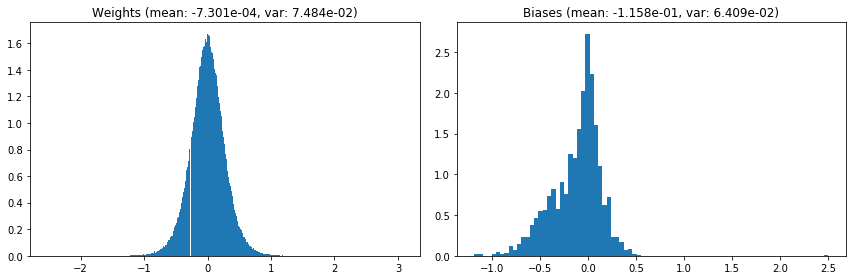

                                      Location network weights and biases


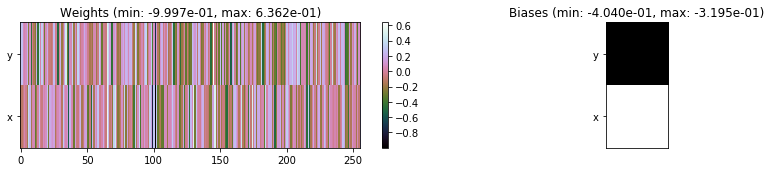

---------------------------------------------------------------------------------------------------------------
Elapsed time:  473.20 sec | TRAIN >> class loss: 0.9165 | steps:  2.967 :( | reward:  3.4446 :( | acc.: 67.712% :(
                          | VAL   >> class loss: 0.8872 | steps:  2.889 :( | reward:  3.5336 :( | acc.: 68.380% :(


Epoch  37/400) lr = 0.0005826
 b    300/  3000 >> 154.2 ms/b | lr: 5.82e-04 | grad 2norm: 20.06 | grad inf norm:  5.775
         Weights || abs max:  3.06 ( 1350.31) | mean: -7.31e-04 ( 0.01) | var: 7.49e-02 (   57.48)
          Biases || abs max:  2.50 (  133.53) | mean: -1.16e-01 ( 0.10) | var: 6.41e-02 (  261.90)
                    class loss: 0.919 | steps: 2.978 | reward:  3.426 | acc.: 67.00%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 154.3 ms/b | lr: 5.81e-04 | grad 2norm: 20.24 | grad inf norm:  6.108
         Weights || abs max:  3.07 ( 4779.80) | mean: -7.24e-04 (

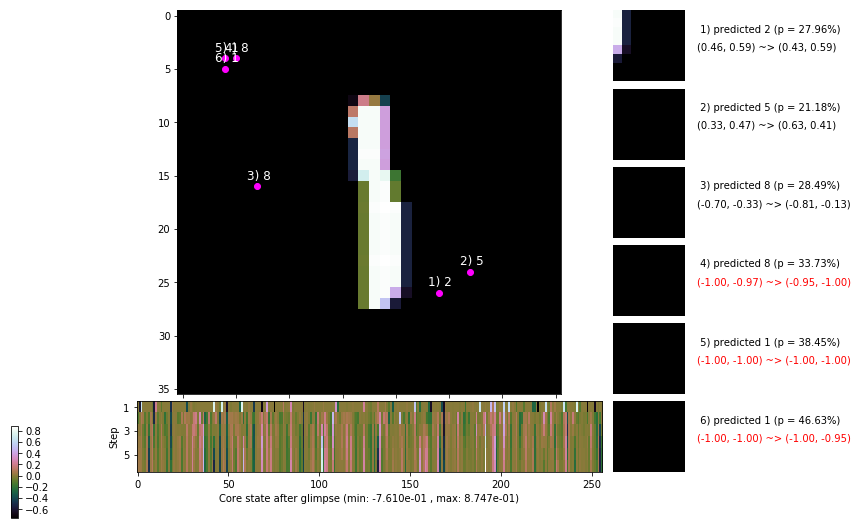

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 155.9 ms/b | lr: 5.80e-04 | grad 2norm: 20.10 | grad inf norm:  6.275
         Weights || abs max:  3.08 ( 1211.97) | mean: -7.07e-04 ( 0.01) | var: 7.51e-02 (   32.78)
          Biases || abs max:  2.51 (  114.61) | mean: -1.16e-01 ( 0.09) | var: 6.39e-02 (  216.78)
                    class loss: 0.901 | steps: 2.927 | reward:  3.468 | acc.: 67.77%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 163.3 ms/b | lr: 5.80e-04 | grad 2norm: 20.08 | grad inf norm:  5.796
         Weights || abs max:  3.08 ( 1209.54) | mean: -6.75e-04 ( 0.01) | var: 7.52e-02 (   72.29)
          Biases || abs max:  2.51 (   99.19) | mean: -1.16e-01 ( 0.09) | var: 6.39e-02 (  139.87)
                    class loss: 0.948 | steps: 2.981 | reward:  3.411 | acc.: 66.50%

	Target class: 5 | Discounted rewards: [1.000, 0.000, 0.0

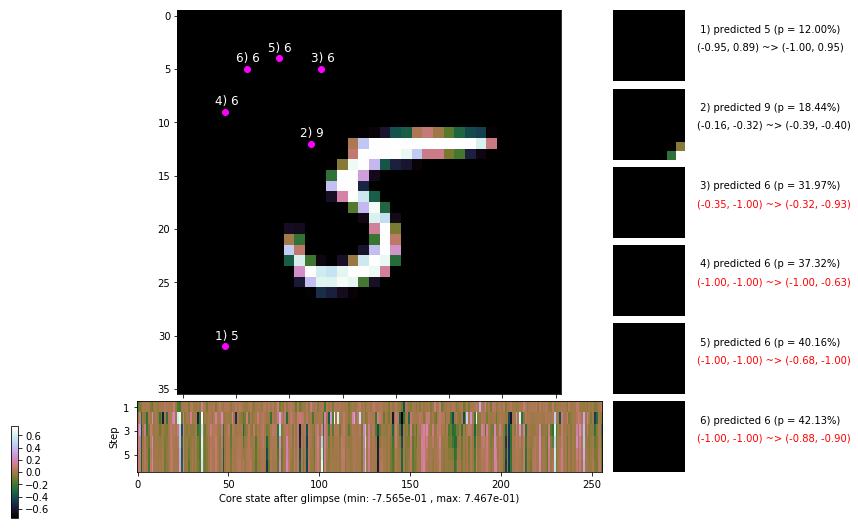

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 160.9 ms/b | lr: 5.79e-04 | grad 2norm: 20.03 | grad inf norm:  5.886
         Weights || abs max:  3.07 (21480.52) | mean: -6.76e-04 ( 0.04) | var: 7.52e-02 (147753.05)
          Biases || abs max:  2.50 (  175.98) | mean: -1.16e-01 ( 0.13) | var: 6.41e-02 (  304.41)
                    class loss: 0.935 | steps: 2.975 | reward:  3.421 | acc.: 67.10%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 164.4 ms/b | lr: 5.78e-04 | grad 2norm: 19.97 | grad inf norm:  5.975
         Weights || abs max:  3.08 ( 1867.90) | mean: -6.53e-04 ( 0.01) | var: 7.53e-02 (  357.76)
          Biases || abs max:  2.51 (  102.79) | mean: -1.16e-01 ( 0.08) | var: 6.41e-02 (  106.66)
                    class loss: 0.913 | steps: 2.963 | reward:  3.462 | acc.: 67.57%

	Target class: 5 | Discounted rewards: [1.247, 1.385, 1.

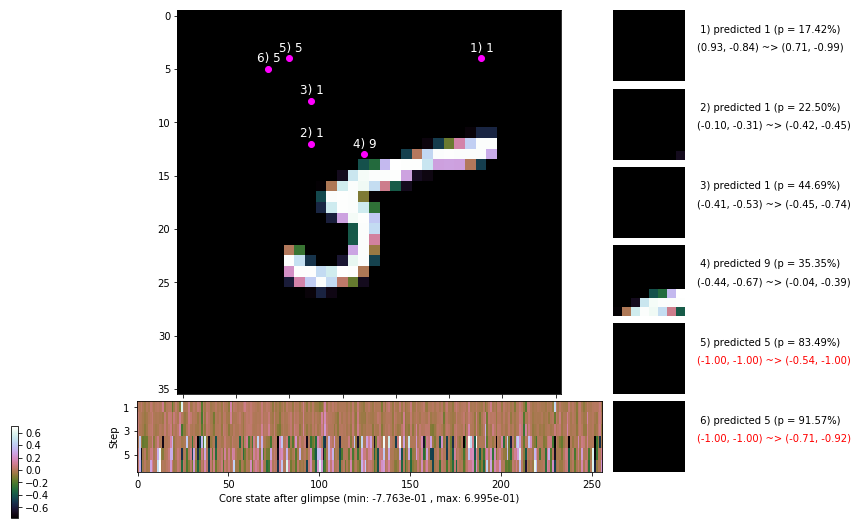

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 164.5 ms/b | lr: 5.77e-04 | grad 2norm: 20.38 | grad inf norm:  5.904
         Weights || abs max:  3.07 ( 1770.95) | mean: -6.70e-04 ( 0.01) | var: 7.54e-02 (  176.37)
          Biases || abs max:  2.51 (   87.91) | mean: -1.16e-01 ( 0.08) | var: 6.41e-02 (   90.19)
                    class loss: 0.897 | steps: 2.947 | reward:  3.456 | acc.: 68.12%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 153.6 ms/b | lr: 5.76e-04 | grad 2norm: 19.94 | grad inf norm:  5.803
         Weights || abs max:  3.08 ( 1417.31) | mean: -6.64e-04 ( 0.01) | var: 7.55e-02 (   56.27)
          Biases || abs max:  2.52 (  104.06) | mean: -1.16e-01 ( 0.09) | var: 6.42e-02 (   37.76)
                    class loss: 0.920 | steps: 2.943 | reward:  3.455 | acc.: 67.53%

	Target class: 6 | Discounted rewards: [2.786, 3.095, 3.4

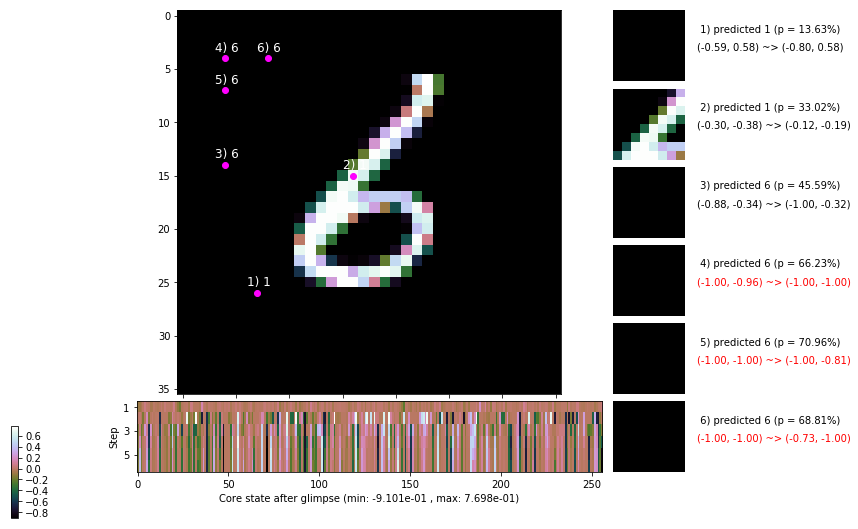

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 157.0 ms/b | lr: 5.75e-04 | grad 2norm: 20.46 | grad inf norm:  6.249
         Weights || abs max:  3.08 ( 1035.26) | mean: -6.88e-04 ( 0.01) | var: 7.56e-02 (   22.29)
          Biases || abs max:  2.52 (  833.18) | mean: -1.16e-01 ( 0.38) | var: 6.43e-02 (38099.60)
                    class loss: 0.916 | steps: 2.971 | reward:  3.449 | acc.: 67.80%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 154.3 ms/b | lr: 5.74e-04 | grad 2norm: 20.38 | grad inf norm:  5.996
         Weights || abs max:  3.08 ( 2596.08) | mean: -7.05e-04 ( 0.01) | var: 7.57e-02 (  379.80)
          Biases || abs max:  2.51 (  121.40) | mean: -1.17e-01 ( 0.10) | var: 6.45e-02 (  170.80)
                    class loss: 0.961 | steps: 3.007 | reward:  3.388 | acc.: 65.93%

	Target class: 6 | Discounted rewards: [2.786, 3.095, 3.4

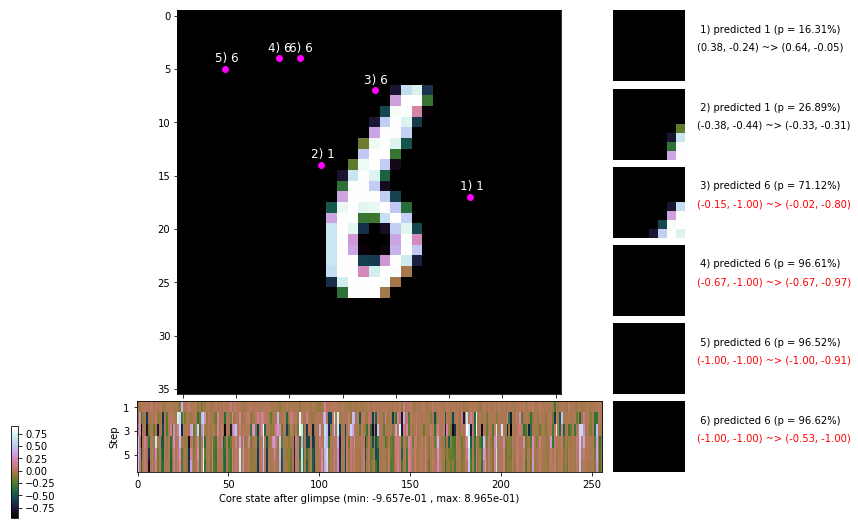

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 1 | Discounted rewards: [4.686, 4.095, 3.439, 2.710, 1.900, 1.000]


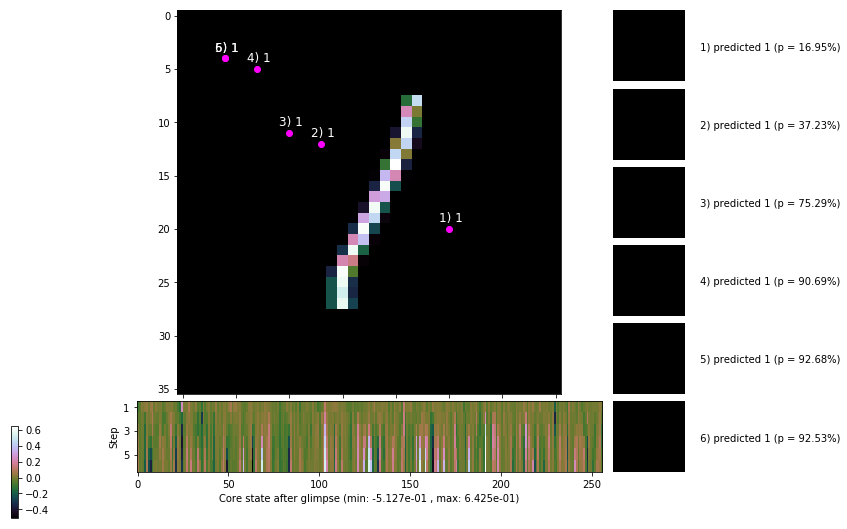


	Target class: 1 | Discounted rewards: [3.686, 4.095, 3.439, 2.710, 1.900, 1.000]


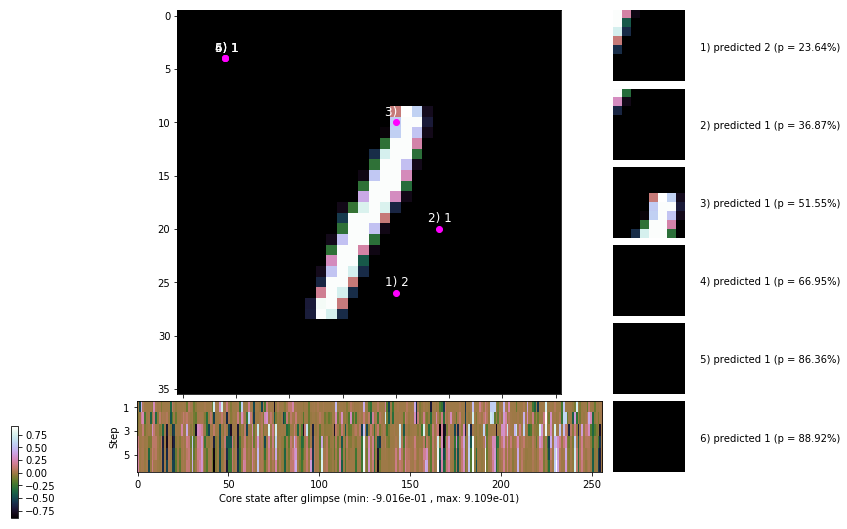

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


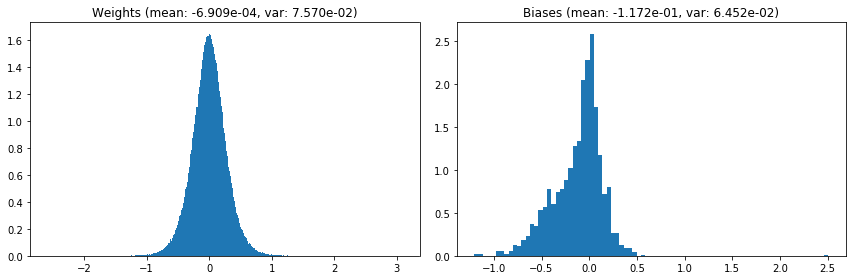

                                      Location network weights and biases


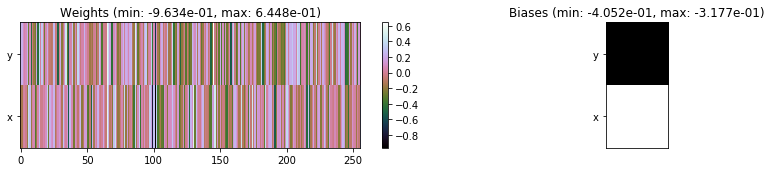

---------------------------------------------------------------------------------------------------------------
Elapsed time:  475.29 sec | TRAIN >> class loss: 0.9243 | steps:  2.966 :( | reward:  3.4375 :( | acc.: 67.250% :(
                          | VAL   >> class loss: 0.9132 | steps:  2.881 :( | reward:  3.5218 :( | acc.: 67.760% :(


Epoch  38/400) lr = 0.0005739
 b    300/  3000 >> 154.5 ms/b | lr: 5.73e-04 | grad 2norm: 19.86 | grad inf norm:  5.969
         Weights || abs max:  3.09 ( 3186.43) | mean: -6.87e-04 ( 0.01) | var: 7.57e-02 (  972.71)
          Biases || abs max:  2.51 (   90.61) | mean: -1.17e-01 ( 0.09) | var: 6.45e-02 (   16.37)
                    class loss: 0.918 | steps: 2.947 | reward:  3.440 | acc.: 66.87%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 155.0 ms/b | lr: 5.73e-04 | grad 2norm: 20.10 | grad inf norm:  6.198
         Weights || abs max:  3.08 ( 1910.60) | mean: -6.89e-04 (

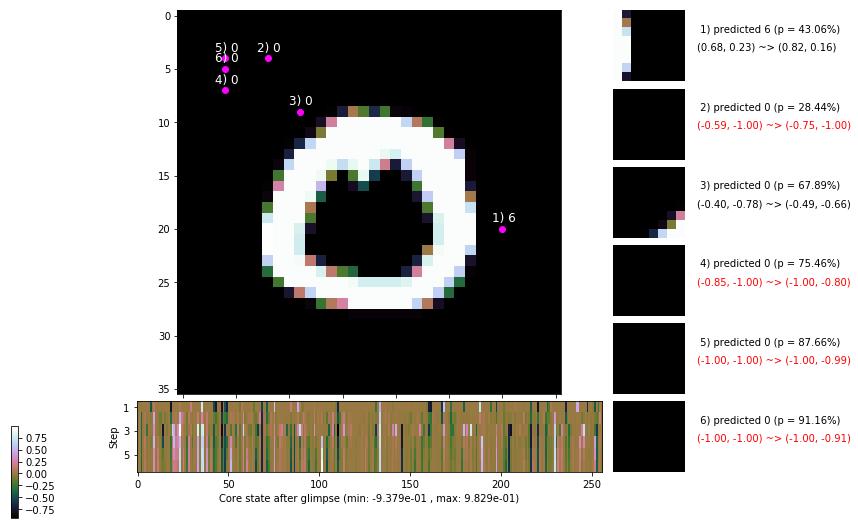

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 155.0 ms/b | lr: 5.72e-04 | grad 2norm: 19.72 | grad inf norm:  5.620
         Weights || abs max:  3.08 ( 1516.26) | mean: -6.81e-04 ( 0.01) | var: 7.59e-02 (   38.92)
          Biases || abs max:  2.50 (   89.55) | mean: -1.17e-01 ( 0.08) | var: 6.45e-02 (  152.04)
                    class loss: 0.916 | steps: 2.938 | reward:  3.465 | acc.: 68.08%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 154.8 ms/b | lr: 5.71e-04 | grad 2norm: 20.03 | grad inf norm:  5.987
         Weights || abs max:  3.08 ( 1459.56) | mean: -6.67e-04 ( 0.01) | var: 7.60e-02 (   43.20)
          Biases || abs max:  2.50 (  122.90) | mean: -1.17e-01 ( 0.11) | var: 6.46e-02 (  117.80)
                    class loss: 0.943 | steps: 2.996 | reward:  3.393 | acc.: 66.77%

	Target class: 5 | Discounted rewards: [1.976, 2.195, 2.4

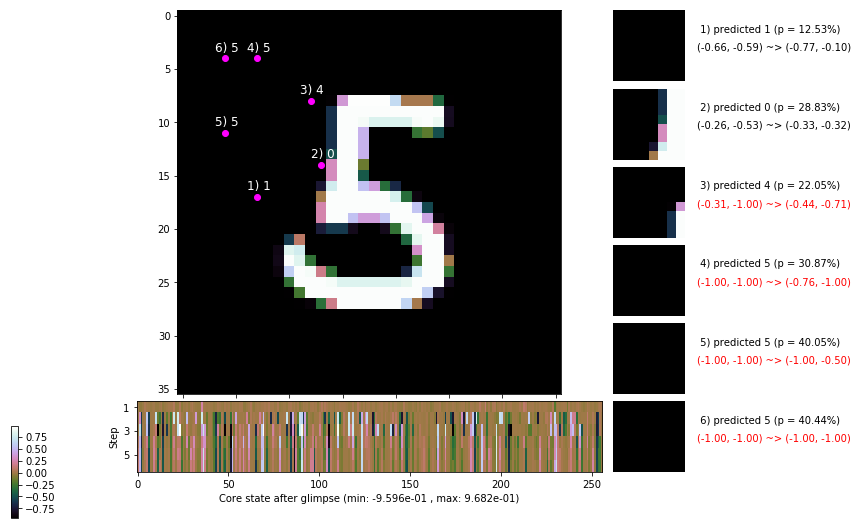

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 154.1 ms/b | lr: 5.70e-04 | grad 2norm: 20.13 | grad inf norm:  5.983
         Weights || abs max:  3.09 ( 2243.86) | mean: -6.83e-04 ( 0.01) | var: 7.61e-02 (   67.82)
          Biases || abs max:  2.49 (  115.50) | mean: -1.17e-01 ( 0.10) | var: 6.47e-02 (   78.69)
                    class loss: 0.918 | steps: 2.930 | reward:  3.453 | acc.: 67.53%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 152.7 ms/b | lr: 5.69e-04 | grad 2norm: 19.83 | grad inf norm:  5.931
         Weights || abs max:  3.11 ( 4180.95) | mean: -6.73e-04 ( 0.01) | var: 7.62e-02 ( 3284.90)
          Biases || abs max:  2.49 (  112.89) | mean: -1.17e-01 ( 0.10) | var: 6.45e-02 (  100.43)
                    class loss: 0.933 | steps: 2.982 | reward:  3.414 | acc.: 66.77%

	Target class: 6 | Discounted rewards: [1.000, 0.000, 0.0

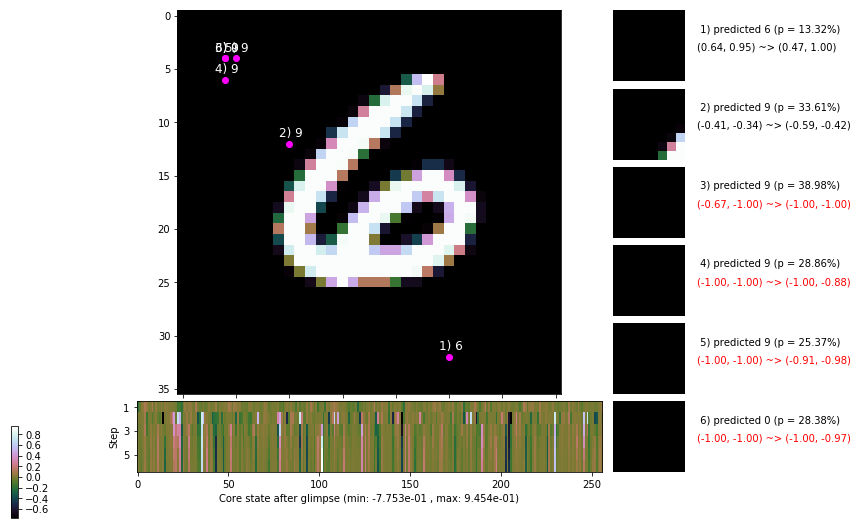

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 164.1 ms/b | lr: 5.68e-04 | grad 2norm: 19.70 | grad inf norm:  5.825
         Weights || abs max:  3.11 ( 1442.17) | mean: -6.52e-04 ( 0.01) | var: 7.63e-02 (   20.32)
          Biases || abs max:  2.48 (  116.10) | mean: -1.17e-01 ( 0.10) | var: 6.46e-02 (  114.41)
                    class loss: 0.946 | steps: 2.983 | reward:  3.397 | acc.: 66.37%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 163.1 ms/b | lr: 5.68e-04 | grad 2norm: 19.90 | grad inf norm:  5.821
         Weights || abs max:  3.11 ( 2064.42) | mean: -6.76e-04 ( 0.01) | var: 7.63e-02 (   94.15)
          Biases || abs max:  2.48 (   75.35) | mean: -1.17e-01 ( 0.08) | var: 6.47e-02 (   32.35)
                    class loss: 0.926 | steps: 2.965 | reward:  3.433 | acc.: 67.40%

	Target class: 6 | Discounted rewards: [1.976, 2.195, 2.4

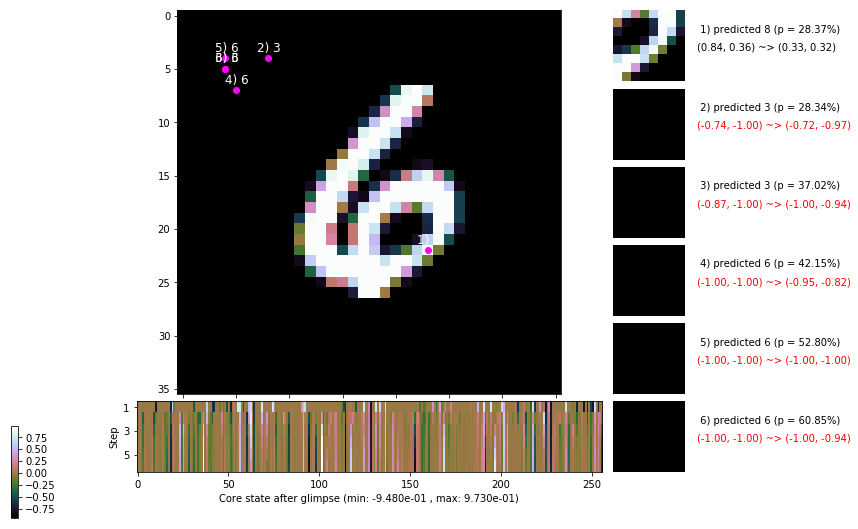

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 165.9 ms/b | lr: 5.66e-04 | grad 2norm: 19.93 | grad inf norm:  6.027
         Weights || abs max:  3.11 ( 1201.63) | mean: -6.84e-04 ( 0.01) | var: 7.64e-02 (   21.80)
          Biases || abs max:  2.50 (  150.10) | mean: -1.17e-01 ( 0.11) | var: 6.49e-02 (  718.76)
                    class loss: 0.890 | steps: 2.931 | reward:  3.503 | acc.: 69.15%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 159.3 ms/b | lr: 5.66e-04 | grad 2norm: 19.57 | grad inf norm:  5.706
         Weights || abs max:  3.11 ( 3037.89) | mean: -6.67e-04 ( 0.01) | var: 7.65e-02 ( 1001.64)
          Biases || abs max:  2.51 (  132.39) | mean: -1.17e-01 ( 0.11) | var: 6.50e-02 (  106.22)
                    class loss: 0.866 | steps: 2.894 | reward:  3.531 | acc.: 69.28%

	Target class: 2 | Discounted rewards: [0.000, 0.000, 0.0

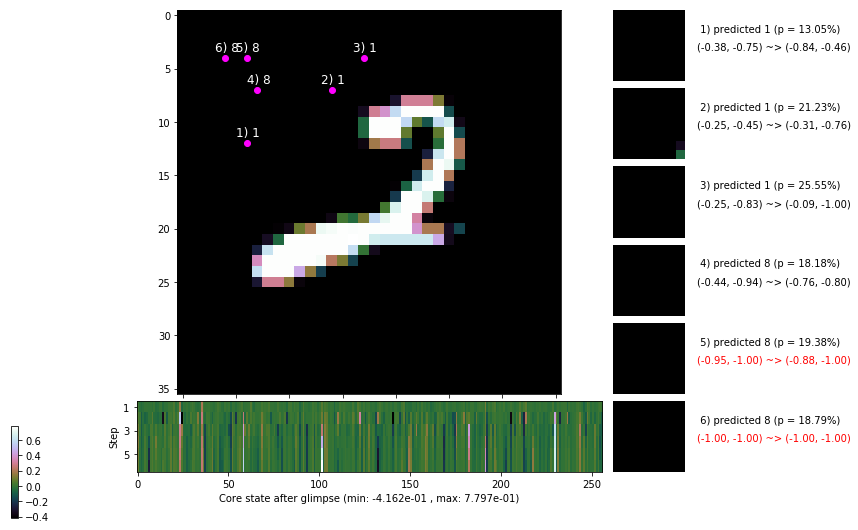

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 7 | Discounted rewards: [1.000, 0.000, 0.000, 0.000, 0.000, 0.000]


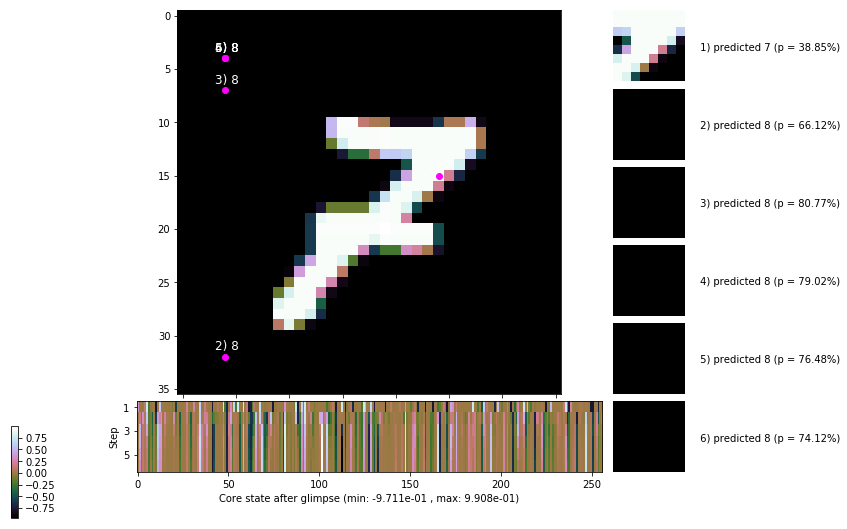


	Target class: 2 | Discounted rewards: [0.000, 0.000, 0.000, 0.000, 0.000, 0.000]


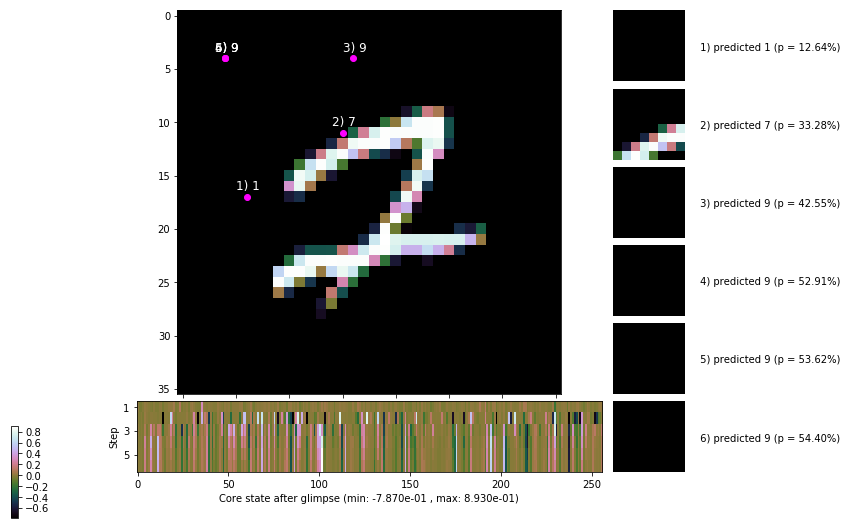

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


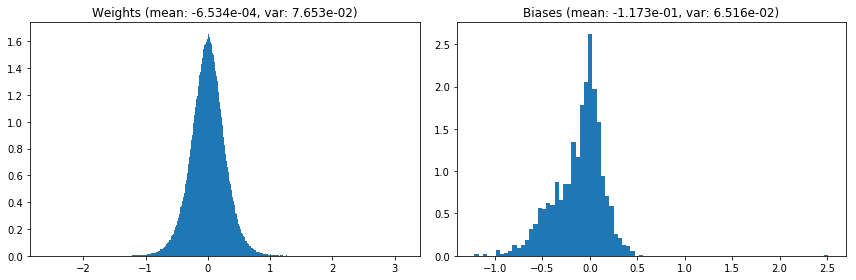

                                      Location network weights and biases


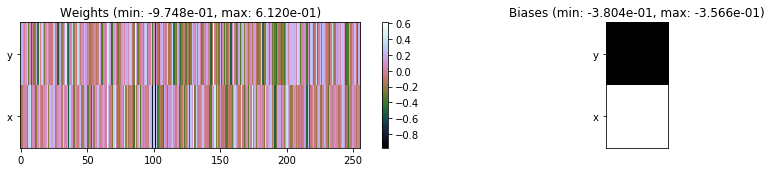

---------------------------------------------------------------------------------------------------------------
Elapsed time:  474.31 sec | TRAIN >> class loss: 0.9204 | steps:  2.956 :( | reward:  3.4416 :( | acc.: 67.452% :(
                          | VAL   >> class loss: 0.9016 | steps:  2.910 :( | reward:  3.5162 :( | acc.: 67.780% :(


Epoch  39/400) lr = 0.0005654
 b    300/  3000 >> 153.5 ms/b | lr: 5.65e-04 | grad 2norm: 20.14 | grad inf norm:  6.143
         Weights || abs max:  3.12 ( 1920.70) | mean: -6.54e-04 ( 0.01) | var: 7.66e-02 (   49.17)
          Biases || abs max:  2.51 (  243.32) | mean: -1.17e-01 ( 0.16) | var: 6.51e-02 (  597.62)
                    class loss: 0.927 | steps: 2.994 | reward:  3.437 | acc.: 67.50%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 154.3 ms/b | lr: 5.64e-04 | grad 2norm: 19.83 | grad inf norm:  5.815
         Weights || abs max:  3.11 ( 1834.91) | mean: -6.54e-04 (

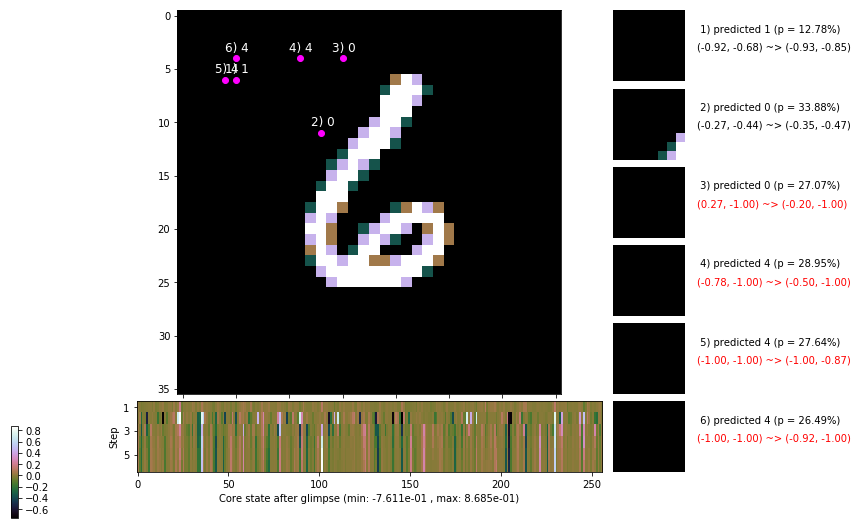

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 156.6 ms/b | lr: 5.63e-04 | grad 2norm: 20.14 | grad inf norm:  6.089
         Weights || abs max:  3.12 ( 1662.08) | mean: -6.68e-04 ( 0.01) | var: 7.67e-02 (   46.14)
          Biases || abs max:  2.51 (  144.87) | mean: -1.18e-01 ( 0.11) | var: 6.52e-02 (  297.32)
                    class loss: 0.917 | steps: 2.962 | reward:  3.438 | acc.: 67.67%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 154.1 ms/b | lr: 5.63e-04 | grad 2norm: 20.29 | grad inf norm:  5.999
         Weights || abs max:  3.13 ( 1775.63) | mean: -6.59e-04 ( 0.01) | var: 7.68e-02 (  181.17)
          Biases || abs max:  2.51 (   67.72) | mean: -1.18e-01 ( 0.07) | var: 6.53e-02 (   19.85)
                    class loss: 0.884 | steps: 2.930 | reward:  3.476 | acc.: 68.20%

	Target class: 3 | Discounted rewards: [3.686, 4.095, 3.4

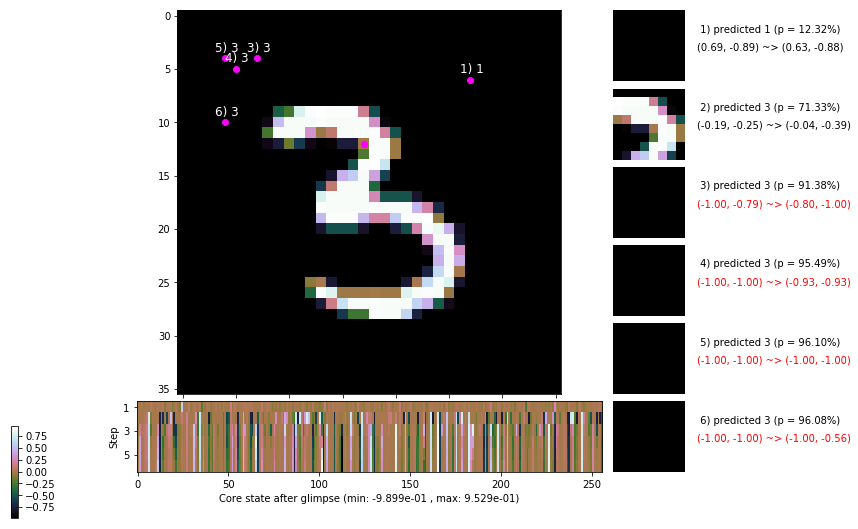

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 154.6 ms/b | lr: 5.61e-04 | grad 2norm: 20.03 | grad inf norm:  5.916
         Weights || abs max:  3.14 ( 1487.33) | mean: -6.38e-04 ( 0.01) | var: 7.69e-02 (   28.87)
          Biases || abs max:  2.51 (   61.94) | mean: -1.18e-01 ( 0.08) | var: 6.52e-02 (   21.39)
                    class loss: 0.891 | steps: 2.928 | reward:  3.478 | acc.: 68.35%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 153.5 ms/b | lr: 5.61e-04 | grad 2norm: 20.35 | grad inf norm:  6.146
         Weights || abs max:  3.13 ( 1507.01) | mean: -6.31e-04 ( 0.01) | var: 7.70e-02 (   50.92)
          Biases || abs max:  2.51 (  138.92) | mean: -1.18e-01 ( 0.11) | var: 6.54e-02 (  212.05)
                    class loss: 0.916 | steps: 2.944 | reward:  3.478 | acc.: 67.57%

	Target class: 3 | Discounted rewards: [4.686, 4.095, 3.4

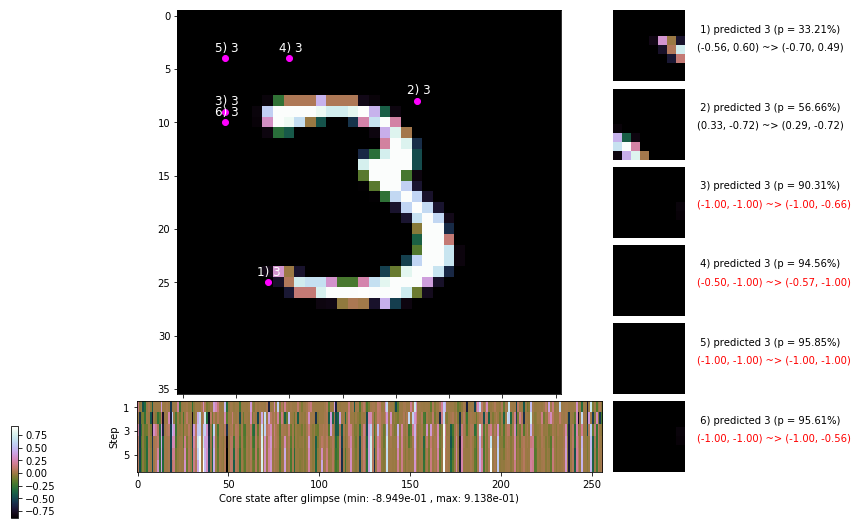

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 157.4 ms/b | lr: 5.60e-04 | grad 2norm: 19.57 | grad inf norm:  5.518
         Weights || abs max:  3.14 ( 1939.13) | mean: -6.50e-04 ( 0.01) | var: 7.71e-02 (  130.50)
          Biases || abs max:  2.50 (  177.80) | mean: -1.18e-01 ( 0.11) | var: 6.53e-02 (  709.28)
                    class loss: 0.909 | steps: 2.969 | reward:  3.433 | acc.: 67.32%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 152.3 ms/b | lr: 5.59e-04 | grad 2norm: 20.01 | grad inf norm:  5.987
         Weights || abs max:  3.14 ( 1984.01) | mean: -6.22e-04 ( 0.01) | var: 7.72e-02 (  446.53)
          Biases || abs max:  2.51 (   87.89) | mean: -1.18e-01 ( 0.08) | var: 6.52e-02 (   43.53)
                    class loss: 0.906 | steps: 2.948 | reward:  3.475 | acc.: 68.12%

	Target class: 0 | Discounted rewards: [0.000, 0.000, 0.0

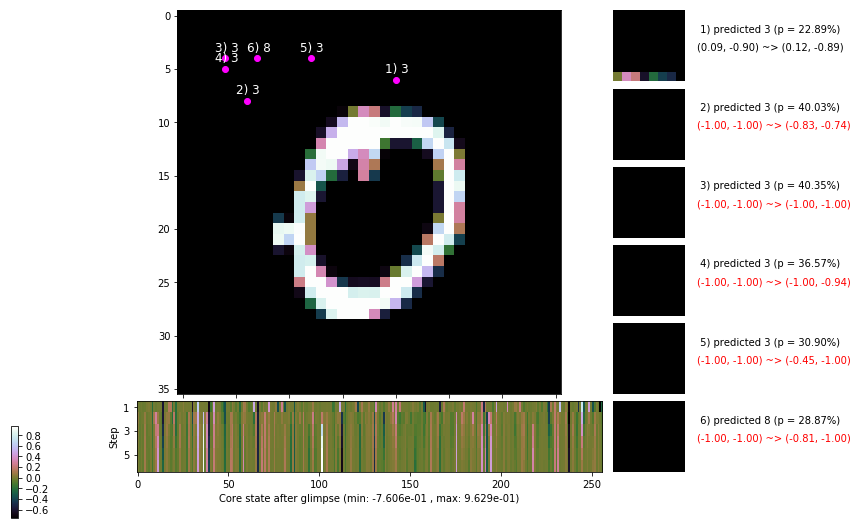

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 165.0 ms/b | lr: 5.58e-04 | grad 2norm: 19.77 | grad inf norm:  5.710
         Weights || abs max:  3.15 ( 2596.57) | mean: -6.34e-04 ( 0.01) | var: 7.72e-02 (  326.64)
          Biases || abs max:  2.51 (   83.14) | mean: -1.18e-01 ( 0.08) | var: 6.54e-02 (   97.09)
                    class loss: 0.913 | steps: 2.946 | reward:  3.474 | acc.: 67.83%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 156.9 ms/b | lr: 5.58e-04 | grad 2norm: 19.25 | grad inf norm:  5.799
         Weights || abs max:  3.15 ( 1200.58) | mean: -6.62e-04 ( 0.01) | var: 7.73e-02 (   17.86)
          Biases || abs max:  2.51 (   86.17) | mean: -1.19e-01 ( 0.09) | var: 6.55e-02 (   57.40)
                    class loss: 0.911 | steps: 2.982 | reward:  3.453 | acc.: 67.82%

	Target class: 5 | Discounted rewards: [2.195, 2.439, 2.7

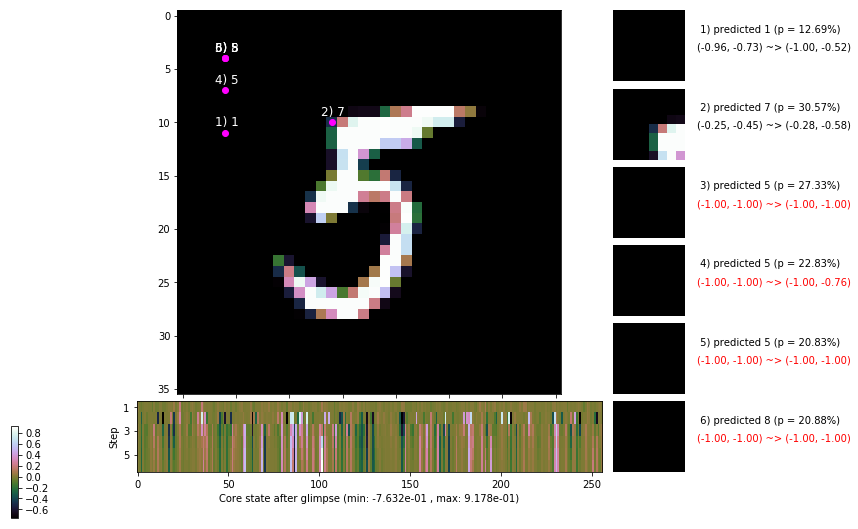

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 2 | Discounted rewards: [3.686, 4.095, 3.439, 2.710, 1.900, 1.000]


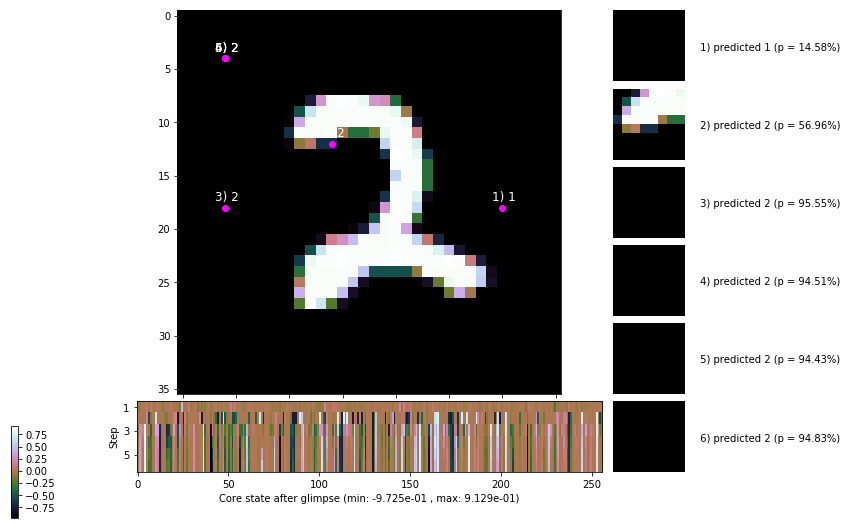


	Target class: 2 | Discounted rewards: [1.000, 0.000, 0.000, 0.000, 0.000, 0.000]


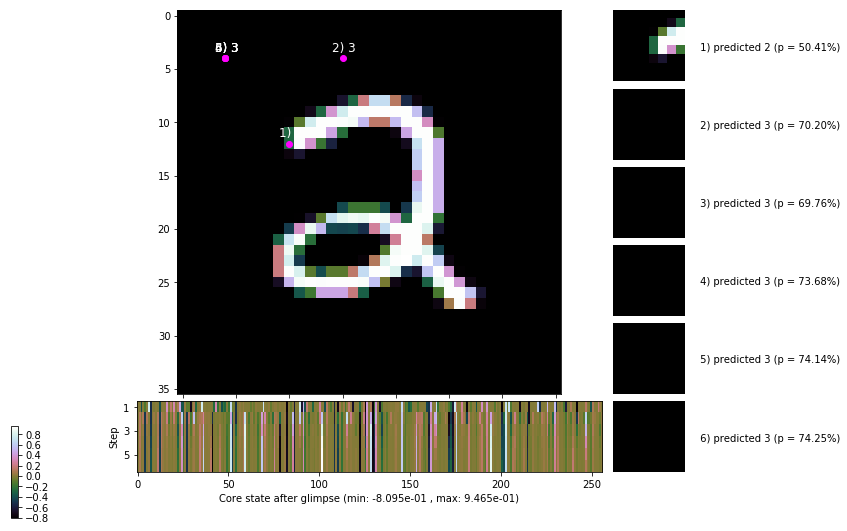

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


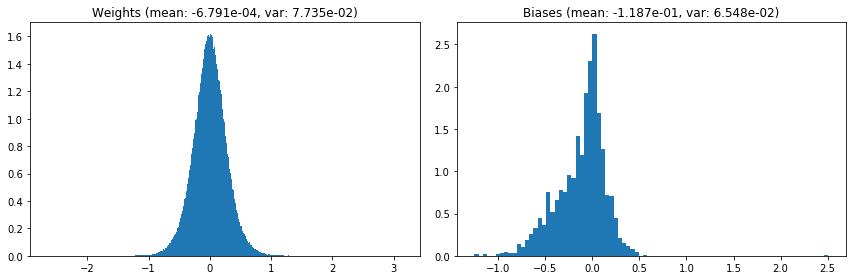

                                      Location network weights and biases


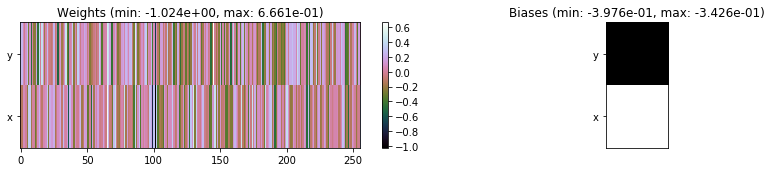

---------------------------------------------------------------------------------------------------------------
Elapsed time:  468.15 sec | TRAIN >> class loss: 0.9064 | steps:  2.953 :( | reward:  3.4623 :( | acc.: 67.820% :(
                          | VAL   >> class loss: 0.9136 | steps:  2.935 :( | reward:  3.4688 :( | acc.: 66.640% :(


Epoch  40/400) lr = 0.0005569
 b    300/  3000 >> 162.8 ms/b | lr: 5.56e-04 | grad 2norm: 19.62 | grad inf norm:  5.860
         Weights || abs max:  3.14 ( 2144.61) | mean: -6.56e-04 ( 0.01) | var: 7.74e-02 (  168.31)
          Biases || abs max:  2.50 (  145.16) | mean: -1.19e-01 ( 0.11) | var: 6.56e-02 (  295.23)
                    class loss: 0.943 | steps: 3.010 | reward:  3.407 | acc.: 67.15%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 160.4 ms/b | lr: 5.56e-04 | grad 2norm: 19.86 | grad inf norm:  6.201
         Weights || abs max:  3.14 ( 1433.10) | mean: -6.14e-04 (

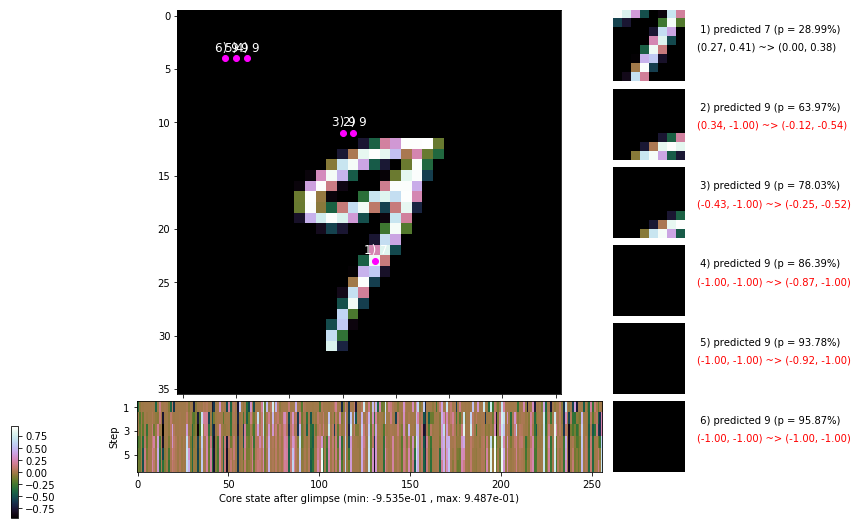

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 154.9 ms/b | lr: 5.55e-04 | grad 2norm: 19.89 | grad inf norm:  5.900
         Weights || abs max:  3.13 ( 2612.31) | mean: -6.32e-04 ( 0.01) | var: 7.76e-02 (  291.86)
          Biases || abs max:  2.50 (  148.97) | mean: -1.18e-01 ( 0.12) | var: 6.57e-02 (  260.74)
                    class loss: 0.938 | steps: 3.004 | reward:  3.417 | acc.: 66.78%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 155.2 ms/b | lr: 5.54e-04 | grad 2norm: 19.91 | grad inf norm:  6.103
         Weights || abs max:  3.14 ( 6124.41) | mean: -6.57e-04 ( 0.02) | var: 7.76e-02 (10719.42)
          Biases || abs max:  2.50 (  178.79) | mean: -1.18e-01 ( 0.12) | var: 6.58e-02 (  974.36)
                    class loss: 0.907 | steps: 2.947 | reward:  3.449 | acc.: 67.40%

	Target class: 7 | Discounted rewards: [0.590, 0.656, 0.7

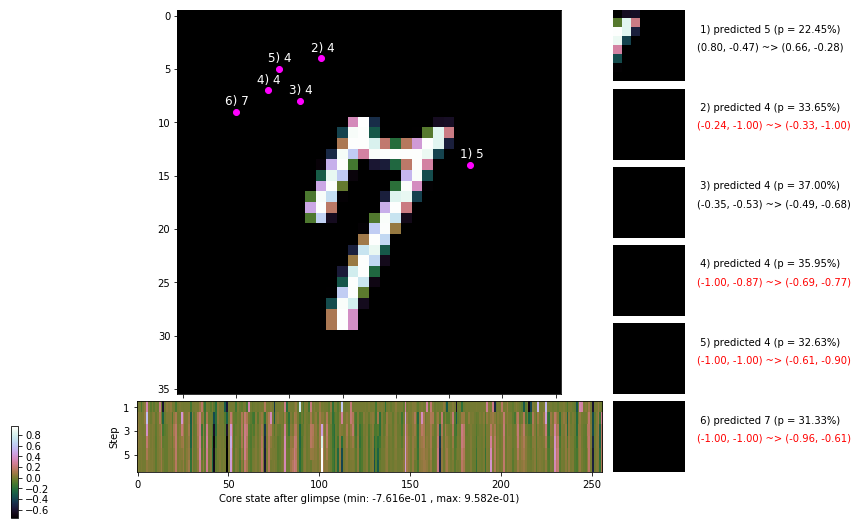

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 156.1 ms/b | lr: 5.53e-04 | grad 2norm: 19.86 | grad inf norm:  5.826
         Weights || abs max:  3.13 ( 3593.34) | mean: -6.26e-04 ( 0.01) | var: 7.77e-02 ( 1160.26)
          Biases || abs max:  2.50 (  290.01) | mean: -1.18e-01 ( 0.17) | var: 6.58e-02 ( 2991.69)
                    class loss: 0.879 | steps: 2.936 | reward:  3.509 | acc.: 69.00%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 152.4 ms/b | lr: 5.53e-04 | grad 2norm: 19.93 | grad inf norm:  5.938
         Weights || abs max:  3.14 ( 1544.53) | mean: -6.32e-04 ( 0.01) | var: 7.78e-02 (   29.50)
          Biases || abs max:  2.51 ( 4715.81) | mean: -1.18e-01 ( 1.90) | var: 6.58e-02 (2285459.25)
                    class loss: 0.907 | steps: 2.921 | reward:  3.506 | acc.: 68.70%

	Target class: 8 | Discounted rewards: [3.686, 4.095, 3

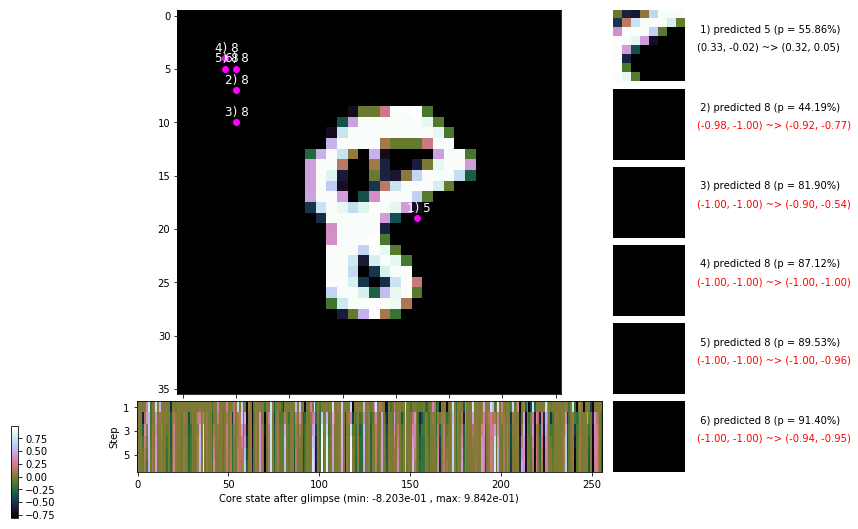

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 155.3 ms/b | lr: 5.51e-04 | grad 2norm: 19.65 | grad inf norm:  5.736
         Weights || abs max:  3.15 ( 1387.60) | mean: -6.35e-04 ( 0.01) | var: 7.79e-02 (   45.35)
          Biases || abs max:  2.51 (  146.06) | mean: -1.19e-01 ( 0.12) | var: 6.59e-02 (  150.38)
                    class loss: 0.904 | steps: 2.925 | reward:  3.475 | acc.: 68.08%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 151.4 ms/b | lr: 5.51e-04 | grad 2norm: 20.00 | grad inf norm:  5.763
         Weights || abs max:  3.15 (24205.77) | mean: -6.38e-04 ( 0.05) | var: 7.80e-02 (263193.91)
          Biases || abs max:  2.50 (   87.54) | mean: -1.18e-01 ( 0.09) | var: 6.58e-02 (   57.02)
                    class loss: 0.902 | steps: 2.956 | reward:  3.443 | acc.: 67.88%

	Target class: 7 | Discounted rewards: [4.686, 4.095, 3.

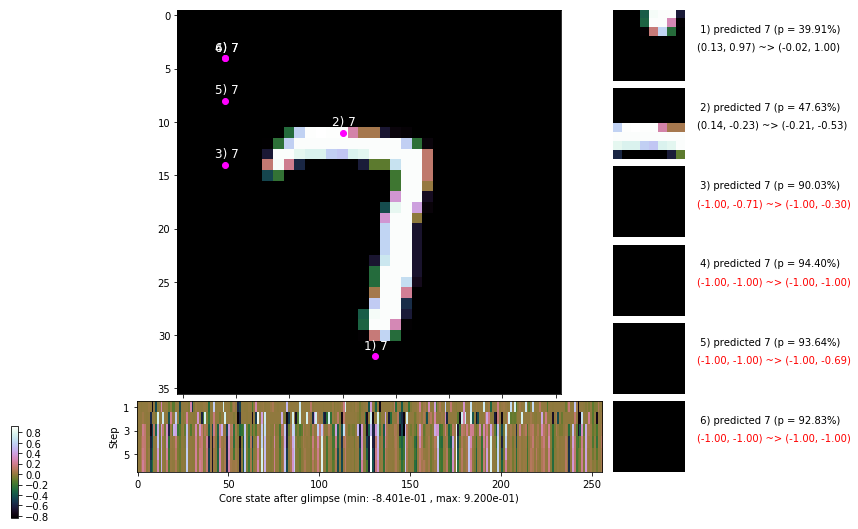

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 155.3 ms/b | lr: 5.50e-04 | grad 2norm: 19.83 | grad inf norm:  5.724
         Weights || abs max:  3.15 (15967.19) | mean: -6.50e-04 ( 0.03) | var: 7.81e-02 (106450.78)
          Biases || abs max:  2.49 (  124.51) | mean: -1.18e-01 ( 0.10) | var: 6.59e-02 (   58.21)
                    class loss: 0.908 | steps: 2.971 | reward:  3.431 | acc.: 67.53%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 152.1 ms/b | lr: 5.49e-04 | grad 2norm: 20.35 | grad inf norm:  6.233
         Weights || abs max:  3.14 ( 9538.82) | mean: -6.45e-04 ( 0.02) | var: 7.82e-02 (39083.50)
          Biases || abs max:  2.50 (   93.81) | mean: -1.18e-01 ( 0.08) | var: 6.60e-02 (   77.04)
                    class loss: 0.882 | steps: 2.948 | reward:  3.479 | acc.: 68.38%

	Target class: 1 | Discounted rewards: [4.686, 4.095, 3.

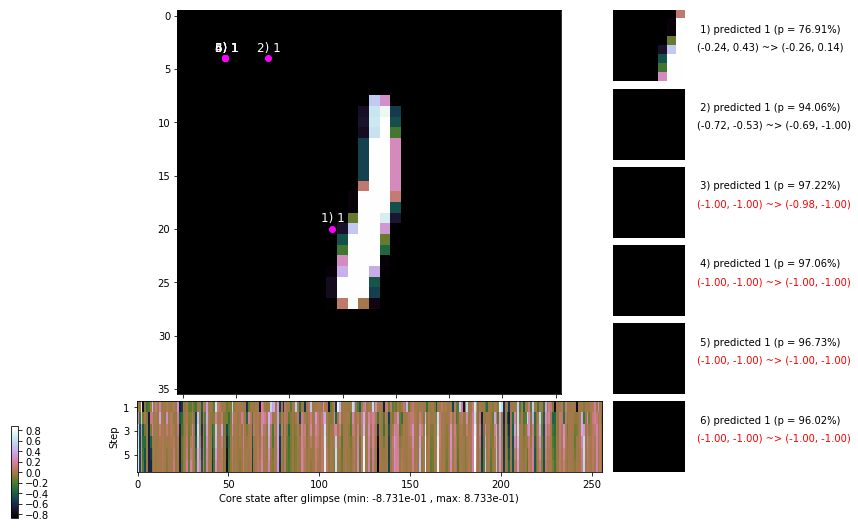

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 3 | Discounted rewards: [3.686, 4.095, 3.439, 2.710, 1.900, 1.000]


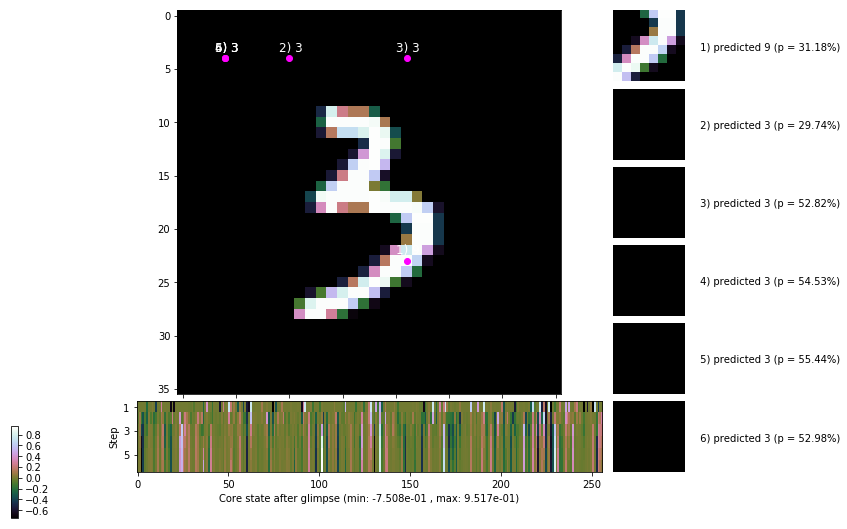


	Target class: 3 | Discounted rewards: [3.686, 4.095, 3.439, 2.710, 1.900, 1.000]


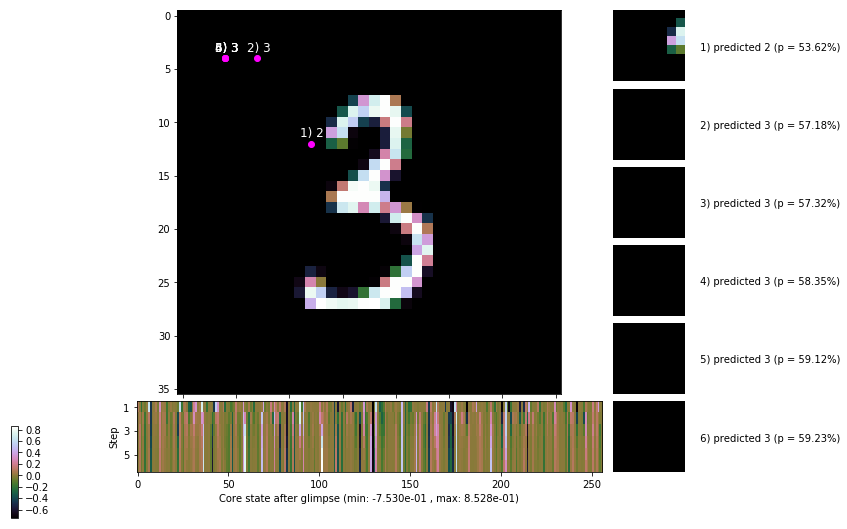

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


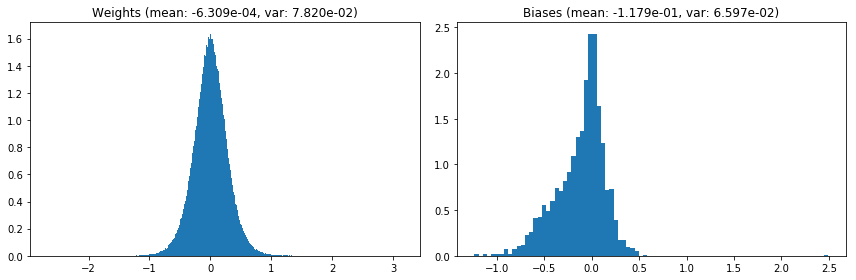

                                      Location network weights and biases


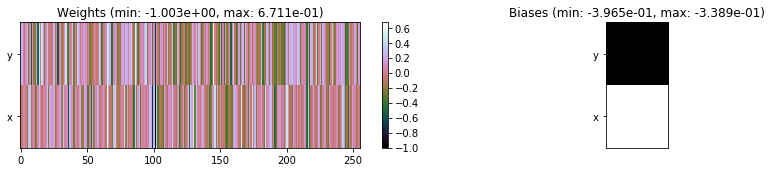

---------------------------------------------------------------------------------------------------------------
Elapsed time:  467.51 sec | TRAIN >> class loss: 0.9065 | steps:  2.956 :( | reward:  3.4610 :( | acc.: 67.945% :(
                          | VAL   >> class loss: 0.8907 | steps:  2.825 :( | reward:  3.6066 :( | acc.: 69.140% :(


Epoch  41/400) lr = 0.0005486
 b    300/  3000 >> 156.4 ms/b | lr: 5.48e-04 | grad 2norm: 20.05 | grad inf norm:  5.991
         Weights || abs max:  3.15 ( 1490.38) | mean: -6.11e-04 ( 0.01) | var: 7.82e-02 (   40.77)
          Biases || abs max:  2.49 (   88.09) | mean: -1.18e-01 ( 0.08) | var: 6.61e-02 (   28.77)
                    class loss: 0.879 | steps: 2.918 | reward:  3.514 | acc.: 69.00%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 158.7 ms/b | lr: 5.48e-04 | grad 2norm: 19.77 | grad inf norm:  5.672
         Weights || abs max:  3.15 ( 7891.19) | mean: -6.24e-04 (

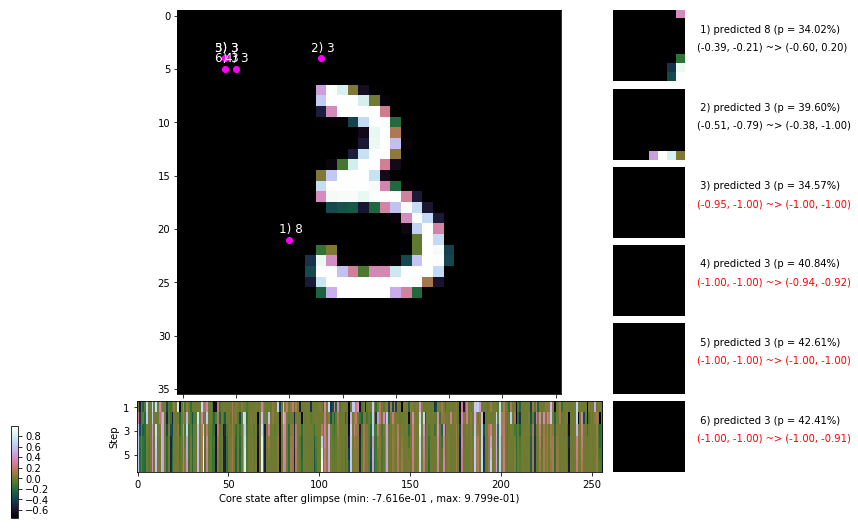

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 167.5 ms/b | lr: 5.46e-04 | grad 2norm: 19.75 | grad inf norm:  5.657
         Weights || abs max:  3.14 ( 4058.36) | mean: -6.04e-04 ( 0.01) | var: 7.84e-02 ( 3496.87)
          Biases || abs max:  2.50 (   66.66) | mean: -1.19e-01 ( 0.07) | var: 6.64e-02 (   36.98)
                    class loss: 0.882 | steps: 2.932 | reward:  3.494 | acc.: 69.03%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 163.3 ms/b | lr: 5.46e-04 | grad 2norm: 20.07 | grad inf norm:  5.900
         Weights || abs max:  3.15 ( 1808.78) | mean: -5.63e-04 ( 0.01) | var: 7.85e-02 (  225.41)
          Biases || abs max:  2.50 (   63.13) | mean: -1.18e-01 ( 0.07) | var: 6.64e-02 (   24.92)
                    class loss: 0.882 | steps: 2.907 | reward:  3.499 | acc.: 68.95%

	Target class: 9 | Discounted rewards: [2.786, 3.095, 3.4

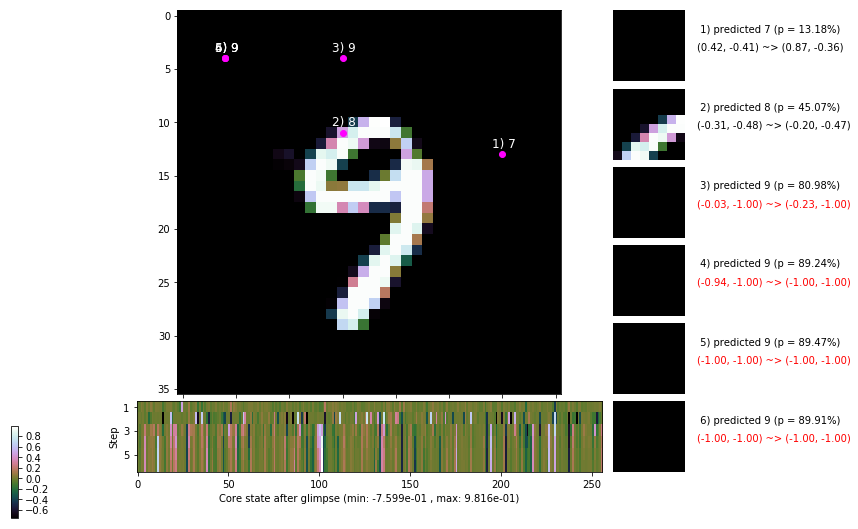

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 158.5 ms/b | lr: 5.45e-04 | grad 2norm: 20.05 | grad inf norm:  6.001
         Weights || abs max:  3.16 ( 1524.79) | mean: -5.52e-04 ( 0.01) | var: 7.85e-02 (   20.86)
          Biases || abs max:  2.51 (  292.60) | mean: -1.19e-01 ( 0.25) | var: 6.64e-02 ( 9673.34)
                    class loss: 0.873 | steps: 2.879 | reward:  3.547 | acc.: 69.33%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 154.9 ms/b | lr: 5.44e-04 | grad 2norm: 19.93 | grad inf norm:  5.434
         Weights || abs max:  3.17 ( 4008.38) | mean: -5.66e-04 ( 0.01) | var: 7.86e-02 ( 3476.54)
          Biases || abs max:  2.50 (  197.98) | mean: -1.19e-01 ( 0.17) | var: 6.65e-02 ( 1228.35)
                    class loss: 0.885 | steps: 2.923 | reward:  3.466 | acc.: 68.02%

	Target class: 1 | Discounted rewards: [3.686, 4.095, 3.4

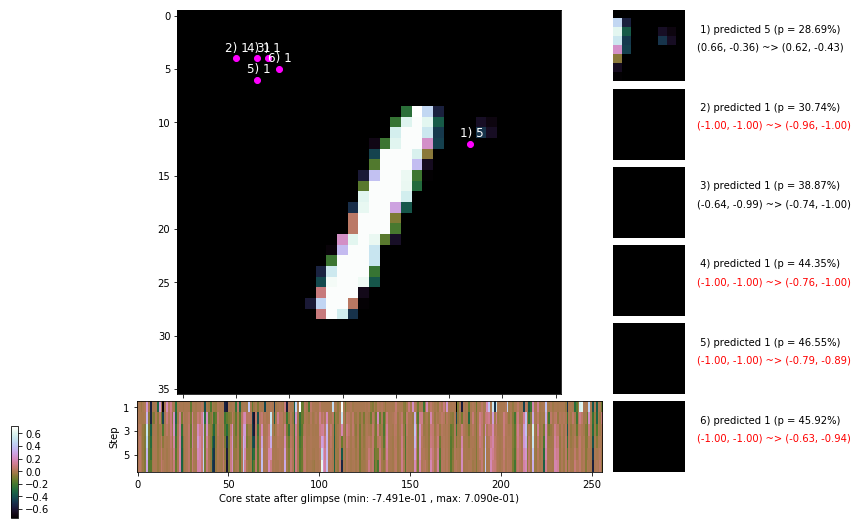

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 156.3 ms/b | lr: 5.43e-04 | grad 2norm: 19.72 | grad inf norm:  5.880
         Weights || abs max:  3.17 ( 1586.32) | mean: -5.42e-04 ( 0.01) | var: 7.87e-02 (  187.01)
          Biases || abs max:  2.50 (  197.36) | mean: -1.19e-01 ( 0.13) | var: 6.64e-02 ( 1616.79)
                    class loss: 0.864 | steps: 2.916 | reward:  3.523 | acc.: 69.55%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 152.4 ms/b | lr: 5.43e-04 | grad 2norm: 20.21 | grad inf norm:  5.782
         Weights || abs max:  3.17 (  980.74) | mean: -5.06e-04 ( 0.01) | var: 7.87e-02 (   35.60)
          Biases || abs max:  2.50 (   73.85) | mean: -1.19e-01 ( 0.08) | var: 6.66e-02 (   43.34)
                    class loss: 0.883 | steps: 2.925 | reward:  3.487 | acc.: 67.98%

	Target class: 0 | Discounted rewards: [0.900, 1.000, 0.0

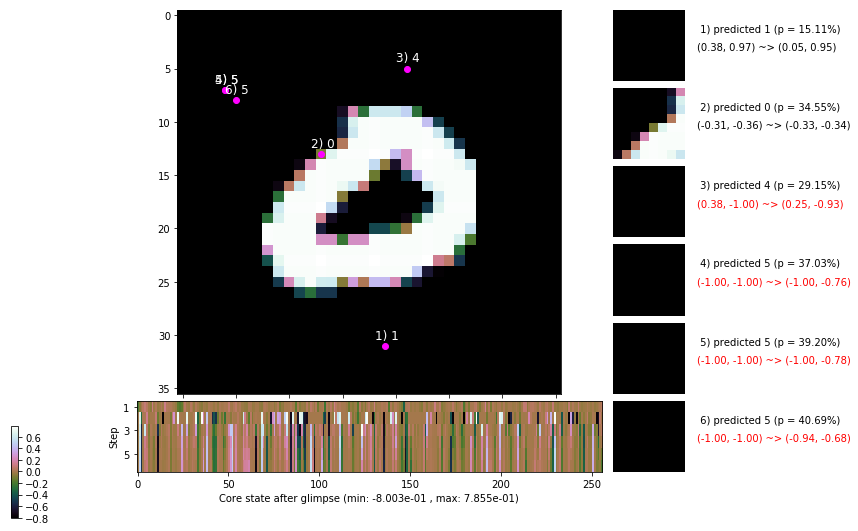

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 158.2 ms/b | lr: 5.42e-04 | grad 2norm: 19.63 | grad inf norm:  5.829
         Weights || abs max:  3.17 ( 3450.30) | mean: -4.94e-04 ( 0.01) | var: 7.88e-02 (  705.37)
          Biases || abs max:  2.50 (  103.38) | mean: -1.19e-01 ( 0.09) | var: 6.65e-02 (   70.58)
                    class loss: 0.890 | steps: 2.923 | reward:  3.482 | acc.: 68.68%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 153.1 ms/b | lr: 5.41e-04 | grad 2norm: 19.55 | grad inf norm:  5.782
         Weights || abs max:  3.17 ( 1671.48) | mean: -5.14e-04 ( 0.01) | var: 7.89e-02 (   37.72)
          Biases || abs max:  2.50 (  558.15) | mean: -1.20e-01 ( 0.40) | var: 6.67e-02 (19453.33)
                    class loss: 0.879 | steps: 2.917 | reward:  3.501 | acc.: 69.02%

	Target class: 9 | Discounted rewards: [3.686, 4.095, 3.4

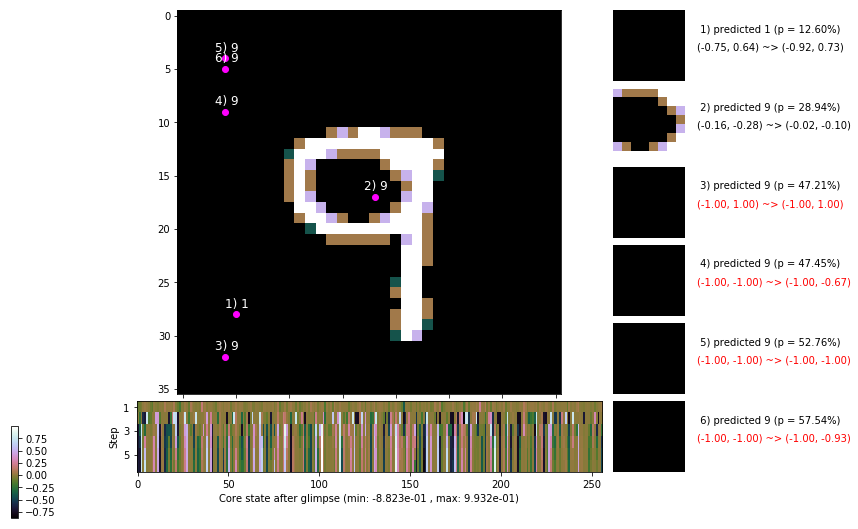

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 9 | Discounted rewards: [2.786, 3.095, 3.439, 2.710, 1.900, 1.000]


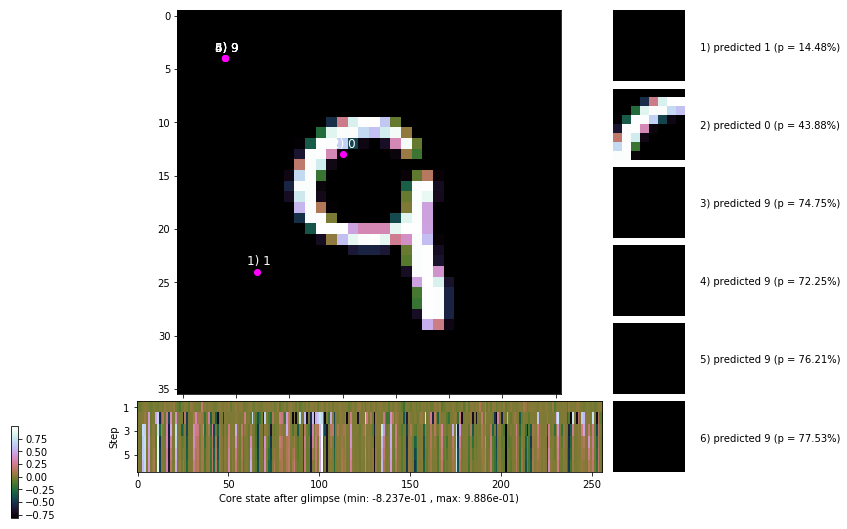


	Target class: 3 | Discounted rewards: [2.710, 1.900, 1.000, 0.000, 0.000, 0.000]


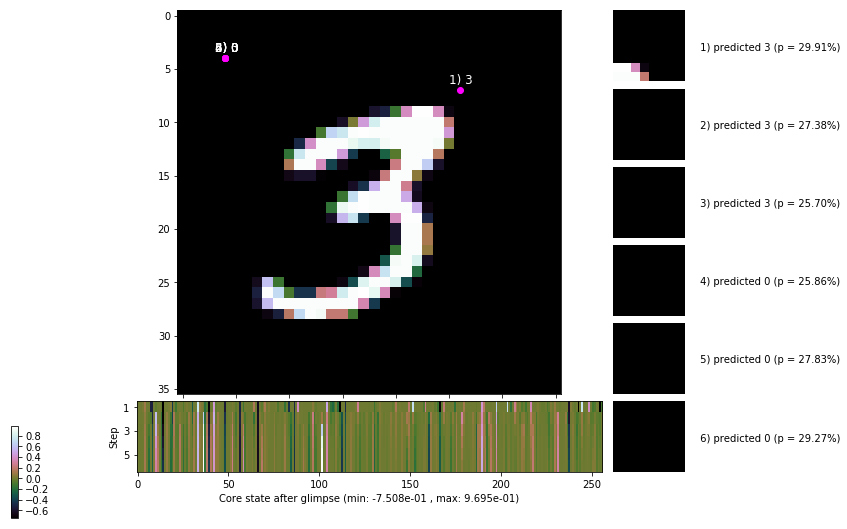

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


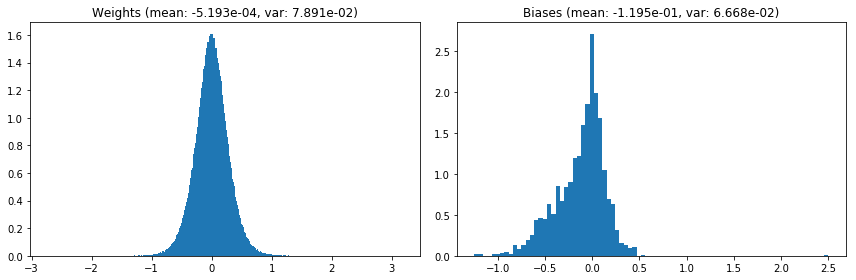

                                      Location network weights and biases


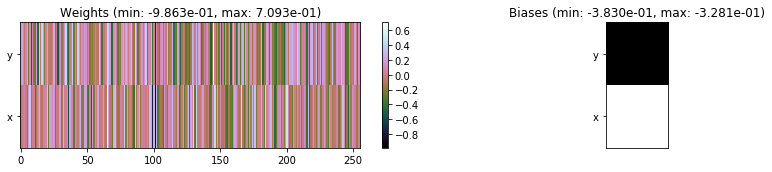

---------------------------------------------------------------------------------------------------------------
Elapsed time:  474.39 sec | TRAIN >> class loss: 0.8812 | steps:  2.915    | reward:  3.5010 :( | acc.: 68.802% 
                          | VAL   >> class loss: 0.8179 | steps:  2.814    | reward:  3.6224    | acc.: 70.040% 


Epoch  42/400) lr = 0.0005405
 b    300/  3000 >> 151.0 ms/b | lr: 5.40e-04 | grad 2norm: 19.56 | grad inf norm:  5.944
         Weights || abs max:  3.18 ( 2171.05) | mean: -5.04e-04 ( 0.01) | var: 7.89e-02 (  136.81)
          Biases || abs max:  2.50 (  283.03) | mean: -1.20e-01 ( 0.15) | var: 6.67e-02 ( 3976.16)
                    class loss: 0.890 | steps: 2.909 | reward:  3.503 | acc.: 69.15%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 152.9 ms/b | lr: 5.39e-04 | grad 2norm: 20.16 | grad inf norm:  6.158
         Weights || abs max:  3.17 ( 2666.32) | mean: -4.91e-04 ( 0.0

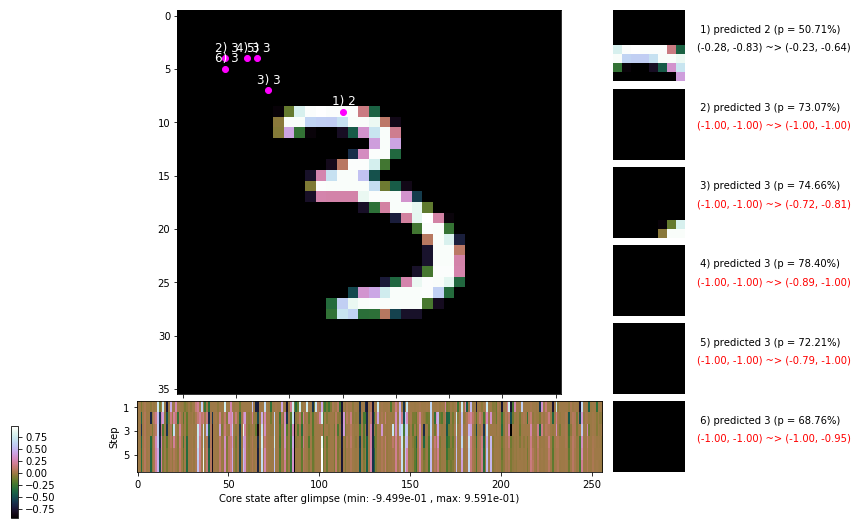

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 154.0 ms/b | lr: 5.38e-04 | grad 2norm: 19.91 | grad inf norm:  6.068
         Weights || abs max:  3.17 ( 3676.55) | mean: -4.70e-04 ( 0.01) | var: 7.91e-02 ( 1549.96)
          Biases || abs max:  2.50 (   35.89) | mean: -1.20e-01 ( 0.06) | var: 6.67e-02 (   12.38)
                    class loss: 0.903 | steps: 2.941 | reward:  3.470 | acc.: 68.33%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 160.1 ms/b | lr: 5.38e-04 | grad 2norm: 19.48 | grad inf norm:  5.687
         Weights || abs max:  3.16 ( 2058.98) | mean: -4.66e-04 ( 0.01) | var: 7.92e-02 (  239.15)
          Biases || abs max:  2.50 (   64.90) | mean: -1.20e-01 ( 0.08) | var: 6.66e-02 (   16.03)
                    class loss: 0.889 | steps: 2.923 | reward:  3.493 | acc.: 68.18%

	Target class: 3 | Discounted rewards: [2.786, 3.095, 3.4

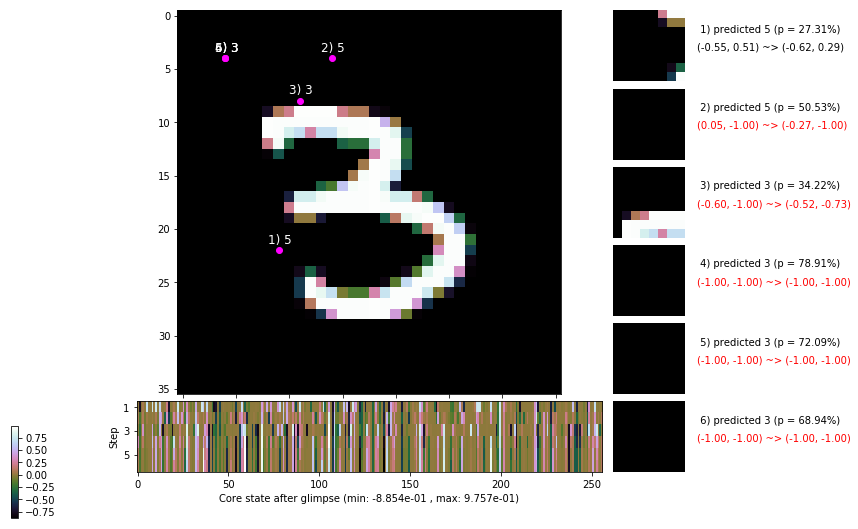

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 156.6 ms/b | lr: 5.37e-04 | grad 2norm: 19.50 | grad inf norm:  5.740
         Weights || abs max:  3.16 (79274.90) | mean: -5.08e-04 ( 0.15) | var: 7.93e-02 (3272078.75)
          Biases || abs max:  2.49 (  159.83) | mean: -1.20e-01 ( 0.15) | var: 6.66e-02 (  837.20)
                    class loss: 0.955 | steps: 3.005 | reward:  3.395 | acc.: 66.45%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 165.2 ms/b | lr: 5.36e-04 | grad 2norm: 19.86 | grad inf norm:  6.028
         Weights || abs max:  3.16 ( 1378.84) | mean: -5.35e-04 ( 0.01) | var: 7.93e-02 (   49.30)
          Biases || abs max:  2.49 (  153.79) | mean: -1.20e-01 ( 0.12) | var: 6.67e-02 (  803.88)
                    class loss: 0.937 | steps: 2.992 | reward:  3.394 | acc.: 66.78%

	Target class: 4 | Discounted rewards: [0.000, 0.000, 0

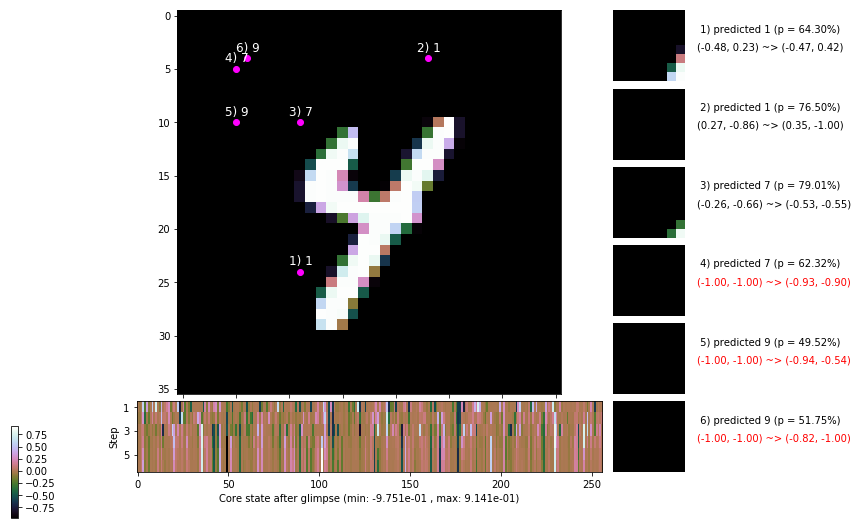

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 159.4 ms/b | lr: 5.35e-04 | grad 2norm: 19.72 | grad inf norm:  6.175
         Weights || abs max:  3.17 ( 1169.29) | mean: -5.26e-04 ( 0.01) | var: 7.94e-02 (   19.03)
          Biases || abs max:  2.48 (  148.77) | mean: -1.20e-01 ( 0.12) | var: 6.66e-02 (  160.27)
                    class loss: 0.931 | steps: 2.979 | reward:  3.415 | acc.: 66.40%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 161.4 ms/b | lr: 5.35e-04 | grad 2norm: 19.91 | grad inf norm:  5.749
         Weights || abs max:  3.17 ( 2022.64) | mean: -5.40e-04 ( 0.01) | var: 7.95e-02 (  135.35)
          Biases || abs max:  2.49 (   95.07) | mean: -1.20e-01 ( 0.09) | var: 6.67e-02 (   69.25)
                    class loss: 0.903 | steps: 2.942 | reward:  3.492 | acc.: 68.43%

	Target class: 8 | Discounted rewards: [2.786, 3.095, 3.4

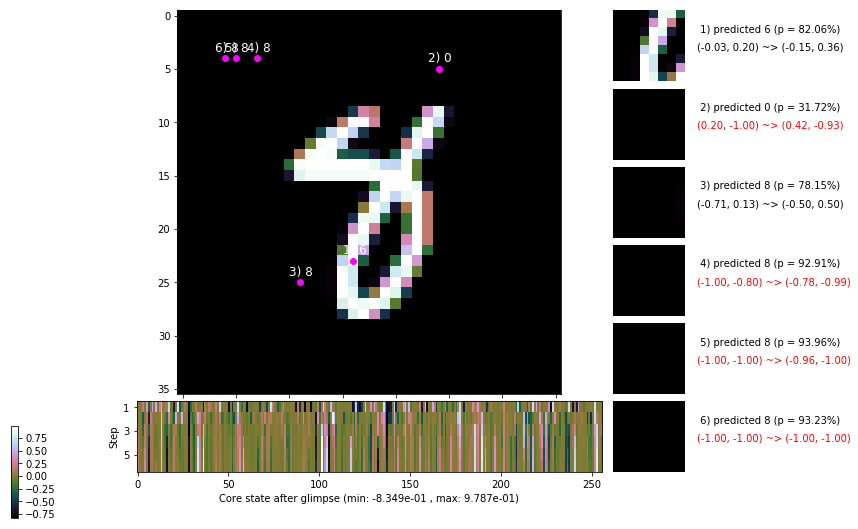

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 154.7 ms/b | lr: 5.33e-04 | grad 2norm: 19.34 | grad inf norm:  5.564
         Weights || abs max:  3.17 ( 2455.20) | mean: -5.60e-04 ( 0.01) | var: 7.96e-02 (  457.70)
          Biases || abs max:  2.49 (  229.43) | mean: -1.20e-01 ( 0.15) | var: 6.68e-02 (  903.80)
                    class loss: 0.913 | steps: 2.944 | reward:  3.467 | acc.: 67.87%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 154.1 ms/b | lr: 5.33e-04 | grad 2norm: 19.89 | grad inf norm:  5.947
         Weights || abs max:  3.16 ( 1620.03) | mean: -5.43e-04 ( 0.01) | var: 7.96e-02 (  131.40)
          Biases || abs max:  2.49 (   80.90) | mean: -1.20e-01 ( 0.09) | var: 6.67e-02 (   39.09)
                    class loss: 0.939 | steps: 2.969 | reward:  3.402 | acc.: 66.27%

	Target class: 7 | Discounted rewards: [3.686, 4.095, 3.4

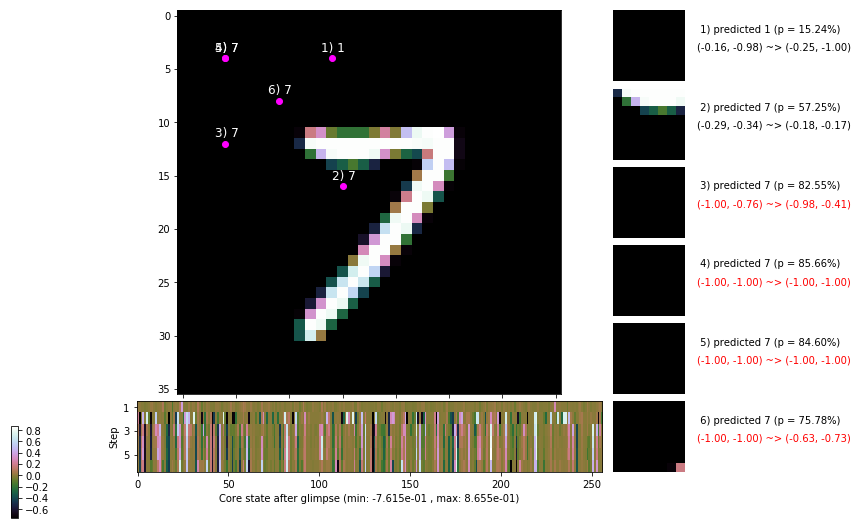

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 2 | Discounted rewards: [4.686, 4.095, 3.439, 2.710, 1.900, 1.000]


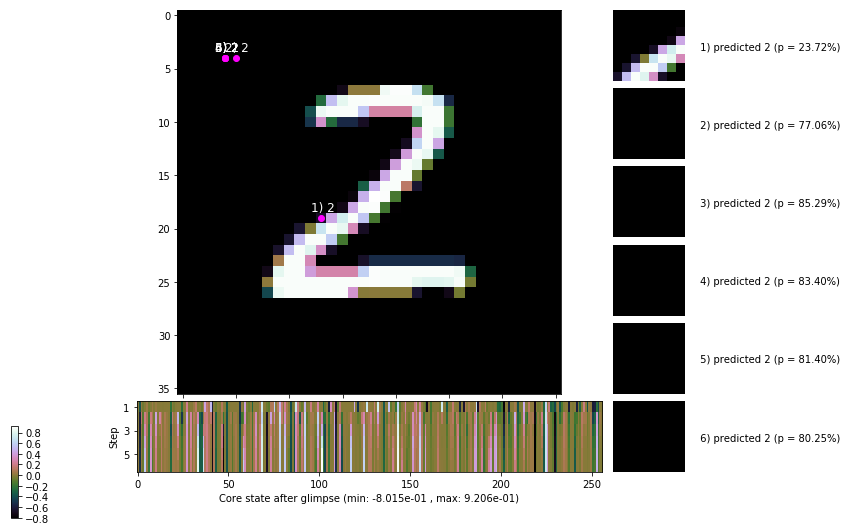


	Target class: 1 | Discounted rewards: [4.686, 4.095, 3.439, 2.710, 1.900, 1.000]


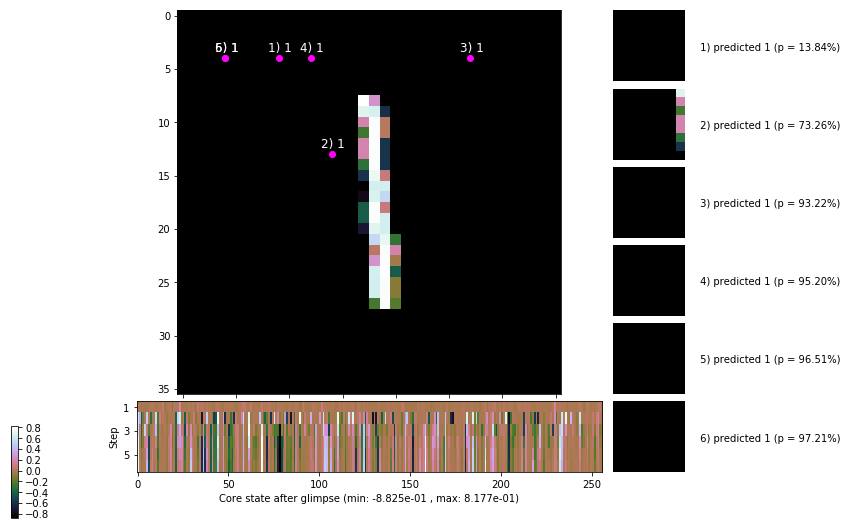

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


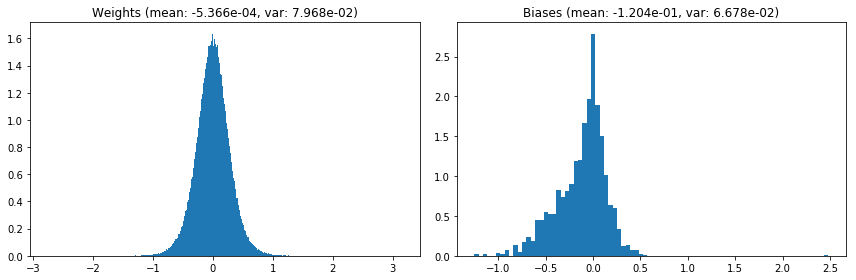

                                      Location network weights and biases


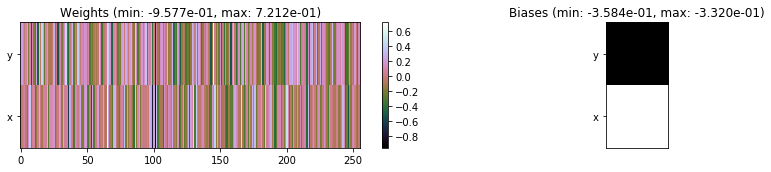

---------------------------------------------------------------------------------------------------------------
Elapsed time:  471.61 sec | TRAIN >> class loss: 0.9146 | steps:  2.953 :( | reward:  3.4499 :( | acc.: 67.585% :(
                          | VAL   >> class loss: 0.8883 | steps:  2.891 :( | reward:  3.5394 :( | acc.: 68.680% :(


Epoch  43/400) lr = 0.0005324
 b    300/  3000 >> 155.5 ms/b | lr: 5.32e-04 | grad 2norm: 19.82 | grad inf norm:  5.963
         Weights || abs max:  3.15 (  961.37) | mean: -5.46e-04 ( 0.01) | var: 7.97e-02 (   10.71)
          Biases || abs max:  2.48 (  102.02) | mean: -1.21e-01 ( 0.11) | var: 6.68e-02 (  411.76)
                    class loss: 0.904 | steps: 2.915 | reward:  3.510 | acc.: 68.25%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 153.7 ms/b | lr: 5.31e-04 | grad 2norm: 20.07 | grad inf norm:  5.941
         Weights || abs max:  3.14 (19402.11) | mean: -5.13e-04 (

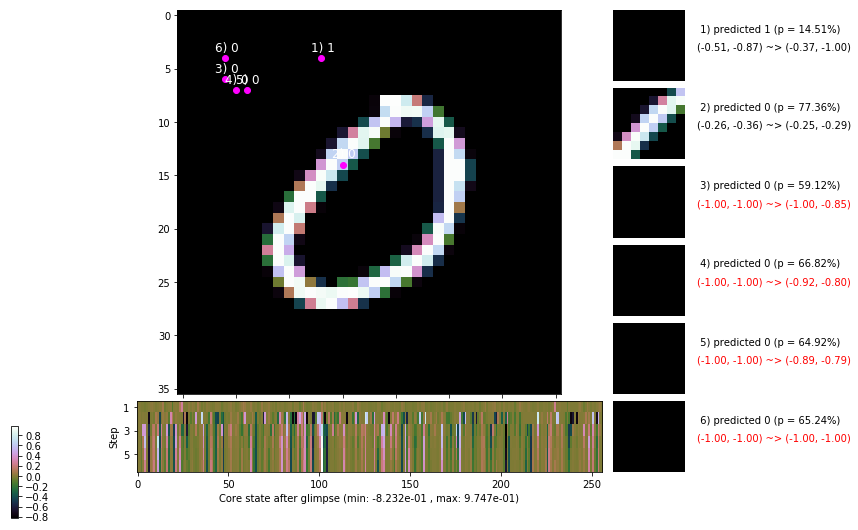

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 153.3 ms/b | lr: 5.30e-04 | grad 2norm: 19.81 | grad inf norm:  5.859
         Weights || abs max:  3.14 (  999.97) | mean: -5.18e-04 ( 0.01) | var: 7.99e-02 (   18.06)
          Biases || abs max:  2.49 (   63.61) | mean: -1.21e-01 ( 0.08) | var: 6.70e-02 (   11.48)
                    class loss: 0.884 | steps: 2.907 | reward:  3.507 | acc.: 68.73%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 155.1 ms/b | lr: 5.30e-04 | grad 2norm: 19.70 | grad inf norm:  5.812
         Weights || abs max:  3.14 ( 1658.92) | mean: -4.99e-04 ( 0.01) | var: 7.99e-02 (  130.12)
          Biases || abs max:  2.51 (   99.01) | mean: -1.20e-01 ( 0.08) | var: 6.72e-02 (   81.52)
                    class loss: 0.869 | steps: 2.871 | reward:  3.535 | acc.: 69.13%

	Target class: 3 | Discounted rewards: [2.786, 3.095, 3.4

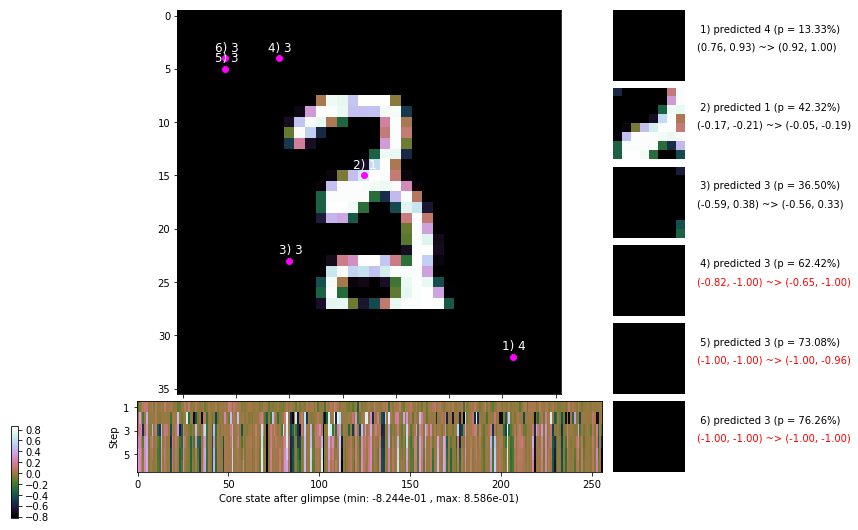

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 154.1 ms/b | lr: 5.29e-04 | grad 2norm: 19.81 | grad inf norm:  5.865
         Weights || abs max:  3.14 ( 1841.25) | mean: -4.97e-04 ( 0.01) | var: 8.00e-02 (  167.54)
          Biases || abs max:  2.51 (  168.87) | mean: -1.21e-01 ( 0.11) | var: 6.72e-02 ( 1576.88)
                    class loss: 0.875 | steps: 2.905 | reward:  3.506 | acc.: 69.15%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 152.8 ms/b | lr: 5.28e-04 | grad 2norm: 19.75 | grad inf norm:  5.792
         Weights || abs max:  3.14 ( 1642.25) | mean: -4.72e-04 ( 0.01) | var: 8.01e-02 (  176.48)
          Biases || abs max:  2.51 (  123.62) | mean: -1.21e-01 ( 0.10) | var: 6.71e-02 (  193.98)
                    class loss: 0.858 | steps: 2.910 | reward:  3.510 | acc.: 69.22%

	Target class: 3 | Discounted rewards: [4.686, 4.095, 3.4

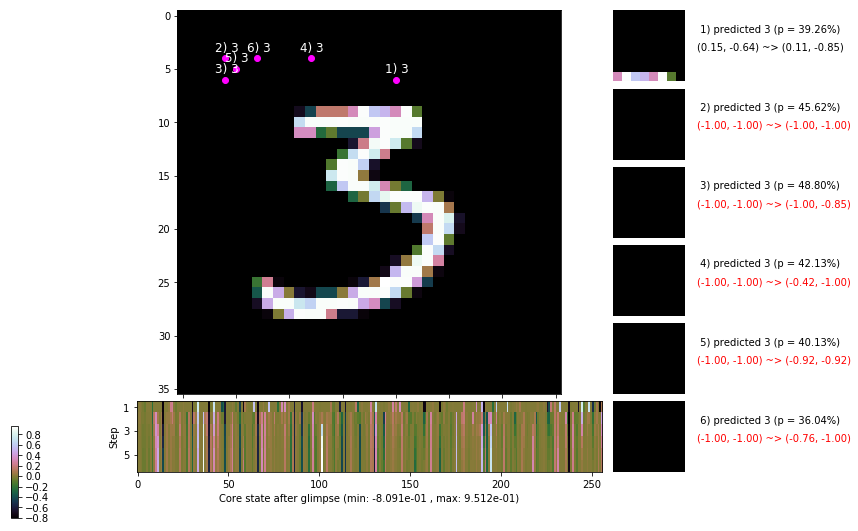

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 164.4 ms/b | lr: 5.27e-04 | grad 2norm: 19.91 | grad inf norm:  5.945
         Weights || abs max:  3.15 ( 1814.85) | mean: -4.64e-04 ( 0.01) | var: 8.02e-02 (   75.89)
          Biases || abs max:  2.51 (   73.44) | mean: -1.21e-01 ( 0.08) | var: 6.71e-02 (   14.68)
                    class loss: 0.869 | steps: 2.899 | reward:  3.517 | acc.: 68.65%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 164.7 ms/b | lr: 5.27e-04 | grad 2norm: 19.90 | grad inf norm:  5.902
         Weights || abs max:  3.15 ( 2166.16) | mean: -4.66e-04 ( 0.01) | var: 8.03e-02 (  154.55)
          Biases || abs max:  2.51 (   81.89) | mean: -1.21e-01 ( 0.09) | var: 6.72e-02 (   68.75)
                    class loss: 0.874 | steps: 2.916 | reward:  3.507 | acc.: 68.97%

	Target class: 7 | Discounted rewards: [3.686, 4.095, 3.4

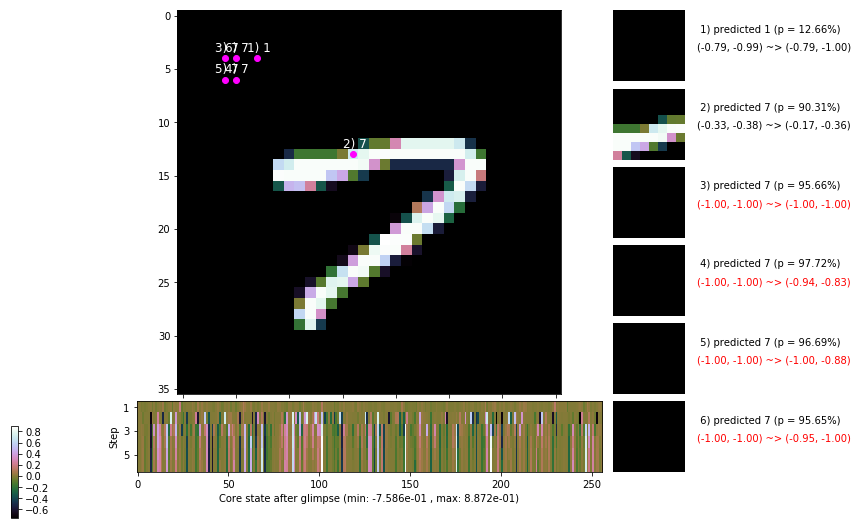

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 163.1 ms/b | lr: 5.26e-04 | grad 2norm: 20.25 | grad inf norm:  6.006
         Weights || abs max:  3.16 ( 1092.64) | mean: -4.68e-04 ( 0.01) | var: 8.03e-02 (   27.35)
          Biases || abs max:  2.51 (  388.59) | mean: -1.20e-01 ( 0.20) | var: 6.73e-02 ( 7420.16)
                    class loss: 0.887 | steps: 2.930 | reward:  3.474 | acc.: 68.17%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 159.6 ms/b | lr: 5.25e-04 | grad 2norm: 20.14 | grad inf norm:  5.908
         Weights || abs max:  3.16 ( 2906.44) | mean: -4.82e-04 ( 0.01) | var: 8.04e-02 (  550.48)
          Biases || abs max:  2.51 (  333.26) | mean: -1.20e-01 ( 0.18) | var: 6.74e-02 ( 5825.43)
                    class loss: 0.882 | steps: 2.923 | reward:  3.496 | acc.: 68.72%

	Target class: 4 | Discounted rewards: [3.686, 4.095, 3.4

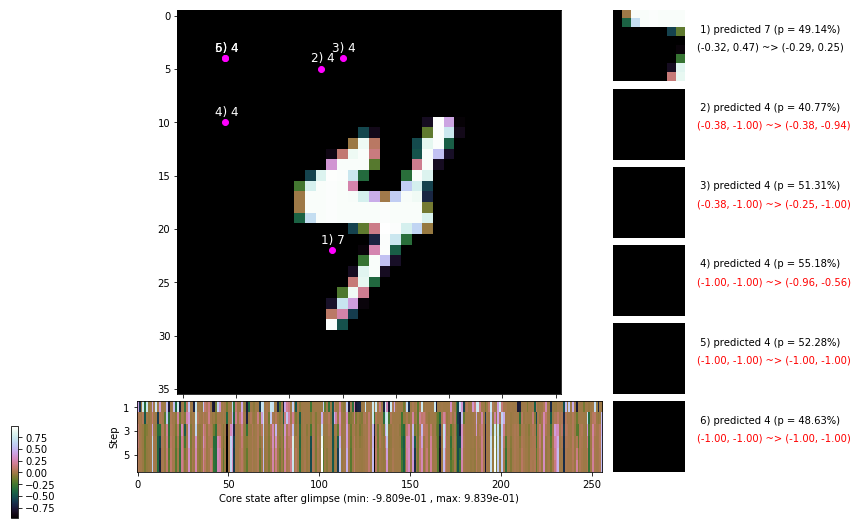

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 6 | Discounted rewards: [3.686, 4.095, 3.439, 2.710, 1.900, 1.000]


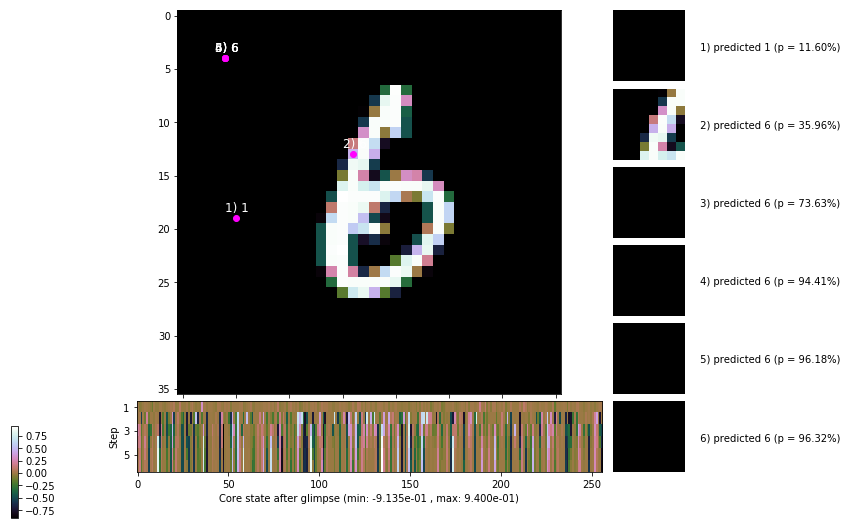


	Target class: 0 | Discounted rewards: [1.247, 1.385, 1.539, 1.710, 1.900, 1.000]


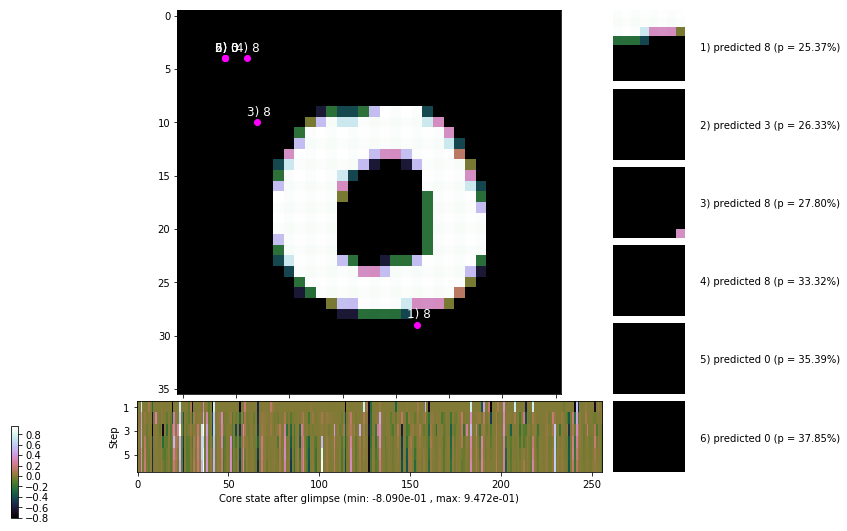

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


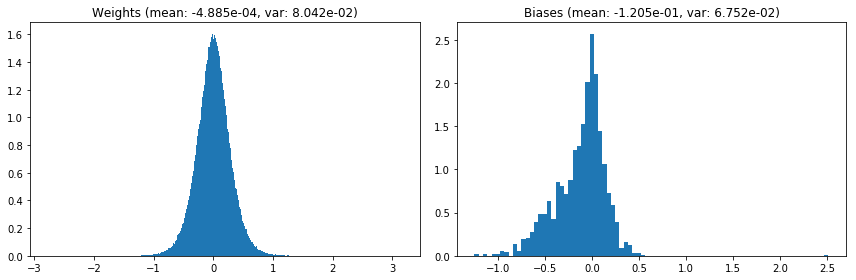

                                      Location network weights and biases


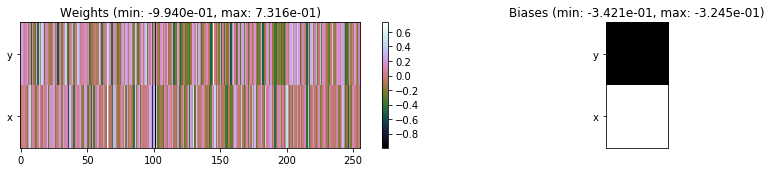

---------------------------------------------------------------------------------------------------------------
Elapsed time:  473.49 sec | TRAIN >> class loss: 0.8796 | steps:  2.913    | reward:  3.5034    | acc.: 68.718% :(
                          | VAL   >> class loss: 0.7998 | steps:  2.806    | reward:  3.6486    | acc.: 71.040% 


Epoch  44/400) lr = 0.0005245
 b    300/  3000 >> 155.4 ms/b | lr: 5.24e-04 | grad 2norm: 20.08 | grad inf norm:  5.834
         Weights || abs max:  3.15 ( 1653.46) | mean: -4.82e-04 ( 0.01) | var: 8.05e-02 (  114.06)
          Biases || abs max:  2.51 (   76.93) | mean: -1.20e-01 ( 0.08) | var: 6.76e-02 (   18.00)
                    class loss: 0.855 | steps: 2.892 | reward:  3.542 | acc.: 69.87%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 154.1 ms/b | lr: 5.23e-04 | grad 2norm: 20.01 | grad inf norm:  5.871
         Weights || abs max:  3.15 (  980.42) | mean: -4.67e-04 ( 0

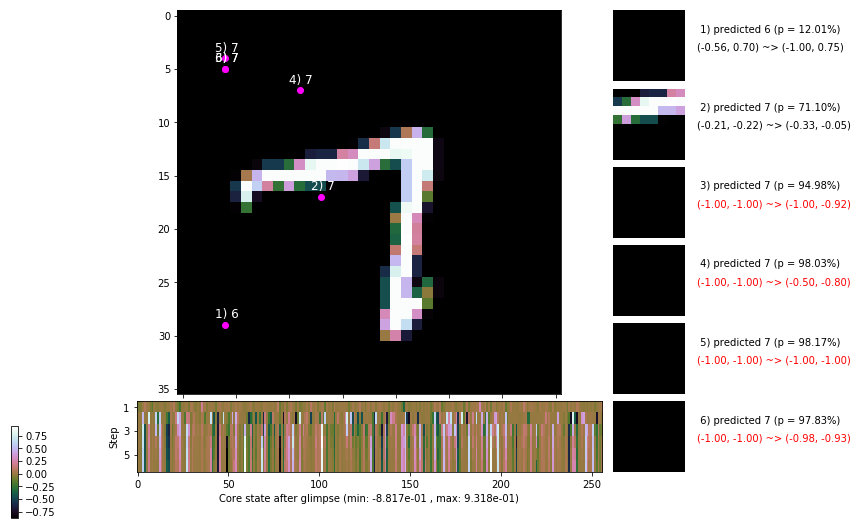

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 154.4 ms/b | lr: 5.22e-04 | grad 2norm: 20.22 | grad inf norm:  5.906
         Weights || abs max:  3.14 ( 1473.18) | mean: -4.30e-04 ( 0.01) | var: 8.06e-02 (   75.34)
          Biases || abs max:  2.51 (   97.97) | mean: -1.21e-01 ( 0.09) | var: 6.78e-02 (   40.41)
                    class loss: 0.923 | steps: 2.964 | reward:  3.425 | acc.: 66.58%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 153.3 ms/b | lr: 5.22e-04 | grad 2norm: 19.61 | grad inf norm:  5.687
         Weights || abs max:  3.13 ( 1810.17) | mean: -4.30e-04 ( 0.01) | var: 8.07e-02 (  462.09)
          Biases || abs max:  2.50 (   62.63) | mean: -1.21e-01 ( 0.08) | var: 6.79e-02 (   10.17)
                    class loss: 0.885 | steps: 2.898 | reward:  3.507 | acc.: 68.72%

	Target class: 1 | Discounted rewards: [4.686, 4.095, 3.4

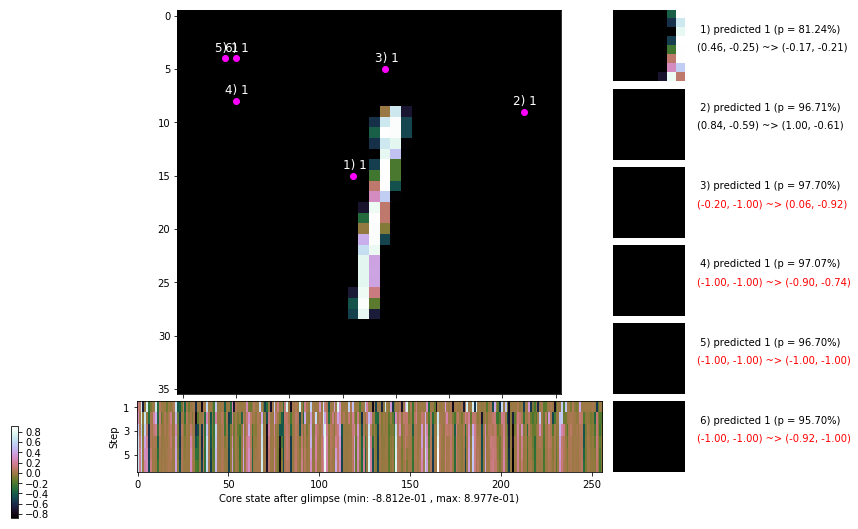

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 153.6 ms/b | lr: 5.21e-04 | grad 2norm: 19.91 | grad inf norm:  5.782
         Weights || abs max:  3.14 ( 6927.48) | mean: -4.02e-04 ( 0.02) | var: 8.07e-02 (18196.27)
          Biases || abs max:  2.51 (   72.82) | mean: -1.21e-01 ( 0.08) | var: 6.80e-02 (   55.92)
                    class loss: 0.871 | steps: 2.892 | reward:  3.529 | acc.: 69.12%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 152.2 ms/b | lr: 5.20e-04 | grad 2norm: 20.15 | grad inf norm:  5.959
         Weights || abs max:  3.15 ( 1064.53) | mean: -3.97e-04 ( 0.01) | var: 8.08e-02 (   21.67)
          Biases || abs max:  2.50 (  201.94) | mean: -1.21e-01 ( 0.13) | var: 6.79e-02 ( 1382.21)
                    class loss: 0.894 | steps: 2.923 | reward:  3.469 | acc.: 68.35%

	Target class: 3 | Discounted rewards: [2.786, 3.095, 3.4

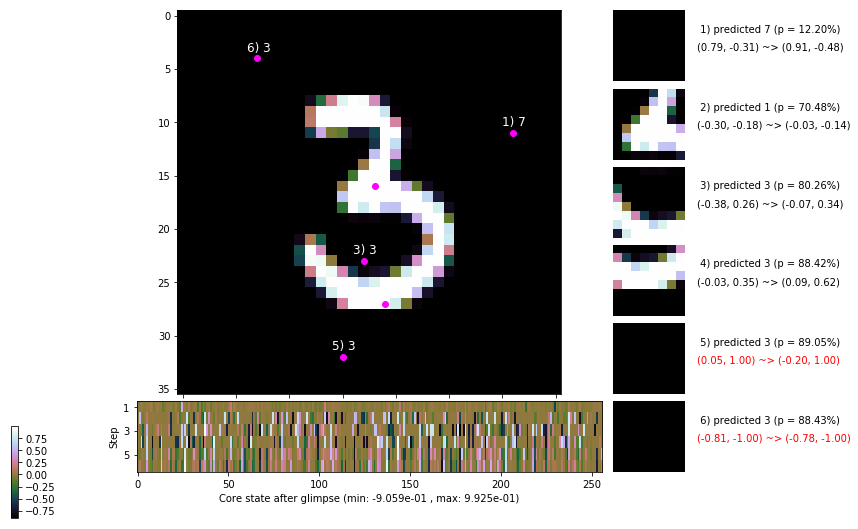

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 154.5 ms/b | lr: 5.19e-04 | grad 2norm: 19.96 | grad inf norm:  5.914
         Weights || abs max:  3.14 (  969.30) | mean: -3.97e-04 ( 0.01) | var: 8.09e-02 (   71.58)
          Biases || abs max:  2.51 (   85.36) | mean: -1.21e-01 ( 0.08) | var: 6.78e-02 (  106.02)
                    class loss: 0.856 | steps: 2.898 | reward:  3.550 | acc.: 69.68%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 151.4 ms/b | lr: 5.19e-04 | grad 2norm: 19.75 | grad inf norm:  5.546
         Weights || abs max:  3.14 ( 1355.33) | mean: -3.55e-04 ( 0.01) | var: 8.10e-02 (   49.14)
          Biases || abs max:  2.52 (  581.76) | mean: -1.21e-01 ( 0.28) | var: 6.79e-02 (27778.94)
                    class loss: 0.834 | steps: 2.859 | reward:  3.590 | acc.: 70.45%

	Target class: 9 | Discounted rewards: [3.686, 4.095, 3.4

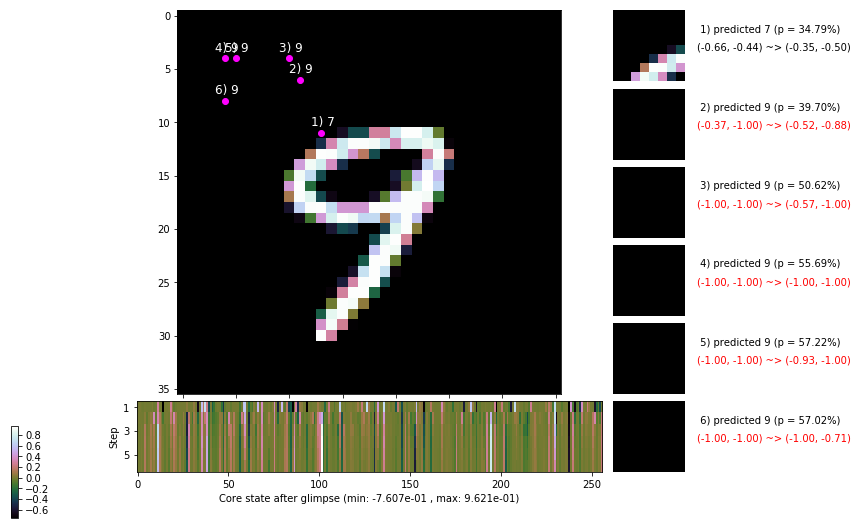

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 162.8 ms/b | lr: 5.18e-04 | grad 2norm: 20.03 | grad inf norm:  5.991
         Weights || abs max:  3.15 ( 7542.06) | mean: -3.38e-04 ( 0.02) | var: 8.10e-02 (21395.92)
          Biases || abs max:  2.51 (  177.11) | mean: -1.21e-01 ( 0.12) | var: 6.79e-02 (  488.27)
                    class loss: 0.872 | steps: 2.934 | reward:  3.506 | acc.: 69.17%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 155.1 ms/b | lr: 5.17e-04 | grad 2norm: 19.74 | grad inf norm:  5.700
         Weights || abs max:  3.14 ( 1737.98) | mean: -3.57e-04 ( 0.01) | var: 8.11e-02 (   75.93)
          Biases || abs max:  2.51 (  143.44) | mean: -1.21e-01 ( 0.12) | var: 6.80e-02 (  198.45)
                    class loss: 0.877 | steps: 2.929 | reward:  3.494 | acc.: 68.72%

	Target class: 2 | Discounted rewards: [3.686, 4.095, 3.4

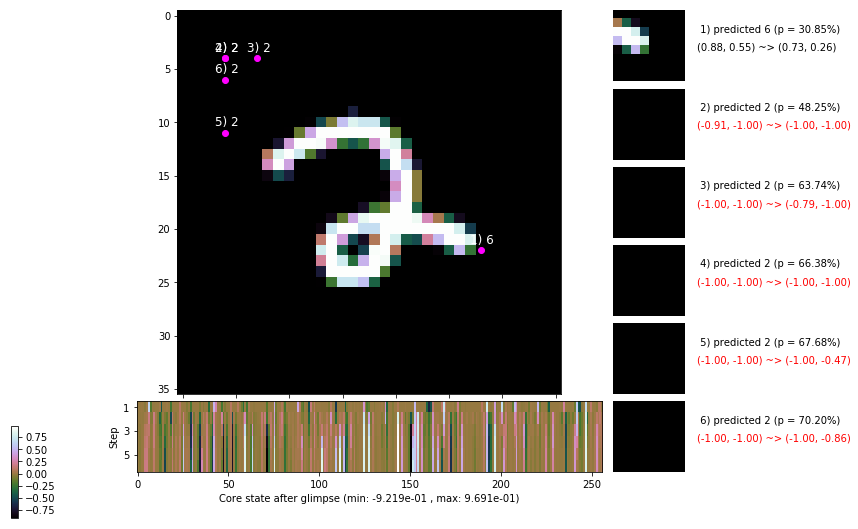

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 5 | Discounted rewards: [2.786, 3.095, 3.439, 2.710, 1.900, 1.000]


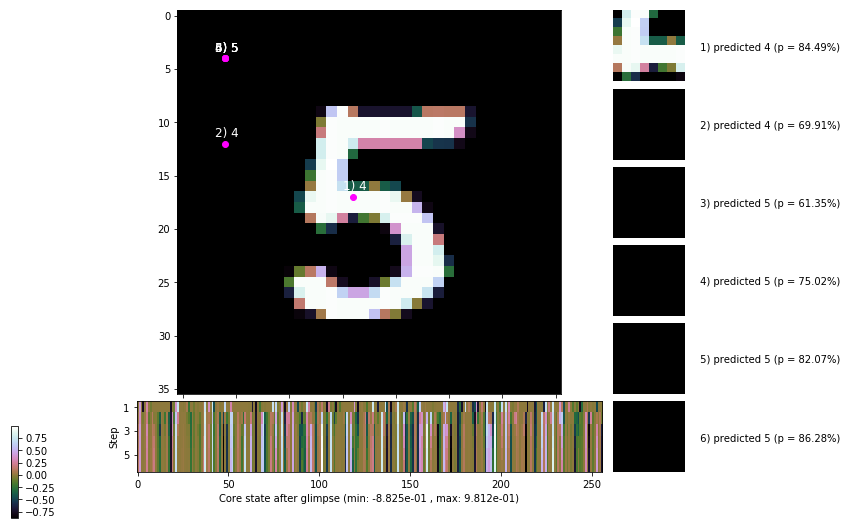


	Target class: 0 | Discounted rewards: [3.686, 4.095, 3.439, 2.710, 1.900, 1.000]


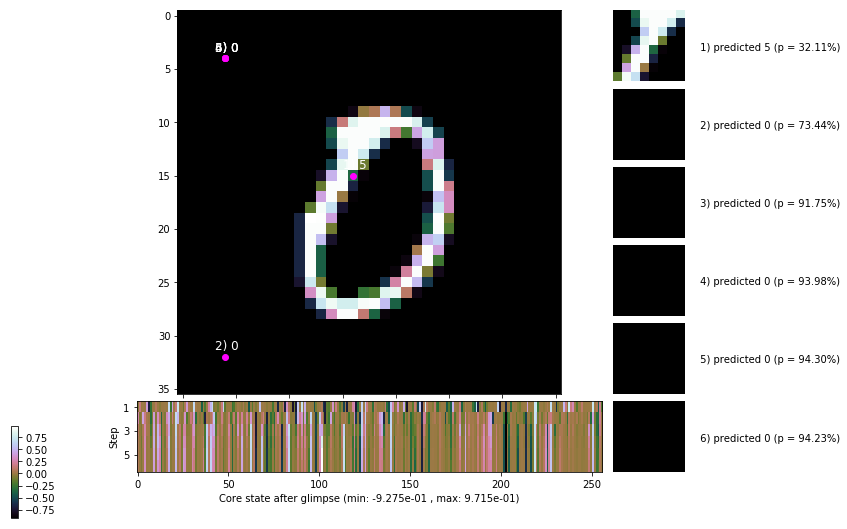

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


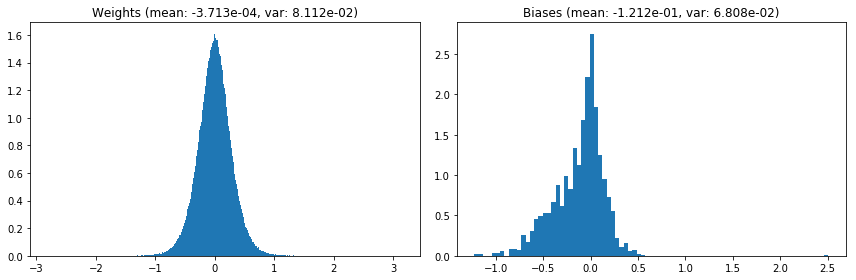

                                      Location network weights and biases


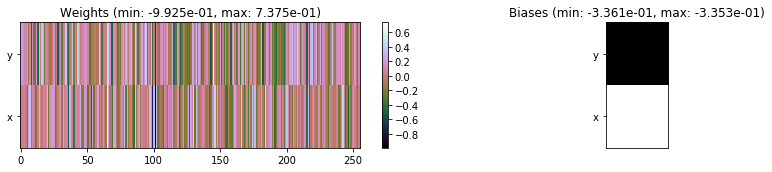

---------------------------------------------------------------------------------------------------------------
Elapsed time:  464.82 sec | TRAIN >> class loss: 0.8735 | steps:  2.909    | reward:  3.5145    | acc.: 69.040% 
                          | VAL   >> class loss: 0.8135 | steps:  2.800    | reward:  3.6358 :( | acc.: 70.980% :(


Epoch  45/400) lr = 0.0005167
 b    300/  3000 >> 165.9 ms/b | lr: 5.16e-04 | grad 2norm: 20.19 | grad inf norm:  5.948
         Weights || abs max:  3.15 ( 4833.56) | mean: -3.79e-04 ( 0.01) | var: 8.11e-02 ( 2800.26)
          Biases || abs max:  2.51 (   67.01) | mean: -1.21e-01 ( 0.07) | var: 6.81e-02 (   46.17)
                    class loss: 0.856 | steps: 2.918 | reward:  3.514 | acc.: 69.30%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 158.2 ms/b | lr: 5.16e-04 | grad 2norm: 19.85 | grad inf norm:  5.788
         Weights || abs max:  3.16 ( 2744.64) | mean: -4.00e-04 ( 0

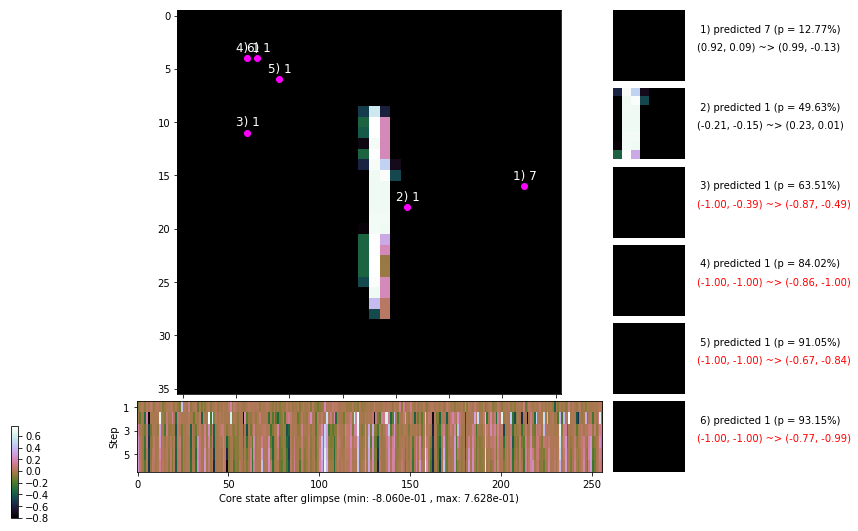

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 161.6 ms/b | lr: 5.15e-04 | grad 2norm: 20.24 | grad inf norm:  6.089
         Weights || abs max:  3.16 ( 1179.39) | mean: -3.85e-04 ( 0.01) | var: 8.13e-02 (  136.21)
          Biases || abs max:  2.52 (  113.89) | mean: -1.21e-01 ( 0.10) | var: 6.85e-02 (  103.03)
                    class loss: 0.907 | steps: 2.966 | reward:  3.465 | acc.: 68.27%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 154.8 ms/b | lr: 5.14e-04 | grad 2norm: 19.91 | grad inf norm:  6.110
         Weights || abs max:  3.17 ( 1438.15) | mean: -3.92e-04 ( 0.01) | var: 8.13e-02 (   27.55)
          Biases || abs max:  2.52 (   86.11) | mean: -1.22e-01 ( 0.09) | var: 6.86e-02 (   49.63)
                    class loss: 0.851 | steps: 2.902 | reward:  3.537 | acc.: 69.37%

	Target class: 6 | Discounted rewards: [0.000, 0.000, 0.0

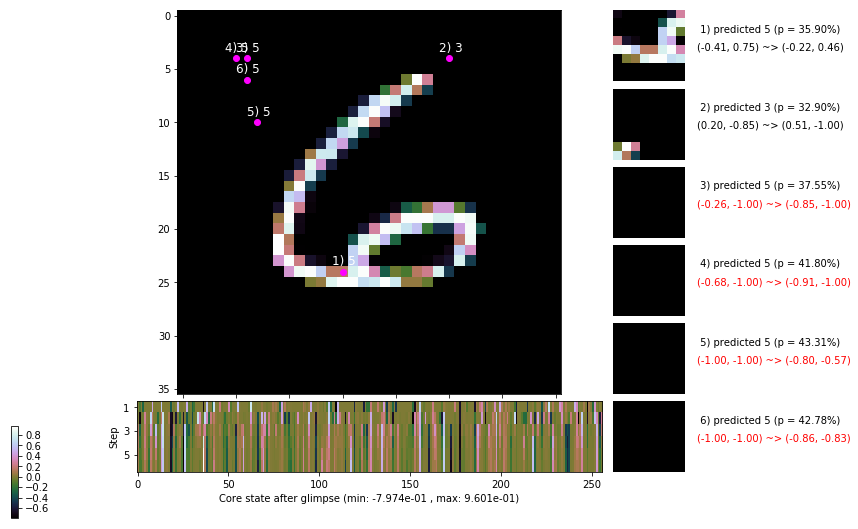

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 155.5 ms/b | lr: 5.13e-04 | grad 2norm: 19.65 | grad inf norm:  5.582
         Weights || abs max:  3.17 ( 1840.89) | mean: -3.95e-04 ( 0.01) | var: 8.14e-02 (   83.74)
          Biases || abs max:  2.52 (   52.12) | mean: -1.22e-01 ( 0.06) | var: 6.86e-02 (   12.18)
                    class loss: 0.869 | steps: 2.898 | reward:  3.535 | acc.: 69.45%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 153.5 ms/b | lr: 5.13e-04 | grad 2norm: 19.81 | grad inf norm:  5.669
         Weights || abs max:  3.18 ( 2607.83) | mean: -4.23e-04 ( 0.01) | var: 8.15e-02 ( 1405.59)
          Biases || abs max:  2.52 ( 2652.62) | mean: -1.22e-01 ( 1.08) | var: 6.85e-02 (748353.69)
                    class loss: 0.847 | steps: 2.900 | reward:  3.529 | acc.: 69.47%

	Target class: 0 | Discounted rewards: [0.729, 0.810, 0.

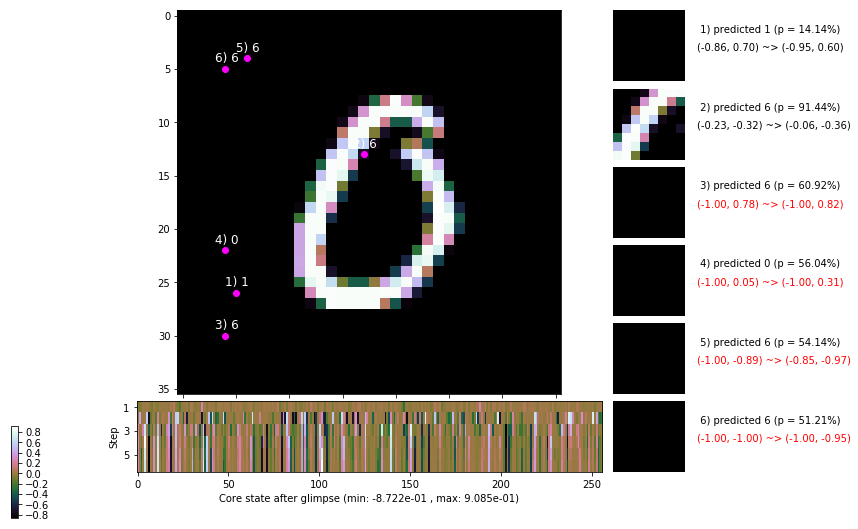

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 155.1 ms/b | lr: 5.12e-04 | grad 2norm: 19.95 | grad inf norm:  6.005
         Weights || abs max:  3.18 ( 1318.47) | mean: -4.40e-04 ( 0.01) | var: 8.16e-02 (   74.65)
          Biases || abs max:  2.53 (  209.59) | mean: -1.21e-01 ( 0.14) | var: 6.84e-02 ( 1111.13)
                    class loss: 0.812 | steps: 2.857 | reward:  3.601 | acc.: 71.30%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 151.4 ms/b | lr: 5.11e-04 | grad 2norm: 19.99 | grad inf norm:  5.781
         Weights || abs max:  3.18 ( 1139.00) | mean: -4.42e-04 ( 0.01) | var: 8.16e-02 (   22.47)
          Biases || abs max:  2.54 (  117.10) | mean: -1.21e-01 ( 0.10) | var: 6.87e-02 (  129.93)
                    class loss: 0.814 | steps: 2.833 | reward:  3.608 | acc.: 71.58%

	Target class: 5 | Discounted rewards: [3.686, 4.095, 3.4

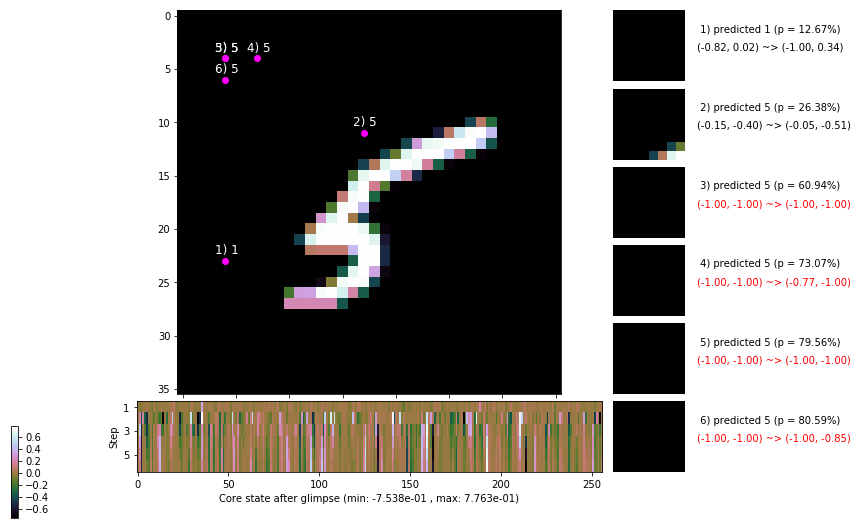

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 162.0 ms/b | lr: 5.10e-04 | grad 2norm: 19.93 | grad inf norm:  5.722
         Weights || abs max:  3.18 ( 1971.58) | mean: -4.20e-04 ( 0.01) | var: 8.17e-02 (  255.80)
          Biases || abs max:  2.54 (   79.03) | mean: -1.21e-01 ( 0.08) | var: 6.88e-02 (   30.03)
                    class loss: 0.821 | steps: 2.829 | reward:  3.620 | acc.: 71.20%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 152.5 ms/b | lr: 5.09e-04 | grad 2norm: 19.63 | grad inf norm:  5.648
         Weights || abs max:  3.20 ( 5000.75) | mean: -4.12e-04 ( 0.01) | var: 8.17e-02 ( 2363.98)
          Biases || abs max:  2.55 (   88.29) | mean: -1.22e-01 ( 0.09) | var: 6.87e-02 (   48.46)
                    class loss: 0.845 | steps: 2.868 | reward:  3.583 | acc.: 70.70%

	Target class: 1 | Discounted rewards: [4.686, 4.095, 3.4

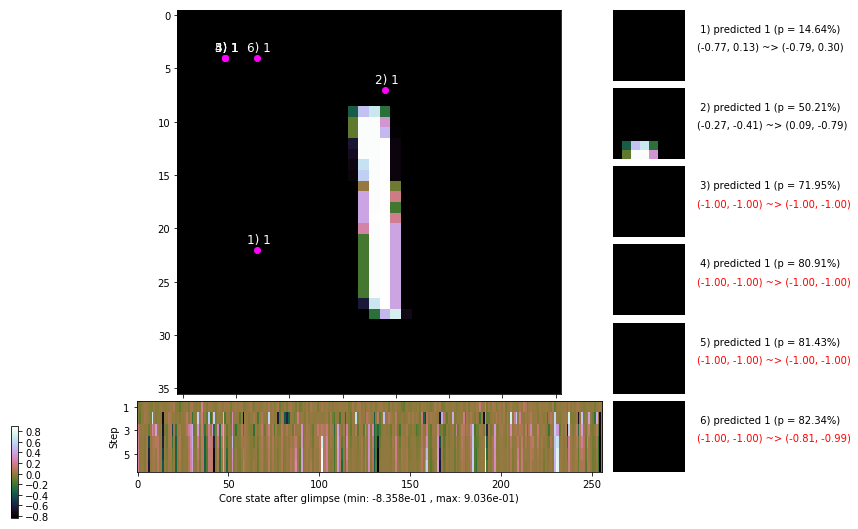

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 6 | Discounted rewards: [3.686, 4.095, 3.439, 2.710, 1.900, 1.000]


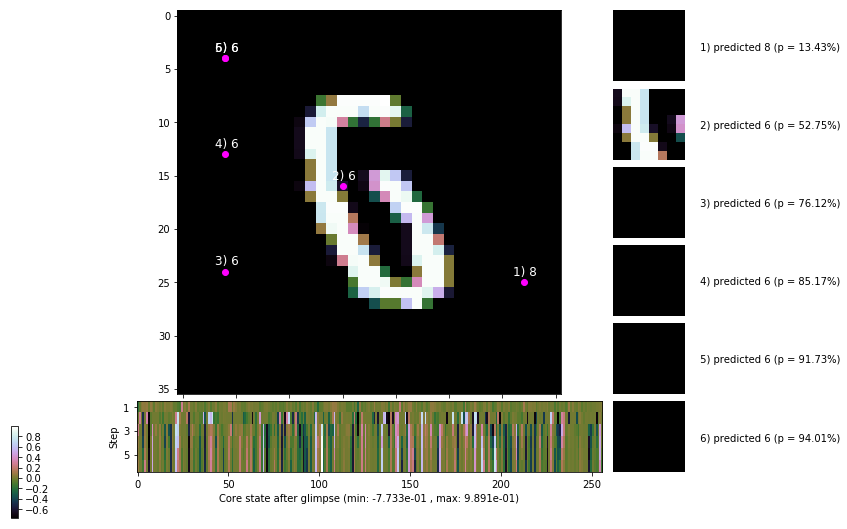


	Target class: 4 | Discounted rewards: [3.686, 4.095, 3.439, 2.710, 1.900, 1.000]


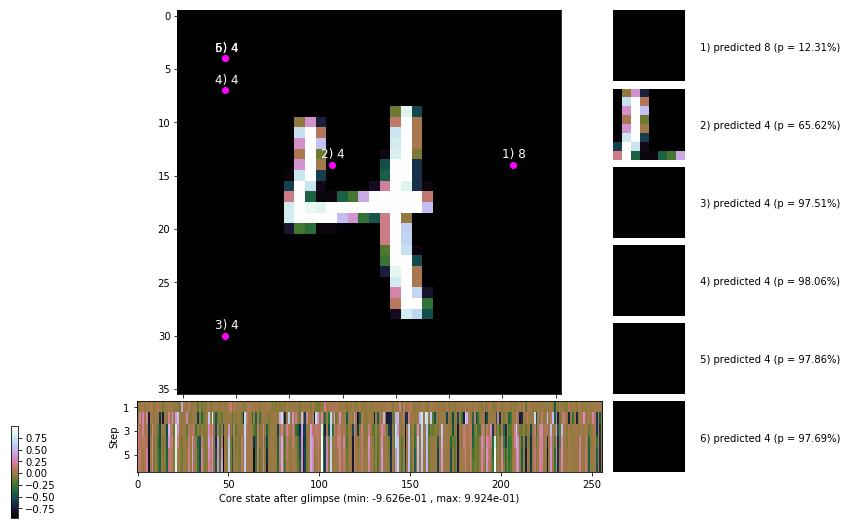

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


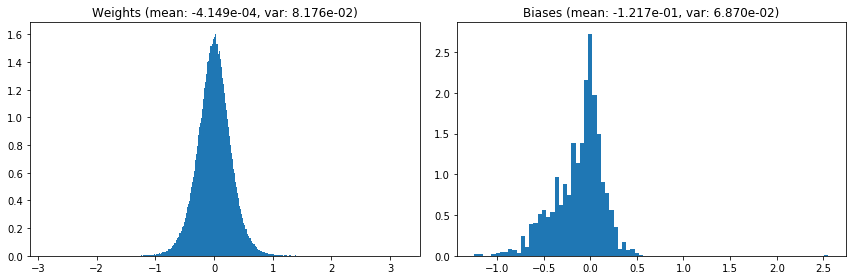

                                      Location network weights and biases


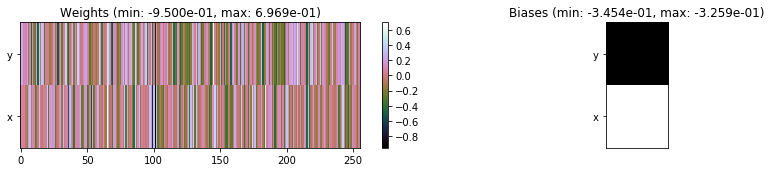

---------------------------------------------------------------------------------------------------------------
Elapsed time:  471.80 sec | TRAIN >> class loss: 0.8482 | steps:  2.885    | reward:  3.5537    | acc.: 69.995% 
                          | VAL   >> class loss: 0.8043 | steps:  2.769    | reward:  3.6718    | acc.: 71.340% 


Epoch  46/400) lr = 0.000509
 b    300/  3000 >> 155.0 ms/b | lr: 5.08e-04 | grad 2norm: 19.40 | grad inf norm:  5.748
         Weights || abs max:  3.20 ( 4128.54) | mean: -4.20e-04 ( 0.01) | var: 8.18e-02 ( 4284.18)
          Biases || abs max:  2.56 (   88.03) | mean: -1.22e-01 ( 0.09) | var: 6.88e-02 (   47.89)
                    class loss: 0.839 | steps: 2.854 | reward:  3.594 | acc.: 70.58%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 172.0 ms/b | lr: 5.08e-04 | grad 2norm: 19.81 | grad inf norm:  5.843
         Weights || abs max:  3.21 ( 1728.14) | mean: -4.33e-04 ( 0.01

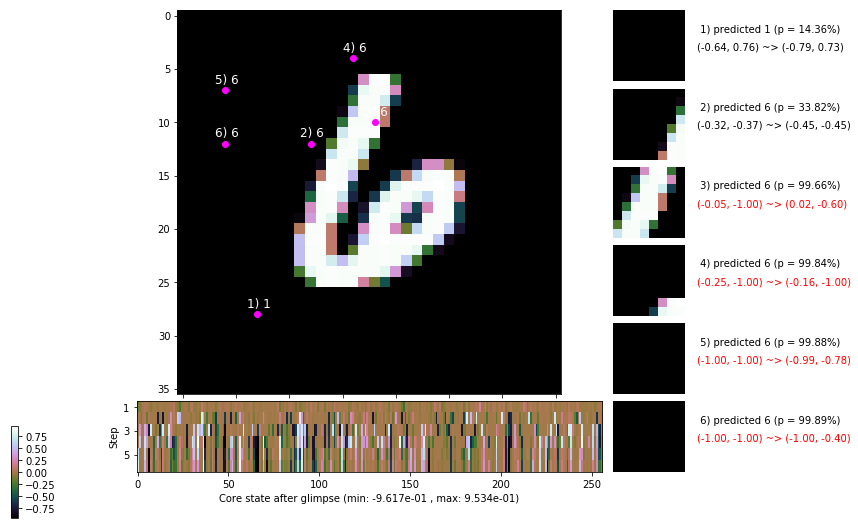

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 165.0 ms/b | lr: 5.07e-04 | grad 2norm: 19.30 | grad inf norm:  5.710
         Weights || abs max:  3.21 ( 1806.23) | mean: -4.41e-04 ( 0.01) | var: 8.19e-02 (  104.17)
          Biases || abs max:  2.55 (   75.79) | mean: -1.22e-01 ( 0.08) | var: 6.90e-02 (   19.83)
                    class loss: 0.866 | steps: 2.908 | reward:  3.524 | acc.: 69.08%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 174.3 ms/b | lr: 5.06e-04 | grad 2norm: 19.81 | grad inf norm:  5.974
         Weights || abs max:  3.20 ( 1265.80) | mean: -4.15e-04 ( 0.01) | var: 8.20e-02 (   50.01)
          Biases || abs max:  2.55 (   90.98) | mean: -1.22e-01 ( 0.09) | var: 6.90e-02 (   47.28)
                    class loss: 0.866 | steps: 2.912 | reward:  3.539 | acc.: 69.88%

	Target class: 6 | Discounted rewards: [4.686, 4.095, 3.4

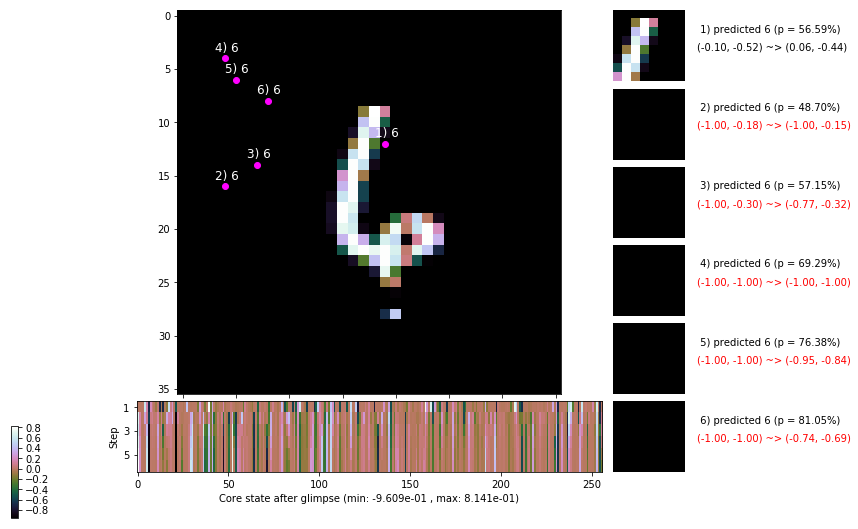

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 166.0 ms/b | lr: 5.05e-04 | grad 2norm: 19.83 | grad inf norm:  5.772
         Weights || abs max:  3.21 ( 1677.27) | mean: -4.00e-04 ( 0.01) | var: 8.20e-02 (   41.88)
          Biases || abs max:  2.55 (   88.94) | mean: -1.22e-01 ( 0.09) | var: 6.91e-02 (   45.97)
                    class loss: 0.843 | steps: 2.891 | reward:  3.549 | acc.: 69.38%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 166.6 ms/b | lr: 5.05e-04 | grad 2norm: 19.78 | grad inf norm:  5.597
         Weights || abs max:  3.22 ( 1735.47) | mean: -4.09e-04 ( 0.01) | var: 8.21e-02 (   67.54)
          Biases || abs max:  2.55 (  659.08) | mean: -1.22e-01 ( 0.53) | var: 6.90e-02 (65935.31)
                    class loss: 0.864 | steps: 2.898 | reward:  3.537 | acc.: 69.92%

	Target class: 9 | Discounted rewards: [0.900, 1.000, 0.0

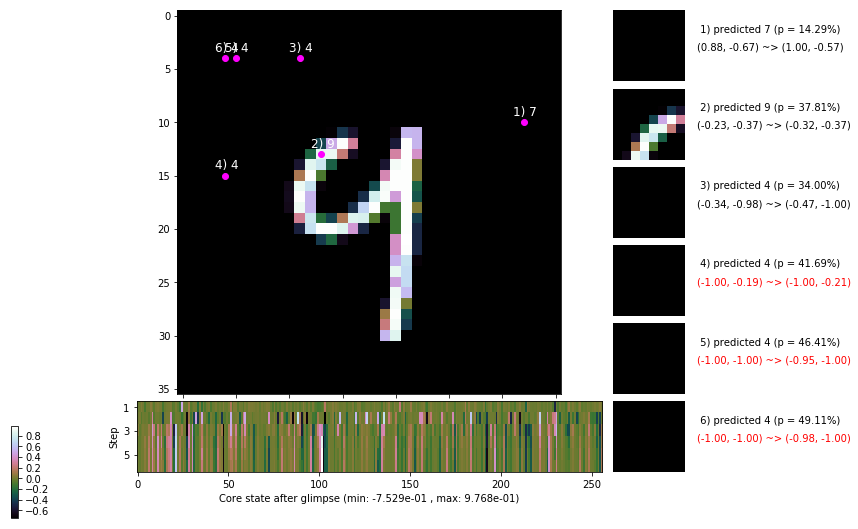

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 161.8 ms/b | lr: 5.04e-04 | grad 2norm: 19.51 | grad inf norm:  5.644
         Weights || abs max:  3.22 ( 1829.20) | mean: -4.09e-04 ( 0.01) | var: 8.22e-02 (  172.73)
          Biases || abs max:  2.55 (  100.70) | mean: -1.22e-01 ( 0.10) | var: 6.92e-02 (   35.69)
                    class loss: 0.815 | steps: 2.867 | reward:  3.603 | acc.: 71.17%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 161.7 ms/b | lr: 5.03e-04 | grad 2norm: 19.65 | grad inf norm:  5.793
         Weights || abs max:  3.21 ( 1187.20) | mean: -3.83e-04 ( 0.01) | var: 8.22e-02 (   29.69)
          Biases || abs max:  2.56 (  129.25) | mean: -1.22e-01 ( 0.11) | var: 6.95e-02 (  449.95)
                    class loss: 0.870 | steps: 2.908 | reward:  3.530 | acc.: 69.37%

	Target class: 6 | Discounted rewards: [4.686, 4.095, 3.4

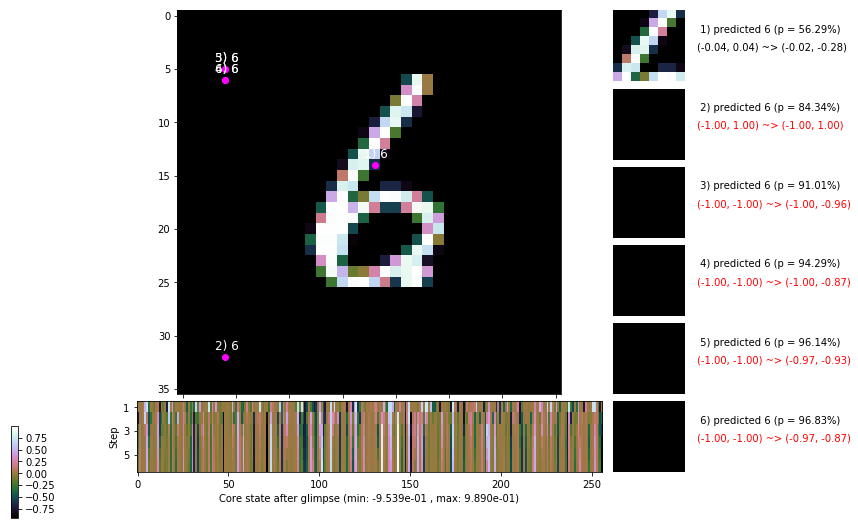

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 161.6 ms/b | lr: 5.02e-04 | grad 2norm: 19.81 | grad inf norm:  6.186
         Weights || abs max:  3.23 ( 1727.29) | mean: -3.99e-04 ( 0.01) | var: 8.23e-02 (  669.02)
          Biases || abs max:  2.55 (  126.56) | mean: -1.23e-01 ( 0.10) | var: 6.97e-02 (  122.63)
                    class loss: 0.872 | steps: 2.902 | reward:  3.532 | acc.: 69.37%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 157.2 ms/b | lr: 5.02e-04 | grad 2norm: 19.77 | grad inf norm:  5.763
         Weights || abs max:  3.23 ( 3330.14) | mean: -4.00e-04 ( 0.01) | var: 8.23e-02 (  807.31)
          Biases || abs max:  2.55 (  107.80) | mean: -1.23e-01 ( 0.10) | var: 6.96e-02 (  187.53)
                    class loss: 0.847 | steps: 2.866 | reward:  3.576 | acc.: 70.45%

	Target class: 7 | Discounted rewards: [3.686, 4.095, 3.4

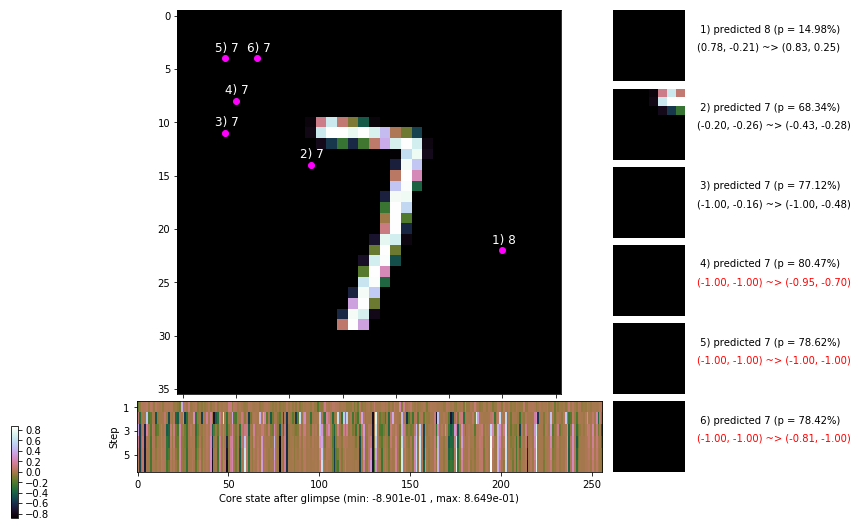

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 0 | Discounted rewards: [3.686, 4.095, 3.439, 2.710, 1.900, 1.000]


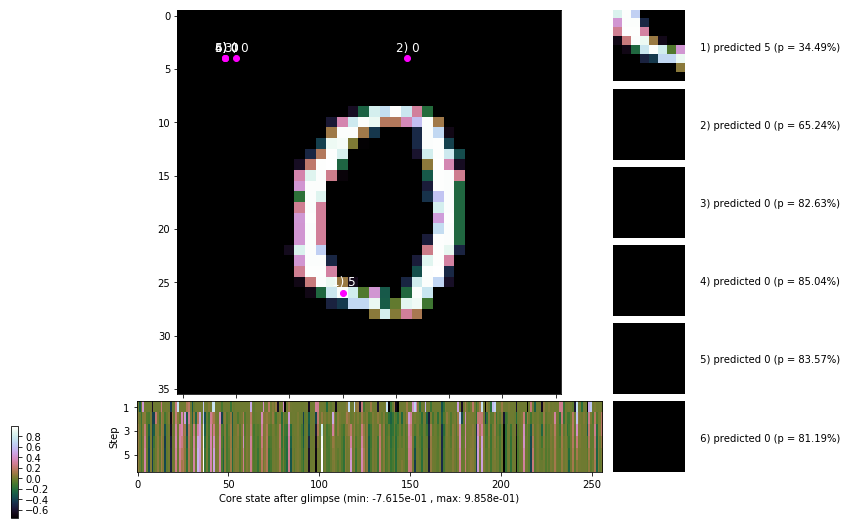


	Target class: 1 | Discounted rewards: [4.686, 4.095, 3.439, 2.710, 1.900, 1.000]


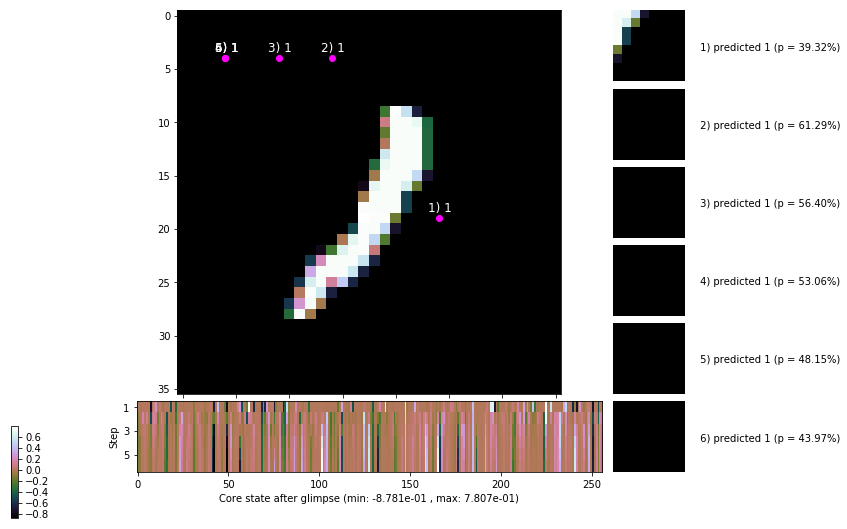

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


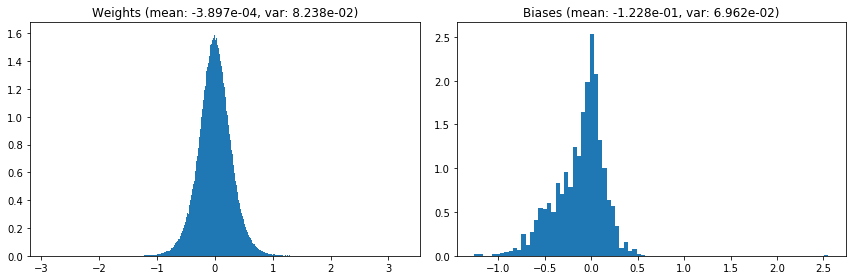

                                      Location network weights and biases


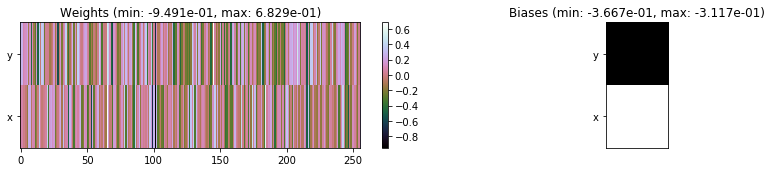

---------------------------------------------------------------------------------------------------------------
Elapsed time:  493.16 sec | TRAIN >> class loss: 0.8550 | steps:  2.892 :( | reward:  3.5492 :( | acc.: 69.808% :(
                          | VAL   >> class loss: 0.7742 | steps:  2.746    | reward:  3.6972    | acc.: 71.600% 


Epoch  47/400) lr = 0.0005014
 b    300/  3000 >> 160.4 ms/b | lr: 5.01e-04 | grad 2norm: 19.80 | grad inf norm:  5.821
         Weights || abs max:  3.23 (11083.42) | mean: -4.00e-04 ( 0.02) | var: 8.24e-02 (44168.63)
          Biases || abs max:  2.55 (  108.46) | mean: -1.22e-01 ( 0.10) | var: 6.95e-02 (   64.56)
                    class loss: 0.852 | steps: 2.909 | reward:  3.529 | acc.: 69.48%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 158.8 ms/b | lr: 5.00e-04 | grad 2norm: 20.03 | grad inf norm:  5.601
         Weights || abs max:  3.23 ( 7120.97) | mean: -3.97e-04 ( 0

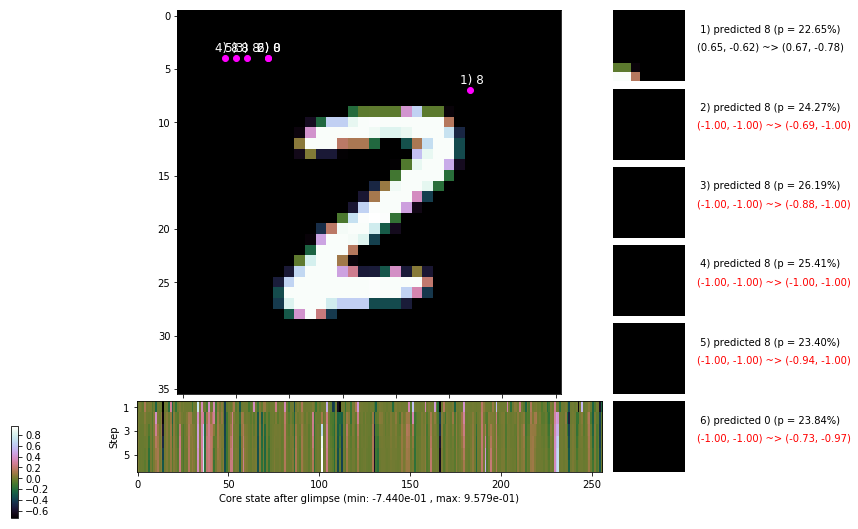

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 163.0 ms/b | lr: 4.99e-04 | grad 2norm: 20.06 | grad inf norm:  5.958
         Weights || abs max:  3.24 ( 1260.85) | mean: -4.04e-04 ( 0.01) | var: 8.26e-02 (   91.03)
          Biases || abs max:  2.55 (   87.48) | mean: -1.22e-01 ( 0.09) | var: 6.95e-02 (   50.65)
                    class loss: 0.865 | steps: 2.887 | reward:  3.534 | acc.: 69.63%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 165.8 ms/b | lr: 4.99e-04 | grad 2norm: 19.61 | grad inf norm:  5.659
         Weights || abs max:  3.24 ( 1499.17) | mean: -4.13e-04 ( 0.01) | var: 8.26e-02 (   61.64)
          Biases || abs max:  2.55 (  508.08) | mean: -1.22e-01 ( 0.26) | var: 6.97e-02 (10304.32)
                    class loss: 0.840 | steps: 2.847 | reward:  3.587 | acc.: 70.47%

	Target class: 3 | Discounted rewards: [2.786, 3.095, 3.4

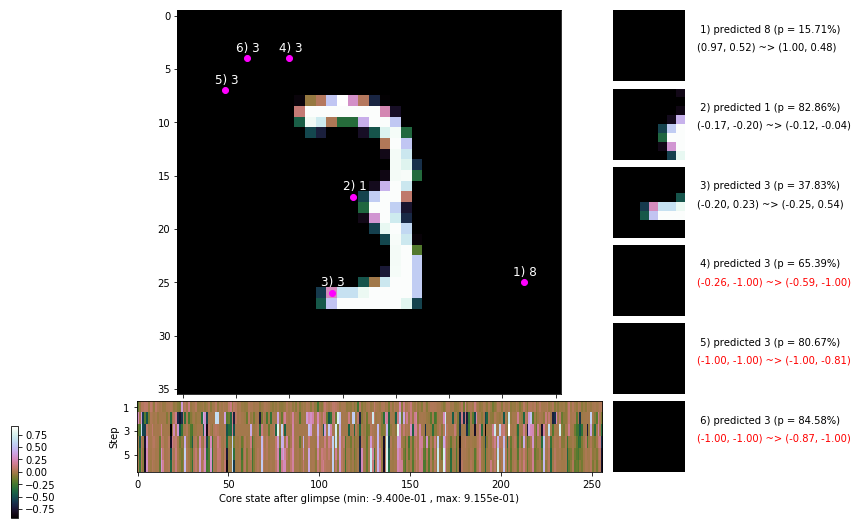

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 173.0 ms/b | lr: 4.98e-04 | grad 2norm: 19.59 | grad inf norm:  5.816
         Weights || abs max:  3.26 ( 1092.11) | mean: -3.85e-04 ( 0.01) | var: 8.27e-02 (   30.04)
          Biases || abs max:  2.56 (   73.13) | mean: -1.22e-01 ( 0.08) | var: 6.96e-02 (   31.92)
                    class loss: 0.850 | steps: 2.877 | reward:  3.562 | acc.: 70.08%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 169.2 ms/b | lr: 4.97e-04 | grad 2norm: 19.84 | grad inf norm:  5.915
         Weights || abs max:  3.26 ( 2458.72) | mean: -3.88e-04 ( 0.01) | var: 8.27e-02 (  498.32)
          Biases || abs max:  2.56 (   92.39) | mean: -1.22e-01 ( 0.10) | var: 6.96e-02 (   67.03)
                    class loss: 0.866 | steps: 2.902 | reward:  3.544 | acc.: 69.60%

	Target class: 8 | Discounted rewards: [1.247, 1.385, 1.5

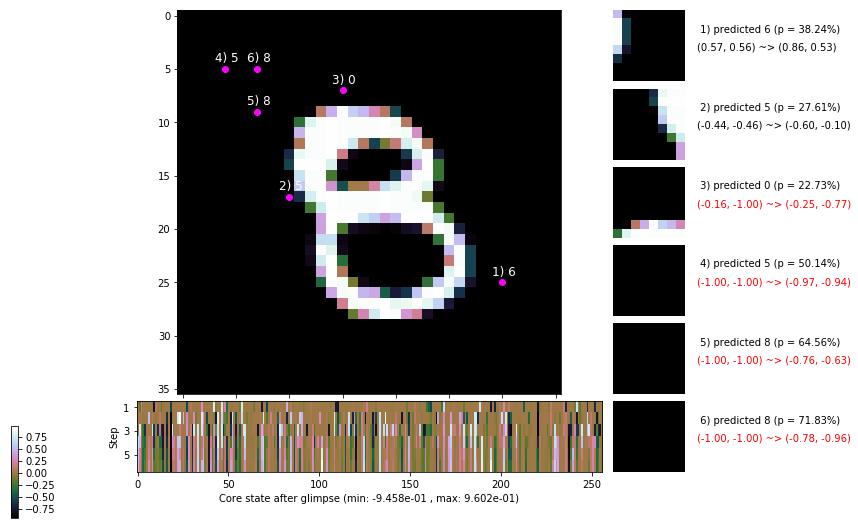

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 162.8 ms/b | lr: 4.96e-04 | grad 2norm: 19.92 | grad inf norm:  6.024
         Weights || abs max:  3.26 ( 1649.95) | mean: -3.84e-04 ( 0.01) | var: 8.28e-02 (  176.44)
          Biases || abs max:  2.55 ( 2330.12) | mean: -1.22e-01 ( 0.96) | var: 6.96e-02 (555891.88)
                    class loss: 0.879 | steps: 2.959 | reward:  3.470 | acc.: 68.45%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 160.1 ms/b | lr: 4.96e-04 | grad 2norm: 19.77 | grad inf norm:  6.127
         Weights || abs max:  3.25 ( 3408.10) | mean: -3.95e-04 ( 0.01) | var: 8.29e-02 (  728.99)
          Biases || abs max:  2.55 (  447.24) | mean: -1.22e-01 ( 0.23) | var: 6.96e-02 ( 5704.05)
                    class loss: 0.847 | steps: 2.863 | reward:  3.571 | acc.: 70.18%

	Target class: 5 | Discounted rewards: [0.000, 0.000, 0.

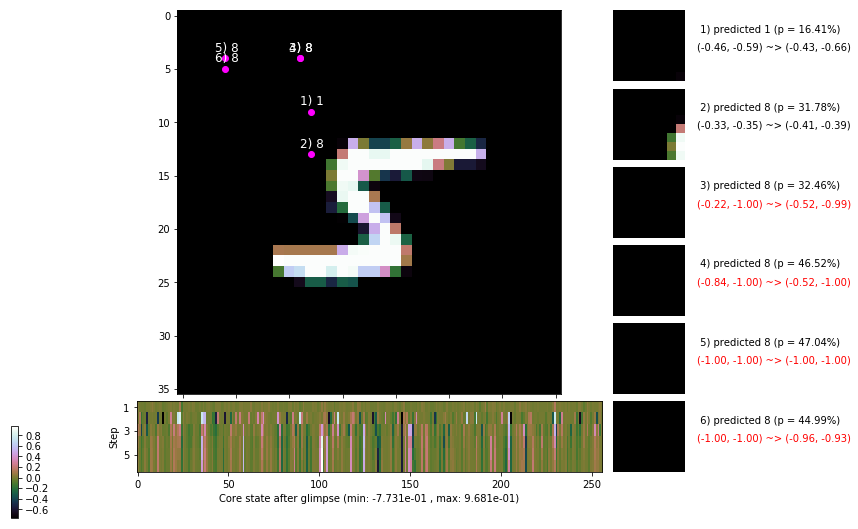

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 162.4 ms/b | lr: 4.95e-04 | grad 2norm: 19.65 | grad inf norm:  5.657
         Weights || abs max:  3.25 ( 7204.96) | mean: -4.00e-04 ( 0.02) | var: 8.29e-02 (12703.48)
          Biases || abs max:  2.56 (  111.82) | mean: -1.22e-01 ( 0.11) | var: 6.96e-02 (  110.78)
                    class loss: 0.851 | steps: 2.882 | reward:  3.549 | acc.: 69.90%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 158.4 ms/b | lr: 4.94e-04 | grad 2norm: 19.66 | grad inf norm:  5.901
         Weights || abs max:  3.26 ( 1975.29) | mean: -3.92e-04 ( 0.01) | var: 8.30e-02 (  164.89)
          Biases || abs max:  2.55 (   76.13) | mean: -1.23e-01 ( 0.09) | var: 6.96e-02 (   17.84)
                    class loss: 0.879 | steps: 2.909 | reward:  3.523 | acc.: 69.30%

	Target class: 0 | Discounted rewards: [3.686, 4.095, 3.4

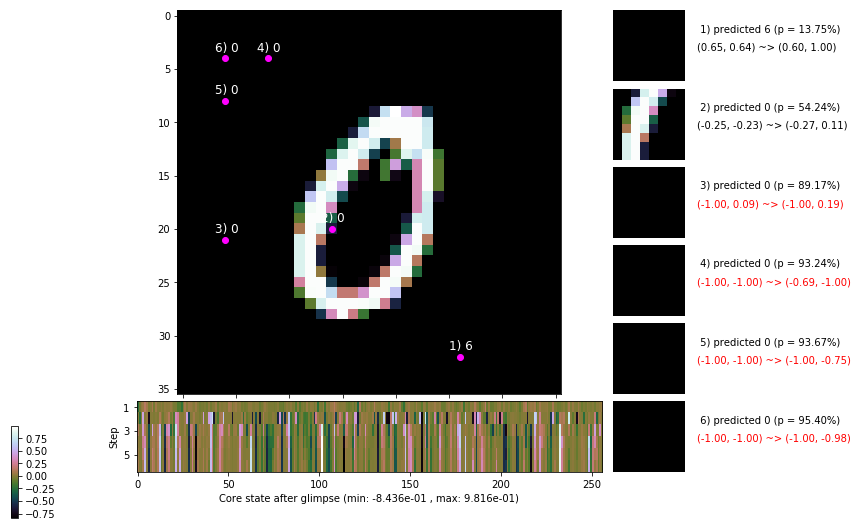

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 0 | Discounted rewards: [3.686, 4.095, 3.439, 2.710, 1.900, 1.000]


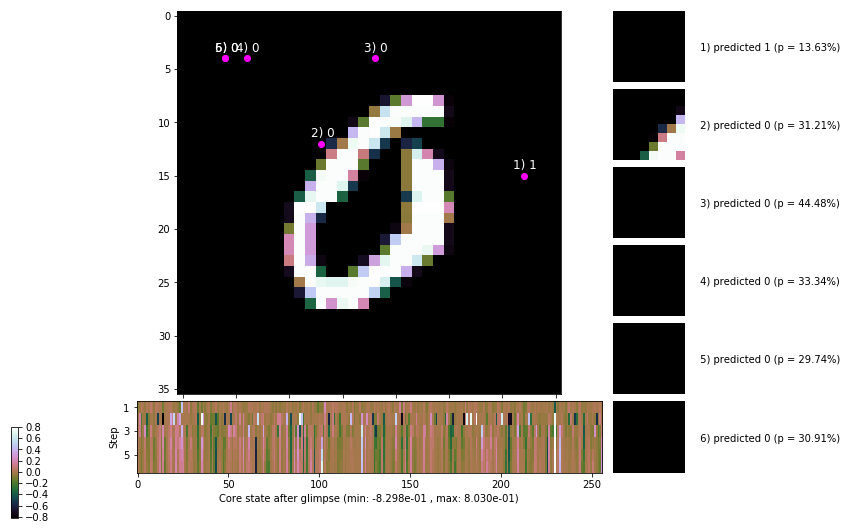


	Target class: 4 | Discounted rewards: [0.000, 0.000, 0.000, 0.000, 0.000, 0.000]


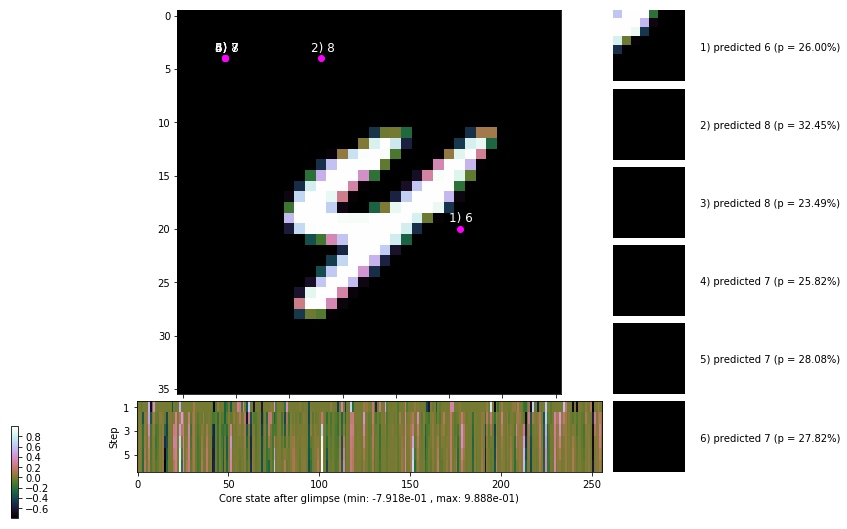

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


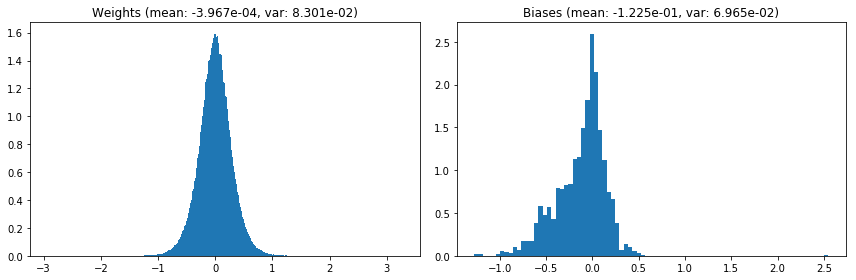

                                      Location network weights and biases


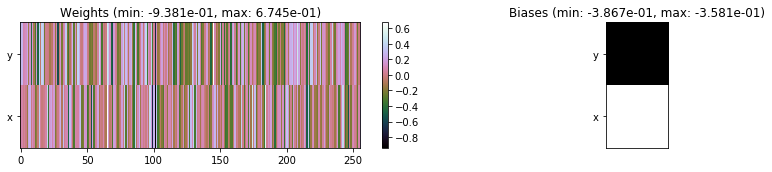

---------------------------------------------------------------------------------------------------------------
Elapsed time:  490.74 sec | TRAIN >> class loss: 0.8583 | steps:  2.893 :( | reward:  3.5409 :( | acc.: 69.693% :(
                          | VAL   >> class loss: 0.8816 | steps:  2.864 :( | reward:  3.5534 :( | acc.: 68.340% :(


Epoch  48/400) lr = 0.0004939
 b    300/  3000 >> 158.7 ms/b | lr: 4.93e-04 | grad 2norm: 19.71 | grad inf norm:  5.851
         Weights || abs max:  3.26 ( 1681.35) | mean: -4.11e-04 ( 0.01) | var: 8.30e-02 (   45.54)
          Biases || abs max:  2.55 (  168.74) | mean: -1.23e-01 ( 0.11) | var: 6.98e-02 (  900.86)
                    class loss: 0.881 | steps: 2.890 | reward:  3.523 | acc.: 69.07%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 157.7 ms/b | lr: 4.93e-04 | grad 2norm: 19.60 | grad inf norm:  5.926
         Weights || abs max:  3.27 ( 1050.42) | mean: -4.23e-04 (

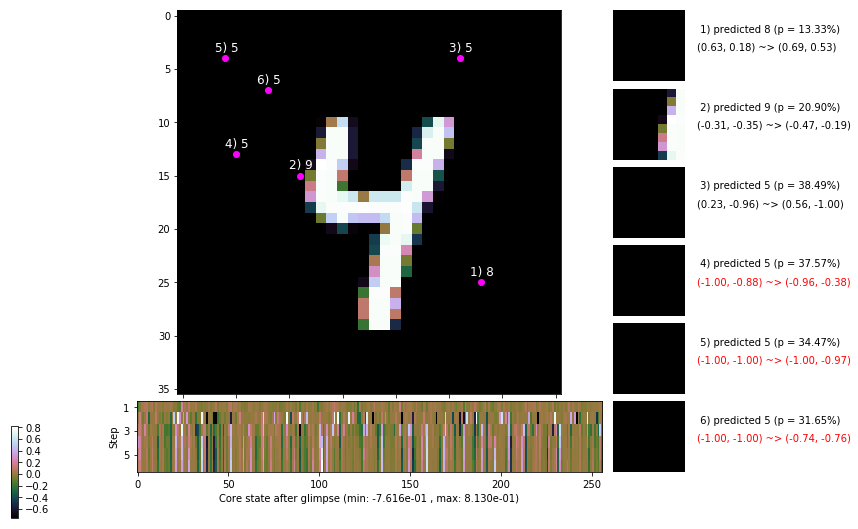

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 164.0 ms/b | lr: 4.92e-04 | grad 2norm: 19.88 | grad inf norm:  6.036
         Weights || abs max:  3.26 ( 2452.33) | mean: -4.11e-04 ( 0.01) | var: 8.32e-02 (  248.35)
          Biases || abs max:  2.53 (   81.73) | mean: -1.23e-01 ( 0.08) | var: 6.97e-02 (   14.06)
                    class loss: 0.901 | steps: 2.950 | reward:  3.450 | acc.: 67.72%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 158.6 ms/b | lr: 4.91e-04 | grad 2norm: 19.27 | grad inf norm:  5.921
         Weights || abs max:  3.27 (11334.35) | mean: -4.07e-04 ( 0.03) | var: 8.32e-02 (44938.89)
          Biases || abs max:  2.53 (  167.65) | mean: -1.23e-01 ( 0.12) | var: 6.96e-02 (  832.57)
                    class loss: 0.857 | steps: 2.860 | reward:  3.567 | acc.: 70.08%

	Target class: 6 | Discounted rewards: [2.786, 3.095, 3.4

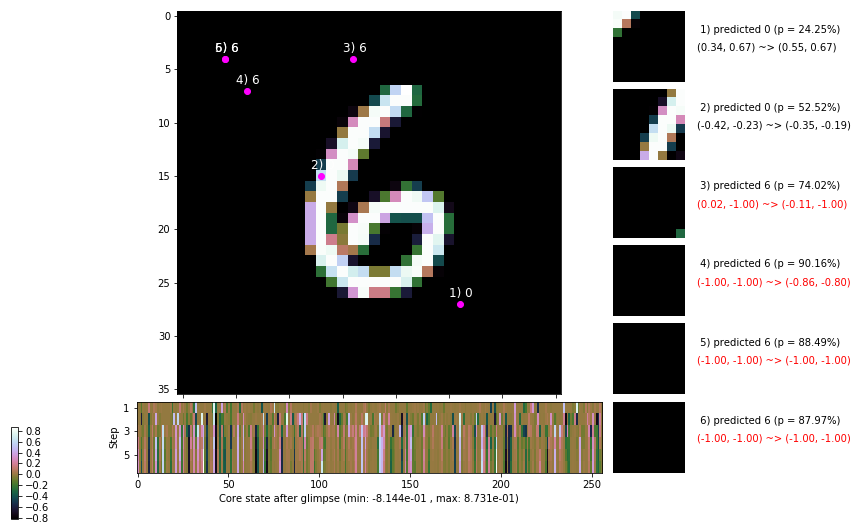

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 164.1 ms/b | lr: 4.90e-04 | grad 2norm: 19.64 | grad inf norm:  5.815
         Weights || abs max:  3.27 ( 2059.62) | mean: -4.05e-04 ( 0.01) | var: 8.33e-02 (  154.73)
          Biases || abs max:  2.53 (   95.87) | mean: -1.23e-01 ( 0.09) | var: 6.96e-02 (   38.64)
                    class loss: 0.916 | steps: 2.988 | reward:  3.423 | acc.: 67.47%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 165.2 ms/b | lr: 4.90e-04 | grad 2norm: 19.26 | grad inf norm:  5.846
         Weights || abs max:  3.27 ( 5614.70) | mean: -4.13e-04 ( 0.02) | var: 8.34e-02 ( 1580.88)
          Biases || abs max:  2.52 (   99.73) | mean: -1.23e-01 ( 0.10) | var: 6.97e-02 (   70.35)
                    class loss: 0.907 | steps: 2.953 | reward:  3.478 | acc.: 68.12%

	Target class: 4 | Discounted rewards: [3.686, 4.095, 3.4

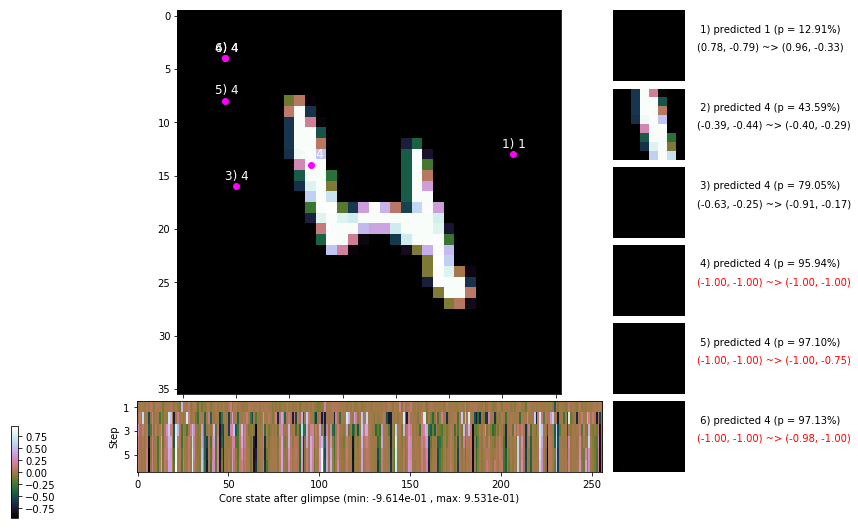

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 174.4 ms/b | lr: 4.89e-04 | grad 2norm: 18.86 | grad inf norm:  5.317
         Weights || abs max:  3.26 ( 3998.16) | mean: -4.18e-04 ( 0.01) | var: 8.34e-02 ( 4378.46)
          Biases || abs max:  2.52 (  157.07) | mean: -1.23e-01 ( 0.12) | var: 6.96e-02 (  303.60)
                    class loss: 0.877 | steps: 2.956 | reward:  3.495 | acc.: 68.52%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 169.5 ms/b | lr: 4.89e-04 | grad 2norm: 19.64 | grad inf norm:  5.783
         Weights || abs max:  3.28 ( 2296.48) | mean: -4.37e-04 ( 0.01) | var: 8.35e-02 (   99.68)
          Biases || abs max:  2.52 (  270.53) | mean: -1.23e-01 ( 0.17) | var: 6.97e-02 ( 2672.29)
                    class loss: 0.920 | steps: 2.982 | reward:  3.428 | acc.: 67.37%

	Target class: 4 | Discounted rewards: [3.686, 4.095, 3.4

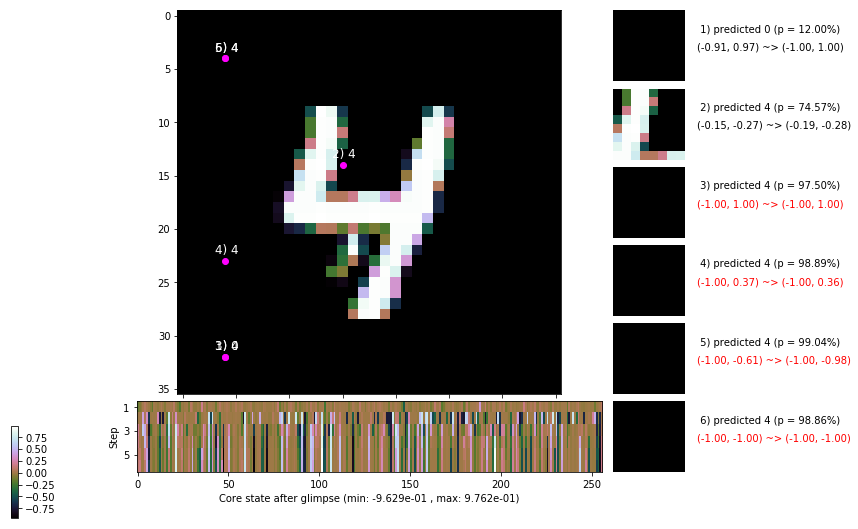

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 163.8 ms/b | lr: 4.88e-04 | grad 2norm: 19.67 | grad inf norm:  6.022
         Weights || abs max:  3.29 ( 7619.31) | mean: -4.22e-04 ( 0.02) | var: 8.35e-02 (17097.32)
          Biases || abs max:  2.52 (  112.41) | mean: -1.23e-01 ( 0.10) | var: 6.98e-02 (   50.31)
                    class loss: 0.902 | steps: 2.971 | reward:  3.439 | acc.: 67.57%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 161.4 ms/b | lr: 4.87e-04 | grad 2norm: 19.21 | grad inf norm:  5.770
         Weights || abs max:  3.29 ( 2214.14) | mean: -4.22e-04 ( 0.01) | var: 8.36e-02 (  320.94)
          Biases || abs max:  2.52 ( 2689.06) | mean: -1.23e-01 ( 1.11) | var: 6.98e-02 (788917.25)
                    class loss: 0.879 | steps: 2.948 | reward:  3.481 | acc.: 69.02%

	Target class: 5 | Discounted rewards: [0.000, 0.000, 0.

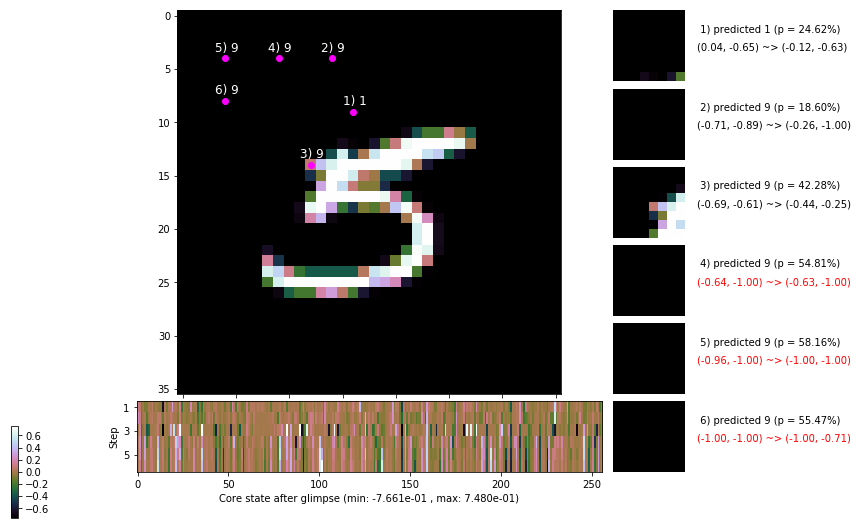

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 9 | Discounted rewards: [3.686, 4.095, 3.439, 2.710, 1.900, 1.000]


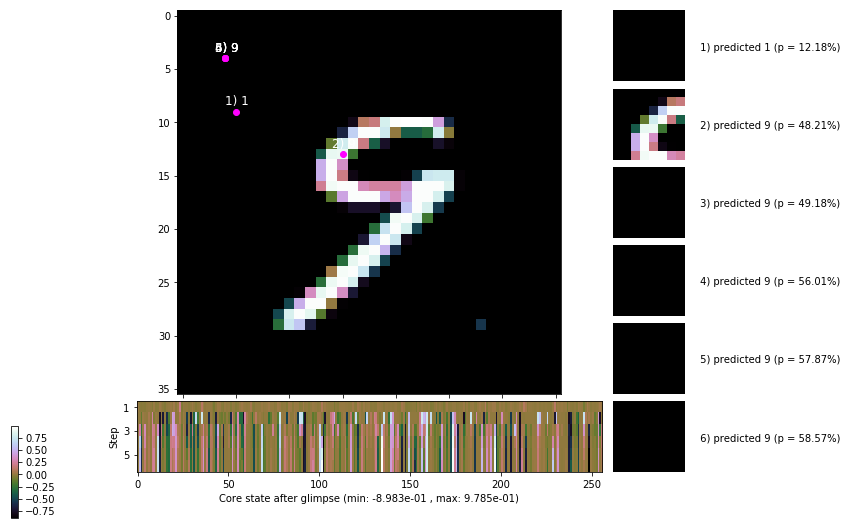


	Target class: 0 | Discounted rewards: [3.686, 4.095, 3.439, 2.710, 1.900, 1.000]


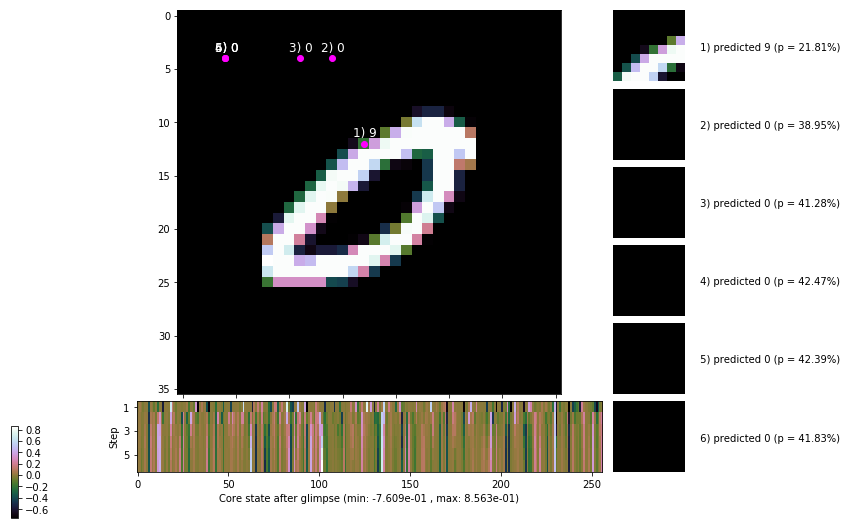

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


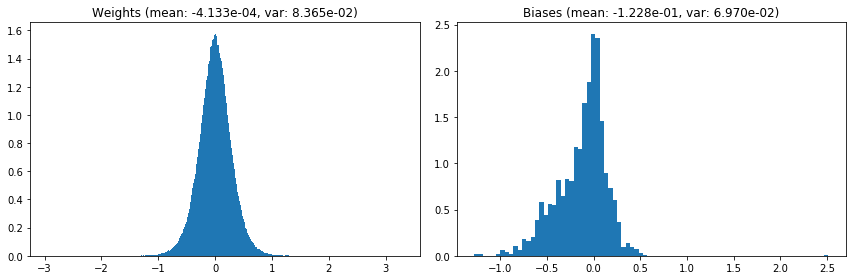

                                      Location network weights and biases


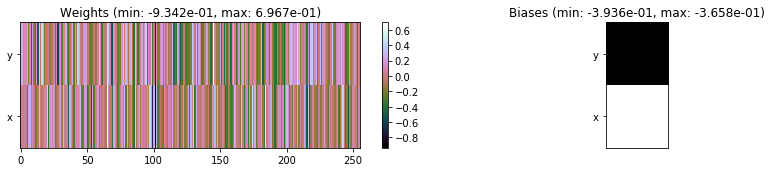

---------------------------------------------------------------------------------------------------------------
Elapsed time:  492.10 sec | TRAIN >> class loss: 0.8919 | steps:  2.941 :( | reward:  3.4785 :( | acc.: 68.328% :(
                          | VAL   >> class loss: 0.8907 | steps:  2.898 :( | reward:  3.5414 :( | acc.: 68.000% :(


Epoch  49/400) lr = 0.0004866
 b    300/  3000 >> 160.4 ms/b | lr: 4.86e-04 | grad 2norm: 19.51 | grad inf norm:  5.844
         Weights || abs max:  3.29 ( 2029.86) | mean: -4.25e-04 ( 0.01) | var: 8.37e-02 (  281.89)
          Biases || abs max:  2.52 (  109.29) | mean: -1.23e-01 ( 0.10) | var: 6.97e-02 (   36.09)
                    class loss: 0.889 | steps: 2.928 | reward:  3.488 | acc.: 68.60%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 161.5 ms/b | lr: 4.86e-04 | grad 2norm: 19.23 | grad inf norm:  5.749
         Weights || abs max:  3.29 ( 1608.66) | mean: -4.19e-04 (

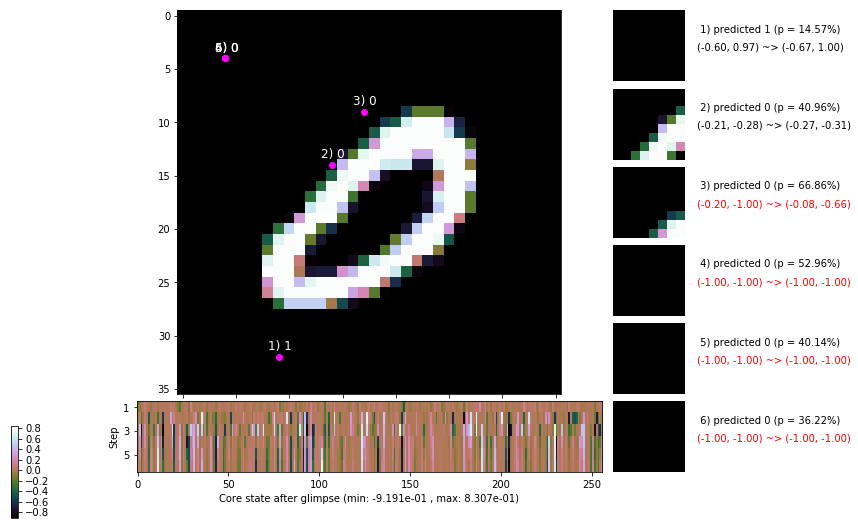

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 160.5 ms/b | lr: 4.85e-04 | grad 2norm: 19.81 | grad inf norm:  5.933
         Weights || abs max:  3.28 ( 2010.46) | mean: -4.19e-04 ( 0.01) | var: 8.38e-02 (  127.32)
          Biases || abs max:  2.51 (   69.83) | mean: -1.23e-01 ( 0.07) | var: 6.97e-02 (   57.48)
                    class loss: 0.899 | steps: 2.983 | reward:  3.434 | acc.: 67.53%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 159.7 ms/b | lr: 4.84e-04 | grad 2norm: 19.54 | grad inf norm:  5.794
         Weights || abs max:  3.29 ( 1330.24) | mean: -4.47e-04 ( 0.01) | var: 8.39e-02 (   30.39)
          Biases || abs max:  2.50 (  186.90) | mean: -1.23e-01 ( 0.14) | var: 6.98e-02 (  693.40)
                    class loss: 0.917 | steps: 2.991 | reward:  3.418 | acc.: 67.13%

	Target class: 1 | Discounted rewards: [4.686, 4.095, 3.4

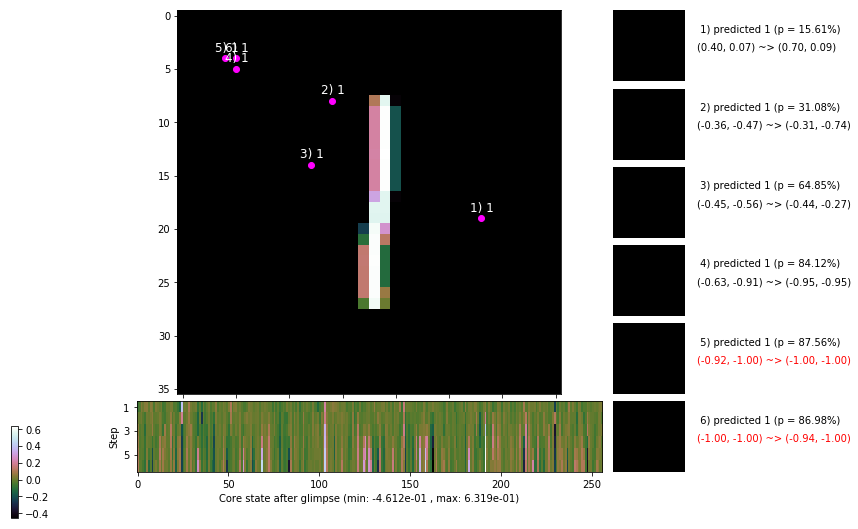

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 162.3 ms/b | lr: 4.83e-04 | grad 2norm: 19.31 | grad inf norm:  5.700
         Weights || abs max:  3.29 ( 2239.65) | mean: -4.43e-04 ( 0.01) | var: 8.39e-02 (  583.53)
          Biases || abs max:  2.50 (   63.01) | mean: -1.23e-01 ( 0.07) | var: 6.98e-02 (   12.39)
                    class loss: 0.931 | steps: 2.974 | reward:  3.439 | acc.: 67.63%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 158.2 ms/b | lr: 4.83e-04 | grad 2norm: 19.29 | grad inf norm:  5.767
         Weights || abs max:  3.29 ( 2006.50) | mean: -4.39e-04 ( 0.01) | var: 8.40e-02 (   76.99)
          Biases || abs max:  2.50 (   98.84) | mean: -1.23e-01 ( 0.10) | var: 6.98e-02 (  533.23)
                    class loss: 0.897 | steps: 2.937 | reward:  3.477 | acc.: 68.33%

	Target class: 5 | Discounted rewards: [0.000, 0.000, 0.0

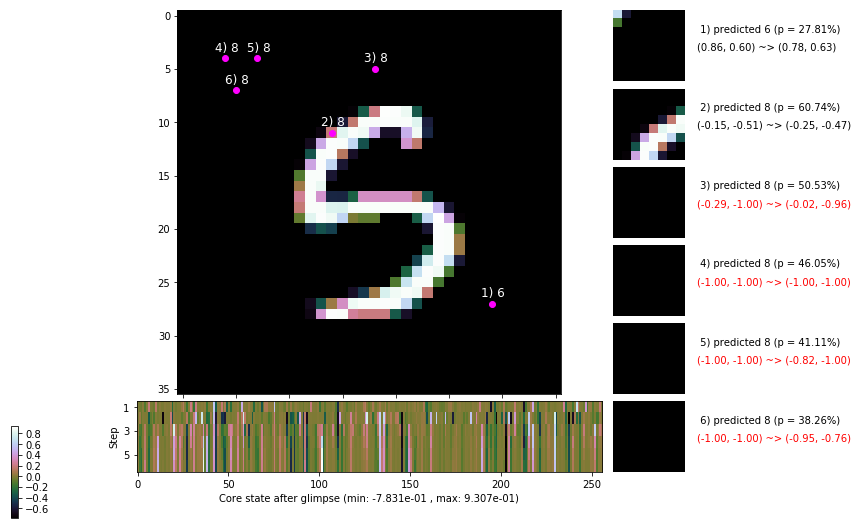

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 163.7 ms/b | lr: 4.82e-04 | grad 2norm: 19.48 | grad inf norm:  5.789
         Weights || abs max:  3.29 ( 3132.07) | mean: -4.22e-04 ( 0.01) | var: 8.40e-02 (  454.49)
          Biases || abs max:  2.50 (   72.34) | mean: -1.23e-01 ( 0.08) | var: 6.98e-02 (   53.65)
                    class loss: 0.874 | steps: 2.953 | reward:  3.503 | acc.: 69.33%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 168.7 ms/b | lr: 4.81e-04 | grad 2norm: 19.50 | grad inf norm:  5.858
         Weights || abs max:  3.29 ( 2159.84) | mean: -4.29e-04 ( 0.01) | var: 8.41e-02 (   55.53)
          Biases || abs max:  2.50 (   75.42) | mean: -1.24e-01 ( 0.08) | var: 6.99e-02 (   14.60)
                    class loss: 0.915 | steps: 2.953 | reward:  3.473 | acc.: 68.17%

	Target class: 2 | Discounted rewards: [0.810, 0.900, 1.0

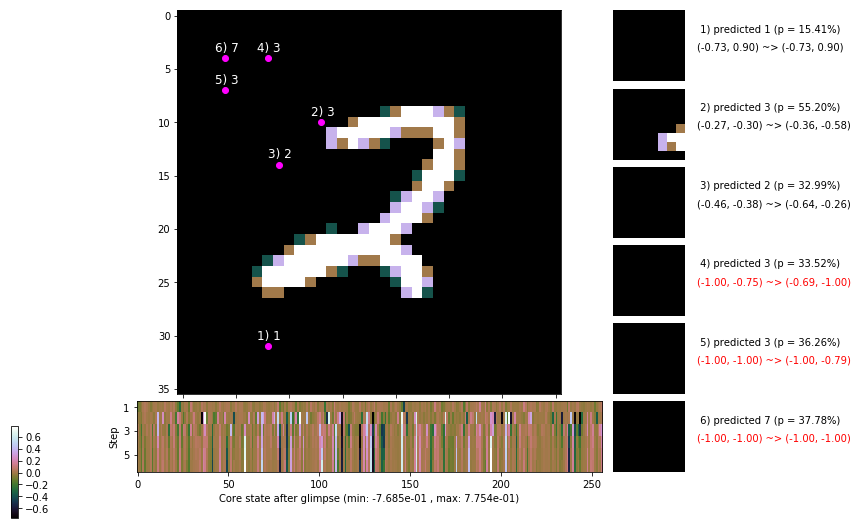

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 173.1 ms/b | lr: 4.80e-04 | grad 2norm: 19.49 | grad inf norm:  5.548
         Weights || abs max:  3.30 ( 2012.41) | mean: -4.19e-04 ( 0.01) | var: 8.42e-02 (  358.52)
          Biases || abs max:  2.50 (  580.35) | mean: -1.24e-01 ( 0.30) | var: 6.99e-02 ( 7046.05)
                    class loss: 0.896 | steps: 2.946 | reward:  3.477 | acc.: 68.22%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 170.7 ms/b | lr: 4.80e-04 | grad 2norm: 19.41 | grad inf norm:  5.916
         Weights || abs max:  3.31 ( 2366.98) | mean: -4.03e-04 ( 0.01) | var: 8.42e-02 (  567.93)
          Biases || abs max:  2.50 (   63.95) | mean: -1.24e-01 ( 0.08) | var: 7.00e-02 (    6.33)
                    class loss: 0.874 | steps: 2.927 | reward:  3.505 | acc.: 68.77%

	Target class: 2 | Discounted rewards: [2.786, 3.095, 3.4

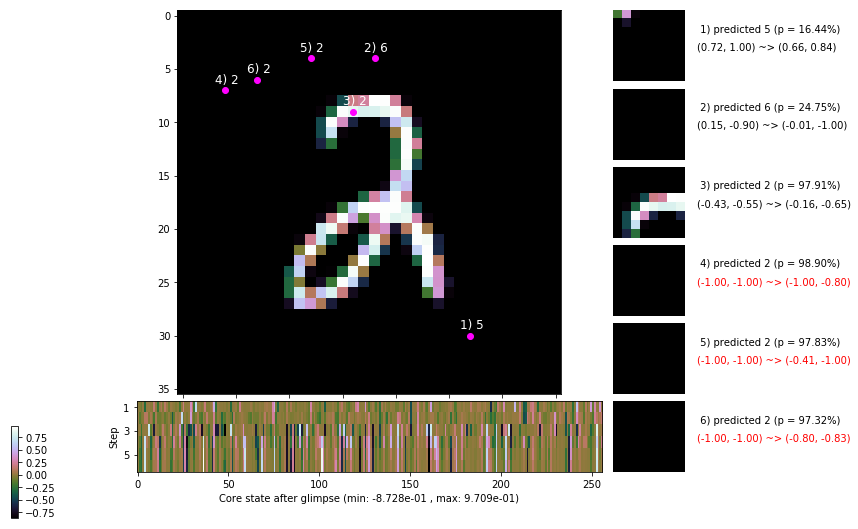

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 6 | Discounted rewards: [3.686, 4.095, 3.439, 2.710, 1.900, 1.000]


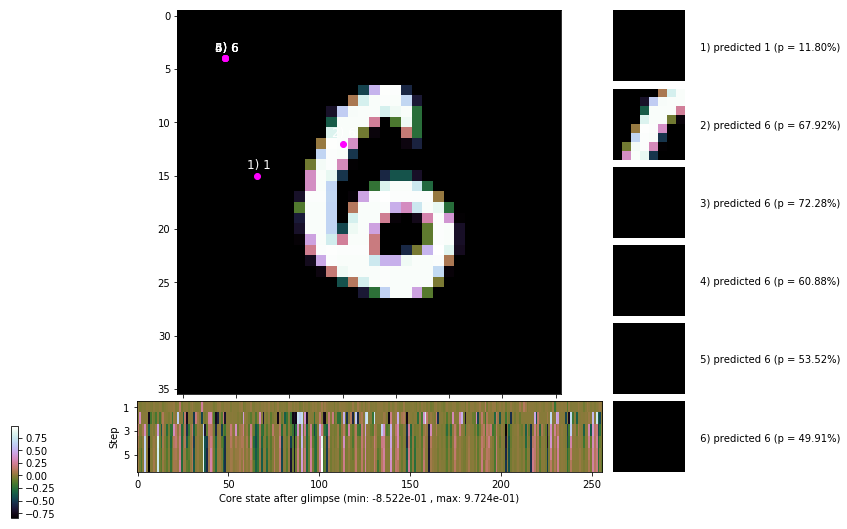


	Target class: 9 | Discounted rewards: [2.786, 3.095, 3.439, 2.710, 1.900, 1.000]


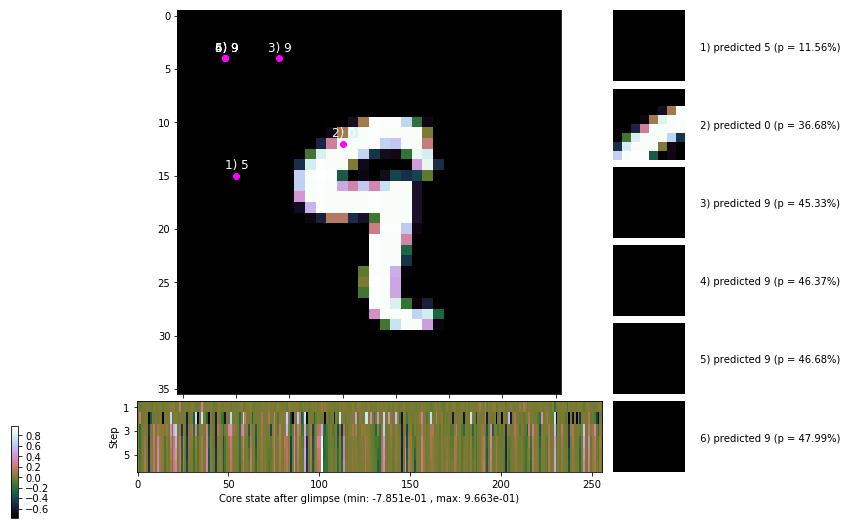

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


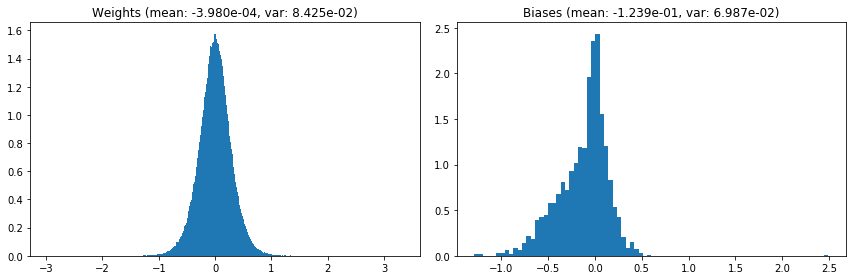

                                      Location network weights and biases


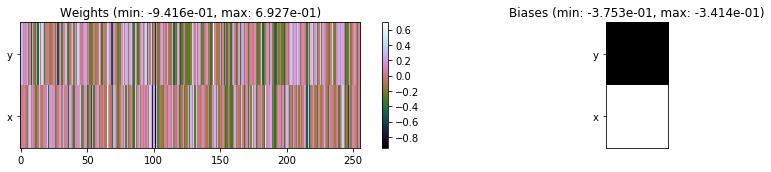

---------------------------------------------------------------------------------------------------------------
Elapsed time:  492.32 sec | TRAIN >> class loss: 0.9002 | steps:  2.955 :( | reward:  3.4675 :( | acc.: 68.127% :(
                          | VAL   >> class loss: 0.8403 | steps:  2.861 :( | reward:  3.6028 :( | acc.: 70.320% :(


Epoch  50/400) lr = 0.0004793
 b    300/  3000 >> 163.0 ms/b | lr: 4.79e-04 | grad 2norm: 19.64 | grad inf norm:  6.099
         Weights || abs max:  3.32 ( 1009.76) | mean: -4.08e-04 ( 0.01) | var: 8.43e-02 (   26.73)
          Biases || abs max:  2.49 (  100.77) | mean: -1.24e-01 ( 0.10) | var: 6.99e-02 (   44.10)
                    class loss: 0.889 | steps: 2.951 | reward:  3.451 | acc.: 68.03%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 161.4 ms/b | lr: 4.78e-04 | grad 2norm: 19.50 | grad inf norm:  5.791
         Weights || abs max:  3.32 ( 2262.17) | mean: -4.31e-04 (

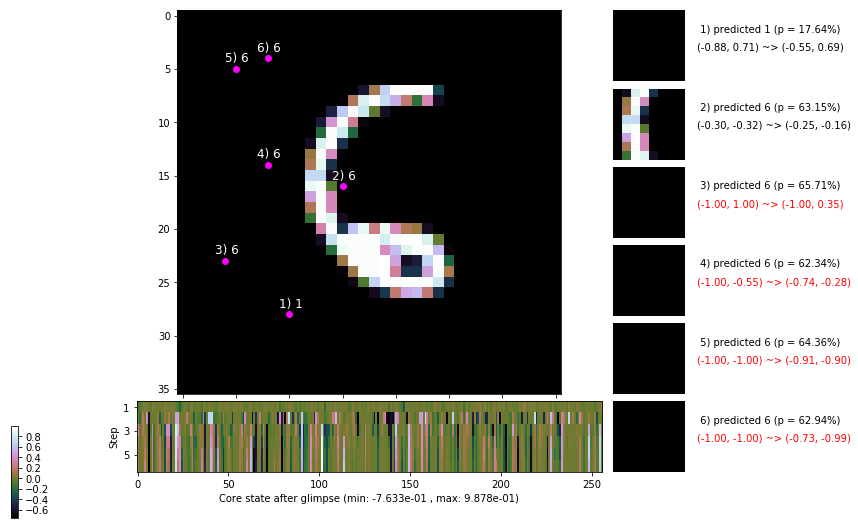

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 164.9 ms/b | lr: 4.77e-04 | grad 2norm: 19.36 | grad inf norm:  5.755
         Weights || abs max:  3.31 ( 2127.17) | mean: -4.12e-04 ( 0.01) | var: 8.44e-02 (  145.70)
          Biases || abs max:  2.49 (  156.68) | mean: -1.24e-01 ( 0.12) | var: 7.01e-02 (  185.20)
                    class loss: 0.917 | steps: 2.971 | reward:  3.422 | acc.: 67.22%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 158.9 ms/b | lr: 4.77e-04 | grad 2norm: 19.18 | grad inf norm:  5.849
         Weights || abs max:  3.31 ( 1025.23) | mean: -4.02e-04 ( 0.01) | var: 8.45e-02 (   10.00)
          Biases || abs max:  2.50 (  139.53) | mean: -1.24e-01 ( 0.11) | var: 7.02e-02 (  441.41)
                    class loss: 0.871 | steps: 2.887 | reward:  3.549 | acc.: 69.57%

	Target class: 5 | Discounted rewards: [0.000, 0.000, 0.0

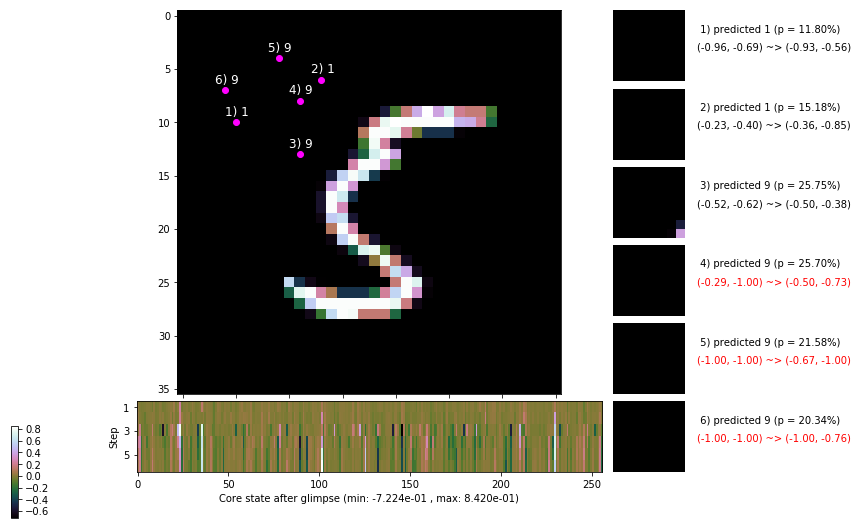

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 161.7 ms/b | lr: 4.76e-04 | grad 2norm: 19.41 | grad inf norm:  5.771
         Weights || abs max:  3.31 ( 2137.71) | mean: -4.25e-04 ( 0.01) | var: 8.45e-02 (   70.46)
          Biases || abs max:  2.51 (  142.15) | mean: -1.24e-01 ( 0.12) | var: 7.00e-02 (  258.76)
                    class loss: 0.865 | steps: 2.893 | reward:  3.547 | acc.: 69.53%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 158.0 ms/b | lr: 4.76e-04 | grad 2norm: 19.60 | grad inf norm:  5.893
         Weights || abs max:  3.31 ( 3660.41) | mean: -4.73e-04 ( 0.01) | var: 8.46e-02 (  475.86)
          Biases || abs max:  2.51 (   58.26) | mean: -1.23e-01 ( 0.07) | var: 6.99e-02 (   11.08)
                    class loss: 0.859 | steps: 2.897 | reward:  3.533 | acc.: 69.47%

	Target class: 6 | Discounted rewards: [3.686, 4.095, 3.4

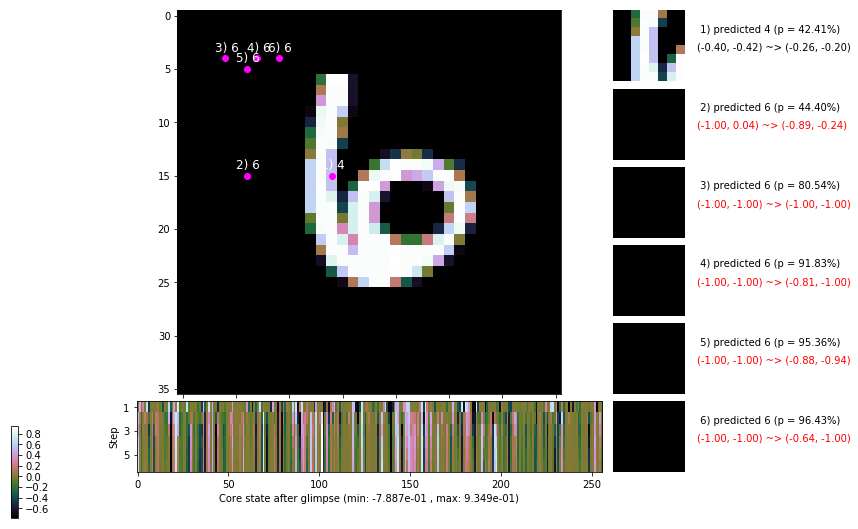

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 162.7 ms/b | lr: 4.75e-04 | grad 2norm: 19.45 | grad inf norm:  5.765
         Weights || abs max:  3.32 ( 1683.78) | mean: -4.79e-04 ( 0.01) | var: 8.47e-02 (   59.37)
          Biases || abs max:  2.52 (   72.11) | mean: -1.24e-01 ( 0.07) | var: 6.98e-02 (   61.92)
                    class loss: 0.835 | steps: 2.874 | reward:  3.566 | acc.: 69.87%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 159.4 ms/b | lr: 4.74e-04 | grad 2norm: 19.67 | grad inf norm:  5.636
         Weights || abs max:  3.33 ( 2191.12) | mean: -4.77e-04 ( 0.01) | var: 8.47e-02 (  223.68)
          Biases || abs max:  2.52 (  159.94) | mean: -1.24e-01 ( 0.13) | var: 7.00e-02 (  151.42)
                    class loss: 0.875 | steps: 2.903 | reward:  3.514 | acc.: 68.48%

	Target class: 0 | Discounted rewards: [4.686, 4.095, 3.4

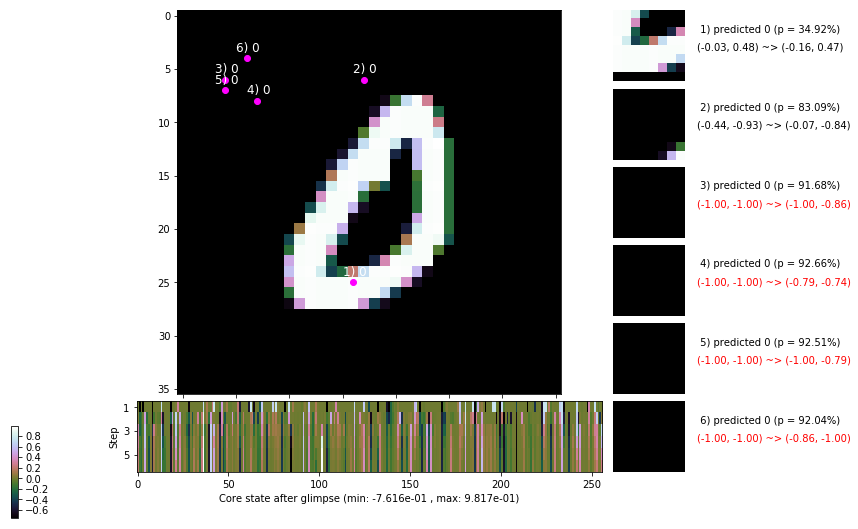

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 163.3 ms/b | lr: 4.73e-04 | grad 2norm: 19.42 | grad inf norm:  5.732
         Weights || abs max:  3.34 ( 1614.22) | mean: -4.98e-04 ( 0.01) | var: 8.48e-02 (   57.58)
          Biases || abs max:  2.52 (   92.38) | mean: -1.24e-01 ( 0.09) | var: 7.00e-02 (   57.31)
                    class loss: 0.855 | steps: 2.866 | reward:  3.570 | acc.: 69.82%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 174.0 ms/b | lr: 4.73e-04 | grad 2norm: 19.87 | grad inf norm:  6.247
         Weights || abs max:  3.34 ( 1266.56) | mean: -5.10e-04 ( 0.01) | var: 8.48e-02 (   23.68)
          Biases || abs max:  2.53 (   76.20) | mean: -1.24e-01 ( 0.09) | var: 7.02e-02 (  119.43)
                    class loss: 0.856 | steps: 2.883 | reward:  3.557 | acc.: 69.92%

	Target class: 0 | Discounted rewards: [3.686, 4.095, 3.4

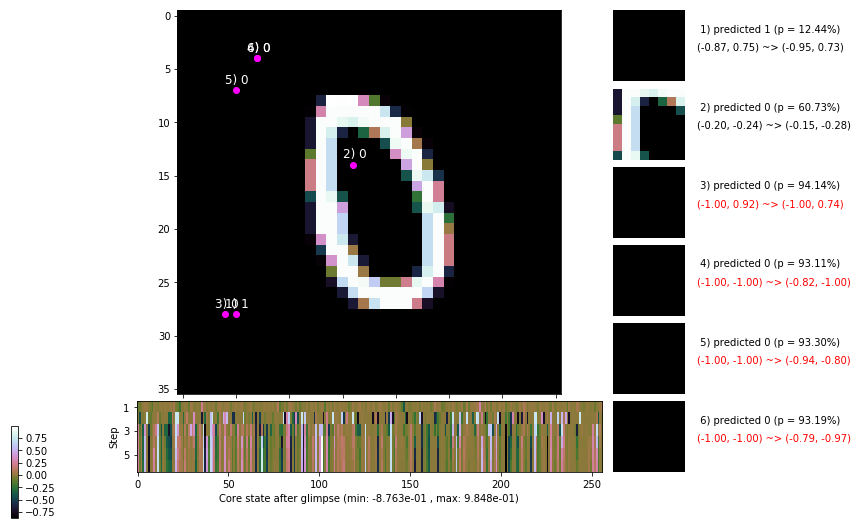

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 9 | Discounted rewards: [3.686, 4.095, 3.439, 2.710, 1.900, 1.000]


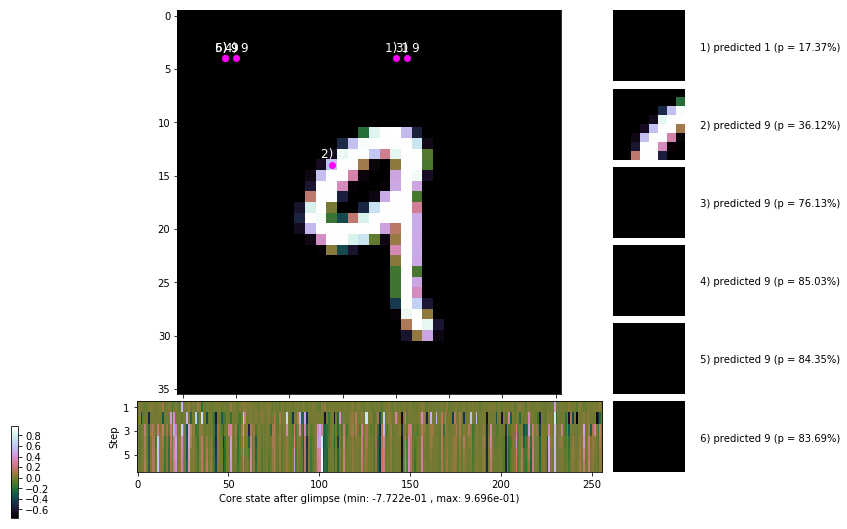


	Target class: 0 | Discounted rewards: [4.686, 4.095, 3.439, 2.710, 1.900, 1.000]


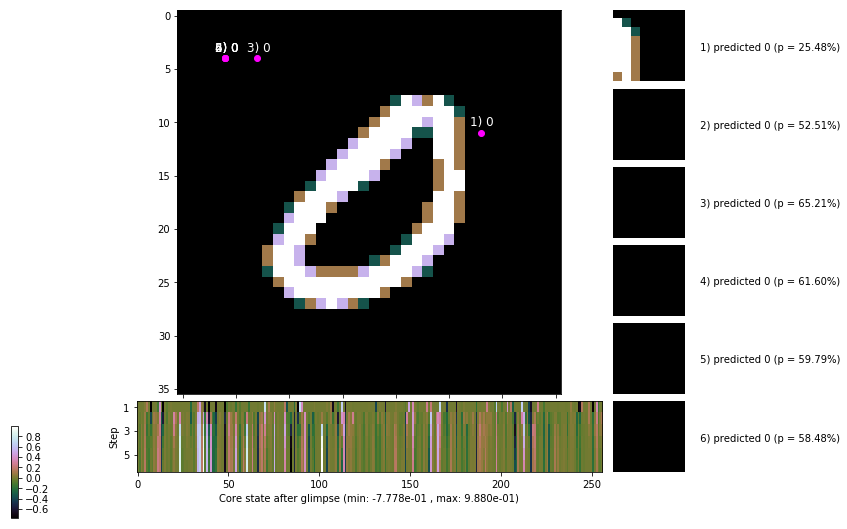

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


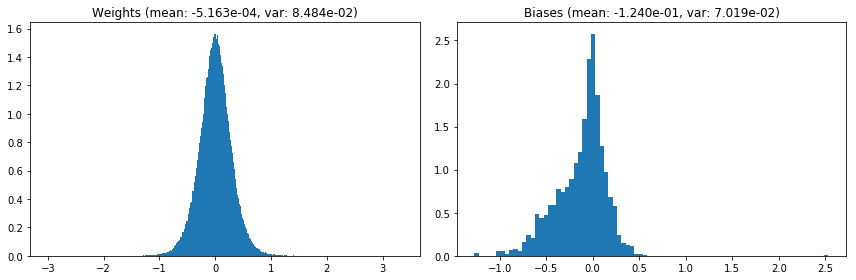

                                      Location network weights and biases


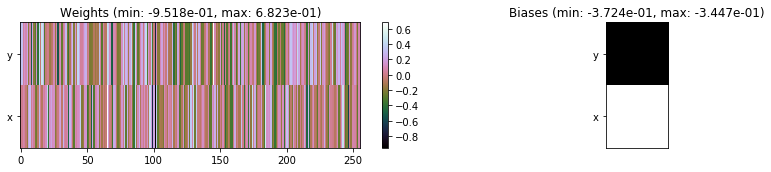

---------------------------------------------------------------------------------------------------------------
Elapsed time:  489.18 sec | TRAIN >> class loss: 0.8695 | steps:  2.902 :( | reward:  3.5255 :( | acc.: 69.107% :(
                          | VAL   >> class loss: 0.8191 | steps:  2.795 :( | reward:  3.6460 :( | acc.: 70.560% :(


Epoch  51/400) lr = 0.0004722
 b    300/  3000 >> 168.2 ms/b | lr: 4.72e-04 | grad 2norm: 19.42 | grad inf norm:  6.024
         Weights || abs max:  3.34 ( 2924.05) | mean: -5.28e-04 ( 0.01) | var: 8.49e-02 (  239.90)
          Biases || abs max:  2.54 (  293.47) | mean: -1.24e-01 ( 0.22) | var: 7.03e-02 ( 3699.41)
                    class loss: 0.835 | steps: 2.865 | reward:  3.597 | acc.: 70.72%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 160.7 ms/b | lr: 4.71e-04 | grad 2norm: 19.43 | grad inf norm:  5.911
         Weights || abs max:  3.35 ( 3178.08) | mean: -5.22e-04 (

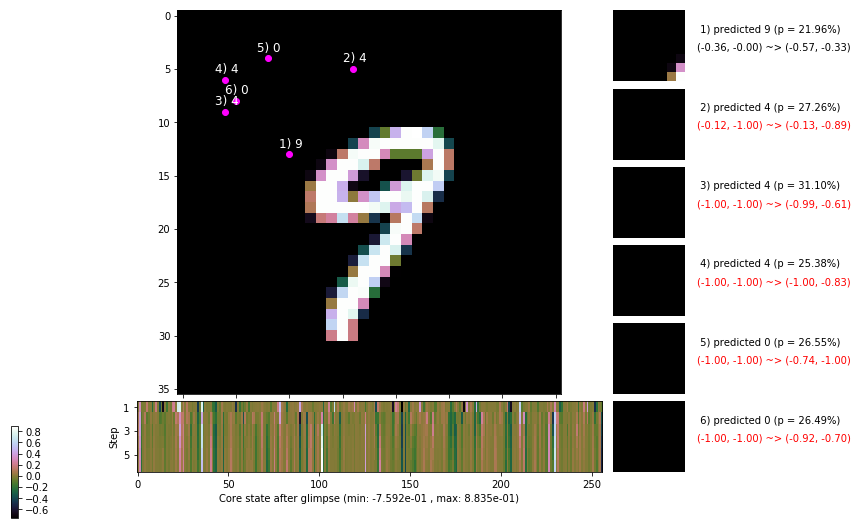

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 160.5 ms/b | lr: 4.70e-04 | grad 2norm: 19.81 | grad inf norm:  6.063
         Weights || abs max:  3.35 ( 1004.91) | mean: -5.08e-04 ( 0.01) | var: 8.50e-02 (   38.95)
          Biases || abs max:  2.52 (  202.73) | mean: -1.24e-01 ( 0.16) | var: 7.02e-02 (  854.79)
                    class loss: 0.884 | steps: 2.931 | reward:  3.497 | acc.: 68.38%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 165.3 ms/b | lr: 4.70e-04 | grad 2norm: 19.72 | grad inf norm:  6.011
         Weights || abs max:  3.36 ( 1956.33) | mean: -4.89e-04 ( 0.01) | var: 8.50e-02 (  600.95)
          Biases || abs max:  2.52 (  116.87) | mean: -1.24e-01 ( 0.10) | var: 7.01e-02 (   59.80)
                    class loss: 0.869 | steps: 2.917 | reward:  3.511 | acc.: 69.10%

	Target class: 7 | Discounted rewards: [3.686, 4.095, 3.4

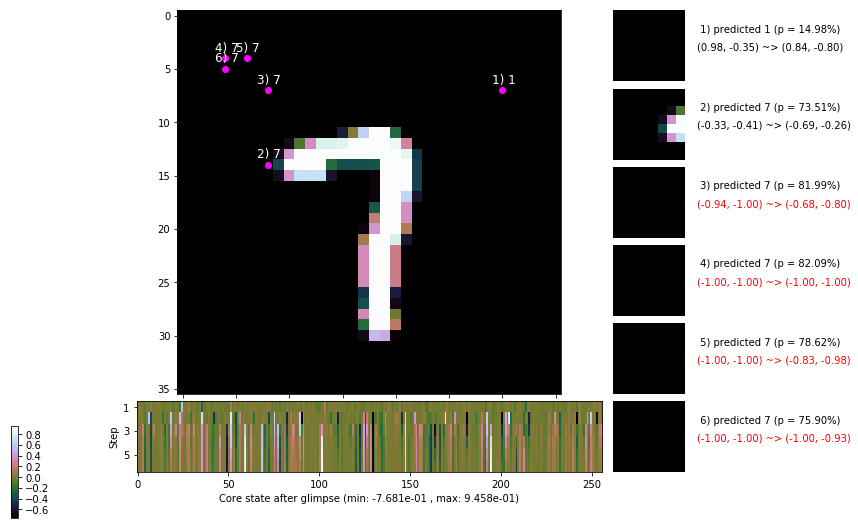

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 162.5 ms/b | lr: 4.69e-04 | grad 2norm: 19.46 | grad inf norm:  6.030
         Weights || abs max:  3.35 ( 4423.67) | mean: -4.90e-04 ( 0.01) | var: 8.51e-02 ( 3145.76)
          Biases || abs max:  2.52 (  163.27) | mean: -1.24e-01 ( 0.12) | var: 7.00e-02 (  208.01)
                    class loss: 0.858 | steps: 2.886 | reward:  3.532 | acc.: 69.27%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 159.3 ms/b | lr: 4.68e-04 | grad 2norm: 19.65 | grad inf norm:  5.899
         Weights || abs max:  3.35 ( 1704.04) | mean: -4.94e-04 ( 0.01) | var: 8.51e-02 (   85.50)
          Biases || abs max:  2.53 (  103.88) | mean: -1.23e-01 ( 0.10) | var: 6.99e-02 (   40.91)
                    class loss: 0.873 | steps: 2.874 | reward:  3.522 | acc.: 69.32%

	Target class: 0 | Discounted rewards: [2.786, 3.095, 3.4

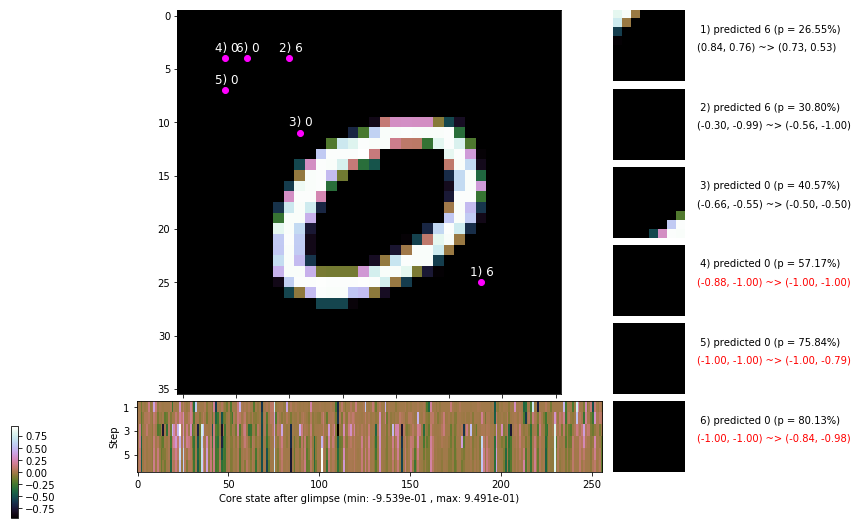

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 162.5 ms/b | lr: 4.67e-04 | grad 2norm: 19.33 | grad inf norm:  6.144
         Weights || abs max:  3.35 ( 1785.70) | mean: -4.94e-04 ( 0.01) | var: 8.52e-02 (   43.55)
          Biases || abs max:  2.53 (  155.61) | mean: -1.24e-01 ( 0.12) | var: 7.01e-02 (  181.83)
                    class loss: 0.886 | steps: 2.941 | reward:  3.497 | acc.: 68.82%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 160.1 ms/b | lr: 4.67e-04 | grad 2norm: 19.52 | grad inf norm:  5.988
         Weights || abs max:  3.35 ( 1692.60) | mean: -4.87e-04 ( 0.01) | var: 8.52e-02 (   40.44)
          Biases || abs max:  2.53 (  123.98) | mean: -1.24e-01 ( 0.11) | var: 7.02e-02 (  100.99)
                    class loss: 0.902 | steps: 2.932 | reward:  3.489 | acc.: 68.58%

	Target class: 3 | Discounted rewards: [0.000, 0.000, 0.0

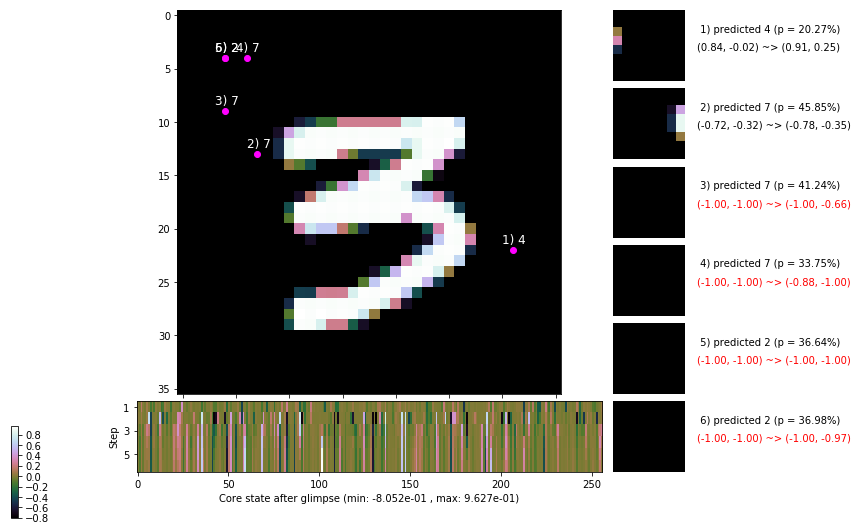

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 164.1 ms/b | lr: 4.66e-04 | grad 2norm: 19.15 | grad inf norm:  5.621
         Weights || abs max:  3.36 ( 2074.21) | mean: -4.75e-04 ( 0.01) | var: 8.53e-02 (  163.61)
          Biases || abs max:  2.53 (  111.96) | mean: -1.23e-01 ( 0.11) | var: 7.00e-02 (   50.49)
                    class loss: 0.872 | steps: 2.927 | reward:  3.491 | acc.: 68.77%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 159.2 ms/b | lr: 4.66e-04 | grad 2norm: 19.23 | grad inf norm:  5.689
         Weights || abs max:  3.36 ( 1720.41) | mean: -5.24e-04 ( 0.01) | var: 8.54e-02 (  116.34)
          Biases || abs max:  2.53 (   94.19) | mean: -1.24e-01 ( 0.09) | var: 7.00e-02 (   40.71)
                    class loss: 0.887 | steps: 2.906 | reward:  3.510 | acc.: 69.20%

	Target class: 6 | Discounted rewards: [4.686, 4.095, 3.4

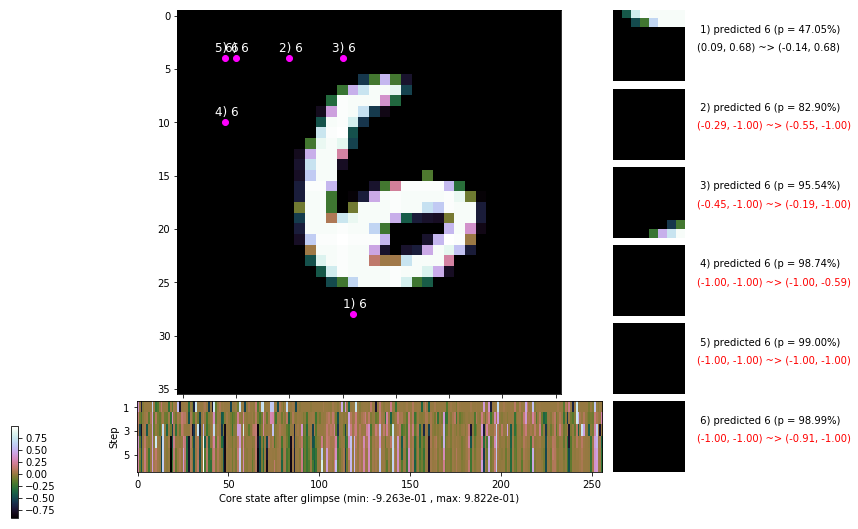

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 7 | Discounted rewards: [4.686, 4.095, 3.439, 2.710, 1.900, 1.000]


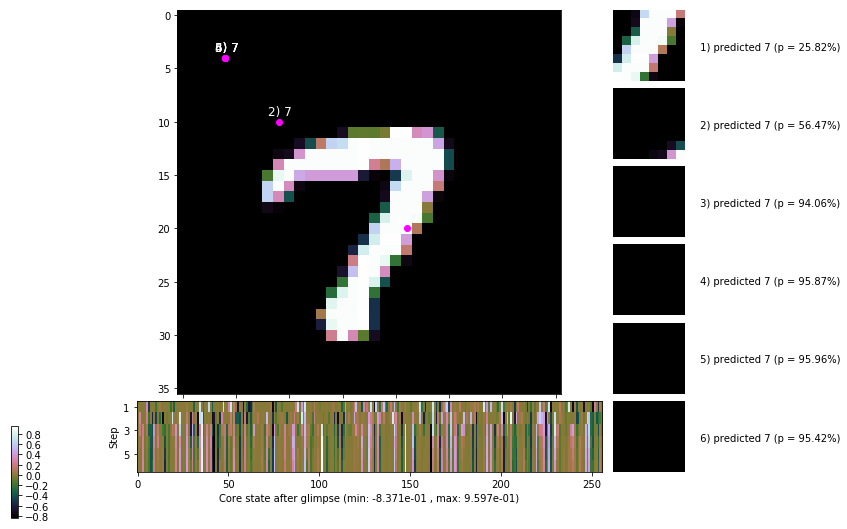


	Target class: 6 | Discounted rewards: [2.786, 3.095, 3.439, 2.710, 1.900, 1.000]


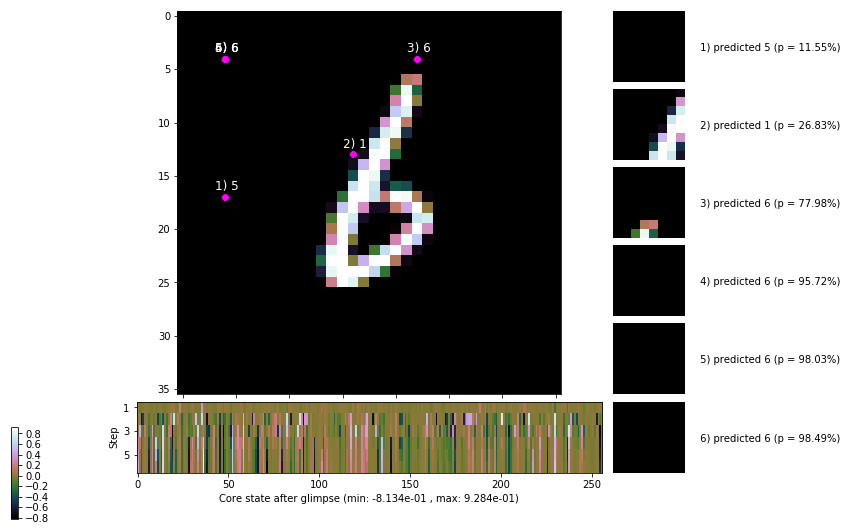

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


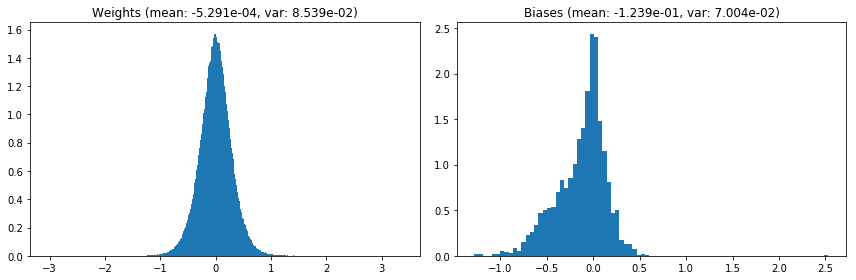

                                      Location network weights and biases


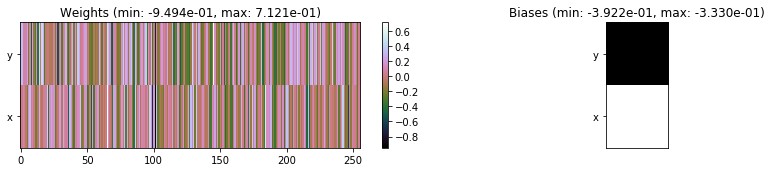

---------------------------------------------------------------------------------------------------------------
Elapsed time:  487.31 sec | TRAIN >> class loss: 0.8791 | steps:  2.916 :( | reward:  3.5058 :( | acc.: 68.913% :(
                          | VAL   >> class loss: 0.8587 | steps:  2.824 :( | reward:  3.5996 :( | acc.: 69.340% :(


Epoch  52/400) lr = 0.0004652
 b    300/  3000 >> 175.0 ms/b | lr: 4.65e-04 | grad 2norm: 19.41 | grad inf norm:  5.994
         Weights || abs max:  3.37 ( 1662.44) | mean: -5.28e-04 ( 0.01) | var: 8.54e-02 (   40.25)
          Biases || abs max:  2.53 (  176.27) | mean: -1.24e-01 ( 0.16) | var: 7.01e-02 ( 1082.17)
                    class loss: 0.874 | steps: 2.903 | reward:  3.509 | acc.: 68.87%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 175.6 ms/b | lr: 4.64e-04 | grad 2norm: 19.24 | grad inf norm:  5.726
         Weights || abs max:  3.36 ( 2036.02) | mean: -5.43e-04 (

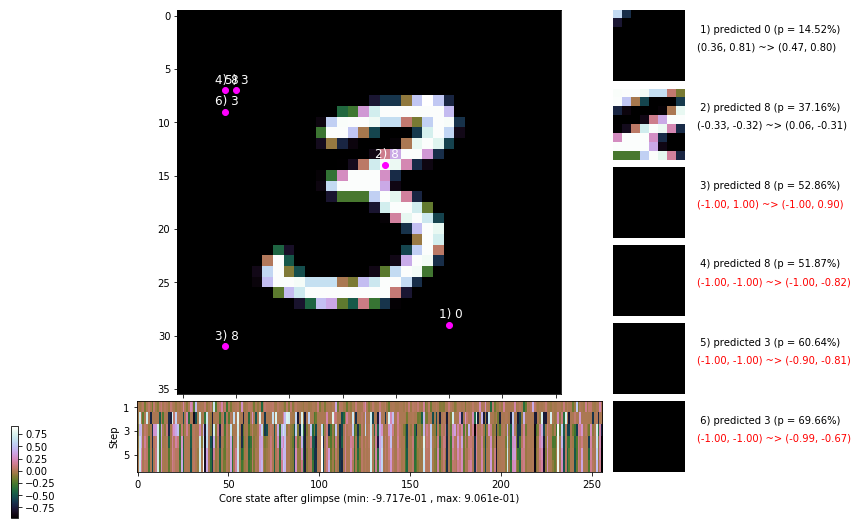

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 163.9 ms/b | lr: 4.63e-04 | grad 2norm: 19.73 | grad inf norm:  6.198
         Weights || abs max:  3.36 (  659.98) | mean: -5.39e-04 ( 0.01) | var: 8.55e-02 (    3.21)
          Biases || abs max:  2.53 (   67.46) | mean: -1.24e-01 ( 0.08) | var: 7.03e-02 (   26.59)
                    class loss: 0.884 | steps: 2.901 | reward:  3.510 | acc.: 68.90%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 161.8 ms/b | lr: 4.63e-04 | grad 2norm: 19.38 | grad inf norm:  5.746
         Weights || abs max:  3.37 (  907.26) | mean: -5.40e-04 ( 0.01) | var: 8.56e-02 (   14.97)
          Biases || abs max:  2.53 (  165.34) | mean: -1.24e-01 ( 0.11) | var: 7.04e-02 (  785.41)
                    class loss: 0.863 | steps: 2.908 | reward:  3.514 | acc.: 69.38%

	Target class: 7 | Discounted rewards: [3.686, 4.095, 3.4

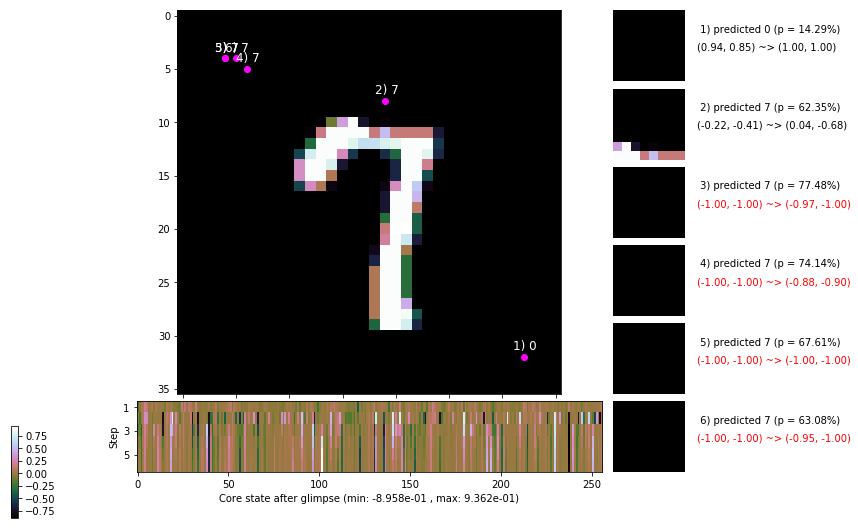

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 160.5 ms/b | lr: 4.62e-04 | grad 2norm: 19.70 | grad inf norm:  6.042
         Weights || abs max:  3.38 ( 2977.26) | mean: -5.39e-04 ( 0.01) | var: 8.56e-02 (  542.07)
          Biases || abs max:  2.52 (   73.86) | mean: -1.25e-01 ( 0.07) | var: 7.05e-02 (   70.46)
                    class loss: 0.855 | steps: 2.876 | reward:  3.534 | acc.: 69.38%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 160.1 ms/b | lr: 4.61e-04 | grad 2norm: 19.24 | grad inf norm:  5.848
         Weights || abs max:  3.38 (12870.56) | mean: -5.24e-04 ( 0.03) | var: 8.57e-02 (65585.44)
          Biases || abs max:  2.53 (  533.23) | mean: -1.25e-01 ( 0.26) | var: 7.04e-02 (24079.52)
                    class loss: 0.864 | steps: 2.877 | reward:  3.542 | acc.: 69.78%

	Target class: 4 | Discounted rewards: [3.686, 4.095, 3.4

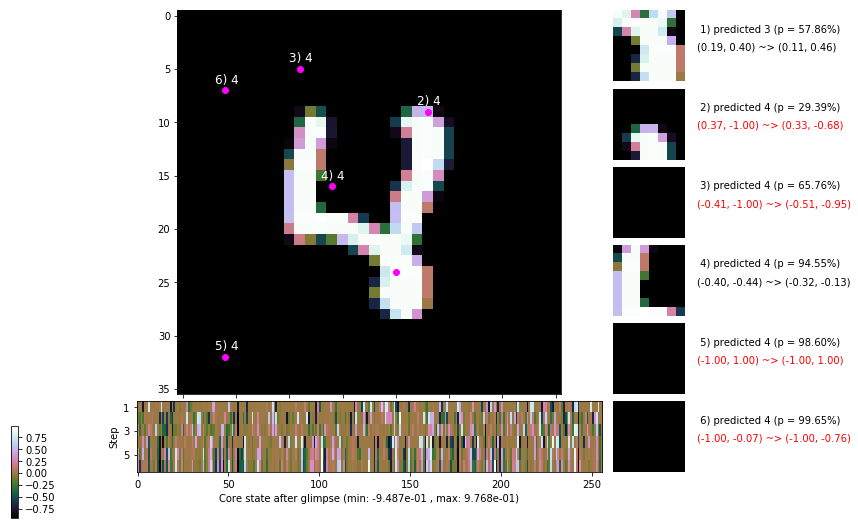

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 161.1 ms/b | lr: 4.61e-04 | grad 2norm: 19.40 | grad inf norm:  5.916
         Weights || abs max:  3.37 (  964.85) | mean: -5.09e-04 ( 0.01) | var: 8.57e-02 (   26.12)
          Biases || abs max:  2.53 (  108.03) | mean: -1.25e-01 ( 0.10) | var: 7.04e-02 (   54.61)
                    class loss: 0.847 | steps: 2.866 | reward:  3.572 | acc.: 70.55%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 159.8 ms/b | lr: 4.60e-04 | grad 2norm: 19.24 | grad inf norm:  5.740
         Weights || abs max:  3.36 ( 1179.30) | mean: -5.03e-04 ( 0.01) | var: 8.58e-02 (   22.45)
          Biases || abs max:  2.54 (  115.77) | mean: -1.25e-01 ( 0.10) | var: 7.06e-02 (  131.99)
                    class loss: 0.836 | steps: 2.847 | reward:  3.592 | acc.: 70.32%

	Target class: 3 | Discounted rewards: [0.000, 0.000, 0.0

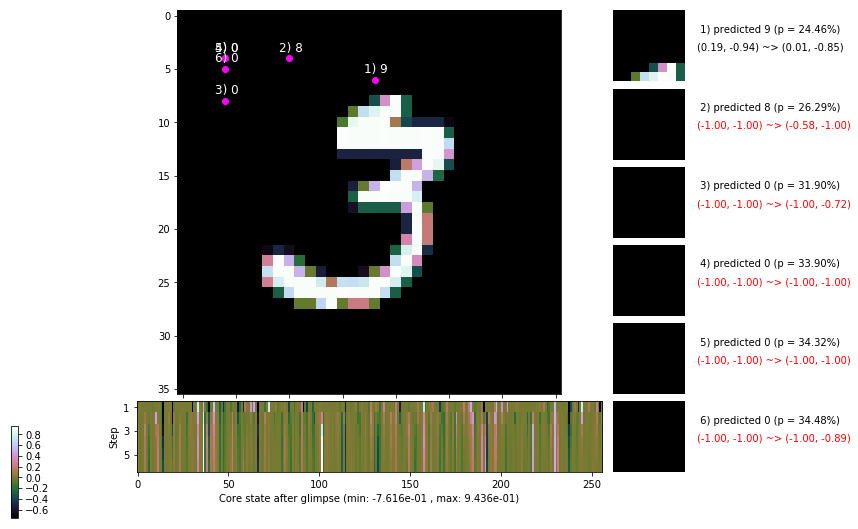

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 162.3 ms/b | lr: 4.59e-04 | grad 2norm: 19.53 | grad inf norm:  6.023
         Weights || abs max:  3.36 ( 1547.70) | mean: -5.19e-04 ( 0.01) | var: 8.58e-02 (  126.52)
          Biases || abs max:  2.54 (  105.65) | mean: -1.25e-01 ( 0.10) | var: 7.07e-02 (   39.72)
                    class loss: 0.864 | steps: 2.897 | reward:  3.526 | acc.: 69.32%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 159.8 ms/b | lr: 4.59e-04 | grad 2norm: 19.03 | grad inf norm:  5.619
         Weights || abs max:  3.36 ( 2873.36) | mean: -5.21e-04 ( 0.01) | var: 8.59e-02 ( 1097.53)
          Biases || abs max:  2.55 (  163.95) | mean: -1.25e-01 ( 0.12) | var: 7.07e-02 (  187.59)
                    class loss: 0.840 | steps: 2.836 | reward:  3.613 | acc.: 71.15%

	Target class: 4 | Discounted rewards: [0.000, 0.000, 0.0

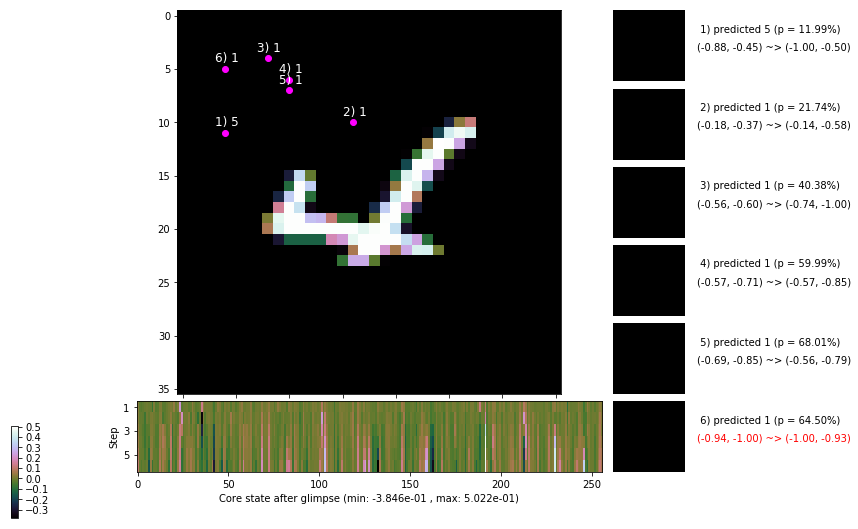

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 4 | Discounted rewards: [3.686, 4.095, 3.439, 2.710, 1.900, 1.000]


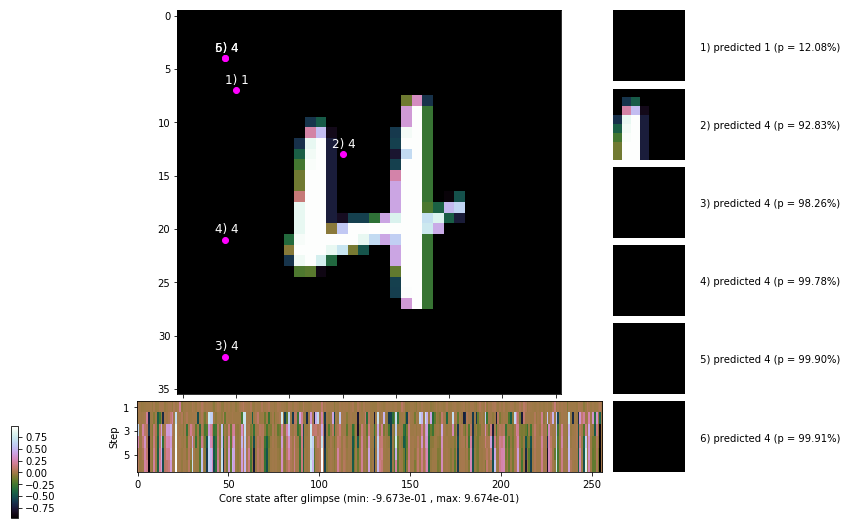


	Target class: 9 | Discounted rewards: [0.000, 0.000, 0.000, 0.000, 0.000, 0.000]


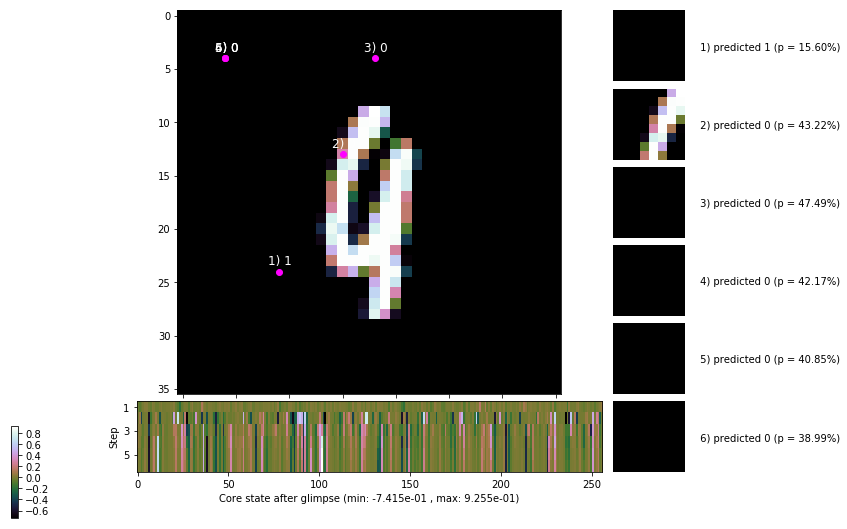

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


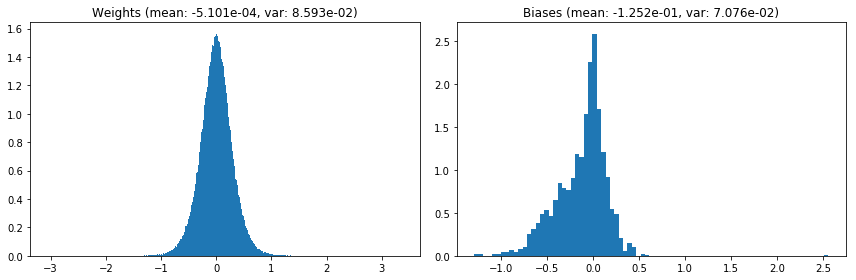

                                      Location network weights and biases


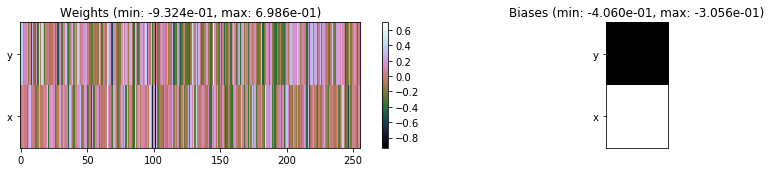

---------------------------------------------------------------------------------------------------------------
Elapsed time:  492.78 sec | TRAIN >> class loss: 0.8595 | steps:  2.884    | reward:  3.5412 :( | acc.: 69.672% :(
                          | VAL   >> class loss: 0.7770 | steps:  2.783 :( | reward:  3.7034    | acc.: 72.340% 


Epoch  53/400) lr = 0.0004582
 b    300/  3000 >> 161.4 ms/b | lr: 4.58e-04 | grad 2norm: 19.40 | grad inf norm:  5.963
         Weights || abs max:  3.36 ( 1349.75) | mean: -5.14e-04 ( 0.01) | var: 8.59e-02 (  136.18)
          Biases || abs max:  2.55 ( 1079.39) | mean: -1.25e-01 ( 0.48) | var: 7.09e-02 (86843.89)
                    class loss: 0.842 | steps: 2.833 | reward:  3.598 | acc.: 70.75%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 160.5 ms/b | lr: 4.57e-04 | grad 2norm: 19.58 | grad inf norm:  5.784
         Weights || abs max:  3.38 ( 8340.02) | mean: -4.98e-04 ( 0

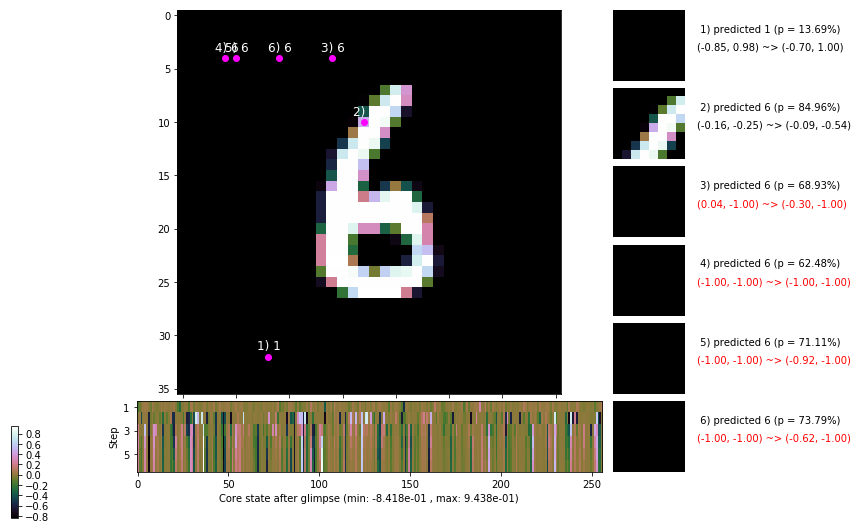

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 175.1 ms/b | lr: 4.56e-04 | grad 2norm: 19.11 | grad inf norm:  5.656
         Weights || abs max:  3.38 ( 4399.44) | mean: -4.93e-04 ( 0.01) | var: 8.61e-02 ( 4362.91)
          Biases || abs max:  2.56 (  305.45) | mean: -1.25e-01 ( 0.18) | var: 7.10e-02 ( 3904.37)
                    class loss: 0.855 | steps: 2.904 | reward:  3.530 | acc.: 69.70%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 174.7 ms/b | lr: 4.56e-04 | grad 2norm: 19.30 | grad inf norm:  5.659
         Weights || abs max:  3.38 ( 6000.20) | mean: -4.85e-04 ( 0.02) | var: 8.61e-02 ( 8467.63)
          Biases || abs max:  2.56 ( 1848.13) | mean: -1.25e-01 ( 0.77) | var: 7.09e-02 (357420.84)
                    class loss: 0.809 | steps: 2.875 | reward:  3.598 | acc.: 71.20%

	Target class: 7 | Discounted rewards: [3.686, 4.095, 3.

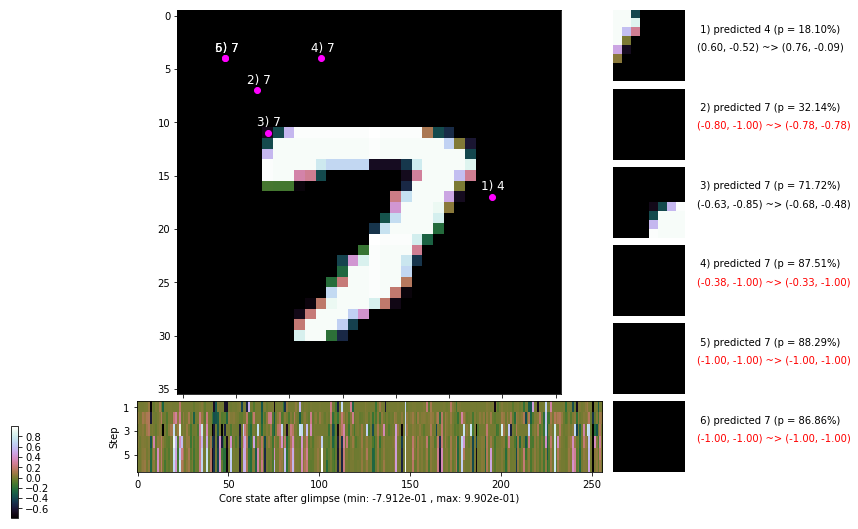

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 162.9 ms/b | lr: 4.55e-04 | grad 2norm: 19.46 | grad inf norm:  5.888
         Weights || abs max:  3.38 ( 2601.95) | mean: -4.85e-04 ( 0.01) | var: 8.62e-02 (  395.73)
          Biases || abs max:  2.57 (  116.90) | mean: -1.24e-01 ( 0.11) | var: 7.08e-02 (   77.72)
                    class loss: 0.823 | steps: 2.867 | reward:  3.603 | acc.: 71.40%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 161.8 ms/b | lr: 4.55e-04 | grad 2norm: 19.53 | grad inf norm:  5.664
         Weights || abs max:  3.38 ( 1823.85) | mean: -4.94e-04 ( 0.01) | var: 8.62e-02 (   85.81)
          Biases || abs max:  2.57 (  587.36) | mean: -1.24e-01 ( 0.28) | var: 7.10e-02 (21784.20)
                    class loss: 0.848 | steps: 2.841 | reward:  3.591 | acc.: 70.50%

	Target class: 3 | Discounted rewards: [3.686, 4.095, 3.4

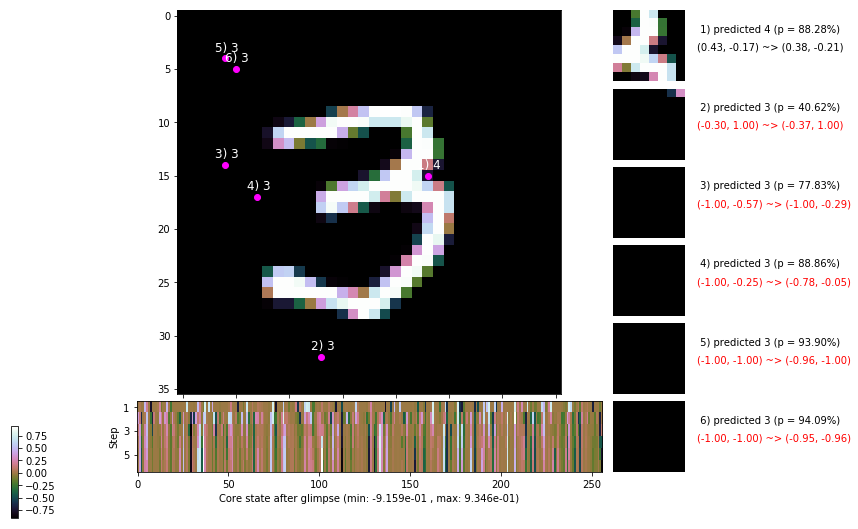

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 161.8 ms/b | lr: 4.54e-04 | grad 2norm: 19.33 | grad inf norm:  5.624
         Weights || abs max:  3.37 ( 3561.62) | mean: -4.94e-04 ( 0.01) | var: 8.63e-02 (  940.68)
          Biases || abs max:  2.57 (  113.18) | mean: -1.24e-01 ( 0.09) | var: 7.09e-02 (  153.42)
                    class loss: 0.816 | steps: 2.848 | reward:  3.612 | acc.: 71.18%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 161.0 ms/b | lr: 4.53e-04 | grad 2norm: 19.66 | grad inf norm:  5.893
         Weights || abs max:  3.37 ( 3369.04) | mean: -4.81e-04 ( 0.01) | var: 8.64e-02 ( 1495.31)
          Biases || abs max:  2.57 (  208.56) | mean: -1.24e-01 ( 0.14) | var: 7.09e-02 (  769.80)
                    class loss: 0.816 | steps: 2.826 | reward:  3.615 | acc.: 71.18%

	Target class: 4 | Discounted rewards: [4.686, 4.095, 3.4

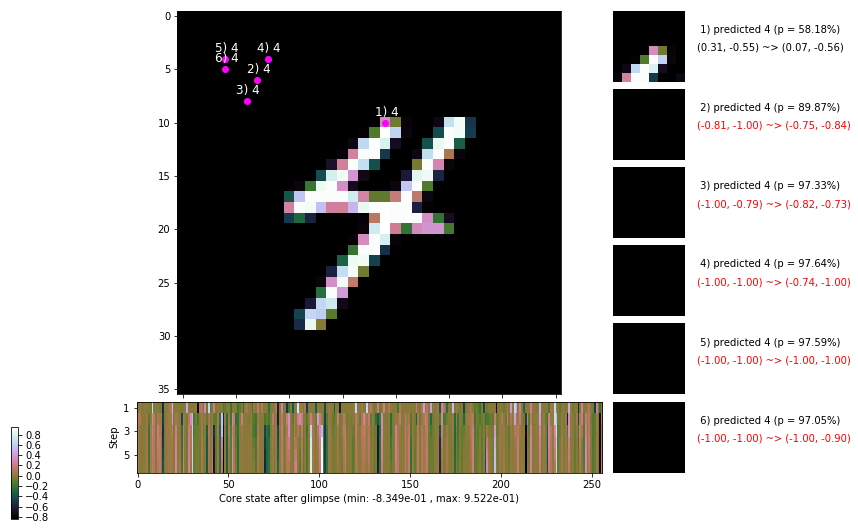

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 163.9 ms/b | lr: 4.52e-04 | grad 2norm: 19.68 | grad inf norm:  5.846
         Weights || abs max:  3.36 ( 1211.74) | mean: -4.82e-04 ( 0.01) | var: 8.64e-02 (   20.19)
          Biases || abs max:  2.56 (  129.02) | mean: -1.25e-01 ( 0.10) | var: 7.09e-02 (  408.36)
                    class loss: 0.876 | steps: 2.929 | reward:  3.471 | acc.: 68.25%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 160.4 ms/b | lr: 4.52e-04 | grad 2norm: 19.13 | grad inf norm:  5.691
         Weights || abs max:  3.36 ( 1197.55) | mean: -4.60e-04 ( 0.01) | var: 8.65e-02 (   18.53)
          Biases || abs max:  2.56 (  110.00) | mean: -1.25e-01 ( 0.10) | var: 7.10e-02 (  175.06)
                    class loss: 0.844 | steps: 2.881 | reward:  3.549 | acc.: 70.15%

	Target class: 7 | Discounted rewards: [0.900, 1.000, 0.0

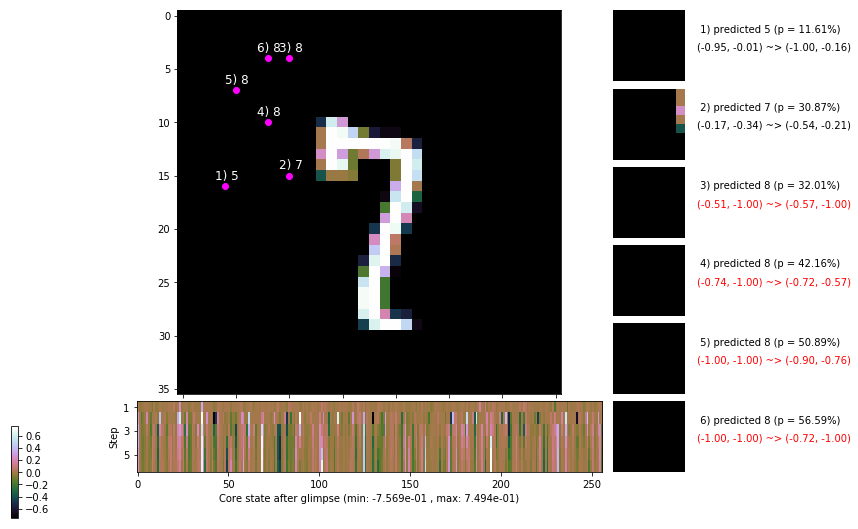

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 7 | Discounted rewards: [2.786, 3.095, 3.439, 2.710, 1.900, 1.000]


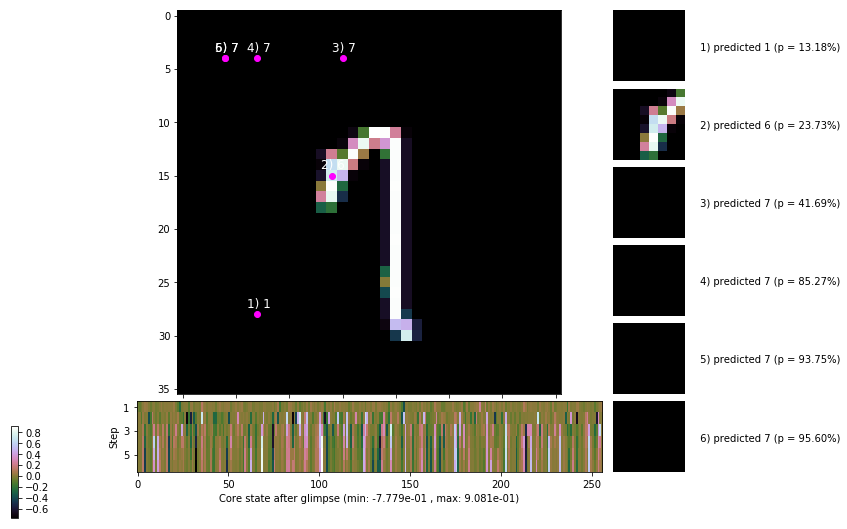


	Target class: 5 | Discounted rewards: [0.000, 0.000, 0.000, 0.000, 0.000, 0.000]


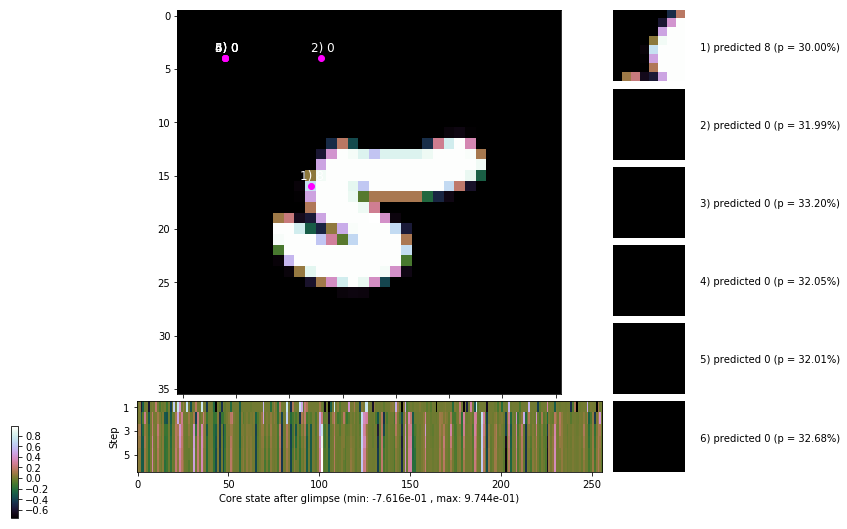

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


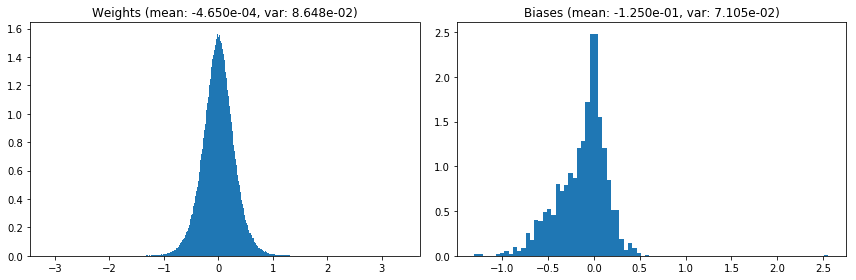

                                      Location network weights and biases


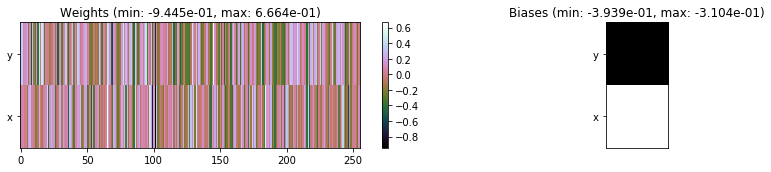

---------------------------------------------------------------------------------------------------------------
Elapsed time:  493.69 sec | TRAIN >> class loss: 0.8364 | steps:  2.868    | reward:  3.5737    | acc.: 70.435% 
                          | VAL   >> class loss: 0.8145 | steps:  2.799 :( | reward:  3.6318 :( | acc.: 70.600% :(


Epoch  54/400) lr = 0.0004514
 b    300/  3000 >> 160.1 ms/b | lr: 4.51e-04 | grad 2norm: 19.23 | grad inf norm:  5.871
         Weights || abs max:  3.37 ( 1250.92) | mean: -4.80e-04 ( 0.01) | var: 8.65e-02 (   39.78)
          Biases || abs max:  2.56 (  587.99) | mean: -1.25e-01 ( 0.29) | var: 7.10e-02 (20350.37)
                    class loss: 0.842 | steps: 2.877 | reward:  3.565 | acc.: 70.72%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 159.4 ms/b | lr: 4.50e-04 | grad 2norm: 19.07 | grad inf norm:  5.613
         Weights || abs max:  3.37 ( 2437.09) | mean: -4.69e-04 ( 0

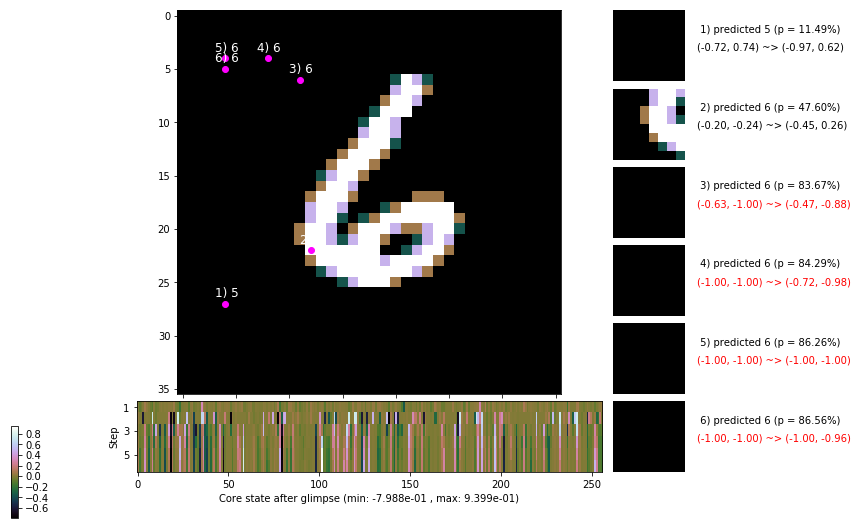

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 165.4 ms/b | lr: 4.50e-04 | grad 2norm: 19.43 | grad inf norm:  5.833
         Weights || abs max:  3.37 ( 4102.80) | mean: -4.56e-04 ( 0.01) | var: 8.66e-02 ( 3569.74)
          Biases || abs max:  2.56 (   70.87) | mean: -1.25e-01 ( 0.08) | var: 7.09e-02 (    8.99)
                    class loss: 0.843 | steps: 2.871 | reward:  3.566 | acc.: 70.43%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 159.3 ms/b | lr: 4.49e-04 | grad 2norm: 19.24 | grad inf norm:  5.833
         Weights || abs max:  3.37 ( 2140.62) | mean: -4.47e-04 ( 0.01) | var: 8.66e-02 (  241.78)
          Biases || abs max:  2.56 (  460.16) | mean: -1.25e-01 ( 0.24) | var: 7.10e-02 ( 7956.89)
                    class loss: 0.851 | steps: 2.878 | reward:  3.546 | acc.: 70.18%

	Target class: 6 | Discounted rewards: [2.786, 3.095, 3.4

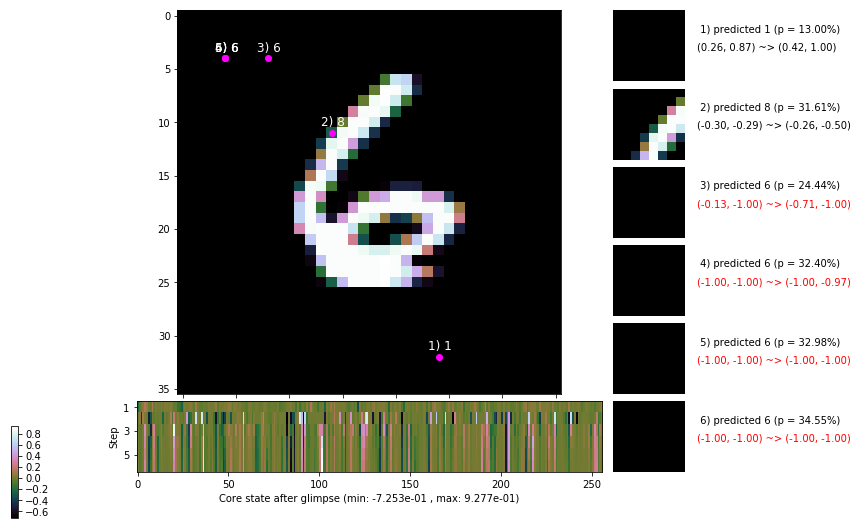

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 165.8 ms/b | lr: 4.48e-04 | grad 2norm: 19.19 | grad inf norm:  5.728
         Weights || abs max:  3.37 ( 2058.55) | mean: -4.80e-04 ( 0.01) | var: 8.67e-02 (  213.61)
          Biases || abs max:  2.56 (  258.61) | mean: -1.25e-01 ( 0.17) | var: 7.09e-02 ( 2072.65)
                    class loss: 0.841 | steps: 2.877 | reward:  3.568 | acc.: 70.55%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 178.3 ms/b | lr: 4.48e-04 | grad 2norm: 19.19 | grad inf norm:  5.921
         Weights || abs max:  3.37 ( 3589.20) | mean: -4.83e-04 ( 0.01) | var: 8.67e-02 ( 1414.61)
          Biases || abs max:  2.55 (  809.31) | mean: -1.25e-01 ( 0.38) | var: 7.11e-02 (43720.37)
                    class loss: 0.883 | steps: 2.882 | reward:  3.539 | acc.: 68.97%

	Target class: 6 | Discounted rewards: [0.000, 0.000, 0.0

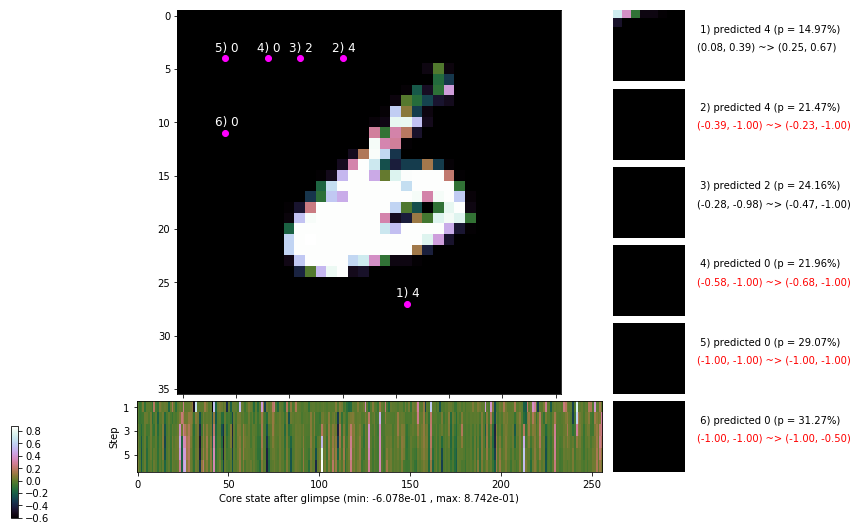

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 166.7 ms/b | lr: 4.47e-04 | grad 2norm: 19.37 | grad inf norm:  6.016
         Weights || abs max:  3.38 ( 2975.01) | mean: -4.83e-04 ( 0.01) | var: 8.68e-02 (  254.86)
          Biases || abs max:  2.55 (  139.80) | mean: -1.25e-01 ( 0.12) | var: 7.12e-02 (   64.17)
                    class loss: 0.876 | steps: 2.887 | reward:  3.537 | acc.: 69.48%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 160.4 ms/b | lr: 4.46e-04 | grad 2norm: 19.48 | grad inf norm:  5.989
         Weights || abs max:  3.38 ( 6219.44) | mean: -4.72e-04 ( 0.02) | var: 8.68e-02 (11885.10)
          Biases || abs max:  2.55 (  439.35) | mean: -1.25e-01 ( 0.24) | var: 7.13e-02 ( 8681.62)
                    class loss: 0.876 | steps: 2.908 | reward:  3.518 | acc.: 69.17%

	Target class: 6 | Discounted rewards: [3.686, 4.095, 3.4

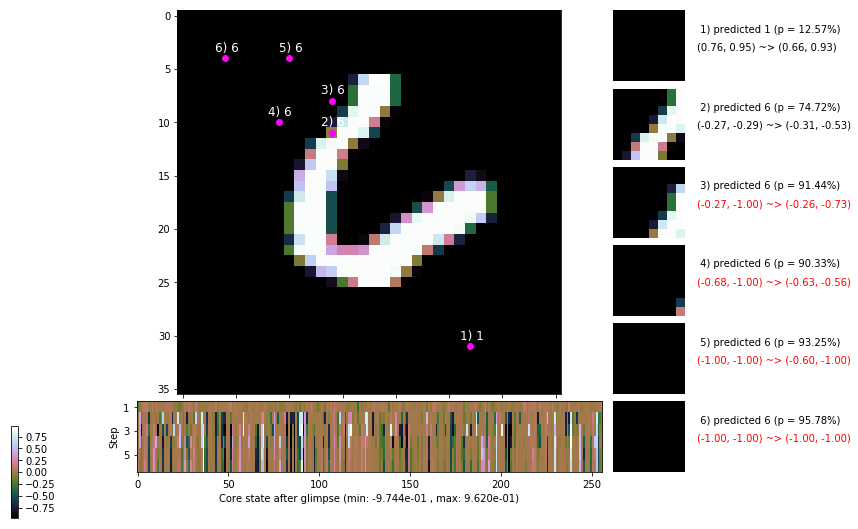

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 159.8 ms/b | lr: 4.46e-04 | grad 2norm: 19.33 | grad inf norm:  5.754
         Weights || abs max:  3.37 ( 3796.13) | mean: -4.51e-04 ( 0.01) | var: 8.69e-02 (  510.75)
          Biases || abs max:  2.54 (  162.89) | mean: -1.25e-01 ( 0.13) | var: 7.13e-02 (  174.61)
                    class loss: 0.873 | steps: 2.932 | reward:  3.490 | acc.: 68.58%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 160.6 ms/b | lr: 4.45e-04 | grad 2norm: 19.18 | grad inf norm:  5.730
         Weights || abs max:  3.36 ( 4796.71) | mean: -4.46e-04 ( 0.02) | var: 8.69e-02 ( 1617.95)
          Biases || abs max:  2.54 (  245.81) | mean: -1.25e-01 ( 0.18) | var: 7.14e-02 (  599.67)
                    class loss: 0.889 | steps: 2.937 | reward:  3.476 | acc.: 68.28%

	Target class: 1 | Discounted rewards: [3.786, 3.095, 3.4

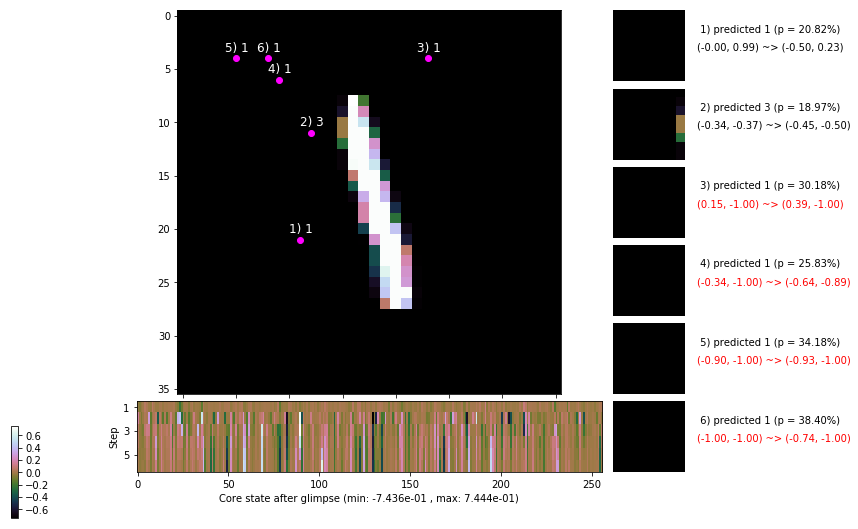

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 0 | Discounted rewards: [4.686, 4.095, 3.439, 2.710, 1.900, 1.000]


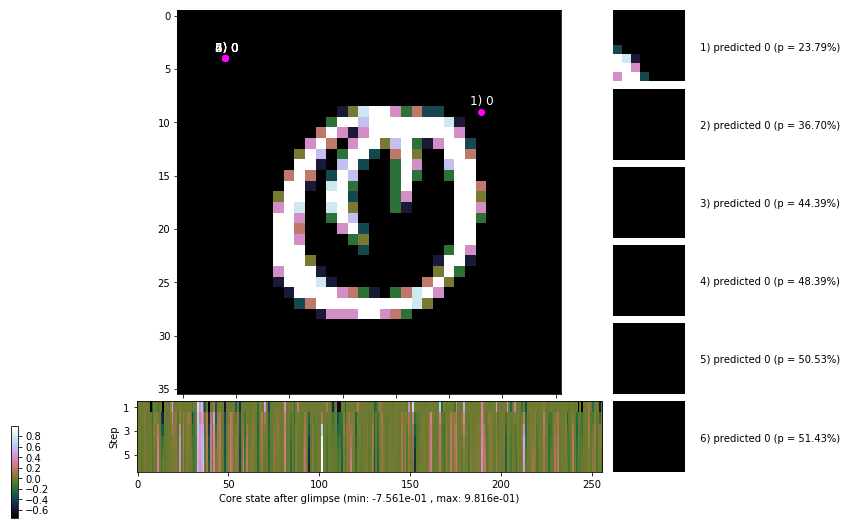


	Target class: 0 | Discounted rewards: [4.686, 4.095, 3.439, 2.710, 1.900, 1.000]


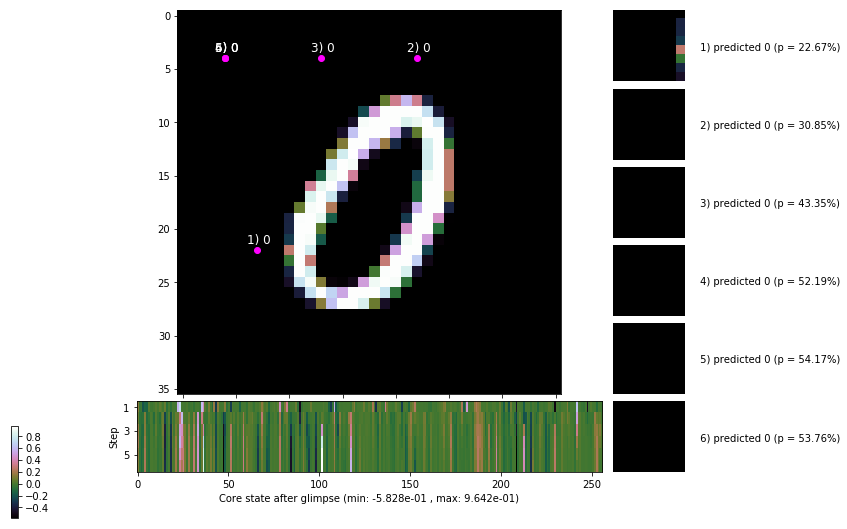

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


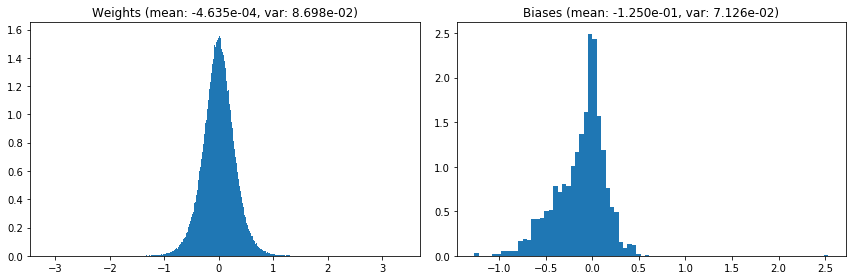

                                      Location network weights and biases


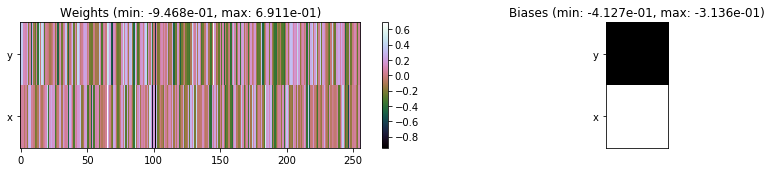

---------------------------------------------------------------------------------------------------------------
Elapsed time:  491.63 sec | TRAIN >> class loss: 0.8621 | steps:  2.894 :( | reward:  3.5348 :( | acc.: 69.637% :(
                          | VAL   >> class loss: 0.8207 | steps:  2.796 :( | reward:  3.6576 :( | acc.: 70.580% :(


Epoch  55/400) lr = 0.0004447
 b    300/  3000 >> 160.0 ms/b | lr: 4.44e-04 | grad 2norm: 19.06 | grad inf norm:  5.677
         Weights || abs max:  3.37 ( 9660.67) | mean: -4.60e-04 ( 0.02) | var: 8.70e-02 (26543.52)
          Biases || abs max:  2.53 (  238.33) | mean: -1.25e-01 ( 0.16) | var: 7.12e-02 ( 1339.40)
                    class loss: 0.890 | steps: 2.973 | reward:  3.449 | acc.: 68.02%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 160.8 ms/b | lr: 4.44e-04 | grad 2norm: 19.34 | grad inf norm:  5.815
         Weights || abs max:  3.38 ( 3546.04) | mean: -4.71e-04 (

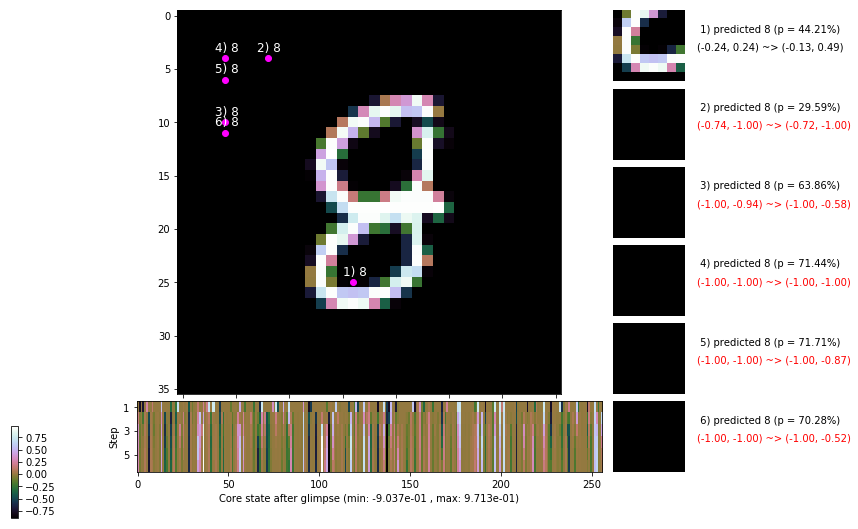

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 161.9 ms/b | lr: 4.43e-04 | grad 2norm: 19.14 | grad inf norm:  5.603
         Weights || abs max:  3.39 ( 1926.82) | mean: -4.89e-04 ( 0.01) | var: 8.71e-02 (  302.46)
          Biases || abs max:  2.54 (  164.19) | mean: -1.25e-01 ( 0.13) | var: 7.12e-02 (  778.43)
                    class loss: 0.856 | steps: 2.893 | reward:  3.551 | acc.: 69.95%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 158.3 ms/b | lr: 4.42e-04 | grad 2norm: 19.06 | grad inf norm:  5.646
         Weights || abs max:  3.38 ( 1815.69) | mean: -4.81e-04 ( 0.01) | var: 8.72e-02 (  131.08)
          Biases || abs max:  2.54 (  505.22) | mean: -1.25e-01 ( 0.27) | var: 7.13e-02 ( 5121.43)
                    class loss: 0.864 | steps: 2.936 | reward:  3.503 | acc.: 69.00%

	Target class: 3 | Discounted rewards: [0.000, 0.000, 0.0

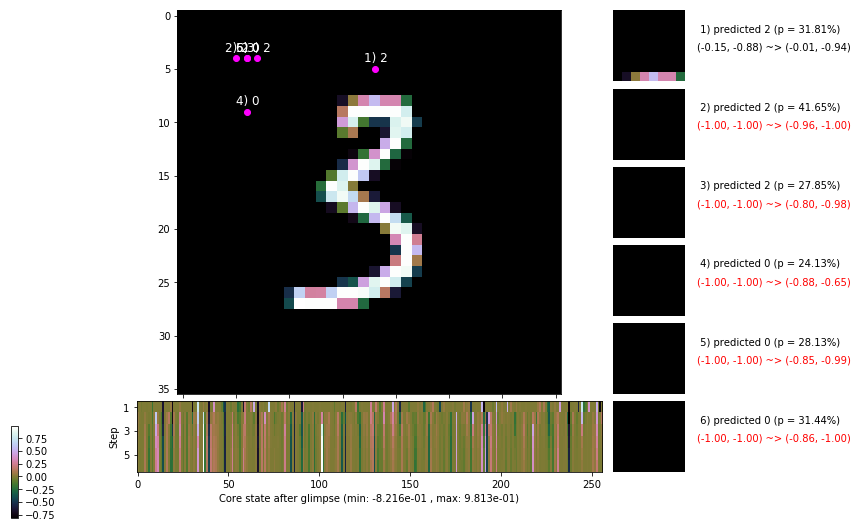

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 163.9 ms/b | lr: 4.42e-04 | grad 2norm: 19.41 | grad inf norm:  5.981
         Weights || abs max:  3.38 ( 2304.32) | mean: -4.68e-04 ( 0.01) | var: 8.72e-02 (  791.85)
          Biases || abs max:  2.54 (  123.31) | mean: -1.24e-01 ( 0.11) | var: 7.12e-02 (  214.62)
                    class loss: 0.810 | steps: 2.841 | reward:  3.597 | acc.: 70.20%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 158.6 ms/b | lr: 4.41e-04 | grad 2norm: 19.78 | grad inf norm:  6.062
         Weights || abs max:  3.38 ( 4010.04) | mean: -4.64e-04 ( 0.01) | var: 8.73e-02 ( 2532.59)
          Biases || abs max:  2.54 (  137.89) | mean: -1.25e-01 ( 0.12) | var: 7.13e-02 (  122.87)
                    class loss: 0.839 | steps: 2.876 | reward:  3.553 | acc.: 69.42%

	Target class: 3 | Discounted rewards: [2.876, 3.195, 2.4

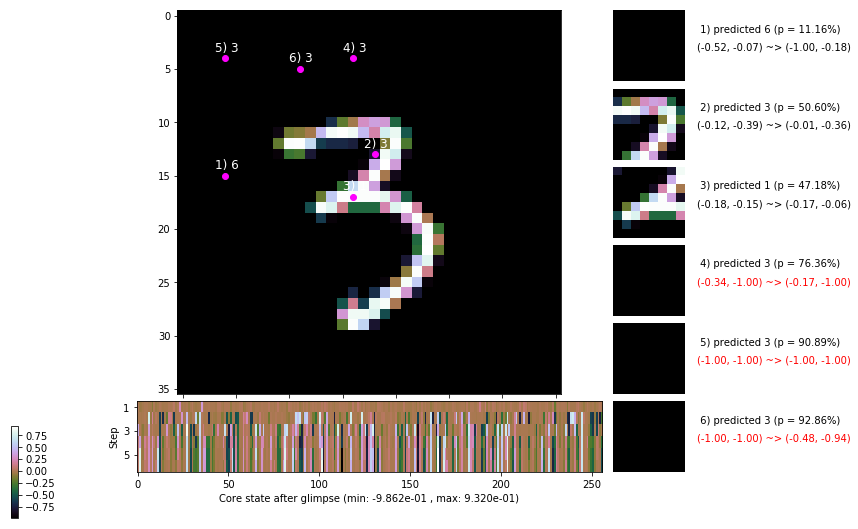

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 170.2 ms/b | lr: 4.40e-04 | grad 2norm: 19.37 | grad inf norm:  5.673
         Weights || abs max:  3.38 ( 1329.16) | mean: -4.85e-04 ( 0.01) | var: 8.73e-02 (   67.11)
          Biases || abs max:  2.55 (  192.18) | mean: -1.25e-01 ( 0.13) | var: 7.13e-02 ( 1028.18)
                    class loss: 0.846 | steps: 2.847 | reward:  3.581 | acc.: 69.93%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 180.2 ms/b | lr: 4.40e-04 | grad 2norm: 19.38 | grad inf norm:  5.890
         Weights || abs max:  3.38 ( 1944.42) | mean: -4.84e-04 ( 0.01) | var: 8.73e-02 (   52.19)
          Biases || abs max:  2.54 (  405.58) | mean: -1.25e-01 ( 0.24) | var: 7.13e-02 ( 2657.69)
                    class loss: 0.856 | steps: 2.913 | reward:  3.540 | acc.: 70.10%

	Target class: 6 | Discounted rewards: [0.000, 0.000, 0.0

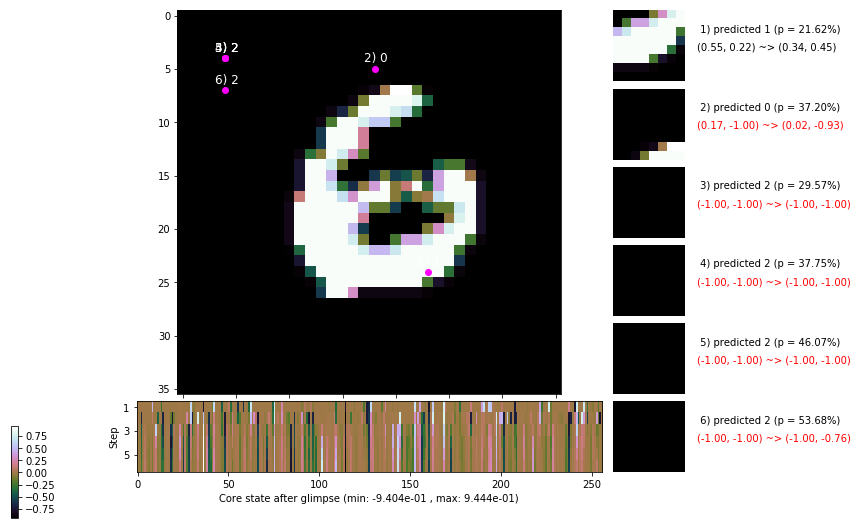

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 161.5 ms/b | lr: 4.39e-04 | grad 2norm: 19.40 | grad inf norm:  5.995
         Weights || abs max:  3.39 ( 2061.72) | mean: -4.89e-04 ( 0.01) | var: 8.74e-02 (  158.17)
          Biases || abs max:  2.55 (  878.95) | mean: -1.24e-01 ( 0.41) | var: 7.13e-02 (63221.18)
                    class loss: 0.834 | steps: 2.874 | reward:  3.600 | acc.: 71.15%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 161.5 ms/b | lr: 4.38e-04 | grad 2norm: 19.31 | grad inf norm:  5.950
         Weights || abs max:  3.39 ( 3359.70) | mean: -5.09e-04 ( 0.01) | var: 8.74e-02 (  597.20)
          Biases || abs max:  2.56 (  159.96) | mean: -1.25e-01 ( 0.16) | var: 7.16e-02 ( 1659.65)
                    class loss: 0.835 | steps: 2.857 | reward:  3.603 | acc.: 70.28%

	Target class: 1 | Discounted rewards: [4.686, 4.095, 3.4

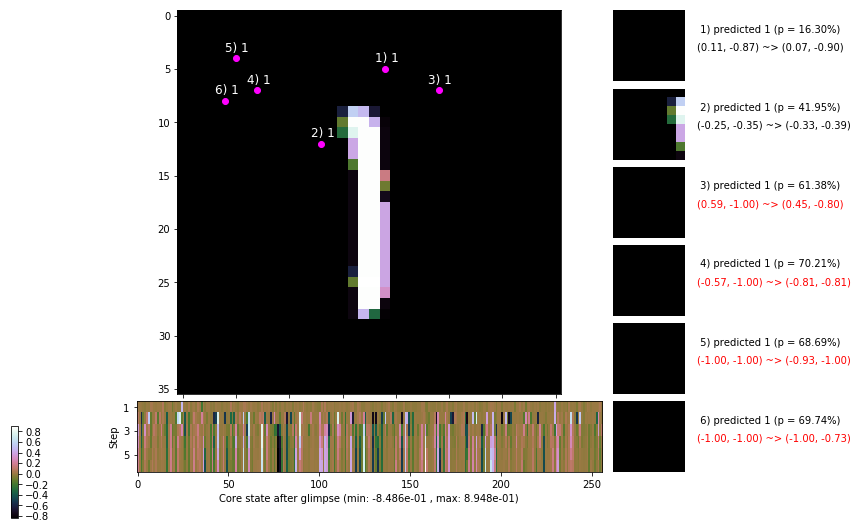

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 7 | Discounted rewards: [3.686, 4.095, 3.439, 2.710, 1.900, 1.000]


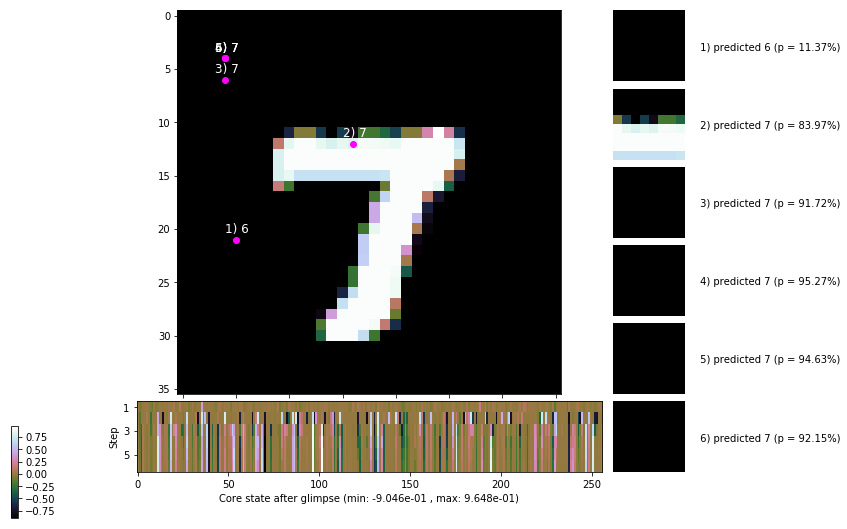


	Target class: 3 | Discounted rewards: [0.000, 0.000, 0.000, 0.000, 0.000, 0.000]


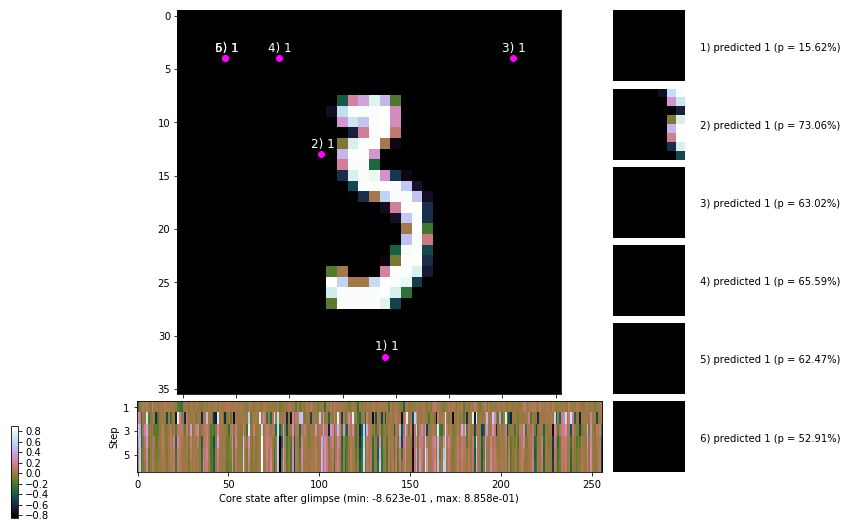

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


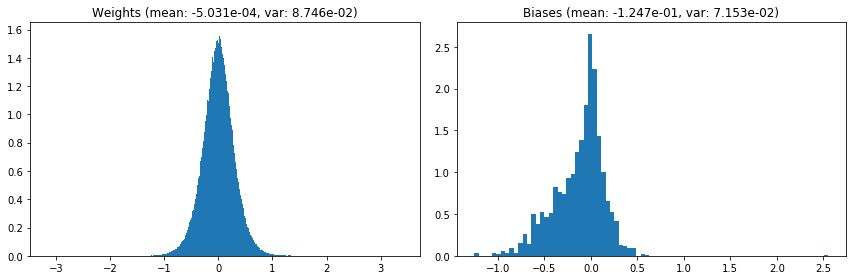

                                      Location network weights and biases


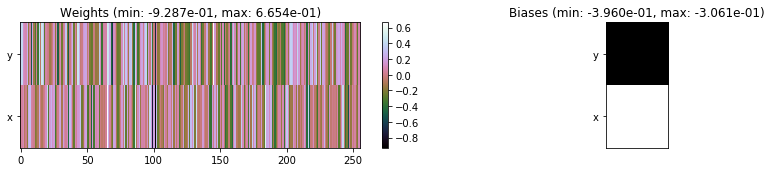

---------------------------------------------------------------------------------------------------------------
Elapsed time:  491.73 sec | TRAIN >> class loss: 0.8480 | steps:  2.889 :( | reward:  3.5547 :( | acc.: 69.822% :(
                          | VAL   >> class loss: 0.8174 | steps:  2.857 :( | reward:  3.6352 :( | acc.: 70.780% :(


Epoch  56/400) lr = 0.0004381
 b    300/  3000 >> 158.4 ms/b | lr: 4.38e-04 | grad 2norm: 19.29 | grad inf norm:  5.845
         Weights || abs max:  3.39 ( 2016.60) | mean: -5.11e-04 ( 0.01) | var: 8.75e-02 (   85.78)
          Biases || abs max:  2.56 (  150.09) | mean: -1.25e-01 ( 0.11) | var: 7.16e-02 (  448.92)
                    class loss: 0.855 | steps: 2.888 | reward:  3.560 | acc.: 69.95%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 160.7 ms/b | lr: 4.37e-04 | grad 2norm: 19.51 | grad inf norm:  5.835
         Weights || abs max:  3.39 ( 3046.55) | mean: -5.23e-04 (

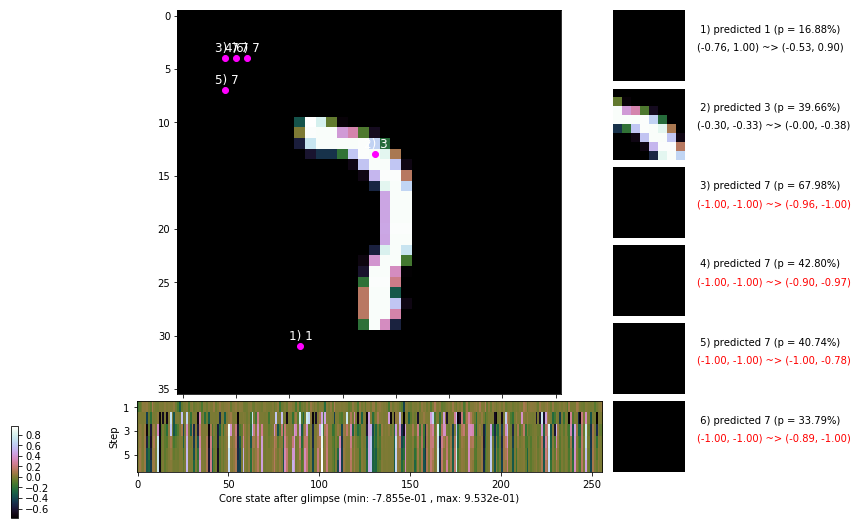

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 162.2 ms/b | lr: 4.36e-04 | grad 2norm: 19.24 | grad inf norm:  5.991
         Weights || abs max:  3.39 ( 3998.11) | mean: -5.11e-04 ( 0.01) | var: 8.76e-02 (  793.88)
          Biases || abs max:  2.55 (  156.63) | mean: -1.25e-01 ( 0.12) | var: 7.17e-02 (  218.91)
                    class loss: 0.862 | steps: 2.906 | reward:  3.535 | acc.: 69.65%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 159.5 ms/b | lr: 4.36e-04 | grad 2norm: 18.90 | grad inf norm:  5.621
         Weights || abs max:  3.38 ( 5600.05) | mean: -5.00e-04 ( 0.02) | var: 8.76e-02 (10459.58)
          Biases || abs max:  2.55 (   69.88) | mean: -1.25e-01 ( 0.09) | var: 7.16e-02 (   39.30)
                    class loss: 0.864 | steps: 2.893 | reward:  3.547 | acc.: 69.47%

	Target class: 4 | Discounted rewards: [2.786, 3.095, 3.4

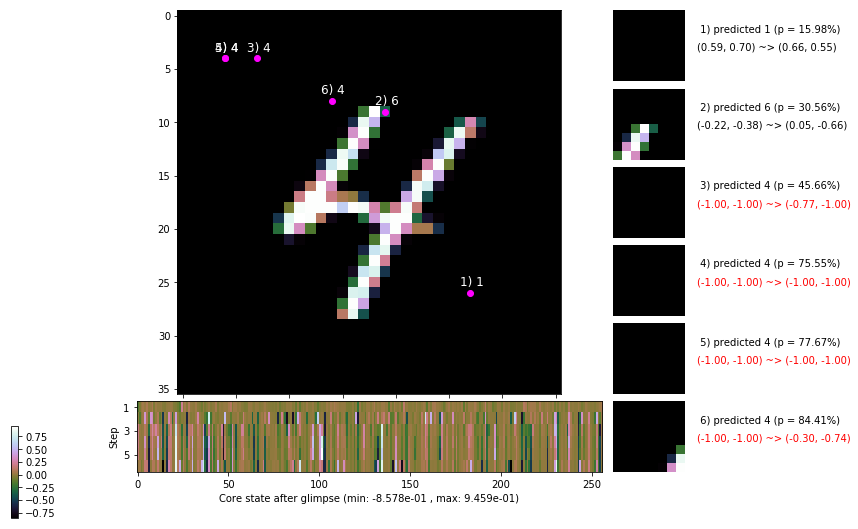

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 160.4 ms/b | lr: 4.35e-04 | grad 2norm: 18.97 | grad inf norm:  5.830
         Weights || abs max:  3.39 ( 1332.34) | mean: -4.90e-04 ( 0.01) | var: 8.77e-02 (   66.26)
          Biases || abs max:  2.55 (  648.36) | mean: -1.25e-01 ( 0.32) | var: 7.16e-02 (11634.63)
                    class loss: 0.832 | steps: 2.865 | reward:  3.579 | acc.: 70.42%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 158.2 ms/b | lr: 4.35e-04 | grad 2norm: 19.38 | grad inf norm:  5.875
         Weights || abs max:  3.40 ( 9455.01) | mean: -4.95e-04 ( 0.02) | var: 8.77e-02 (31408.96)
          Biases || abs max:  2.55 (  186.99) | mean: -1.26e-01 ( 0.13) | var: 7.17e-02 (  372.19)
                    class loss: 0.855 | steps: 2.912 | reward:  3.508 | acc.: 69.30%

	Target class: 5 | Discounted rewards: [3.686, 4.095, 3.4

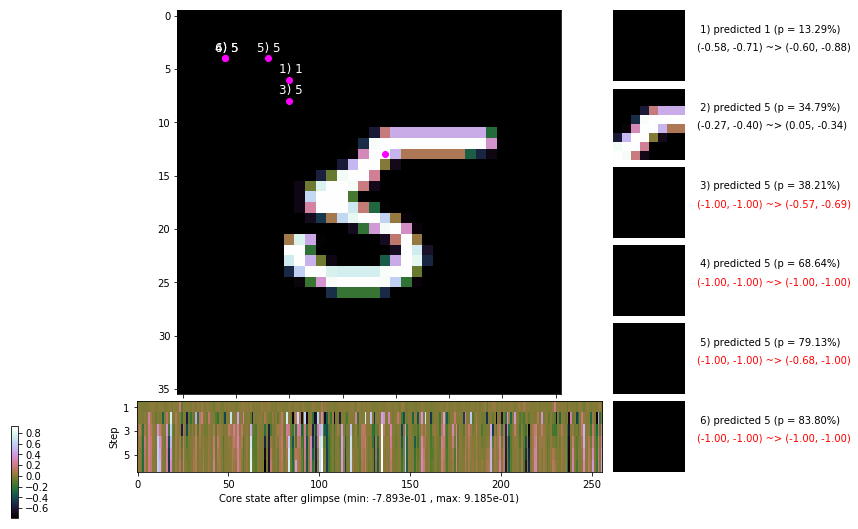

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 161.7 ms/b | lr: 4.34e-04 | grad 2norm: 19.10 | grad inf norm:  5.611
         Weights || abs max:  3.40 ( 1458.36) | mean: -4.85e-04 ( 0.01) | var: 8.78e-02 (   94.04)
          Biases || abs max:  2.55 (  241.29) | mean: -1.26e-01 ( 0.15) | var: 7.17e-02 ( 1077.37)
                    class loss: 0.830 | steps: 2.885 | reward:  3.556 | acc.: 70.08%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 158.9 ms/b | lr: 4.33e-04 | grad 2norm: 19.63 | grad inf norm:  5.897
         Weights || abs max:  3.40 ( 2803.88) | mean: -5.00e-04 ( 0.01) | var: 8.78e-02 (  651.49)
          Biases || abs max:  2.55 (   45.54) | mean: -1.26e-01 ( 0.06) | var: 7.16e-02 (   13.17)
                    class loss: 0.837 | steps: 2.840 | reward:  3.591 | acc.: 70.40%

	Target class: 3 | Discounted rewards: [2.786, 3.095, 3.4

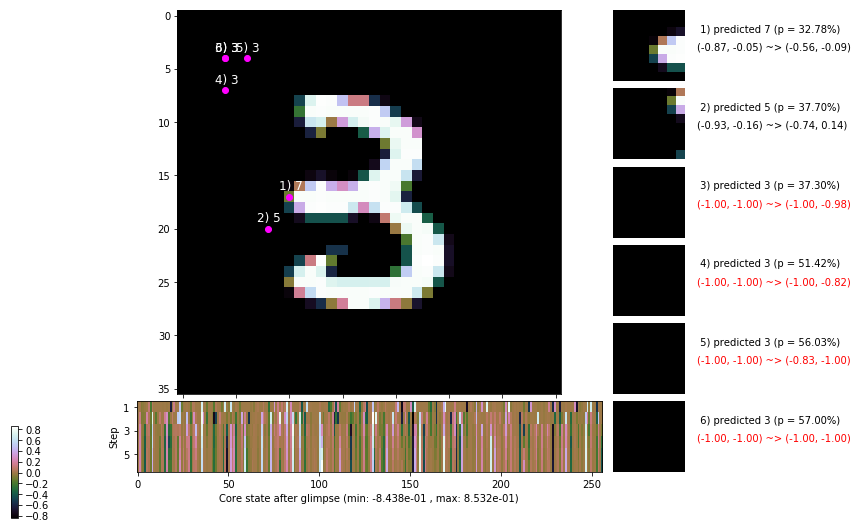

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 168.4 ms/b | lr: 4.32e-04 | grad 2norm: 19.31 | grad inf norm:  6.081
         Weights || abs max:  3.40 ( 2039.42) | mean: -5.07e-04 ( 0.01) | var: 8.78e-02 (  141.95)
          Biases || abs max:  2.56 (  193.84) | mean: -1.26e-01 ( 0.15) | var: 7.15e-02 (  452.51)
                    class loss: 0.826 | steps: 2.834 | reward:  3.620 | acc.: 71.03%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 181.0 ms/b | lr: 4.32e-04 | grad 2norm: 19.39 | grad inf norm:  5.850
         Weights || abs max:  3.40 ( 2405.92) | mean: -5.04e-04 ( 0.01) | var: 8.79e-02 (  220.41)
          Biases || abs max:  2.56 (   81.46) | mean: -1.25e-01 ( 0.09) | var: 7.16e-02 (   31.94)
                    class loss: 0.815 | steps: 2.848 | reward:  3.613 | acc.: 71.22%

	Target class: 4 | Discounted rewards: [3.686, 4.095, 3.4

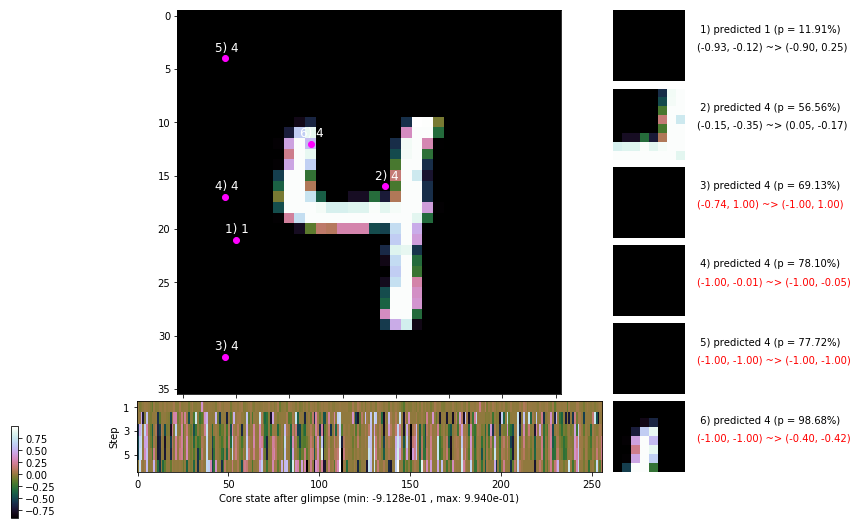

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 7 | Discounted rewards: [3.686, 4.095, 3.439, 2.710, 1.900, 1.000]


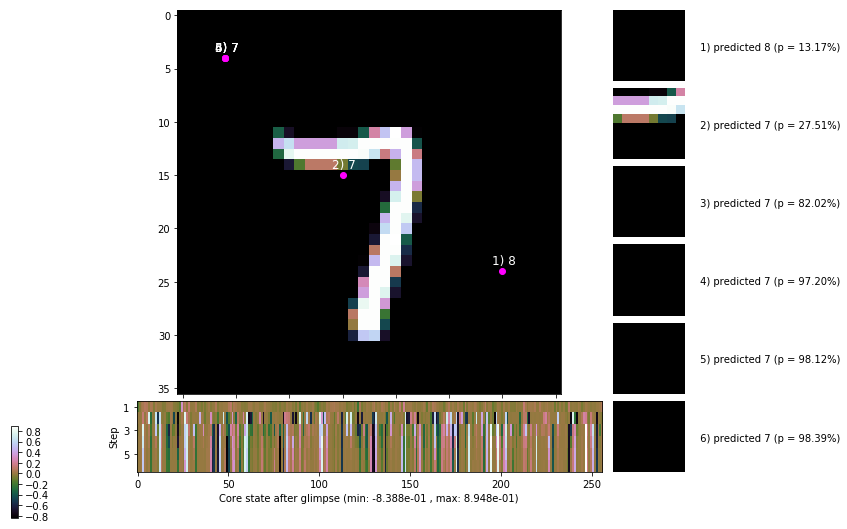


	Target class: 9 | Discounted rewards: [0.000, 0.000, 0.000, 0.000, 0.000, 0.000]


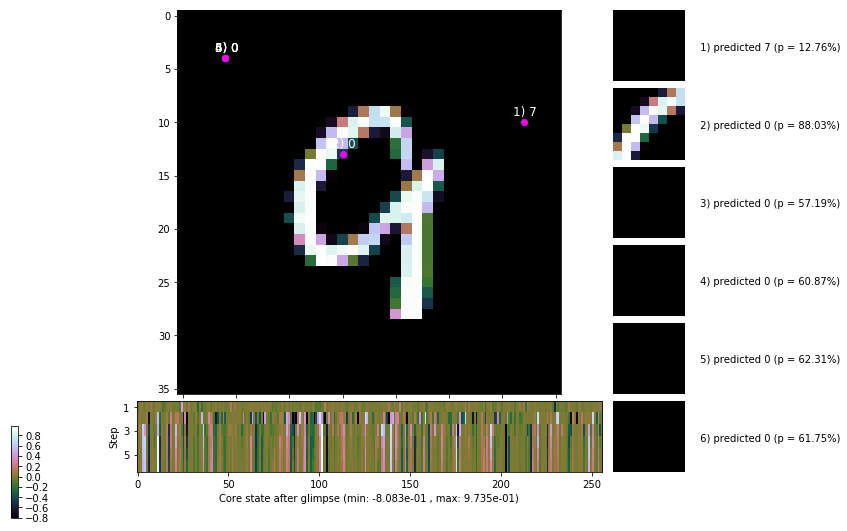

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


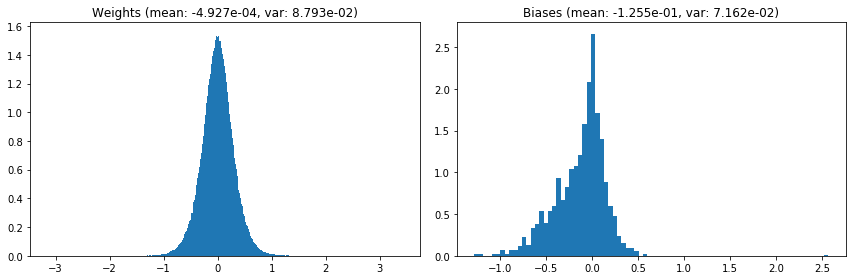

                                      Location network weights and biases


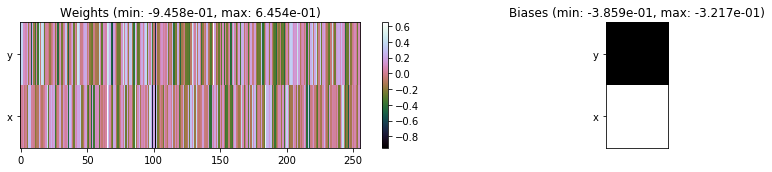

---------------------------------------------------------------------------------------------------------------
Elapsed time:  489.67 sec | TRAIN >> class loss: 0.8425 | steps:  2.878 :( | reward:  3.5641 :( | acc.: 70.115% :(
                          | VAL   >> class loss: 0.7635 | steps:  2.763 :( | reward:  3.7050    | acc.: 71.920% :(


Epoch  57/400) lr = 0.0004315
 b    300/  3000 >> 160.3 ms/b | lr: 4.31e-04 | grad 2norm: 19.27 | grad inf norm:  5.641
         Weights || abs max:  3.41 ( 1614.29) | mean: -5.09e-04 ( 0.01) | var: 8.80e-02 (   24.71)
          Biases || abs max:  2.56 (  101.93) | mean: -1.25e-01 ( 0.11) | var: 7.16e-02 (   38.77)
                    class loss: 0.819 | steps: 2.853 | reward:  3.595 | acc.: 70.92%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 163.0 ms/b | lr: 4.31e-04 | grad 2norm: 19.65 | grad inf norm:  5.693
         Weights || abs max:  3.41 ( 4081.66) | mean: -5.14e-04 (

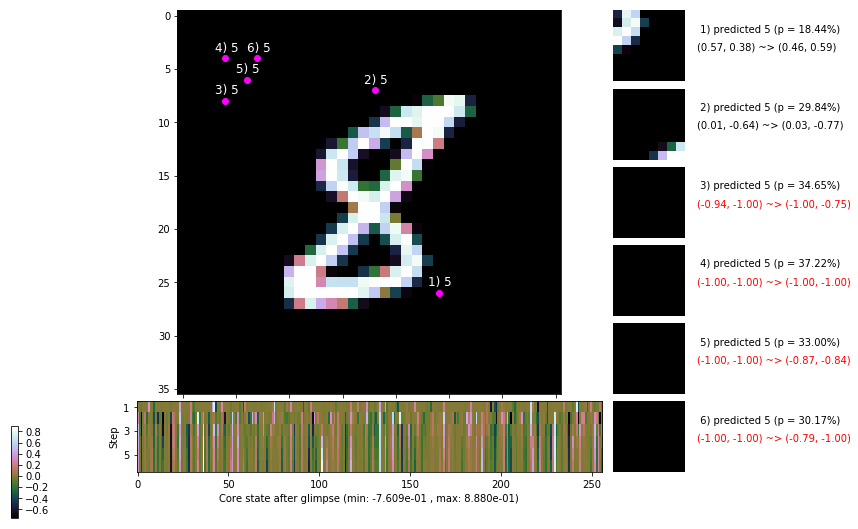

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 162.9 ms/b | lr: 4.30e-04 | grad 2norm: 19.57 | grad inf norm:  5.944
         Weights || abs max:  3.41 ( 1246.96) | mean: -5.07e-04 ( 0.01) | var: 8.81e-02 (   16.22)
          Biases || abs max:  2.57 (   95.53) | mean: -1.25e-01 ( 0.09) | var: 7.17e-02 (   43.59)
                    class loss: 0.796 | steps: 2.814 | reward:  3.651 | acc.: 71.93%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 162.2 ms/b | lr: 4.29e-04 | grad 2norm: 19.63 | grad inf norm:  5.986
         Weights || abs max:  3.41 ( 2953.87) | mean: -5.02e-04 ( 0.01) | var: 8.81e-02 (  554.48)
          Biases || abs max:  2.57 ( 1112.26) | mean: -1.25e-01 ( 0.50) | var: 7.17e-02 (112163.16)
                    class loss: 0.791 | steps: 2.838 | reward:  3.635 | acc.: 71.55%

	Target class: 3 | Discounted rewards: [4.686, 4.095, 3.

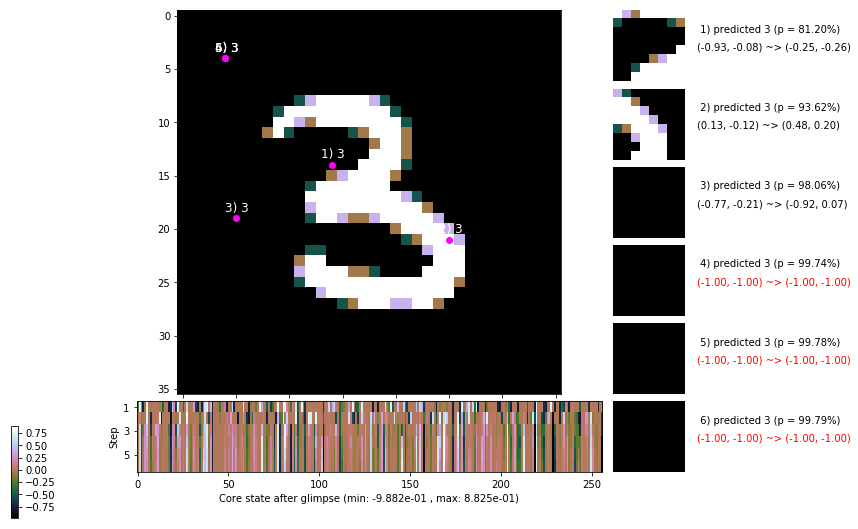

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 163.3 ms/b | lr: 4.29e-04 | grad 2norm: 19.74 | grad inf norm:  6.000
         Weights || abs max:  3.42 ( 6334.53) | mean: -4.94e-04 ( 0.02) | var: 8.82e-02 ( 7830.09)
          Biases || abs max:  2.57 (  138.13) | mean: -1.26e-01 ( 0.13) | var: 7.18e-02 (  176.88)
                    class loss: 0.788 | steps: 2.824 | reward:  3.648 | acc.: 71.95%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 160.3 ms/b | lr: 4.28e-04 | grad 2norm: 19.38 | grad inf norm:  5.634
         Weights || abs max:  3.42 (11374.40) | mean: -5.06e-04 ( 0.03) | var: 8.82e-02 (48562.21)
          Biases || abs max:  2.57 (   93.97) | mean: -1.26e-01 ( 0.09) | var: 7.19e-02 (   25.38)
                    class loss: 0.781 | steps: 2.806 | reward:  3.663 | acc.: 72.27%

	Target class: 1 | Discounted rewards: [4.686, 4.095, 3.4

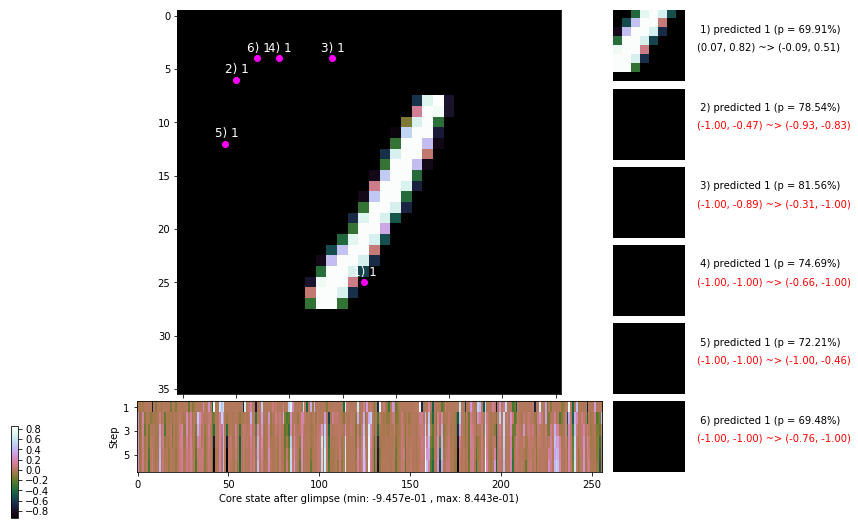

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 163.7 ms/b | lr: 4.27e-04 | grad 2norm: 19.58 | grad inf norm:  5.855
         Weights || abs max:  3.42 ( 2937.59) | mean: -5.06e-04 ( 0.01) | var: 8.82e-02 (  237.05)
          Biases || abs max:  2.58 (  152.14) | mean: -1.26e-01 ( 0.13) | var: 7.19e-02 (  288.79)
                    class loss: 0.803 | steps: 2.848 | reward:  3.617 | acc.: 71.28%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 160.2 ms/b | lr: 4.27e-04 | grad 2norm: 19.41 | grad inf norm:  5.723
         Weights || abs max:  3.42 ( 2488.31) | mean: -5.11e-04 ( 0.01) | var: 8.83e-02 (  867.71)
          Biases || abs max:  2.58 (  143.75) | mean: -1.26e-01 ( 0.12) | var: 7.18e-02 (  454.62)
                    class loss: 0.801 | steps: 2.832 | reward:  3.631 | acc.: 71.40%

	Target class: 8 | Discounted rewards: [1.000, 0.000, 0.0

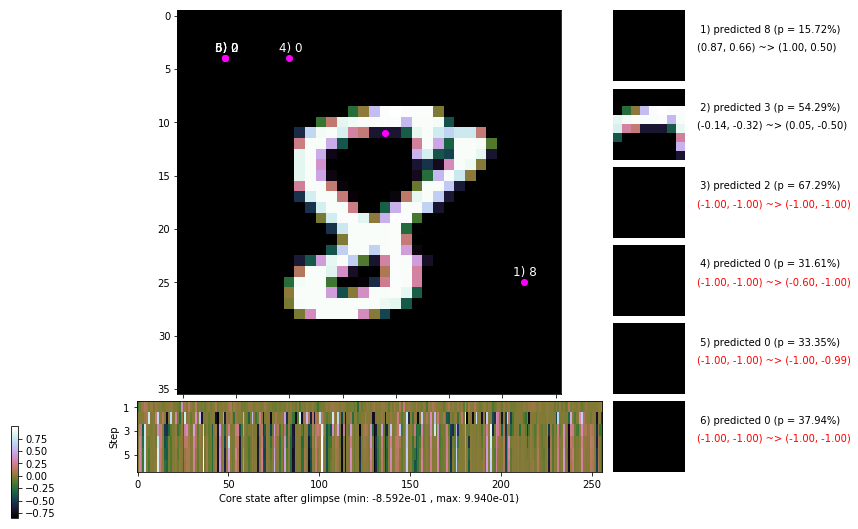

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 165.1 ms/b | lr: 4.26e-04 | grad 2norm: 19.55 | grad inf norm:  5.735
         Weights || abs max:  3.42 ( 1787.01) | mean: -5.11e-04 ( 0.01) | var: 8.83e-02 (   96.66)
          Biases || abs max:  2.58 (  121.78) | mean: -1.26e-01 ( 0.12) | var: 7.19e-02 (   43.77)
                    class loss: 0.817 | steps: 2.822 | reward:  3.610 | acc.: 71.02%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 158.6 ms/b | lr: 4.26e-04 | grad 2norm: 19.80 | grad inf norm:  6.032
         Weights || abs max:  3.43 ( 2348.69) | mean: -4.99e-04 ( 0.01) | var: 8.84e-02 (   97.77)
          Biases || abs max:  2.58 (   85.73) | mean: -1.26e-01 ( 0.09) | var: 7.19e-02 (   58.90)
                    class loss: 0.809 | steps: 2.855 | reward:  3.581 | acc.: 70.58%

	Target class: 9 | Discounted rewards: [1.976, 2.195, 2.4

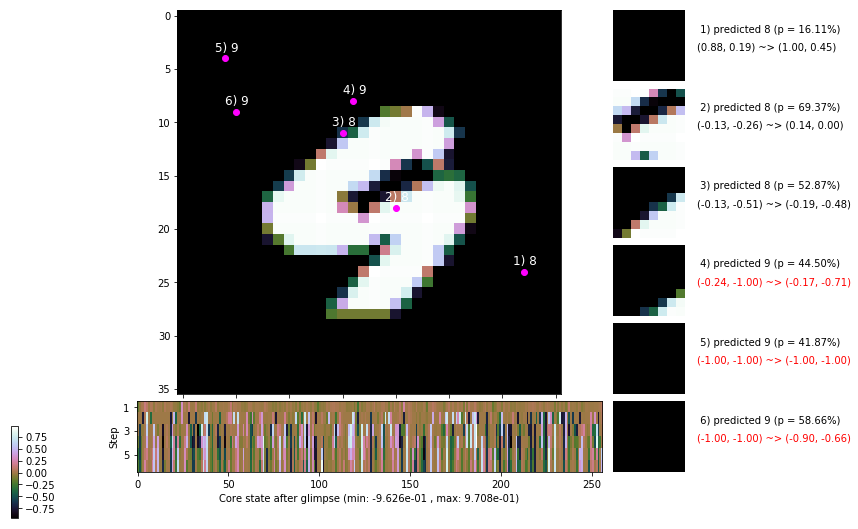

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 0 | Discounted rewards: [2.876, 3.195, 2.439, 2.710, 1.900, 1.000]


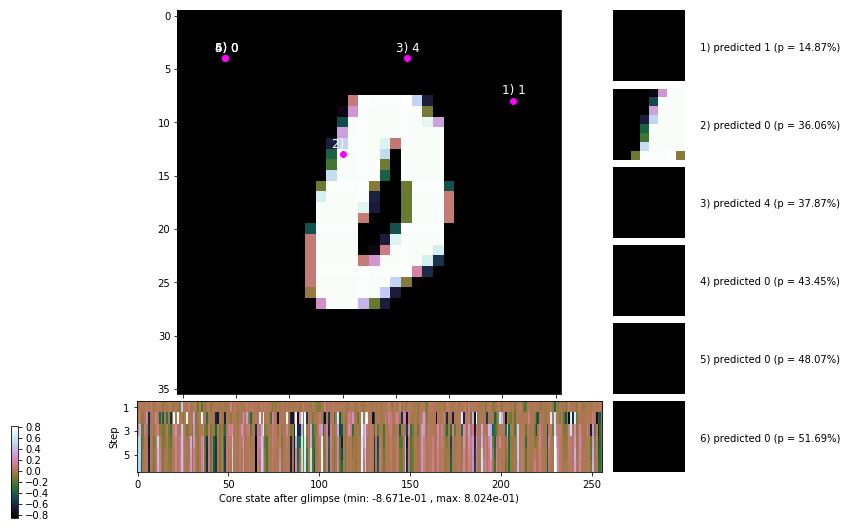


	Target class: 3 | Discounted rewards: [4.686, 4.095, 3.439, 2.710, 1.900, 1.000]


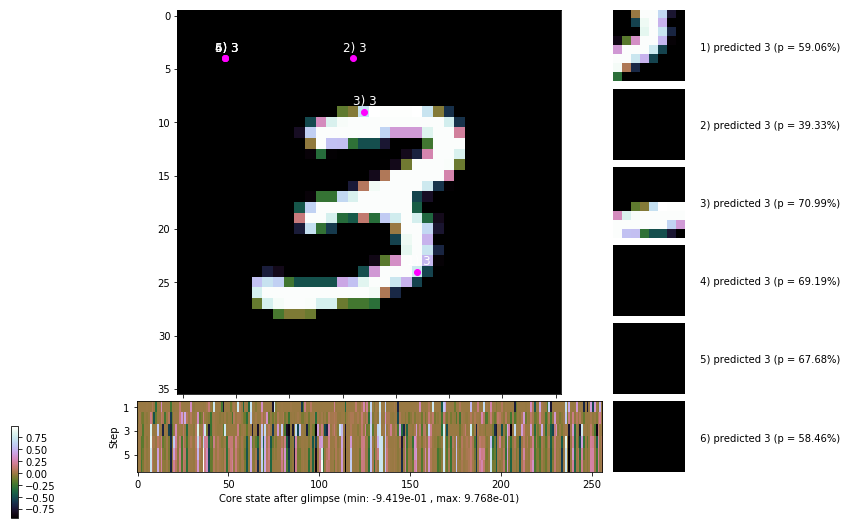

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


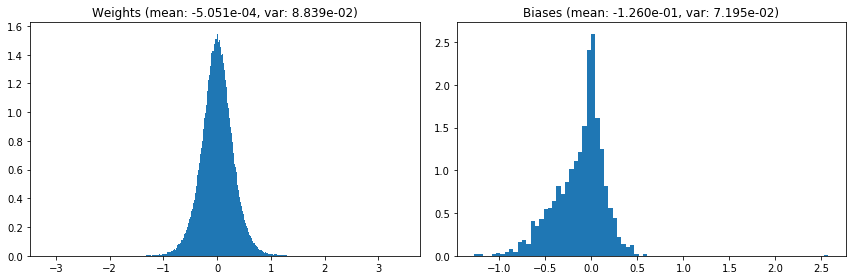

                                      Location network weights and biases


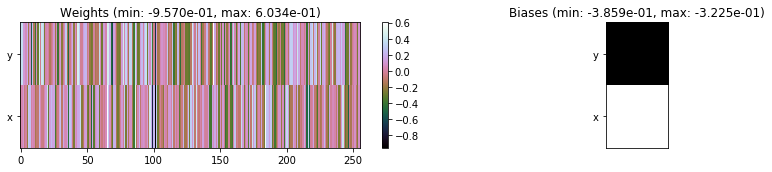

---------------------------------------------------------------------------------------------------------------
Elapsed time:  486.51 sec | TRAIN >> class loss: 0.8026 | steps:  2.835    | reward:  3.6241    | acc.: 71.410% 
                          | VAL   >> class loss: 0.7863 | steps:  2.807 :( | reward:  3.6774 :( | acc.: 72.140% :(


Epoch  58/400) lr = 0.0004251
 b    300/  3000 >> 174.3 ms/b | lr: 4.25e-04 | grad 2norm: 19.46 | grad inf norm:  5.656
         Weights || abs max:  3.44 (11089.06) | mean: -5.17e-04 ( 0.03) | var: 8.84e-02 (37778.98)
          Biases || abs max:  2.58 (  168.41) | mean: -1.26e-01 ( 0.12) | var: 7.19e-02 ( 1112.12)
                    class loss: 0.805 | steps: 2.842 | reward:  3.627 | acc.: 71.58%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 178.5 ms/b | lr: 4.24e-04 | grad 2norm: 19.45 | grad inf norm:  5.646
         Weights || abs max:  3.44 ( 1694.07) | mean: -5.24e-04 ( 0

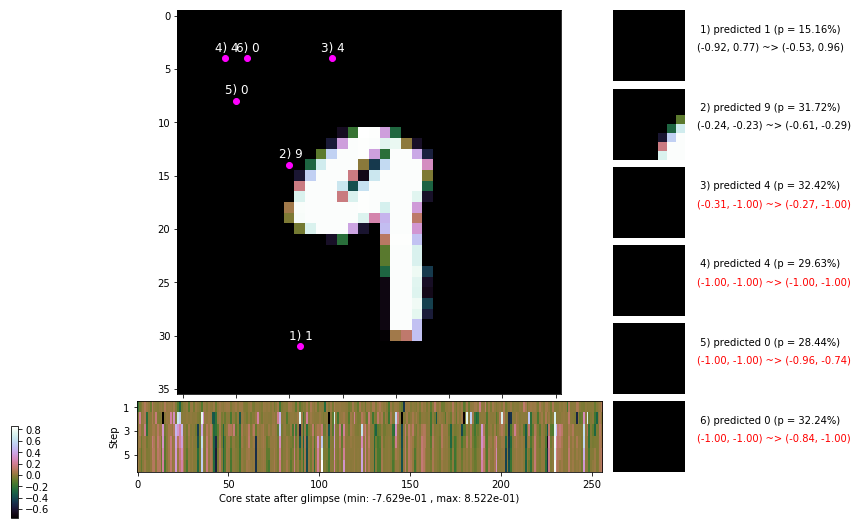

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 162.6 ms/b | lr: 4.23e-04 | grad 2norm: 19.51 | grad inf norm:  5.666
         Weights || abs max:  3.44 ( 1924.23) | mean: -5.13e-04 ( 0.01) | var: 8.85e-02 (  394.00)
          Biases || abs max:  2.58 (  179.21) | mean: -1.27e-01 ( 0.14) | var: 7.21e-02 (  246.90)
                    class loss: 0.831 | steps: 2.844 | reward:  3.586 | acc.: 70.48%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 160.5 ms/b | lr: 4.23e-04 | grad 2norm: 19.23 | grad inf norm:  5.548
         Weights || abs max:  3.43 ( 1275.26) | mean: -4.97e-04 ( 0.01) | var: 8.85e-02 (   22.70)
          Biases || abs max:  2.58 (  259.94) | mean: -1.26e-01 ( 0.18) | var: 7.21e-02 (  513.87)
                    class loss: 0.823 | steps: 2.866 | reward:  3.590 | acc.: 70.82%

	Target class: 4 | Discounted rewards: [2.786, 3.095, 3.4

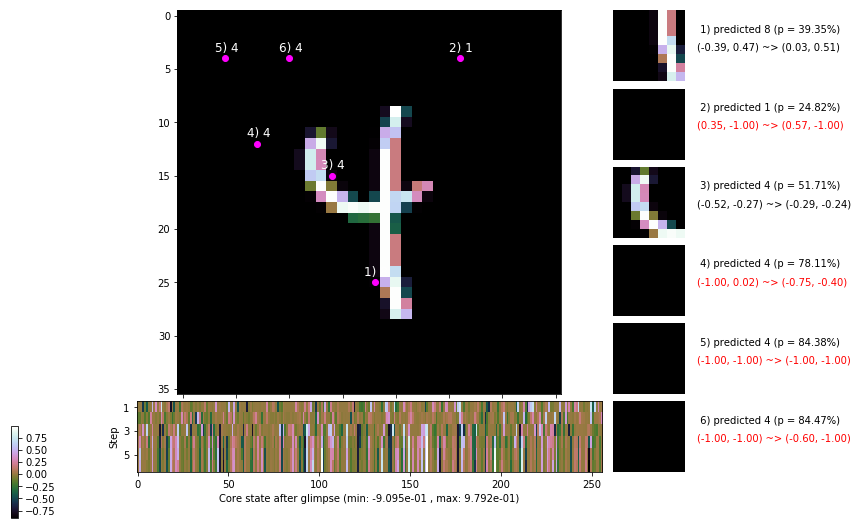

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 161.7 ms/b | lr: 4.22e-04 | grad 2norm: 19.30 | grad inf norm:  5.932
         Weights || abs max:  3.44 ( 6298.74) | mean: -4.86e-04 ( 0.02) | var: 8.86e-02 ( 8818.68)
          Biases || abs max:  2.59 (  180.62) | mean: -1.26e-01 ( 0.15) | var: 7.22e-02 (  513.57)
                    class loss: 0.806 | steps: 2.803 | reward:  3.657 | acc.: 72.17%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 162.0 ms/b | lr: 4.22e-04 | grad 2norm: 19.64 | grad inf norm:  5.855
         Weights || abs max:  3.44 ( 2564.68) | mean: -4.83e-04 ( 0.01) | var: 8.86e-02 (  165.13)
          Biases || abs max:  2.59 (  148.71) | mean: -1.26e-01 ( 0.12) | var: 7.22e-02 (  265.93)
                    class loss: 0.801 | steps: 2.847 | reward:  3.626 | acc.: 71.67%

	Target class: 6 | Discounted rewards: [3.686, 4.095, 3.4

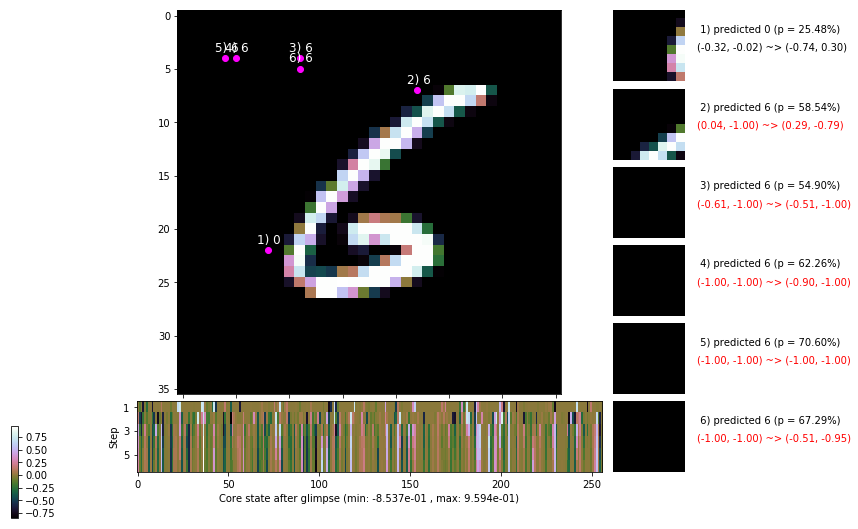

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 169.3 ms/b | lr: 4.21e-04 | grad 2norm: 19.12 | grad inf norm:  5.561
         Weights || abs max:  3.44 ( 1804.86) | mean: -4.90e-04 ( 0.01) | var: 8.86e-02 (   62.65)
          Biases || abs max:  2.59 (  150.23) | mean: -1.26e-01 ( 0.13) | var: 7.22e-02 (  130.65)
                    class loss: 0.803 | steps: 2.804 | reward:  3.635 | acc.: 71.12%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 160.7 ms/b | lr: 4.20e-04 | grad 2norm: 19.56 | grad inf norm:  5.967
         Weights || abs max:  3.44 ( 1069.50) | mean: -4.71e-04 ( 0.01) | var: 8.87e-02 (   16.92)
          Biases || abs max:  2.59 (   83.60) | mean: -1.26e-01 ( 0.10) | var: 7.23e-02 (   33.12)
                    class loss: 0.815 | steps: 2.893 | reward:  3.604 | acc.: 71.58%

	Target class: 8 | Discounted rewards: [0.810, 0.900, 1.0

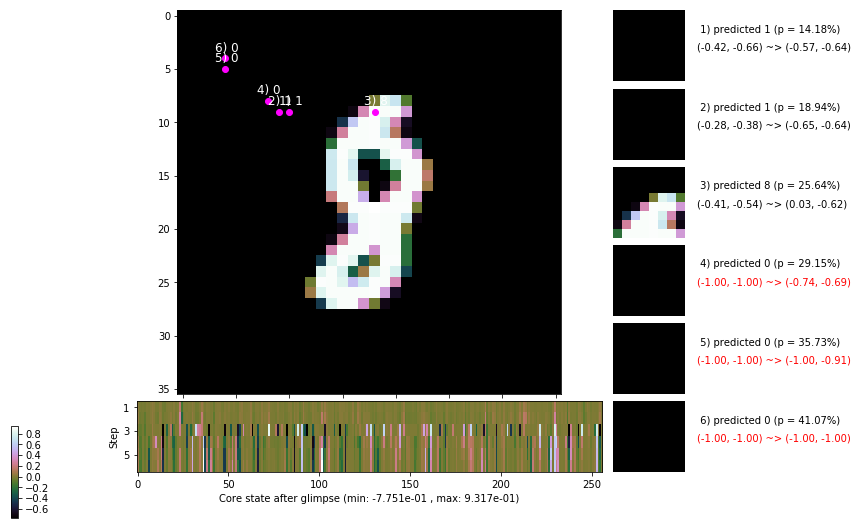

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 154.3 ms/b | lr: 4.20e-04 | grad 2norm: 18.94 | grad inf norm:  5.609
         Weights || abs max:  3.45 ( 5293.94) | mean: -4.88e-04 ( 0.01) | var: 8.87e-02 ( 6910.70)
          Biases || abs max:  2.59 (   98.37) | mean: -1.26e-01 ( 0.11) | var: 7.24e-02 (  201.43)
                    class loss: 0.833 | steps: 2.897 | reward:  3.582 | acc.: 70.85%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 154.0 ms/b | lr: 4.19e-04 | grad 2norm: 19.09 | grad inf norm:  5.601
         Weights || abs max:  3.45 ( 2263.70) | mean: -4.92e-04 ( 0.01) | var: 8.88e-02 (   91.44)
          Biases || abs max:  2.58 (  296.69) | mean: -1.27e-01 ( 0.18) | var: 7.23e-02 ( 2497.72)
                    class loss: 0.846 | steps: 2.879 | reward:  3.554 | acc.: 69.72%

	Target class: 7 | Discounted rewards: [4.686, 4.095, 3.4

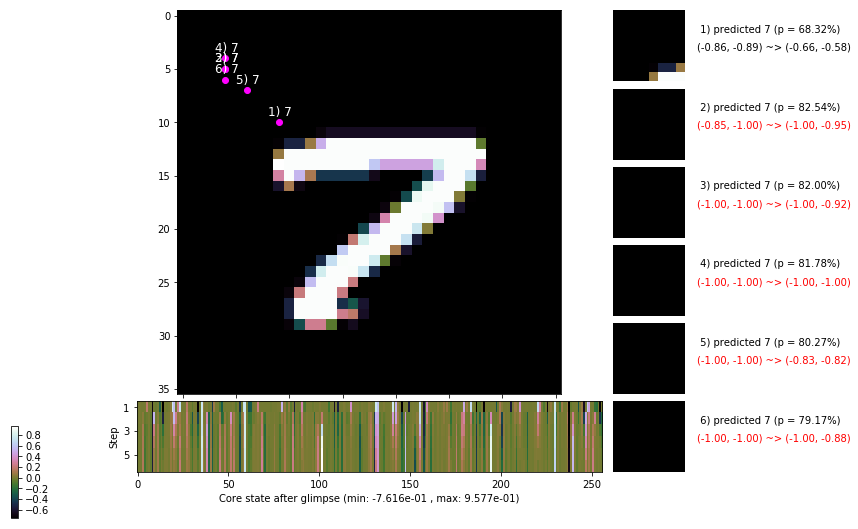

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 6 | Discounted rewards: [2.876, 3.195, 2.439, 2.710, 1.900, 1.000]


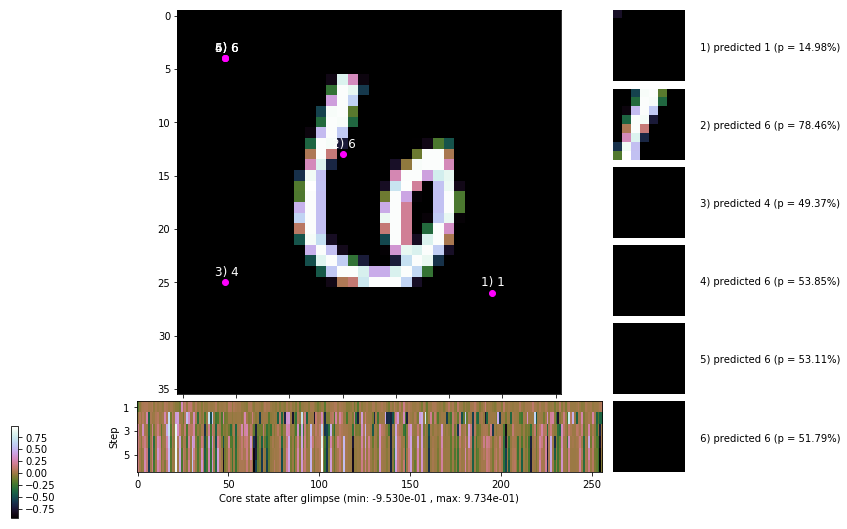


	Target class: 1 | Discounted rewards: [4.686, 4.095, 3.439, 2.710, 1.900, 1.000]


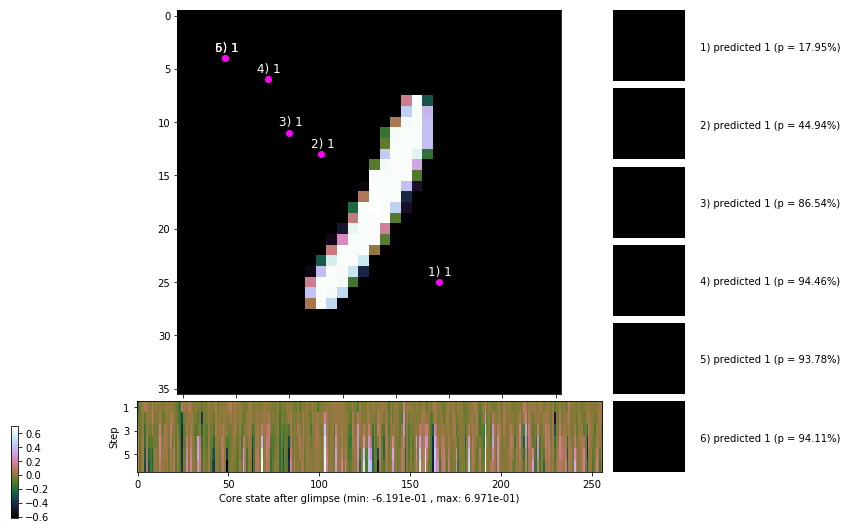

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


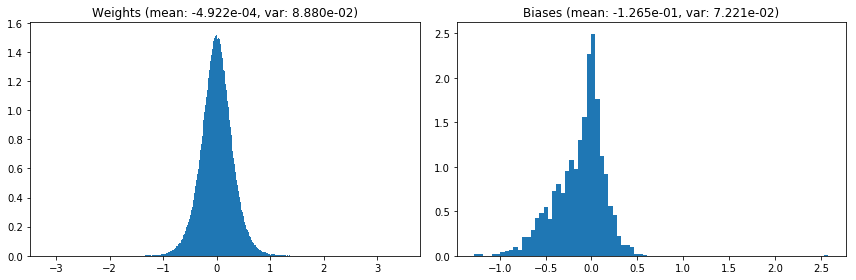

                                      Location network weights and biases


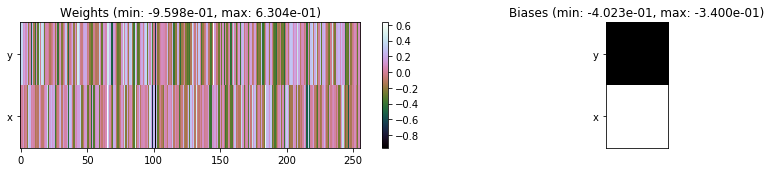

---------------------------------------------------------------------------------------------------------------
Elapsed time:  492.19 sec | TRAIN >> class loss: 0.8180 | steps:  2.855 :( | reward:  3.6043 :( | acc.: 71.107% :(
                          | VAL   >> class loss: 0.8246 | steps:  2.850 :( | reward:  3.6010 :( | acc.: 70.500% :(


Epoch  59/400) lr = 0.0004188
 b    300/  3000 >> 155.2 ms/b | lr: 4.18e-04 | grad 2norm: 19.25 | grad inf norm:  5.733
         Weights || abs max:  3.46 ( 3349.04) | mean: -4.95e-04 ( 0.01) | var: 8.88e-02 (  334.14)
          Biases || abs max:  2.58 (  132.94) | mean: -1.27e-01 ( 0.11) | var: 7.22e-02 (  252.99)
                    class loss: 0.844 | steps: 2.903 | reward:  3.550 | acc.: 70.63%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 154.5 ms/b | lr: 4.18e-04 | grad 2norm: 19.13 | grad inf norm:  5.653
         Weights || abs max:  3.46 ( 7356.18) | mean: -5.07e-04 (

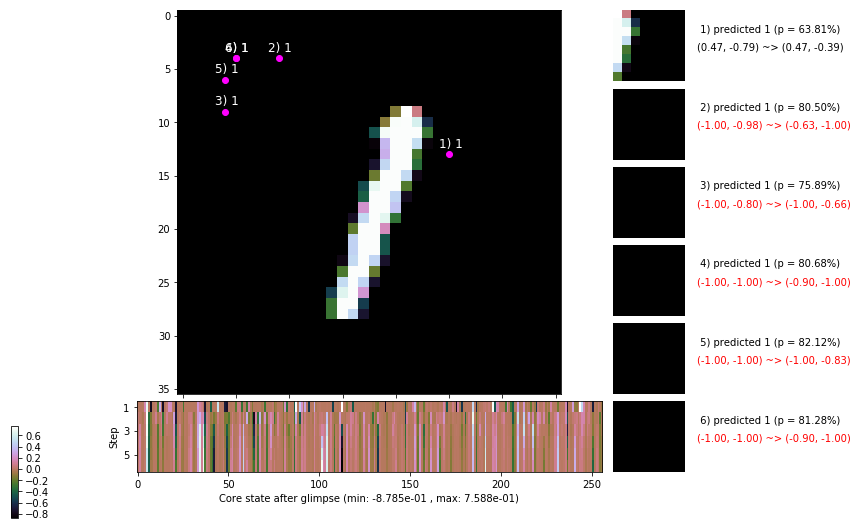

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 156.9 ms/b | lr: 4.17e-04 | grad 2norm: 19.19 | grad inf norm:  5.624
         Weights || abs max:  3.46 ( 2959.11) | mean: -4.93e-04 ( 0.01) | var: 8.89e-02 ( 1735.69)
          Biases || abs max:  2.57 (  302.24) | mean: -1.27e-01 ( 0.18) | var: 7.23e-02 ( 5968.98)
                    class loss: 0.834 | steps: 2.883 | reward:  3.565 | acc.: 70.47%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 158.8 ms/b | lr: 4.17e-04 | grad 2norm: 18.94 | grad inf norm:  5.780
         Weights || abs max:  3.46 ( 2435.65) | mean: -4.93e-04 ( 0.01) | var: 8.90e-02 (  233.50)
          Biases || abs max:  2.57 (  136.90) | mean: -1.27e-01 ( 0.12) | var: 7.24e-02 (  114.81)
                    class loss: 0.848 | steps: 2.910 | reward:  3.553 | acc.: 70.03%

	Target class: 2 | Discounted rewards: [0.000, 0.000, 0.0

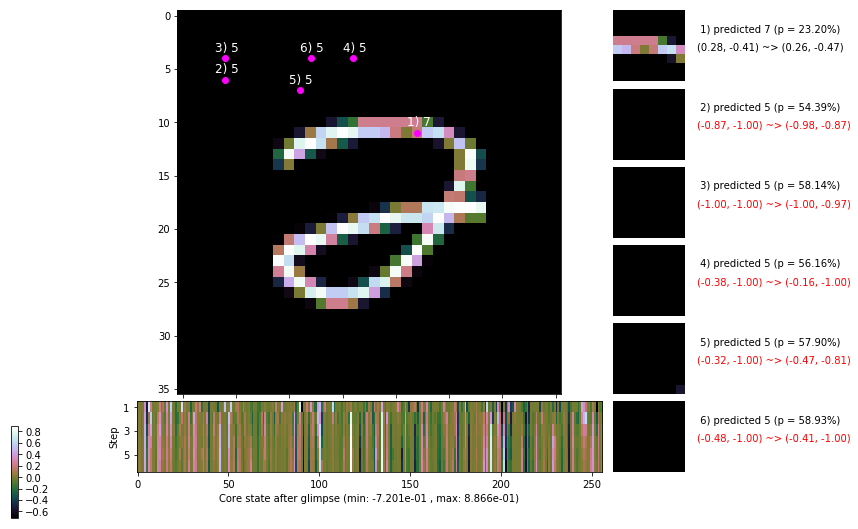

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 157.0 ms/b | lr: 4.16e-04 | grad 2norm: 18.99 | grad inf norm:  5.652
         Weights || abs max:  3.46 ( 1648.96) | mean: -4.90e-04 ( 0.01) | var: 8.90e-02 (  241.59)
          Biases || abs max:  2.57 (  106.77) | mean: -1.27e-01 ( 0.11) | var: 7.23e-02 (   29.94)
                    class loss: 0.808 | steps: 2.844 | reward:  3.610 | acc.: 71.28%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 156.5 ms/b | lr: 4.15e-04 | grad 2norm: 19.08 | grad inf norm:  5.701
         Weights || abs max:  3.45 ( 2144.24) | mean: -4.99e-04 ( 0.01) | var: 8.91e-02 (  224.71)
          Biases || abs max:  2.57 (   97.35) | mean: -1.26e-01 ( 0.10) | var: 7.23e-02 (   28.84)
                    class loss: 0.843 | steps: 2.869 | reward:  3.545 | acc.: 69.60%

	Target class: 1 | Discounted rewards: [3.786, 3.095, 3.4

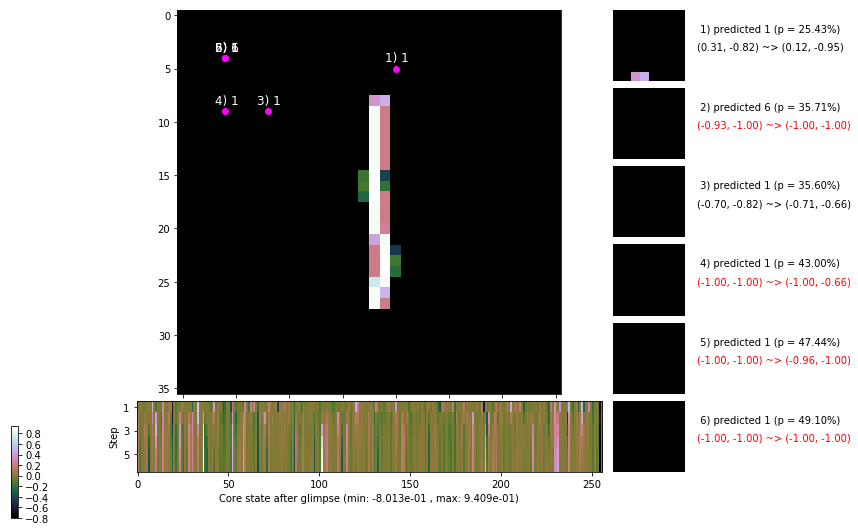

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 155.5 ms/b | lr: 4.15e-04 | grad 2norm: 19.01 | grad inf norm:  5.584
         Weights || abs max:  3.45 ( 1470.64) | mean: -5.16e-04 ( 0.01) | var: 8.91e-02 (  137.34)
          Biases || abs max:  2.56 (  130.22) | mean: -1.27e-01 ( 0.12) | var: 7.24e-02 (   88.05)
                    class loss: 0.838 | steps: 2.869 | reward:  3.558 | acc.: 70.28%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 153.8 ms/b | lr: 4.14e-04 | grad 2norm: 19.21 | grad inf norm:  5.718
         Weights || abs max:  3.46 ( 1278.65) | mean: -5.15e-04 ( 0.01) | var: 8.92e-02 (   44.56)
          Biases || abs max:  2.56 (  128.21) | mean: -1.27e-01 ( 0.11) | var: 7.22e-02 (   77.61)
                    class loss: 0.832 | steps: 2.888 | reward:  3.550 | acc.: 70.53%

	Target class: 4 | Discounted rewards: [2.786, 3.095, 3.4

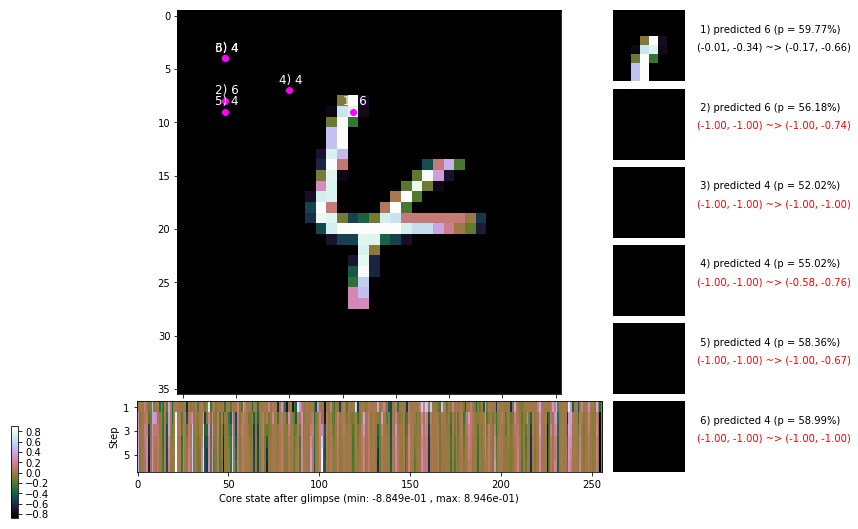

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 158.2 ms/b | lr: 4.13e-04 | grad 2norm: 19.38 | grad inf norm:  5.758
         Weights || abs max:  3.46 ( 1857.56) | mean: -5.11e-04 ( 0.01) | var: 8.92e-02 (  185.79)
          Biases || abs max:  2.55 (  406.72) | mean: -1.27e-01 ( 0.22) | var: 7.23e-02 (10798.37)
                    class loss: 0.822 | steps: 2.876 | reward:  3.569 | acc.: 70.62%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 155.5 ms/b | lr: 4.13e-04 | grad 2norm: 19.36 | grad inf norm:  5.514
         Weights || abs max:  3.47 ( 2532.27) | mean: -5.13e-04 ( 0.01) | var: 8.92e-02 (  416.36)
          Biases || abs max:  2.56 (  680.79) | mean: -1.27e-01 ( 0.34) | var: 7.23e-02 (13705.45)
                    class loss: 0.807 | steps: 2.828 | reward:  3.622 | acc.: 71.05%

	Target class: 2 | Discounted rewards: [3.686, 4.095, 3.4

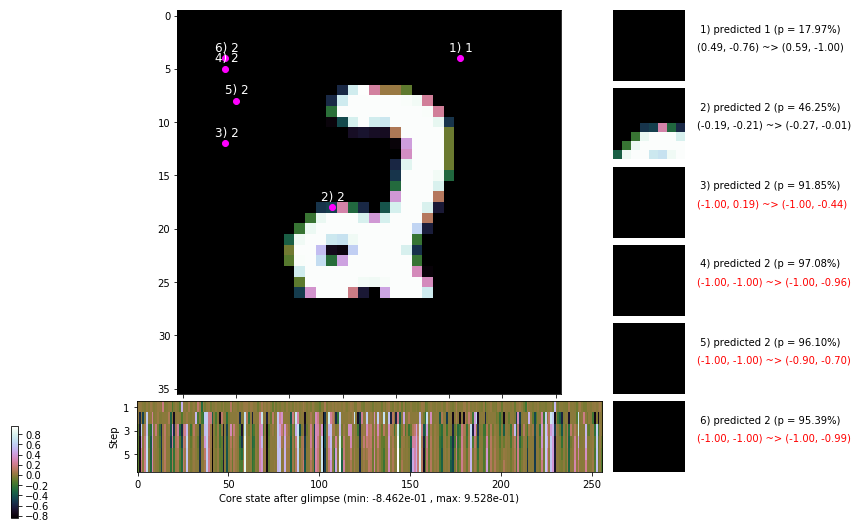

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 2 | Discounted rewards: [3.439, 2.710, 1.900, 1.000, 0.000, 0.000]


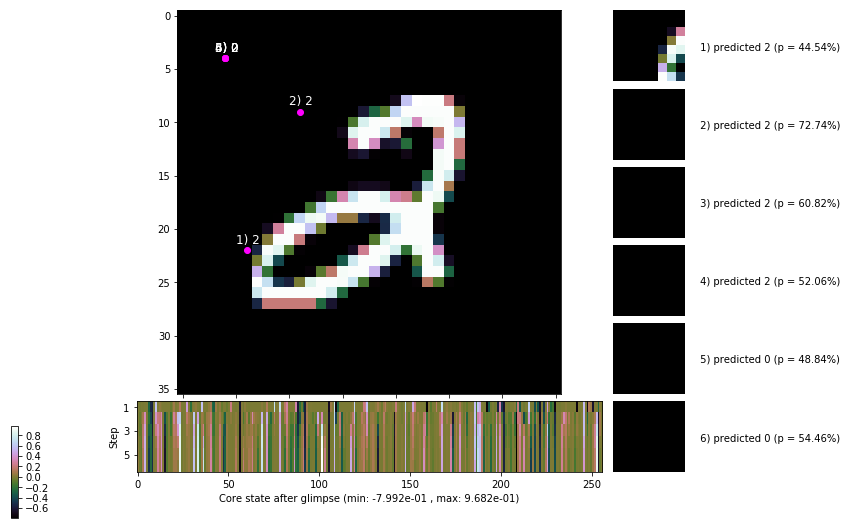


	Target class: 8 | Discounted rewards: [0.590, 0.656, 0.729, 0.810, 0.900, 1.000]


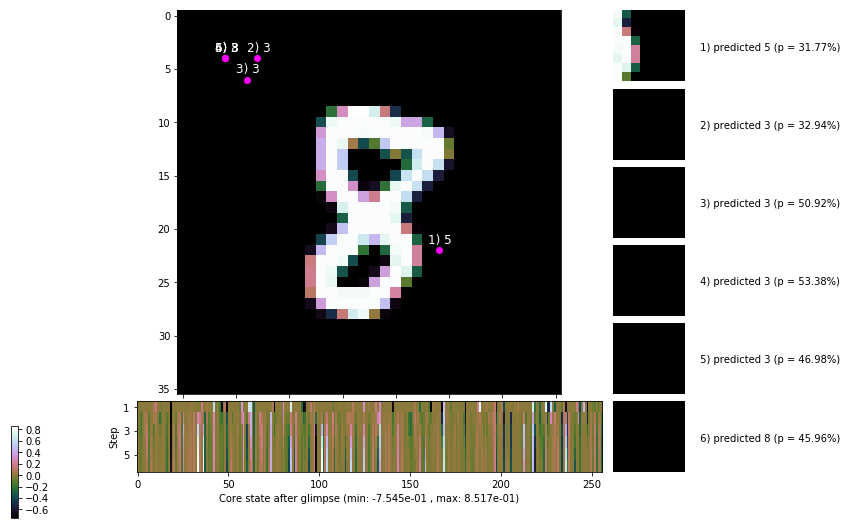

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


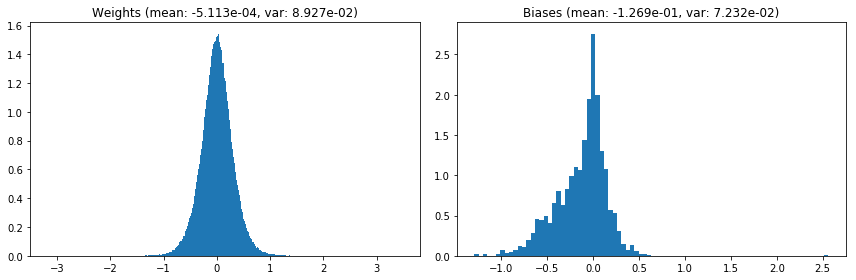

                                      Location network weights and biases


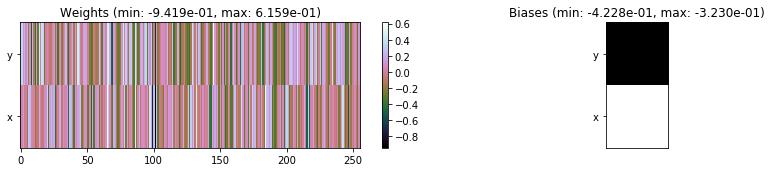

---------------------------------------------------------------------------------------------------------------
Elapsed time:  469.11 sec | TRAIN >> class loss: 0.8319 | steps:  2.875 :( | reward:  3.5671 :( | acc.: 70.465% :(
                          | VAL   >> class loss: 0.8007 | steps:  2.789 :( | reward:  3.6836 :( | acc.: 71.680% :(


Epoch  60/400) lr = 0.0004125
 b    300/  3000 >> 158.0 ms/b | lr: 4.12e-04 | grad 2norm: 19.73 | grad inf norm:  6.061
         Weights || abs max:  3.47 ( 7188.49) | mean: -4.94e-04 ( 0.02) | var: 8.93e-02 (13841.03)
          Biases || abs max:  2.56 (  240.68) | mean: -1.27e-01 ( 0.17) | var: 7.23e-02 (  501.62)
                    class loss: 0.800 | steps: 2.827 | reward:  3.640 | acc.: 71.67%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 153.5 ms/b | lr: 4.12e-04 | grad 2norm: 19.28 | grad inf norm:  5.584
         Weights || abs max:  3.47 ( 1051.67) | mean: -4.94e-04 (

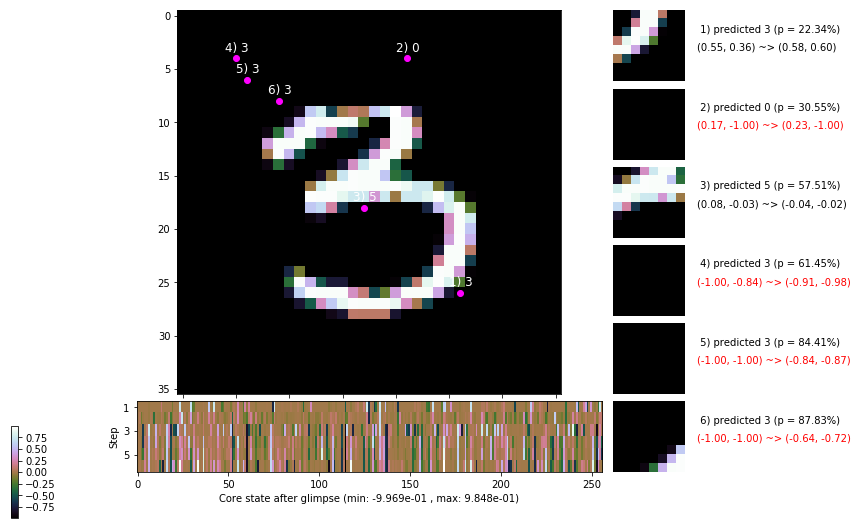

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 160.1 ms/b | lr: 4.11e-04 | grad 2norm: 19.67 | grad inf norm:  5.773
         Weights || abs max:  3.46 ( 4875.56) | mean: -5.11e-04 ( 0.01) | var: 8.94e-02 ( 2702.75)
          Biases || abs max:  2.56 (  153.98) | mean: -1.27e-01 ( 0.12) | var: 7.24e-02 (  191.20)
                    class loss: 0.830 | steps: 2.866 | reward:  3.583 | acc.: 70.90%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 155.2 ms/b | lr: 4.10e-04 | grad 2norm: 19.37 | grad inf norm:  5.787
         Weights || abs max:  3.47 ( 1013.48) | mean: -5.19e-04 ( 0.01) | var: 8.94e-02 (   90.40)
          Biases || abs max:  2.56 (  197.06) | mean: -1.27e-01 ( 0.14) | var: 7.25e-02 (  310.14)
                    class loss: 0.836 | steps: 2.864 | reward:  3.576 | acc.: 70.55%

	Target class: 3 | Discounted rewards: [3.686, 4.095, 3.4

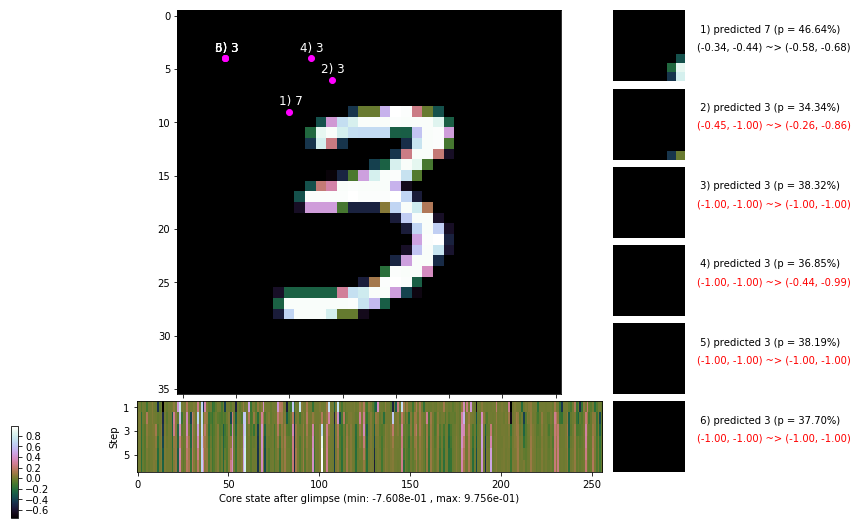

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 156.9 ms/b | lr: 4.10e-04 | grad 2norm: 19.19 | grad inf norm:  5.937
         Weights || abs max:  3.48 ( 2523.79) | mean: -5.11e-04 ( 0.01) | var: 8.94e-02 (  202.84)
          Biases || abs max:  2.56 (  281.24) | mean: -1.27e-01 ( 0.17) | var: 7.26e-02 (  789.09)
                    class loss: 0.846 | steps: 2.854 | reward:  3.571 | acc.: 70.48%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 160.4 ms/b | lr: 4.09e-04 | grad 2norm: 19.14 | grad inf norm:  5.657
         Weights || abs max:  3.49 ( 3446.48) | mean: -4.96e-04 ( 0.01) | var: 8.95e-02 ( 2674.11)
          Biases || abs max:  2.56 (   76.35) | mean: -1.27e-01 ( 0.09) | var: 7.27e-02 (   22.52)
                    class loss: 0.812 | steps: 2.842 | reward:  3.614 | acc.: 71.38%

	Target class: 3 | Discounted rewards: [0.000, 0.000, 0.0

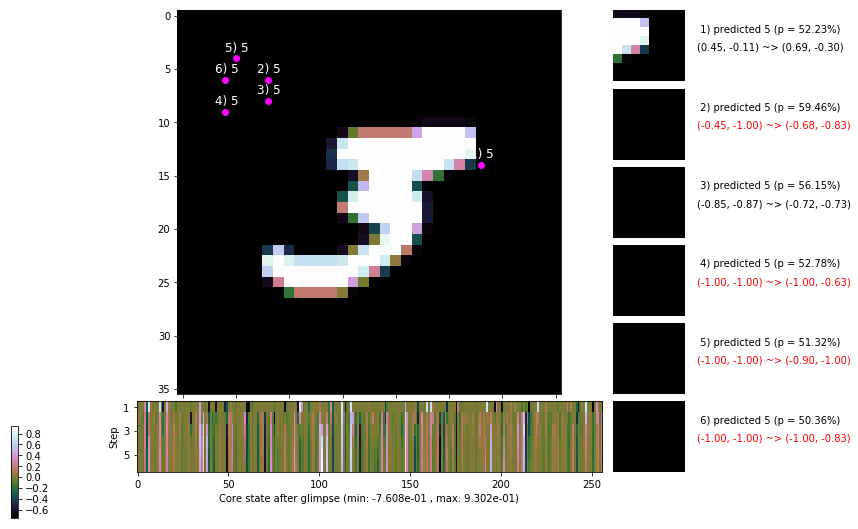

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 162.6 ms/b | lr: 4.08e-04 | grad 2norm: 18.99 | grad inf norm:  5.572
         Weights || abs max:  3.49 ( 2785.78) | mean: -5.00e-04 ( 0.01) | var: 8.95e-02 (  955.53)
          Biases || abs max:  2.57 (  518.18) | mean: -1.28e-01 ( 0.26) | var: 7.28e-02 ( 9380.55)
                    class loss: 0.824 | steps: 2.861 | reward:  3.594 | acc.: 70.73%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 168.0 ms/b | lr: 4.08e-04 | grad 2norm: 19.53 | grad inf norm:  5.895
         Weights || abs max:  3.49 ( 5120.61) | mean: -4.65e-04 ( 0.01) | var: 8.95e-02 ( 3253.76)
          Biases || abs max:  2.57 (  110.36) | mean: -1.27e-01 ( 0.10) | var: 7.29e-02 (   40.01)
                    class loss: 0.787 | steps: 2.828 | reward:  3.646 | acc.: 72.10%

	Target class: 1 | Discounted rewards: [4.686, 4.095, 3.4

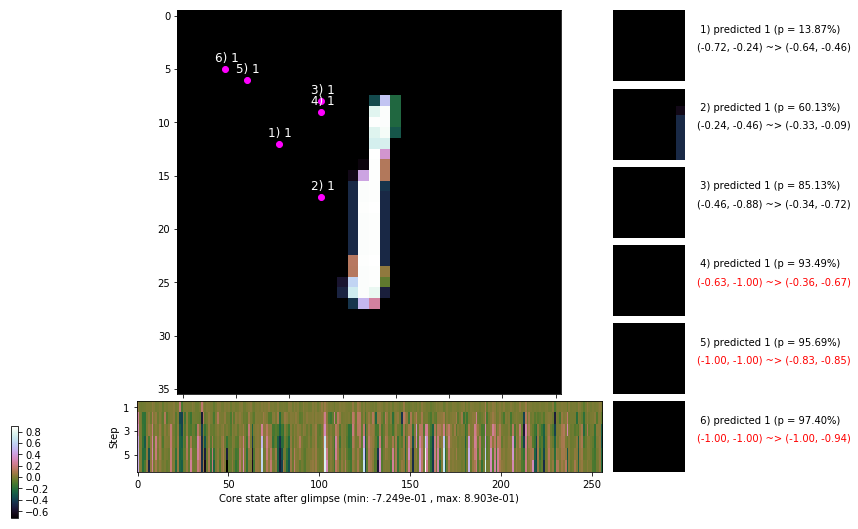

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 167.1 ms/b | lr: 4.07e-04 | grad 2norm: 19.62 | grad inf norm:  5.861
         Weights || abs max:  3.49 ( 4964.31) | mean: -4.47e-04 ( 0.01) | var: 8.96e-02 ( 4861.94)
          Biases || abs max:  2.57 (  184.71) | mean: -1.27e-01 ( 0.14) | var: 7.28e-02 (  257.03)
                    class loss: 0.825 | steps: 2.876 | reward:  3.577 | acc.: 70.70%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 164.3 ms/b | lr: 4.07e-04 | grad 2norm: 19.01 | grad inf norm:  5.638
         Weights || abs max:  3.49 ( 1002.81) | mean: -4.47e-04 ( 0.01) | var: 8.96e-02 (   81.53)
          Biases || abs max:  2.57 (  125.99) | mean: -1.27e-01 ( 0.11) | var: 7.29e-02 (   49.82)
                    class loss: 0.805 | steps: 2.826 | reward:  3.639 | acc.: 72.05%

	Target class: 2 | Discounted rewards: [1.976, 2.195, 2.4

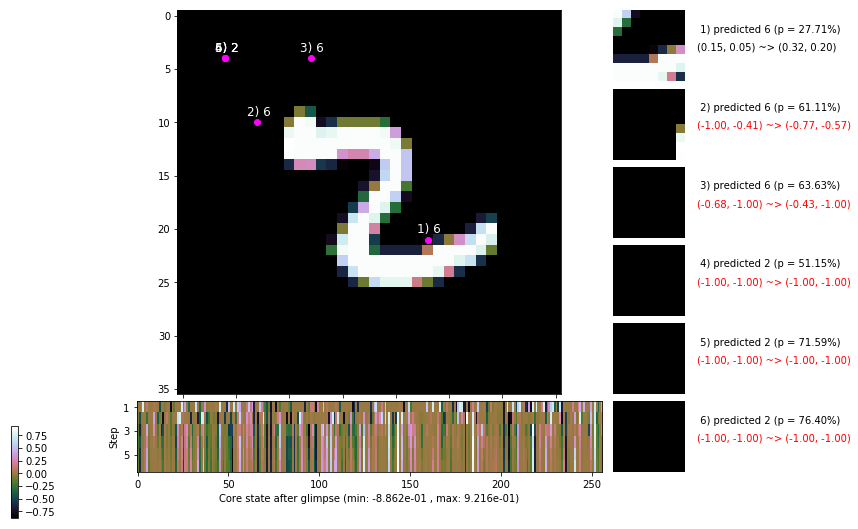

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 9 | Discounted rewards: [3.686, 4.095, 3.439, 2.710, 1.900, 1.000]


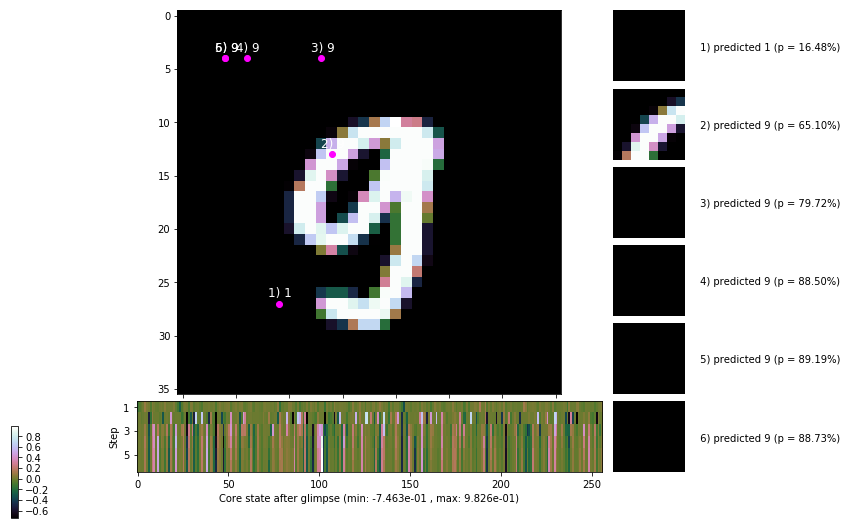


	Target class: 9 | Discounted rewards: [3.686, 4.095, 3.439, 2.710, 1.900, 1.000]


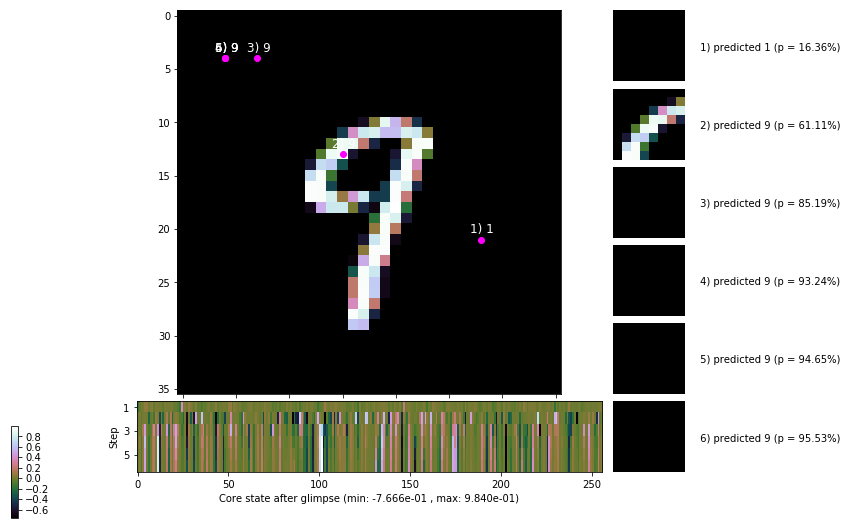

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


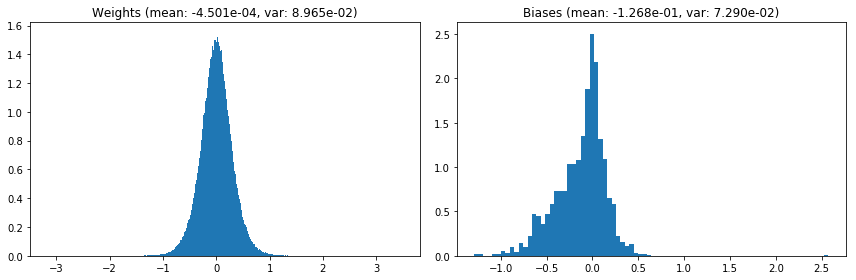

                                      Location network weights and biases


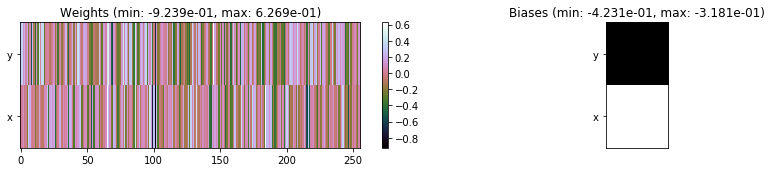

---------------------------------------------------------------------------------------------------------------
Elapsed time:  482.72 sec | TRAIN >> class loss: 0.8169 | steps:  2.848 :( | reward:  3.6053 :( | acc.: 71.203% :(
                          | VAL   >> class loss: 0.8060 | steps:  2.779 :( | reward:  3.6788 :( | acc.: 71.060% :(


Epoch  61/400) lr = 0.0004064
 b    300/  3000 >> 166.9 ms/b | lr: 4.06e-04 | grad 2norm: 19.30 | grad inf norm:  5.807
         Weights || abs max:  3.48 ( 1889.90) | mean: -4.54e-04 ( 0.01) | var: 8.97e-02 (  138.52)
          Biases || abs max:  2.57 (  102.14) | mean: -1.27e-01 ( 0.10) | var: 7.29e-02 (   70.70)
                    class loss: 0.835 | steps: 2.846 | reward:  3.602 | acc.: 70.87%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 165.9 ms/b | lr: 4.06e-04 | grad 2norm: 19.06 | grad inf norm:  5.495
         Weights || abs max:  3.47 ( 6937.71) | mean: -4.49e-04 (

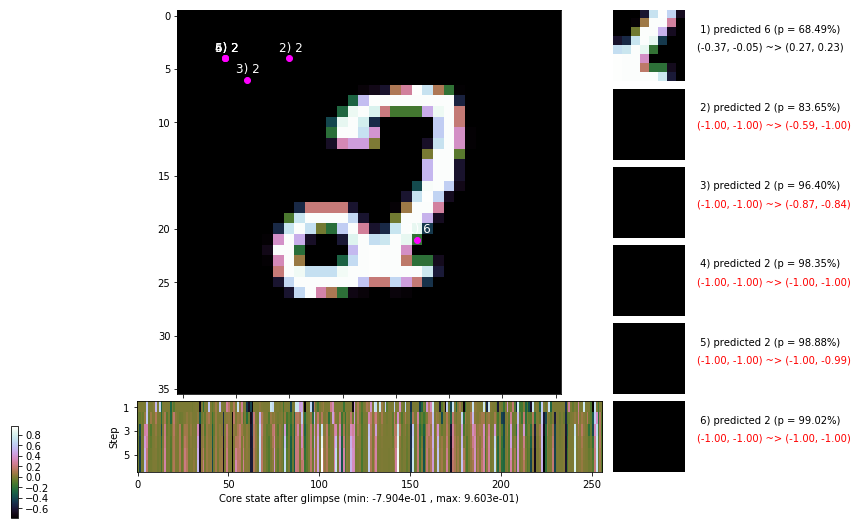

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 170.5 ms/b | lr: 4.05e-04 | grad 2norm: 19.47 | grad inf norm:  5.631
         Weights || abs max:  3.47 ( 1368.79) | mean: -4.42e-04 ( 0.01) | var: 8.97e-02 (   83.08)
          Biases || abs max:  2.57 (  100.12) | mean: -1.28e-01 ( 0.09) | var: 7.31e-02 (   95.64)
                    class loss: 0.814 | steps: 2.825 | reward:  3.618 | acc.: 70.92%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 164.8 ms/b | lr: 4.04e-04 | grad 2norm: 19.20 | grad inf norm:  5.707
         Weights || abs max:  3.47 ( 5260.63) | mean: -4.48e-04 ( 0.01) | var: 8.98e-02 (11903.22)
          Biases || abs max:  2.57 (  151.58) | mean: -1.28e-01 ( 0.12) | var: 7.31e-02 (  632.76)
                    class loss: 0.805 | steps: 2.806 | reward:  3.620 | acc.: 71.08%

	Target class: 6 | Discounted rewards: [0.000, 0.000, 0.0

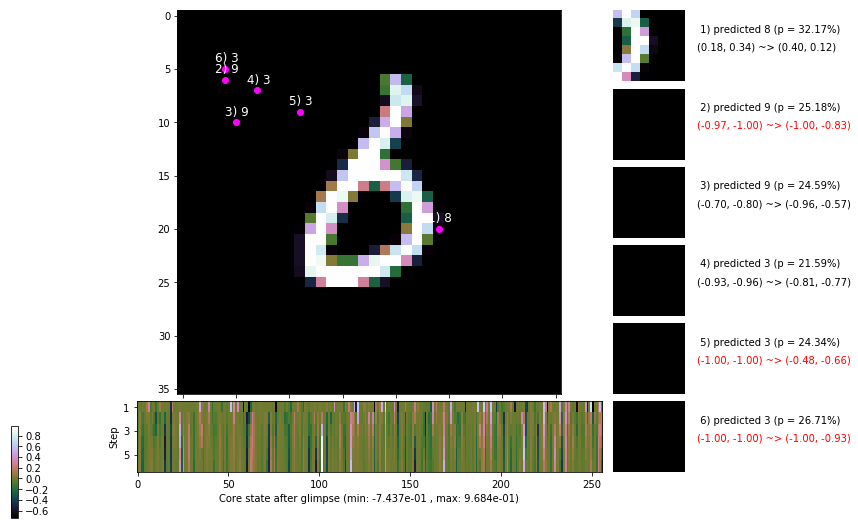

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 168.3 ms/b | lr: 4.04e-04 | grad 2norm: 19.42 | grad inf norm:  5.923
         Weights || abs max:  3.48 (  982.67) | mean: -4.65e-04 ( 0.01) | var: 8.98e-02 (   25.24)
          Biases || abs max:  2.57 (   63.92) | mean: -1.27e-01 ( 0.08) | var: 7.32e-02 (   10.36)
                    class loss: 0.848 | steps: 2.905 | reward:  3.519 | acc.: 69.70%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 167.5 ms/b | lr: 4.03e-04 | grad 2norm: 19.29 | grad inf norm:  5.839
         Weights || abs max:  3.48 ( 1257.65) | mean: -4.67e-04 ( 0.01) | var: 8.98e-02 (  117.08)
          Biases || abs max:  2.56 (  208.82) | mean: -1.28e-01 ( 0.17) | var: 7.32e-02 (  215.91)
                    class loss: 0.828 | steps: 2.872 | reward:  3.573 | acc.: 70.88%

	Target class: 1 | Discounted rewards: [3.786, 3.095, 3.4

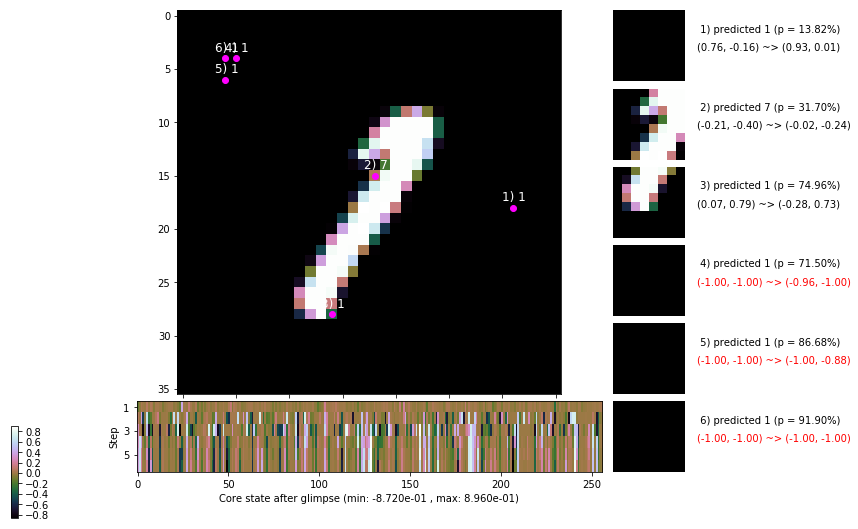

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 167.2 ms/b | lr: 4.02e-04 | grad 2norm: 19.42 | grad inf norm:  5.973
         Weights || abs max:  3.49 ( 1923.02) | mean: -4.90e-04 ( 0.01) | var: 8.99e-02 (  136.29)
          Biases || abs max:  2.56 ( 1969.75) | mean: -1.28e-01 ( 0.83) | var: 7.32e-02 (371454.72)
                    class loss: 0.808 | steps: 2.847 | reward:  3.586 | acc.: 70.80%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 168.3 ms/b | lr: 4.02e-04 | grad 2norm: 19.01 | grad inf norm:  5.764
         Weights || abs max:  3.50 ( 3842.10) | mean: -4.85e-04 ( 0.01) | var: 8.99e-02 ( 3607.78)
          Biases || abs max:  2.57 (  187.45) | mean: -1.28e-01 ( 0.15) | var: 7.33e-02 (  297.02)
                    class loss: 0.776 | steps: 2.801 | reward:  3.675 | acc.: 72.75%

	Target class: 6 | Discounted rewards: [4.686, 4.095, 3.

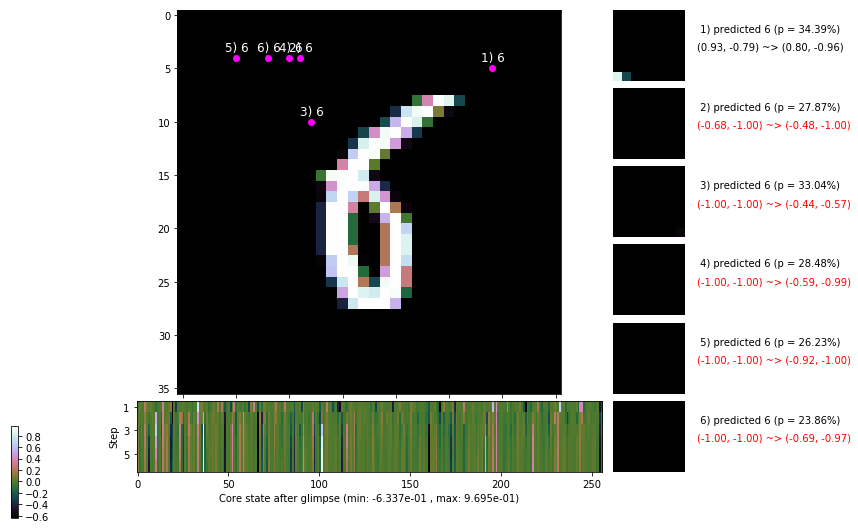

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 165.5 ms/b | lr: 4.01e-04 | grad 2norm: 19.15 | grad inf norm:  5.954
         Weights || abs max:  3.51 ( 1227.86) | mean: -4.72e-04 ( 0.01) | var: 8.99e-02 (   49.35)
          Biases || abs max:  2.57 (  343.71) | mean: -1.28e-01 ( 0.20) | var: 7.32e-02 ( 3020.26)
                    class loss: 0.850 | steps: 2.894 | reward:  3.541 | acc.: 69.43%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 166.2 ms/b | lr: 4.01e-04 | grad 2norm: 19.33 | grad inf norm:  5.918
         Weights || abs max:  3.50 ( 2992.84) | mean: -4.72e-04 ( 0.01) | var: 9.00e-02 (  526.23)
          Biases || abs max:  2.57 (  447.25) | mean: -1.28e-01 ( 0.36) | var: 7.32e-02 (22393.04)
                    class loss: 0.849 | steps: 2.901 | reward:  3.558 | acc.: 70.12%

	Target class: 5 | Discounted rewards: [3.686, 4.095, 3.4

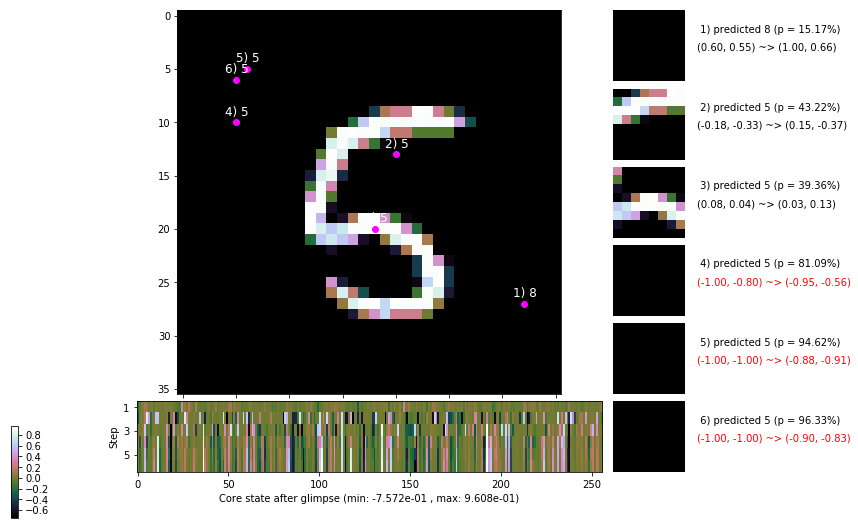

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 3 | Discounted rewards: [3.686, 4.095, 3.439, 2.710, 1.900, 1.000]


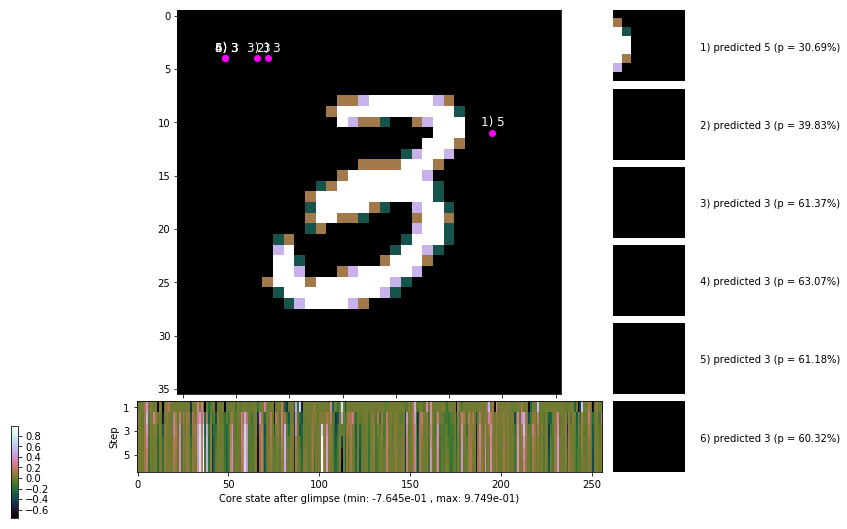


	Target class: 5 | Discounted rewards: [3.686, 4.095, 3.439, 2.710, 1.900, 1.000]


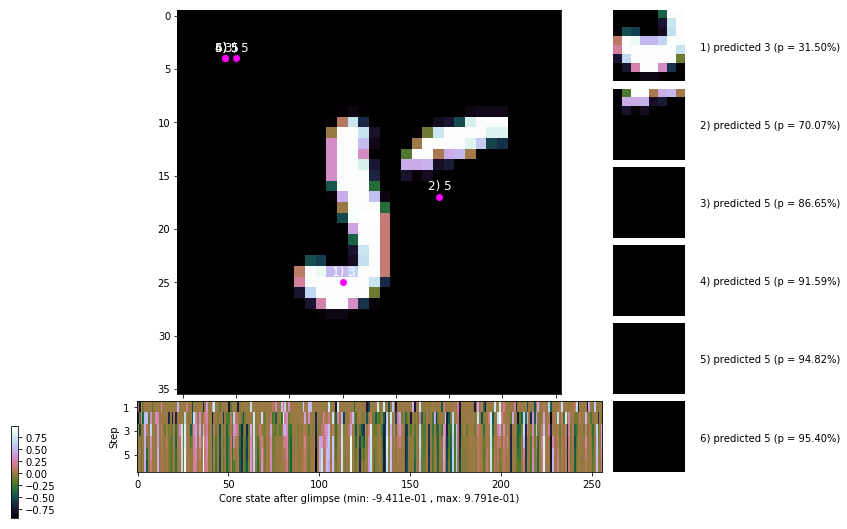

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


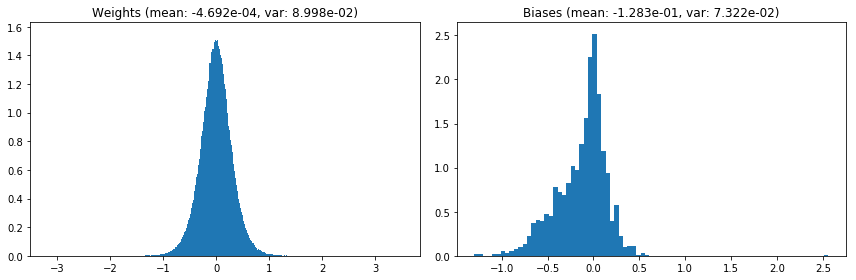

                                      Location network weights and biases


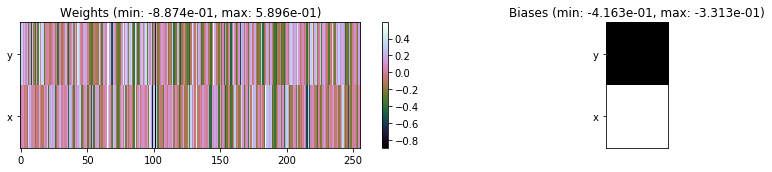

---------------------------------------------------------------------------------------------------------------
Elapsed time:  502.01 sec | TRAIN >> class loss: 0.8248 | steps:  2.852 :( | reward:  3.5893 :( | acc.: 70.755% :(
                          | VAL   >> class loss: 0.8236 | steps:  2.837 :( | reward:  3.6352 :( | acc.: 70.520% :(


Epoch  62/400) lr = 0.0004003
 b    300/  3000 >> 164.1 ms/b | lr: 4.00e-04 | grad 2norm: 19.12 | grad inf norm:  6.026
         Weights || abs max:  3.50 ( 2780.59) | mean: -4.68e-04 ( 0.01) | var: 9.00e-02 (  529.20)
          Biases || abs max:  2.56 (  159.81) | mean: -1.28e-01 ( 0.13) | var: 7.32e-02 (  121.74)
                    class loss: 0.853 | steps: 2.892 | reward:  3.571 | acc.: 70.08%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 165.4 ms/b | lr: 4.00e-04 | grad 2norm: 19.20 | grad inf norm:  5.993
         Weights || abs max:  3.50 ( 1578.53) | mean: -4.62e-04 (

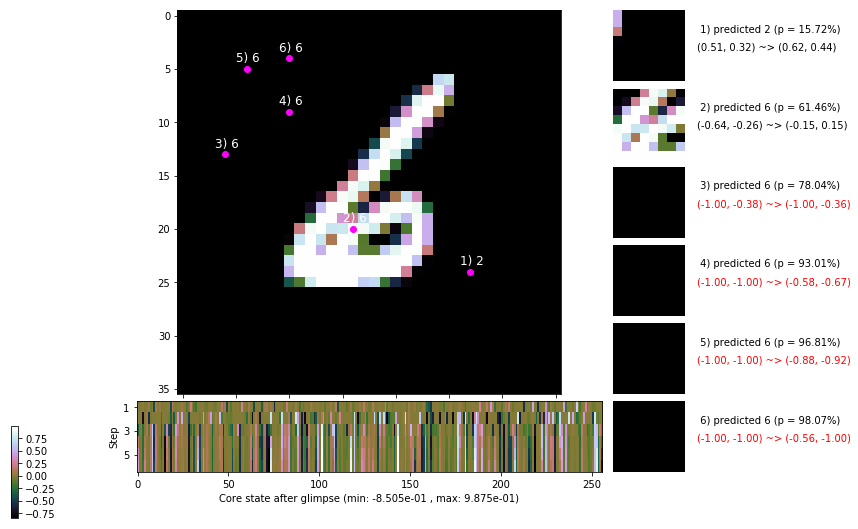

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 167.8 ms/b | lr: 3.99e-04 | grad 2norm: 19.70 | grad inf norm:  6.074
         Weights || abs max:  3.50 ( 1352.80) | mean: -4.73e-04 ( 0.01) | var: 9.01e-02 (   14.53)
          Biases || abs max:  2.56 (  193.81) | mean: -1.28e-01 ( 0.15) | var: 7.32e-02 (  949.31)
                    class loss: 0.848 | steps: 2.879 | reward:  3.556 | acc.: 69.93%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 162.8 ms/b | lr: 3.98e-04 | grad 2norm: 18.85 | grad inf norm:  5.484
         Weights || abs max:  3.50 ( 3301.14) | mean: -4.84e-04 ( 0.01) | var: 9.01e-02 (  663.56)
          Biases || abs max:  2.56 (  261.75) | mean: -1.28e-01 ( 0.17) | var: 7.30e-02 (  886.56)
                    class loss: 0.842 | steps: 2.882 | reward:  3.567 | acc.: 70.55%

	Target class: 5 | Discounted rewards: [2.300, 2.556, 1.7

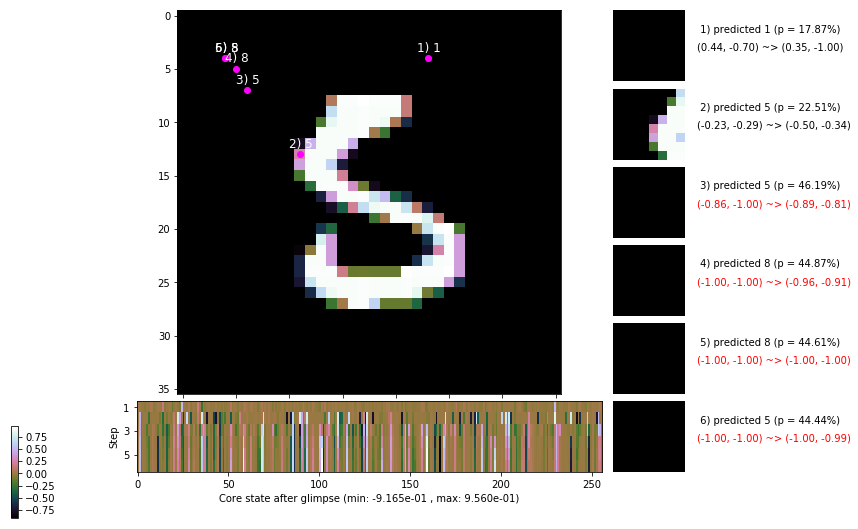

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 168.6 ms/b | lr: 3.98e-04 | grad 2norm: 19.38 | grad inf norm:  5.775
         Weights || abs max:  3.51 ( 1848.41) | mean: -4.89e-04 ( 0.01) | var: 9.02e-02 (  531.72)
          Biases || abs max:  2.56 (   97.43) | mean: -1.28e-01 ( 0.10) | var: 7.29e-02 (   52.51)
                    class loss: 0.843 | steps: 2.916 | reward:  3.557 | acc.: 70.25%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 164.6 ms/b | lr: 3.97e-04 | grad 2norm: 19.20 | grad inf norm:  5.606
         Weights || abs max:  3.50 ( 1498.06) | mean: -5.04e-04 ( 0.01) | var: 9.02e-02 (   41.29)
          Biases || abs max:  2.56 (   71.49) | mean: -1.28e-01 ( 0.08) | var: 7.30e-02 (   48.10)
                    class loss: 0.812 | steps: 2.863 | reward:  3.615 | acc.: 71.48%

	Target class: 0 | Discounted rewards: [4.686, 4.095, 3.4

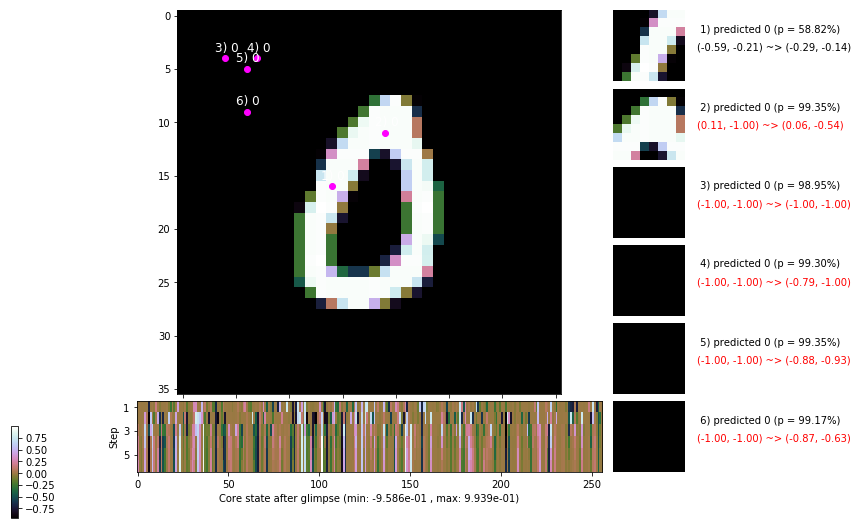

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 166.2 ms/b | lr: 3.96e-04 | grad 2norm: 19.24 | grad inf norm:  5.692
         Weights || abs max:  3.51 ( 1990.59) | mean: -4.79e-04 ( 0.01) | var: 9.03e-02 (  185.42)
          Biases || abs max:  2.55 (  102.85) | mean: -1.27e-01 ( 0.11) | var: 7.31e-02 (  127.61)
                    class loss: 0.821 | steps: 2.882 | reward:  3.556 | acc.: 70.20%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 165.0 ms/b | lr: 3.96e-04 | grad 2norm: 19.12 | grad inf norm:  5.451
         Weights || abs max:  3.50 ( 1454.62) | mean: -4.71e-04 ( 0.01) | var: 9.03e-02 (   42.78)
          Biases || abs max:  2.56 (  421.20) | mean: -1.27e-01 ( 0.27) | var: 7.31e-02 ( 5619.26)
                    class loss: 0.801 | steps: 2.813 | reward:  3.664 | acc.: 72.30%

	Target class: 0 | Discounted rewards: [3.686, 4.095, 3.4

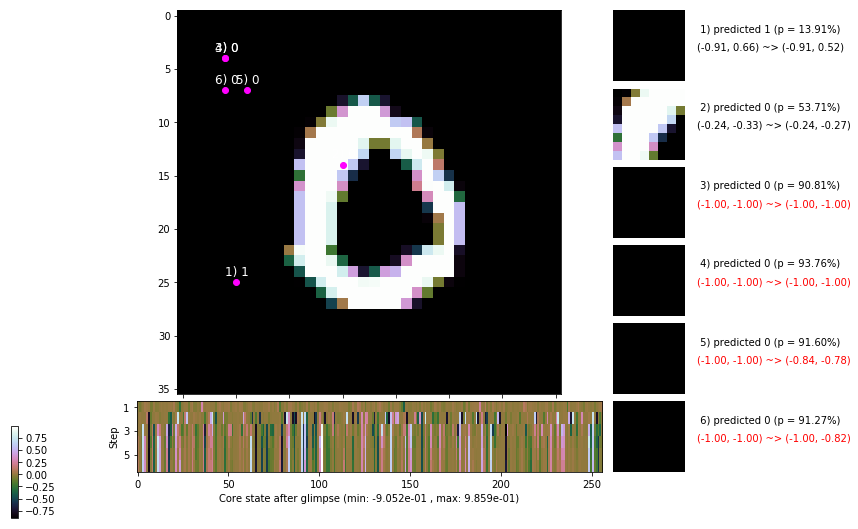

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 167.3 ms/b | lr: 3.95e-04 | grad 2norm: 19.03 | grad inf norm:  5.457
         Weights || abs max:  3.50 ( 3161.43) | mean: -4.81e-04 ( 0.01) | var: 9.04e-02 (  572.83)
          Biases || abs max:  2.56 (  133.29) | mean: -1.27e-01 ( 0.11) | var: 7.32e-02 (  195.41)
                    class loss: 0.839 | steps: 2.871 | reward:  3.565 | acc.: 70.08%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 161.5 ms/b | lr: 3.95e-04 | grad 2norm: 18.97 | grad inf norm:  5.501
         Weights || abs max:  3.51 ( 3936.24) | mean: -4.72e-04 ( 0.01) | var: 9.04e-02 ( 1059.23)
          Biases || abs max:  2.56 (   86.54) | mean: -1.27e-01 ( 0.09) | var: 7.32e-02 (  235.03)
                    class loss: 0.828 | steps: 2.843 | reward:  3.595 | acc.: 70.53%

	Target class: 4 | Discounted rewards: [3.686, 4.095, 3.4

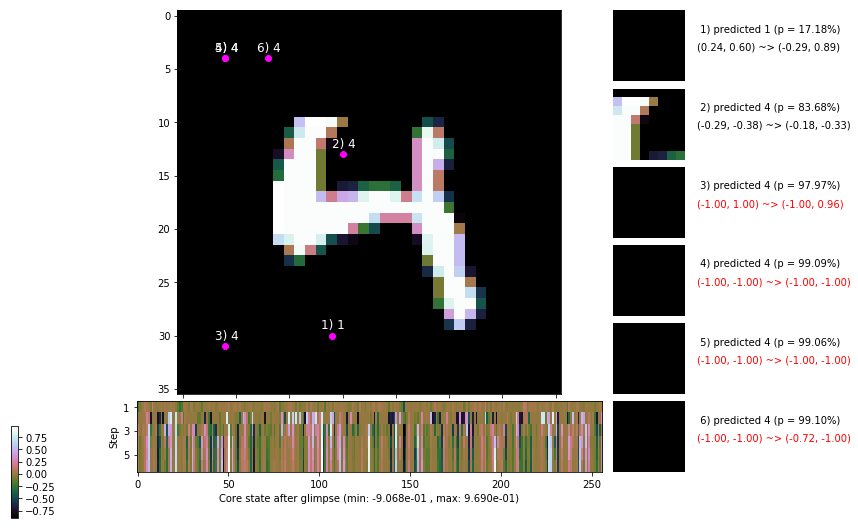

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 3 | Discounted rewards: [2.786, 3.095, 3.439, 2.710, 1.900, 1.000]


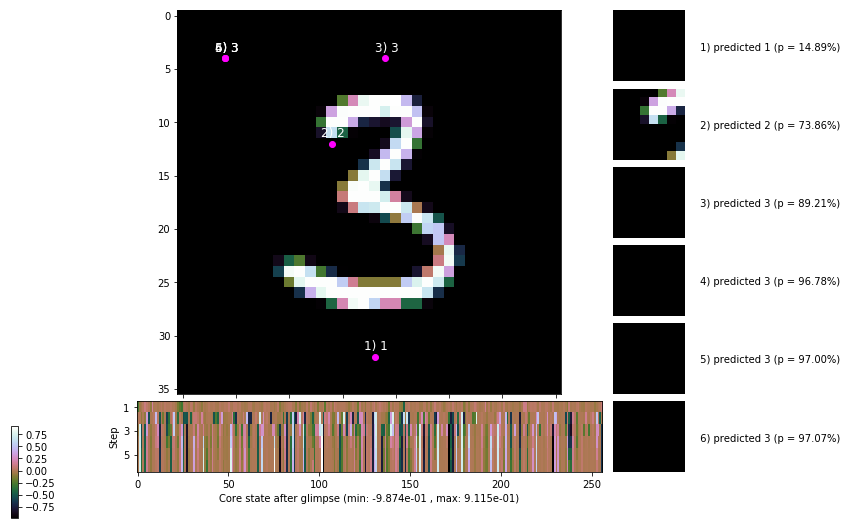


	Target class: 9 | Discounted rewards: [2.195, 2.439, 2.710, 1.900, 1.000, 0.000]


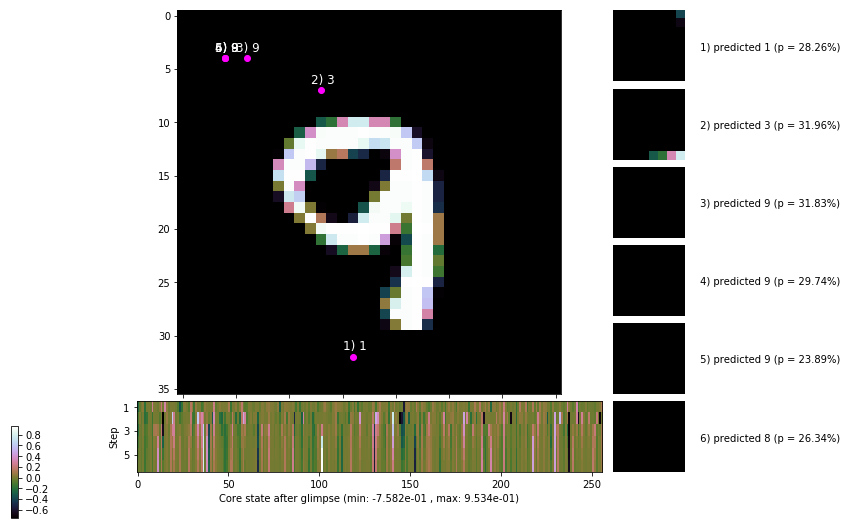

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


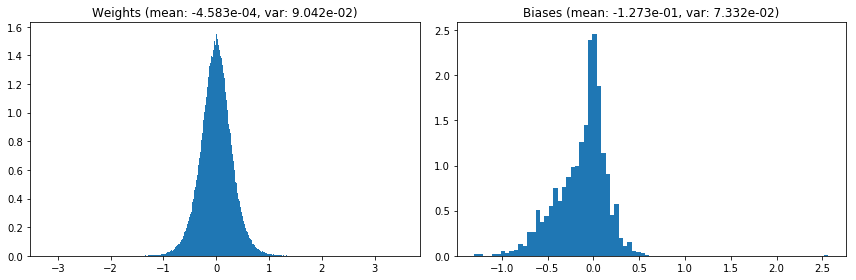

                                      Location network weights and biases


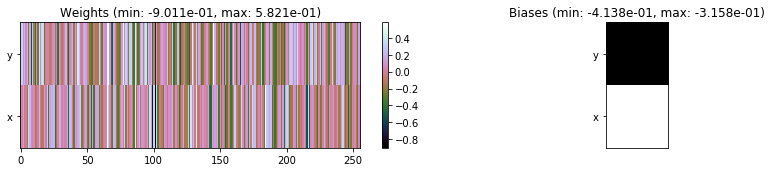

---------------------------------------------------------------------------------------------------------------
Elapsed time:  496.84 sec | TRAIN >> class loss: 0.8330 | steps:  2.869 :( | reward:  3.5825 :( | acc.: 70.623% :(
                          | VAL   >> class loss: 0.7947 | steps:  2.785 :( | reward:  3.6880 :( | acc.: 71.880% :(


Epoch  63/400) lr = 0.0003944
 b    300/  3000 >> 154.1 ms/b | lr: 3.94e-04 | grad 2norm: 19.25 | grad inf norm:  5.782
         Weights || abs max:  3.52 ( 1586.20) | mean: -4.73e-04 ( 0.01) | var: 9.04e-02 (   29.05)
          Biases || abs max:  2.56 (   97.13) | mean: -1.28e-01 ( 0.10) | var: 7.34e-02 (   42.25)
                    class loss: 0.846 | steps: 2.877 | reward:  3.578 | acc.: 70.58%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 157.2 ms/b | lr: 3.94e-04 | grad 2norm: 18.84 | grad inf norm:  5.722
         Weights || abs max:  3.51 ( 2164.62) | mean: -4.77e-04 (

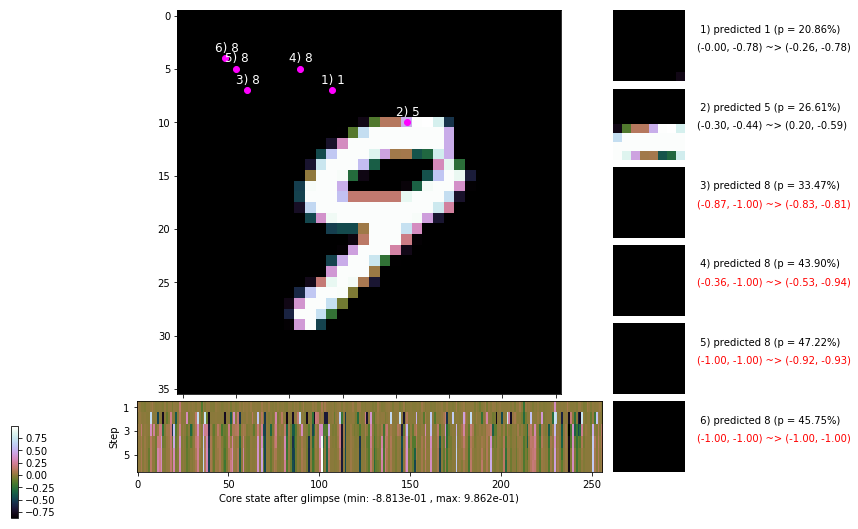

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 154.0 ms/b | lr: 3.93e-04 | grad 2norm: 19.35 | grad inf norm:  5.904
         Weights || abs max:  3.51 ( 1891.24) | mean: -4.80e-04 ( 0.01) | var: 9.05e-02 (   43.13)
          Biases || abs max:  2.56 (  120.21) | mean: -1.28e-01 ( 0.11) | var: 7.34e-02 (   50.32)
                    class loss: 0.828 | steps: 2.857 | reward:  3.593 | acc.: 70.50%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 154.2 ms/b | lr: 3.92e-04 | grad 2norm: 19.23 | grad inf norm:  5.858
         Weights || abs max:  3.51 ( 2703.14) | mean: -4.64e-04 ( 0.01) | var: 9.05e-02 (  431.04)
          Biases || abs max:  2.56 (  165.71) | mean: -1.28e-01 ( 0.14) | var: 7.35e-02 (  602.05)
                    class loss: 0.836 | steps: 2.849 | reward:  3.592 | acc.: 70.37%

	Target class: 4 | Discounted rewards: [3.686, 4.095, 3.4

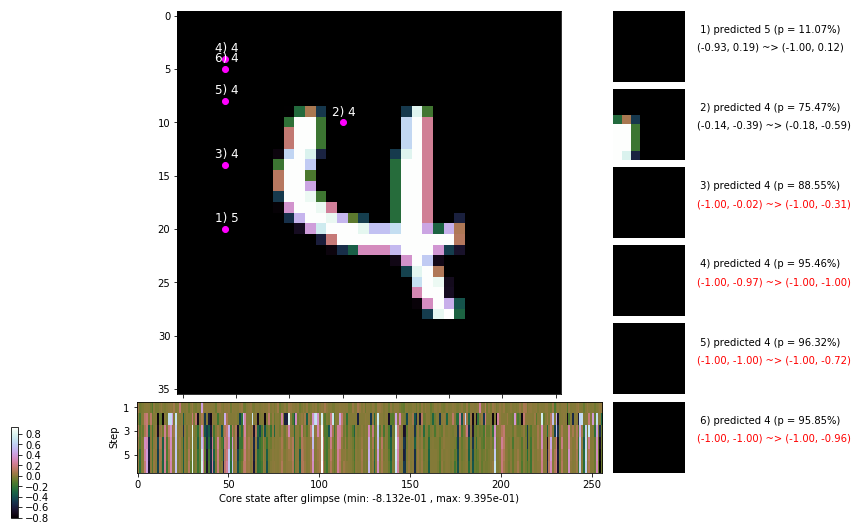

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 164.0 ms/b | lr: 3.92e-04 | grad 2norm: 19.23 | grad inf norm:  5.792
         Weights || abs max:  3.50 ( 2555.13) | mean: -4.68e-04 ( 0.01) | var: 9.06e-02 (  184.68)
          Biases || abs max:  2.56 (   65.25) | mean: -1.28e-01 ( 0.09) | var: 7.35e-02 (   18.13)
                    class loss: 0.845 | steps: 2.861 | reward:  3.579 | acc.: 70.37%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 161.0 ms/b | lr: 3.91e-04 | grad 2norm: 18.63 | grad inf norm:  5.524
         Weights || abs max:  3.51 ( 2088.37) | mean: -4.53e-04 ( 0.01) | var: 9.06e-02 (   72.28)
          Biases || abs max:  2.56 (   77.84) | mean: -1.28e-01 ( 0.09) | var: 7.35e-02 (   35.36)
                    class loss: 0.818 | steps: 2.850 | reward:  3.641 | acc.: 72.17%

	Target class: 5 | Discounted rewards: [0.000, 0.000, 0.0

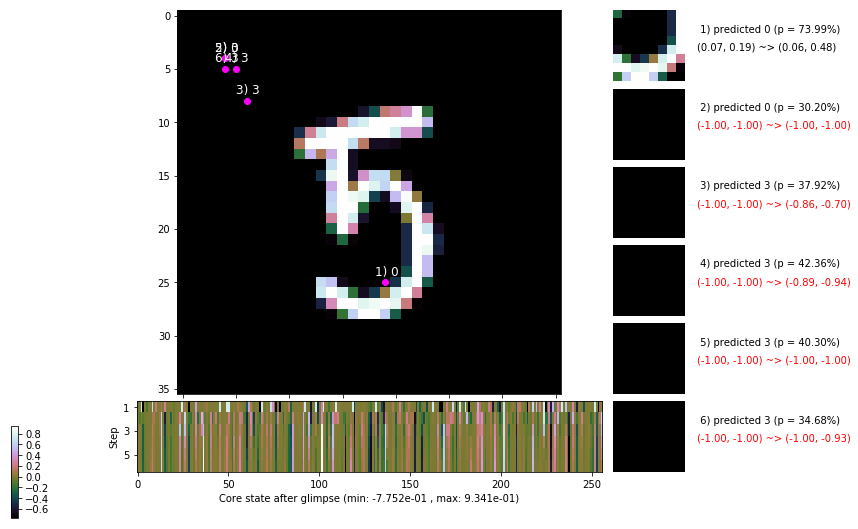

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 162.0 ms/b | lr: 3.90e-04 | grad 2norm: 19.13 | grad inf norm:  5.629
         Weights || abs max:  3.51 (65331.42) | mean: -4.45e-04 ( 0.13) | var: 9.06e-02 (2148378.25)
          Biases || abs max:  2.56 (  673.01) | mean: -1.28e-01 ( 0.47) | var: 7.36e-02 (38258.57)
                    class loss: 0.845 | steps: 2.870 | reward:  3.586 | acc.: 70.65%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 149.7 ms/b | lr: 3.90e-04 | grad 2norm: 19.12 | grad inf norm:  5.673
         Weights || abs max:  3.51 ( 2226.40) | mean: -4.28e-04 ( 0.01) | var: 9.07e-02 (  184.77)
          Biases || abs max:  2.57 (  273.66) | mean: -1.28e-01 ( 0.17) | var: 7.37e-02 ( 4679.54)
                    class loss: 0.818 | steps: 2.837 | reward:  3.626 | acc.: 71.00%

	Target class: 3 | Discounted rewards: [2.786, 3.095, 3

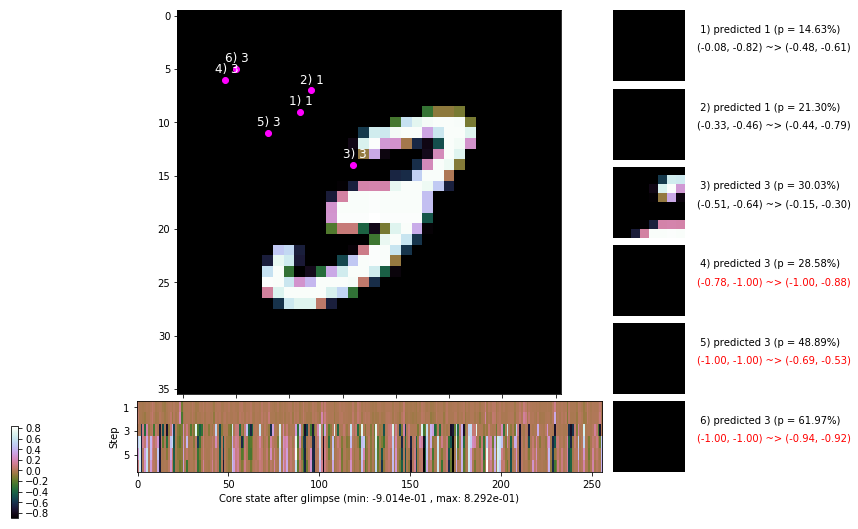

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 151.9 ms/b | lr: 3.89e-04 | grad 2norm: 18.99 | grad inf norm:  5.755
         Weights || abs max:  3.52 ( 2394.57) | mean: -4.35e-04 ( 0.01) | var: 9.07e-02 (  183.55)
          Biases || abs max:  2.57 (   80.81) | mean: -1.28e-01 ( 0.09) | var: 7.38e-02 (   20.46)
                    class loss: 0.812 | steps: 2.836 | reward:  3.629 | acc.: 71.33%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 149.1 ms/b | lr: 3.89e-04 | grad 2norm: 19.38 | grad inf norm:  5.981
         Weights || abs max:  3.52 (16083.06) | mean: -4.33e-04 ( 0.04) | var: 9.07e-02 (87667.50)
          Biases || abs max:  2.57 (  102.34) | mean: -1.28e-01 ( 0.10) | var: 7.38e-02 (   61.65)
                    class loss: 0.818 | steps: 2.840 | reward:  3.608 | acc.: 70.82%

	Target class: 4 | Discounted rewards: [3.686, 4.095, 3.4

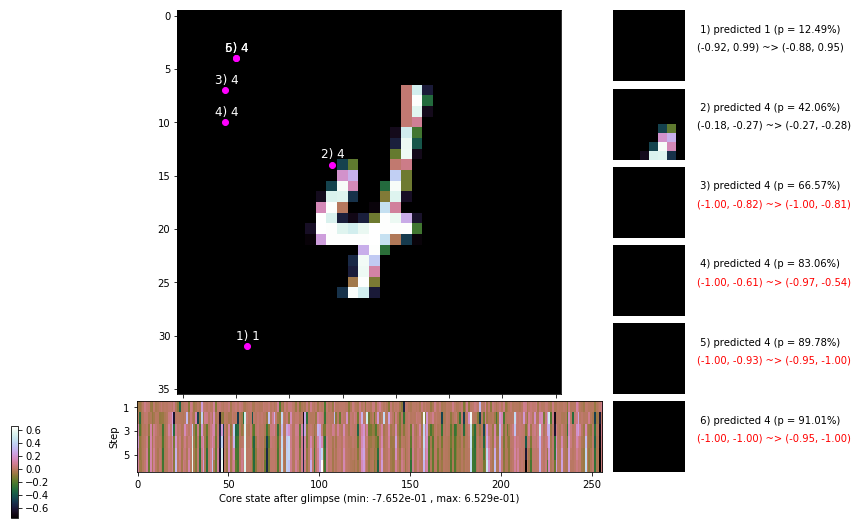

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 7 | Discounted rewards: [2.786, 3.095, 3.439, 2.710, 1.900, 1.000]


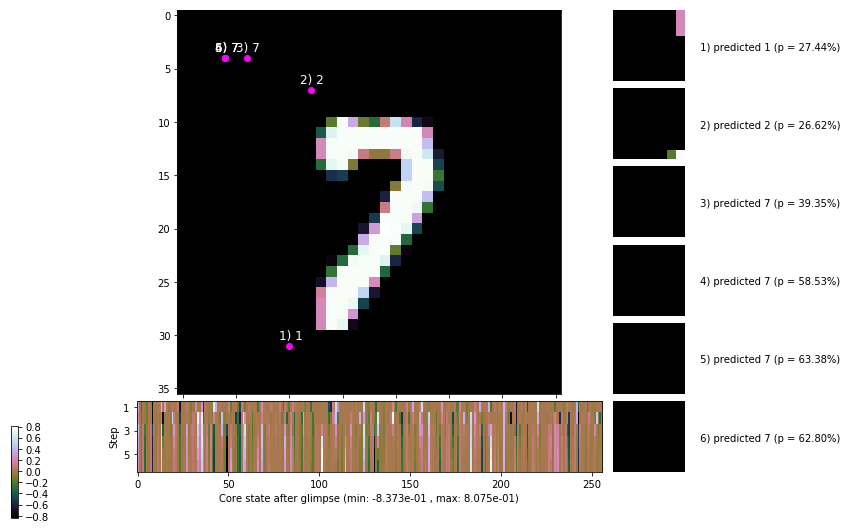


	Target class: 4 | Discounted rewards: [3.686, 4.095, 3.439, 2.710, 1.900, 1.000]


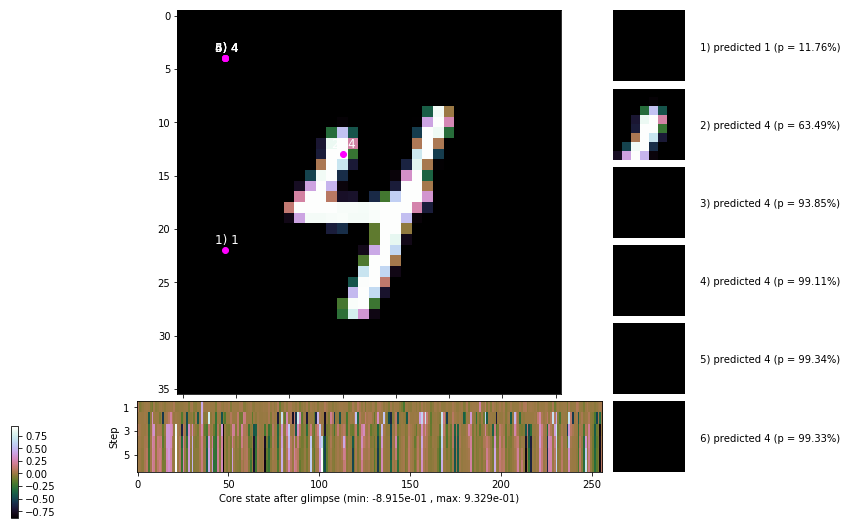

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


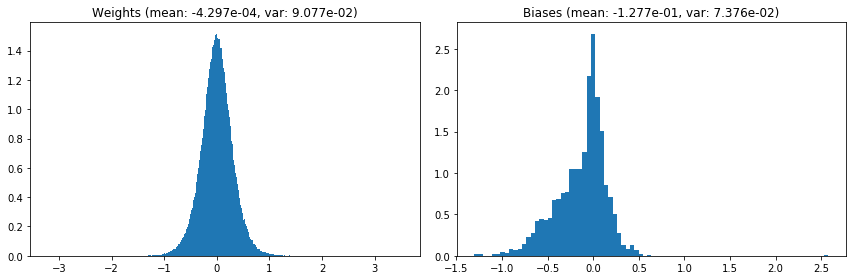

                                      Location network weights and biases


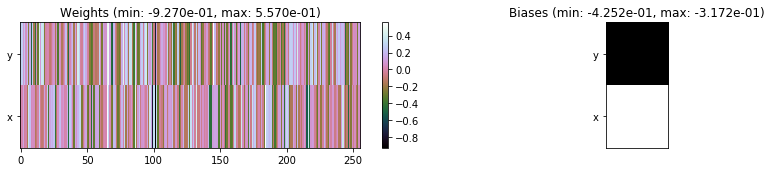

---------------------------------------------------------------------------------------------------------------
Elapsed time:  467.72 sec | TRAIN >> class loss: 0.8297 | steps:  2.856 :( | reward:  3.6013 :( | acc.: 70.840% :(
                          | VAL   >> class loss: 0.7727 | steps:  2.757 :( | reward:  3.7368    | acc.: 72.120% :(


Epoch  64/400) lr = 0.0003885
 b    300/  3000 >> 148.8 ms/b | lr: 3.88e-04 | grad 2norm: 18.87 | grad inf norm:  5.492
         Weights || abs max:  3.52 (13611.82) | mean: -4.35e-04 ( 0.03) | var: 9.08e-02 (67126.94)
          Biases || abs max:  2.58 (  301.47) | mean: -1.28e-01 ( 0.19) | var: 7.37e-02 ( 2023.84)
                    class loss: 0.800 | steps: 2.842 | reward:  3.611 | acc.: 71.25%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 152.3 ms/b | lr: 3.88e-04 | grad 2norm: 19.00 | grad inf norm:  5.718
         Weights || abs max:  3.52 ( 1566.42) | mean: -4.29e-04 (

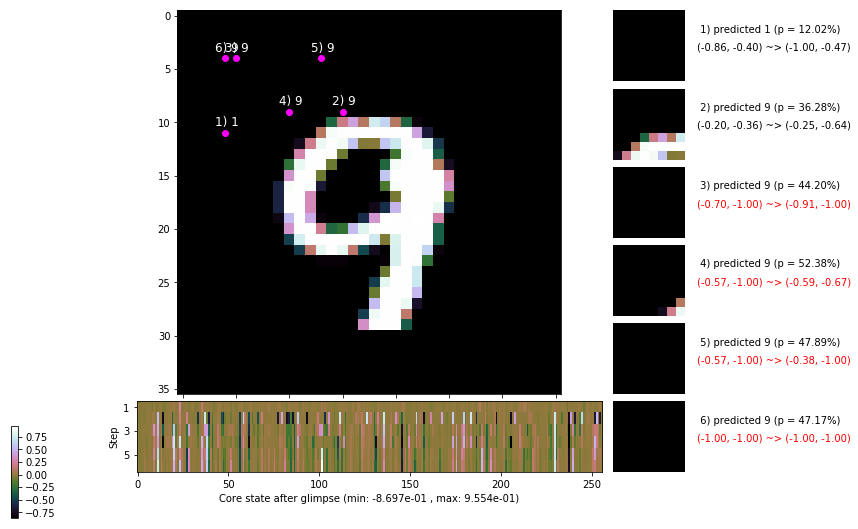

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 157.6 ms/b | lr: 3.87e-04 | grad 2norm: 19.01 | grad inf norm:  5.518
         Weights || abs max:  3.52 ( 2337.05) | mean: -4.38e-04 ( 0.01) | var: 9.09e-02 (  137.39)
          Biases || abs max:  2.57 (  165.05) | mean: -1.28e-01 ( 0.13) | var: 7.39e-02 (  430.99)
                    class loss: 0.833 | steps: 2.853 | reward:  3.584 | acc.: 70.75%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 163.2 ms/b | lr: 3.87e-04 | grad 2norm: 19.13 | grad inf norm:  5.747
         Weights || abs max:  3.51 ( 2803.90) | mean: -4.55e-04 ( 0.01) | var: 9.09e-02 (  470.21)
          Biases || abs max:  2.58 (   62.15) | mean: -1.28e-01 ( 0.08) | var: 7.40e-02 (   16.72)
                    class loss: 0.794 | steps: 2.813 | reward:  3.644 | acc.: 71.82%

	Target class: 9 | Discounted rewards: [2.786, 3.095, 3.4

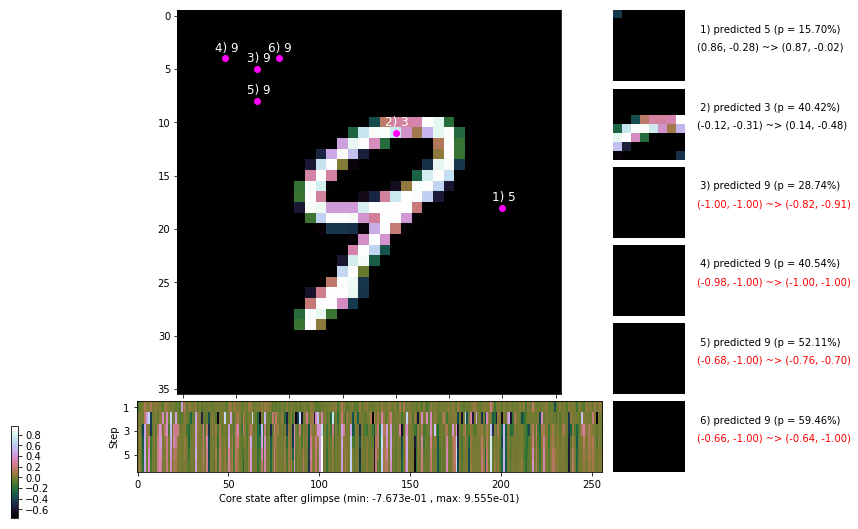

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 153.4 ms/b | lr: 3.86e-04 | grad 2norm: 18.87 | grad inf norm:  5.360
         Weights || abs max:  3.51 ( 2358.03) | mean: -4.47e-04 ( 0.01) | var: 9.09e-02 (  407.16)
          Biases || abs max:  2.59 (  248.64) | mean: -1.28e-01 ( 0.17) | var: 7.40e-02 ( 1309.74)
                    class loss: 0.759 | steps: 2.764 | reward:  3.709 | acc.: 73.28%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 151.7 ms/b | lr: 3.85e-04 | grad 2norm: 19.18 | grad inf norm:  5.816
         Weights || abs max:  3.52 ( 2328.16) | mean: -4.52e-04 ( 0.01) | var: 9.10e-02 (  176.60)
          Biases || abs max:  2.59 (  266.64) | mean: -1.28e-01 ( 0.23) | var: 7.40e-02 ( 4989.49)
                    class loss: 0.822 | steps: 2.839 | reward:  3.626 | acc.: 71.52%

	Target class: 1 | Discounted rewards: [4.686, 4.095, 3.4

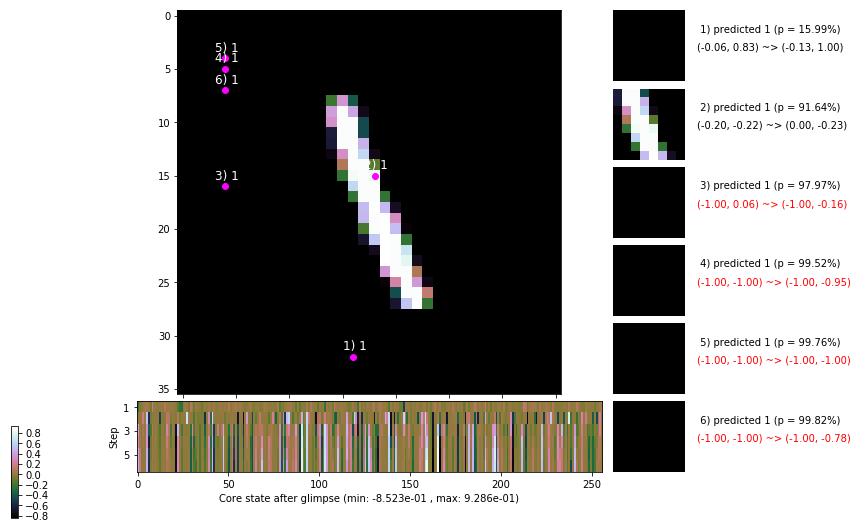

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 156.0 ms/b | lr: 3.85e-04 | grad 2norm: 19.59 | grad inf norm:  6.125
         Weights || abs max:  3.52 ( 3892.21) | mean: -4.50e-04 ( 0.01) | var: 9.10e-02 ( 1785.96)
          Biases || abs max:  2.59 (  112.45) | mean: -1.28e-01 ( 0.10) | var: 7.40e-02 (   95.88)
                    class loss: 0.814 | steps: 2.821 | reward:  3.632 | acc.: 71.45%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 151.1 ms/b | lr: 3.84e-04 | grad 2norm: 19.42 | grad inf norm:  5.919
         Weights || abs max:  3.52 ( 1601.83) | mean: -4.55e-04 ( 0.01) | var: 9.10e-02 (   38.44)
          Biases || abs max:  2.59 (  190.71) | mean: -1.29e-01 ( 0.13) | var: 7.39e-02 (  473.95)
                    class loss: 0.824 | steps: 2.883 | reward:  3.568 | acc.: 70.65%

	Target class: 1 | Discounted rewards: [4.686, 4.095, 3.4

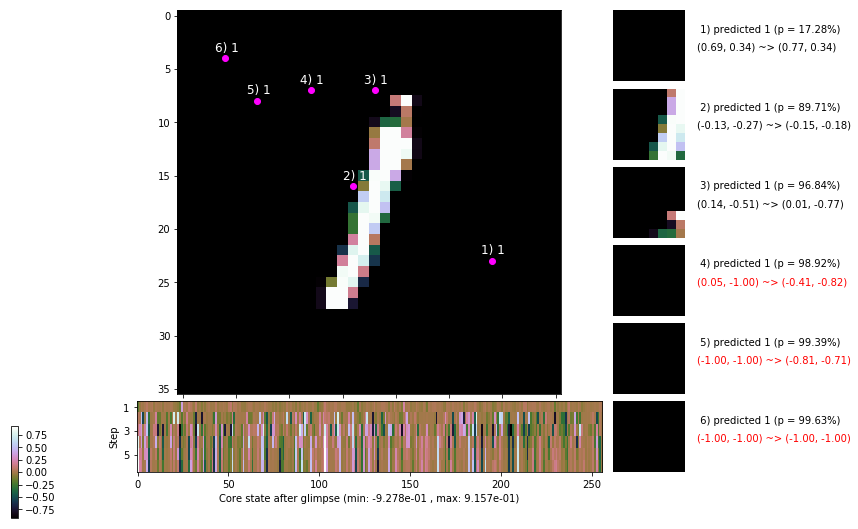

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 152.4 ms/b | lr: 3.83e-04 | grad 2norm: 19.16 | grad inf norm:  5.824
         Weights || abs max:  3.52 ( 4586.70) | mean: -4.69e-04 ( 0.01) | var: 9.11e-02 (  775.45)
          Biases || abs max:  2.59 (  233.82) | mean: -1.29e-01 ( 0.16) | var: 7.39e-02 ( 1089.42)
                    class loss: 0.784 | steps: 2.833 | reward:  3.632 | acc.: 71.95%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 152.5 ms/b | lr: 3.83e-04 | grad 2norm: 18.94 | grad inf norm:  5.523
         Weights || abs max:  3.52 ( 1948.43) | mean: -4.45e-04 ( 0.01) | var: 9.11e-02 (  164.13)
          Biases || abs max:  2.59 (   89.16) | mean: -1.29e-01 ( 0.09) | var: 7.38e-02 (   20.48)
                    class loss: 0.803 | steps: 2.821 | reward:  3.643 | acc.: 71.40%

	Target class: 4 | Discounted rewards: [3.686, 4.095, 3.4

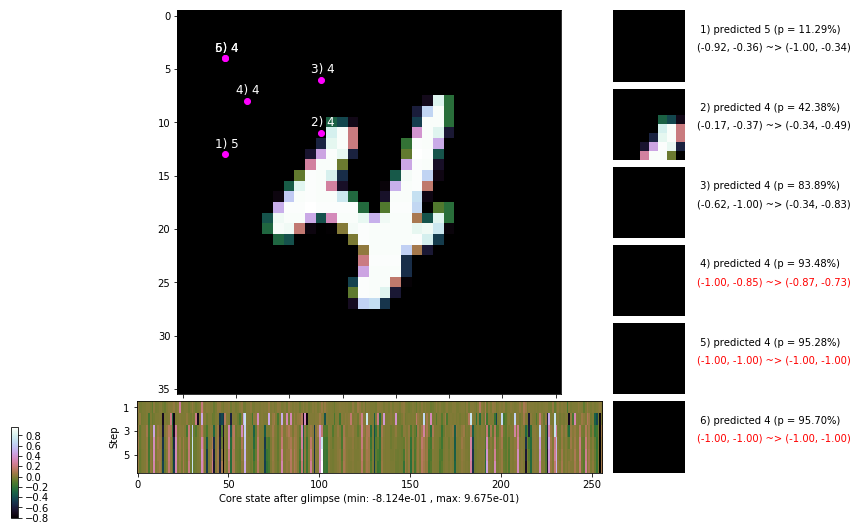

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 3 | Discounted rewards: [0.000, 0.000, 0.000, 0.000, 0.000, 0.000]


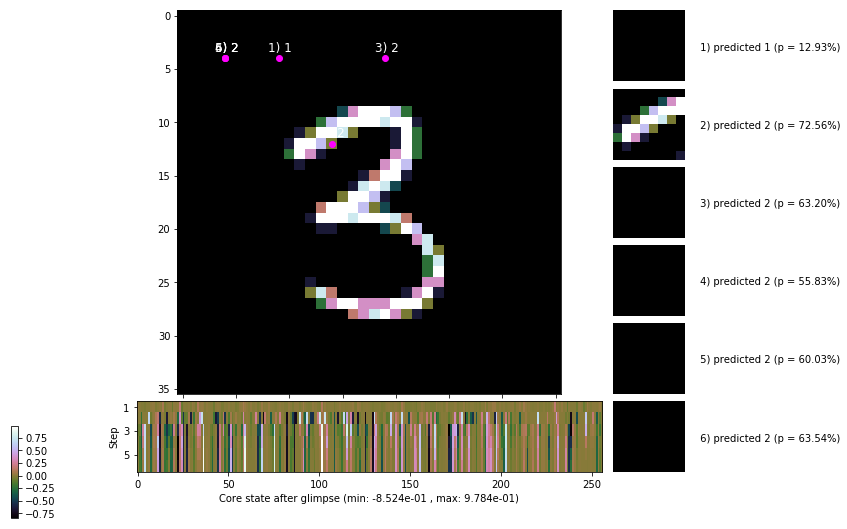


	Target class: 1 | Discounted rewards: [3.686, 4.095, 3.439, 2.710, 1.900, 1.000]


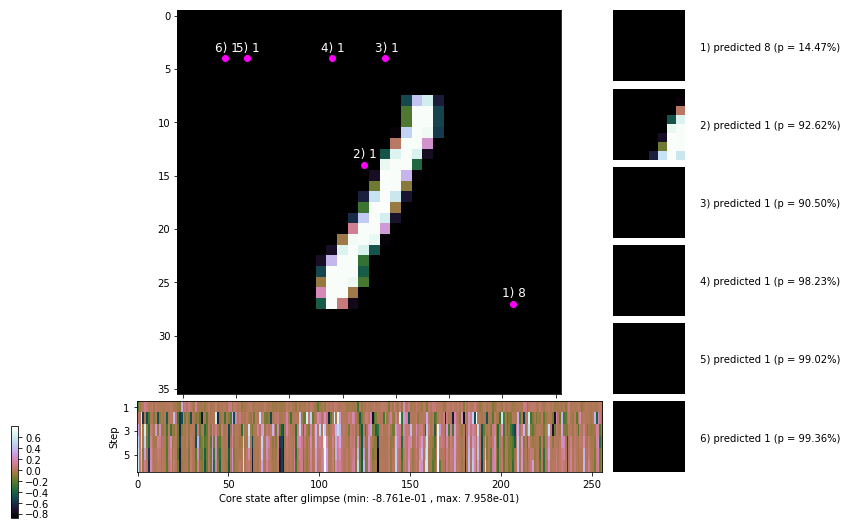

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


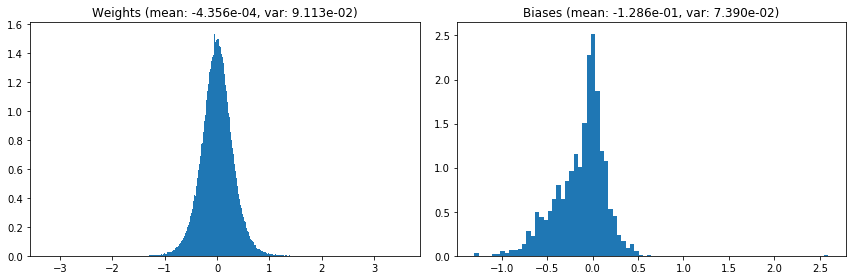

                                      Location network weights and biases


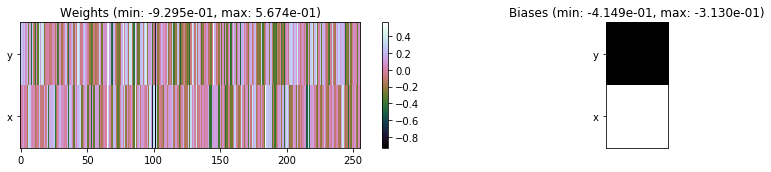

---------------------------------------------------------------------------------------------------------------
Elapsed time:  462.56 sec | TRAIN >> class loss: 0.8061 | steps:  2.833    | reward:  3.6242    | acc.: 71.472% 
                          | VAL   >> class loss: 0.7782 | steps:  2.762 :( | reward:  3.7296 :( | acc.: 72.660% 


Epoch  65/400) lr = 0.0003827
 b    300/  3000 >> 151.3 ms/b | lr: 3.82e-04 | grad 2norm: 19.53 | grad inf norm:  6.025
         Weights || abs max:  3.52 ( 1490.50) | mean: -4.45e-04 ( 0.01) | var: 9.11e-02 (   33.35)
          Biases || abs max:  2.59 (  253.72) | mean: -1.28e-01 ( 0.15) | var: 7.39e-02 ( 1500.80)
                    class loss: 0.793 | steps: 2.827 | reward:  3.635 | acc.: 71.73%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 152.3 ms/b | lr: 3.82e-04 | grad 2norm: 18.96 | grad inf norm:  5.558
         Weights || abs max:  3.52 ( 2359.53) | mean: -4.45e-04 ( 0.0

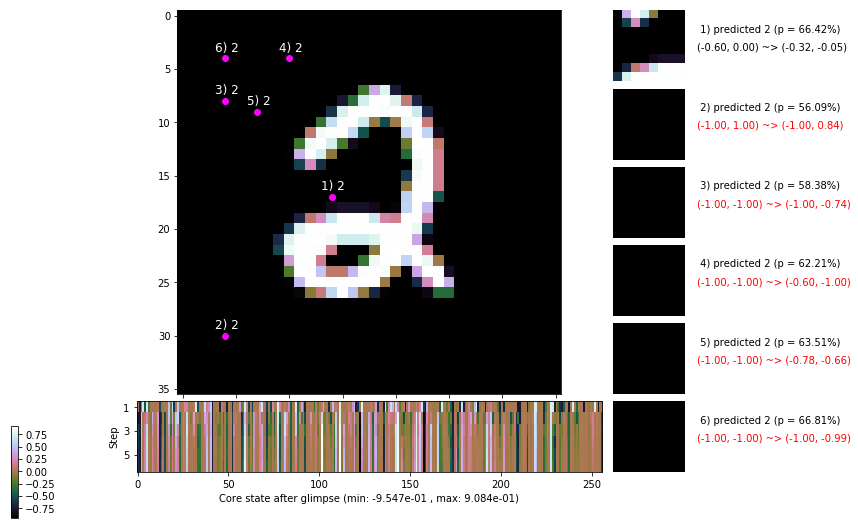

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 154.9 ms/b | lr: 3.81e-04 | grad 2norm: 19.28 | grad inf norm:  5.760
         Weights || abs max:  3.52 ( 1711.59) | mean: -4.53e-04 ( 0.01) | var: 9.12e-02 (   47.24)
          Biases || abs max:  2.59 (  172.00) | mean: -1.28e-01 ( 0.12) | var: 7.39e-02 (  515.73)
                    class loss: 0.830 | steps: 2.866 | reward:  3.600 | acc.: 71.03%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 152.5 ms/b | lr: 3.81e-04 | grad 2norm: 19.25 | grad inf norm:  5.586
         Weights || abs max:  3.53 ( 1265.03) | mean: -4.60e-04 ( 0.01) | var: 9.12e-02 (   14.26)
          Biases || abs max:  2.58 (   71.30) | mean: -1.29e-01 ( 0.09) | var: 7.39e-02 (   15.31)
                    class loss: 0.836 | steps: 2.877 | reward:  3.559 | acc.: 69.77%

	Target class: 2 | Discounted rewards: [2.786, 3.095, 3.4

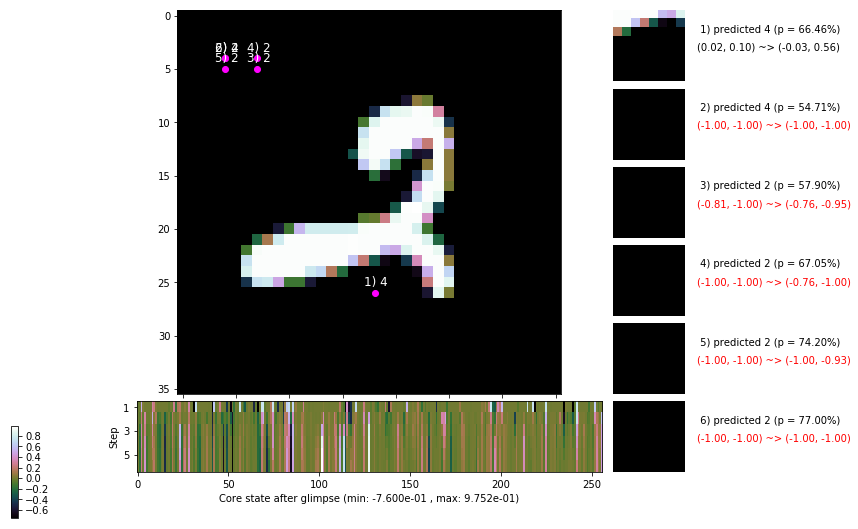

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 155.7 ms/b | lr: 3.80e-04 | grad 2norm: 18.59 | grad inf norm:  5.706
         Weights || abs max:  3.53 ( 2922.56) | mean: -4.71e-04 ( 0.01) | var: 9.13e-02 (  297.31)
          Biases || abs max:  2.58 (  565.07) | mean: -1.29e-01 ( 0.28) | var: 7.39e-02 (25463.80)
                    class loss: 0.812 | steps: 2.839 | reward:  3.607 | acc.: 70.68%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 151.0 ms/b | lr: 3.80e-04 | grad 2norm: 19.21 | grad inf norm:  5.702
         Weights || abs max:  3.53 ( 3566.29) | mean: -4.64e-04 ( 0.01) | var: 9.13e-02 ( 2402.33)
          Biases || abs max:  2.59 (  108.88) | mean: -1.28e-01 ( 0.10) | var: 7.38e-02 (   64.36)
                    class loss: 0.793 | steps: 2.822 | reward:  3.629 | acc.: 71.83%

	Target class: 3 | Discounted rewards: [0.900, 1.000, 0.0

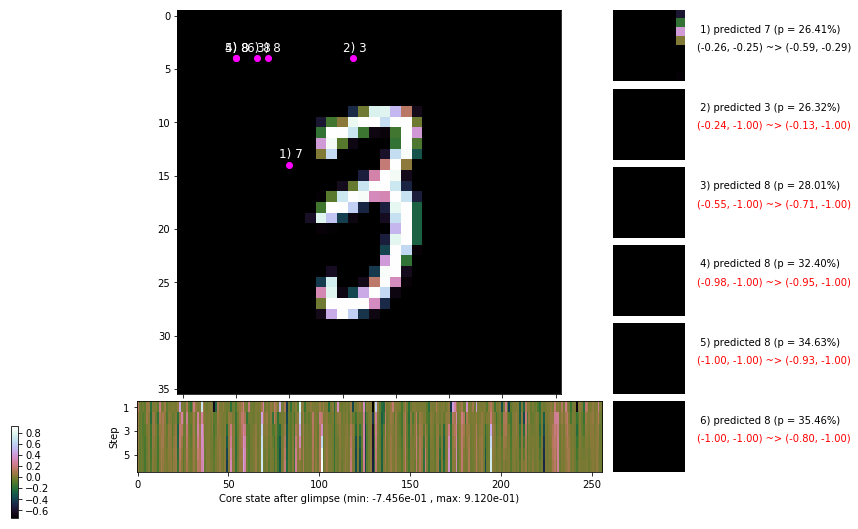

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 151.8 ms/b | lr: 3.79e-04 | grad 2norm: 19.50 | grad inf norm:  5.986
         Weights || abs max:  3.53 ( 1415.05) | mean: -4.62e-04 ( 0.01) | var: 9.14e-02 (   23.79)
          Biases || abs max:  2.59 (   99.05) | mean: -1.29e-01 ( 0.09) | var: 7.38e-02 (   60.85)
                    class loss: 0.800 | steps: 2.846 | reward:  3.617 | acc.: 71.65%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 150.8 ms/b | lr: 3.79e-04 | grad 2norm: 19.33 | grad inf norm:  5.849
         Weights || abs max:  3.54 ( 1378.61) | mean: -4.57e-04 ( 0.01) | var: 9.14e-02 (   46.99)
          Biases || abs max:  2.59 (  114.01) | mean: -1.29e-01 ( 0.11) | var: 7.38e-02 (   45.80)
                    class loss: 0.838 | steps: 2.918 | reward:  3.552 | acc.: 70.32%

	Target class: 9 | Discounted rewards: [4.686, 4.095, 3.4

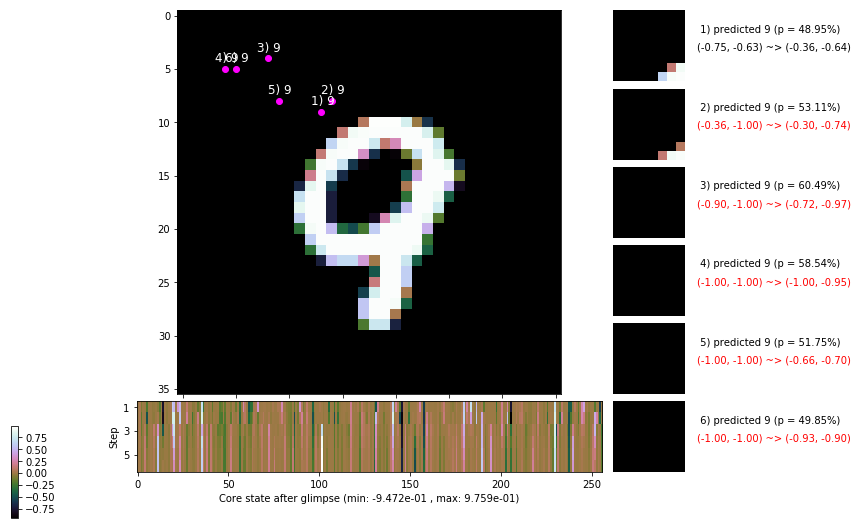

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 151.9 ms/b | lr: 3.78e-04 | grad 2norm: 19.14 | grad inf norm:  5.820
         Weights || abs max:  3.54 ( 1917.70) | mean: -4.49e-04 ( 0.01) | var: 9.14e-02 (  212.34)
          Biases || abs max:  2.59 (  180.22) | mean: -1.29e-01 ( 0.13) | var: 7.38e-02 (  251.83)
                    class loss: 0.783 | steps: 2.832 | reward:  3.660 | acc.: 72.57%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 152.9 ms/b | lr: 3.77e-04 | grad 2norm: 18.93 | grad inf norm:  5.592
         Weights || abs max:  3.54 ( 1793.27) | mean: -4.31e-04 ( 0.01) | var: 9.14e-02 (   68.96)
          Biases || abs max:  2.58 (  147.25) | mean: -1.30e-01 ( 0.12) | var: 7.39e-02 (   88.45)
                    class loss: 0.821 | steps: 2.860 | reward:  3.589 | acc.: 71.03%

	Target class: 7 | Discounted rewards: [0.000, 0.000, 0.0

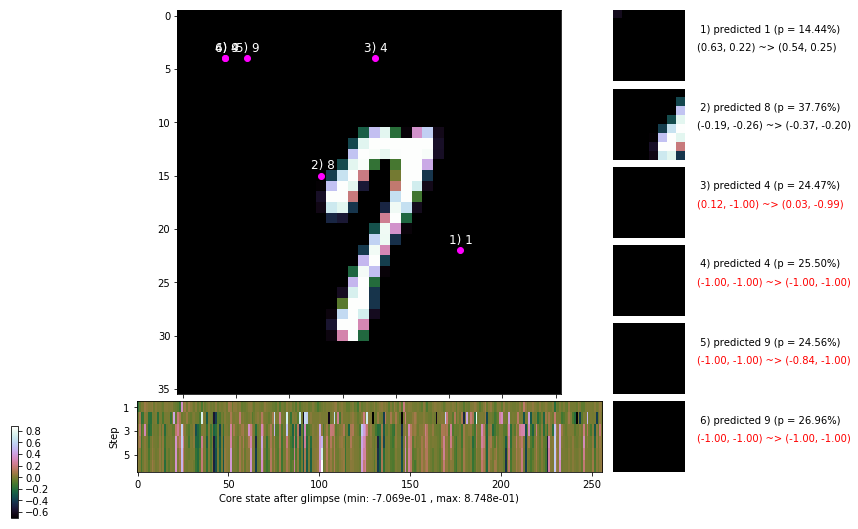

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 6 | Discounted rewards: [0.000, 0.000, 0.000, 0.000, 0.000, 0.000]


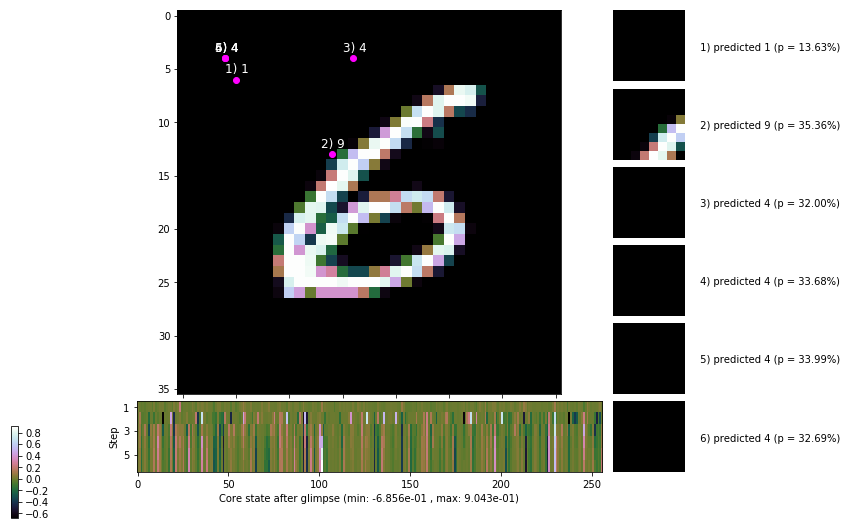


	Target class: 2 | Discounted rewards: [2.786, 3.095, 3.439, 2.710, 1.900, 1.000]


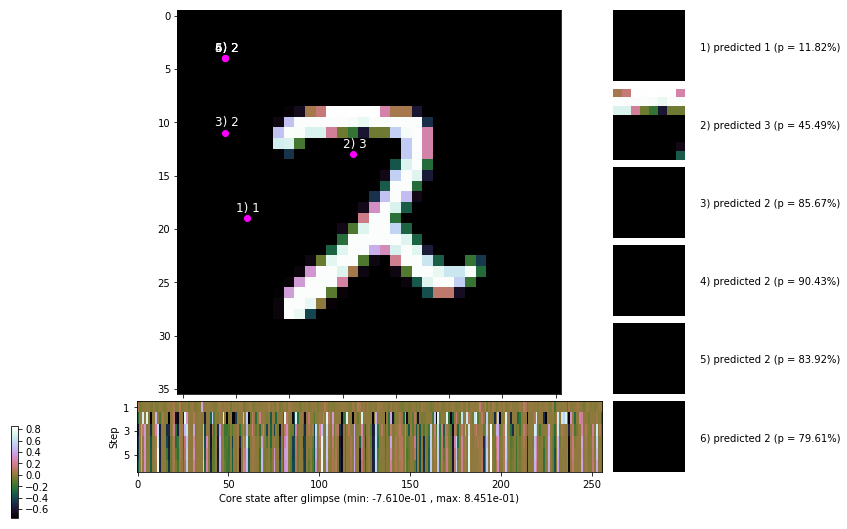

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


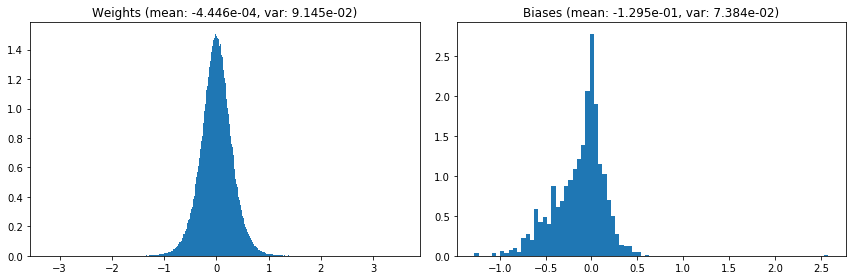

                                      Location network weights and biases


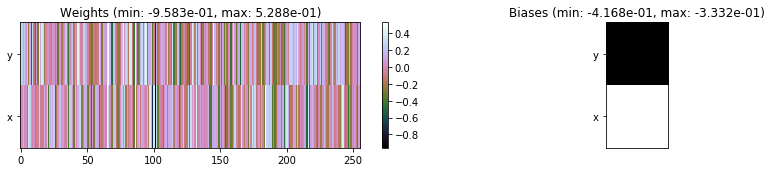

---------------------------------------------------------------------------------------------------------------
Elapsed time:  458.13 sec | TRAIN >> class loss: 0.8109 | steps:  2.854 :( | reward:  3.6054 :( | acc.: 71.185% :(
                          | VAL   >> class loss: 0.7687 | steps:  2.721    | reward:  3.7408    | acc.: 72.740% 


Epoch  66/400) lr = 0.000377
 b    300/  3000 >> 150.3 ms/b | lr: 3.77e-04 | grad 2norm: 19.03 | grad inf norm:  5.677
         Weights || abs max:  3.55 (  829.39) | mean: -4.32e-04 ( 0.01) | var: 9.15e-02 (    5.71)
          Biases || abs max:  2.59 (  177.39) | mean: -1.29e-01 ( 0.12) | var: 7.39e-02 (  817.51)
                    class loss: 0.776 | steps: 2.786 | reward:  3.672 | acc.: 72.52%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 160.1 ms/b | lr: 3.76e-04 | grad 2norm: 18.94 | grad inf norm:  5.509
         Weights || abs max:  3.54 ( 4241.64) | mean: -4.17e-04 ( 0.

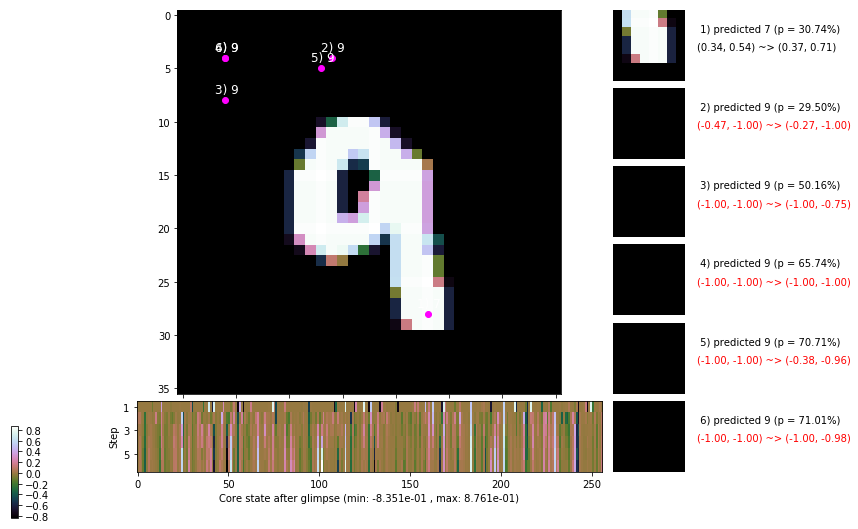

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 161.8 ms/b | lr: 3.76e-04 | grad 2norm: 19.30 | grad inf norm:  5.550
         Weights || abs max:  3.55 ( 1636.37) | mean: -4.15e-04 ( 0.01) | var: 9.15e-02 (   40.75)
          Biases || abs max:  2.59 (   98.04) | mean: -1.29e-01 ( 0.09) | var: 7.40e-02 (   49.48)
                    class loss: 0.799 | steps: 2.825 | reward:  3.643 | acc.: 72.53%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 156.9 ms/b | lr: 3.75e-04 | grad 2norm: 19.15 | grad inf norm:  5.639
         Weights || abs max:  3.56 ( 8243.93) | mean: -4.27e-04 ( 0.02) | var: 9.16e-02 (24706.12)
          Biases || abs max:  2.59 (  108.39) | mean: -1.29e-01 ( 0.11) | var: 7.42e-02 (   97.83)
                    class loss: 0.797 | steps: 2.840 | reward:  3.608 | acc.: 71.40%

	Target class: 0 | Discounted rewards: [0.000, 0.000, 0.0

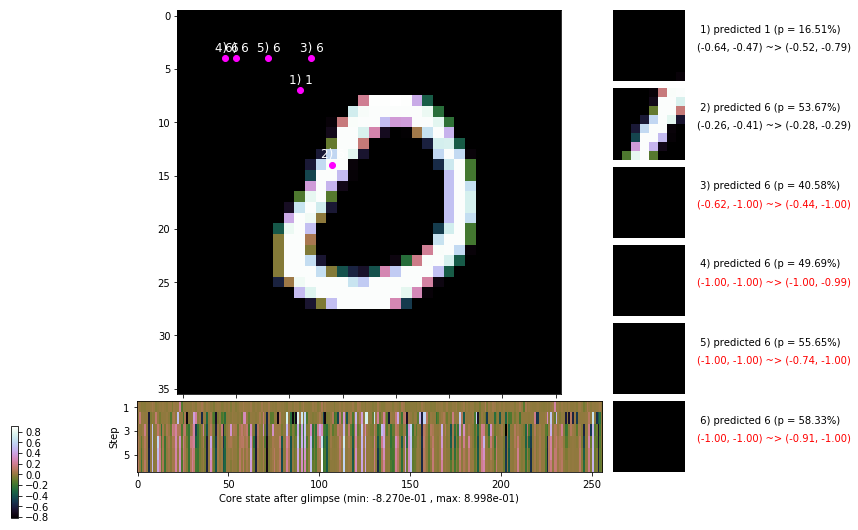

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 159.5 ms/b | lr: 3.74e-04 | grad 2norm: 19.16 | grad inf norm:  5.788
         Weights || abs max:  3.55 (10716.21) | mean: -4.23e-04 ( 0.03) | var: 9.16e-02 (41671.92)
          Biases || abs max:  2.60 (  164.00) | mean: -1.29e-01 ( 0.12) | var: 7.43e-02 (  471.49)
                    class loss: 0.796 | steps: 2.852 | reward:  3.599 | acc.: 71.78%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 157.3 ms/b | lr: 3.74e-04 | grad 2norm: 19.05 | grad inf norm:  5.488
         Weights || abs max:  3.56 ( 1998.45) | mean: -4.10e-04 ( 0.01) | var: 9.16e-02 (  145.74)
          Biases || abs max:  2.60 (  122.52) | mean: -1.29e-01 ( 0.11) | var: 7.42e-02 (   55.13)
                    class loss: 0.792 | steps: 2.803 | reward:  3.649 | acc.: 71.80%

	Target class: 7 | Discounted rewards: [4.686, 4.095, 3.4

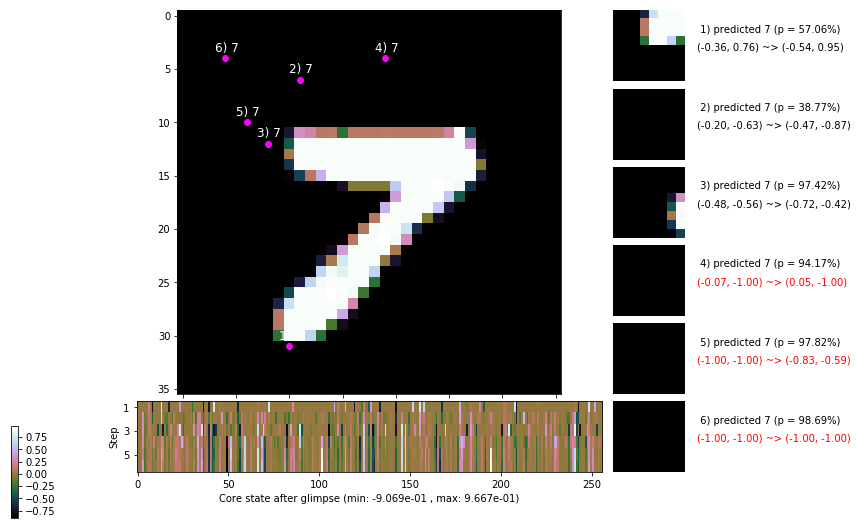

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 161.4 ms/b | lr: 3.73e-04 | grad 2norm: 19.30 | grad inf norm:  5.964
         Weights || abs max:  3.56 ( 1588.73) | mean: -4.18e-04 ( 0.01) | var: 9.17e-02 (   31.09)
          Biases || abs max:  2.60 (  509.13) | mean: -1.29e-01 ( 0.27) | var: 7.42e-02 ( 3889.11)
                    class loss: 0.796 | steps: 2.842 | reward:  3.620 | acc.: 71.42%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 165.2 ms/b | lr: 3.73e-04 | grad 2norm: 18.86 | grad inf norm:  5.792
         Weights || abs max:  3.57 ( 1284.89) | mean: -4.22e-04 ( 0.01) | var: 9.17e-02 (   37.45)
          Biases || abs max:  2.60 (  183.52) | mean: -1.29e-01 ( 0.13) | var: 7.41e-02 (  345.78)
                    class loss: 0.831 | steps: 2.858 | reward:  3.575 | acc.: 70.05%

	Target class: 7 | Discounted rewards: [4.686, 4.095, 3.4

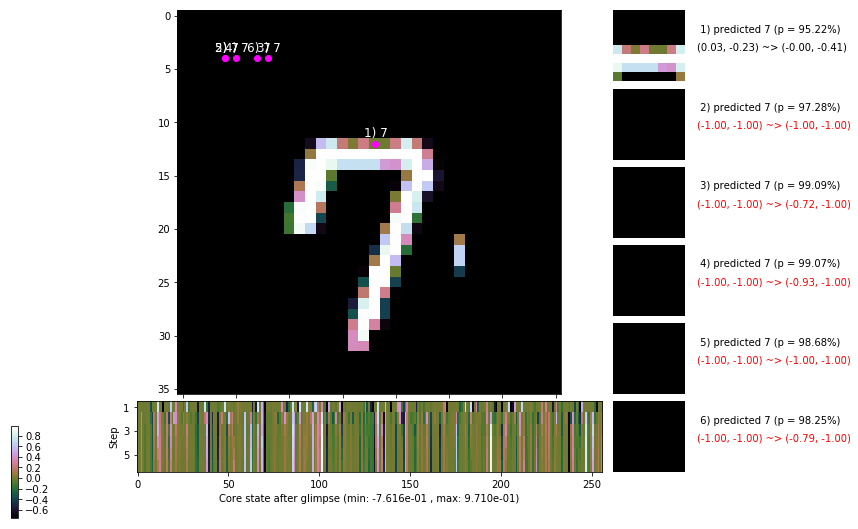

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 166.9 ms/b | lr: 3.72e-04 | grad 2norm: 18.77 | grad inf norm:  5.484
         Weights || abs max:  3.57 ( 1506.46) | mean: -4.27e-04 ( 0.01) | var: 9.17e-02 (   71.20)
          Biases || abs max:  2.60 (  124.52) | mean: -1.29e-01 ( 0.11) | var: 7.42e-02 (   84.57)
                    class loss: 0.807 | steps: 2.821 | reward:  3.599 | acc.: 71.08%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 162.4 ms/b | lr: 3.72e-04 | grad 2norm: 19.01 | grad inf norm:  5.657
         Weights || abs max:  3.57 ( 2249.99) | mean: -4.32e-04 ( 0.01) | var: 9.18e-02 (  149.08)
          Biases || abs max:  2.60 (  147.45) | mean: -1.29e-01 ( 0.15) | var: 7.43e-02 (  392.60)
                    class loss: 0.798 | steps: 2.831 | reward:  3.646 | acc.: 72.07%

	Target class: 9 | Discounted rewards: [2.786, 3.095, 3.4

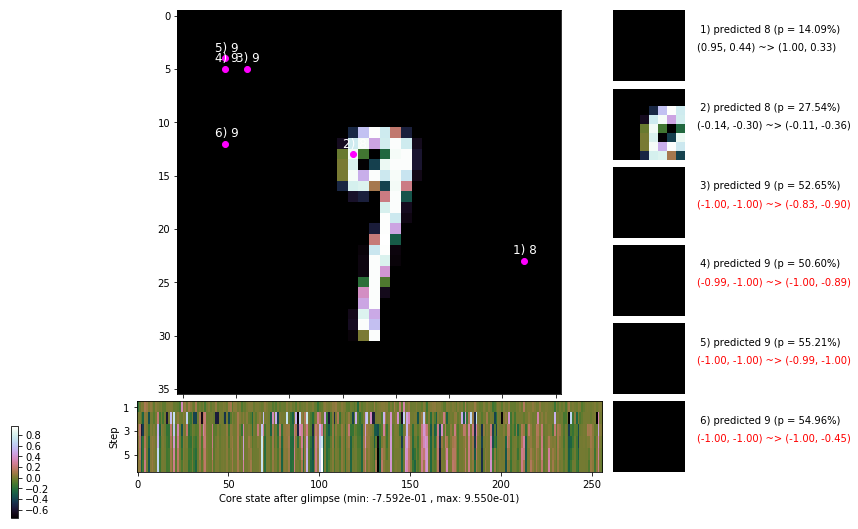

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 9 | Discounted rewards: [0.000, 0.000, 0.000, 0.000, 0.000, 0.000]


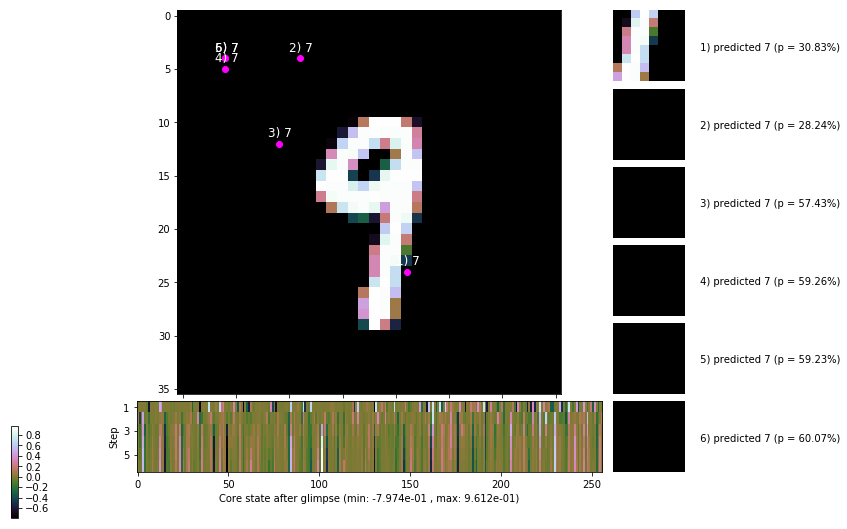


	Target class: 7 | Discounted rewards: [3.686, 4.095, 3.439, 2.710, 1.900, 1.000]


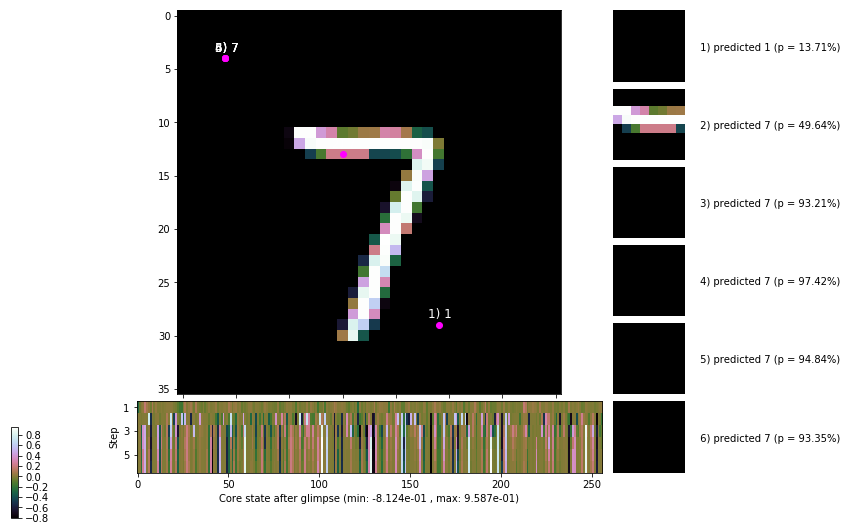

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


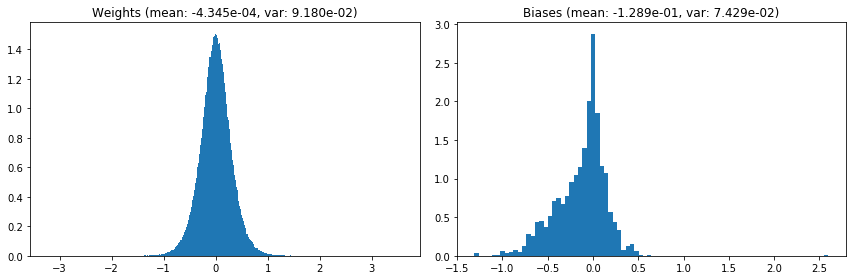

                                      Location network weights and biases


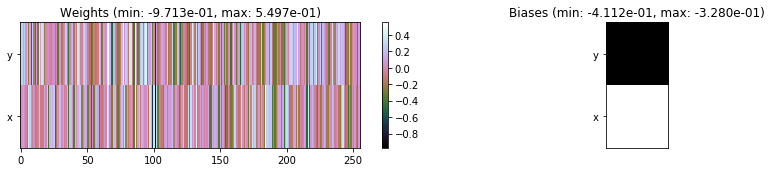

---------------------------------------------------------------------------------------------------------------
Elapsed time:  481.41 sec | TRAIN >> class loss: 0.7948 | steps:  2.822    | reward:  3.6313    | acc.: 71.730% 
                          | VAL   >> class loss: 0.7501 | steps:  2.755 :( | reward:  3.7284 :( | acc.: 72.680% :(


Epoch  67/400) lr = 0.0003714
 b    300/  3000 >> 161.8 ms/b | lr: 3.71e-04 | grad 2norm: 18.92 | grad inf norm:  5.744
         Weights || abs max:  3.57 ( 2470.33) | mean: -4.29e-04 ( 0.01) | var: 9.18e-02 (  172.92)
          Biases || abs max:  2.60 (  153.40) | mean: -1.29e-01 ( 0.12) | var: 7.43e-02 (  292.34)
                    class loss: 0.770 | steps: 2.835 | reward:  3.664 | acc.: 73.23%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 157.9 ms/b | lr: 3.71e-04 | grad 2norm: 19.13 | grad inf norm:  5.852
         Weights || abs max:  3.56 ( 2461.43) | mean: -4.21e-04 ( 0

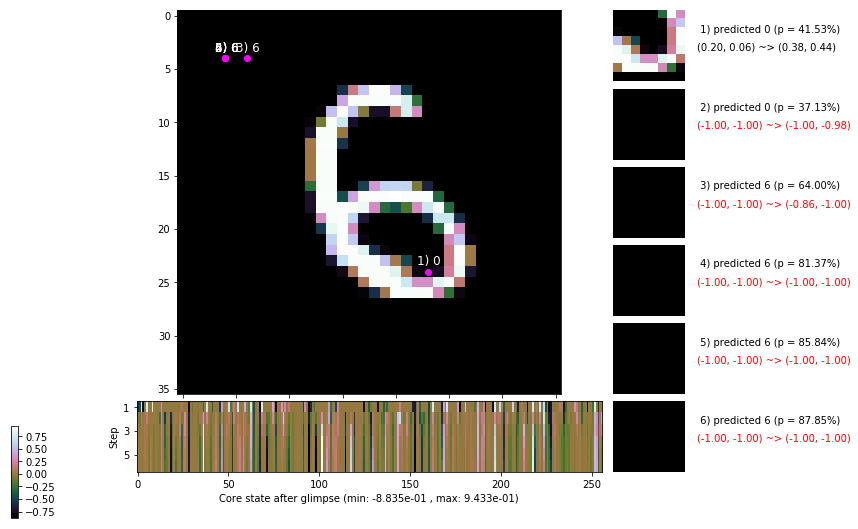

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 160.7 ms/b | lr: 3.70e-04 | grad 2norm: 19.02 | grad inf norm:  5.699
         Weights || abs max:  3.56 ( 6530.18) | mean: -4.29e-04 ( 0.02) | var: 9.19e-02 (13138.49)
          Biases || abs max:  2.60 (  617.65) | mean: -1.29e-01 ( 0.30) | var: 7.45e-02 (26721.15)
                    class loss: 0.826 | steps: 2.890 | reward:  3.577 | acc.: 71.12%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 158.7 ms/b | lr: 3.70e-04 | grad 2norm: 19.24 | grad inf norm:  5.701
         Weights || abs max:  3.56 ( 3787.43) | mean: -4.37e-04 ( 0.01) | var: 9.19e-02 ( 3016.36)
          Biases || abs max:  2.59 (  175.16) | mean: -1.29e-01 ( 0.13) | var: 7.45e-02 (  614.31)
                    class loss: 0.799 | steps: 2.845 | reward:  3.616 | acc.: 71.38%

	Target class: 3 | Discounted rewards: [2.786, 3.095, 3.4

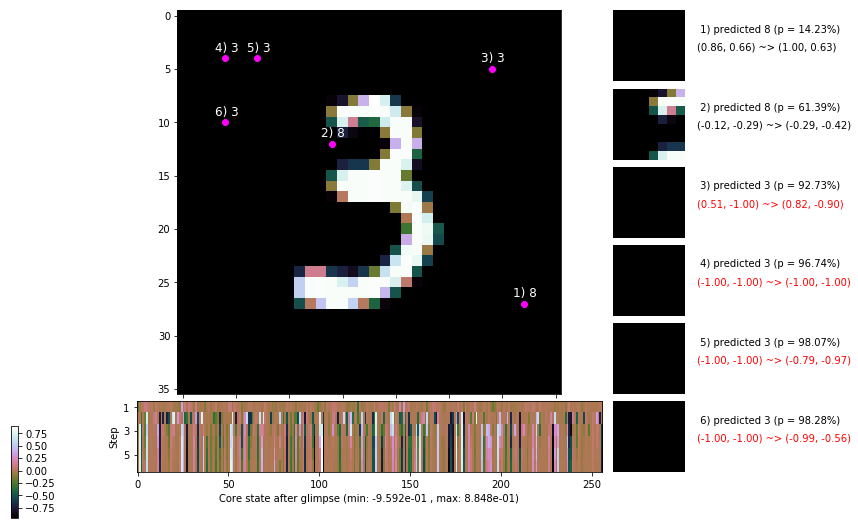

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 161.7 ms/b | lr: 3.69e-04 | grad 2norm: 18.57 | grad inf norm:  5.590
         Weights || abs max:  3.57 ( 6882.90) | mean: -4.46e-04 ( 0.02) | var: 9.20e-02 (16265.54)
          Biases || abs max:  2.60 (  117.81) | mean: -1.29e-01 ( 0.11) | var: 7.44e-02 (   47.50)
                    class loss: 0.816 | steps: 2.840 | reward:  3.630 | acc.: 71.80%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 157.1 ms/b | lr: 3.68e-04 | grad 2norm: 18.94 | grad inf norm:  5.760
         Weights || abs max:  3.56 ( 1402.49) | mean: -4.48e-04 ( 0.01) | var: 9.20e-02 (   41.61)
          Biases || abs max:  2.59 (  108.66) | mean: -1.29e-01 ( 0.10) | var: 7.44e-02 (   57.49)
                    class loss: 0.836 | steps: 2.880 | reward:  3.587 | acc.: 70.72%

	Target class: 5 | Discounted rewards: [0.000, 0.000, 0.0

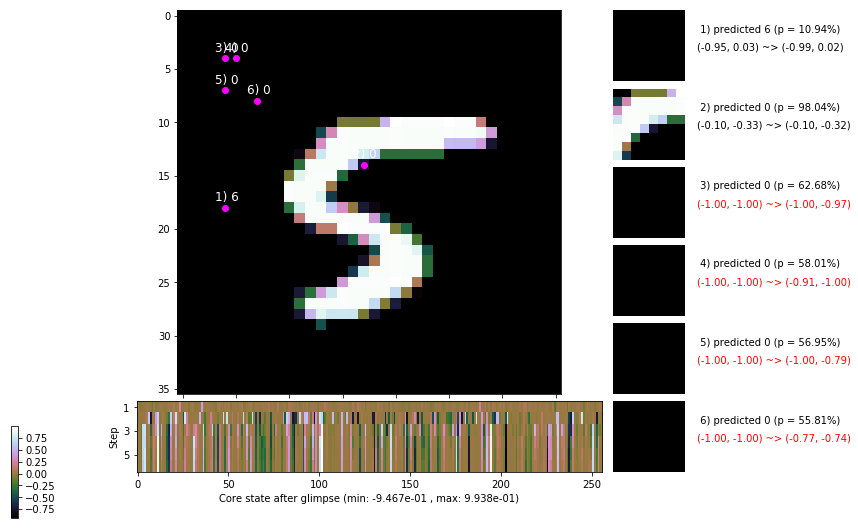

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 158.5 ms/b | lr: 3.68e-04 | grad 2norm: 18.99 | grad inf norm:  5.730
         Weights || abs max:  3.56 ( 2127.06) | mean: -4.49e-04 ( 0.01) | var: 9.20e-02 (  375.56)
          Biases || abs max:  2.59 (   60.19) | mean: -1.29e-01 ( 0.08) | var: 7.44e-02 (   27.66)
                    class loss: 0.819 | steps: 2.842 | reward:  3.619 | acc.: 71.35%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 158.8 ms/b | lr: 3.67e-04 | grad 2norm: 18.93 | grad inf norm:  5.690
         Weights || abs max:  3.56 ( 2481.55) | mean: -4.31e-04 ( 0.01) | var: 9.21e-02 (  412.90)
          Biases || abs max:  2.59 (   56.47) | mean: -1.29e-01 ( 0.08) | var: 7.43e-02 (    7.82)
                    class loss: 0.825 | steps: 2.847 | reward:  3.616 | acc.: 71.37%

	Target class: 3 | Discounted rewards: [4.686, 4.095, 3.4

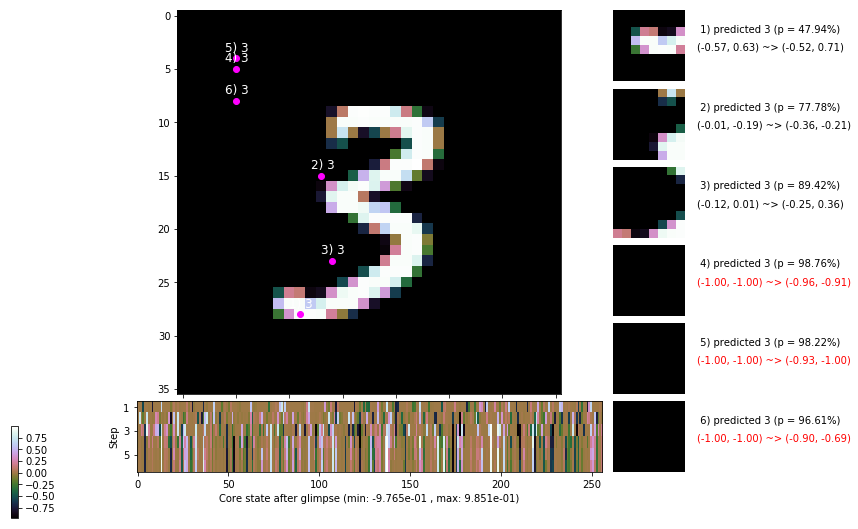

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 160.0 ms/b | lr: 3.67e-04 | grad 2norm: 18.90 | grad inf norm:  5.530
         Weights || abs max:  3.55 ( 1523.71) | mean: -4.22e-04 ( 0.01) | var: 9.21e-02 (   69.98)
          Biases || abs max:  2.59 (  125.22) | mean: -1.28e-01 ( 0.12) | var: 7.43e-02 (   62.95)
                    class loss: 0.842 | steps: 2.885 | reward:  3.558 | acc.: 70.57%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 164.9 ms/b | lr: 3.66e-04 | grad 2norm: 19.01 | grad inf norm:  5.775
         Weights || abs max:  3.55 ( 1944.64) | mean: -4.28e-04 ( 0.01) | var: 9.21e-02 (   44.03)
          Biases || abs max:  2.58 (  292.61) | mean: -1.28e-01 ( 0.18) | var: 7.43e-02 ( 1587.51)
                    class loss: 0.830 | steps: 2.848 | reward:  3.603 | acc.: 70.72%

	Target class: 7 | Discounted rewards: [3.686, 4.095, 3.4

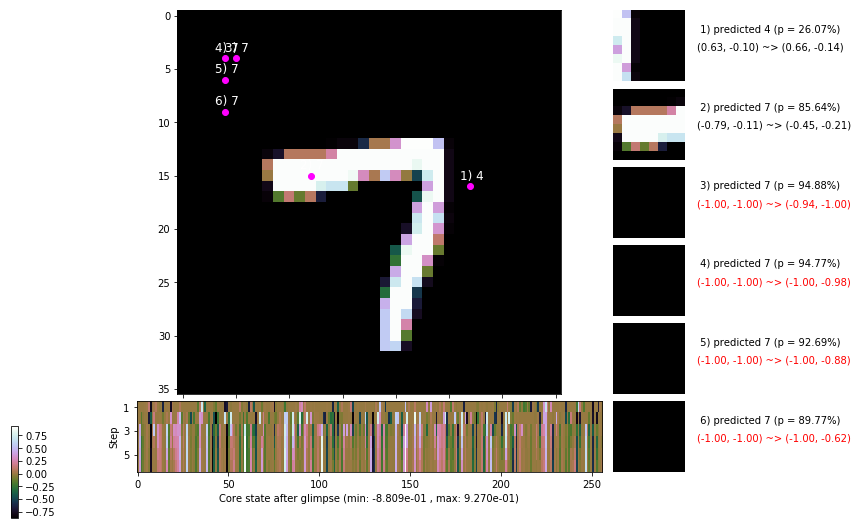

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 4 | Discounted rewards: [2.786, 3.095, 3.439, 2.710, 1.900, 1.000]


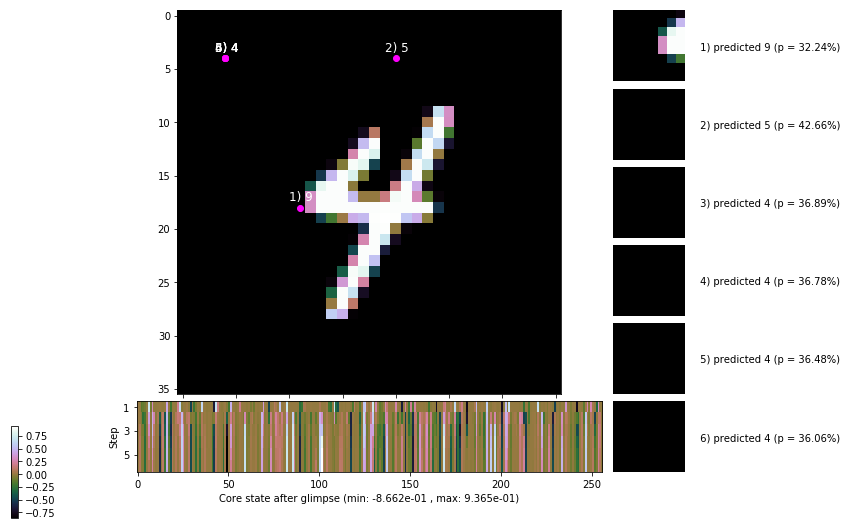


	Target class: 6 | Discounted rewards: [3.686, 4.095, 3.439, 2.710, 1.900, 1.000]


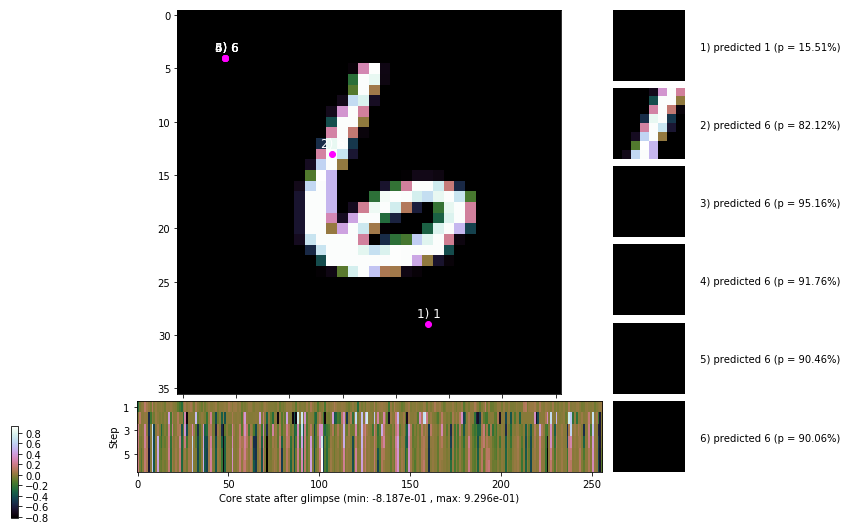

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


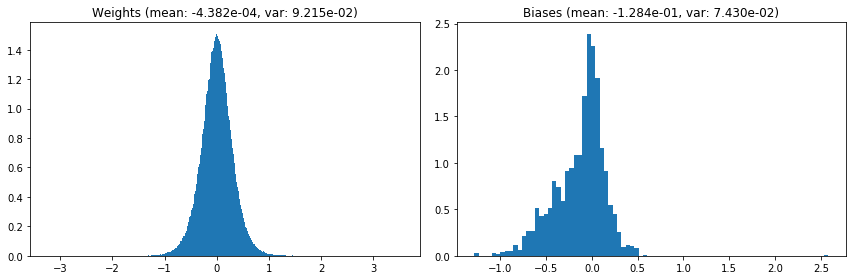

                                      Location network weights and biases


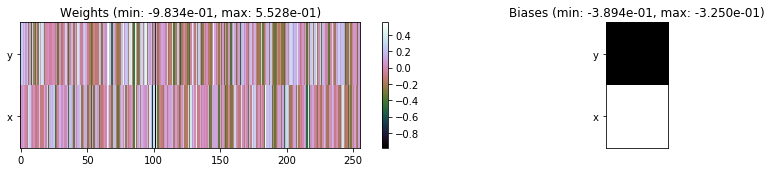

---------------------------------------------------------------------------------------------------------------
Elapsed time:  480.64 sec | TRAIN >> class loss: 0.8177 | steps:  2.854 :( | reward:  3.6086 :( | acc.: 71.363% :(
                          | VAL   >> class loss: 0.7831 | steps:  2.733 :( | reward:  3.7340 :( | acc.: 72.520% :(


Epoch  68/400) lr = 0.0003659
 b    300/  3000 >> 162.8 ms/b | lr: 3.65e-04 | grad 2norm: 19.25 | grad inf norm:  5.824
         Weights || abs max:  3.55 ( 2063.88) | mean: -4.36e-04 ( 0.01) | var: 9.22e-02 (  208.18)
          Biases || abs max:  2.58 (   93.22) | mean: -1.28e-01 ( 0.09) | var: 7.43e-02 (   35.92)
                    class loss: 0.803 | steps: 2.862 | reward:  3.607 | acc.: 71.40%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 164.8 ms/b | lr: 3.65e-04 | grad 2norm: 18.92 | grad inf norm:  5.817
         Weights || abs max:  3.54 ( 4704.67) | mean: -4.43e-04 (

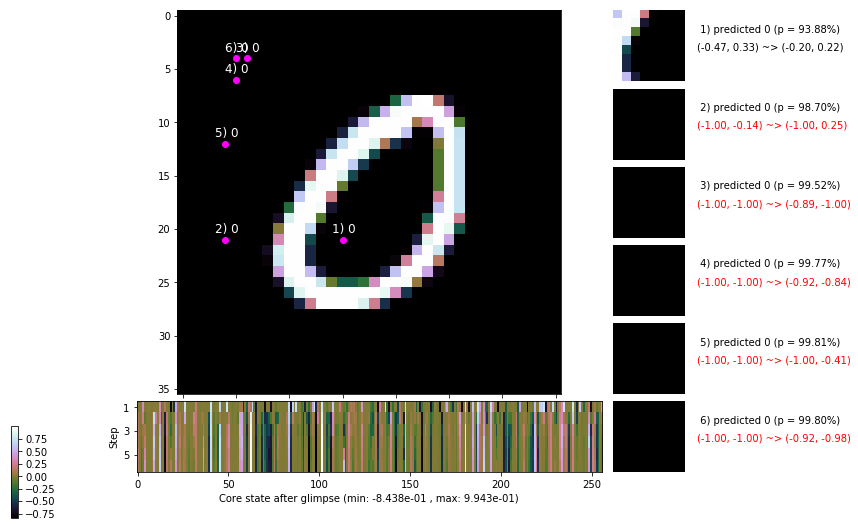

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 163.8 ms/b | lr: 3.64e-04 | grad 2norm: 18.91 | grad inf norm:  5.534
         Weights || abs max:  3.55 ( 1904.18) | mean: -4.26e-04 ( 0.01) | var: 9.22e-02 (  182.01)
          Biases || abs max:  2.59 (  438.05) | mean: -1.28e-01 ( 0.23) | var: 7.45e-02 (14370.80)
                    class loss: 0.780 | steps: 2.849 | reward:  3.639 | acc.: 72.38%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 159.4 ms/b | lr: 3.64e-04 | grad 2norm: 19.26 | grad inf norm:  5.844
         Weights || abs max:  3.55 ( 1414.20) | mean: -4.07e-04 ( 0.01) | var: 9.23e-02 (   26.26)
          Biases || abs max:  2.59 (  399.54) | mean: -1.28e-01 ( 0.22) | var: 7.45e-02 (11046.95)
                    class loss: 0.784 | steps: 2.812 | reward:  3.678 | acc.: 72.67%

	Target class: 0 | Discounted rewards: [3.686, 4.095, 3.4

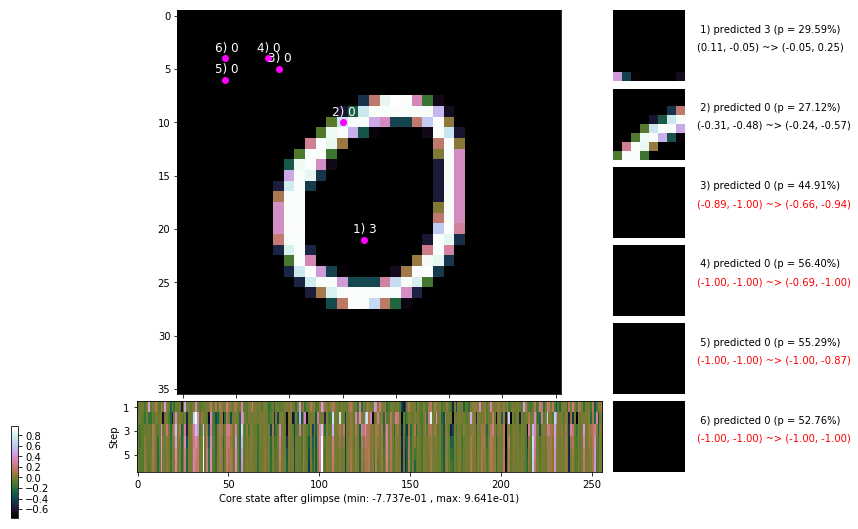

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 152.1 ms/b | lr: 3.63e-04 | grad 2norm: 18.89 | grad inf norm:  5.746
         Weights || abs max:  3.55 ( 1650.14) | mean: -4.06e-04 ( 0.01) | var: 9.23e-02 (   26.39)
          Biases || abs max:  2.59 (  118.22) | mean: -1.28e-01 ( 0.12) | var: 7.46e-02 (  405.97)
                    class loss: 0.788 | steps: 2.806 | reward:  3.672 | acc.: 72.62%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 151.2 ms/b | lr: 3.63e-04 | grad 2norm: 19.29 | grad inf norm:  5.851
         Weights || abs max:  3.54 ( 2624.03) | mean: -4.15e-04 ( 0.01) | var: 9.23e-02 (  243.19)
          Biases || abs max:  2.59 (   93.30) | mean: -1.29e-01 ( 0.10) | var: 7.47e-02 (   68.48)
                    class loss: 0.826 | steps: 2.826 | reward:  3.615 | acc.: 70.98%

	Target class: 8 | Discounted rewards: [0.000, 0.000, 0.0

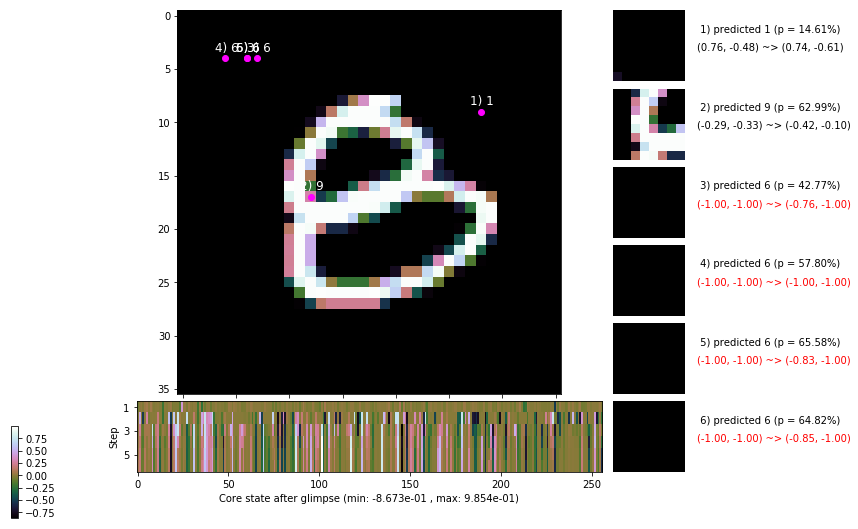

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 153.1 ms/b | lr: 3.62e-04 | grad 2norm: 19.42 | grad inf norm:  6.065
         Weights || abs max:  3.55 (26471.54) | mean: -4.02e-04 ( 0.05) | var: 9.23e-02 (274171.47)
          Biases || abs max:  2.59 (  131.57) | mean: -1.29e-01 ( 0.11) | var: 7.48e-02 (  362.02)
                    class loss: 0.811 | steps: 2.859 | reward:  3.592 | acc.: 71.30%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 148.7 ms/b | lr: 3.62e-04 | grad 2norm: 19.10 | grad inf norm:  5.736
         Weights || abs max:  3.55 ( 8578.12) | mean: -3.88e-04 ( 0.02) | var: 9.24e-02 (25725.15)
          Biases || abs max:  2.59 (  141.48) | mean: -1.28e-01 ( 0.14) | var: 7.48e-02 (  326.94)
                    class loss: 0.780 | steps: 2.833 | reward:  3.655 | acc.: 72.43%

	Target class: 1 | Discounted rewards: [2.786, 3.095, 3.

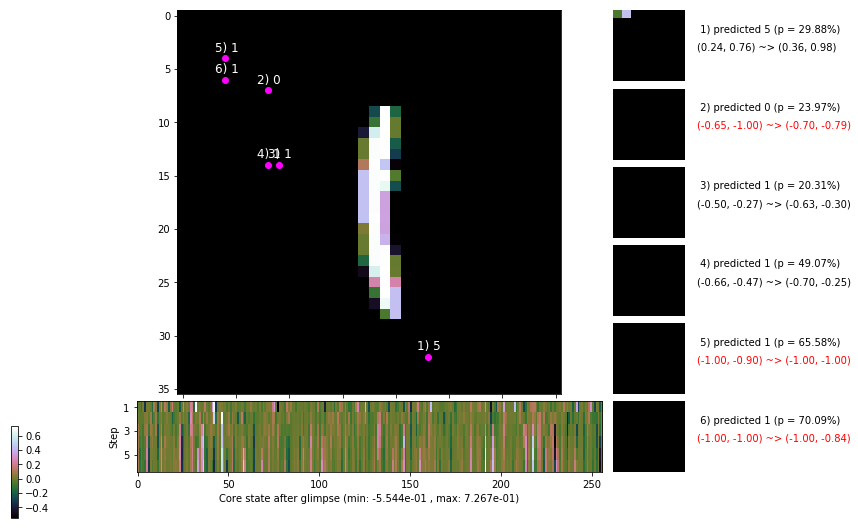

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 151.4 ms/b | lr: 3.61e-04 | grad 2norm: 18.96 | grad inf norm:  5.590
         Weights || abs max:  3.55 ( 2056.43) | mean: -3.80e-04 ( 0.01) | var: 9.24e-02 (  147.44)
          Biases || abs max:  2.59 (   96.76) | mean: -1.29e-01 ( 0.09) | var: 7.50e-02 (   45.73)
                    class loss: 0.834 | steps: 2.878 | reward:  3.584 | acc.: 70.87%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 150.7 ms/b | lr: 3.61e-04 | grad 2norm: 19.04 | grad inf norm:  5.778
         Weights || abs max:  3.55 ( 2237.86) | mean: -3.81e-04 ( 0.01) | var: 9.24e-02 (  417.07)
          Biases || abs max:  2.59 (  271.36) | mean: -1.29e-01 ( 0.17) | var: 7.51e-02 ( 1788.79)
                    class loss: 0.804 | steps: 2.822 | reward:  3.637 | acc.: 71.98%

	Target class: 2 | Discounted rewards: [3.686, 4.095, 3.4

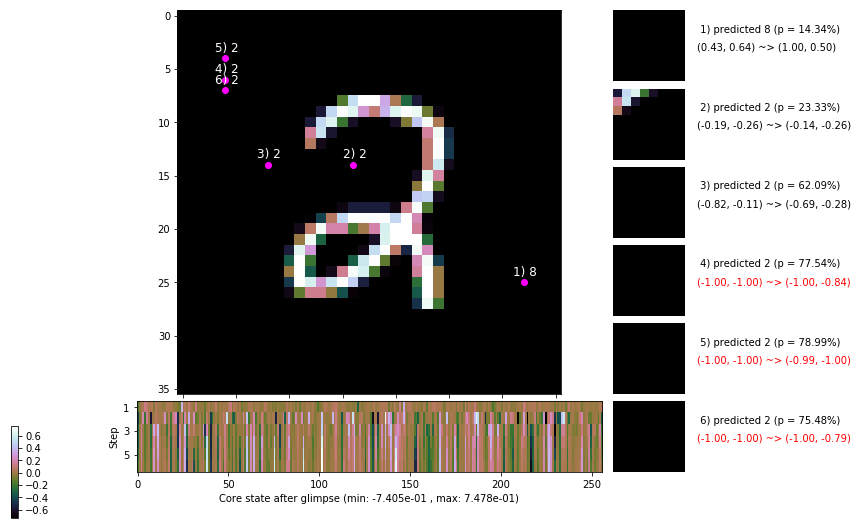

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 7 | Discounted rewards: [4.686, 4.095, 3.439, 2.710, 1.900, 1.000]


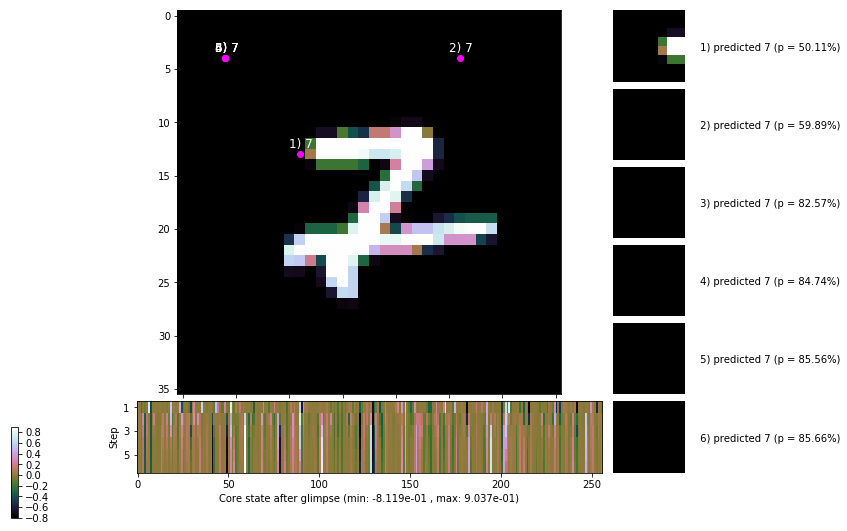


	Target class: 6 | Discounted rewards: [2.786, 3.095, 3.439, 2.710, 1.900, 1.000]


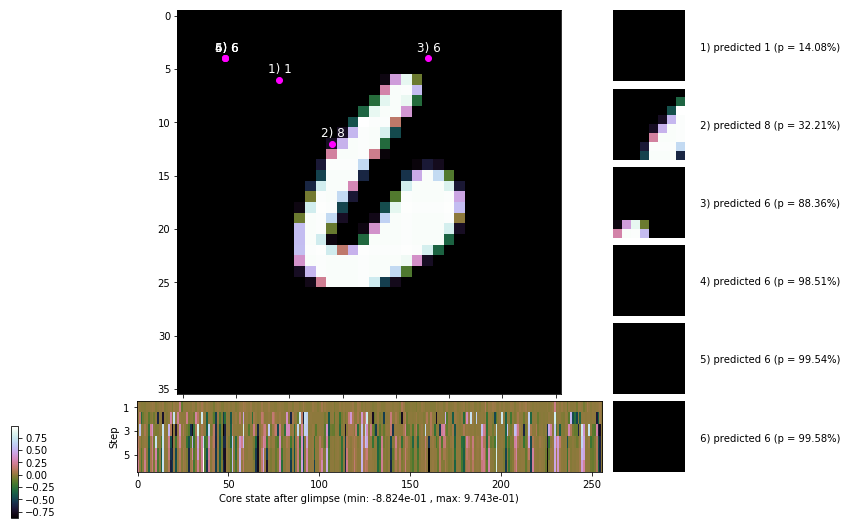

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


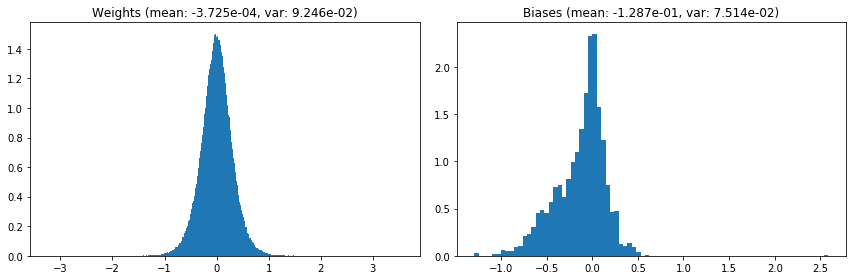

                                      Location network weights and biases


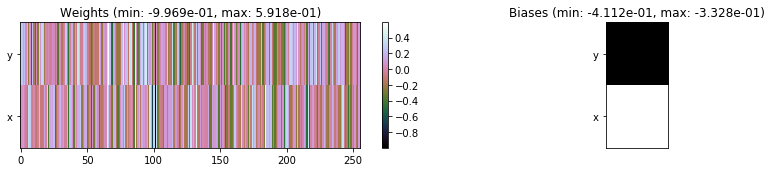

---------------------------------------------------------------------------------------------------------------
Elapsed time:  468.26 sec | TRAIN >> class loss: 0.7986 | steps:  2.834 :( | reward:  3.6341    | acc.: 71.927% 
                          | VAL   >> class loss: 0.7641 | steps:  2.765 :( | reward:  3.7276 :( | acc.: 73.040% 


Epoch  69/400) lr = 0.0003604
 b    300/  3000 >> 150.3 ms/b | lr: 3.60e-04 | grad 2norm: 18.47 | grad inf norm:  5.497
         Weights || abs max:  3.56 ( 2740.67) | mean: -3.56e-04 ( 0.01) | var: 9.25e-02 (  165.94)
          Biases || abs max:  2.59 (  432.13) | mean: -1.29e-01 ( 0.23) | var: 7.51e-02 ( 8939.97)
                    class loss: 0.790 | steps: 2.862 | reward:  3.612 | acc.: 71.70%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 152.8 ms/b | lr: 3.60e-04 | grad 2norm: 19.30 | grad inf norm:  5.817
         Weights || abs max:  3.57 ( 1754.61) | mean: -3.46e-04 ( 0.0

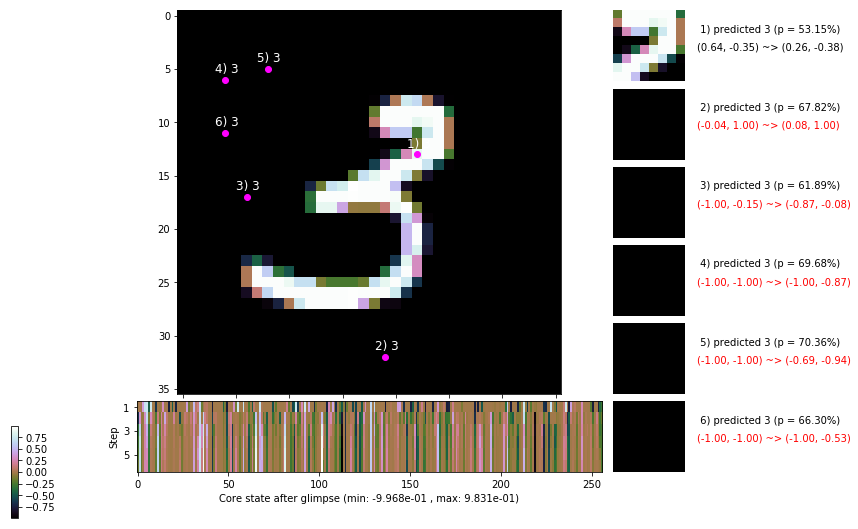

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 151.2 ms/b | lr: 3.59e-04 | grad 2norm: 18.92 | grad inf norm:  5.674
         Weights || abs max:  3.57 ( 1662.30) | mean: -3.29e-04 ( 0.01) | var: 9.26e-02 (   57.40)
          Biases || abs max:  2.58 (   61.19) | mean: -1.28e-01 ( 0.08) | var: 7.49e-02 (   19.34)
                    class loss: 0.803 | steps: 2.843 | reward:  3.623 | acc.: 71.58%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 153.6 ms/b | lr: 3.59e-04 | grad 2norm: 19.00 | grad inf norm:  5.526
         Weights || abs max:  3.58 ( 2445.82) | mean: -3.38e-04 ( 0.01) | var: 9.26e-02 (  819.78)
          Biases || abs max:  2.58 (  108.15) | mean: -1.28e-01 ( 0.10) | var: 7.48e-02 (   38.88)
                    class loss: 0.829 | steps: 2.871 | reward:  3.574 | acc.: 70.58%

	Target class: 7 | Discounted rewards: [3.686, 4.095, 3.4

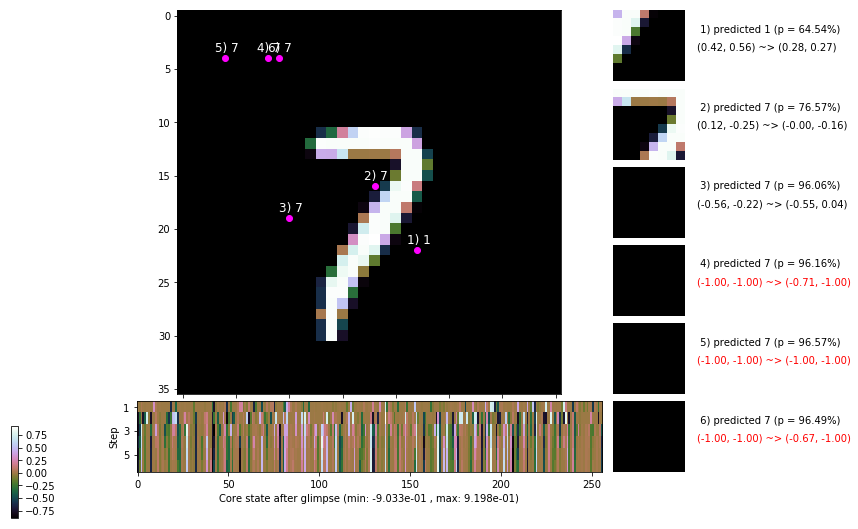

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 167.9 ms/b | lr: 3.58e-04 | grad 2norm: 18.60 | grad inf norm:  5.458
         Weights || abs max:  3.57 ( 1937.61) | mean: -3.30e-04 ( 0.01) | var: 9.26e-02 (   83.14)
          Biases || abs max:  2.58 (  120.18) | mean: -1.28e-01 ( 0.12) | var: 7.49e-02 (   57.86)
                    class loss: 0.764 | steps: 2.800 | reward:  3.665 | acc.: 73.05%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 167.1 ms/b | lr: 3.58e-04 | grad 2norm: 19.04 | grad inf norm:  5.596
         Weights || abs max:  3.57 ( 2678.64) | mean: -3.22e-04 ( 0.01) | var: 9.27e-02 (  467.38)
          Biases || abs max:  2.59 (  236.78) | mean: -1.28e-01 ( 0.15) | var: 7.49e-02 ( 1267.34)
                    class loss: 0.782 | steps: 2.785 | reward:  3.686 | acc.: 72.85%

	Target class: 2 | Discounted rewards: [2.786, 3.095, 3.4

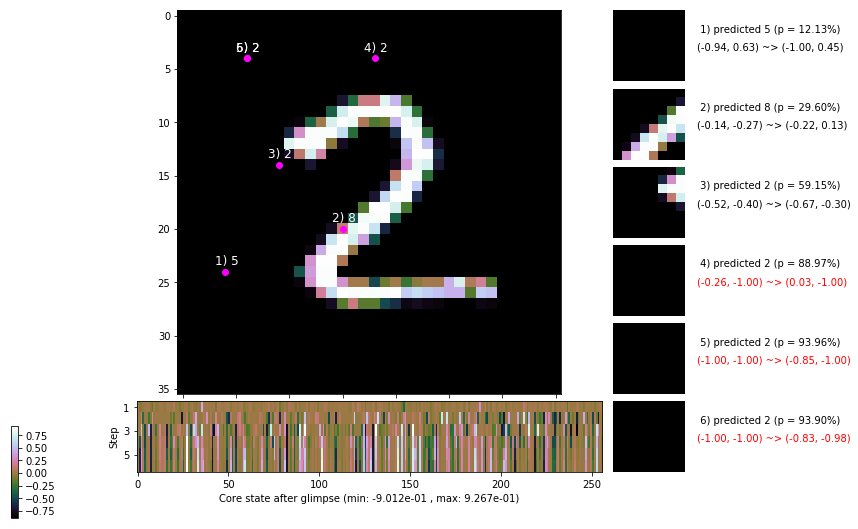

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 165.3 ms/b | lr: 3.57e-04 | grad 2norm: 19.33 | grad inf norm:  6.041
         Weights || abs max:  3.56 ( 6066.58) | mean: -3.21e-04 ( 0.02) | var: 9.27e-02 ( 8540.58)
          Biases || abs max:  2.59 (  140.07) | mean: -1.28e-01 ( 0.11) | var: 7.50e-02 (  284.81)
                    class loss: 0.822 | steps: 2.848 | reward:  3.591 | acc.: 71.13%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 162.1 ms/b | lr: 3.56e-04 | grad 2norm: 19.01 | grad inf norm:  5.788
         Weights || abs max:  3.57 ( 1285.51) | mean: -3.23e-04 ( 0.01) | var: 9.27e-02 (   19.44)
          Biases || abs max:  2.58 (  647.87) | mean: -1.29e-01 ( 0.51) | var: 7.51e-02 (52183.48)
                    class loss: 0.807 | steps: 2.873 | reward:  3.596 | acc.: 71.52%

	Target class: 9 | Discounted rewards: [0.000, 0.000, 0.0

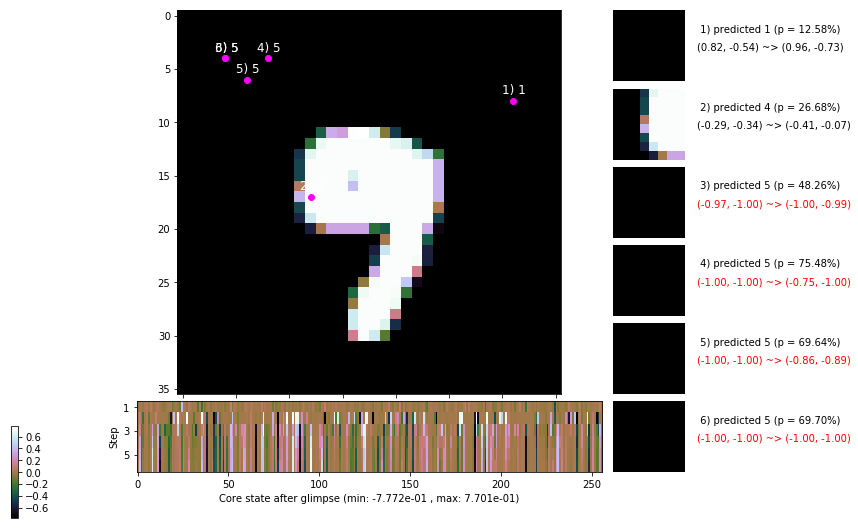

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 161.8 ms/b | lr: 3.56e-04 | grad 2norm: 18.43 | grad inf norm:  5.734
         Weights || abs max:  3.56 ( 2752.69) | mean: -3.38e-04 ( 0.01) | var: 9.28e-02 (  347.38)
          Biases || abs max:  2.58 (  318.25) | mean: -1.29e-01 ( 0.22) | var: 7.51e-02 (  965.74)
                    class loss: 0.820 | steps: 2.826 | reward:  3.623 | acc.: 71.85%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 156.1 ms/b | lr: 3.55e-04 | grad 2norm: 18.51 | grad inf norm:  5.265
         Weights || abs max:  3.56 (20551.15) | mean: -3.56e-04 ( 0.04) | var: 9.28e-02 (96765.41)
          Biases || abs max:  2.58 (  250.56) | mean: -1.29e-01 ( 0.18) | var: 7.51e-02 (  736.04)
                    class loss: 0.822 | steps: 2.870 | reward:  3.580 | acc.: 70.82%

	Target class: 9 | Discounted rewards: [2.786, 3.095, 3.4

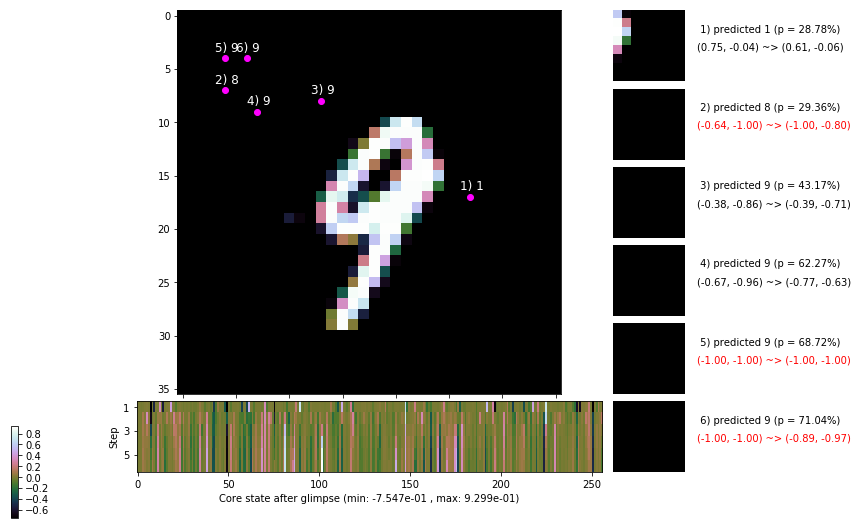

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 7 | Discounted rewards: [3.686, 4.095, 3.439, 2.710, 1.900, 1.000]


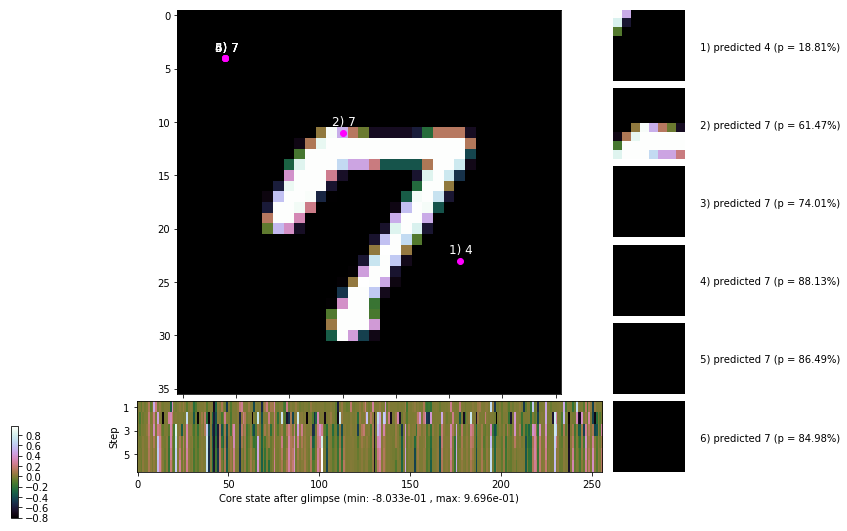


	Target class: 0 | Discounted rewards: [2.876, 3.195, 2.439, 2.710, 1.900, 1.000]


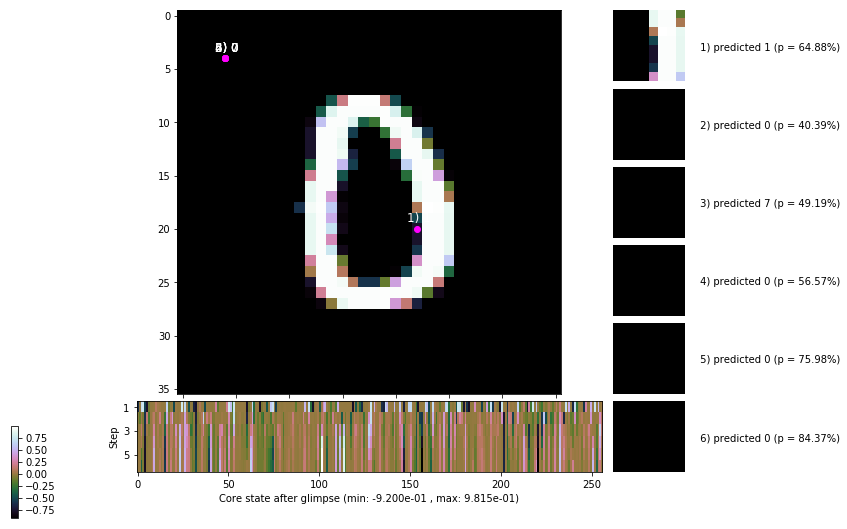

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


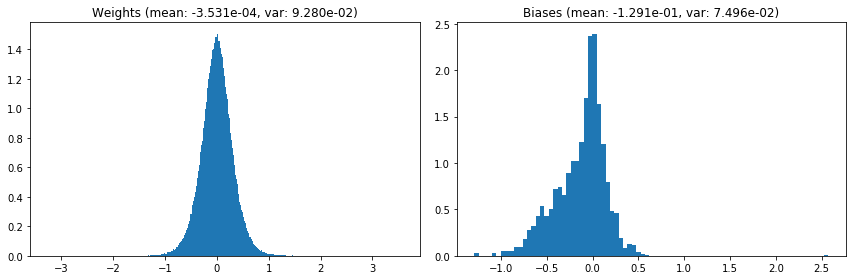

                                      Location network weights and biases


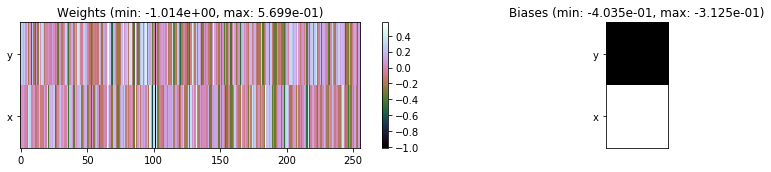

---------------------------------------------------------------------------------------------------------------
Elapsed time:  477.08 sec | TRAIN >> class loss: 0.8062 | steps:  2.842 :( | reward:  3.6161 :( | acc.: 71.602% :(
                          | VAL   >> class loss: 0.7691 | steps:  2.726 :( | reward:  3.7406 :( | acc.: 72.840% :(


Epoch  70/400) lr = 0.000355
 b    300/  3000 >> 157.3 ms/b | lr: 3.55e-04 | grad 2norm: 19.01 | grad inf norm:  5.692
         Weights || abs max:  3.57 ( 6138.40) | mean: -3.56e-04 ( 0.02) | var: 9.28e-02 ( 6002.56)
          Biases || abs max:  2.57 (  111.52) | mean: -1.29e-01 ( 0.10) | var: 7.49e-02 (   51.05)
                    class loss: 0.801 | steps: 2.855 | reward:  3.609 | acc.: 71.53%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 157.5 ms/b | lr: 3.54e-04 | grad 2norm: 18.99 | grad inf norm:  5.589
         Weights || abs max:  3.57 ( 3697.79) | mean: -3.47e-04 ( 

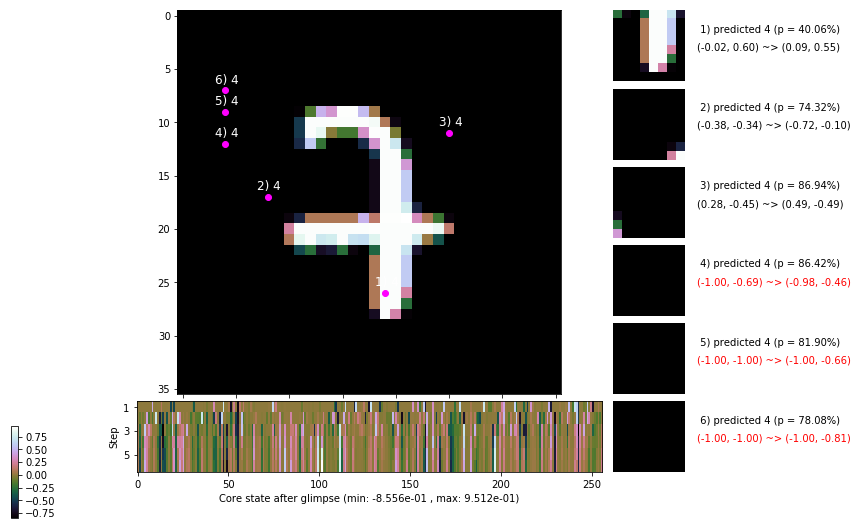

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 158.7 ms/b | lr: 3.54e-04 | grad 2norm: 19.21 | grad inf norm:  6.059
         Weights || abs max:  3.58 ( 3185.31) | mean: -3.62e-04 ( 0.01) | var: 9.29e-02 (  491.09)
          Biases || abs max:  2.59 (  618.24) | mean: -1.29e-01 ( 0.32) | var: 7.51e-02 (16743.08)
                    class loss: 0.789 | steps: 2.831 | reward:  3.645 | acc.: 72.27%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 159.5 ms/b | lr: 3.53e-04 | grad 2norm: 18.96 | grad inf norm:  5.748
         Weights || abs max:  3.58 ( 3246.47) | mean: -3.57e-04 ( 0.01) | var: 9.29e-02 (  655.86)
          Biases || abs max:  2.58 (  120.22) | mean: -1.29e-01 ( 0.10) | var: 7.51e-02 (  136.33)
                    class loss: 0.791 | steps: 2.816 | reward:  3.620 | acc.: 71.43%

	Target class: 7 | Discounted rewards: [2.147, 2.385, 1.5

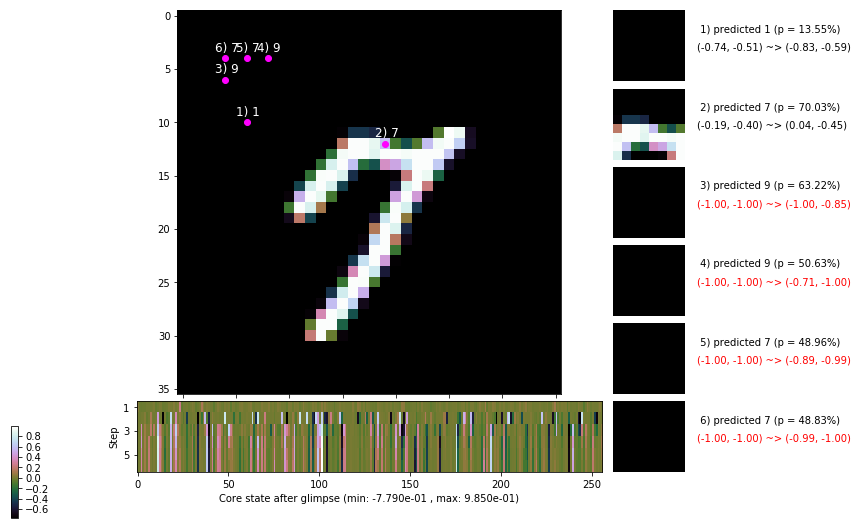

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 163.8 ms/b | lr: 3.53e-04 | grad 2norm: 18.60 | grad inf norm:  5.708
         Weights || abs max:  3.58 ( 2332.66) | mean: -3.34e-04 ( 0.01) | var: 9.29e-02 (  292.01)
          Biases || abs max:  2.59 (  534.35) | mean: -1.29e-01 ( 0.26) | var: 7.50e-02 (27104.43)
                    class loss: 0.799 | steps: 2.832 | reward:  3.639 | acc.: 72.63%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 165.7 ms/b | lr: 3.52e-04 | grad 2norm: 19.28 | grad inf norm:  5.639
         Weights || abs max:  3.59 ( 1251.25) | mean: -3.27e-04 ( 0.01) | var: 9.30e-02 (   27.16)
          Biases || abs max:  2.58 (   88.84) | mean: -1.29e-01 ( 0.09) | var: 7.50e-02 (   52.65)
                    class loss: 0.805 | steps: 2.824 | reward:  3.607 | acc.: 70.97%

	Target class: 1 | Discounted rewards: [4.686, 4.095, 3.4

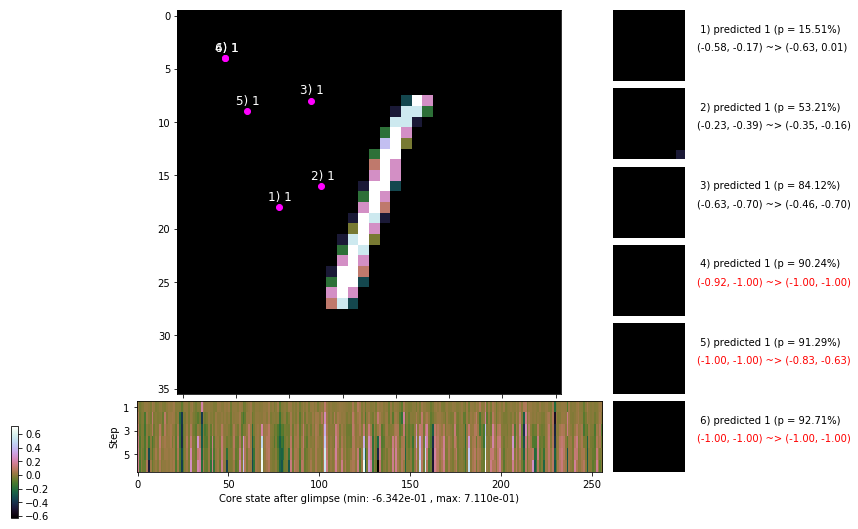

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 166.8 ms/b | lr: 3.52e-04 | grad 2norm: 18.94 | grad inf norm:  5.613
         Weights || abs max:  3.58 ( 4327.96) | mean: -3.15e-04 ( 0.01) | var: 9.30e-02 ( 3528.22)
          Biases || abs max:  2.58 (  136.81) | mean: -1.29e-01 ( 0.11) | var: 7.48e-02 (  598.24)
                    class loss: 0.794 | steps: 2.808 | reward:  3.657 | acc.: 72.25%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 158.9 ms/b | lr: 3.51e-04 | grad 2norm: 18.99 | grad inf norm:  5.665
         Weights || abs max:  3.59 ( 1656.13) | mean: -3.04e-04 ( 0.01) | var: 9.30e-02 (   68.18)
          Biases || abs max:  2.58 (  407.48) | mean: -1.29e-01 ( 0.21) | var: 7.50e-02 (13029.05)
                    class loss: 0.795 | steps: 2.848 | reward:  3.606 | acc.: 71.63%

	Target class: 5 | Discounted rewards: [3.686, 4.095, 3.4

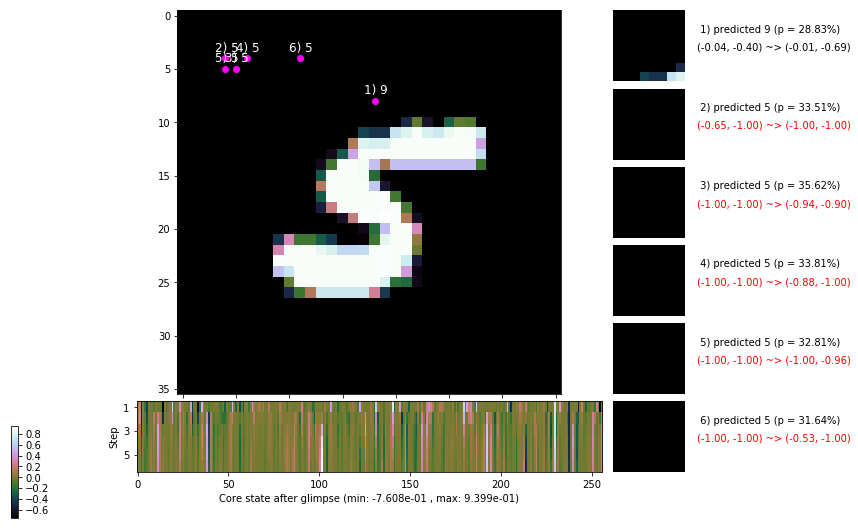

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 158.7 ms/b | lr: 3.50e-04 | grad 2norm: 19.06 | grad inf norm:  5.841
         Weights || abs max:  3.59 ( 3101.90) | mean: -3.03e-04 ( 0.01) | var: 9.30e-02 ( 1503.92)
          Biases || abs max:  2.58 (  131.56) | mean: -1.29e-01 ( 0.11) | var: 7.50e-02 (   68.75)
                    class loss: 0.783 | steps: 2.800 | reward:  3.655 | acc.: 72.72%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 157.5 ms/b | lr: 3.50e-04 | grad 2norm: 18.88 | grad inf norm:  5.528
         Weights || abs max:  3.59 (  955.09) | mean: -3.08e-04 ( 0.01) | var: 9.31e-02 (   37.52)
          Biases || abs max:  2.59 (  108.78) | mean: -1.29e-01 ( 0.10) | var: 7.49e-02 (   51.69)
                    class loss: 0.802 | steps: 2.853 | reward:  3.623 | acc.: 71.93%

	Target class: 7 | Discounted rewards: [0.000, 0.000, 0.0

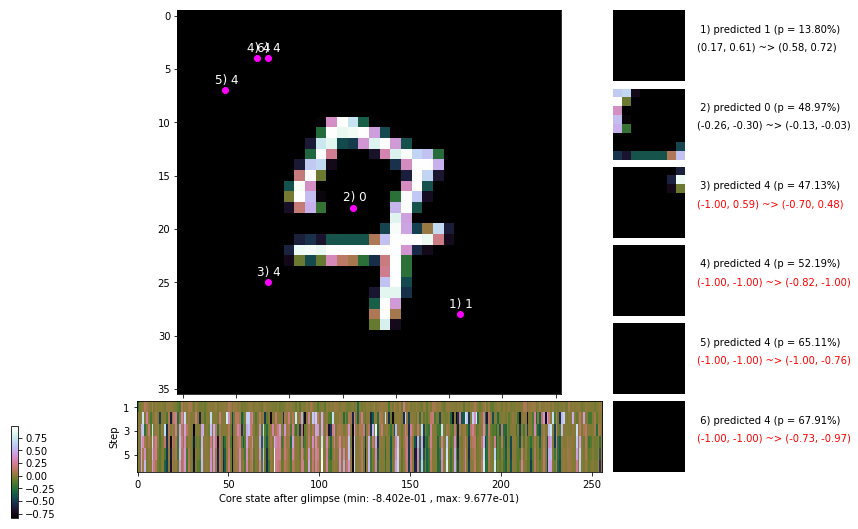

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 1 | Discounted rewards: [4.686, 4.095, 3.439, 2.710, 1.900, 1.000]


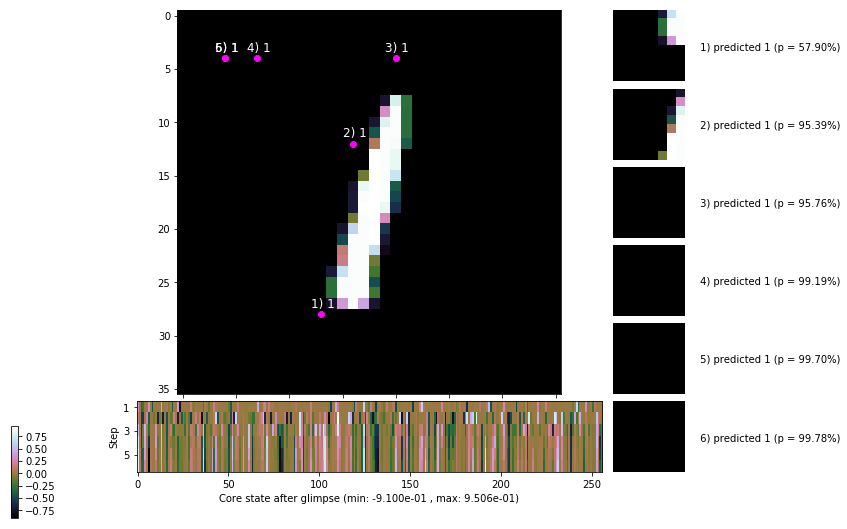


	Target class: 5 | Discounted rewards: [2.786, 3.095, 3.439, 2.710, 1.900, 1.000]


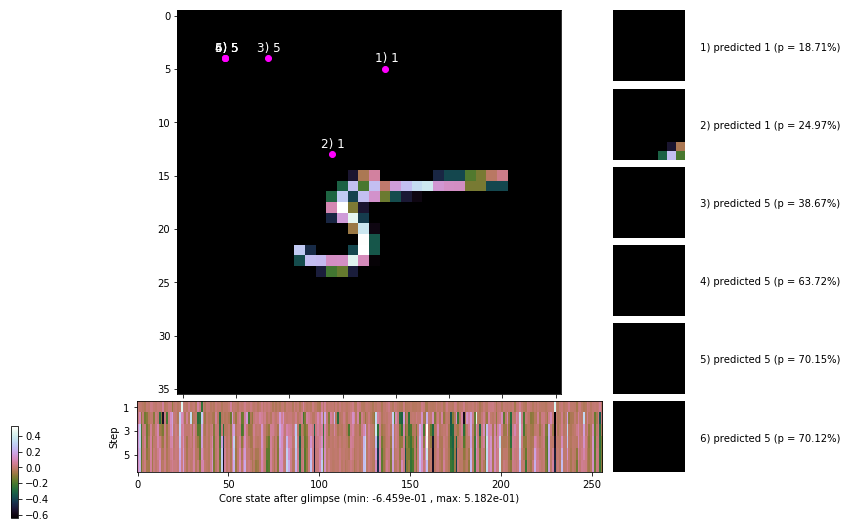

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


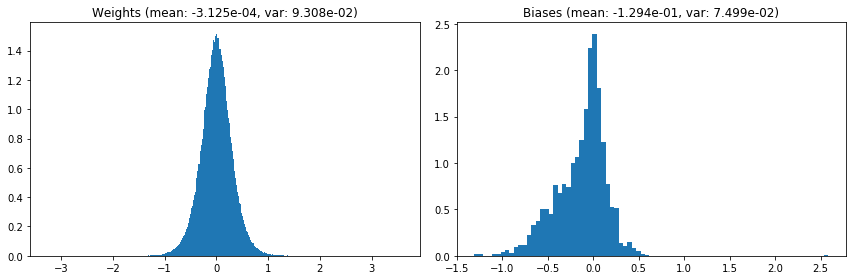

                                      Location network weights and biases


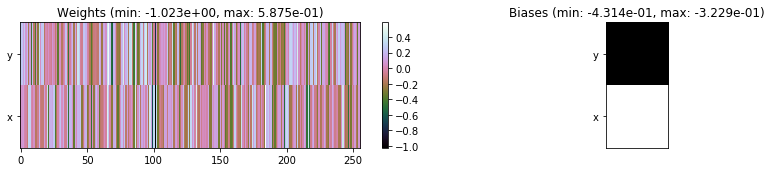

---------------------------------------------------------------------------------------------------------------
Elapsed time:  482.15 sec | TRAIN >> class loss: 0.7940 | steps:  2.821    | reward:  3.6362    | acc.: 71.962% 
                          | VAL   >> class loss: 0.7957 | steps:  2.766 :( | reward:  3.6864 :( | acc.: 72.180% :(


Epoch  71/400) lr = 0.0003498
 b    300/  3000 >> 156.5 ms/b | lr: 3.49e-04 | grad 2norm: 18.84 | grad inf norm:  5.569
         Weights || abs max:  3.59 ( 5076.34) | mean: -3.22e-04 ( 0.01) | var: 9.31e-02 ( 4287.52)
          Biases || abs max:  2.58 (  151.45) | mean: -1.29e-01 ( 0.12) | var: 7.51e-02 (  255.80)
                    class loss: 0.817 | steps: 2.851 | reward:  3.591 | acc.: 71.12%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 158.8 ms/b | lr: 3.49e-04 | grad 2norm: 19.29 | grad inf norm:  5.852
         Weights || abs max:  3.59 ( 1176.15) | mean: -3.18e-04 ( 0

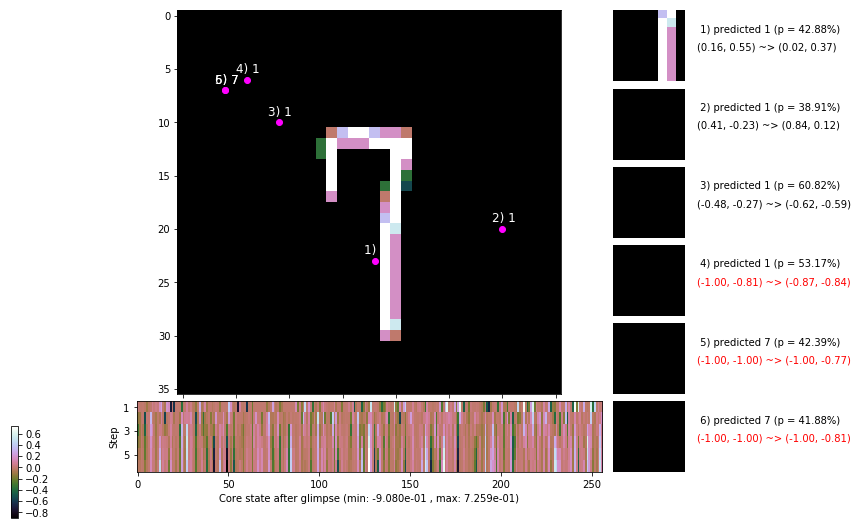

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 159.5 ms/b | lr: 3.48e-04 | grad 2norm: 18.37 | grad inf norm:  5.351
         Weights || abs max:  3.59 (  684.02) | mean: -2.95e-04 ( 0.01) | var: 9.31e-02 (   11.24)
          Biases || abs max:  2.57 (  130.38) | mean: -1.30e-01 ( 0.13) | var: 7.50e-02 (  231.47)
                    class loss: 0.823 | steps: 2.877 | reward:  3.575 | acc.: 71.33%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 156.9 ms/b | lr: 3.48e-04 | grad 2norm: 18.62 | grad inf norm:  5.767
         Weights || abs max:  3.58 ( 1583.79) | mean: -2.84e-04 ( 0.01) | var: 9.32e-02 (   90.70)
          Biases || abs max:  2.58 (  161.29) | mean: -1.29e-01 ( 0.12) | var: 7.50e-02 (  262.27)
                    class loss: 0.806 | steps: 2.837 | reward:  3.625 | acc.: 71.55%

	Target class: 3 | Discounted rewards: [1.247, 1.385, 1.5

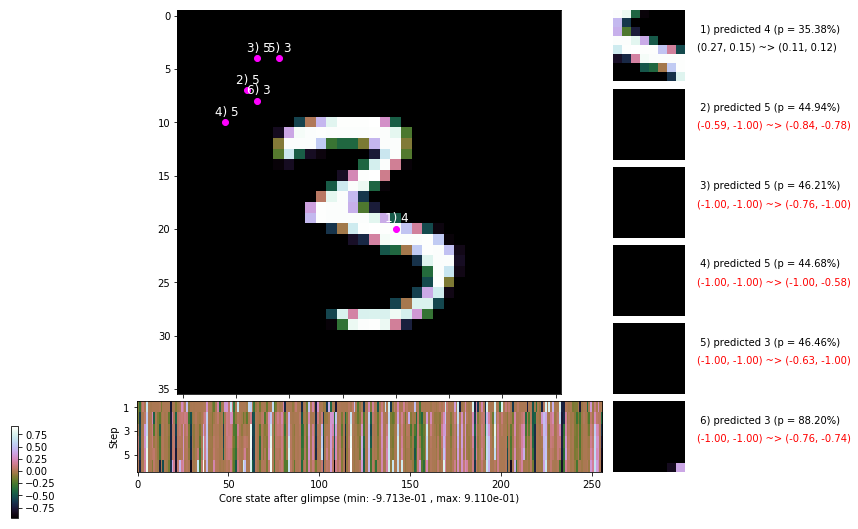

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 161.7 ms/b | lr: 3.47e-04 | grad 2norm: 18.70 | grad inf norm:  5.678
         Weights || abs max:  3.57 ( 2381.11) | mean: -2.80e-04 ( 0.01) | var: 9.32e-02 (  210.30)
          Biases || abs max:  2.57 (  200.14) | mean: -1.29e-01 ( 0.15) | var: 7.50e-02 (  342.83)
                    class loss: 0.795 | steps: 2.838 | reward:  3.622 | acc.: 71.82%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 158.0 ms/b | lr: 3.47e-04 | grad 2norm: 19.02 | grad inf norm:  5.693
         Weights || abs max:  3.58 ( 1629.92) | mean: -2.77e-04 ( 0.01) | var: 9.32e-02 (   56.42)
          Biases || abs max:  2.57 (  121.35) | mean: -1.29e-01 ( 0.11) | var: 7.50e-02 (  476.87)
                    class loss: 0.838 | steps: 2.854 | reward:  3.575 | acc.: 70.40%

	Target class: 6 | Discounted rewards: [2.786, 3.095, 3.4

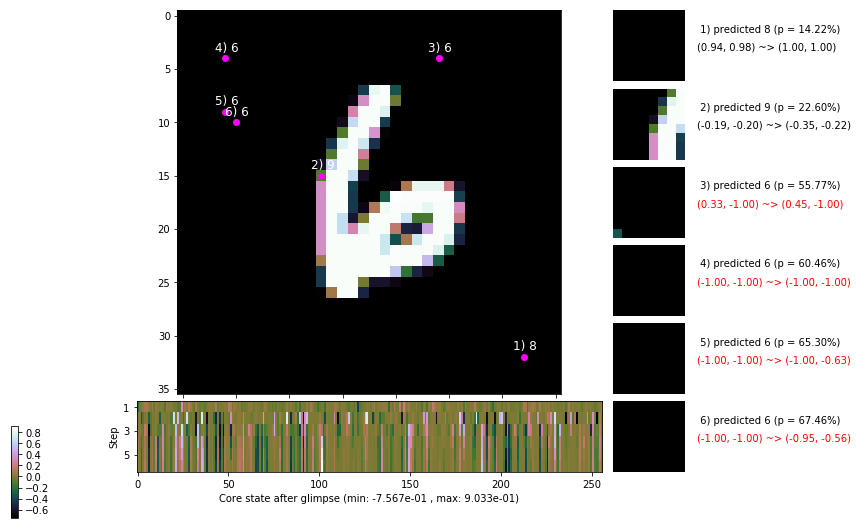

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 163.0 ms/b | lr: 3.46e-04 | grad 2norm: 18.86 | grad inf norm:  5.539
         Weights || abs max:  3.58 ( 1925.98) | mean: -2.79e-04 ( 0.01) | var: 9.33e-02 (  237.72)
          Biases || abs max:  2.56 (  142.37) | mean: -1.29e-01 ( 0.12) | var: 7.50e-02 (  139.41)
                    class loss: 0.816 | steps: 2.840 | reward:  3.596 | acc.: 71.15%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 149.3 ms/b | lr: 3.46e-04 | grad 2norm: 18.24 | grad inf norm:  5.460
         Weights || abs max:  3.57 ( 2433.42) | mean: -2.85e-04 ( 0.01) | var: 9.33e-02 (  507.28)
          Biases || abs max:  2.57 (  614.01) | mean: -1.30e-01 ( 0.32) | var: 7.51e-02 (17491.15)
                    class loss: 0.795 | steps: 2.815 | reward:  3.651 | acc.: 71.92%

	Target class: 0 | Discounted rewards: [0.000, 0.000, 0.0

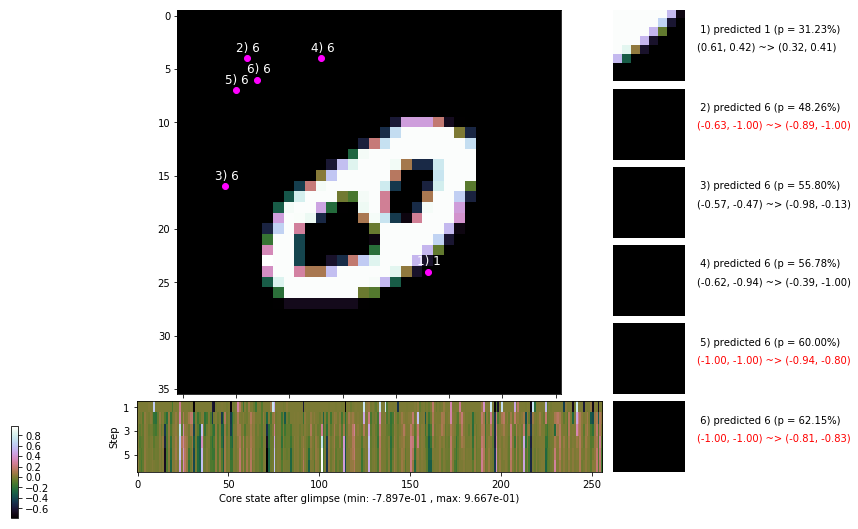

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 154.0 ms/b | lr: 3.45e-04 | grad 2norm: 18.69 | grad inf norm:  5.593
         Weights || abs max:  3.57 ( 4400.60) | mean: -2.95e-04 ( 0.01) | var: 9.33e-02 ( 3877.32)
          Biases || abs max:  2.57 (   99.63) | mean: -1.30e-01 ( 0.10) | var: 7.51e-02 (   40.39)
                    class loss: 0.801 | steps: 2.854 | reward:  3.627 | acc.: 71.90%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 148.4 ms/b | lr: 3.45e-04 | grad 2norm: 18.94 | grad inf norm:  5.720
         Weights || abs max:  3.57 ( 1205.79) | mean: -3.00e-04 ( 0.01) | var: 9.33e-02 (   29.23)
          Biases || abs max:  2.57 (  234.16) | mean: -1.30e-01 ( 0.16) | var: 7.51e-02 (  406.87)
                    class loss: 0.818 | steps: 2.867 | reward:  3.585 | acc.: 70.97%

	Target class: 1 | Discounted rewards: [3.686, 4.095, 3.4

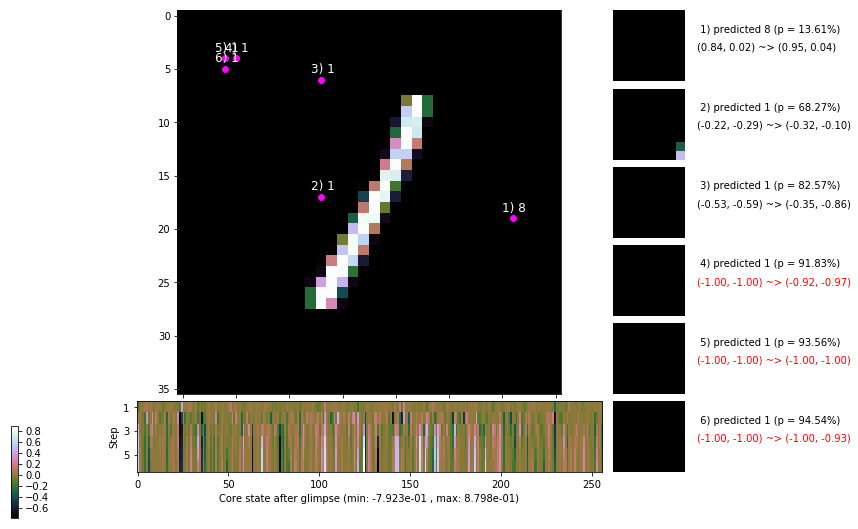

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 5 | Discounted rewards: [2.195, 2.439, 2.710, 1.900, 1.000, 0.000]


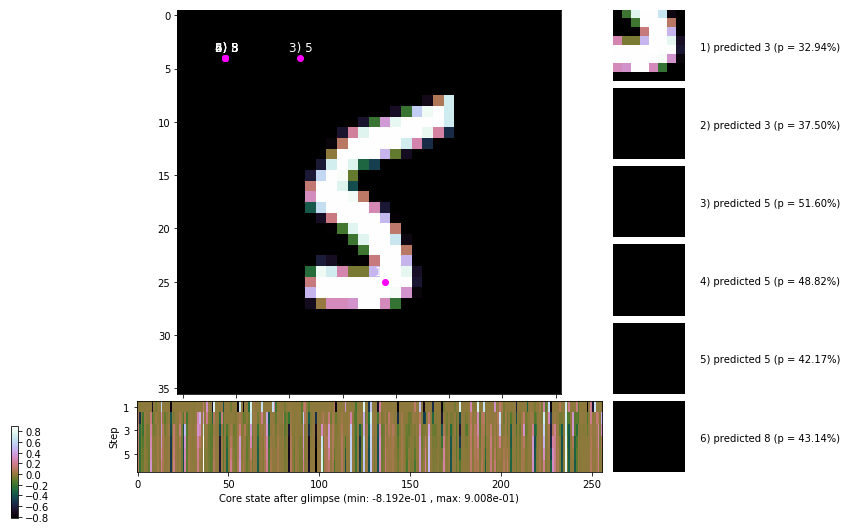


	Target class: 7 | Discounted rewards: [3.686, 4.095, 3.439, 2.710, 1.900, 1.000]


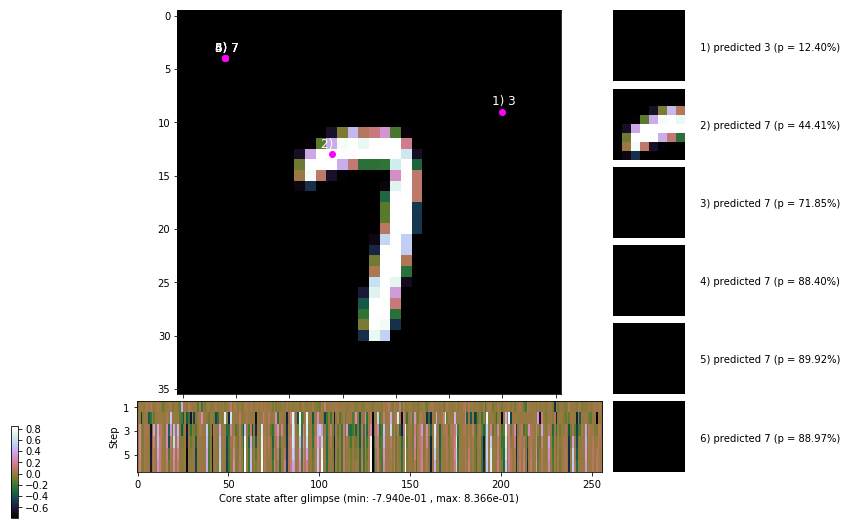

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


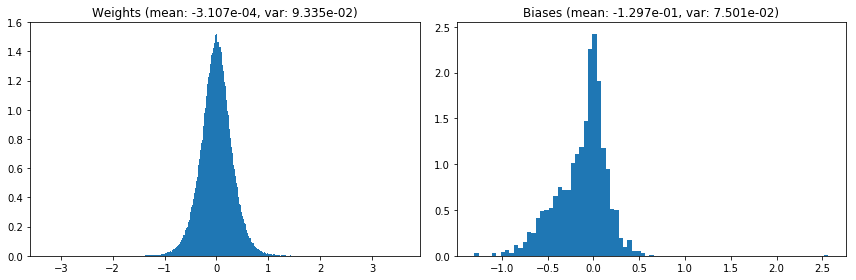

                                      Location network weights and biases


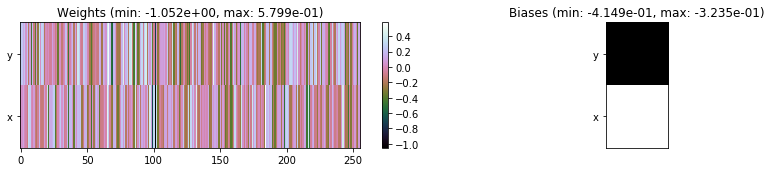

---------------------------------------------------------------------------------------------------------------
Elapsed time:  470.45 sec | TRAIN >> class loss: 0.8144 | steps:  2.851 :( | reward:  3.5984 :( | acc.: 71.185% :(
                          | VAL   >> class loss: 0.7778 | steps:  2.774 :( | reward:  3.6748 :( | acc.: 71.800% :(


Epoch  72/400) lr = 0.0003445
 b    300/  3000 >> 148.3 ms/b | lr: 3.44e-04 | grad 2norm: 19.12 | grad inf norm:  5.944
         Weights || abs max:  3.58 ( 8450.13) | mean: -3.04e-04 ( 0.02) | var: 9.34e-02 (26864.40)
          Biases || abs max:  2.57 ( 3369.99) | mean: -1.29e-01 ( 1.38) | var: 7.49e-02 (1199142.12)
                    class loss: 0.803 | steps: 2.824 | reward:  3.625 | acc.: 71.35%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 152.2 ms/b | lr: 3.44e-04 | grad 2norm: 18.86 | grad inf norm:  5.755
         Weights || abs max:  3.58 ( 1401.48) | mean: -3.06e-04

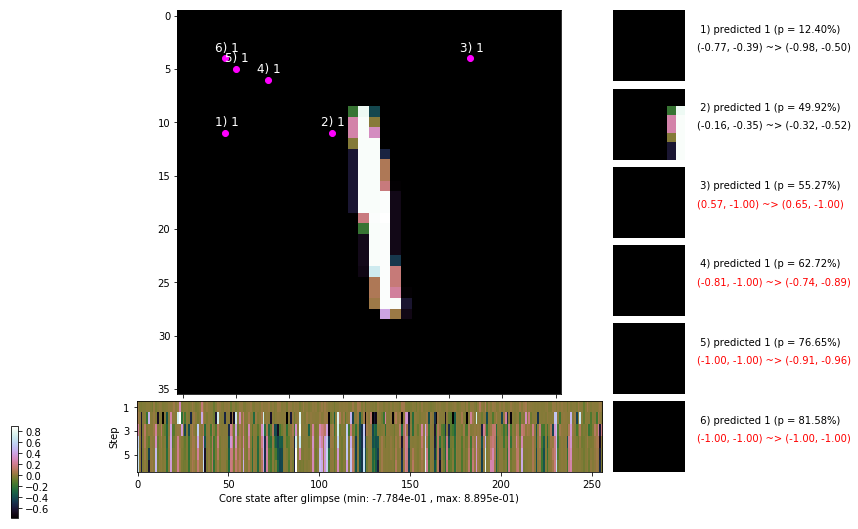

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 154.0 ms/b | lr: 3.43e-04 | grad 2norm: 18.79 | grad inf norm:  5.814
         Weights || abs max:  3.58 ( 1778.10) | mean: -3.12e-04 ( 0.01) | var: 9.34e-02 (  204.17)
          Biases || abs max:  2.57 (   58.06) | mean: -1.29e-01 ( 0.07) | var: 7.47e-02 (   13.11)
                    class loss: 0.765 | steps: 2.800 | reward:  3.690 | acc.: 73.42%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 152.0 ms/b | lr: 3.43e-04 | grad 2norm: 18.62 | grad inf norm:  5.338
         Weights || abs max:  3.58 ( 1195.06) | mean: -3.08e-04 ( 0.01) | var: 9.35e-02 (   52.27)
          Biases || abs max:  2.57 (  166.26) | mean: -1.29e-01 ( 0.11) | var: 7.48e-02 (  885.44)
                    class loss: 0.777 | steps: 2.815 | reward:  3.657 | acc.: 72.58%

	Target class: 2 | Discounted rewards: [4.686, 4.095, 3.4

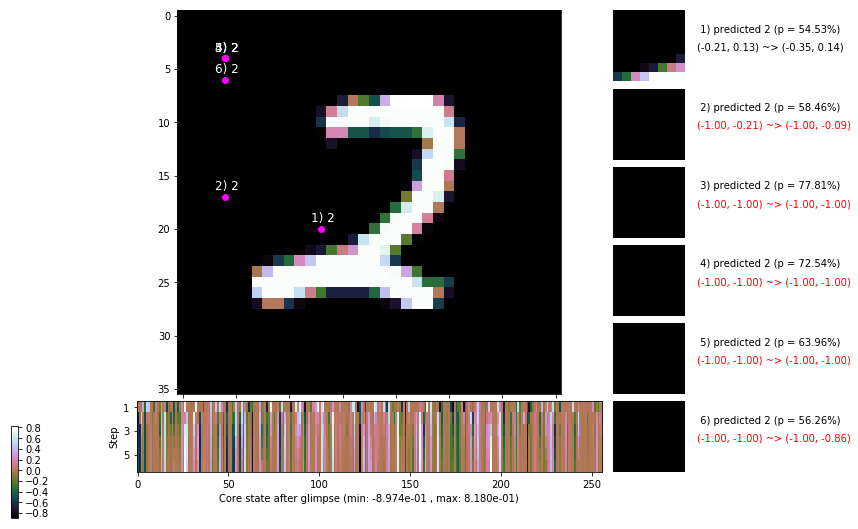

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 152.2 ms/b | lr: 3.42e-04 | grad 2norm: 18.99 | grad inf norm:  5.724
         Weights || abs max:  3.58 ( 1352.08) | mean: -2.98e-04 ( 0.01) | var: 9.35e-02 (   23.54)
          Biases || abs max:  2.57 (  114.98) | mean: -1.30e-01 ( 0.11) | var: 7.49e-02 (  294.93)
                    class loss: 0.781 | steps: 2.783 | reward:  3.687 | acc.: 72.85%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 151.6 ms/b | lr: 3.42e-04 | grad 2norm: 18.86 | grad inf norm:  5.641
         Weights || abs max:  3.58 ( 1637.78) | mean: -2.86e-04 ( 0.01) | var: 9.35e-02 (  102.66)
          Biases || abs max:  2.58 (  606.25) | mean: -1.29e-01 ( 0.31) | var: 7.48e-02 (20751.41)
                    class loss: 0.791 | steps: 2.828 | reward:  3.616 | acc.: 71.93%

	Target class: 3 | Discounted rewards: [3.686, 4.095, 3.4

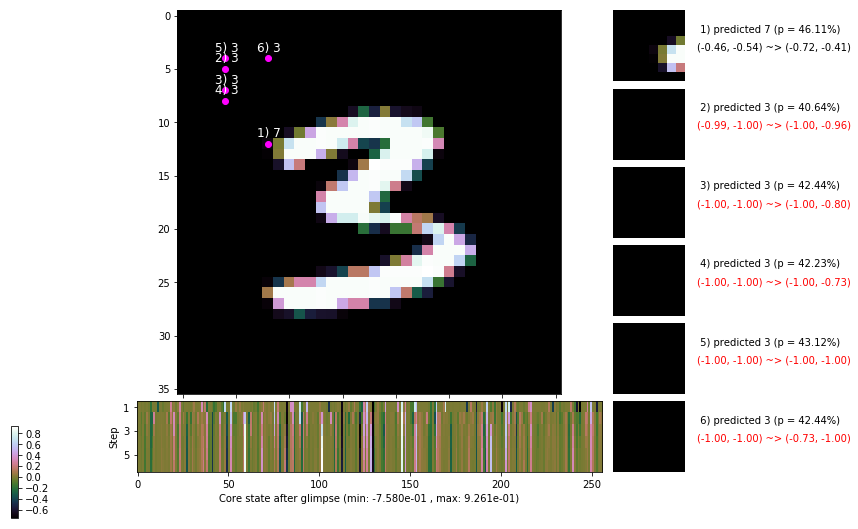

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 160.0 ms/b | lr: 3.41e-04 | grad 2norm: 18.71 | grad inf norm:  5.549
         Weights || abs max:  3.58 ( 2050.56) | mean: -2.88e-04 ( 0.01) | var: 9.36e-02 (  144.64)
          Biases || abs max:  2.58 (  199.89) | mean: -1.29e-01 ( 0.14) | var: 7.49e-02 (  530.25)
                    class loss: 0.782 | steps: 2.815 | reward:  3.643 | acc.: 72.13%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 159.5 ms/b | lr: 3.41e-04 | grad 2norm: 18.74 | grad inf norm:  5.621
         Weights || abs max:  3.58 ( 1228.09) | mean: -3.06e-04 ( 0.01) | var: 9.36e-02 (   67.71)
          Biases || abs max:  2.57 (  168.55) | mean: -1.29e-01 ( 0.13) | var: 7.50e-02 (  578.46)
                    class loss: 0.778 | steps: 2.817 | reward:  3.650 | acc.: 72.48%

	Target class: 0 | Discounted rewards: [4.686, 4.095, 3.4

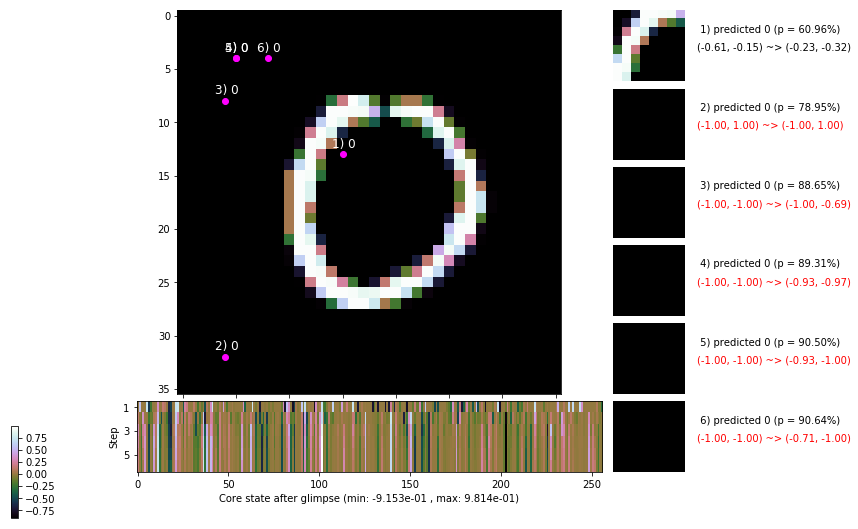

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 169.3 ms/b | lr: 3.40e-04 | grad 2norm: 18.82 | grad inf norm:  5.692
         Weights || abs max:  3.58 ( 1551.69) | mean: -3.03e-04 ( 0.01) | var: 9.36e-02 (  250.06)
          Biases || abs max:  2.58 (  272.84) | mean: -1.29e-01 ( 0.19) | var: 7.50e-02 (  613.09)
                    class loss: 0.756 | steps: 2.789 | reward:  3.705 | acc.: 73.35%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 163.7 ms/b | lr: 3.40e-04 | grad 2norm: 19.05 | grad inf norm:  5.998
         Weights || abs max:  3.58 ( 1466.49) | mean: -3.07e-04 ( 0.01) | var: 9.36e-02 (   31.94)
          Biases || abs max:  2.58 (   78.92) | mean: -1.29e-01 ( 0.09) | var: 7.51e-02 (   22.96)
                    class loss: 0.785 | steps: 2.838 | reward:  3.656 | acc.: 72.60%

	Target class: 2 | Discounted rewards: [0.000, 0.000, 0.0

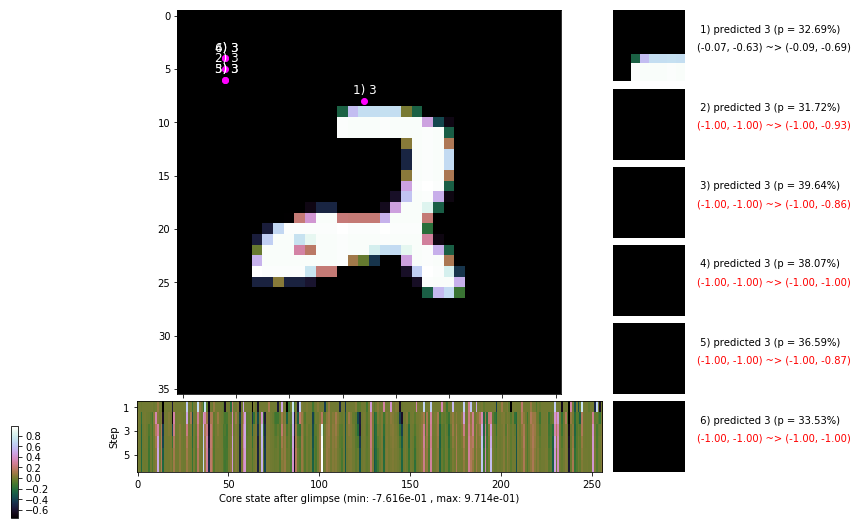

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 0 | Discounted rewards: [2.976, 2.195, 2.439, 2.710, 1.900, 1.000]


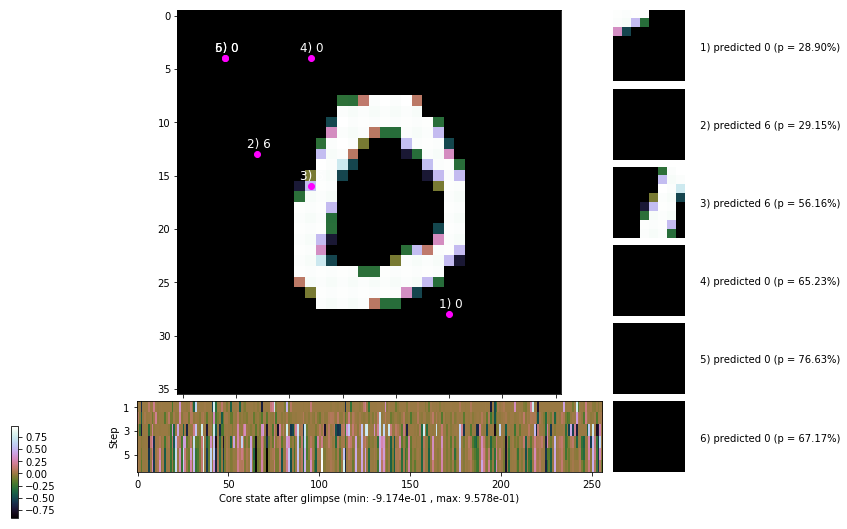


	Target class: 6 | Discounted rewards: [4.686, 4.095, 3.439, 2.710, 1.900, 1.000]


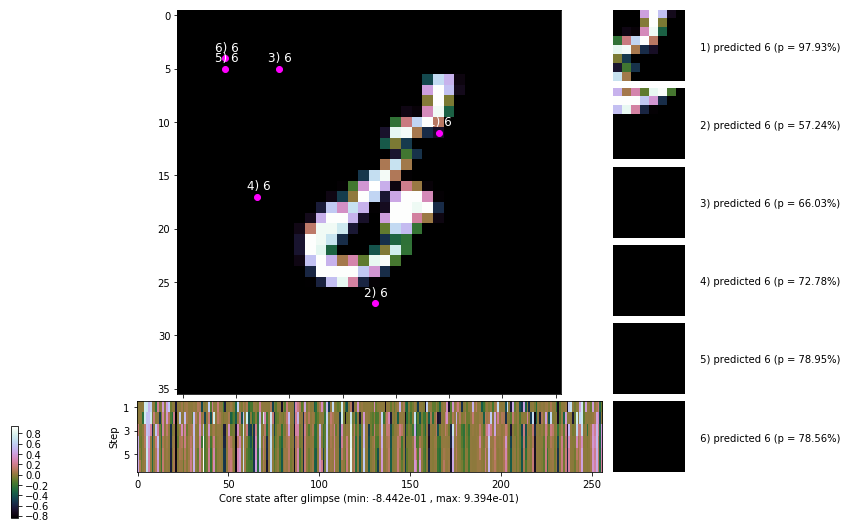

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


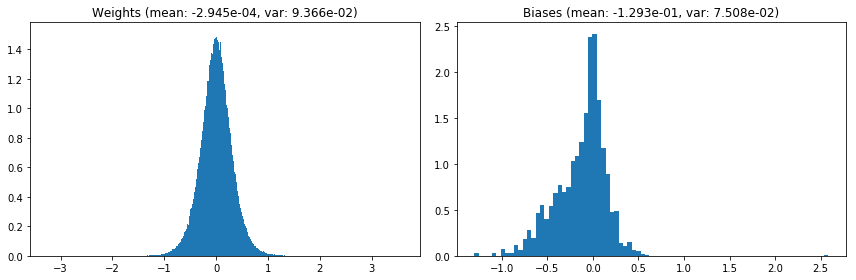

                                      Location network weights and biases


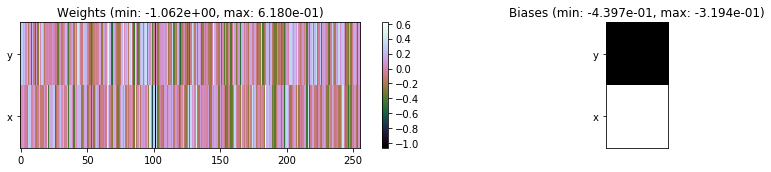

---------------------------------------------------------------------------------------------------------------
Elapsed time:  469.72 sec | TRAIN >> class loss: 0.7841 | steps:  2.816    | reward:  3.6521    | acc.: 72.383% 
                          | VAL   >> class loss: 0.7762 | steps:  2.783 :( | reward:  3.7032 :( | acc.: 72.860% :(


Epoch  73/400) lr = 0.0003394
 b    300/  3000 >> 157.6 ms/b | lr: 3.39e-04 | grad 2norm: 19.08 | grad inf norm:  5.751
         Weights || abs max:  3.58 ( 4045.57) | mean: -2.93e-04 ( 0.01) | var: 9.37e-02 ( 1144.08)
          Biases || abs max:  2.59 (  108.90) | mean: -1.29e-01 ( 0.10) | var: 7.50e-02 (   32.05)
                    class loss: 0.776 | steps: 2.819 | reward:  3.659 | acc.: 72.55%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 159.0 ms/b | lr: 3.39e-04 | grad 2norm: 18.88 | grad inf norm:  5.721
         Weights || abs max:  3.57 ( 4837.81) | mean: -3.03e-04 ( 0

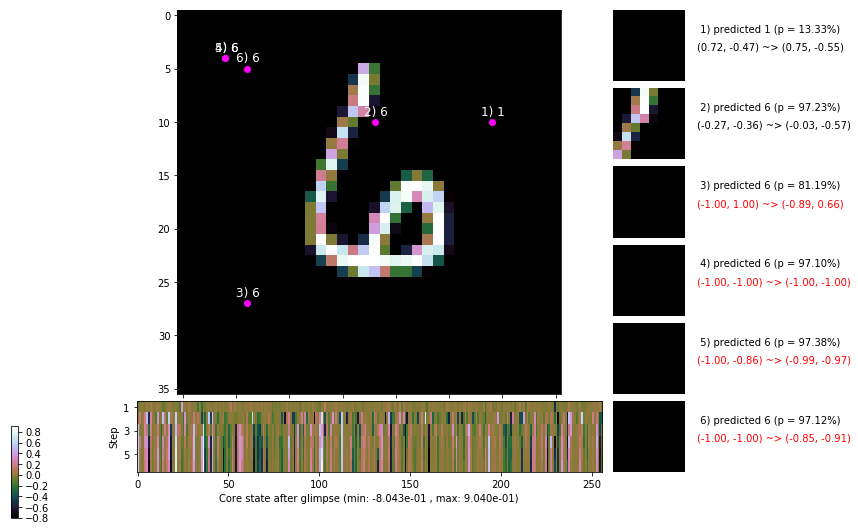

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 158.7 ms/b | lr: 3.38e-04 | grad 2norm: 18.62 | grad inf norm:  5.574
         Weights || abs max:  3.57 ( 2747.69) | mean: -3.09e-04 ( 0.01) | var: 9.37e-02 (  613.59)
          Biases || abs max:  2.59 (  103.18) | mean: -1.29e-01 ( 0.10) | var: 7.51e-02 (   87.30)
                    class loss: 0.777 | steps: 2.808 | reward:  3.679 | acc.: 73.08%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 158.6 ms/b | lr: 3.38e-04 | grad 2norm: 19.09 | grad inf norm:  5.717
         Weights || abs max:  3.58 ( 3456.88) | mean: -3.20e-04 ( 0.01) | var: 9.37e-02 (  534.05)
          Biases || abs max:  2.58 (  948.44) | mean: -1.29e-01 ( 0.43) | var: 7.53e-02 (74406.95)
                    class loss: 0.801 | steps: 2.833 | reward:  3.604 | acc.: 71.28%

	Target class: 4 | Discounted rewards: [4.686, 4.095, 3.4

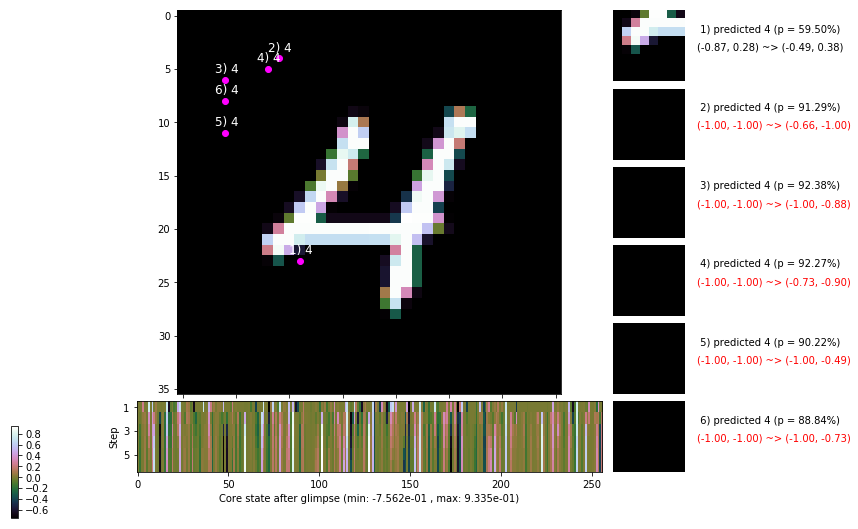

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 160.8 ms/b | lr: 3.37e-04 | grad 2norm: 18.99 | grad inf norm:  5.706
         Weights || abs max:  3.58 ( 2155.79) | mean: -3.09e-04 ( 0.01) | var: 9.38e-02 (  445.18)
          Biases || abs max:  2.58 (   96.61) | mean: -1.29e-01 ( 0.10) | var: 7.52e-02 (   83.18)
                    class loss: 0.784 | steps: 2.829 | reward:  3.630 | acc.: 72.33%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 156.4 ms/b | lr: 3.37e-04 | grad 2norm: 18.56 | grad inf norm:  5.565
         Weights || abs max:  3.58 ( 3200.51) | mean: -3.02e-04 ( 0.01) | var: 9.38e-02 (  802.20)
          Biases || abs max:  2.58 (  115.60) | mean: -1.29e-01 ( 0.12) | var: 7.53e-02 (   80.49)
                    class loss: 0.831 | steps: 2.897 | reward:  3.556 | acc.: 70.50%

	Target class: 1 | Discounted rewards: [3.876, 3.195, 2.4

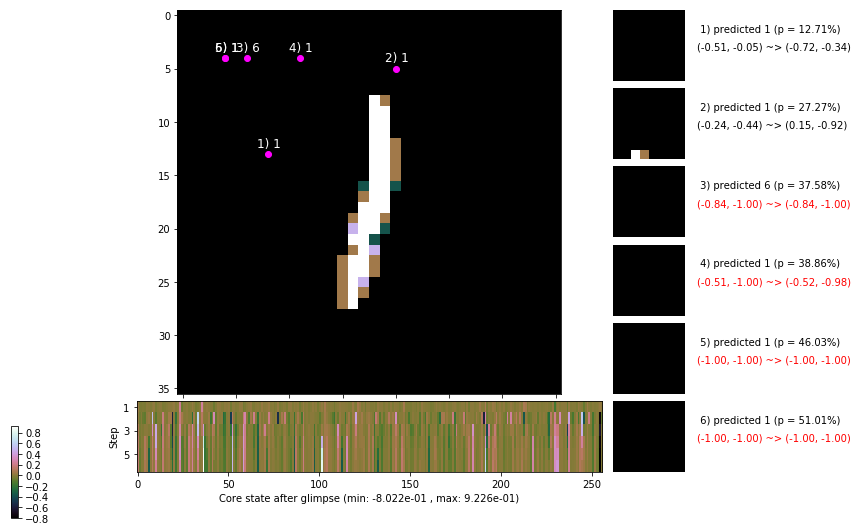

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 158.5 ms/b | lr: 3.36e-04 | grad 2norm: 18.87 | grad inf norm:  5.784
         Weights || abs max:  3.58 ( 2813.87) | mean: -3.05e-04 ( 0.01) | var: 9.38e-02 (  464.85)
          Biases || abs max:  2.57 (  232.67) | mean: -1.30e-01 ( 0.16) | var: 7.53e-02 (  899.47)
                    class loss: 0.817 | steps: 2.859 | reward:  3.583 | acc.: 71.02%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 155.7 ms/b | lr: 3.36e-04 | grad 2norm: 18.53 | grad inf norm:  5.693
         Weights || abs max:  3.58 ( 3489.31) | mean: -3.12e-04 ( 0.01) | var: 9.39e-02 ( 1580.47)
          Biases || abs max:  2.57 (  136.66) | mean: -1.30e-01 ( 0.13) | var: 7.53e-02 (  225.33)
                    class loss: 0.796 | steps: 2.859 | reward:  3.595 | acc.: 71.50%

	Target class: 4 | Discounted rewards: [0.000, 0.000, 0.0

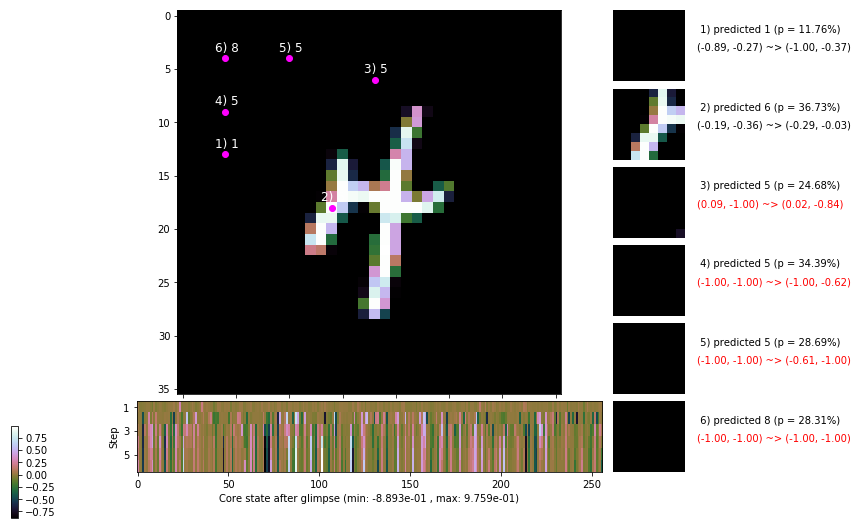

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 157.7 ms/b | lr: 3.35e-04 | grad 2norm: 19.06 | grad inf norm:  6.017
         Weights || abs max:  3.58 ( 2463.03) | mean: -2.92e-04 ( 0.01) | var: 9.39e-02 ( 1006.83)
          Biases || abs max:  2.57 (  123.21) | mean: -1.30e-01 ( 0.12) | var: 7.51e-02 (   42.48)
                    class loss: 0.838 | steps: 2.886 | reward:  3.551 | acc.: 69.90%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 158.9 ms/b | lr: 3.35e-04 | grad 2norm: 18.69 | grad inf norm:  5.934
         Weights || abs max:  3.58 ( 5639.44) | mean: -2.85e-04 ( 0.01) | var: 9.39e-02 ( 9538.66)
          Biases || abs max:  2.57 (  141.92) | mean: -1.30e-01 ( 0.12) | var: 7.50e-02 (  211.18)
                    class loss: 0.803 | steps: 2.853 | reward:  3.625 | acc.: 71.57%

	Target class: 3 | Discounted rewards: [1.976, 2.195, 2.4

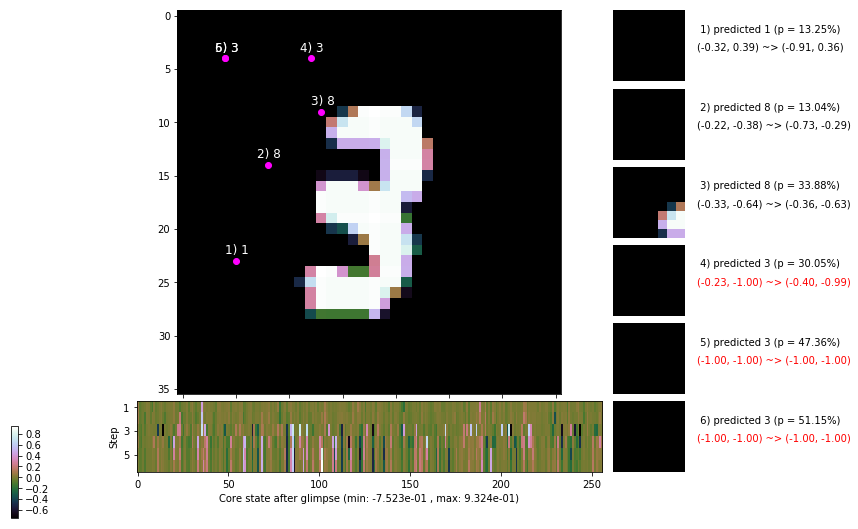

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 3 | Discounted rewards: [0.000, 0.000, 0.000, 0.000, 0.000, 0.000]


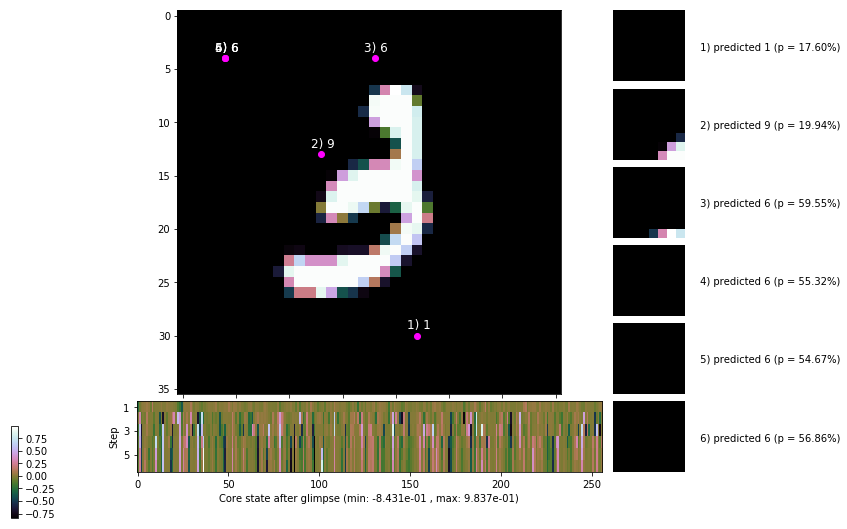


	Target class: 9 | Discounted rewards: [3.686, 4.095, 3.439, 2.710, 1.900, 1.000]


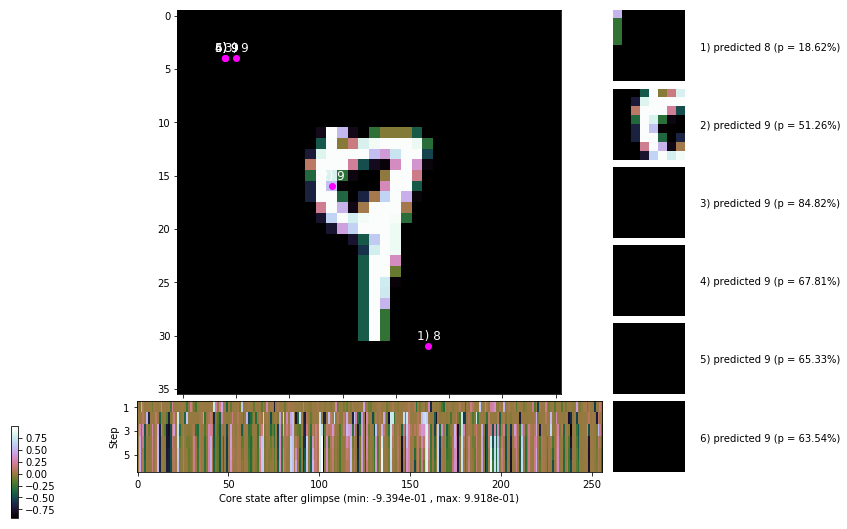

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


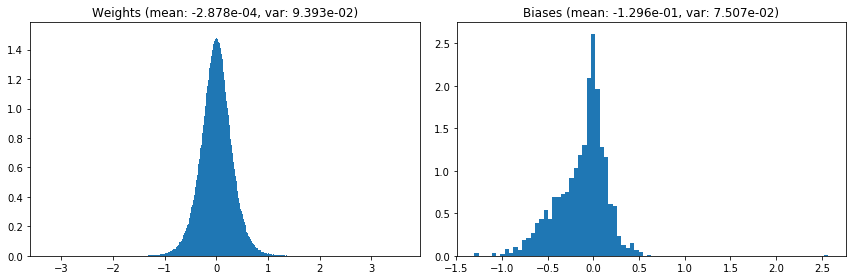

                                      Location network weights and biases


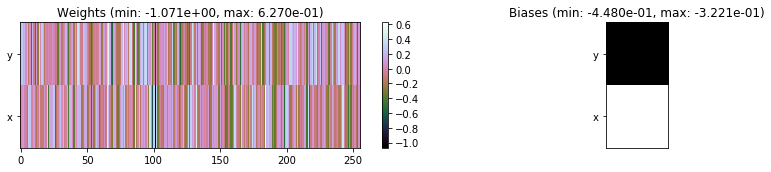

---------------------------------------------------------------------------------------------------------------
Elapsed time:  475.16 sec | TRAIN >> class loss: 0.8033 | steps:  2.847 :( | reward:  3.6088 :( | acc.: 71.507% :(
                          | VAL   >> class loss: 0.7903 | steps:  2.786 :( | reward:  3.6730 :( | acc.: 71.900% :(


Epoch  74/400) lr = 0.0003344
 b    300/  3000 >> 159.9 ms/b | lr: 3.34e-04 | grad 2norm: 18.92 | grad inf norm:  6.003
         Weights || abs max:  3.59 (  957.59) | mean: -3.10e-04 ( 0.01) | var: 9.39e-02 (   18.29)
          Biases || abs max:  2.57 (  228.71) | mean: -1.30e-01 ( 0.18) | var: 7.51e-02 (  372.03)
                    class loss: 0.806 | steps: 2.865 | reward:  3.592 | acc.: 71.73%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 164.4 ms/b | lr: 3.34e-04 | grad 2norm: 19.08 | grad inf norm:  6.109
         Weights || abs max:  3.59 ( 1345.57) | mean: -3.19e-04 (

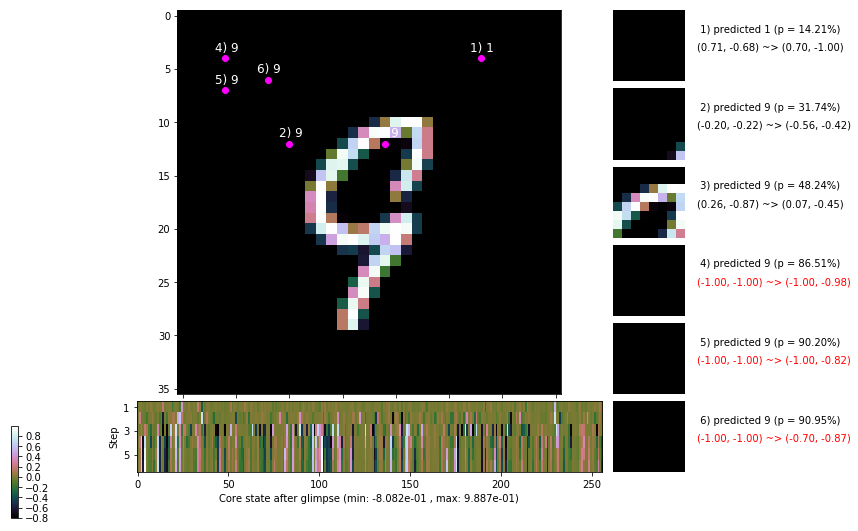

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 169.0 ms/b | lr: 3.33e-04 | grad 2norm: 18.50 | grad inf norm:  5.563
         Weights || abs max:  3.58 ( 4413.12) | mean: -2.95e-04 ( 0.01) | var: 9.40e-02 ( 5188.73)
          Biases || abs max:  2.57 (  150.55) | mean: -1.30e-01 ( 0.13) | var: 7.51e-02 (  191.68)
                    class loss: 0.774 | steps: 2.827 | reward:  3.643 | acc.: 72.33%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 164.3 ms/b | lr: 3.33e-04 | grad 2norm: 18.97 | grad inf norm:  5.696
         Weights || abs max:  3.58 ( 2558.10) | mean: -2.95e-04 ( 0.01) | var: 9.40e-02 (  235.92)
          Biases || abs max:  2.58 (  197.90) | mean: -1.30e-01 ( 0.14) | var: 7.51e-02 (  637.79)
                    class loss: 0.797 | steps: 2.818 | reward:  3.628 | acc.: 71.87%

	Target class: 4 | Discounted rewards: [1.900, 1.000, 0.0

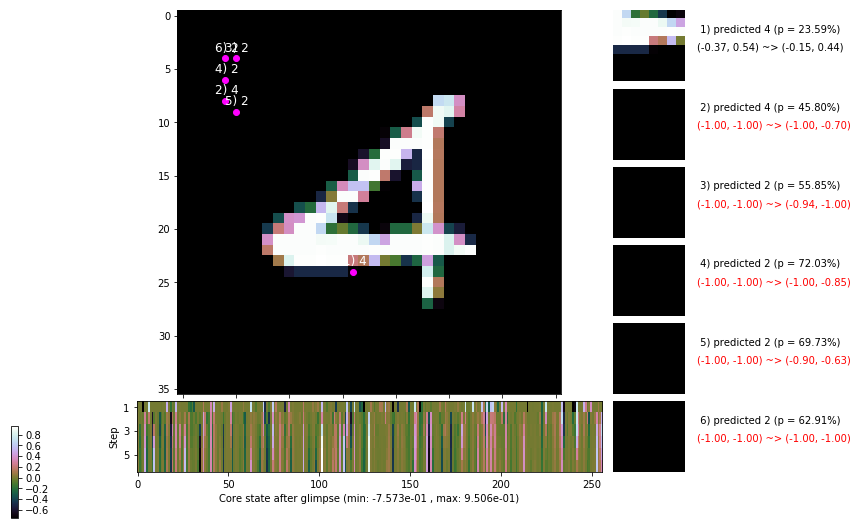

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 161.9 ms/b | lr: 3.32e-04 | grad 2norm: 18.74 | grad inf norm:  5.458
         Weights || abs max:  3.59 ( 1495.61) | mean: -2.88e-04 ( 0.01) | var: 9.40e-02 (  132.14)
          Biases || abs max:  2.58 (  107.41) | mean: -1.30e-01 ( 0.11) | var: 7.52e-02 (   70.45)
                    class loss: 0.776 | steps: 2.845 | reward:  3.634 | acc.: 72.25%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 156.4 ms/b | lr: 3.32e-04 | grad 2norm: 18.58 | grad inf norm:  5.579
         Weights || abs max:  3.59 ( 1642.19) | mean: -2.86e-04 ( 0.01) | var: 9.41e-02 (  133.77)
          Biases || abs max:  2.58 (  373.47) | mean: -1.30e-01 ( 0.30) | var: 7.53e-02 ( 9069.46)
                    class loss: 0.789 | steps: 2.822 | reward:  3.647 | acc.: 71.93%

	Target class: 1 | Discounted rewards: [4.686, 4.095, 3.4

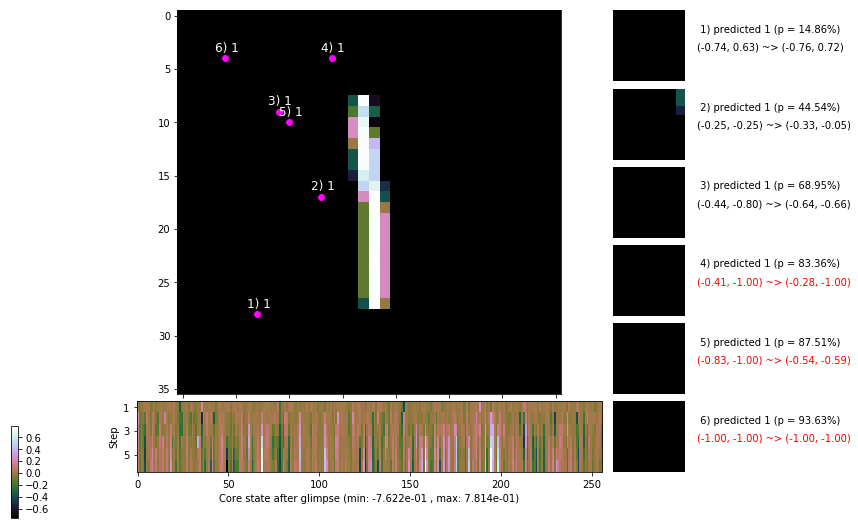

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 159.9 ms/b | lr: 3.31e-04 | grad 2norm: 18.87 | grad inf norm:  5.620
         Weights || abs max:  3.60 (  888.33) | mean: -2.88e-04 ( 0.01) | var: 9.41e-02 (   13.28)
          Biases || abs max:  2.58 (  531.45) | mean: -1.30e-01 ( 0.28) | var: 7.54e-02 ( 7520.05)
                    class loss: 0.786 | steps: 2.827 | reward:  3.650 | acc.: 72.27%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 155.9 ms/b | lr: 3.31e-04 | grad 2norm: 19.07 | grad inf norm:  5.934
         Weights || abs max:  3.60 ( 1224.84) | mean: -3.00e-04 ( 0.01) | var: 9.41e-02 (   34.05)
          Biases || abs max:  2.59 (  135.06) | mean: -1.30e-01 ( 0.11) | var: 7.55e-02 (  204.59)
                    class loss: 0.788 | steps: 2.843 | reward:  3.638 | acc.: 72.15%

	Target class: 3 | Discounted rewards: [2.786, 3.095, 3.4

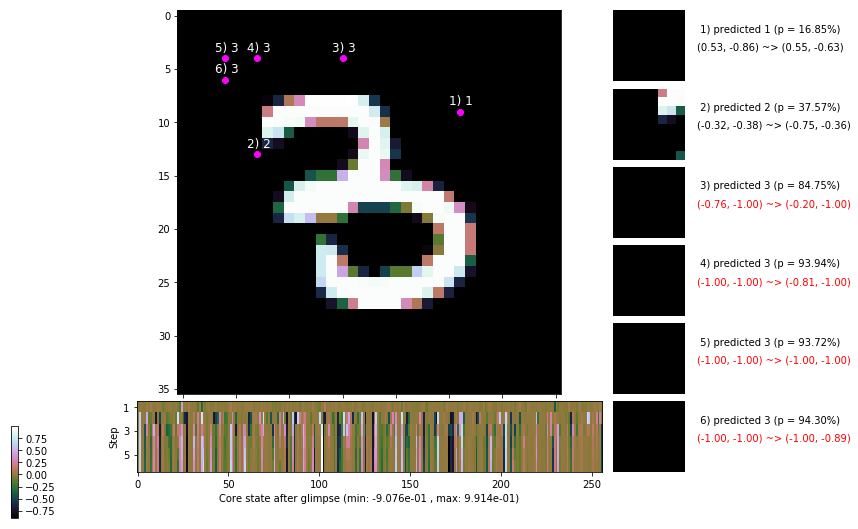

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 158.0 ms/b | lr: 3.30e-04 | grad 2norm: 18.93 | grad inf norm:  5.674
         Weights || abs max:  3.60 ( 1136.00) | mean: -3.09e-04 ( 0.01) | var: 9.41e-02 (   16.43)
          Biases || abs max:  2.58 (  128.48) | mean: -1.30e-01 ( 0.12) | var: 7.55e-02 (  200.85)
                    class loss: 0.802 | steps: 2.874 | reward:  3.583 | acc.: 70.72%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 153.7 ms/b | lr: 3.30e-04 | grad 2norm: 18.63 | grad inf norm:  5.849
         Weights || abs max:  3.60 (  891.52) | mean: -3.13e-04 ( 0.01) | var: 9.42e-02 (   10.09)
          Biases || abs max:  2.58 ( 6484.12) | mean: -1.30e-01 ( 2.60) | var: 7.55e-02 (4567195.00)
                    class loss: 0.809 | steps: 2.851 | reward:  3.608 | acc.: 71.08%

	Target class: 3 | Discounted rewards: [4.686, 4.095, 3

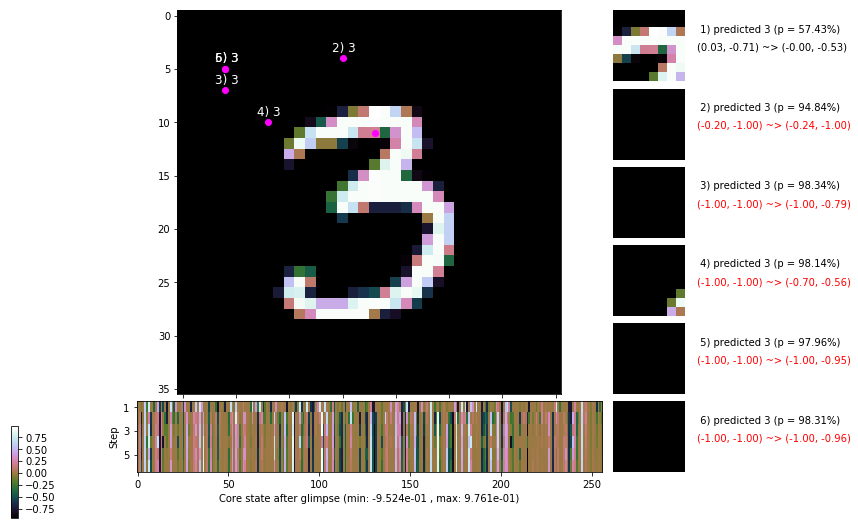

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 3 | Discounted rewards: [3.786, 3.095, 3.439, 2.710, 1.900, 1.000]


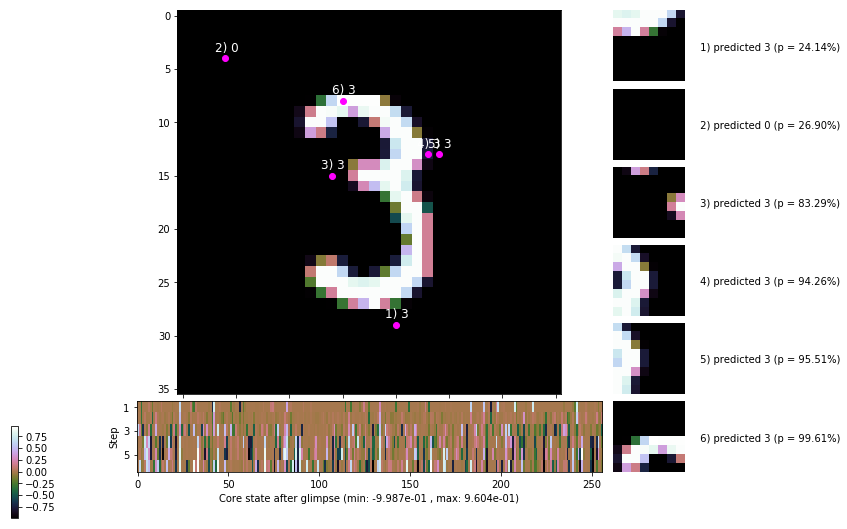


	Target class: 7 | Discounted rewards: [2.786, 3.095, 3.439, 2.710, 1.900, 1.000]


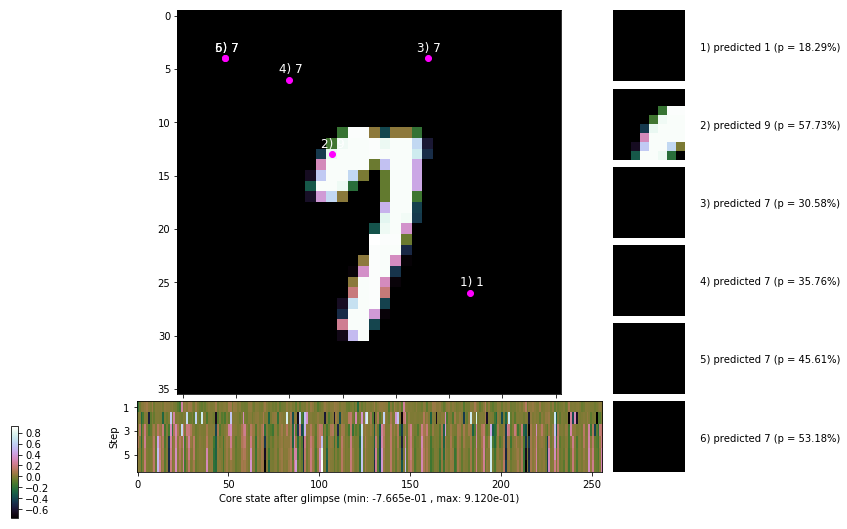

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


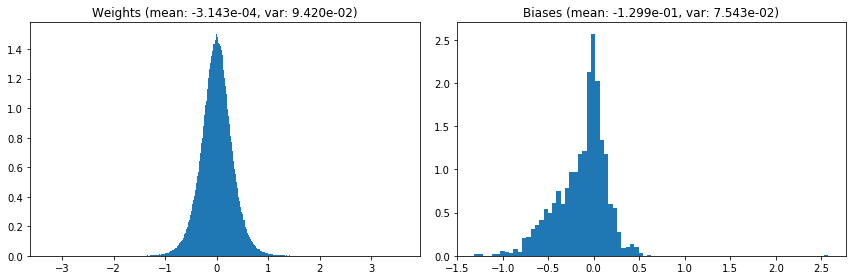

                                      Location network weights and biases


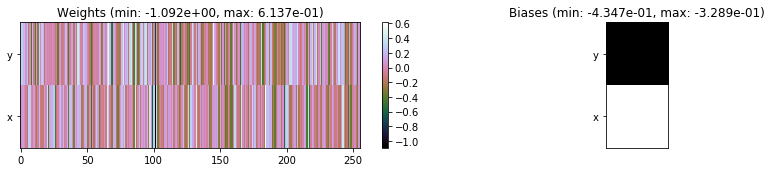

---------------------------------------------------------------------------------------------------------------
Elapsed time:  481.86 sec | TRAIN >> class loss: 0.7967 | steps:  2.846 :( | reward:  3.6185 :( | acc.: 71.662% :(
                          | VAL   >> class loss: 0.7770 | steps:  2.769 :( | reward:  3.6998 :( | acc.: 72.120% :(


Epoch  75/400) lr = 0.0003294
 b    300/  3000 >> 147.2 ms/b | lr: 3.29e-04 | grad 2norm: 18.98 | grad inf norm:  5.744
         Weights || abs max:  3.60 ( 1502.45) | mean: -2.99e-04 ( 0.01) | var: 9.42e-02 (   42.03)
          Biases || abs max:  2.58 (  189.85) | mean: -1.30e-01 ( 0.15) | var: 7.55e-02 (  226.80)
                    class loss: 0.815 | steps: 2.861 | reward:  3.589 | acc.: 70.78%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 150.6 ms/b | lr: 3.29e-04 | grad 2norm: 18.66 | grad inf norm:  5.675
         Weights || abs max:  3.59 ( 3783.05) | mean: -2.82e-04 (

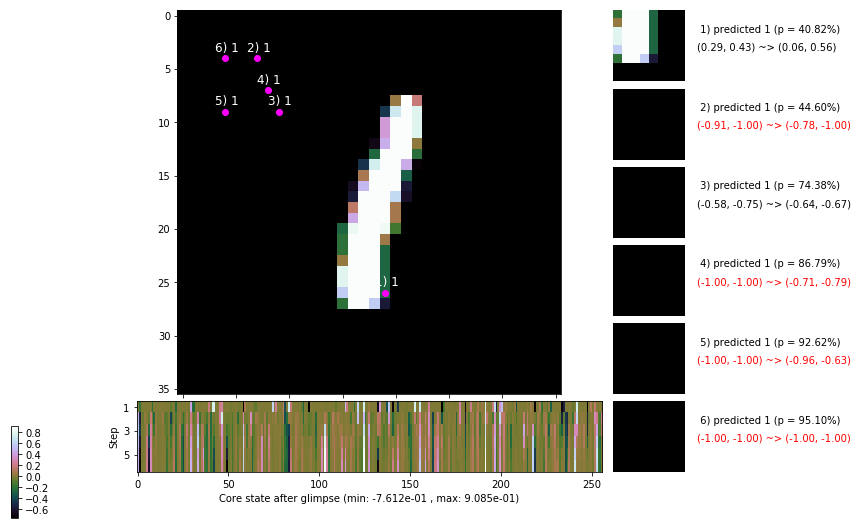

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 150.9 ms/b | lr: 3.28e-04 | grad 2norm: 18.43 | grad inf norm:  5.565
         Weights || abs max:  3.60 ( 1609.95) | mean: -2.74e-04 ( 0.01) | var: 9.43e-02 (   66.77)
          Biases || abs max:  2.57 (  134.29) | mean: -1.30e-01 ( 0.11) | var: 7.55e-02 (  100.79)
                    class loss: 0.837 | steps: 2.873 | reward:  3.580 | acc.: 70.98%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 151.3 ms/b | lr: 3.28e-04 | grad 2norm: 18.85 | grad inf norm:  5.700
         Weights || abs max:  3.59 ( 2328.89) | mean: -2.65e-04 ( 0.01) | var: 9.43e-02 (  325.10)
          Biases || abs max:  2.57 (  127.02) | mean: -1.30e-01 ( 0.12) | var: 7.55e-02 (   68.44)
                    class loss: 0.831 | steps: 2.916 | reward:  3.540 | acc.: 70.23%

	Target class: 8 | Discounted rewards: [2.786, 3.095, 3.4

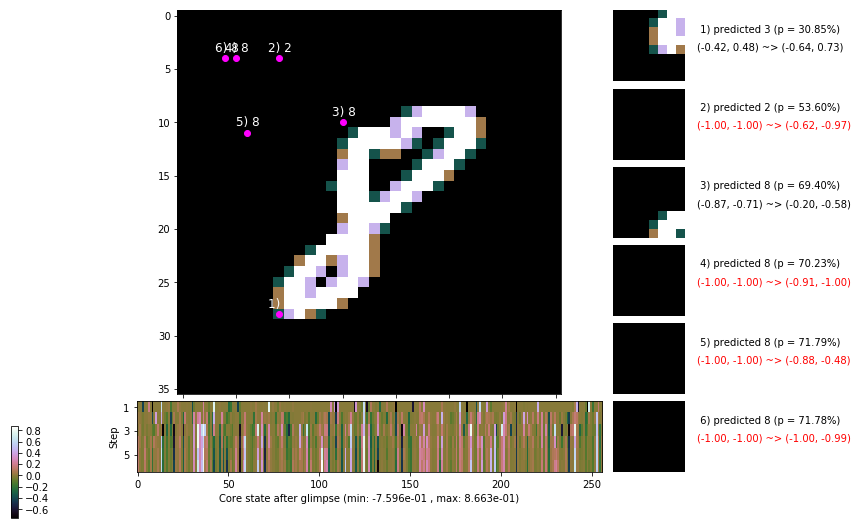

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 151.0 ms/b | lr: 3.27e-04 | grad 2norm: 18.38 | grad inf norm:  5.503
         Weights || abs max:  3.59 ( 2074.18) | mean: -2.41e-04 ( 0.01) | var: 9.43e-02 (  249.74)
          Biases || abs max:  2.57 (  201.51) | mean: -1.30e-01 ( 0.16) | var: 7.55e-02 (  347.55)
                    class loss: 0.825 | steps: 2.831 | reward:  3.613 | acc.: 70.88%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 149.3 ms/b | lr: 3.27e-04 | grad 2norm: 19.08 | grad inf norm:  6.106
         Weights || abs max:  3.60 ( 1247.87) | mean: -2.46e-04 ( 0.01) | var: 9.43e-02 (   37.78)
          Biases || abs max:  2.56 (   94.56) | mean: -1.30e-01 ( 0.11) | var: 7.56e-02 (   45.96)
                    class loss: 0.871 | steps: 2.879 | reward:  3.559 | acc.: 69.88%

	Target class: 3 | Discounted rewards: [2.876, 3.195, 2.4

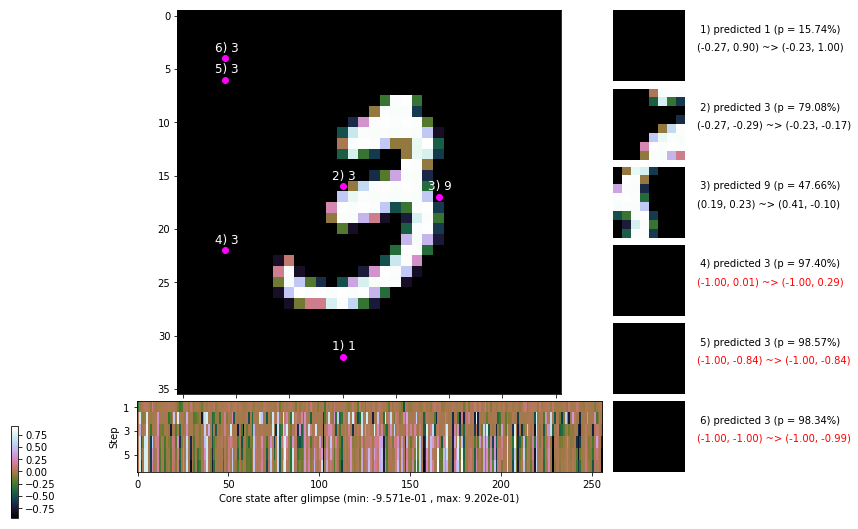

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 147.8 ms/b | lr: 3.26e-04 | grad 2norm: 18.60 | grad inf norm:  5.470
         Weights || abs max:  3.60 ( 2056.03) | mean: -2.45e-04 ( 0.01) | var: 9.44e-02 (  220.79)
          Biases || abs max:  2.56 (   97.59) | mean: -1.30e-01 ( 0.10) | var: 7.56e-02 (   35.55)
                    class loss: 0.818 | steps: 2.892 | reward:  3.570 | acc.: 71.22%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 145.5 ms/b | lr: 3.26e-04 | grad 2norm: 18.73 | grad inf norm:  5.665
         Weights || abs max:  3.61 ( 2726.51) | mean: -2.33e-04 ( 0.01) | var: 9.44e-02 ( 1122.19)
          Biases || abs max:  2.56 (  283.25) | mean: -1.30e-01 ( 0.17) | var: 7.54e-02 ( 2331.65)
                    class loss: 0.791 | steps: 2.809 | reward:  3.648 | acc.: 71.98%

	Target class: 6 | Discounted rewards: [0.900, 1.000, 0.0

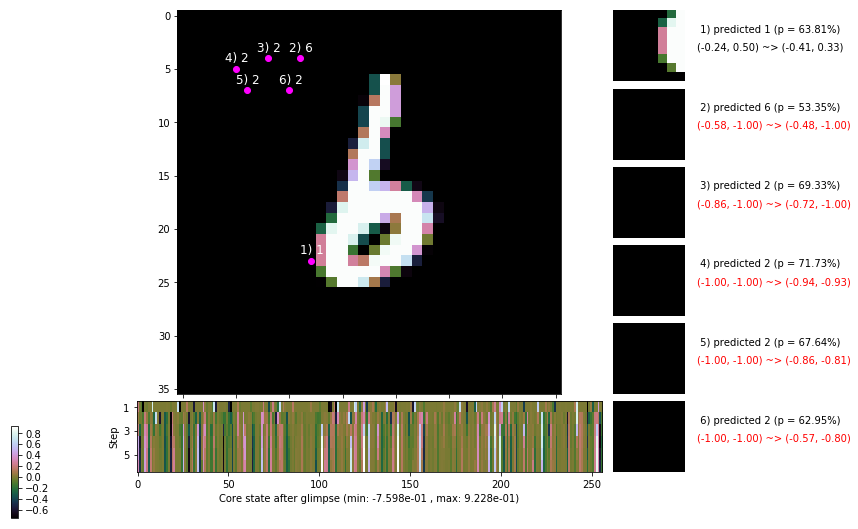

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 150.7 ms/b | lr: 3.25e-04 | grad 2norm: 18.95 | grad inf norm:  5.991
         Weights || abs max:  3.61 ( 1754.34) | mean: -2.21e-04 ( 0.01) | var: 9.44e-02 (  103.42)
          Biases || abs max:  2.56 (  158.08) | mean: -1.30e-01 ( 0.12) | var: 7.55e-02 (  157.56)
                    class loss: 0.778 | steps: 2.840 | reward:  3.631 | acc.: 72.00%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 152.8 ms/b | lr: 3.25e-04 | grad 2norm: 18.55 | grad inf norm:  5.288
         Weights || abs max:  3.61 ( 1781.67) | mean: -2.21e-04 ( 0.01) | var: 9.45e-02 (   83.49)
          Biases || abs max:  2.56 (  134.31) | mean: -1.30e-01 ( 0.12) | var: 7.55e-02 (   96.91)
                    class loss: 0.829 | steps: 2.857 | reward:  3.573 | acc.: 70.22%

	Target class: 9 | Discounted rewards: [2.786, 3.095, 3.4

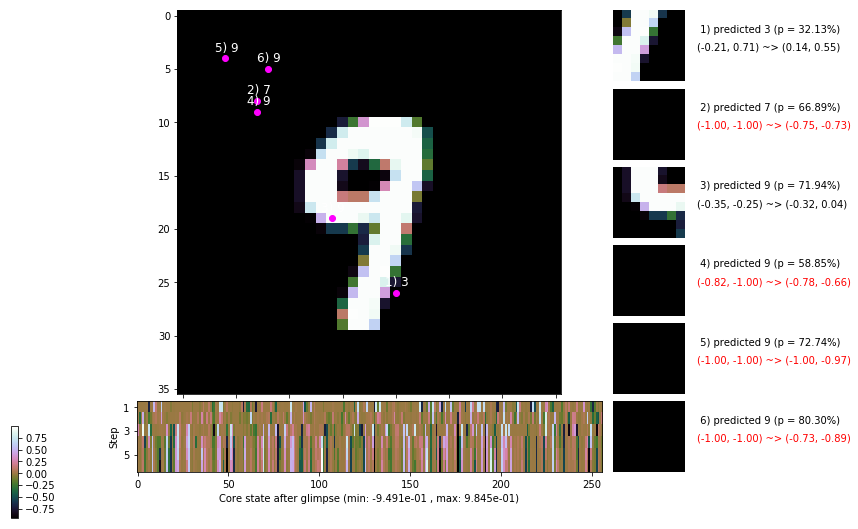

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 7 | Discounted rewards: [3.686, 4.095, 3.439, 2.710, 1.900, 1.000]


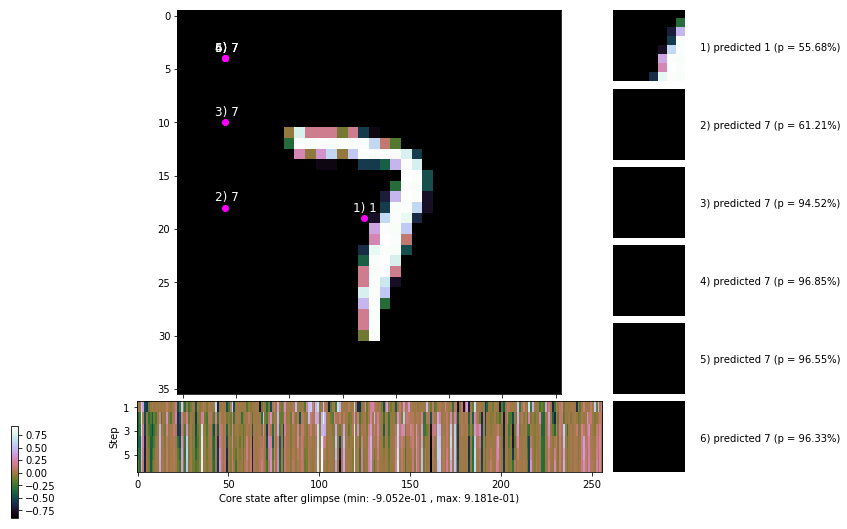


	Target class: 7 | Discounted rewards: [3.686, 4.095, 3.439, 2.710, 1.900, 1.000]


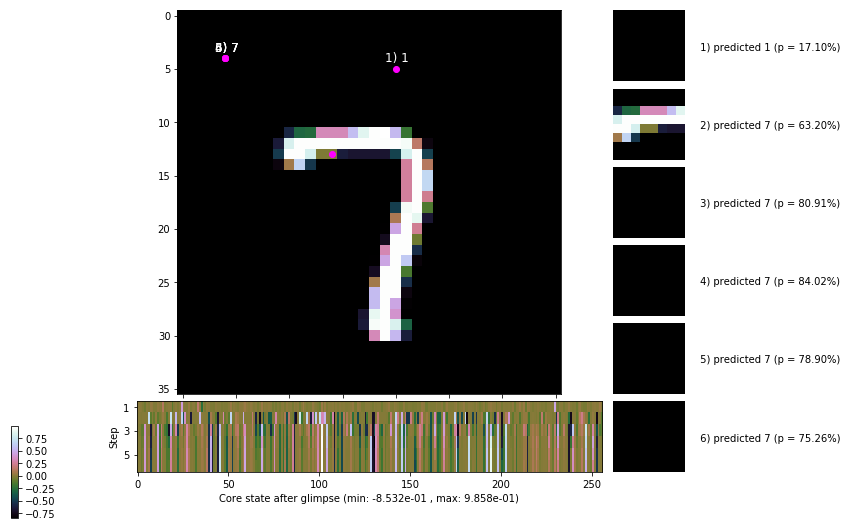

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


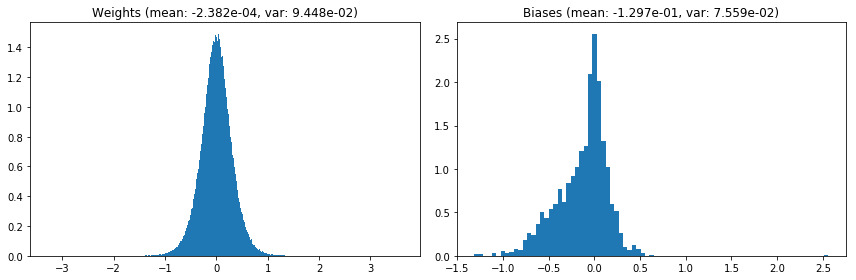

                                      Location network weights and biases


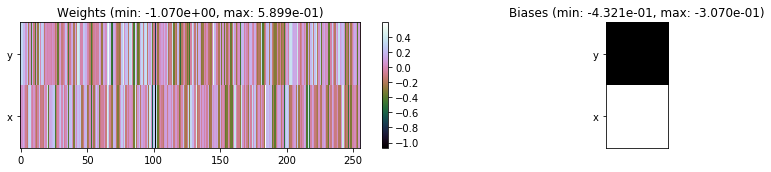

---------------------------------------------------------------------------------------------------------------
Elapsed time:  449.71 sec | TRAIN >> class loss: 0.8223 | steps:  2.862 :( | reward:  3.5873 :( | acc.: 70.882% :(
                          | VAL   >> class loss: 0.7975 | steps:  2.745 :( | reward:  3.7064 :( | acc.: 72.240% :(


Epoch  76/400) lr = 0.0003245
 b    300/  3000 >> 165.4 ms/b | lr: 3.24e-04 | grad 2norm: 18.70 | grad inf norm:  5.817
         Weights || abs max:  3.60 ( 3258.24) | mean: -2.34e-04 ( 0.01) | var: 9.45e-02 ( 1252.21)
          Biases || abs max:  2.56 (  156.30) | mean: -1.30e-01 ( 0.14) | var: 7.56e-02 (  516.31)
                    class loss: 0.817 | steps: 2.845 | reward:  3.604 | acc.: 71.17%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 164.4 ms/b | lr: 3.24e-04 | grad 2norm: 18.66 | grad inf norm:  5.574
         Weights || abs max:  3.60 ( 1467.19) | mean: -2.24e-04 (

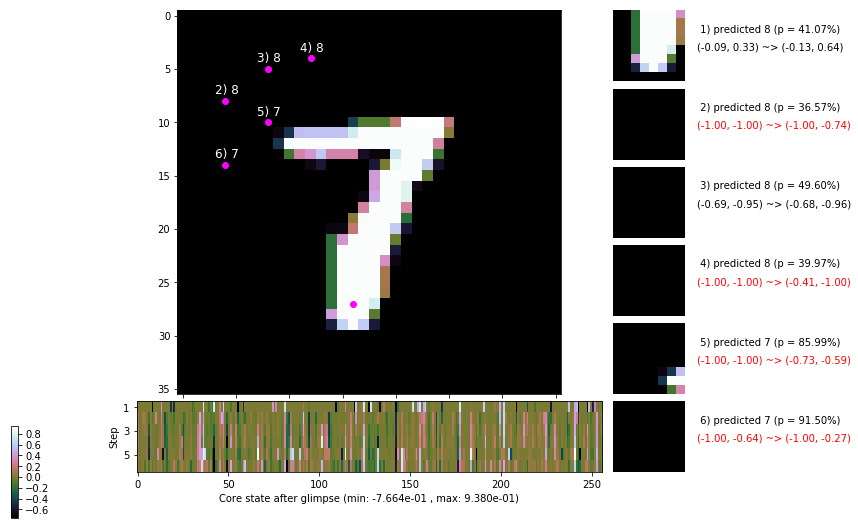

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 166.5 ms/b | lr: 3.23e-04 | grad 2norm: 18.93 | grad inf norm:  5.793
         Weights || abs max:  3.60 ( 1647.73) | mean: -2.25e-04 ( 0.01) | var: 9.45e-02 (   52.63)
          Biases || abs max:  2.56 (  195.36) | mean: -1.30e-01 ( 0.14) | var: 7.56e-02 (  833.61)
                    class loss: 0.802 | steps: 2.886 | reward:  3.586 | acc.: 71.50%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 164.5 ms/b | lr: 3.23e-04 | grad 2norm: 18.37 | grad inf norm:  5.363
         Weights || abs max:  3.61 ( 1328.91) | mean: -2.26e-04 ( 0.01) | var: 9.46e-02 (   26.90)
          Biases || abs max:  2.57 (  120.34) | mean: -1.30e-01 ( 0.12) | var: 7.55e-02 (   45.60)
                    class loss: 0.779 | steps: 2.800 | reward:  3.667 | acc.: 72.20%

	Target class: 8 | Discounted rewards: [0.000, 0.000, 0.0

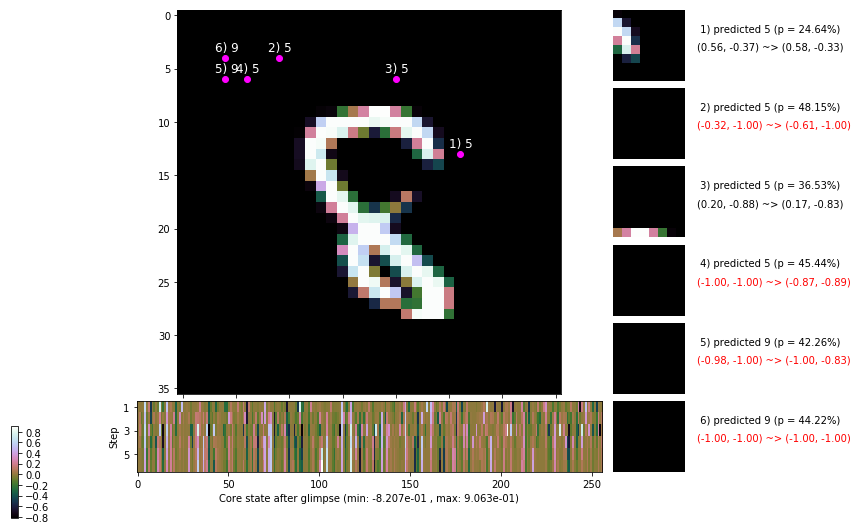

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 161.4 ms/b | lr: 3.22e-04 | grad 2norm: 18.90 | grad inf norm:  5.675
         Weights || abs max:  3.61 ( 2325.78) | mean: -2.32e-04 ( 0.01) | var: 9.46e-02 (  336.42)
          Biases || abs max:  2.57 (  265.81) | mean: -1.30e-01 ( 0.20) | var: 7.55e-02 ( 1203.66)
                    class loss: 0.796 | steps: 2.833 | reward:  3.637 | acc.: 72.18%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 157.5 ms/b | lr: 3.22e-04 | grad 2norm: 18.63 | grad inf norm:  5.555
         Weights || abs max:  3.61 ( 1576.26) | mean: -2.37e-04 ( 0.01) | var: 9.46e-02 (   52.27)
          Biases || abs max:  2.57 (  163.44) | mean: -1.30e-01 ( 0.14) | var: 7.55e-02 (  245.14)
                    class loss: 0.811 | steps: 2.860 | reward:  3.613 | acc.: 71.67%

	Target class: 1 | Discounted rewards: [4.686, 4.095, 3.4

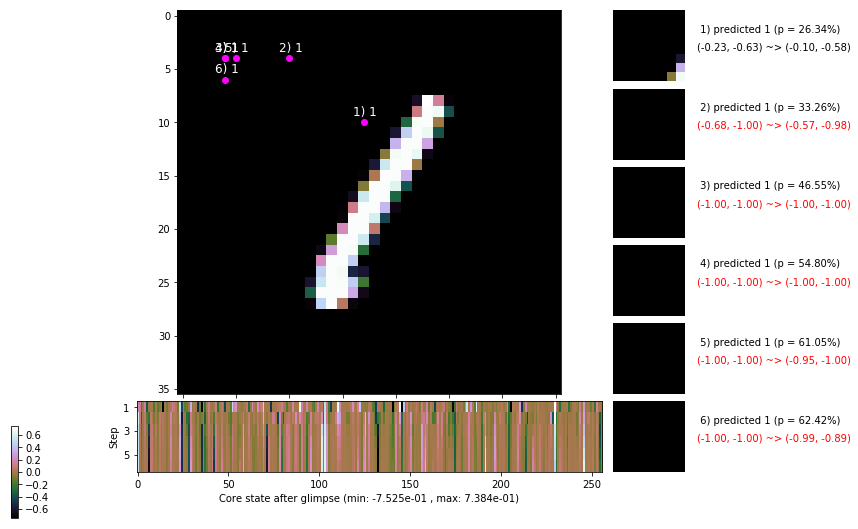

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 166.7 ms/b | lr: 3.21e-04 | grad 2norm: 18.85 | grad inf norm:  5.621
         Weights || abs max:  3.60 ( 2541.04) | mean: -2.41e-04 ( 0.01) | var: 9.47e-02 (  360.44)
          Biases || abs max:  2.57 (  164.60) | mean: -1.30e-01 ( 0.14) | var: 7.55e-02 (  116.65)
                    class loss: 0.760 | steps: 2.783 | reward:  3.666 | acc.: 72.25%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 161.4 ms/b | lr: 3.21e-04 | grad 2norm: 18.93 | grad inf norm:  5.421
         Weights || abs max:  3.61 ( 1130.90) | mean: -2.40e-04 ( 0.01) | var: 9.47e-02 (   20.69)
          Biases || abs max:  2.57 (  105.32) | mean: -1.30e-01 ( 0.11) | var: 7.55e-02 (   55.28)
                    class loss: 0.777 | steps: 2.814 | reward:  3.637 | acc.: 72.18%

	Target class: 2 | Discounted rewards: [3.686, 4.095, 3.4

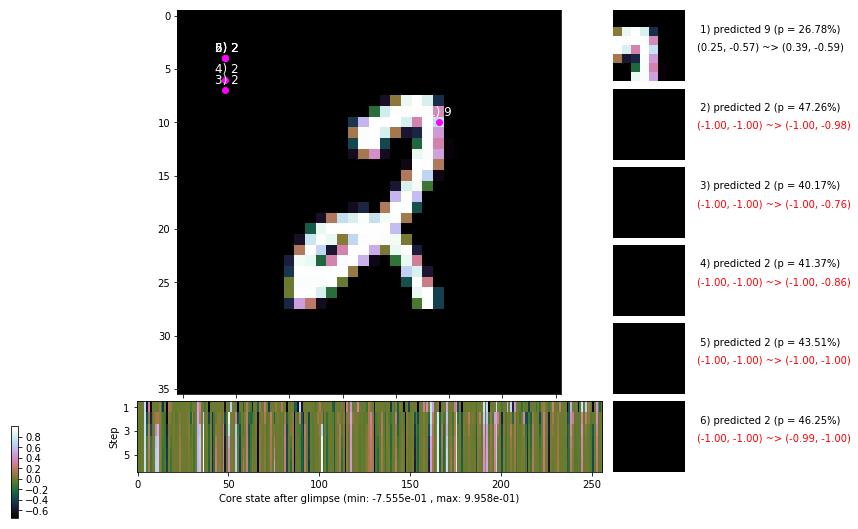

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 167.5 ms/b | lr: 3.20e-04 | grad 2norm: 18.57 | grad inf norm:  5.476
         Weights || abs max:  3.61 ( 1463.52) | mean: -2.40e-04 ( 0.01) | var: 9.47e-02 (  107.90)
          Biases || abs max:  2.58 (  177.91) | mean: -1.30e-01 ( 0.15) | var: 7.56e-02 (  321.66)
                    class loss: 0.746 | steps: 2.784 | reward:  3.717 | acc.: 74.13%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 163.4 ms/b | lr: 3.20e-04 | grad 2norm: 18.72 | grad inf norm:  5.538
         Weights || abs max:  3.62 ( 1227.97) | mean: -2.36e-04 ( 0.01) | var: 9.47e-02 (   22.06)
          Biases || abs max:  2.59 (  106.32) | mean: -1.29e-01 ( 0.11) | var: 7.55e-02 (   94.66)
                    class loss: 0.744 | steps: 2.764 | reward:  3.735 | acc.: 74.22%

	Target class: 9 | Discounted rewards: [1.539, 1.710, 1.9

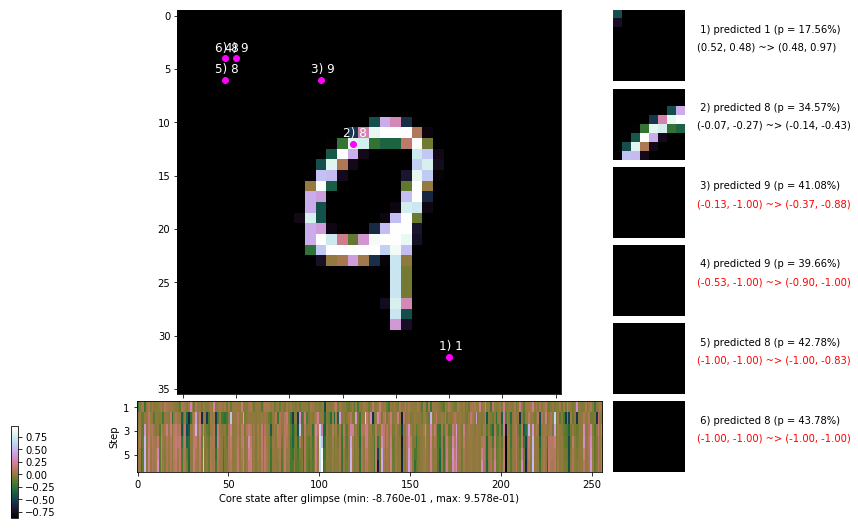

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 6 | Discounted rewards: [3.686, 4.095, 3.439, 2.710, 1.900, 1.000]


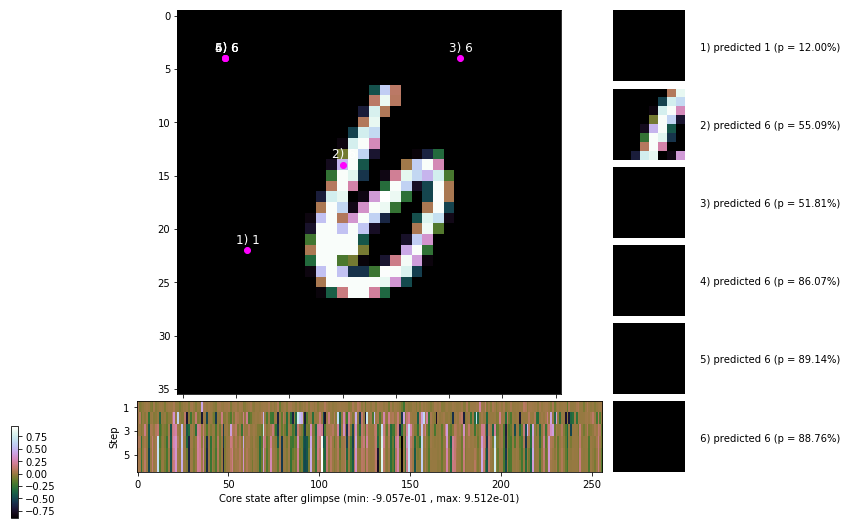


	Target class: 8 | Discounted rewards: [1.710, 1.900, 1.000, 0.000, 0.000, 0.000]


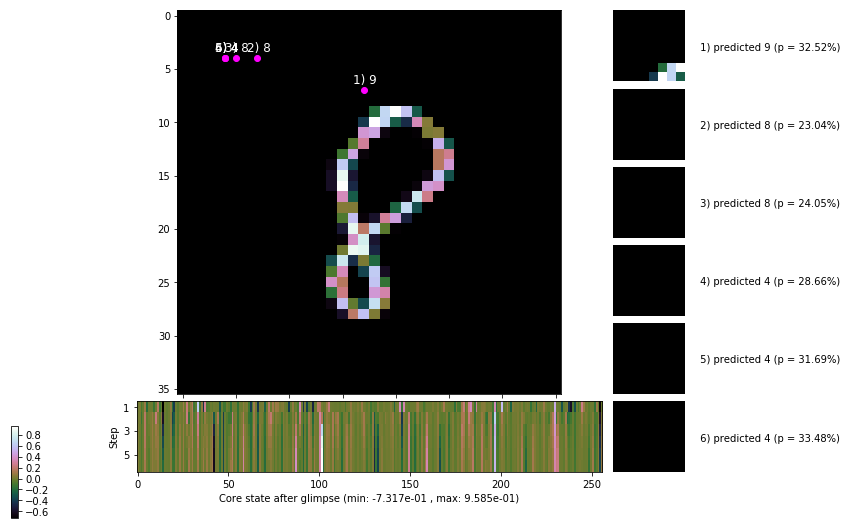

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


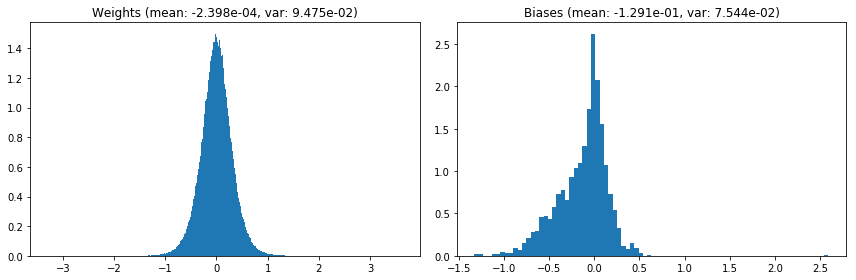

                                      Location network weights and biases


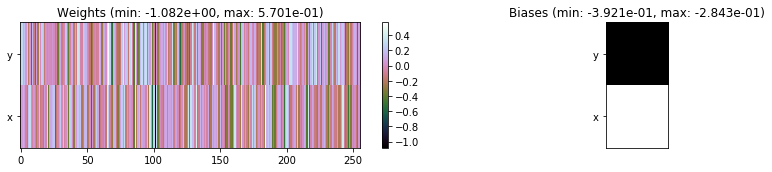

---------------------------------------------------------------------------------------------------------------
Elapsed time:  492.53 sec | TRAIN >> class loss: 0.7859 | steps:  2.822 :( | reward:  3.6441 :( | acc.: 72.237% :(
                          | VAL   >> class loss: 0.6861 | steps:  2.630    | reward:  3.8916    | acc.: 75.720% 


Epoch  77/400) lr = 0.0003196
 b    300/  3000 >> 157.9 ms/b | lr: 3.19e-04 | grad 2norm: 18.63 | grad inf norm:  5.560
         Weights || abs max:  3.62 ( 1890.94) | mean: -2.44e-04 ( 0.01) | var: 9.48e-02 (  271.29)
          Biases || abs max:  2.59 (  314.75) | mean: -1.29e-01 ( 0.19) | var: 7.55e-02 ( 1448.89)
                    class loss: 0.769 | steps: 2.808 | reward:  3.685 | acc.: 73.18%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 158.1 ms/b | lr: 3.19e-04 | grad 2norm: 19.14 | grad inf norm:  5.747
         Weights || abs max:  3.61 ( 1225.28) | mean: -2.48e-04 ( 0

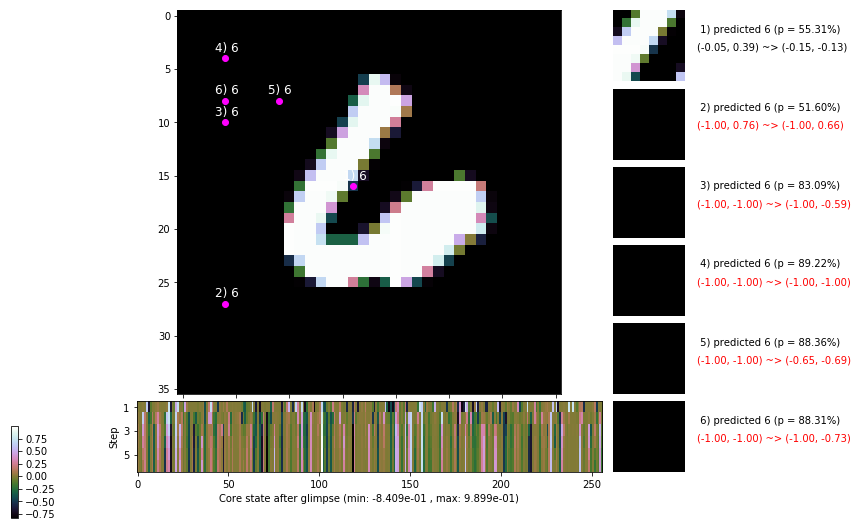

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 158.8 ms/b | lr: 3.18e-04 | grad 2norm: 18.73 | grad inf norm:  5.848
         Weights || abs max:  3.61 ( 2881.59) | mean: -2.22e-04 ( 0.01) | var: 9.48e-02 (  307.13)
          Biases || abs max:  2.59 (  119.49) | mean: -1.30e-01 ( 0.11) | var: 7.55e-02 (  154.39)
                    class loss: 0.796 | steps: 2.856 | reward:  3.608 | acc.: 71.58%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 159.3 ms/b | lr: 3.18e-04 | grad 2norm: 18.62 | grad inf norm:  5.670
         Weights || abs max:  3.61 ( 1831.66) | mean: -2.27e-04 ( 0.01) | var: 9.48e-02 (   48.02)
          Biases || abs max:  2.59 (  157.64) | mean: -1.30e-01 ( 0.14) | var: 7.56e-02 (  305.98)
                    class loss: 0.751 | steps: 2.759 | reward:  3.717 | acc.: 73.48%

	Target class: 2 | Discounted rewards: [3.686, 4.095, 3.4

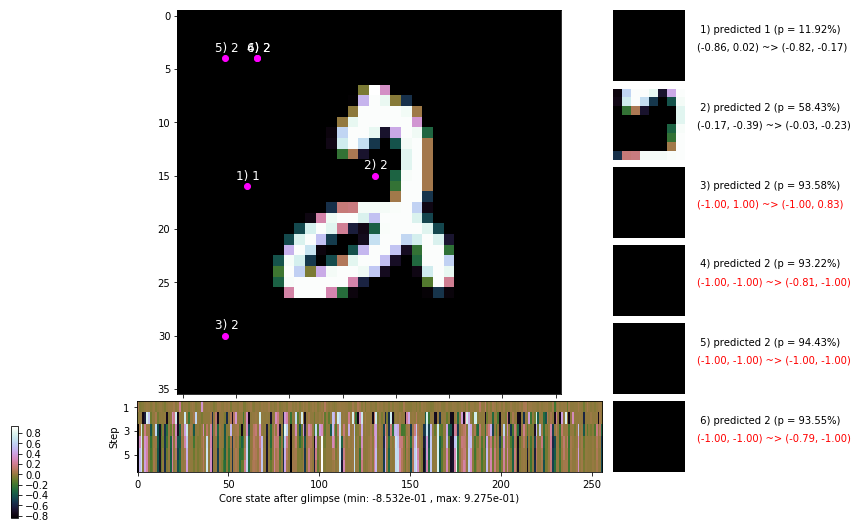

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 157.8 ms/b | lr: 3.17e-04 | grad 2norm: 18.70 | grad inf norm:  5.555
         Weights || abs max:  3.60 ( 4265.57) | mean: -2.46e-04 ( 0.01) | var: 9.48e-02 ( 1399.73)
          Biases || abs max:  2.60 (   92.38) | mean: -1.30e-01 ( 0.09) | var: 7.56e-02 (   47.43)
                    class loss: 0.758 | steps: 2.786 | reward:  3.706 | acc.: 73.50%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 157.3 ms/b | lr: 3.17e-04 | grad 2norm: 18.78 | grad inf norm:  5.663
         Weights || abs max:  3.60 (  904.57) | mean: -2.47e-04 ( 0.01) | var: 9.49e-02 (   12.44)
          Biases || abs max:  2.60 (   73.19) | mean: -1.30e-01 ( 0.09) | var: 7.56e-02 (   16.50)
                    class loss: 0.759 | steps: 2.765 | reward:  3.696 | acc.: 73.50%

	Target class: 7 | Discounted rewards: [4.686, 4.095, 3.4

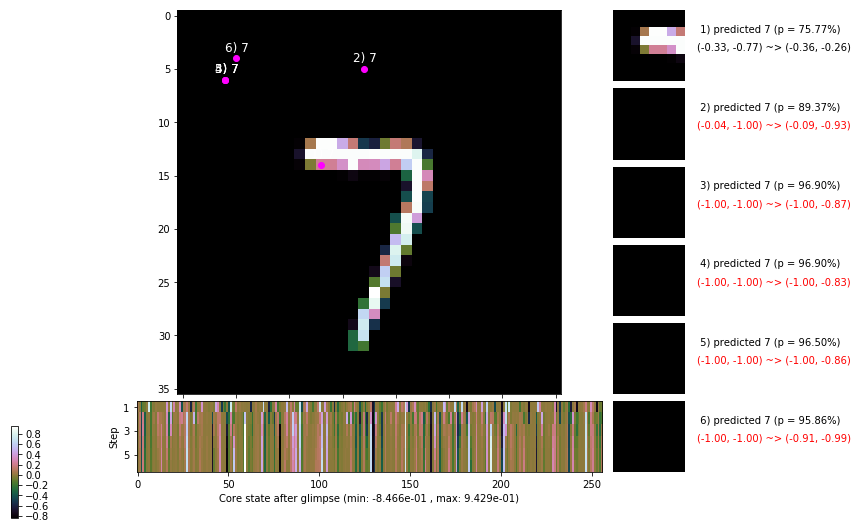

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 160.1 ms/b | lr: 3.16e-04 | grad 2norm: 18.72 | grad inf norm:  5.360
         Weights || abs max:  3.60 ( 1700.97) | mean: -2.42e-04 ( 0.01) | var: 9.49e-02 (   34.67)
          Biases || abs max:  2.60 (  159.94) | mean: -1.30e-01 ( 0.14) | var: 7.56e-02 (  230.34)
                    class loss: 0.753 | steps: 2.745 | reward:  3.712 | acc.: 73.02%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 158.5 ms/b | lr: 3.16e-04 | grad 2norm: 19.00 | grad inf norm:  5.670
         Weights || abs max:  3.61 ( 1593.29) | mean: -2.38e-04 ( 0.01) | var: 9.49e-02 (   62.34)
          Biases || abs max:  2.60 (   83.49) | mean: -1.30e-01 ( 0.09) | var: 7.57e-02 (   20.66)
                    class loss: 0.765 | steps: 2.775 | reward:  3.712 | acc.: 73.50%

	Target class: 2 | Discounted rewards: [0.000, 0.000, 0.0

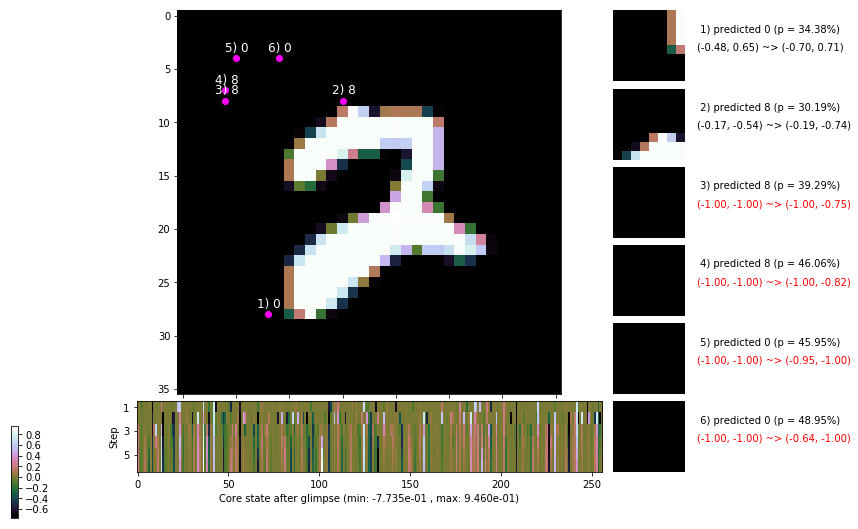

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 169.1 ms/b | lr: 3.16e-04 | grad 2norm: 19.17 | grad inf norm:  5.694
         Weights || abs max:  3.61 ( 1313.71) | mean: -2.40e-04 ( 0.01) | var: 9.49e-02 (   24.40)
          Biases || abs max:  2.60 (   91.04) | mean: -1.30e-01 ( 0.10) | var: 7.57e-02 (  137.57)
                    class loss: 0.773 | steps: 2.812 | reward:  3.650 | acc.: 72.33%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 158.6 ms/b | lr: 3.15e-04 | grad 2norm: 18.91 | grad inf norm:  5.701
         Weights || abs max:  3.61 ( 1544.20) | mean: -2.48e-04 ( 0.01) | var: 9.50e-02 (  110.17)
          Biases || abs max:  2.60 (  108.84) | mean: -1.30e-01 ( 0.11) | var: 7.57e-02 (  145.43)
                    class loss: 0.741 | steps: 2.756 | reward:  3.717 | acc.: 73.43%

	Target class: 8 | Discounted rewards: [2.786, 3.095, 3.4

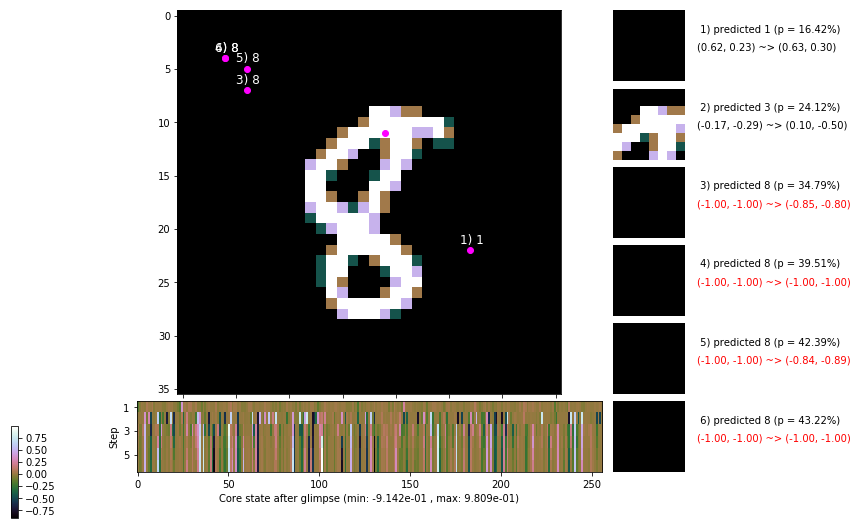

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 8 | Discounted rewards: [0.000, 0.000, 0.000, 0.000, 0.000, 0.000]


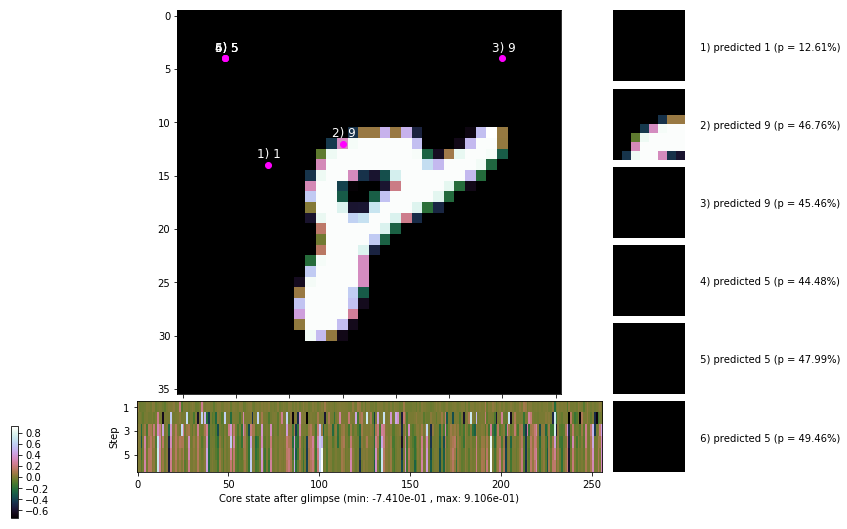


	Target class: 2 | Discounted rewards: [2.786, 3.095, 3.439, 2.710, 1.900, 1.000]


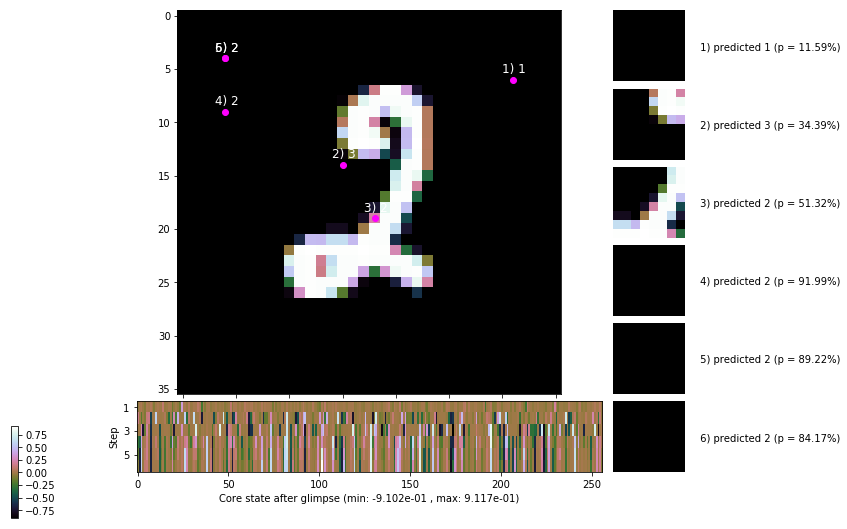

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


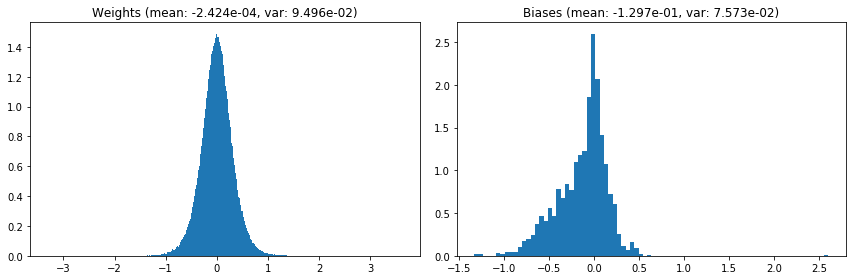

                                      Location network weights and biases


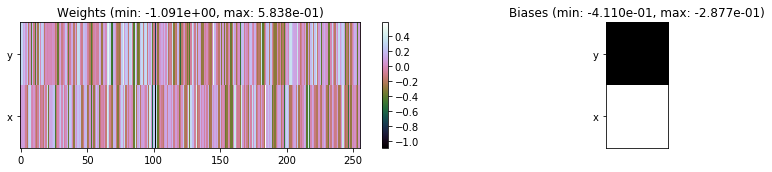

---------------------------------------------------------------------------------------------------------------
Elapsed time:  479.31 sec | TRAIN >> class loss: 0.7668 | steps:  2.790    | reward:  3.6842    | acc.: 72.978% 
                          | VAL   >> class loss: 0.7112 | steps:  2.709 :( | reward:  3.7946 :( | acc.: 74.360% :(


Epoch  78/400) lr = 0.0003149
 b    300/  3000 >> 165.3 ms/b | lr: 3.15e-04 | grad 2norm: 19.09 | grad inf norm:  5.830
         Weights || abs max:  3.62 ( 1387.62) | mean: -2.34e-04 ( 0.01) | var: 9.50e-02 (   80.94)
          Biases || abs max:  2.61 (   95.46) | mean: -1.30e-01 ( 0.10) | var: 7.57e-02 (   37.86)
                    class loss: 0.743 | steps: 2.767 | reward:  3.704 | acc.: 73.30%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 163.8 ms/b | lr: 3.14e-04 | grad 2norm: 18.79 | grad inf norm:  5.700
         Weights || abs max:  3.62 ( 4319.78) | mean: -2.25e-04 ( 0

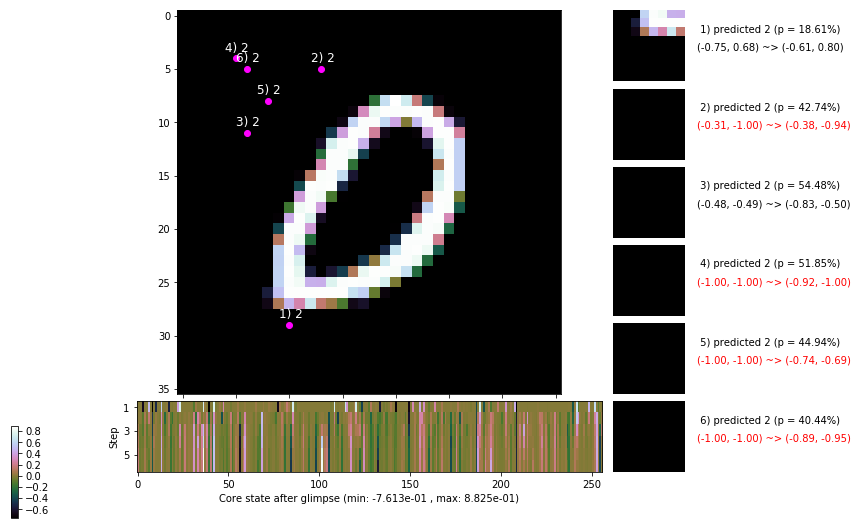

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 159.8 ms/b | lr: 3.14e-04 | grad 2norm: 18.61 | grad inf norm:  5.614
         Weights || abs max:  3.61 ( 8247.94) | mean: -2.25e-04 ( 0.02) | var: 9.50e-02 (29452.13)
          Biases || abs max:  2.62 (  468.57) | mean: -1.30e-01 ( 0.26) | var: 7.56e-02 (16017.93)
                    class loss: 0.749 | steps: 2.750 | reward:  3.727 | acc.: 73.48%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 152.1 ms/b | lr: 3.13e-04 | grad 2norm: 19.23 | grad inf norm:  5.775
         Weights || abs max:  3.61 ( 4101.83) | mean: -2.21e-04 ( 0.01) | var: 9.50e-02 ( 2699.83)
          Biases || abs max:  2.62 (  108.62) | mean: -1.30e-01 ( 0.12) | var: 7.58e-02 (   80.36)
                    class loss: 0.770 | steps: 2.808 | reward:  3.656 | acc.: 72.43%

	Target class: 4 | Discounted rewards: [4.686, 4.095, 3.4

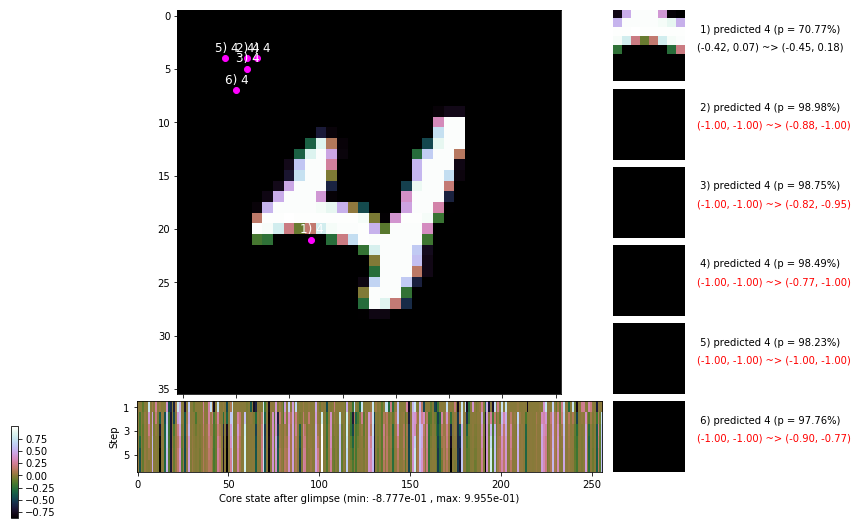

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 152.1 ms/b | lr: 3.13e-04 | grad 2norm: 18.78 | grad inf norm:  5.191
         Weights || abs max:  3.62 ( 2178.58) | mean: -2.28e-04 ( 0.01) | var: 9.51e-02 (  110.60)
          Biases || abs max:  2.62 (  130.72) | mean: -1.31e-01 ( 0.12) | var: 7.59e-02 (  134.62)
                    class loss: 0.778 | steps: 2.807 | reward:  3.659 | acc.: 72.85%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 151.0 ms/b | lr: 3.12e-04 | grad 2norm: 18.68 | grad inf norm:  5.486
         Weights || abs max:  3.62 ( 3142.00) | mean: -2.27e-04 ( 0.01) | var: 9.51e-02 ( 1120.45)
          Biases || abs max:  2.62 (   91.68) | mean: -1.30e-01 ( 0.10) | var: 7.59e-02 (   31.58)
                    class loss: 0.774 | steps: 2.811 | reward:  3.687 | acc.: 73.13%

	Target class: 5 | Discounted rewards: [0.000, 0.000, 0.0

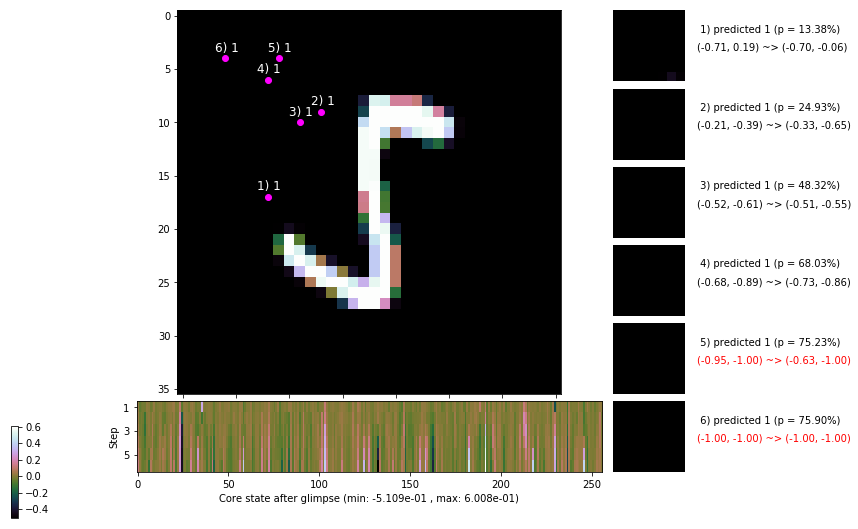

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 154.8 ms/b | lr: 3.12e-04 | grad 2norm: 18.33 | grad inf norm:  5.432
         Weights || abs max:  3.63 (13146.95) | mean: -2.15e-04 ( 0.03) | var: 9.51e-02 (19094.94)
          Biases || abs max:  2.63 (  422.55) | mean: -1.30e-01 ( 0.24) | var: 7.59e-02 ( 9587.14)
                    class loss: 0.765 | steps: 2.807 | reward:  3.696 | acc.: 73.08%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 151.4 ms/b | lr: 3.11e-04 | grad 2norm: 18.60 | grad inf norm:  5.567
         Weights || abs max:  3.62 ( 1574.61) | mean: -1.94e-04 ( 0.01) | var: 9.51e-02 (   49.97)
          Biases || abs max:  2.63 (  200.25) | mean: -1.30e-01 ( 0.15) | var: 7.59e-02 ( 1021.46)
                    class loss: 0.774 | steps: 2.788 | reward:  3.688 | acc.: 72.58%

	Target class: 4 | Discounted rewards: [0.000, 0.000, 0.0

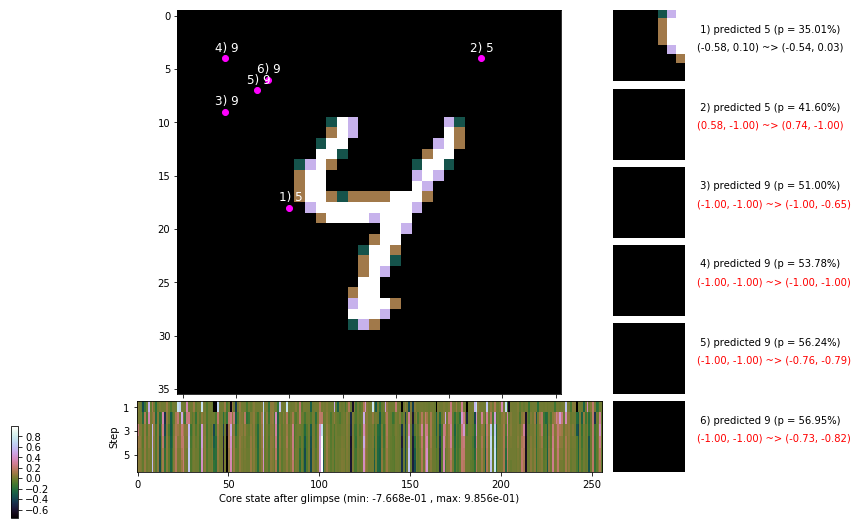

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 152.0 ms/b | lr: 3.11e-04 | grad 2norm: 18.72 | grad inf norm:  5.728
         Weights || abs max:  3.63 ( 1400.86) | mean: -1.79e-04 ( 0.01) | var: 9.52e-02 (  237.12)
          Biases || abs max:  2.63 (  108.64) | mean: -1.30e-01 ( 0.12) | var: 7.58e-02 (   54.24)
                    class loss: 0.767 | steps: 2.805 | reward:  3.684 | acc.: 72.75%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 151.3 ms/b | lr: 3.10e-04 | grad 2norm: 18.70 | grad inf norm:  5.576
         Weights || abs max:  3.63 ( 1141.64) | mean: -1.75e-04 ( 0.01) | var: 9.52e-02 (   19.53)
          Biases || abs max:  2.63 (  182.72) | mean: -1.30e-01 ( 0.13) | var: 7.58e-02 (  404.46)
                    class loss: 0.775 | steps: 2.814 | reward:  3.676 | acc.: 72.87%

	Target class: 1 | Discounted rewards: [1.000, 0.000, 0.0

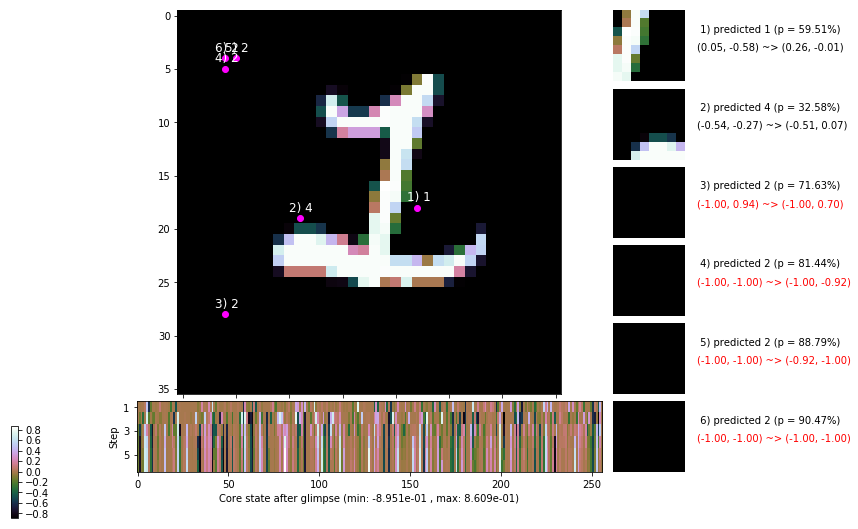

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 1 | Discounted rewards: [4.686, 4.095, 3.439, 2.710, 1.900, 1.000]


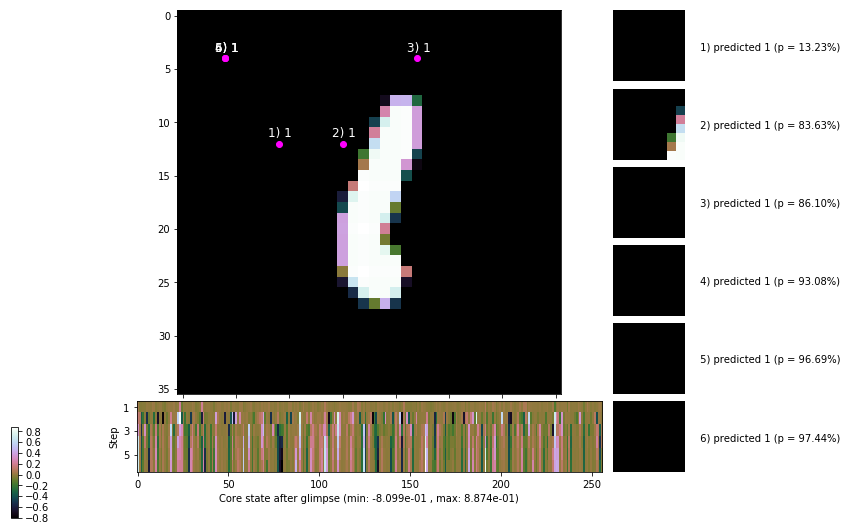


	Target class: 7 | Discounted rewards: [0.000, 0.000, 0.000, 0.000, 0.000, 0.000]


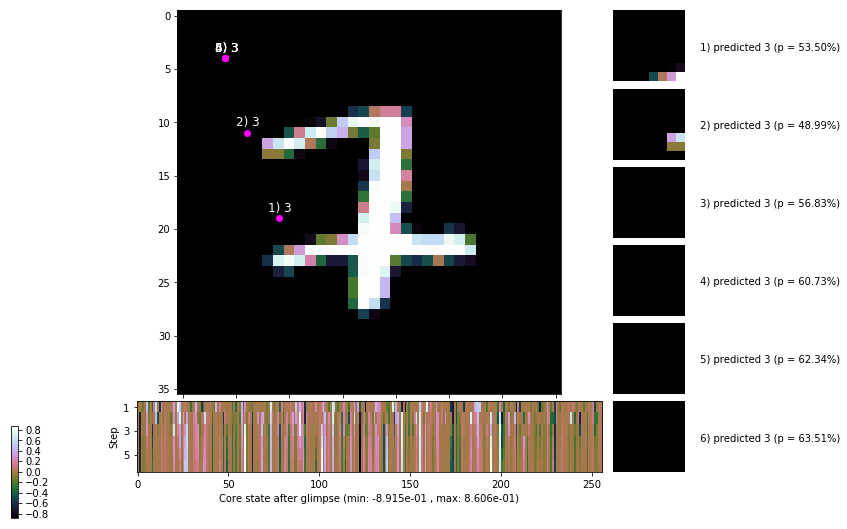

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


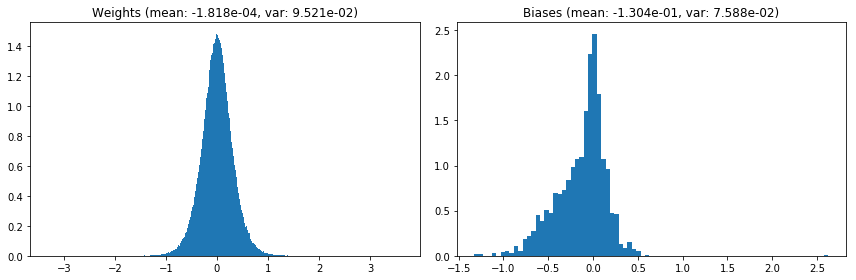

                                      Location network weights and biases


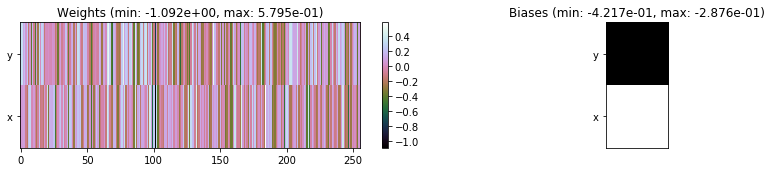

---------------------------------------------------------------------------------------------------------------
Elapsed time:  467.02 sec | TRAIN >> class loss: 0.7628 | steps:  2.795 :( | reward:  3.6882    | acc.: 73.040% 
                          | VAL   >> class loss: 0.7354 | steps:  2.710 :( | reward:  3.7932 :( | acc.: 74.580% :(


Epoch  79/400) lr = 0.0003102
 b    300/  3000 >> 151.4 ms/b | lr: 3.10e-04 | grad 2norm: 18.95 | grad inf norm:  5.915
         Weights || abs max:  3.62 (  980.07) | mean: -1.84e-04 ( 0.01) | var: 9.52e-02 (   10.41)
          Biases || abs max:  2.63 (  234.65) | mean: -1.30e-01 ( 0.16) | var: 7.58e-02 ( 1233.52)
                    class loss: 0.778 | steps: 2.819 | reward:  3.667 | acc.: 72.57%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 153.6 ms/b | lr: 3.10e-04 | grad 2norm: 18.55 | grad inf norm:  5.440
         Weights || abs max:  3.62 ( 1282.56) | mean: -1.82e-04 ( 0

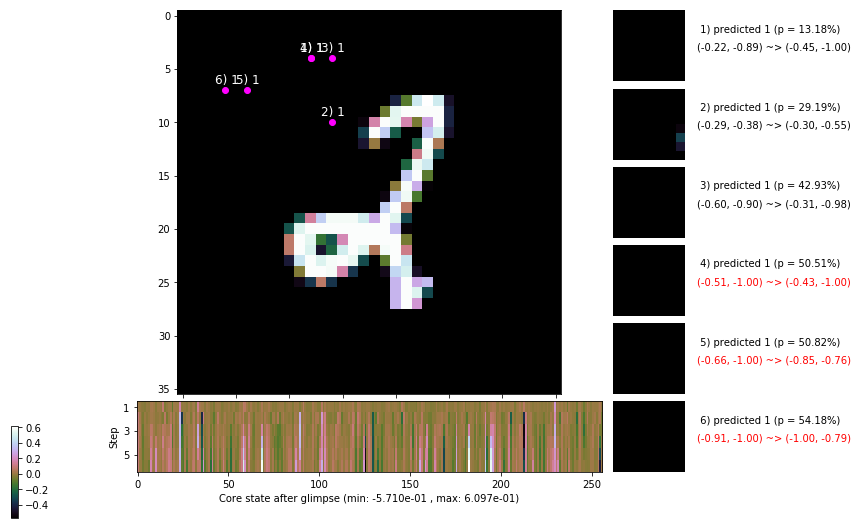

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 155.7 ms/b | lr: 3.09e-04 | grad 2norm: 18.45 | grad inf norm:  5.657
         Weights || abs max:  3.62 ( 2973.21) | mean: -1.82e-04 ( 0.01) | var: 9.53e-02 (  537.16)
          Biases || abs max:  2.62 (  522.58) | mean: -1.30e-01 ( 0.27) | var: 7.58e-02 ( 9836.65)
                    class loss: 0.766 | steps: 2.789 | reward:  3.698 | acc.: 73.35%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 166.9 ms/b | lr: 3.09e-04 | grad 2norm: 18.74 | grad inf norm:  5.547
         Weights || abs max:  3.62 ( 1599.05) | mean: -1.93e-04 ( 0.01) | var: 9.53e-02 (   47.42)
          Biases || abs max:  2.63 (  171.50) | mean: -1.30e-01 ( 0.15) | var: 7.58e-02 (   99.31)
                    class loss: 0.750 | steps: 2.764 | reward:  3.731 | acc.: 73.33%

	Target class: 2 | Discounted rewards: [3.686, 4.095, 3.4

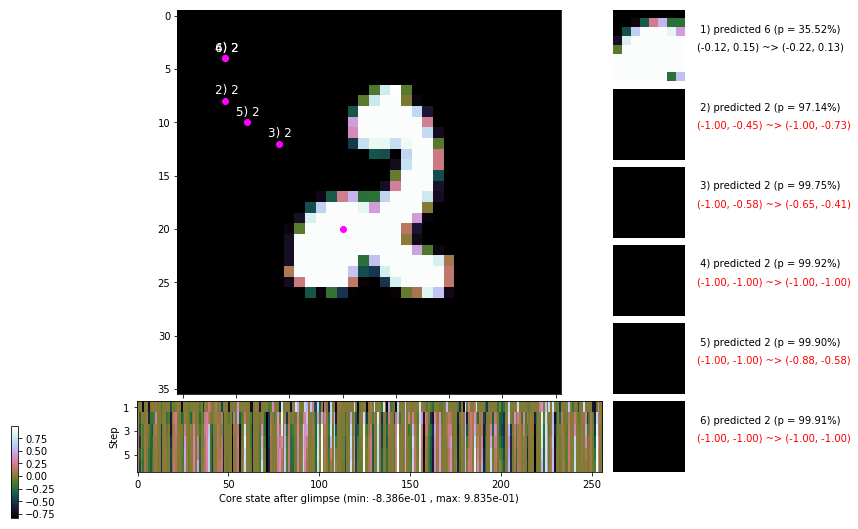

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 166.6 ms/b | lr: 3.08e-04 | grad 2norm: 18.71 | grad inf norm:  5.650
         Weights || abs max:  3.63 ( 1620.33) | mean: -1.93e-04 ( 0.01) | var: 9.53e-02 (   87.95)
          Biases || abs max:  2.63 (  135.41) | mean: -1.30e-01 ( 0.11) | var: 7.57e-02 (  114.10)
                    class loss: 0.765 | steps: 2.806 | reward:  3.670 | acc.: 72.93%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 164.5 ms/b | lr: 3.08e-04 | grad 2norm: 18.67 | grad inf norm:  5.466
         Weights || abs max:  3.63 ( 3826.25) | mean: -1.91e-04 ( 0.01) | var: 9.53e-02 ( 3685.13)
          Biases || abs max:  2.62 (  118.62) | mean: -1.30e-01 ( 0.11) | var: 7.59e-02 (   84.38)
                    class loss: 0.792 | steps: 2.799 | reward:  3.646 | acc.: 72.12%

	Target class: 1 | Discounted rewards: [3.686, 4.095, 3.4

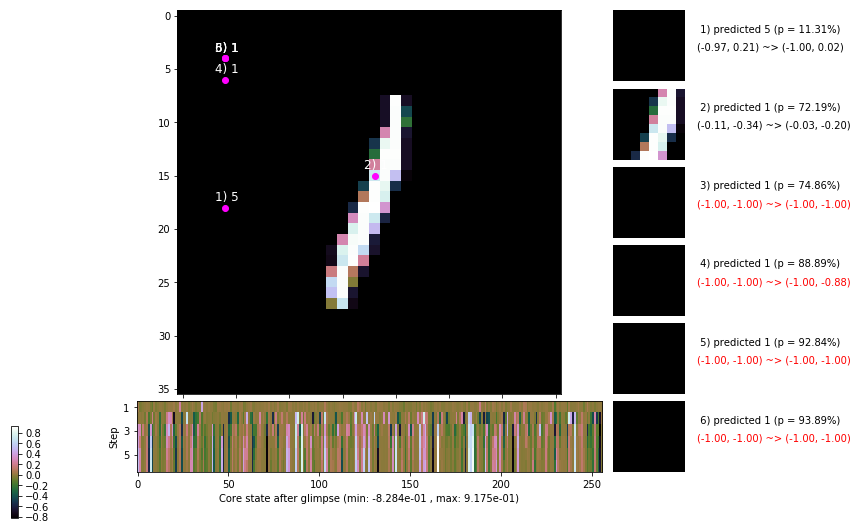

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 167.8 ms/b | lr: 3.07e-04 | grad 2norm: 18.74 | grad inf norm:  5.733
         Weights || abs max:  3.63 ( 1098.70) | mean: -1.78e-04 ( 0.01) | var: 9.54e-02 (   14.02)
          Biases || abs max:  2.63 (   93.02) | mean: -1.30e-01 ( 0.10) | var: 7.59e-02 (   25.01)
                    class loss: 0.769 | steps: 2.763 | reward:  3.710 | acc.: 72.90%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 160.3 ms/b | lr: 3.07e-04 | grad 2norm: 18.45 | grad inf norm:  5.430
         Weights || abs max:  3.63 ( 2878.85) | mean: -1.87e-04 ( 0.01) | var: 9.54e-02 (  664.70)
          Biases || abs max:  2.63 (   97.20) | mean: -1.30e-01 ( 0.10) | var: 7.59e-02 (   21.17)
                    class loss: 0.776 | steps: 2.793 | reward:  3.696 | acc.: 73.65%

	Target class: 0 | Discounted rewards: [3.686, 4.095, 3.4

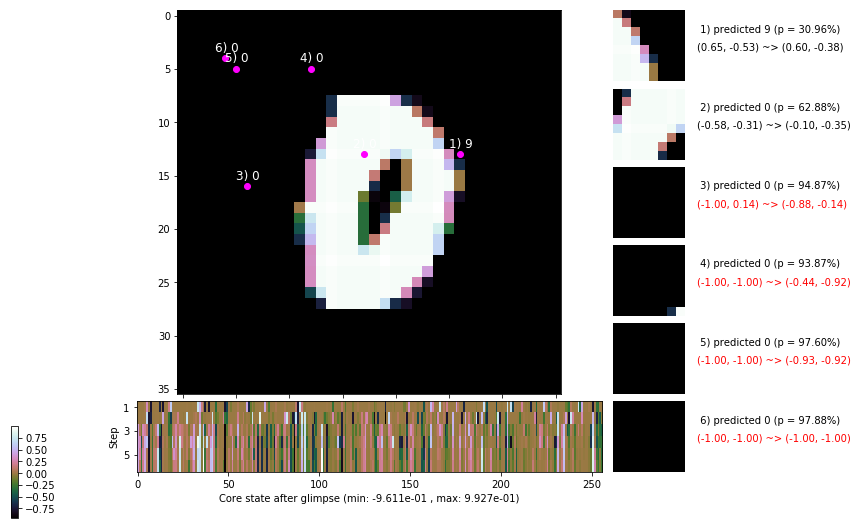

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 159.6 ms/b | lr: 3.06e-04 | grad 2norm: 19.00 | grad inf norm:  5.815
         Weights || abs max:  3.64 ( 1212.48) | mean: -1.90e-04 ( 0.01) | var: 9.54e-02 (   24.86)
          Biases || abs max:  2.63 (  101.05) | mean: -1.30e-01 ( 0.10) | var: 7.59e-02 (   49.67)
                    class loss: 0.768 | steps: 2.801 | reward:  3.664 | acc.: 72.55%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 157.2 ms/b | lr: 3.06e-04 | grad 2norm: 18.95 | grad inf norm:  5.797
         Weights || abs max:  3.64 ( 1491.32) | mean: -1.81e-04 ( 0.01) | var: 9.54e-02 (   38.38)
          Biases || abs max:  2.63 (  165.08) | mean: -1.30e-01 ( 0.14) | var: 7.60e-02 (  178.82)
                    class loss: 0.757 | steps: 2.799 | reward:  3.686 | acc.: 73.07%

	Target class: 5 | Discounted rewards: [0.000, 0.000, 0.0

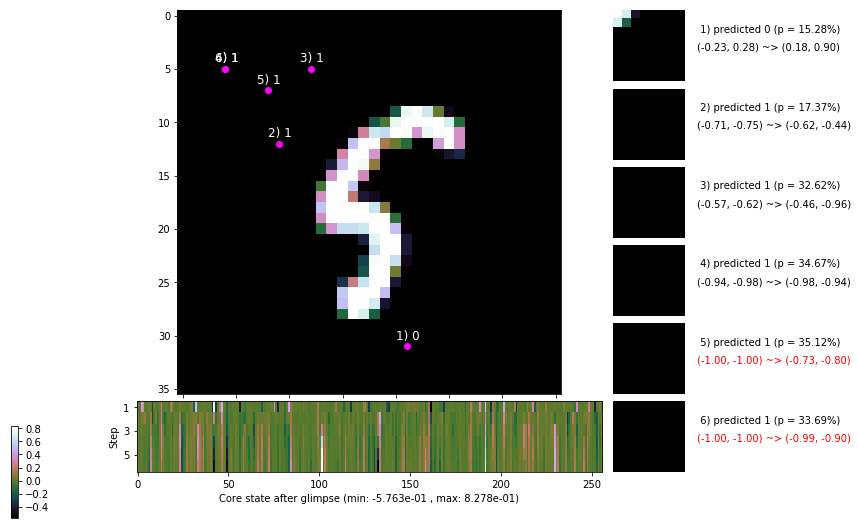

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 2 | Discounted rewards: [2.786, 3.095, 3.439, 2.710, 1.900, 1.000]


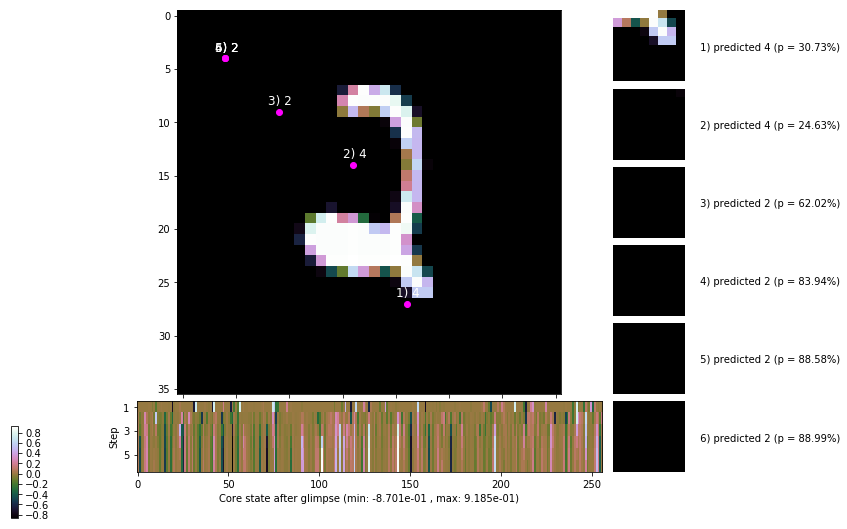


	Target class: 0 | Discounted rewards: [2.710, 1.900, 1.000, 0.000, 0.000, 0.000]


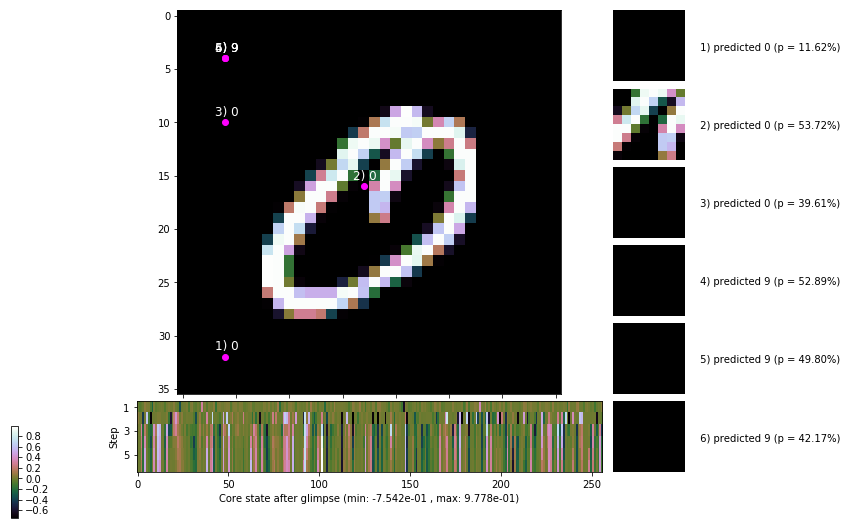

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


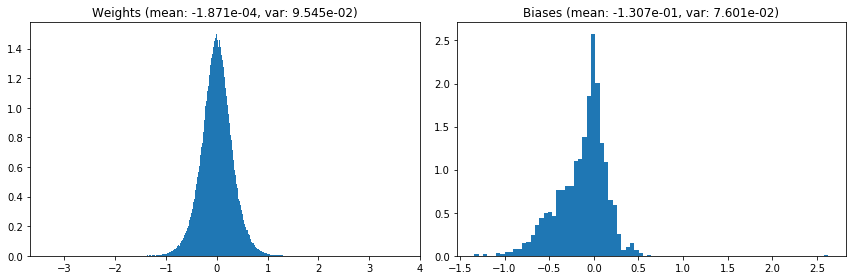

                                      Location network weights and biases


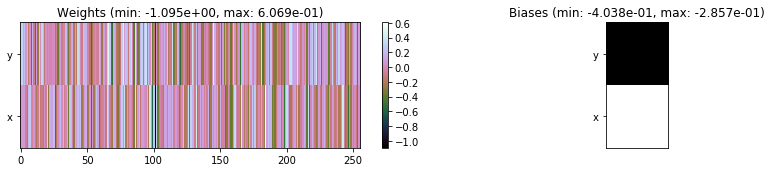

---------------------------------------------------------------------------------------------------------------
Elapsed time:  481.70 sec | TRAIN >> class loss: 0.7706 | steps:  2.793 :( | reward:  3.6829 :( | acc.: 72.857% :(
                          | VAL   >> class loss: 0.7153 | steps:  2.695 :( | reward:  3.8114 :( | acc.: 74.220% :(


Epoch  80/400) lr = 0.0003056
 b    300/  3000 >> 157.3 ms/b | lr: 3.05e-04 | grad 2norm: 18.91 | grad inf norm:  5.732
         Weights || abs max:  3.64 ( 1869.18) | mean: -1.95e-04 ( 0.01) | var: 9.55e-02 (  170.47)
          Biases || abs max:  2.63 (  183.81) | mean: -1.31e-01 ( 0.14) | var: 7.61e-02 (  504.57)
                    class loss: 0.774 | steps: 2.801 | reward:  3.668 | acc.: 72.83%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 157.5 ms/b | lr: 3.05e-04 | grad 2norm: 18.60 | grad inf norm:  5.569
         Weights || abs max:  3.64 (  891.44) | mean: -2.06e-04 (

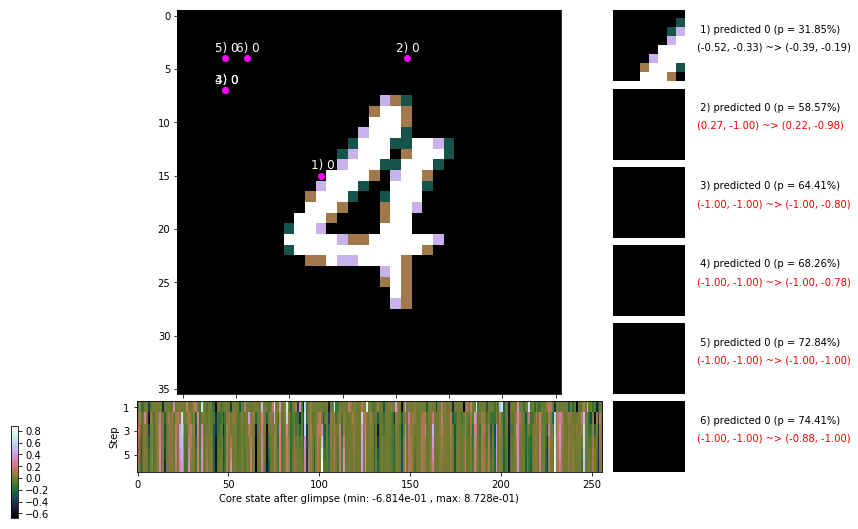

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 161.1 ms/b | lr: 3.04e-04 | grad 2norm: 18.44 | grad inf norm:  5.414
         Weights || abs max:  3.64 ( 2786.65) | mean: -2.15e-04 ( 0.01) | var: 9.55e-02 (  327.28)
          Biases || abs max:  2.63 (   57.51) | mean: -1.31e-01 ( 0.07) | var: 7.62e-02 (   12.70)
                    class loss: 0.770 | steps: 2.793 | reward:  3.676 | acc.: 73.00%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 172.6 ms/b | lr: 3.04e-04 | grad 2norm: 18.65 | grad inf norm:  5.507
         Weights || abs max:  3.65 ( 1459.21) | mean: -2.13e-04 ( 0.01) | var: 9.55e-02 (   44.20)
          Biases || abs max:  2.63 (  156.76) | mean: -1.31e-01 ( 0.12) | var: 7.62e-02 (  778.56)
                    class loss: 0.758 | steps: 2.769 | reward:  3.708 | acc.: 74.02%

	Target class: 1 | Discounted rewards: [3.686, 4.095, 3.4

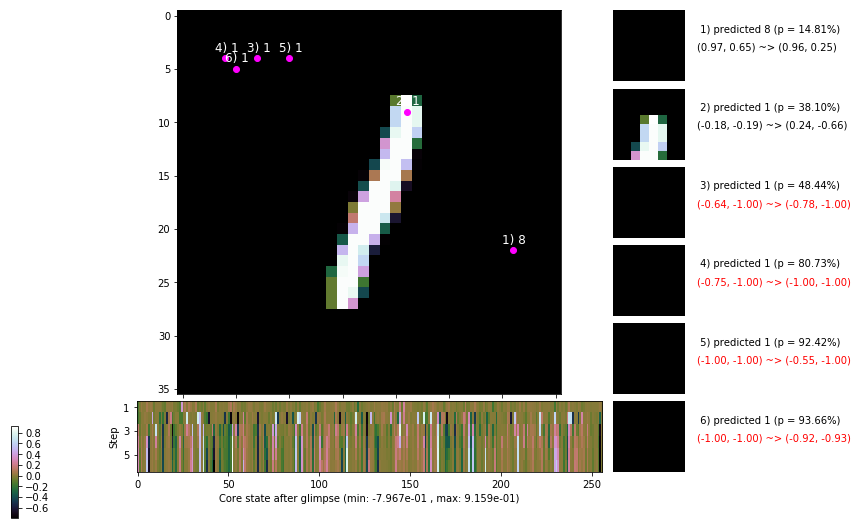

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 168.4 ms/b | lr: 3.03e-04 | grad 2norm: 18.73 | grad inf norm:  5.467
         Weights || abs max:  3.65 ( 2226.28) | mean: -2.20e-04 ( 0.01) | var: 9.56e-02 (  103.95)
          Biases || abs max:  2.63 (  174.39) | mean: -1.31e-01 ( 0.13) | var: 7.61e-02 (  417.67)
                    class loss: 0.732 | steps: 2.795 | reward:  3.697 | acc.: 74.10%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 168.2 ms/b | lr: 3.03e-04 | grad 2norm: 18.68 | grad inf norm:  5.548
         Weights || abs max:  3.66 ( 4520.70) | mean: -2.34e-04 ( 0.01) | var: 9.56e-02 ( 3175.98)
          Biases || abs max:  2.63 (  438.23) | mean: -1.31e-01 ( 0.23) | var: 7.61e-02 ( 7404.84)
                    class loss: 0.754 | steps: 2.777 | reward:  3.701 | acc.: 73.47%

	Target class: 4 | Discounted rewards: [0.000, 0.000, 0.0

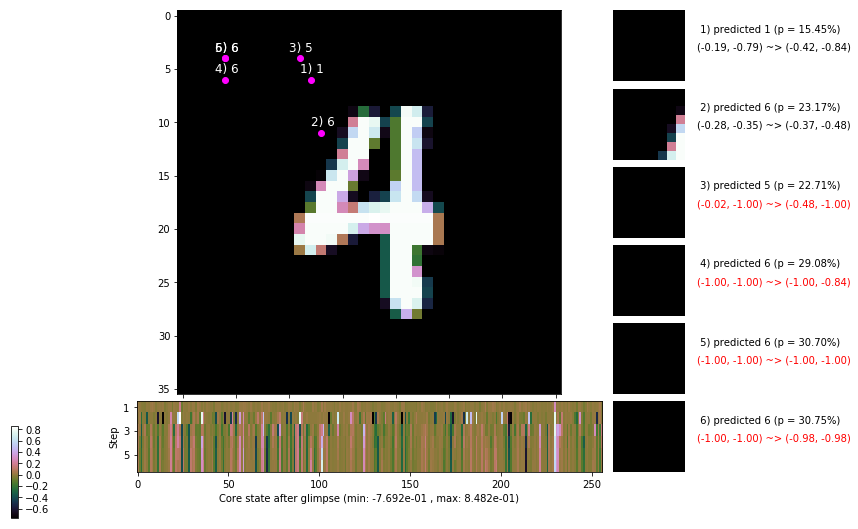

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 167.0 ms/b | lr: 3.03e-04 | grad 2norm: 18.18 | grad inf norm:  5.295
         Weights || abs max:  3.65 ( 2753.78) | mean: -2.36e-04 ( 0.01) | var: 9.56e-02 (  199.07)
          Biases || abs max:  2.63 (  101.39) | mean: -1.31e-01 ( 0.10) | var: 7.61e-02 (   32.96)
                    class loss: 0.751 | steps: 2.800 | reward:  3.681 | acc.: 73.38%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 145.9 ms/b | lr: 3.02e-04 | grad 2norm: 18.84 | grad inf norm:  5.809
         Weights || abs max:  3.65 ( 2058.72) | mean: -2.26e-04 ( 0.01) | var: 9.56e-02 (  168.88)
          Biases || abs max:  2.64 (  117.16) | mean: -1.31e-01 ( 0.11) | var: 7.62e-02 (   78.96)
                    class loss: 0.729 | steps: 2.740 | reward:  3.739 | acc.: 74.35%

	Target class: 5 | Discounted rewards: [1.976, 2.195, 2.4

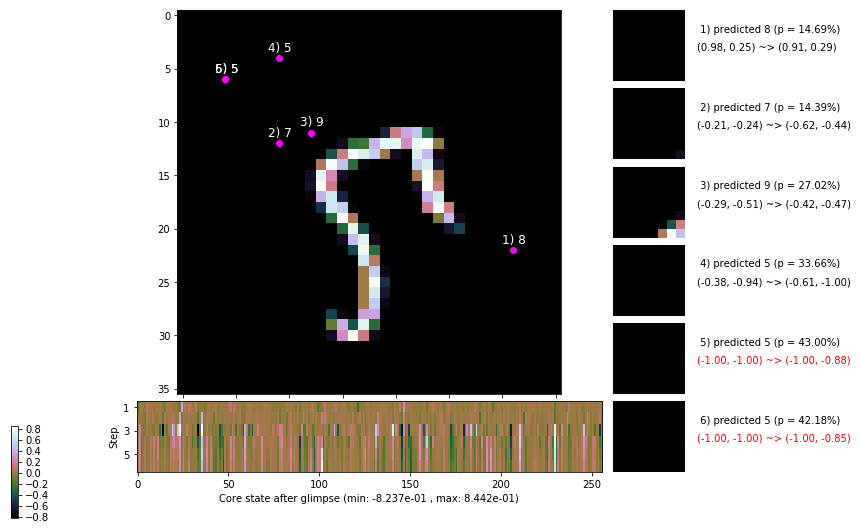

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 146.6 ms/b | lr: 3.02e-04 | grad 2norm: 18.86 | grad inf norm:  5.552
         Weights || abs max:  3.65 ( 4260.60) | mean: -2.15e-04 ( 0.01) | var: 9.56e-02 ( 2438.54)
          Biases || abs max:  2.64 (  150.81) | mean: -1.31e-01 ( 0.14) | var: 7.62e-02 (   98.90)
                    class loss: 0.756 | steps: 2.797 | reward:  3.689 | acc.: 73.48%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 143.2 ms/b | lr: 3.01e-04 | grad 2norm: 18.87 | grad inf norm:  5.609
         Weights || abs max:  3.65 ( 2143.95) | mean: -2.12e-04 ( 0.01) | var: 9.57e-02 (  576.18)
          Biases || abs max:  2.64 (   92.05) | mean: -1.31e-01 ( 0.09) | var: 7.61e-02 (  101.82)
                    class loss: 0.739 | steps: 2.754 | reward:  3.713 | acc.: 73.55%

	Target class: 7 | Discounted rewards: [0.000, 0.000, 0.0

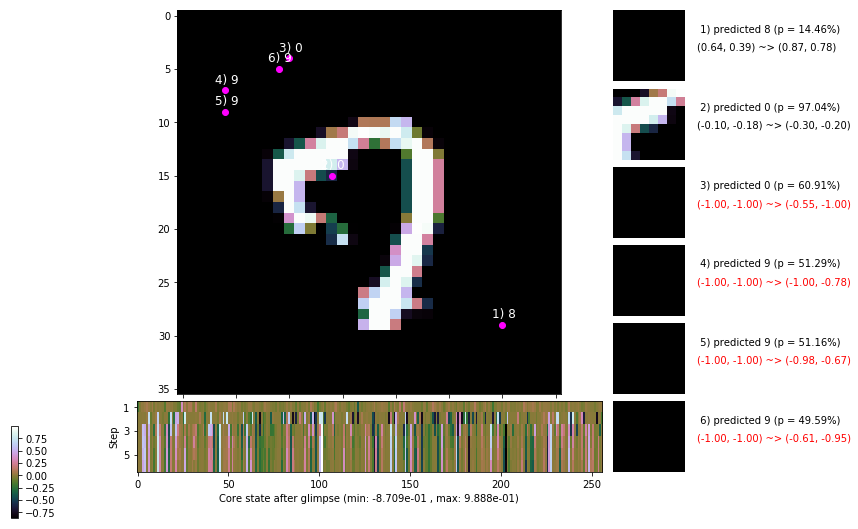

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 1 | Discounted rewards: [3.686, 4.095, 3.439, 2.710, 1.900, 1.000]


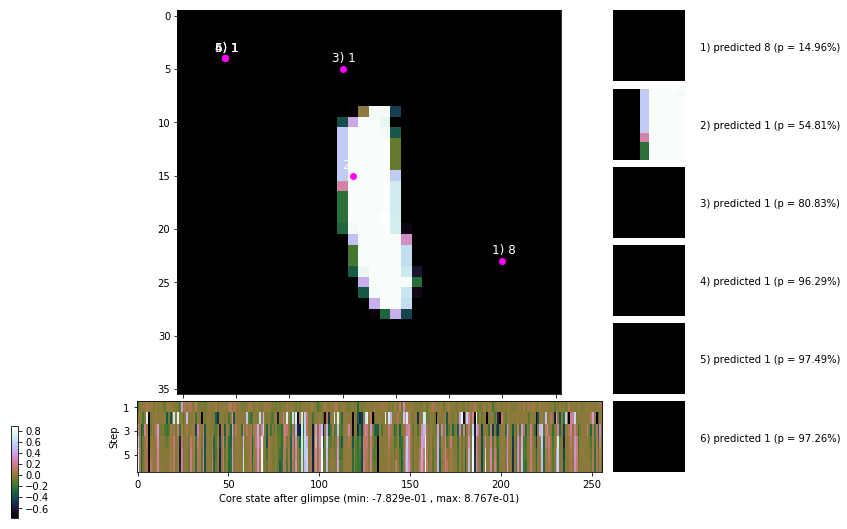


	Target class: 0 | Discounted rewards: [4.686, 4.095, 3.439, 2.710, 1.900, 1.000]


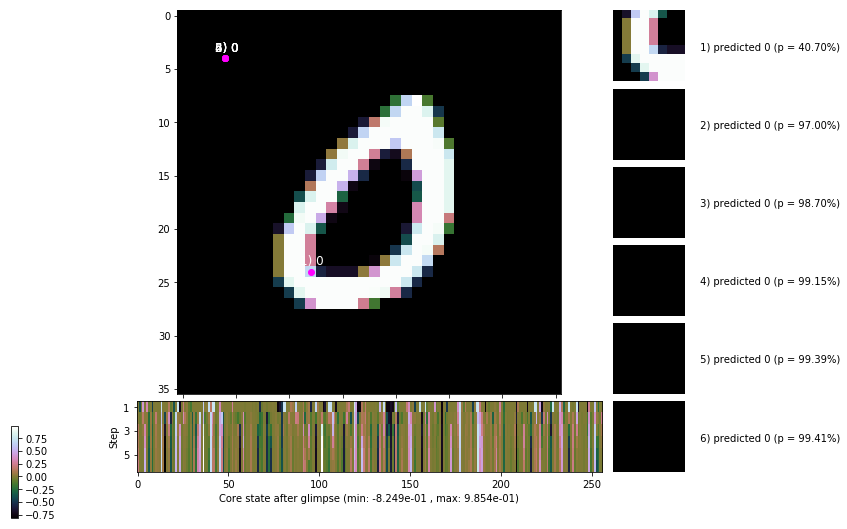

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


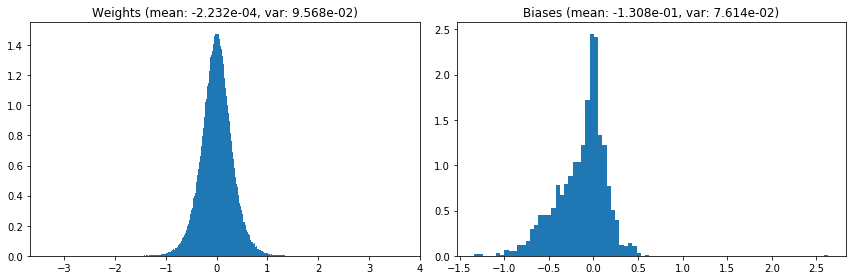

                                      Location network weights and biases


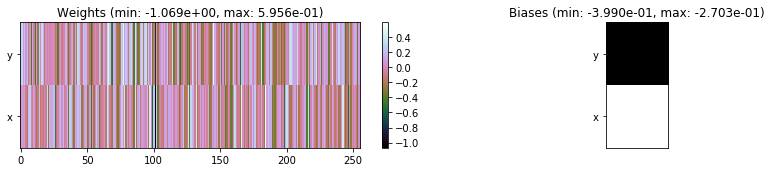

---------------------------------------------------------------------------------------------------------------
Elapsed time:  477.15 sec | TRAIN >> class loss: 0.7533 | steps:  2.783    | reward:  3.6967    | acc.: 73.502% 
                          | VAL   >> class loss: 0.7123 | steps:  2.707 :( | reward:  3.8124 :( | acc.: 74.820% :(


Epoch  81/400) lr = 0.000301
 b    300/  3000 >> 143.5 ms/b | lr: 3.01e-04 | grad 2norm: 19.01 | grad inf norm:  5.681
         Weights || abs max:  3.65 ( 1909.27) | mean: -2.22e-04 ( 0.01) | var: 9.57e-02 (  283.55)
          Biases || abs max:  2.64 (  122.44) | mean: -1.31e-01 ( 0.11) | var: 7.61e-02 (  170.75)
                    class loss: 0.717 | steps: 2.732 | reward:  3.750 | acc.: 74.40%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 144.5 ms/b | lr: 3.00e-04 | grad 2norm: 18.63 | grad inf norm:  5.530
         Weights || abs max:  3.64 ( 1427.19) | mean: -2.15e-04 ( 0.

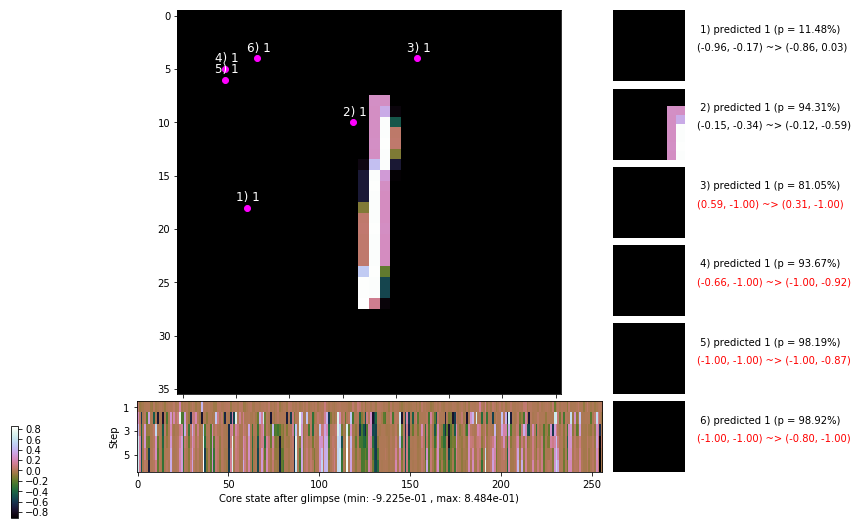

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 143.6 ms/b | lr: 3.00e-04 | grad 2norm: 19.01 | grad inf norm:  5.791
         Weights || abs max:  3.64 ( 1850.29) | mean: -2.19e-04 ( 0.01) | var: 9.57e-02 (  265.76)
          Biases || abs max:  2.65 (  245.08) | mean: -1.30e-01 ( 0.17) | var: 7.60e-02 (  392.08)
                    class loss: 0.764 | steps: 2.776 | reward:  3.667 | acc.: 72.42%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 142.2 ms/b | lr: 3.00e-04 | grad 2norm: 18.75 | grad inf norm:  5.577
         Weights || abs max:  3.65 ( 1410.86) | mean: -2.24e-04 ( 0.01) | var: 9.58e-02 (   42.66)
          Biases || abs max:  2.64 (  102.42) | mean: -1.30e-01 ( 0.10) | var: 7.61e-02 (  118.77)
                    class loss: 0.737 | steps: 2.768 | reward:  3.719 | acc.: 74.07%

	Target class: 1 | Discounted rewards: [3.786, 3.095, 3.4

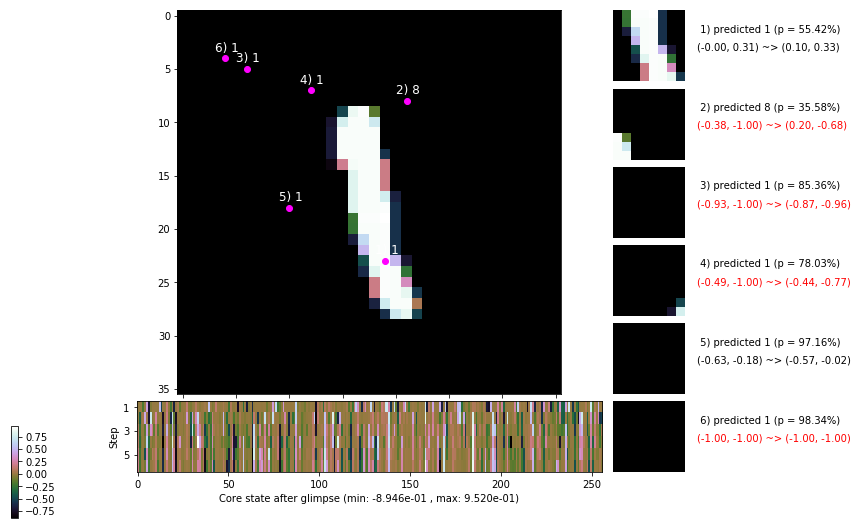

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 143.1 ms/b | lr: 2.99e-04 | grad 2norm: 18.72 | grad inf norm:  5.771
         Weights || abs max:  3.65 ( 1759.38) | mean: -2.17e-04 ( 0.01) | var: 9.58e-02 (   95.43)
          Biases || abs max:  2.64 (  188.36) | mean: -1.30e-01 ( 0.13) | var: 7.61e-02 (  633.53)
                    class loss: 0.760 | steps: 2.804 | reward:  3.690 | acc.: 73.47%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 142.1 ms/b | lr: 2.99e-04 | grad 2norm: 19.11 | grad inf norm:  5.875
         Weights || abs max:  3.65 ( 1859.77) | mean: -2.21e-04 ( 0.01) | var: 9.58e-02 (  228.62)
          Biases || abs max:  2.64 (  103.30) | mean: -1.31e-01 ( 0.11) | var: 7.62e-02 (  112.03)
                    class loss: 0.775 | steps: 2.822 | reward:  3.657 | acc.: 73.08%

	Target class: 9 | Discounted rewards: [2.786, 3.095, 3.4

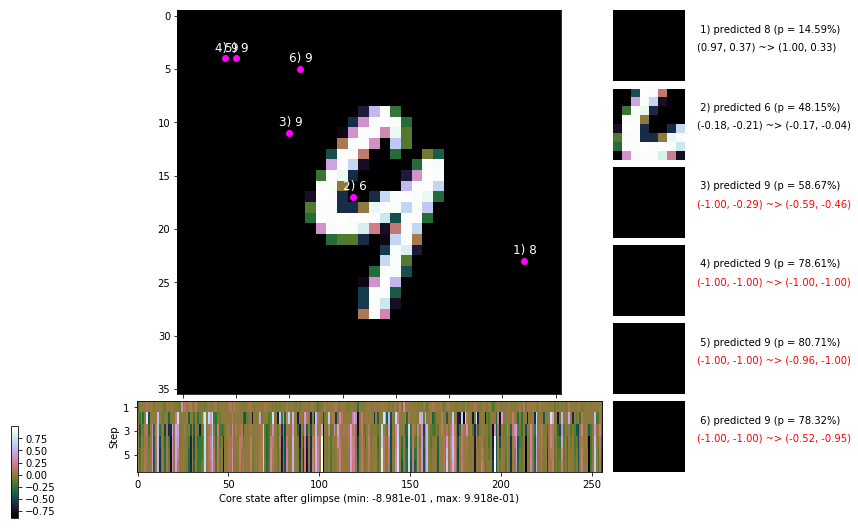

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 139.1 ms/b | lr: 2.98e-04 | grad 2norm: 18.41 | grad inf norm:  5.319
         Weights || abs max:  3.65 ( 1187.62) | mean: -2.24e-04 ( 0.01) | var: 9.58e-02 (   28.20)
          Biases || abs max:  2.64 (  110.12) | mean: -1.31e-01 ( 0.11) | var: 7.61e-02 (   49.74)
                    class loss: 0.738 | steps: 2.739 | reward:  3.735 | acc.: 74.13%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 133.8 ms/b | lr: 2.98e-04 | grad 2norm: 18.75 | grad inf norm:  5.506
         Weights || abs max:  3.64 ( 3318.87) | mean: -2.24e-04 ( 0.01) | var: 9.58e-02 ( 2284.29)
          Biases || abs max:  2.64 (  226.68) | mean: -1.31e-01 ( 0.16) | var: 7.61e-02 (  337.95)
                    class loss: 0.727 | steps: 2.736 | reward:  3.740 | acc.: 74.00%

	Target class: 4 | Discounted rewards: [3.686, 4.095, 3.4

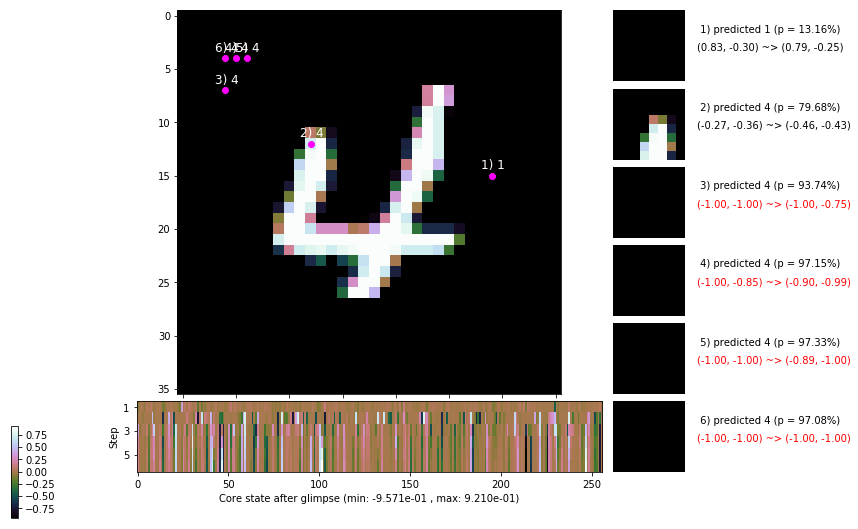

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 135.1 ms/b | lr: 2.97e-04 | grad 2norm: 18.40 | grad inf norm:  5.443
         Weights || abs max:  3.64 ( 4295.03) | mean: -2.27e-04 ( 0.01) | var: 9.59e-02 (  939.59)
          Biases || abs max:  2.65 (  124.53) | mean: -1.31e-01 ( 0.11) | var: 7.61e-02 (   52.52)
                    class loss: 0.748 | steps: 2.782 | reward:  3.712 | acc.: 74.00%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 135.8 ms/b | lr: 2.97e-04 | grad 2norm: 18.81 | grad inf norm:  5.643
         Weights || abs max:  3.64 ( 1638.25) | mean: -2.25e-04 ( 0.01) | var: 9.59e-02 (   55.55)
          Biases || abs max:  2.64 (  819.04) | mean: -1.31e-01 ( 0.39) | var: 7.61e-02 (23686.62)
                    class loss: 0.786 | steps: 2.825 | reward:  3.643 | acc.: 72.33%

	Target class: 9 | Discounted rewards: [2.876, 3.195, 2.4

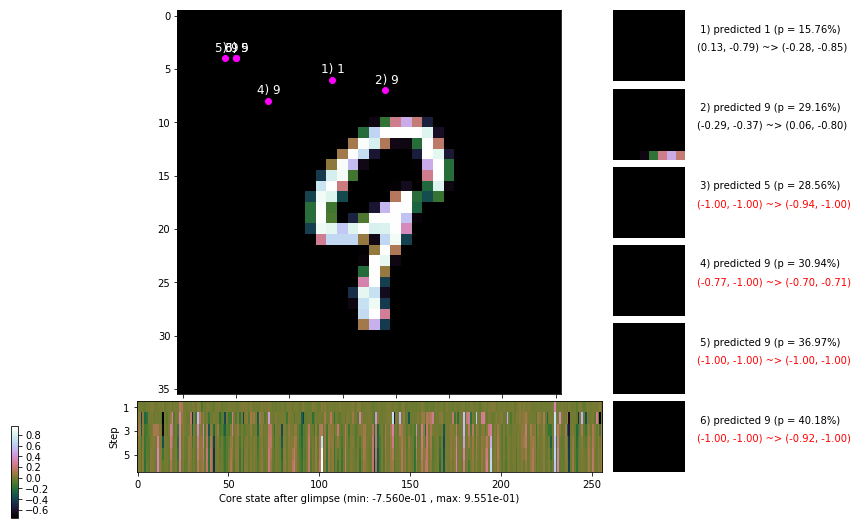

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 1 | Discounted rewards: [3.686, 4.095, 3.439, 2.710, 1.900, 1.000]


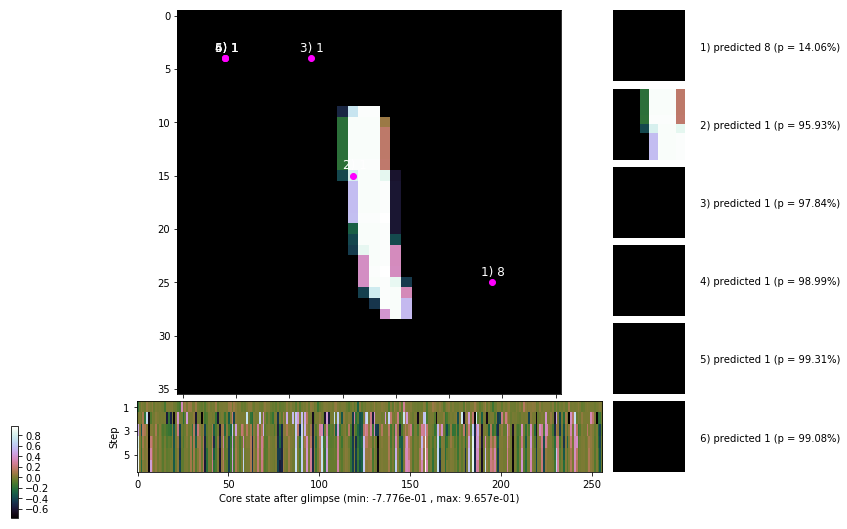


	Target class: 1 | Discounted rewards: [4.686, 4.095, 3.439, 2.710, 1.900, 1.000]


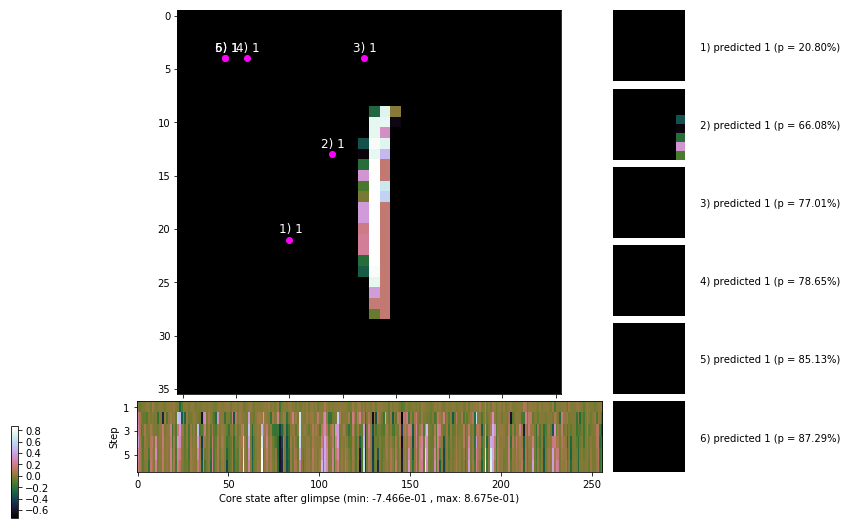

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


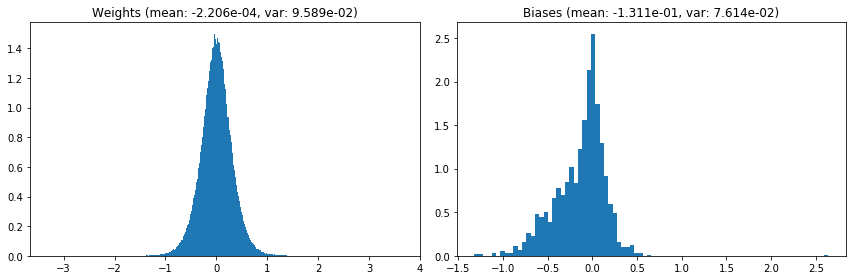

                                      Location network weights and biases


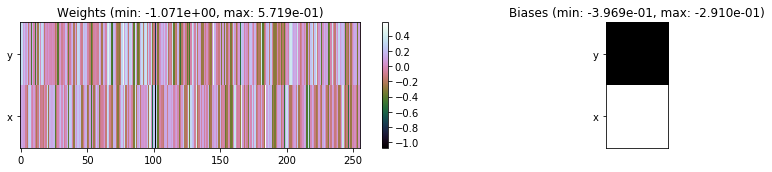

---------------------------------------------------------------------------------------------------------------
Elapsed time:  421.39 sec | TRAIN >> class loss: 0.7462 | steps:  2.772    | reward:  3.7076    | acc.: 73.687% 
                          | VAL   >> class loss: 0.7254 | steps:  2.712 :( | reward:  3.7954 :( | acc.: 74.400% :(


Epoch  82/400) lr = 0.0002965
 b    300/  3000 >> 133.9 ms/b | lr: 2.96e-04 | grad 2norm: 18.53 | grad inf norm:  5.411
         Weights || abs max:  3.65 ( 4599.63) | mean: -2.10e-04 ( 0.01) | var: 9.59e-02 ( 5973.03)
          Biases || abs max:  2.64 (   99.52) | mean: -1.31e-01 ( 0.10) | var: 7.62e-02 (   27.14)
                    class loss: 0.753 | steps: 2.790 | reward:  3.694 | acc.: 73.33%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 136.0 ms/b | lr: 2.96e-04 | grad 2norm: 18.90 | grad inf norm:  5.590
         Weights || abs max:  3.65 (  877.37) | mean: -1.87e-04 ( 0

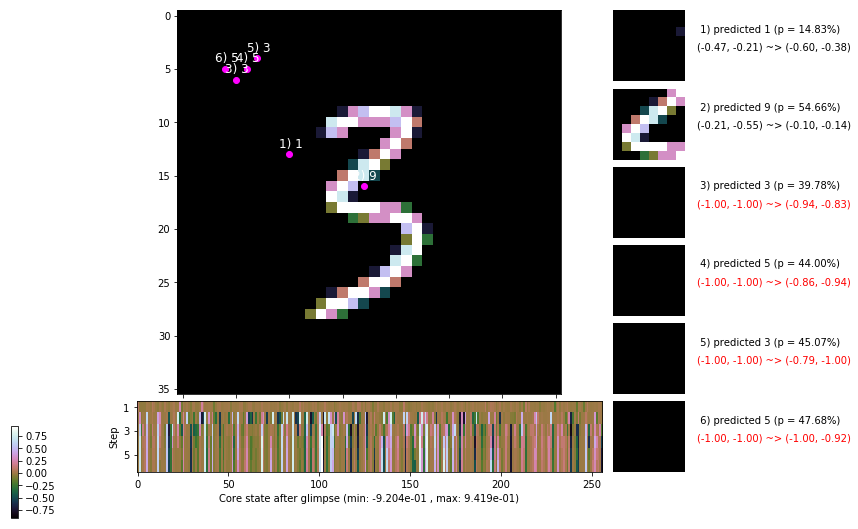

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 140.6 ms/b | lr: 2.95e-04 | grad 2norm: 18.67 | grad inf norm:  5.679
         Weights || abs max:  3.65 ( 1335.48) | mean: -1.91e-04 ( 0.01) | var: 9.59e-02 (   16.82)
          Biases || abs max:  2.64 (  251.51) | mean: -1.31e-01 ( 0.17) | var: 7.62e-02 ( 2086.21)
                    class loss: 0.730 | steps: 2.787 | reward:  3.715 | acc.: 74.28%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 136.7 ms/b | lr: 2.95e-04 | grad 2norm: 18.65 | grad inf norm:  5.375
         Weights || abs max:  3.65 ( 1874.95) | mean: -1.82e-04 ( 0.01) | var: 9.60e-02 (   83.03)
          Biases || abs max:  2.64 (  151.61) | mean: -1.31e-01 ( 0.14) | var: 7.62e-02 (  438.62)
                    class loss: 0.728 | steps: 2.739 | reward:  3.732 | acc.: 73.58%

	Target class: 8 | Discounted rewards: [2.786, 3.095, 3.4

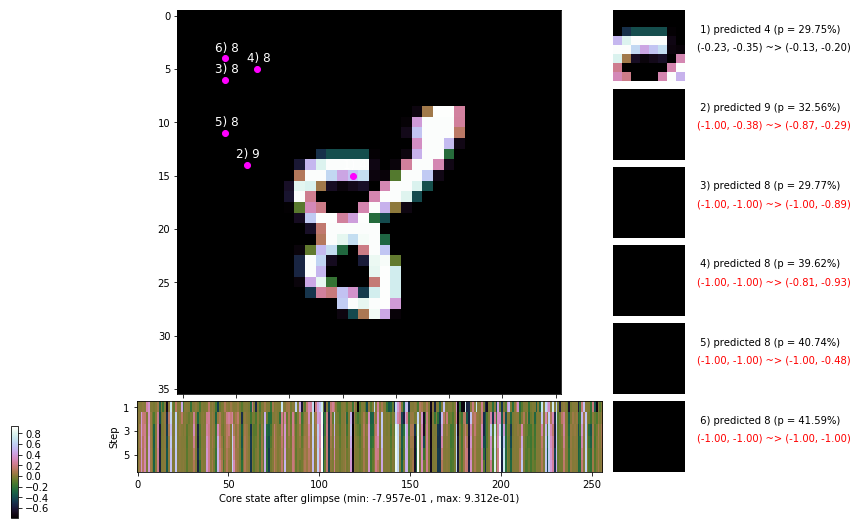

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 139.3 ms/b | lr: 2.94e-04 | grad 2norm: 18.72 | grad inf norm:  5.593
         Weights || abs max:  3.65 (  995.61) | mean: -1.73e-04 ( 0.01) | var: 9.60e-02 (   10.32)
          Biases || abs max:  2.65 (  126.28) | mean: -1.31e-01 ( 0.11) | var: 7.62e-02 (   99.39)
                    class loss: 0.740 | steps: 2.747 | reward:  3.746 | acc.: 74.12%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 135.5 ms/b | lr: 2.94e-04 | grad 2norm: 18.51 | grad inf norm:  5.330
         Weights || abs max:  3.66 ( 1615.22) | mean: -1.78e-04 ( 0.01) | var: 9.60e-02 (  126.05)
          Biases || abs max:  2.65 (  241.01) | mean: -1.31e-01 ( 0.21) | var: 7.62e-02 ( 4094.21)
                    class loss: 0.736 | steps: 2.768 | reward:  3.729 | acc.: 73.82%

	Target class: 3 | Discounted rewards: [4.686, 4.095, 3.4

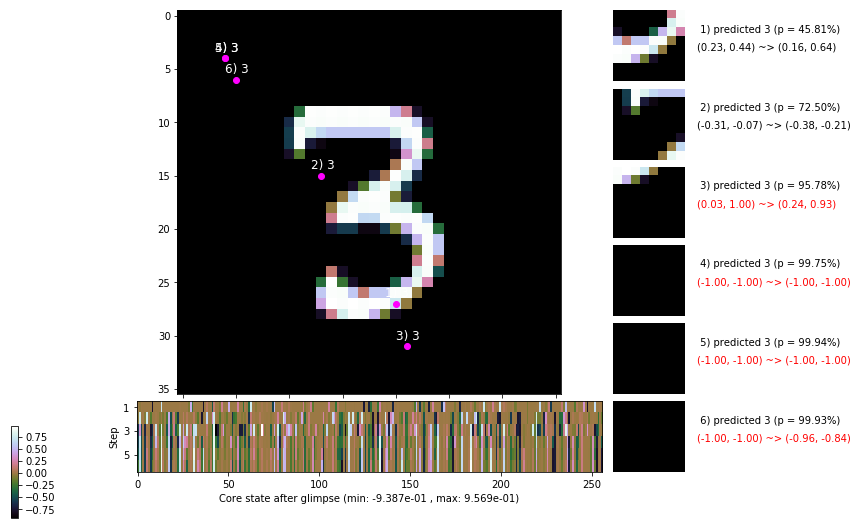

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 136.8 ms/b | lr: 2.94e-04 | grad 2norm: 18.57 | grad inf norm:  5.461
         Weights || abs max:  3.66 ( 2239.90) | mean: -1.76e-04 ( 0.01) | var: 9.60e-02 (  113.17)
          Biases || abs max:  2.65 (   88.31) | mean: -1.32e-01 ( 0.10) | var: 7.62e-02 (   37.25)
                    class loss: 0.718 | steps: 2.741 | reward:  3.756 | acc.: 75.37%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 141.2 ms/b | lr: 2.93e-04 | grad 2norm: 18.88 | grad inf norm:  5.648
         Weights || abs max:  3.67 (83795.18) | mean: -1.80e-04 ( 0.16) | var: 9.60e-02 (3391847.75)
          Biases || abs max:  2.65 (   80.96) | mean: -1.32e-01 ( 0.09) | var: 7.63e-02 (   31.16)
                    class loss: 0.754 | steps: 2.788 | reward:  3.688 | acc.: 73.12%

	Target class: 2 | Discounted rewards: [3.095, 3.439, 2

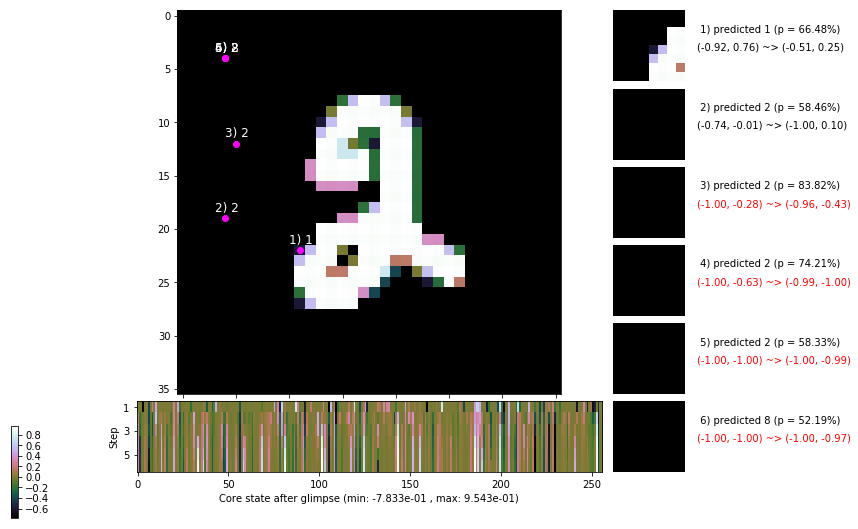

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 146.2 ms/b | lr: 2.93e-04 | grad 2norm: 18.62 | grad inf norm:  5.483
         Weights || abs max:  3.68 ( 1645.46) | mean: -1.89e-04 ( 0.01) | var: 9.61e-02 (   40.18)
          Biases || abs max:  2.65 (  246.88) | mean: -1.32e-01 ( 0.17) | var: 7.63e-02 (  450.71)
                    class loss: 0.737 | steps: 2.792 | reward:  3.704 | acc.: 74.03%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 149.8 ms/b | lr: 2.92e-04 | grad 2norm: 18.63 | grad inf norm:  5.482
         Weights || abs max:  3.67 ( 1497.25) | mean: -1.72e-04 ( 0.01) | var: 9.61e-02 (   41.27)
          Biases || abs max:  2.65 ( 2100.47) | mean: -1.32e-01 ( 0.90) | var: 7.63e-02 (415861.03)
                    class loss: 0.762 | steps: 2.781 | reward:  3.679 | acc.: 73.42%

	Target class: 1 | Discounted rewards: [4.686, 4.095, 3.

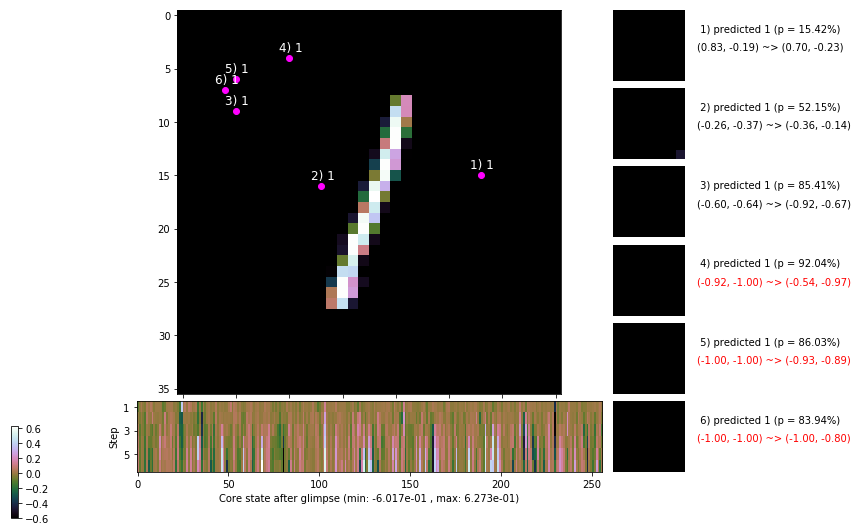

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 0 | Discounted rewards: [0.000, 0.000, 0.000, 0.000, 0.000, 0.000]


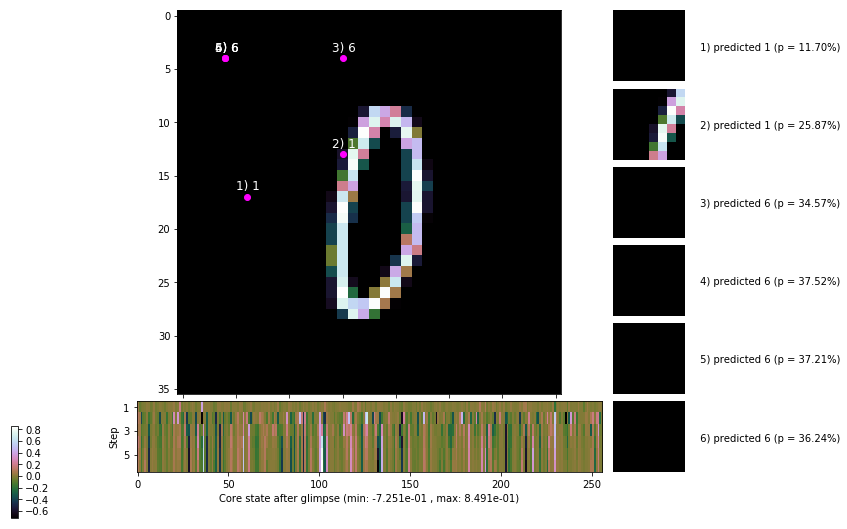


	Target class: 9 | Discounted rewards: [1.247, 1.385, 1.539, 1.710, 1.900, 1.000]


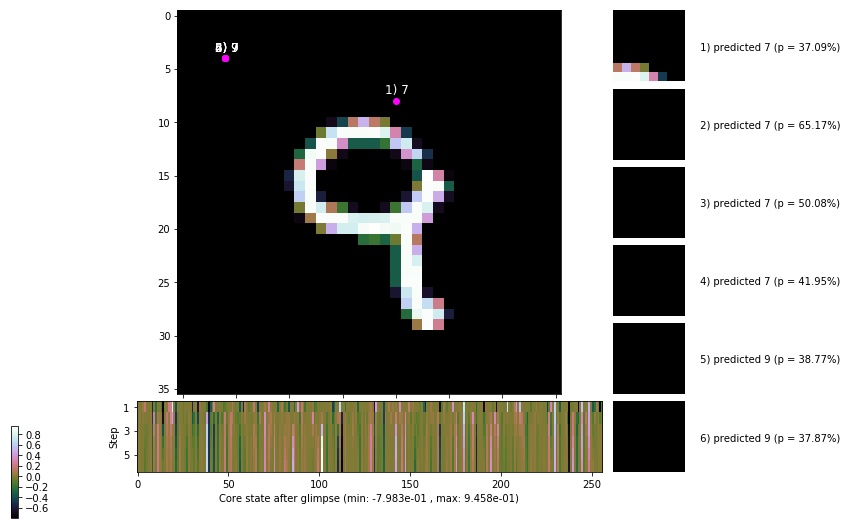

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


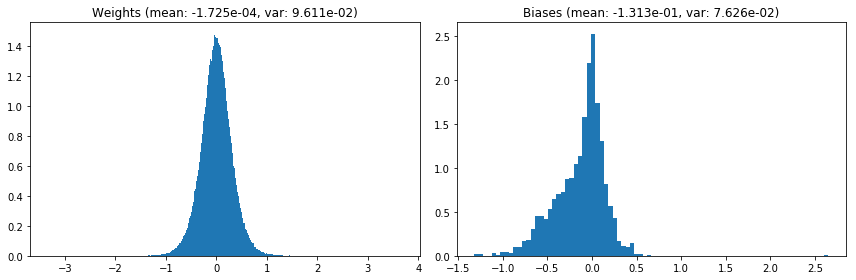

                                      Location network weights and biases


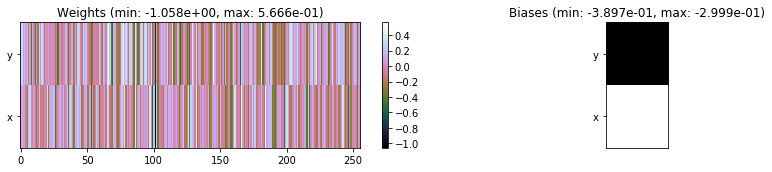

---------------------------------------------------------------------------------------------------------------
Elapsed time:  419.67 sec | TRAIN >> class loss: 0.7424 | steps:  2.776 :( | reward:  3.7084    | acc.: 73.783% 
                          | VAL   >> class loss: 0.6969 | steps:  2.701 :( | reward:  3.8202 :( | acc.: 75.140% :(


Epoch  83/400) lr = 0.0002921
 b    300/  3000 >> 149.2 ms/b | lr: 2.92e-04 | grad 2norm: 19.03 | grad inf norm:  5.715
         Weights || abs max:  3.67 ( 2432.70) | mean: -1.71e-04 ( 0.01) | var: 9.61e-02 (  445.62)
          Biases || abs max:  2.65 (  292.68) | mean: -1.31e-01 ( 0.20) | var: 7.62e-02 ( 1620.61)
                    class loss: 0.750 | steps: 2.773 | reward:  3.705 | acc.: 73.30%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 145.5 ms/b | lr: 2.92e-04 | grad 2norm: 18.74 | grad inf norm:  5.723
         Weights || abs max:  3.68 ( 1058.24) | mean: -1.63e-04 ( 0

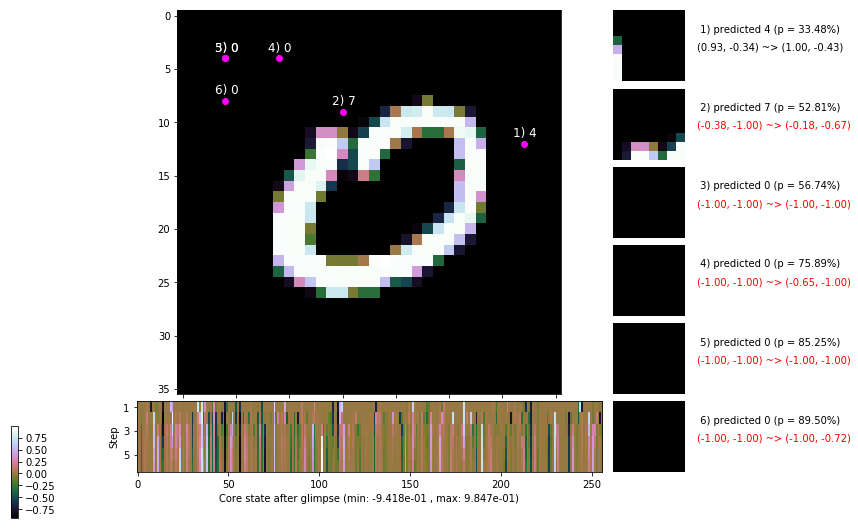

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 144.7 ms/b | lr: 2.91e-04 | grad 2norm: 18.83 | grad inf norm:  5.539
         Weights || abs max:  3.68 (  796.01) | mean: -1.46e-04 ( 0.01) | var: 9.62e-02 (   11.50)
          Biases || abs max:  2.65 (  112.60) | mean: -1.31e-01 ( 0.12) | var: 7.61e-02 (   61.63)
                    class loss: 0.759 | steps: 2.764 | reward:  3.689 | acc.: 72.87%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 143.6 ms/b | lr: 2.91e-04 | grad 2norm: 18.67 | grad inf norm:  5.375
         Weights || abs max:  3.67 ( 1203.65) | mean: -1.59e-04 ( 0.01) | var: 9.62e-02 (   40.61)
          Biases || abs max:  2.65 (  856.72) | mean: -1.32e-01 ( 0.42) | var: 7.61e-02 (52726.26)
                    class loss: 0.757 | steps: 2.829 | reward:  3.668 | acc.: 73.13%

	Target class: 5 | Discounted rewards: [1.000, 0.000, 0.0

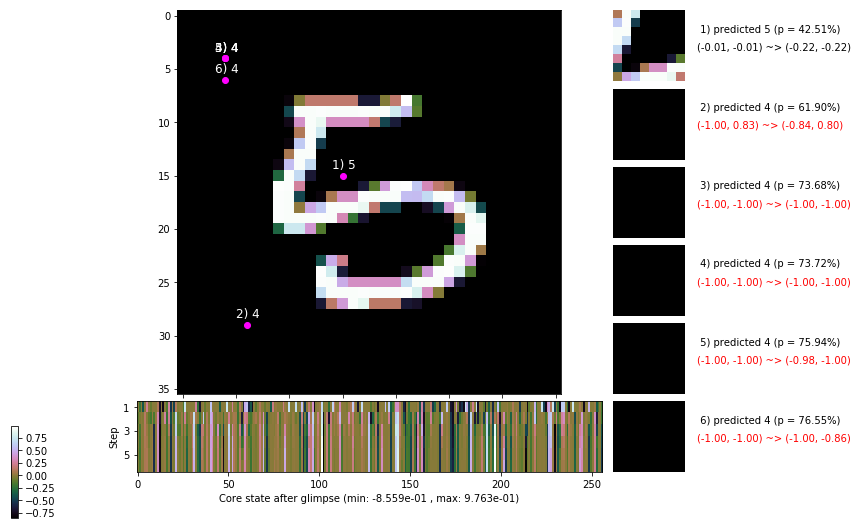

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 143.6 ms/b | lr: 2.90e-04 | grad 2norm: 18.49 | grad inf norm:  5.602
         Weights || abs max:  3.67 ( 2889.64) | mean: -1.70e-04 ( 0.01) | var: 9.62e-02 ( 1339.48)
          Biases || abs max:  2.66 (  129.36) | mean: -1.31e-01 ( 0.12) | var: 7.60e-02 (   37.26)
                    class loss: 0.718 | steps: 2.732 | reward:  3.775 | acc.: 74.85%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 142.0 ms/b | lr: 2.90e-04 | grad 2norm: 18.59 | grad inf norm:  5.304
         Weights || abs max:  3.67 ( 1718.14) | mean: -1.78e-04 ( 0.01) | var: 9.62e-02 (  244.83)
          Biases || abs max:  2.66 (  253.40) | mean: -1.31e-01 ( 0.17) | var: 7.60e-02 (  514.91)
                    class loss: 0.735 | steps: 2.761 | reward:  3.720 | acc.: 74.07%

	Target class: 6 | Discounted rewards: [2.786, 3.095, 3.4

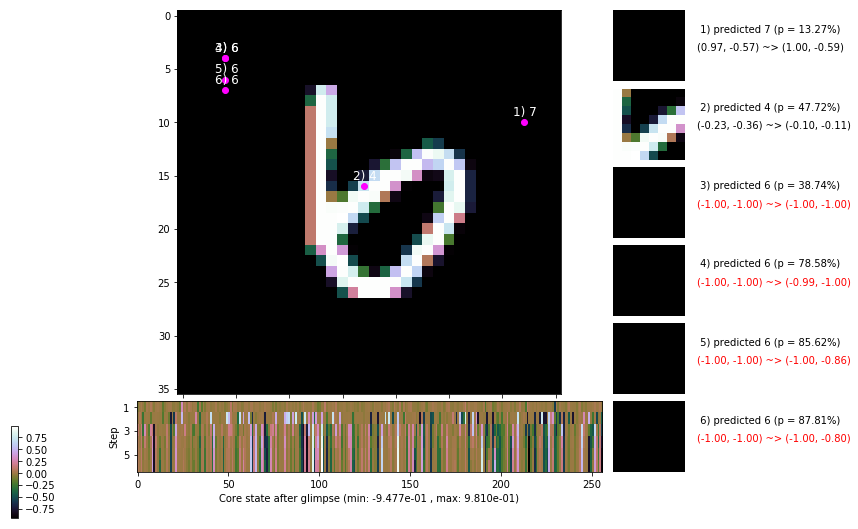

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 143.5 ms/b | lr: 2.89e-04 | grad 2norm: 18.57 | grad inf norm:  5.720
         Weights || abs max:  3.66 ( 2890.64) | mean: -1.77e-04 ( 0.01) | var: 9.62e-02 ( 1110.56)
          Biases || abs max:  2.65 (  320.51) | mean: -1.31e-01 ( 0.20) | var: 7.60e-02 ( 2965.79)
                    class loss: 0.760 | steps: 2.811 | reward:  3.661 | acc.: 72.70%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 142.0 ms/b | lr: 2.89e-04 | grad 2norm: 18.43 | grad inf norm:  5.409
         Weights || abs max:  3.67 ( 2412.46) | mean: -1.80e-04 ( 0.01) | var: 9.62e-02 (  376.12)
          Biases || abs max:  2.65 (  253.63) | mean: -1.31e-01 ( 0.18) | var: 7.61e-02 (  654.47)
                    class loss: 0.791 | steps: 2.830 | reward:  3.651 | acc.: 72.20%

	Target class: 3 | Discounted rewards: [2.786, 3.095, 3.4

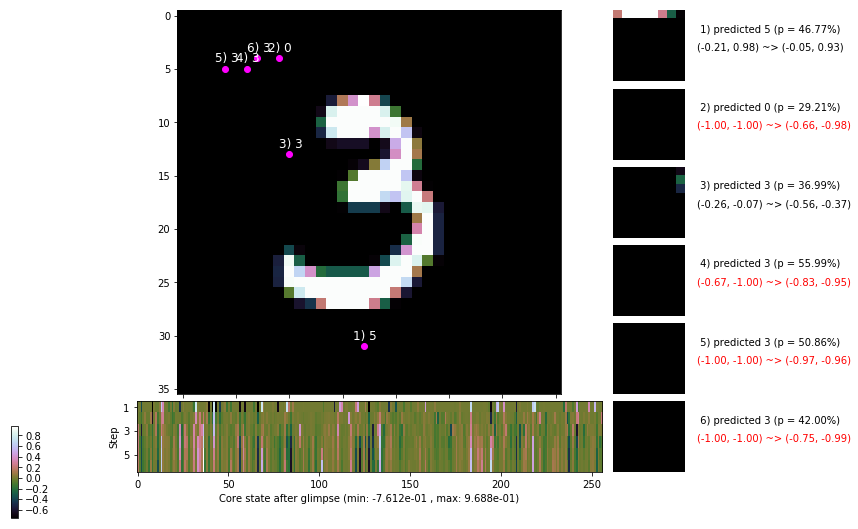

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 145.8 ms/b | lr: 2.88e-04 | grad 2norm: 18.49 | grad inf norm:  5.572
         Weights || abs max:  3.67 ( 1515.80) | mean: -1.81e-04 ( 0.01) | var: 9.63e-02 (   30.22)
          Biases || abs max:  2.65 (  119.76) | mean: -1.32e-01 ( 0.12) | var: 7.61e-02 (  108.02)
                    class loss: 0.806 | steps: 2.838 | reward:  3.632 | acc.: 71.97%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 141.2 ms/b | lr: 2.88e-04 | grad 2norm: 18.52 | grad inf norm:  5.561
         Weights || abs max:  3.67 ( 1624.57) | mean: -1.73e-04 ( 0.01) | var: 9.63e-02 (   57.76)
          Biases || abs max:  2.64 (   85.31) | mean: -1.31e-01 ( 0.10) | var: 7.61e-02 (  210.04)
                    class loss: 0.783 | steps: 2.808 | reward:  3.664 | acc.: 72.23%

	Target class: 0 | Discounted rewards: [2.786, 3.095, 3.4

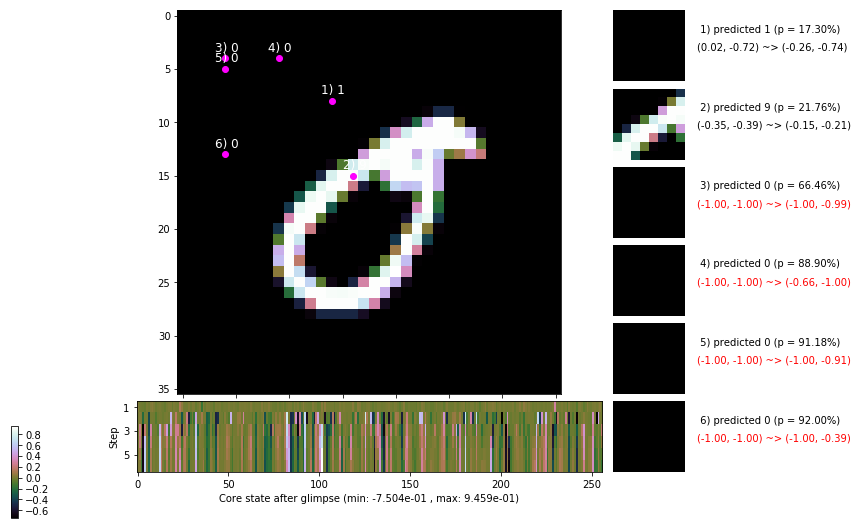

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 7 | Discounted rewards: [2.786, 3.095, 3.439, 2.710, 1.900, 1.000]


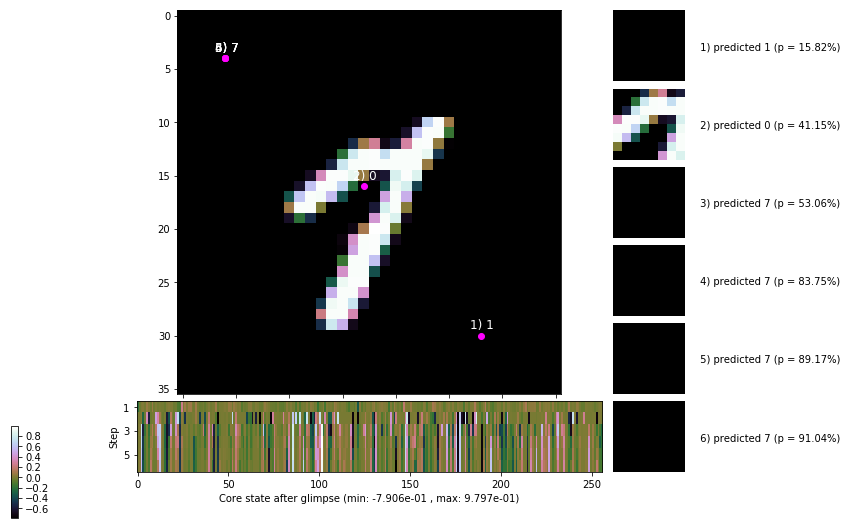


	Target class: 0 | Discounted rewards: [2.786, 3.095, 3.439, 2.710, 1.900, 1.000]


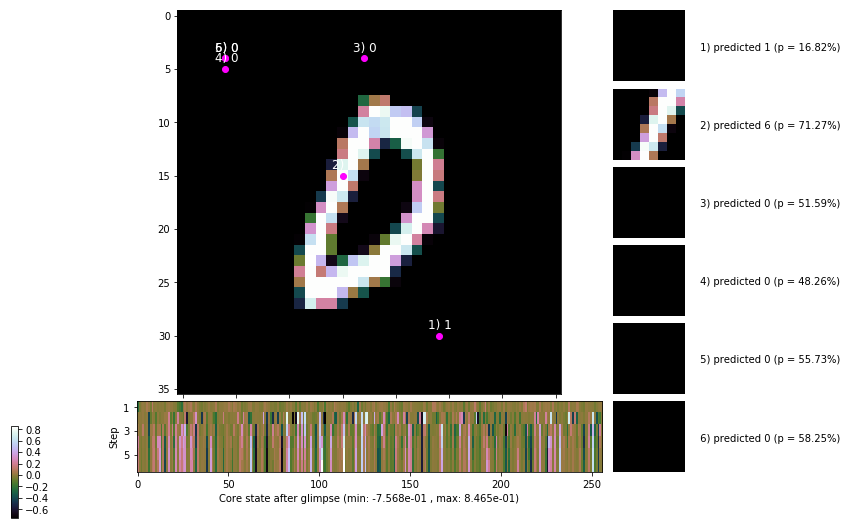

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


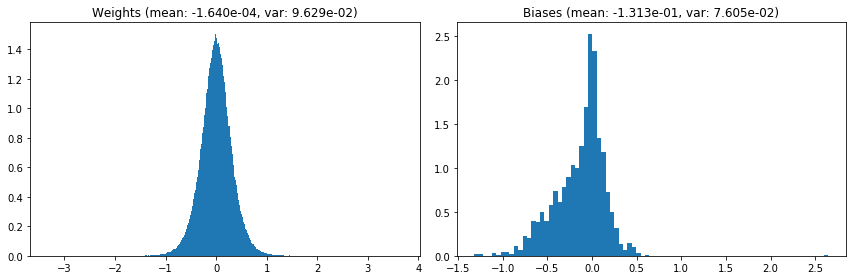

                                      Location network weights and biases


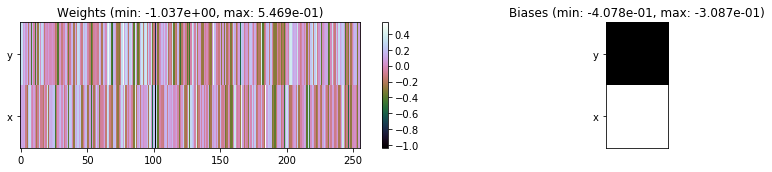

---------------------------------------------------------------------------------------------------------------
Elapsed time:  432.88 sec | TRAIN >> class loss: 0.7599 | steps:  2.792 :( | reward:  3.6883 :( | acc.: 73.142% :(
                          | VAL   >> class loss: 0.7476 | steps:  2.764 :( | reward:  3.7278 :( | acc.: 73.280% :(


Epoch  84/400) lr = 0.0002878
 b    300/  3000 >> 142.9 ms/b | lr: 2.87e-04 | grad 2norm: 18.69 | grad inf norm:  5.676
         Weights || abs max:  3.67 ( 4098.59) | mean: -1.60e-04 ( 0.01) | var: 9.63e-02 ( 3260.35)
          Biases || abs max:  2.64 (  175.65) | mean: -1.31e-01 ( 0.14) | var: 7.61e-02 (  227.81)
                    class loss: 0.791 | steps: 2.846 | reward:  3.644 | acc.: 71.88%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 142.2 ms/b | lr: 2.87e-04 | grad 2norm: 18.51 | grad inf norm:  5.635
         Weights || abs max:  3.68 ( 2114.96) | mean: -1.61e-04 (

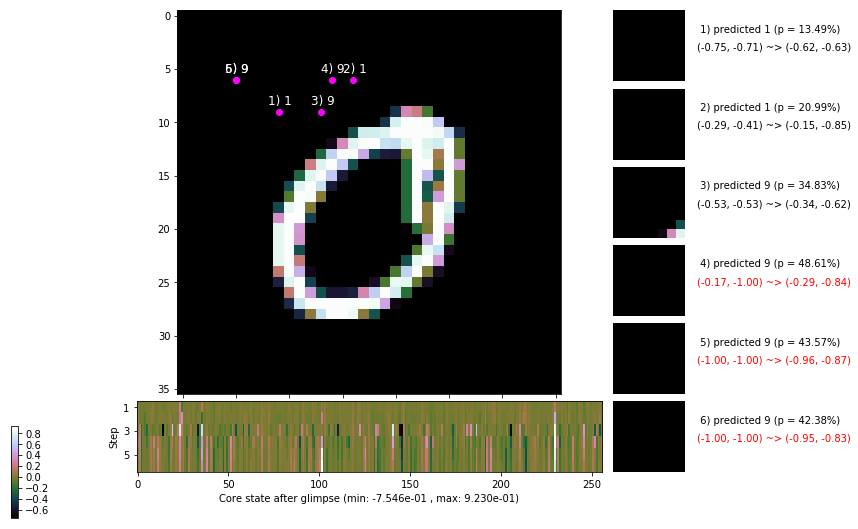

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 142.9 ms/b | lr: 2.87e-04 | grad 2norm: 18.59 | grad inf norm:  5.613
         Weights || abs max:  3.68 ( 1488.64) | mean: -1.74e-04 ( 0.01) | var: 9.63e-02 (   38.13)
          Biases || abs max:  2.63 (  404.91) | mean: -1.32e-01 ( 0.27) | var: 7.63e-02 ( 4350.86)
                    class loss: 0.781 | steps: 2.831 | reward:  3.646 | acc.: 72.27%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 147.7 ms/b | lr: 2.86e-04 | grad 2norm: 18.29 | grad inf norm:  5.653
         Weights || abs max:  3.68 (11541.88) | mean: -1.82e-04 ( 0.03) | var: 9.64e-02 (54026.31)
          Biases || abs max:  2.63 (  189.50) | mean: -1.32e-01 ( 0.15) | var: 7.62e-02 (  182.18)
                    class loss: 0.779 | steps: 2.804 | reward:  3.675 | acc.: 72.93%

	Target class: 8 | Discounted rewards: [4.686, 4.095, 3.4

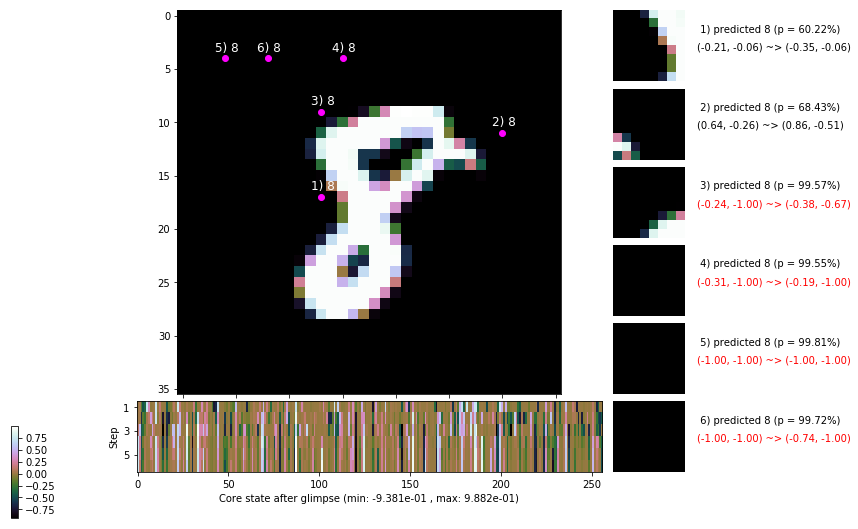

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 145.8 ms/b | lr: 2.86e-04 | grad 2norm: 18.27 | grad inf norm:  5.270
         Weights || abs max:  3.68 ( 1580.18) | mean: -1.81e-04 ( 0.01) | var: 9.64e-02 (  217.07)
          Biases || abs max:  2.63 (   70.98) | mean: -1.32e-01 ( 0.09) | var: 7.61e-02 (    9.97)
                    class loss: 0.779 | steps: 2.829 | reward:  3.650 | acc.: 72.57%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 149.6 ms/b | lr: 2.85e-04 | grad 2norm: 18.16 | grad inf norm:  5.561
         Weights || abs max:  3.68 ( 1502.26) | mean: -1.96e-04 ( 0.01) | var: 9.64e-02 (  199.08)
          Biases || abs max:  2.63 ( 8602.82) | mean: -1.32e-01 ( 3.41) | var: 7.61e-02 (8398367.00)
                    class loss: 0.756 | steps: 2.808 | reward:  3.689 | acc.: 73.33%

	Target class: 0 | Discounted rewards: [0.000, 0.000, 0

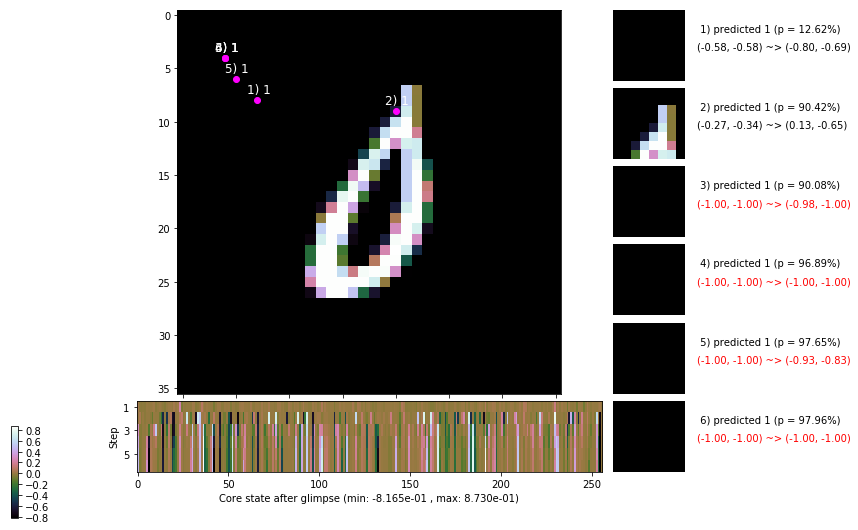

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 151.8 ms/b | lr: 2.85e-04 | grad 2norm: 18.32 | grad inf norm:  5.514
         Weights || abs max:  3.68 ( 1565.83) | mean: -2.06e-04 ( 0.01) | var: 9.64e-02 (  208.25)
          Biases || abs max:  2.63 (  110.97) | mean: -1.32e-01 ( 0.12) | var: 7.61e-02 (  120.60)
                    class loss: 0.763 | steps: 2.822 | reward:  3.664 | acc.: 72.80%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 144.4 ms/b | lr: 2.85e-04 | grad 2norm: 18.62 | grad inf norm:  5.652
         Weights || abs max:  3.68 (  742.36) | mean: -2.00e-04 ( 0.01) | var: 9.64e-02 (   30.42)
          Biases || abs max:  2.62 (  228.88) | mean: -1.32e-01 ( 0.17) | var: 7.61e-02 (  930.63)
                    class loss: 0.756 | steps: 2.833 | reward:  3.664 | acc.: 73.38%

	Target class: 9 | Discounted rewards: [0.900, 1.000, 0.0

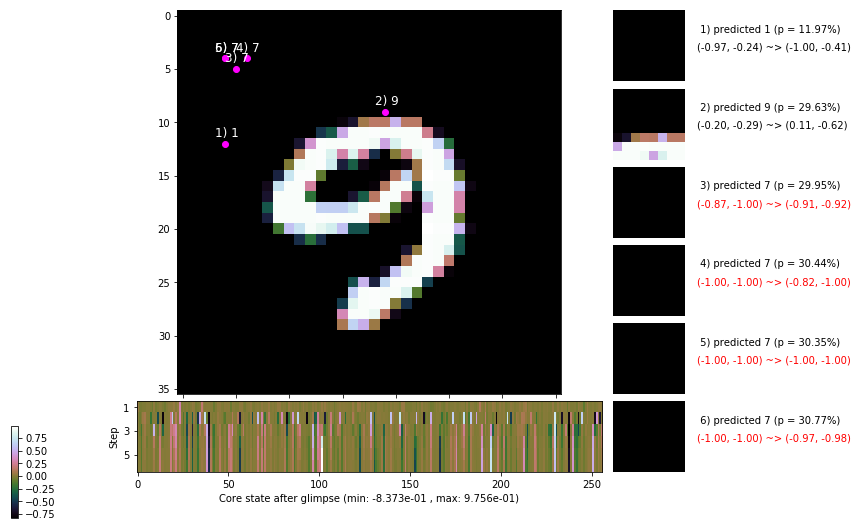

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 143.1 ms/b | lr: 2.84e-04 | grad 2norm: 18.42 | grad inf norm:  5.369
         Weights || abs max:  3.68 (  722.63) | mean: -1.92e-04 ( 0.01) | var: 9.64e-02 (    6.21)
          Biases || abs max:  2.63 (  109.57) | mean: -1.32e-01 ( 0.12) | var: 7.62e-02 (  150.33)
                    class loss: 0.760 | steps: 2.748 | reward:  3.730 | acc.: 73.35%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 142.5 ms/b | lr: 2.84e-04 | grad 2norm: 18.83 | grad inf norm:  5.683
         Weights || abs max:  3.68 ( 1141.09) | mean: -2.00e-04 ( 0.01) | var: 9.65e-02 (   39.34)
          Biases || abs max:  2.63 (  383.62) | mean: -1.32e-01 ( 0.24) | var: 7.62e-02 ( 5556.72)
                    class loss: 0.776 | steps: 2.808 | reward:  3.674 | acc.: 72.70%

	Target class: 1 | Discounted rewards: [4.686, 4.095, 3.4

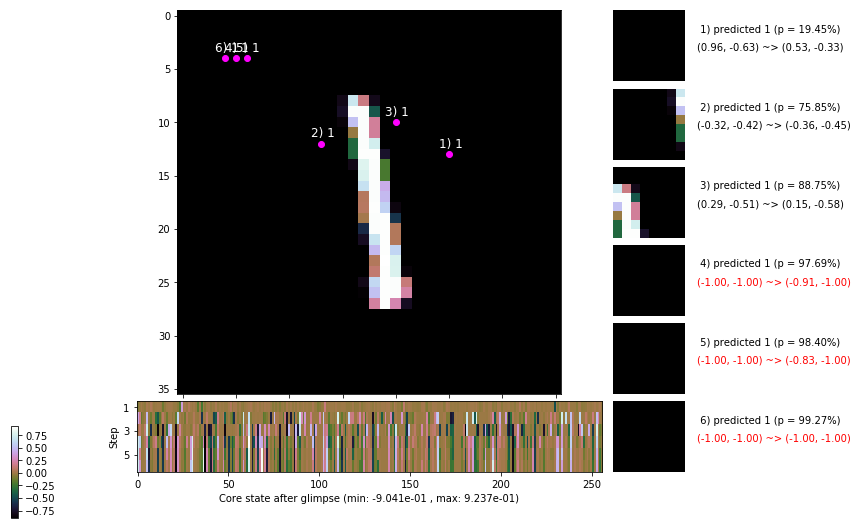

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 1 | Discounted rewards: [4.686, 4.095, 3.439, 2.710, 1.900, 1.000]


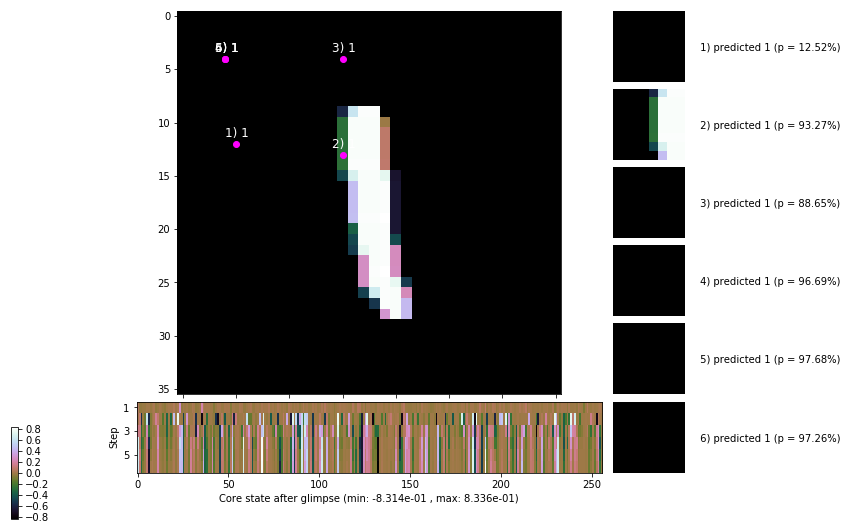


	Target class: 9 | Discounted rewards: [3.686, 4.095, 3.439, 2.710, 1.900, 1.000]


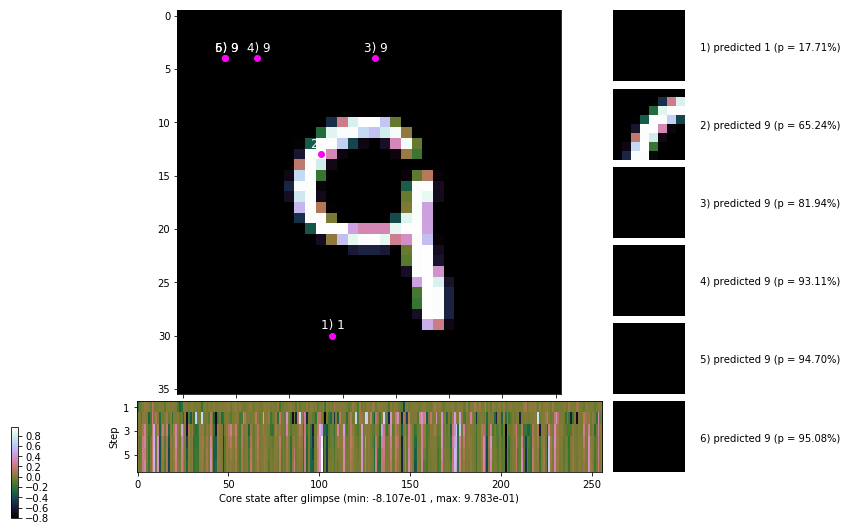

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


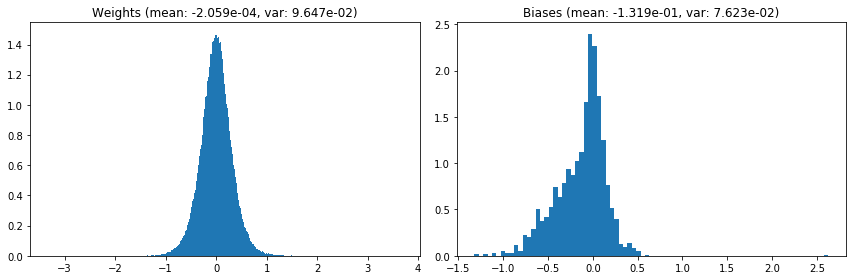

                                      Location network weights and biases


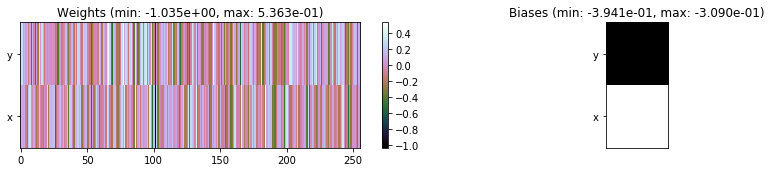

---------------------------------------------------------------------------------------------------------------
Elapsed time:  436.67 sec | TRAIN >> class loss: 0.7733 | steps:  2.818 :( | reward:  3.6648 :( | acc.: 72.678% :(
                          | VAL   >> class loss: 0.7446 | steps:  2.759 :( | reward:  3.7508 :( | acc.: 73.760% :(


Epoch  85/400) lr = 0.0002835
 b    300/  3000 >> 140.7 ms/b | lr: 2.83e-04 | grad 2norm: 18.45 | grad inf norm:  5.584
         Weights || abs max:  3.68 ( 1244.80) | mean: -2.06e-04 ( 0.01) | var: 9.65e-02 (   21.76)
          Biases || abs max:  2.63 (  266.69) | mean: -1.32e-01 ( 0.16) | var: 7.62e-02 ( 4136.42)
                    class loss: 0.769 | steps: 2.803 | reward:  3.683 | acc.: 72.88%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 137.0 ms/b | lr: 2.83e-04 | grad 2norm: 18.49 | grad inf norm:  5.716
         Weights || abs max:  3.69 ( 1430.20) | mean: -2.17e-04 (

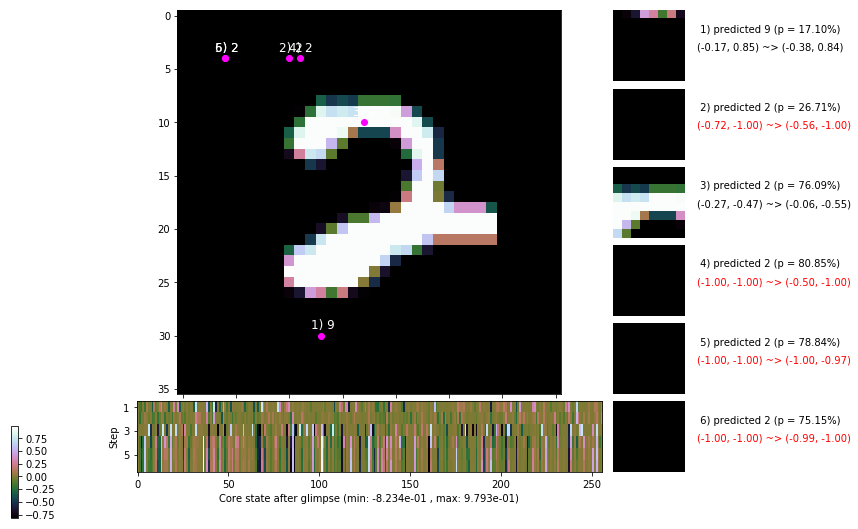

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 137.4 ms/b | lr: 2.82e-04 | grad 2norm: 18.73 | grad inf norm:  5.950
         Weights || abs max:  3.70 ( 2346.87) | mean: -2.21e-04 ( 0.01) | var: 9.65e-02 (  592.95)
          Biases || abs max:  2.63 (  143.85) | mean: -1.32e-01 ( 0.14) | var: 7.62e-02 (  103.06)
                    class loss: 0.795 | steps: 2.844 | reward:  3.639 | acc.: 72.00%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 134.1 ms/b | lr: 2.82e-04 | grad 2norm: 18.32 | grad inf norm:  5.479
         Weights || abs max:  3.70 ( 1814.52) | mean: -2.07e-04 ( 0.01) | var: 9.65e-02 (   78.82)
          Biases || abs max:  2.62 (  182.66) | mean: -1.32e-01 ( 0.17) | var: 7.62e-02 (  296.17)
                    class loss: 0.790 | steps: 2.834 | reward:  3.635 | acc.: 72.30%

	Target class: 9 | Discounted rewards: [3.686, 4.095, 3.4

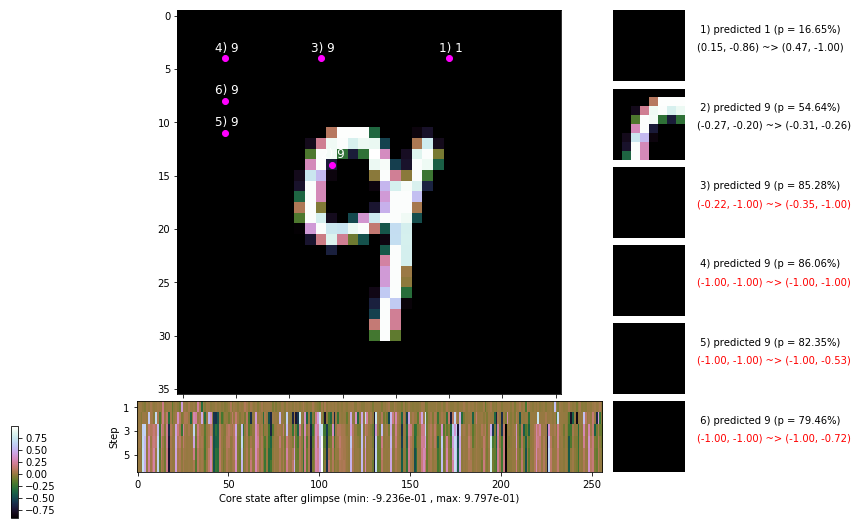

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 136.6 ms/b | lr: 2.81e-04 | grad 2norm: 18.16 | grad inf norm:  5.600
         Weights || abs max:  3.70 ( 1767.39) | mean: -2.00e-04 ( 0.01) | var: 9.66e-02 (  223.25)
          Biases || abs max:  2.62 (  233.83) | mean: -1.32e-01 ( 0.20) | var: 7.61e-02 (  902.70)
                    class loss: 0.775 | steps: 2.824 | reward:  3.663 | acc.: 72.95%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 135.8 ms/b | lr: 2.81e-04 | grad 2norm: 18.39 | grad inf norm:  5.678
         Weights || abs max:  3.69 ( 1384.14) | mean: -2.00e-04 ( 0.01) | var: 9.66e-02 (   63.22)
          Biases || abs max:  2.62 (  180.78) | mean: -1.32e-01 ( 0.14) | var: 7.61e-02 (  260.60)
                    class loss: 0.774 | steps: 2.834 | reward:  3.640 | acc.: 72.43%

	Target class: 8 | Discounted rewards: [0.000, 0.000, 0.0

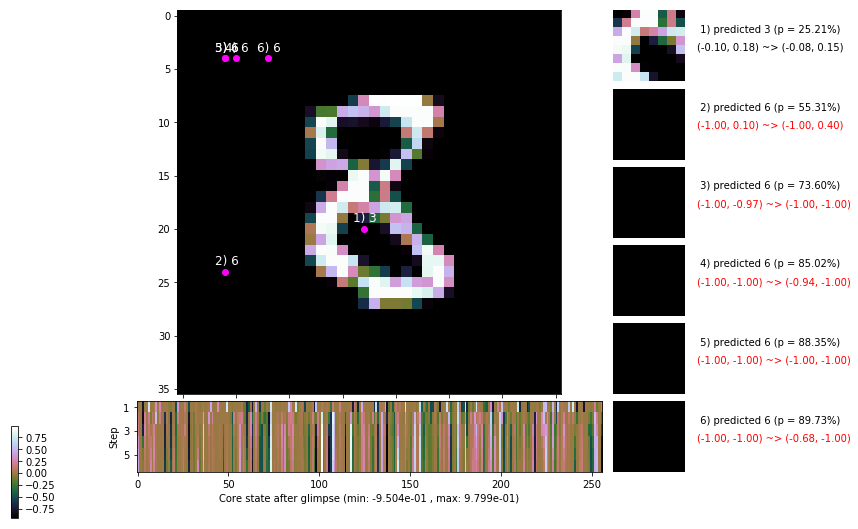

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 137.5 ms/b | lr: 2.81e-04 | grad 2norm: 18.29 | grad inf norm:  5.553
         Weights || abs max:  3.69 ( 4382.93) | mean: -2.06e-04 ( 0.01) | var: 9.66e-02 ( 4304.82)
          Biases || abs max:  2.62 (  423.14) | mean: -1.32e-01 ( 0.24) | var: 7.61e-02 ( 3325.67)
                    class loss: 0.779 | steps: 2.799 | reward:  3.671 | acc.: 72.42%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 136.3 ms/b | lr: 2.80e-04 | grad 2norm: 18.70 | grad inf norm:  5.768
         Weights || abs max:  3.69 ( 2580.02) | mean: -1.98e-04 ( 0.01) | var: 9.66e-02 (  747.30)
          Biases || abs max:  2.62 (  301.77) | mean: -1.32e-01 ( 0.19) | var: 7.61e-02 ( 1197.07)
                    class loss: 0.812 | steps: 2.862 | reward:  3.598 | acc.: 71.23%

	Target class: 4 | Discounted rewards: [3.095, 3.439, 2.7

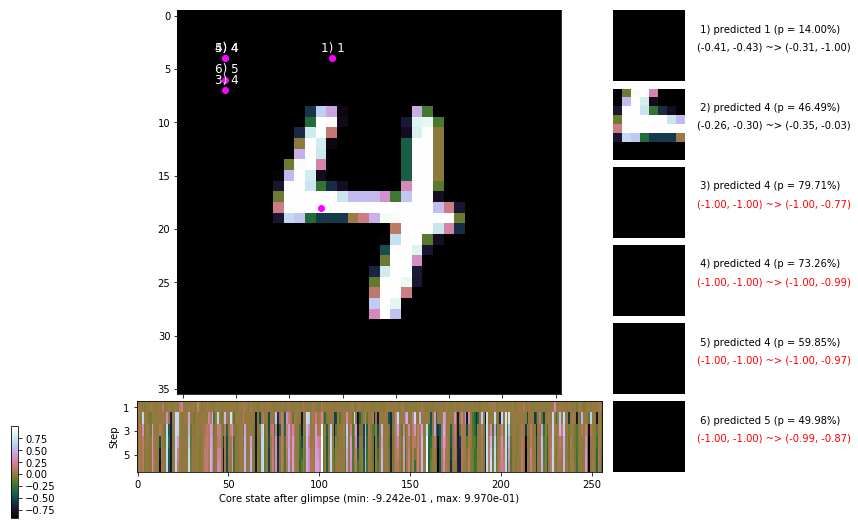

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 137.3 ms/b | lr: 2.80e-04 | grad 2norm: 18.34 | grad inf norm:  5.415
         Weights || abs max:  3.70 (  608.76) | mean: -1.97e-04 ( 0.01) | var: 9.66e-02 (    4.68)
          Biases || abs max:  2.62 (  290.18) | mean: -1.32e-01 ( 0.20) | var: 7.61e-02 ( 1453.15)
                    class loss: 0.743 | steps: 2.769 | reward:  3.702 | acc.: 73.37%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 134.4 ms/b | lr: 2.80e-04 | grad 2norm: 18.25 | grad inf norm:  5.609
         Weights || abs max:  3.70 (  831.72) | mean: -1.91e-04 ( 0.01) | var: 9.67e-02 (    7.15)
          Biases || abs max:  2.62 (  226.32) | mean: -1.32e-01 ( 0.18) | var: 7.62e-02 (  363.30)
                    class loss: 0.771 | steps: 2.805 | reward:  3.670 | acc.: 73.15%

	Target class: 7 | Discounted rewards: [4.686, 4.095, 3.4

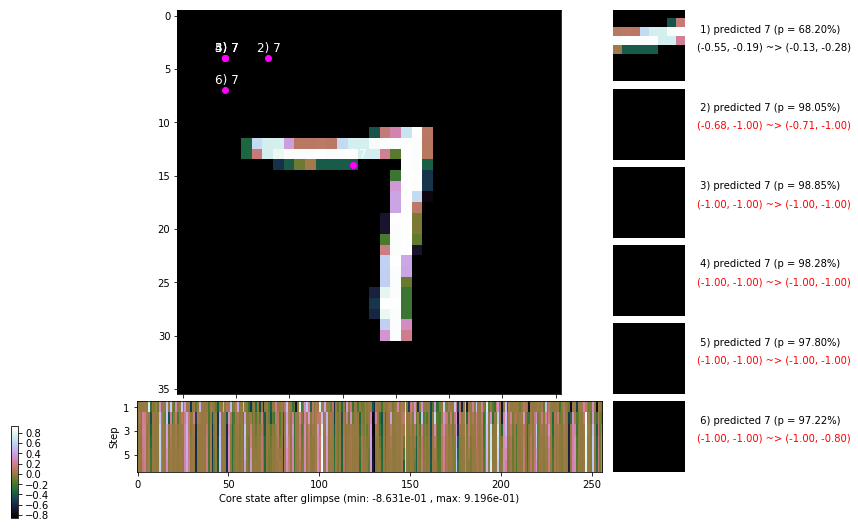

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 5 | Discounted rewards: [1.247, 1.385, 1.539, 1.710, 1.900, 1.000]


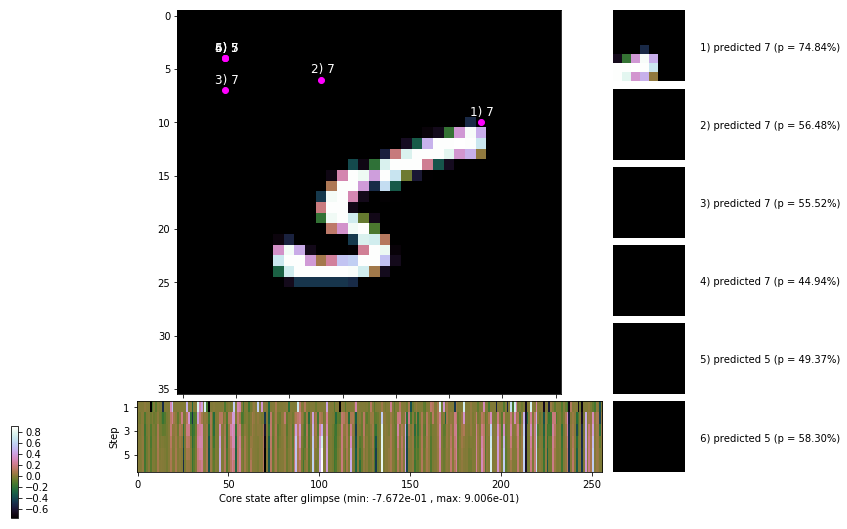


	Target class: 3 | Discounted rewards: [0.000, 0.000, 0.000, 0.000, 0.000, 0.000]


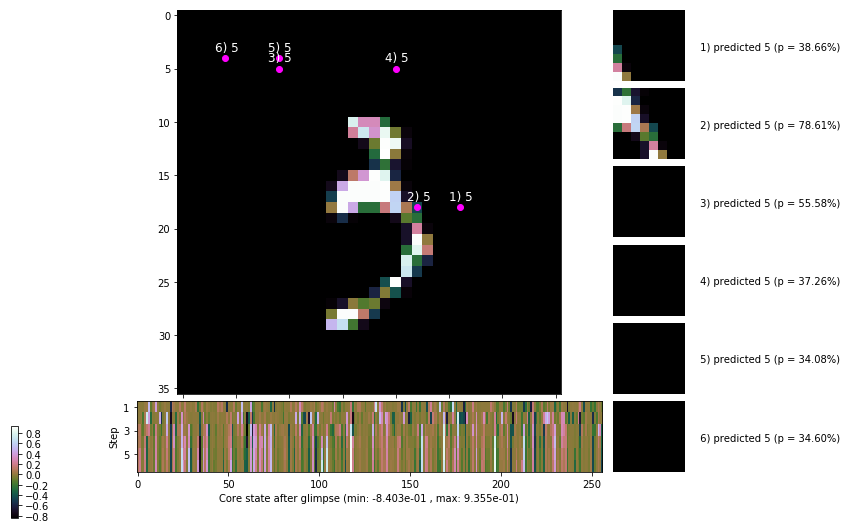

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


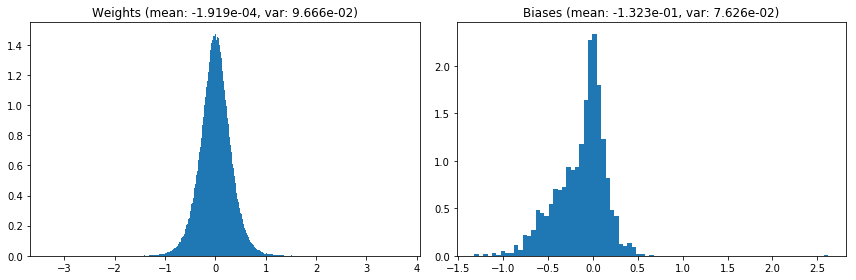

                                      Location network weights and biases


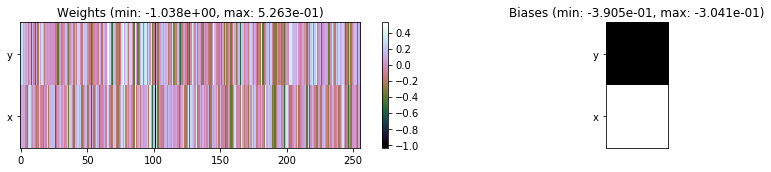

---------------------------------------------------------------------------------------------------------------
Elapsed time:  410.70 sec | TRAIN >> class loss: 0.7789 | steps:  2.820 :( | reward:  3.6535 :( | acc.: 72.485% :(
                          | VAL   >> class loss: 0.7391 | steps:  2.735 :( | reward:  3.7528 :( | acc.: 73.640% :(


Epoch  86/400) lr = 0.0002793
 b    300/  3000 >> 135.4 ms/b | lr: 2.79e-04 | grad 2norm: 18.21 | grad inf norm:  5.500
         Weights || abs max:  3.70 ( 2241.03) | mean: -1.92e-04 ( 0.01) | var: 9.67e-02 (  389.66)
          Biases || abs max:  2.62 (  281.45) | mean: -1.32e-01 ( 0.19) | var: 7.63e-02 ( 1246.22)
                    class loss: 0.767 | steps: 2.832 | reward:  3.655 | acc.: 73.18%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 135.2 ms/b | lr: 2.79e-04 | grad 2norm: 18.52 | grad inf norm:  5.778
         Weights || abs max:  3.70 (  648.46) | mean: -1.95e-04 (

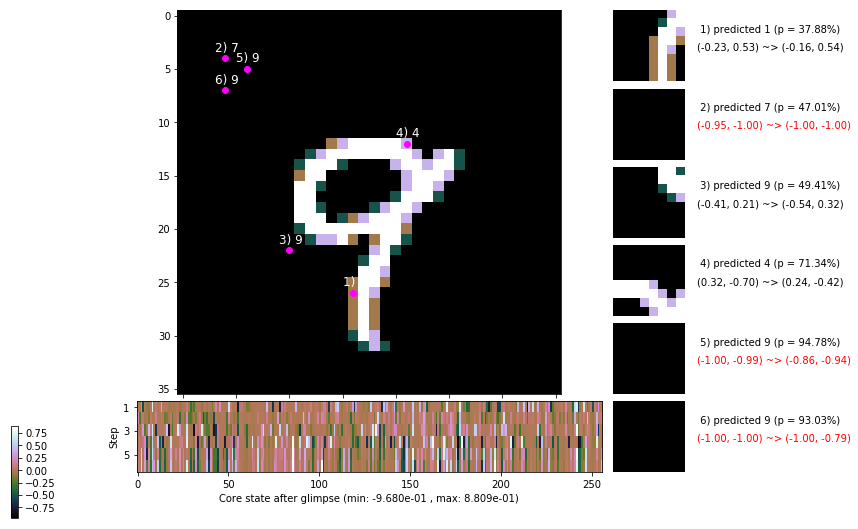

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 142.6 ms/b | lr: 2.78e-04 | grad 2norm: 18.37 | grad inf norm:  5.802
         Weights || abs max:  3.70 ( 2848.19) | mean: -1.88e-04 ( 0.01) | var: 9.67e-02 (  207.66)
          Biases || abs max:  2.62 (  445.40) | mean: -1.32e-01 ( 0.27) | var: 7.62e-02 ( 4497.74)
                    class loss: 0.784 | steps: 2.848 | reward:  3.626 | acc.: 72.42%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 149.0 ms/b | lr: 2.78e-04 | grad 2norm: 18.75 | grad inf norm:  5.862
         Weights || abs max:  3.70 ( 1714.81) | mean: -1.77e-04 ( 0.01) | var: 9.67e-02 (   51.61)
          Biases || abs max:  2.62 (  166.78) | mean: -1.32e-01 ( 0.16) | var: 7.62e-02 (  161.84)
                    class loss: 0.760 | steps: 2.831 | reward:  3.656 | acc.: 72.62%

	Target class: 7 | Discounted rewards: [4.686, 4.095, 3.4

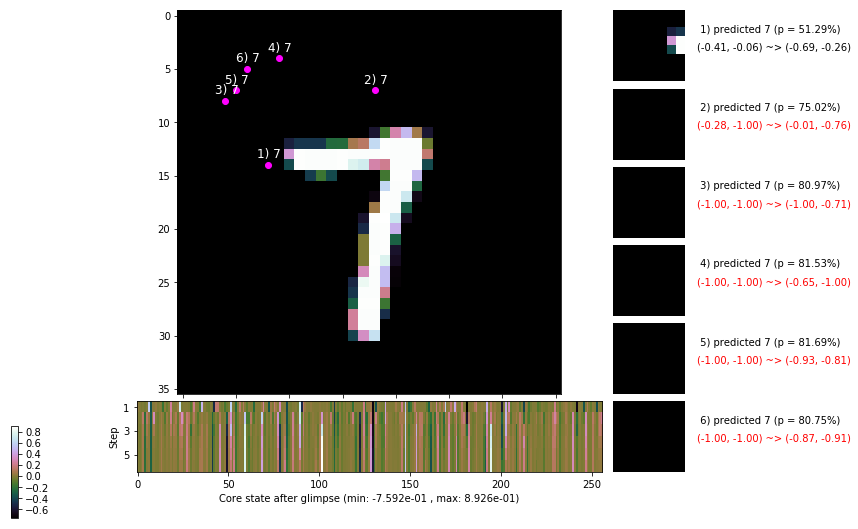

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 149.4 ms/b | lr: 2.77e-04 | grad 2norm: 18.88 | grad inf norm:  5.895
         Weights || abs max:  3.70 ( 1186.25) | mean: -1.74e-04 ( 0.01) | var: 9.68e-02 (   26.97)
          Biases || abs max:  2.62 (  212.20) | mean: -1.32e-01 ( 0.17) | var: 7.62e-02 (  640.03)
                    class loss: 0.748 | steps: 2.792 | reward:  3.716 | acc.: 73.82%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 147.4 ms/b | lr: 2.77e-04 | grad 2norm: 18.28 | grad inf norm:  5.631
         Weights || abs max:  3.71 ( 1664.55) | mean: -1.68e-04 ( 0.01) | var: 9.68e-02 (  101.48)
          Biases || abs max:  2.62 (  158.66) | mean: -1.32e-01 ( 0.15) | var: 7.61e-02 (  143.39)
                    class loss: 0.755 | steps: 2.814 | reward:  3.670 | acc.: 72.98%

	Target class: 4 | Discounted rewards: [4.686, 4.095, 3.4

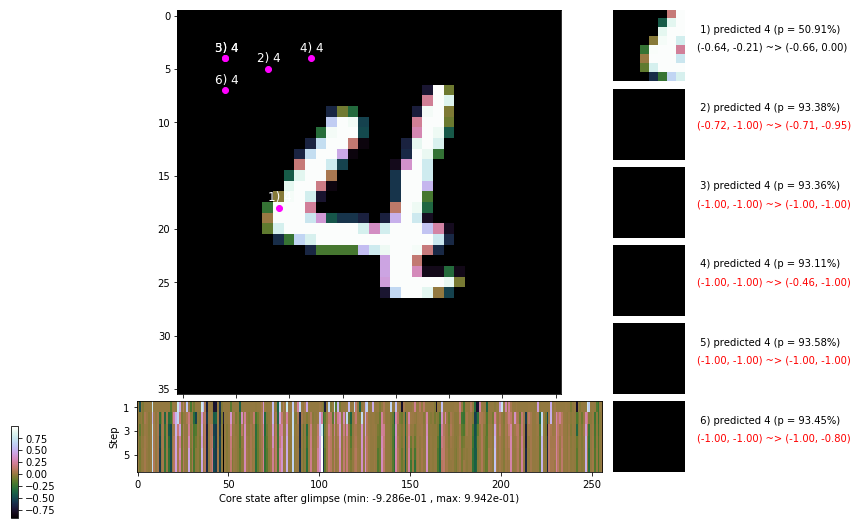

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 150.8 ms/b | lr: 2.76e-04 | grad 2norm: 18.46 | grad inf norm:  5.664
         Weights || abs max:  3.70 ( 1208.07) | mean: -1.64e-04 ( 0.01) | var: 9.68e-02 (   25.30)
          Biases || abs max:  2.62 (  188.56) | mean: -1.32e-01 ( 0.16) | var: 7.62e-02 (  167.64)
                    class loss: 0.772 | steps: 2.797 | reward:  3.684 | acc.: 73.10%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 142.9 ms/b | lr: 2.76e-04 | grad 2norm: 18.34 | grad inf norm:  5.597
         Weights || abs max:  3.70 ( 1735.36) | mean: -1.58e-04 ( 0.01) | var: 9.68e-02 (   57.38)
          Biases || abs max:  2.62 (  489.07) | mean: -1.32e-01 ( 0.28) | var: 7.62e-02 (15945.04)
                    class loss: 0.751 | steps: 2.811 | reward:  3.675 | acc.: 72.93%

	Target class: 4 | Discounted rewards: [4.686, 4.095, 3.4

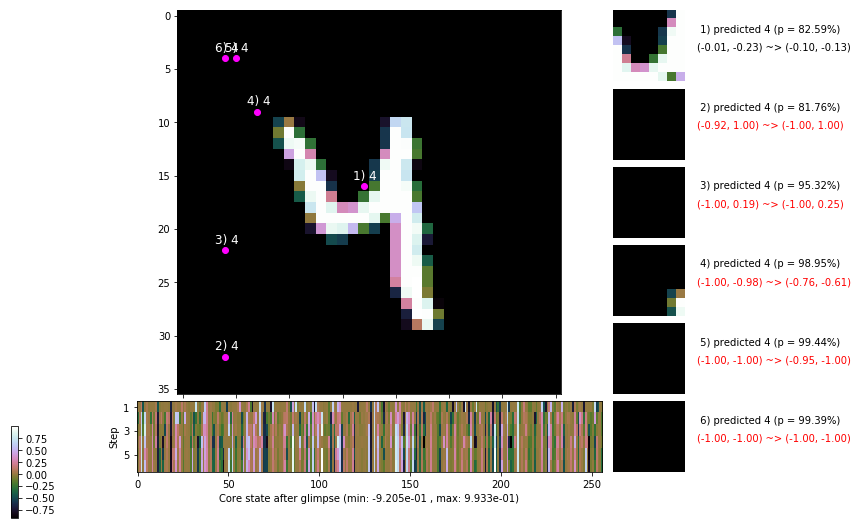

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 143.3 ms/b | lr: 2.76e-04 | grad 2norm: 18.56 | grad inf norm:  5.498
         Weights || abs max:  3.70 ( 1263.44) | mean: -1.65e-04 ( 0.01) | var: 9.68e-02 (   39.18)
          Biases || abs max:  2.62 (  571.43) | mean: -1.32e-01 ( 0.30) | var: 7.62e-02 ( 5176.85)
                    class loss: 0.759 | steps: 2.814 | reward:  3.670 | acc.: 72.90%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 143.1 ms/b | lr: 2.75e-04 | grad 2norm: 18.74 | grad inf norm:  5.674
         Weights || abs max:  3.70 ( 1871.70) | mean: -1.73e-04 ( 0.01) | var: 9.69e-02 (  327.27)
          Biases || abs max:  2.62 (  674.98) | mean: -1.32e-01 ( 0.35) | var: 7.63e-02 (33436.89)
                    class loss: 0.785 | steps: 2.844 | reward:  3.621 | acc.: 72.28%

	Target class: 7 | Discounted rewards: [0.000, 0.000, 0.0

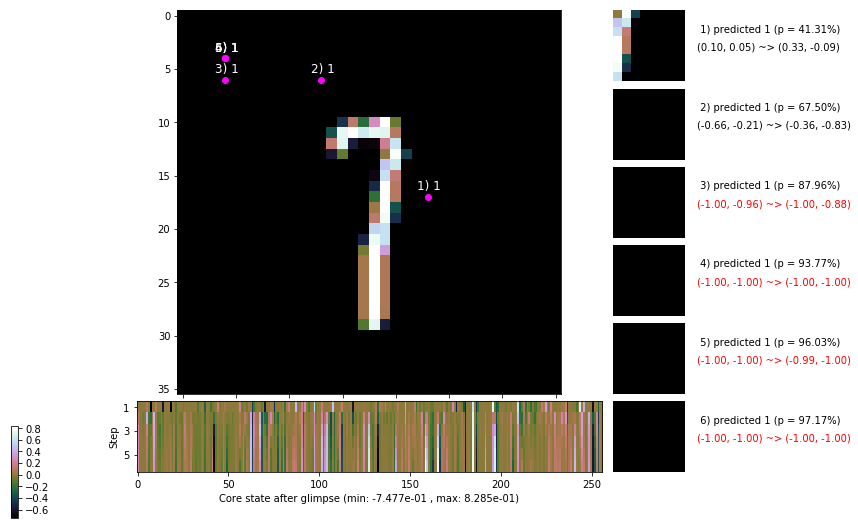

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 8 | Discounted rewards: [2.439, 2.710, 1.900, 1.000, 0.000, 0.000]


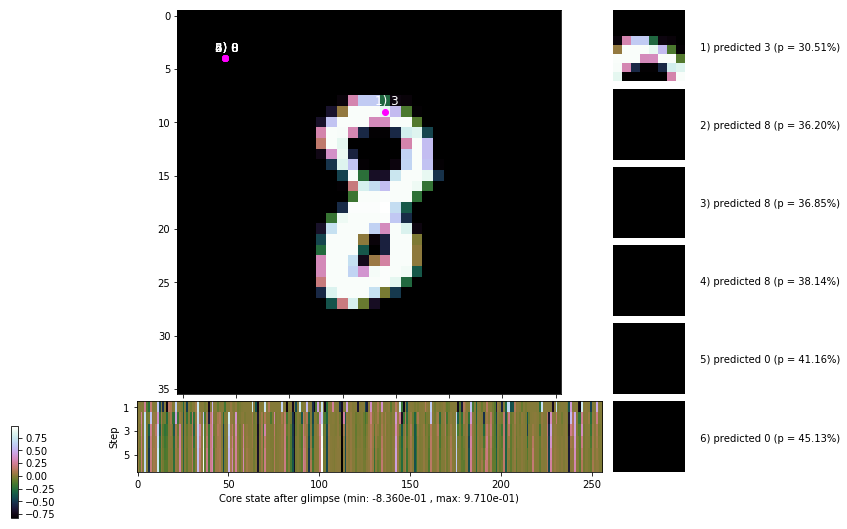


	Target class: 4 | Discounted rewards: [4.686, 4.095, 3.439, 2.710, 1.900, 1.000]


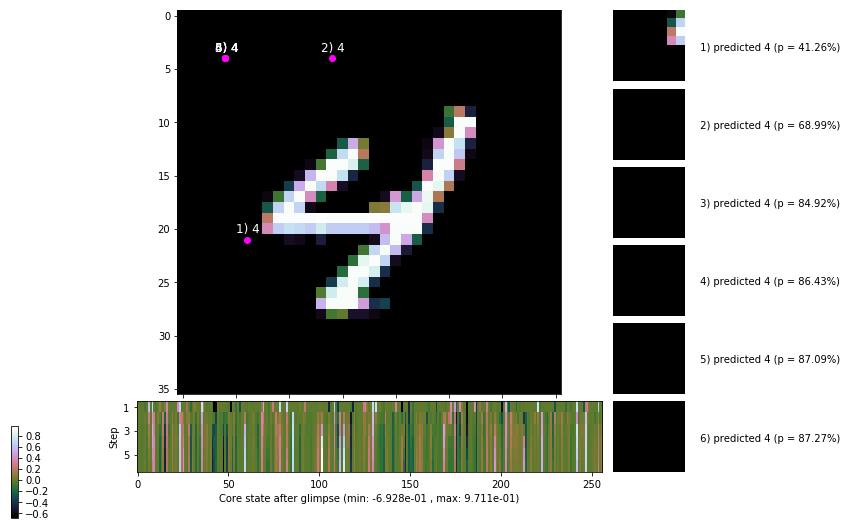

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


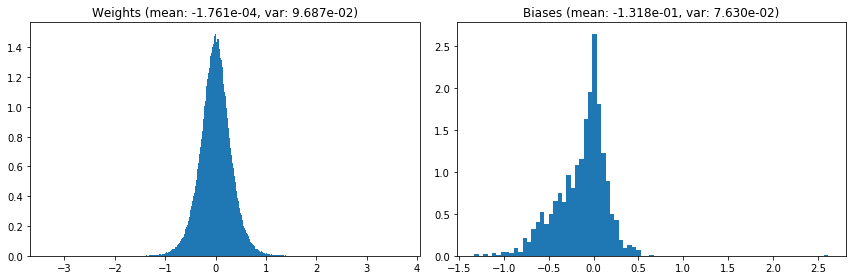

                                      Location network weights and biases


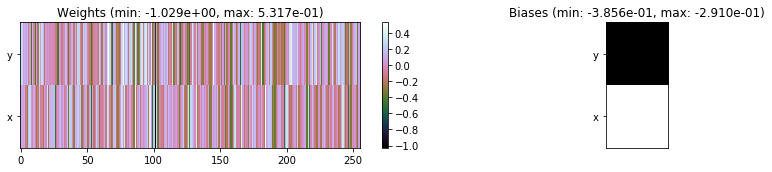

---------------------------------------------------------------------------------------------------------------
Elapsed time:  432.54 sec | TRAIN >> class loss: 0.7668 | steps:  2.823 :( | reward:  3.6609 :( | acc.: 72.905% :(
                          | VAL   >> class loss: 0.7379 | steps:  2.722 :( | reward:  3.7646 :( | acc.: 74.020% :(


Epoch  87/400) lr = 0.0002751
 b    300/  3000 >> 141.7 ms/b | lr: 2.75e-04 | grad 2norm: 18.42 | grad inf norm:  5.609
         Weights || abs max:  3.70 ( 1080.87) | mean: -1.78e-04 ( 0.01) | var: 9.69e-02 (   21.13)
          Biases || abs max:  2.62 (  231.31) | mean: -1.32e-01 ( 0.16) | var: 7.64e-02 (  382.47)
                    class loss: 0.748 | steps: 2.788 | reward:  3.719 | acc.: 74.08%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 148.9 ms/b | lr: 2.75e-04 | grad 2norm: 18.51 | grad inf norm:  5.828
         Weights || abs max:  3.71 ( 4671.60) | mean: -1.80e-04 (

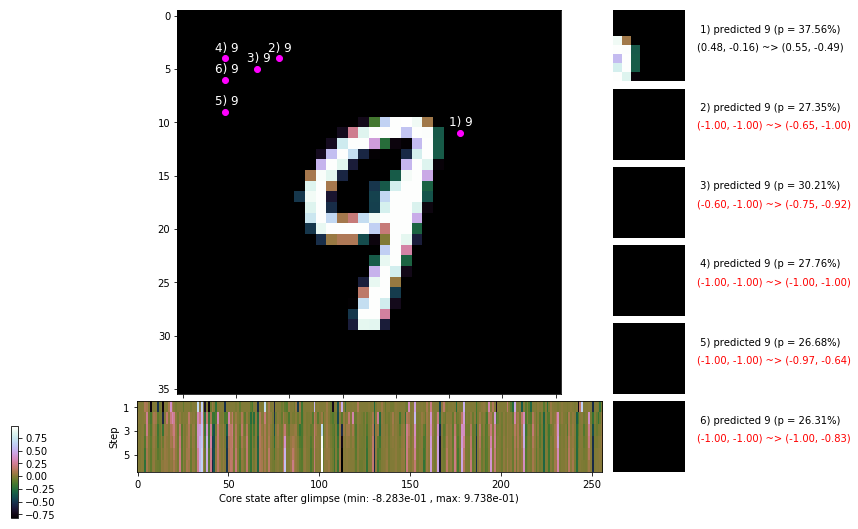

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 145.9 ms/b | lr: 2.74e-04 | grad 2norm: 18.62 | grad inf norm:  5.668
         Weights || abs max:  3.71 ( 3274.85) | mean: -1.90e-04 ( 0.01) | var: 9.69e-02 (  852.04)
          Biases || abs max:  2.63 (   89.33) | mean: -1.31e-01 ( 0.10) | var: 7.64e-02 (   26.91)
                    class loss: 0.748 | steps: 2.797 | reward:  3.697 | acc.: 73.73%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 150.4 ms/b | lr: 2.74e-04 | grad 2norm: 18.68 | grad inf norm:  5.722
         Weights || abs max:  3.71 (23022.02) | mean: -1.95e-04 ( 0.05) | var: 9.69e-02 (255678.89)
          Biases || abs max:  2.62 (  308.04) | mean: -1.31e-01 ( 0.20) | var: 7.64e-02 (  341.43)
                    class loss: 0.757 | steps: 2.819 | reward:  3.662 | acc.: 72.57%

	Target class: 0 | Discounted rewards: [2.786, 3.095, 3.

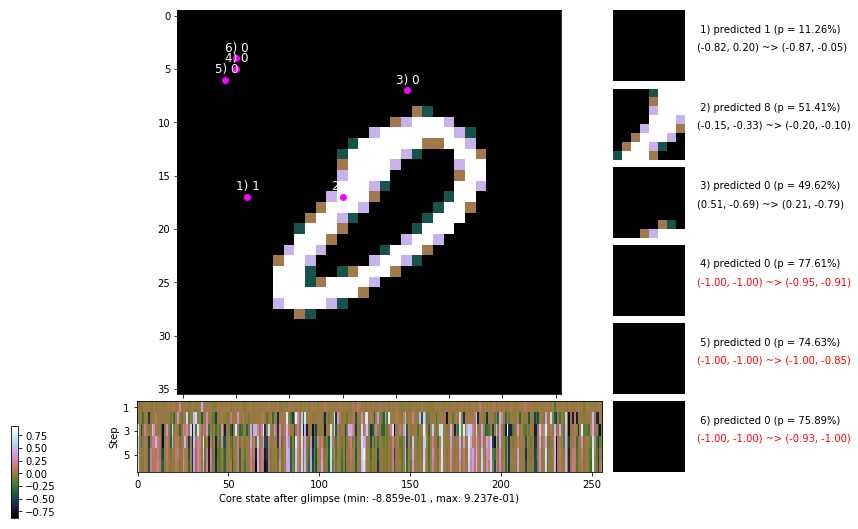

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 151.0 ms/b | lr: 2.73e-04 | grad 2norm: 18.96 | grad inf norm:  5.896
         Weights || abs max:  3.71 ( 2948.15) | mean: -1.97e-04 ( 0.01) | var: 9.70e-02 (  982.83)
          Biases || abs max:  2.63 (  108.91) | mean: -1.31e-01 ( 0.11) | var: 7.65e-02 (   80.32)
                    class loss: 0.744 | steps: 2.777 | reward:  3.721 | acc.: 73.75%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 145.5 ms/b | lr: 2.73e-04 | grad 2norm: 18.38 | grad inf norm:  5.318
         Weights || abs max:  3.71 (20266.12) | mean: -1.94e-04 ( 0.04) | var: 9.70e-02 (192450.53)
          Biases || abs max:  2.63 (  410.50) | mean: -1.31e-01 ( 0.24) | var: 7.65e-02 ( 3537.84)
                    class loss: 0.730 | steps: 2.761 | reward:  3.731 | acc.: 74.28%

	Target class: 0 | Discounted rewards: [2.876, 3.195, 2.

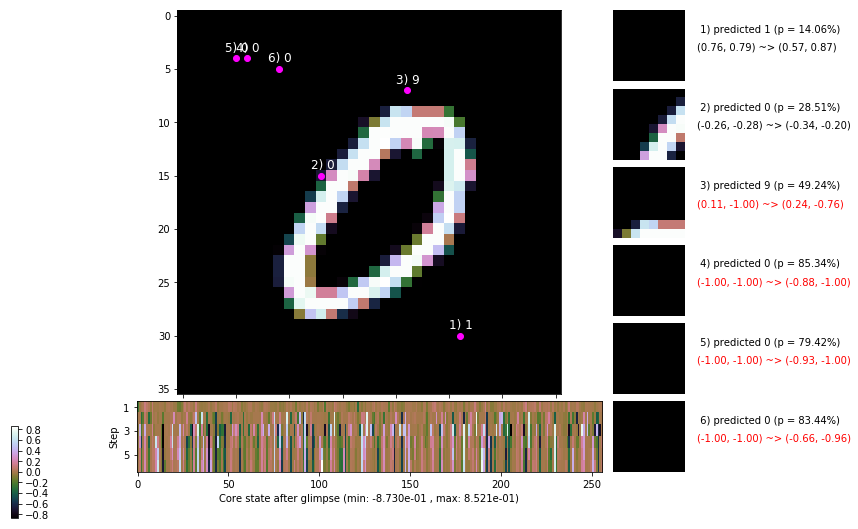

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 142.3 ms/b | lr: 2.72e-04 | grad 2norm: 18.58 | grad inf norm:  5.612
         Weights || abs max:  3.72 ( 1500.87) | mean: -1.93e-04 ( 0.01) | var: 9.70e-02 (  143.44)
          Biases || abs max:  2.63 (   96.81) | mean: -1.31e-01 ( 0.11) | var: 7.65e-02 (   20.08)
                    class loss: 0.740 | steps: 2.804 | reward:  3.691 | acc.: 73.73%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 141.8 ms/b | lr: 2.72e-04 | grad 2norm: 18.40 | grad inf norm:  5.616
         Weights || abs max:  3.72 ( 1066.04) | mean: -1.89e-04 ( 0.01) | var: 9.70e-02 (    9.05)
          Biases || abs max:  2.63 (  126.97) | mean: -1.31e-01 ( 0.12) | var: 7.65e-02 (   77.44)
                    class loss: 0.752 | steps: 2.796 | reward:  3.702 | acc.: 73.57%

	Target class: 4 | Discounted rewards: [3.095, 3.439, 2.7

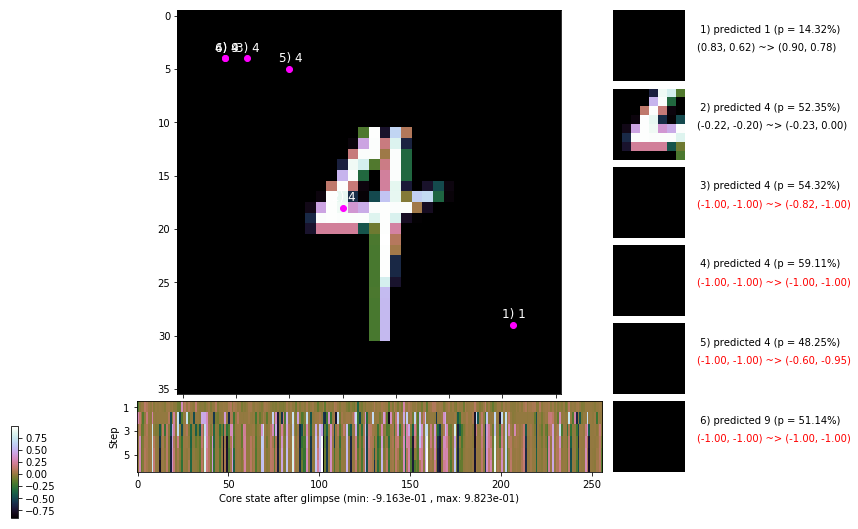

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 143.5 ms/b | lr: 2.72e-04 | grad 2norm: 18.65 | grad inf norm:  5.553
         Weights || abs max:  3.73 (  899.77) | mean: -1.78e-04 ( 0.01) | var: 9.71e-02 (    8.74)
          Biases || abs max:  2.63 (  119.97) | mean: -1.31e-01 ( 0.12) | var: 7.64e-02 (  126.61)
                    class loss: 0.754 | steps: 2.822 | reward:  3.676 | acc.: 73.22%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 143.1 ms/b | lr: 2.71e-04 | grad 2norm: 18.76 | grad inf norm:  5.871
         Weights || abs max:  3.73 ( 2016.78) | mean: -1.74e-04 ( 0.01) | var: 9.71e-02 (   98.14)
          Biases || abs max:  2.63 (  149.25) | mean: -1.32e-01 ( 0.13) | var: 7.64e-02 (   80.11)
                    class loss: 0.747 | steps: 2.770 | reward:  3.732 | acc.: 74.00%

	Target class: 5 | Discounted rewards: [3.686, 4.095, 3.4

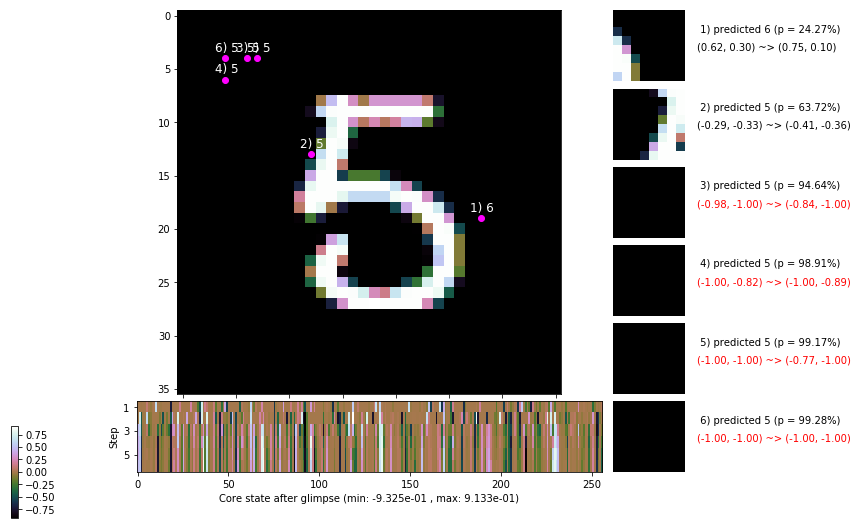

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 0 | Discounted rewards: [4.686, 4.095, 3.439, 2.710, 1.900, 1.000]


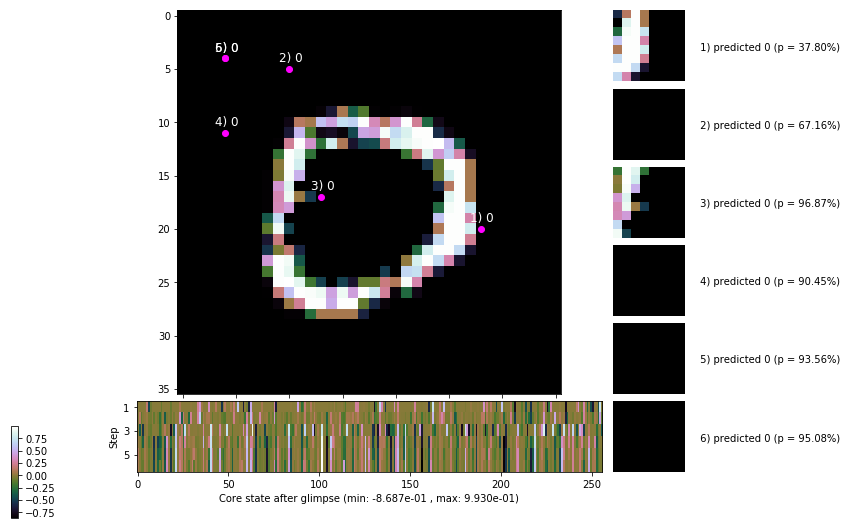


	Target class: 7 | Discounted rewards: [3.686, 4.095, 3.439, 2.710, 1.900, 1.000]


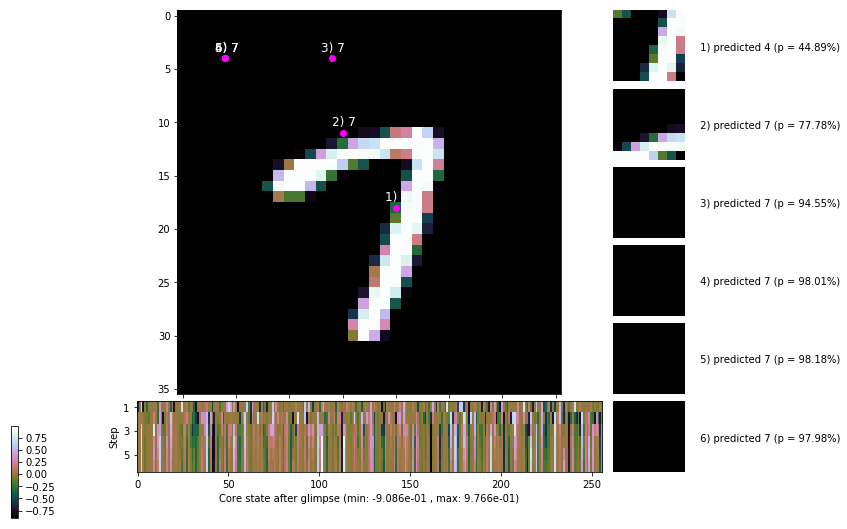

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


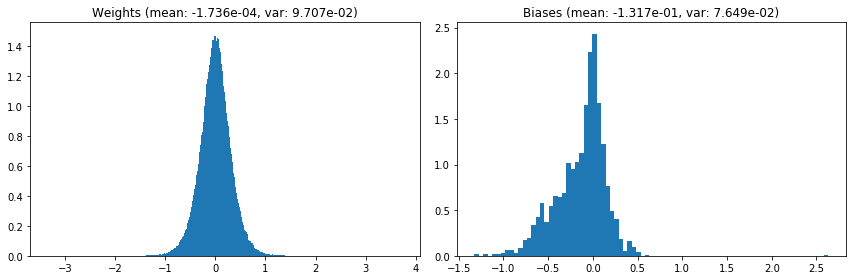

                                      Location network weights and biases


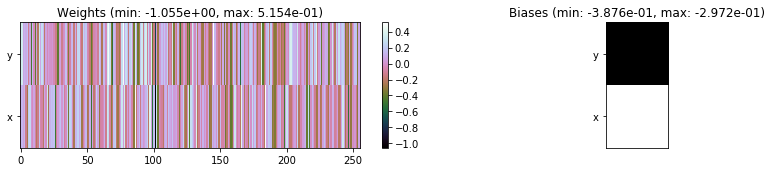

---------------------------------------------------------------------------------------------------------------
Elapsed time:  436.80 sec | TRAIN >> class loss: 0.7454 | steps:  2.792 :( | reward:  3.7049 :( | acc.: 73.708% :(
                          | VAL   >> class loss: 0.6963 | steps:  2.702 :( | reward:  3.8038 :( | acc.: 74.760% :(


Epoch  88/400) lr = 0.000271
 b    300/  3000 >> 142.1 ms/b | lr: 2.71e-04 | grad 2norm: 18.96 | grad inf norm:  5.724
         Weights || abs max:  3.73 ( 3364.92) | mean: -1.77e-04 ( 0.01) | var: 9.71e-02 ( 1484.39)
          Biases || abs max:  2.63 (  121.95) | mean: -1.32e-01 ( 0.12) | var: 7.65e-02 (  139.37)
                    class loss: 0.760 | steps: 2.810 | reward:  3.674 | acc.: 72.83%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 141.7 ms/b | lr: 2.70e-04 | grad 2norm: 18.23 | grad inf norm:  5.540
         Weights || abs max:  3.73 ( 1176.05) | mean: -1.71e-04 ( 

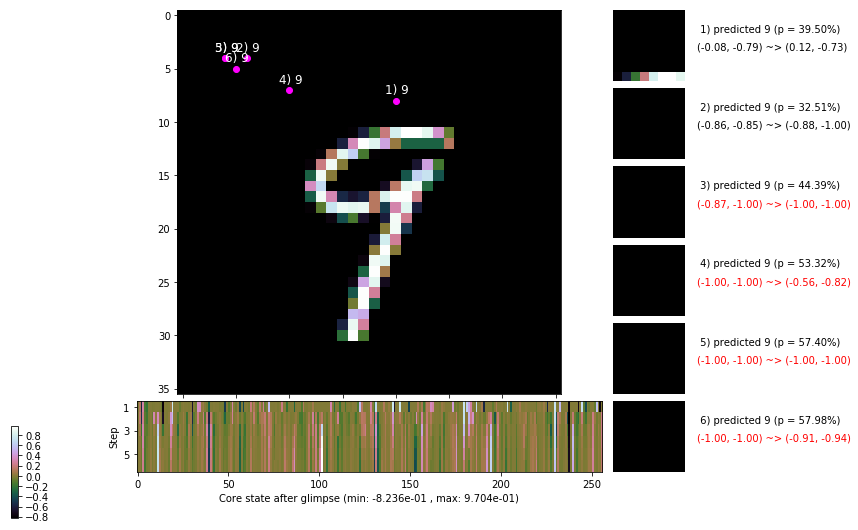

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 145.0 ms/b | lr: 2.70e-04 | grad 2norm: 18.47 | grad inf norm:  5.685
         Weights || abs max:  3.73 (  712.96) | mean: -1.75e-04 ( 0.01) | var: 9.71e-02 (    7.42)
          Biases || abs max:  2.63 (  347.50) | mean: -1.32e-01 ( 0.21) | var: 7.65e-02 ( 1693.01)
                    class loss: 0.753 | steps: 2.795 | reward:  3.683 | acc.: 73.35%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 141.9 ms/b | lr: 2.70e-04 | grad 2norm: 18.46 | grad inf norm:  5.526
         Weights || abs max:  3.72 ( 1515.06) | mean: -2.01e-04 ( 0.01) | var: 9.71e-02 (  115.57)
          Biases || abs max:  2.64 (  167.66) | mean: -1.32e-01 ( 0.14) | var: 7.66e-02 (  243.05)
                    class loss: 0.739 | steps: 2.774 | reward:  3.707 | acc.: 73.98%

	Target class: 2 | Discounted rewards: [0.000, 0.000, 0.0

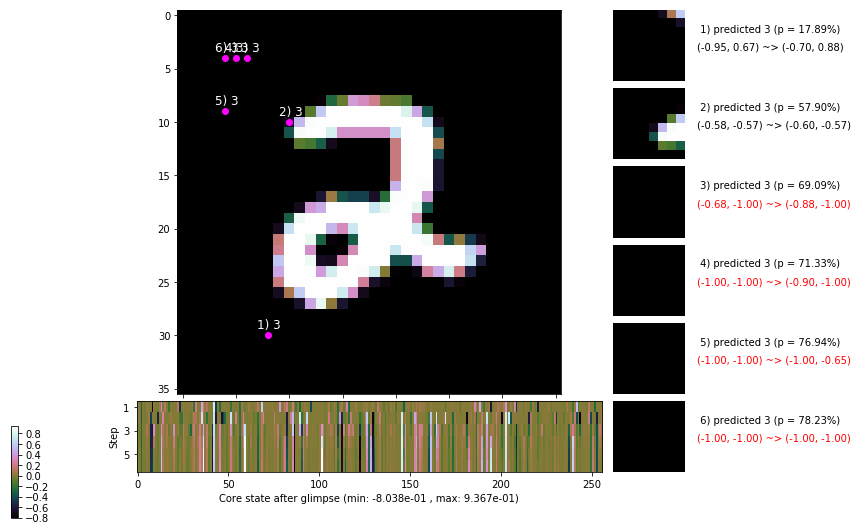

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 144.9 ms/b | lr: 2.69e-04 | grad 2norm: 18.37 | grad inf norm:  5.555
         Weights || abs max:  3.72 (  915.71) | mean: -2.08e-04 ( 0.01) | var: 9.72e-02 (   15.38)
          Biases || abs max:  2.64 (  120.14) | mean: -1.32e-01 ( 0.12) | var: 7.66e-02 (   79.05)
                    class loss: 0.748 | steps: 2.775 | reward:  3.710 | acc.: 73.78%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 145.7 ms/b | lr: 2.69e-04 | grad 2norm: 18.75 | grad inf norm:  5.769
         Weights || abs max:  3.73 (  686.07) | mean: -2.06e-04 ( 0.01) | var: 9.72e-02 (   21.38)
          Biases || abs max:  2.64 (  142.67) | mean: -1.32e-01 ( 0.13) | var: 7.66e-02 (  248.46)
                    class loss: 0.784 | steps: 2.819 | reward:  3.661 | acc.: 72.87%

	Target class: 9 | Discounted rewards: [0.000, 0.000, 0.0

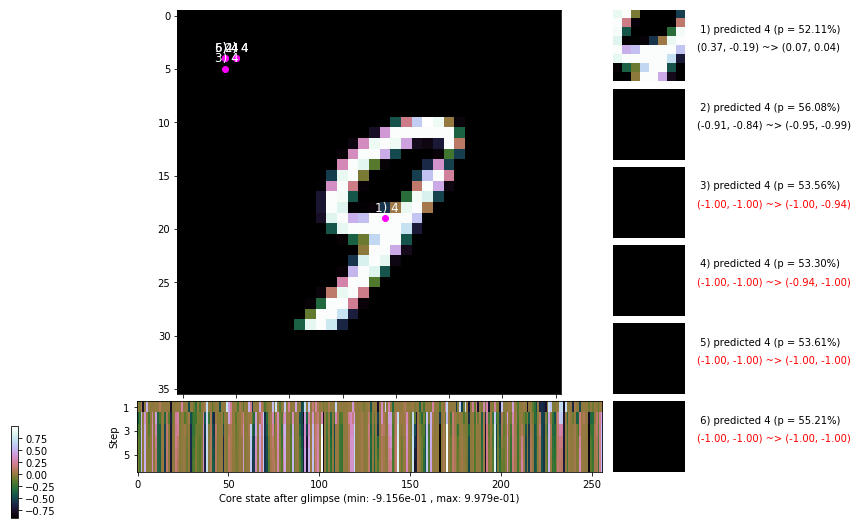

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 142.4 ms/b | lr: 2.68e-04 | grad 2norm: 18.71 | grad inf norm:  5.592
         Weights || abs max:  3.74 (  997.66) | mean: -2.04e-04 ( 0.01) | var: 9.72e-02 (   21.26)
          Biases || abs max:  2.64 ( 3252.48) | mean: -1.32e-01 ( 1.34) | var: 7.66e-02 (1113615.38)
                    class loss: 0.759 | steps: 2.773 | reward:  3.682 | acc.: 72.68%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 139.9 ms/b | lr: 2.68e-04 | grad 2norm: 18.75 | grad inf norm:  5.799
         Weights || abs max:  3.74 ( 1645.95) | mean: -2.04e-04 ( 0.01) | var: 9.72e-02 (   68.54)
          Biases || abs max:  2.64 (  229.75) | mean: -1.32e-01 ( 0.18) | var: 7.67e-02 (  591.79)
                    class loss: 0.764 | steps: 2.781 | reward:  3.684 | acc.: 72.80%

	Target class: 8 | Discounted rewards: [3.686, 4.095, 3

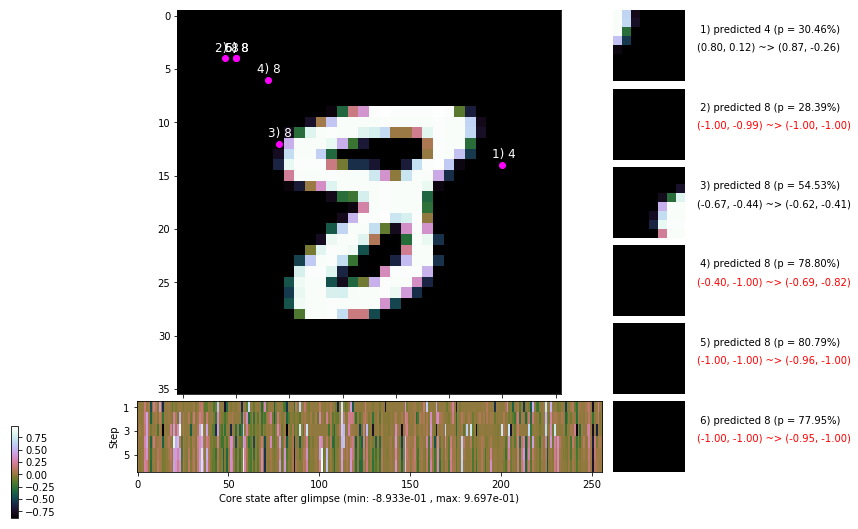

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 140.7 ms/b | lr: 2.67e-04 | grad 2norm: 18.60 | grad inf norm:  5.585
         Weights || abs max:  3.74 ( 1414.88) | mean: -2.05e-04 ( 0.01) | var: 9.72e-02 (   60.57)
          Biases || abs max:  2.64 (  169.01) | mean: -1.32e-01 ( 0.14) | var: 7.67e-02 (  290.78)
                    class loss: 0.764 | steps: 2.812 | reward:  3.672 | acc.: 73.28%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 133.6 ms/b | lr: 2.67e-04 | grad 2norm: 18.53 | grad inf norm:  5.537
         Weights || abs max:  3.74 ( 4437.32) | mean: -2.16e-04 ( 0.01) | var: 9.72e-02 ( 6008.91)
          Biases || abs max:  2.64 (  249.79) | mean: -1.32e-01 ( 0.17) | var: 7.67e-02 (  363.07)
                    class loss: 0.766 | steps: 2.816 | reward:  3.651 | acc.: 72.68%

	Target class: 4 | Discounted rewards: [0.000, 0.000, 0.0

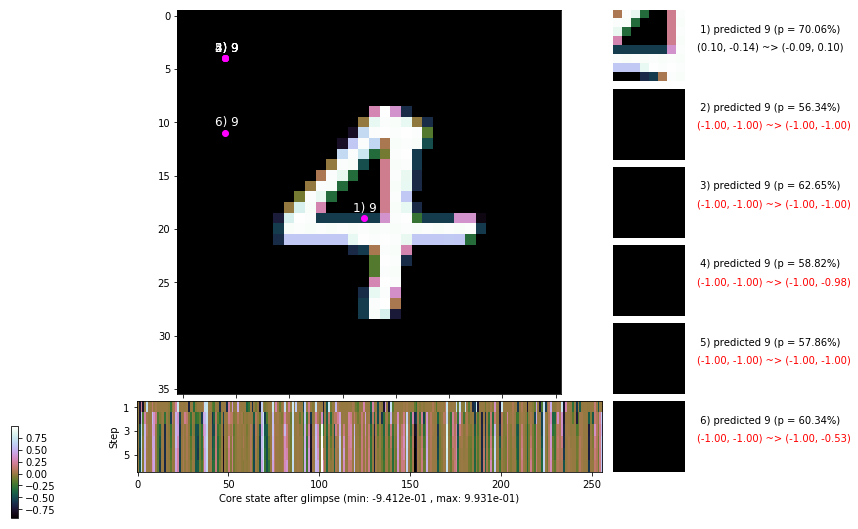

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 9 | Discounted rewards: [3.686, 4.095, 3.439, 2.710, 1.900, 1.000]


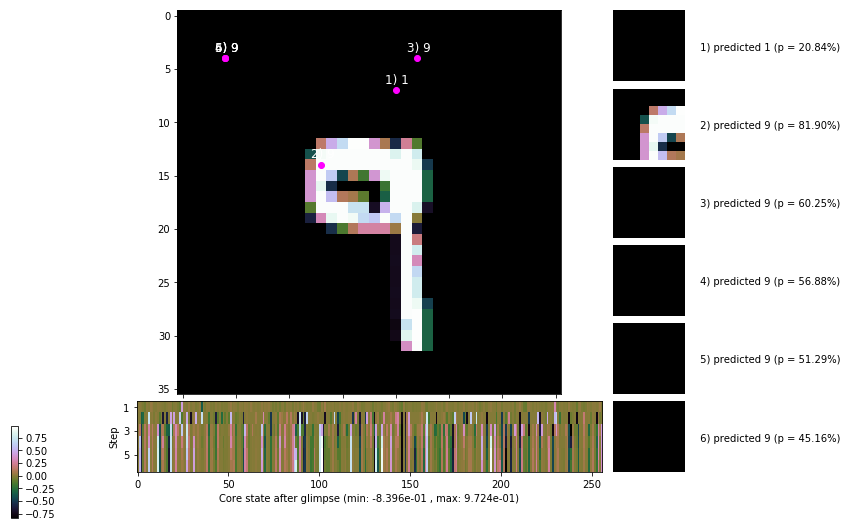


	Target class: 2 | Discounted rewards: [2.786, 3.095, 3.439, 2.710, 1.900, 1.000]


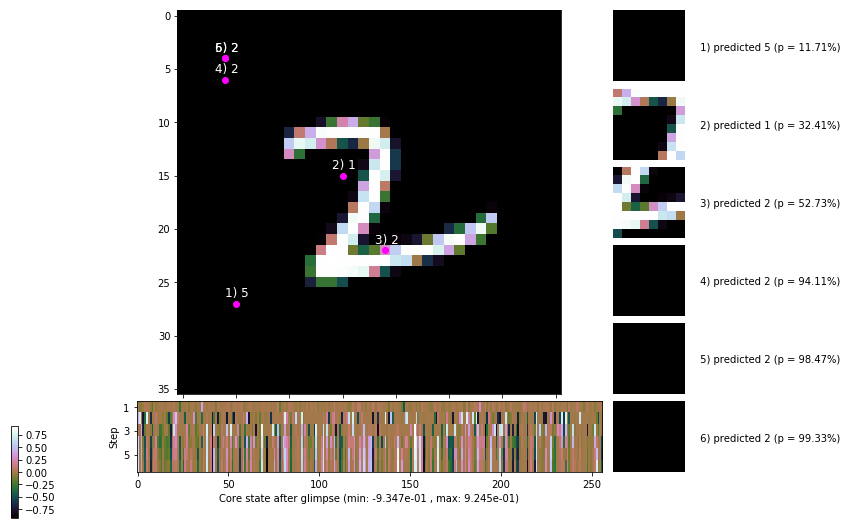

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


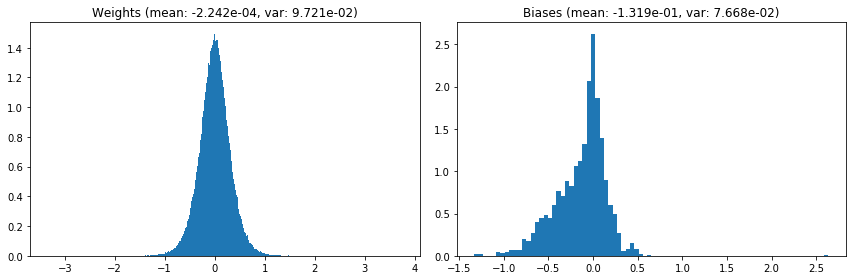

                                      Location network weights and biases


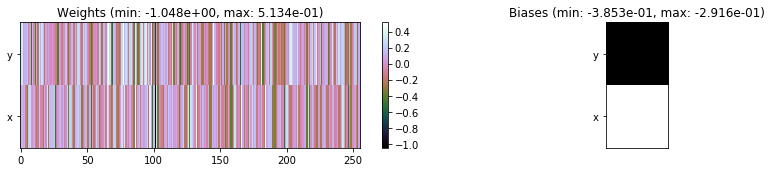

---------------------------------------------------------------------------------------------------------------
Elapsed time:  426.12 sec | TRAIN >> class loss: 0.7568 | steps:  2.792 :( | reward:  3.6835 :( | acc.: 73.203% :(
                          | VAL   >> class loss: 0.7282 | steps:  2.715 :( | reward:  3.7804 :( | acc.: 74.180% :(


Epoch  89/400) lr = 0.000267
 b    300/  3000 >> 137.9 ms/b | lr: 2.67e-04 | grad 2norm: 18.59 | grad inf norm:  5.701
         Weights || abs max:  3.75 ( 2073.45) | mean: -2.11e-04 ( 0.01) | var: 9.72e-02 (   89.29)
          Biases || abs max:  2.64 (  127.15) | mean: -1.32e-01 ( 0.12) | var: 7.67e-02 (  105.60)
                    class loss: 0.736 | steps: 2.790 | reward:  3.703 | acc.: 73.53%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 135.8 ms/b | lr: 2.66e-04 | grad 2norm: 18.65 | grad inf norm:  5.663
         Weights || abs max:  3.75 ( 1075.34) | mean: -2.07e-04 ( 

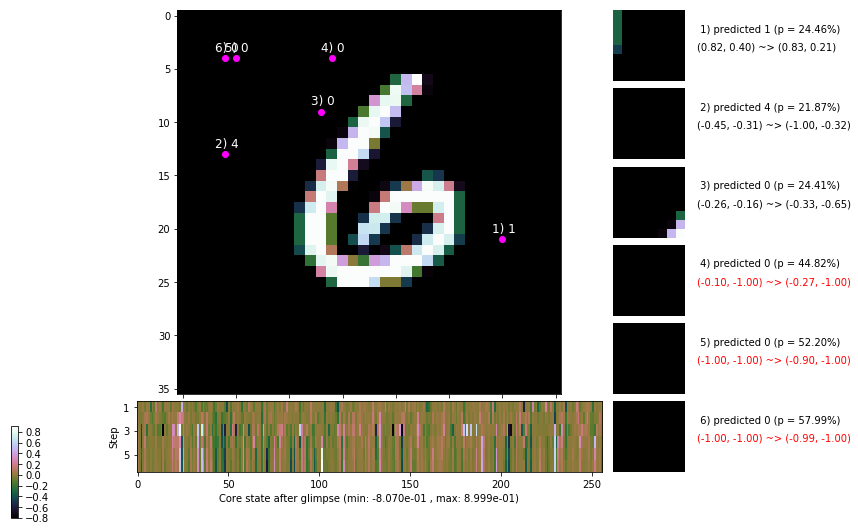

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 137.5 ms/b | lr: 2.66e-04 | grad 2norm: 18.62 | grad inf norm:  5.603
         Weights || abs max:  3.75 ( 3256.14) | mean: -2.19e-04 ( 0.01) | var: 9.73e-02 (  710.80)
          Biases || abs max:  2.64 (  156.75) | mean: -1.32e-01 ( 0.13) | var: 7.65e-02 (  236.96)
                    class loss: 0.749 | steps: 2.801 | reward:  3.682 | acc.: 73.20%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 137.7 ms/b | lr: 2.66e-04 | grad 2norm: 18.57 | grad inf norm:  5.742
         Weights || abs max:  3.75 ( 1194.57) | mean: -2.16e-04 ( 0.01) | var: 9.73e-02 (   32.77)
          Biases || abs max:  2.64 (  235.86) | mean: -1.32e-01 ( 0.16) | var: 7.65e-02 ( 2565.81)
                    class loss: 0.747 | steps: 2.772 | reward:  3.713 | acc.: 73.73%

	Target class: 6 | Discounted rewards: [4.686, 4.095, 3.4

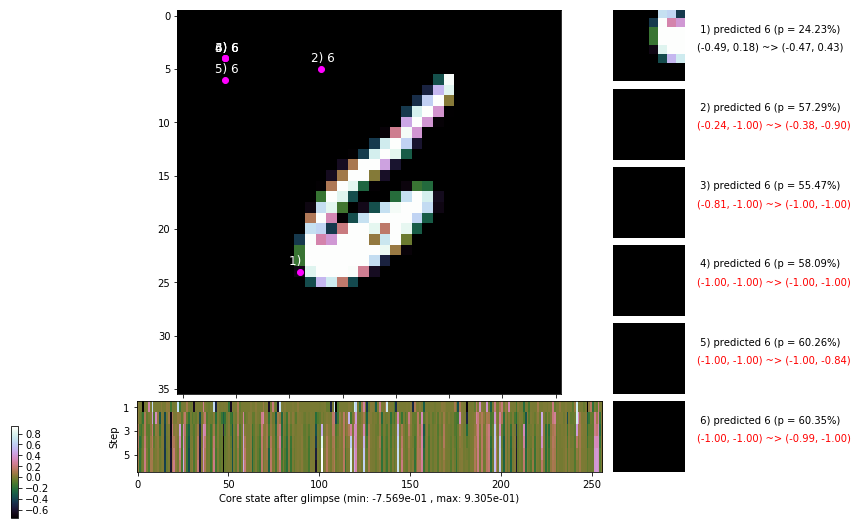

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 138.8 ms/b | lr: 2.65e-04 | grad 2norm: 18.10 | grad inf norm:  5.383
         Weights || abs max:  3.75 ( 1819.68) | mean: -2.14e-04 ( 0.01) | var: 9.73e-02 (  408.83)
          Biases || abs max:  2.64 (  159.96) | mean: -1.32e-01 ( 0.13) | var: 7.66e-02 (  161.11)
                    class loss: 0.758 | steps: 2.785 | reward:  3.684 | acc.: 73.23%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 136.4 ms/b | lr: 2.65e-04 | grad 2norm: 18.55 | grad inf norm:  5.511
         Weights || abs max:  3.75 ( 1412.76) | mean: -2.10e-04 ( 0.01) | var: 9.73e-02 (   55.39)
          Biases || abs max:  2.64 (  159.90) | mean: -1.32e-01 ( 0.14) | var: 7.66e-02 (  155.94)
                    class loss: 0.763 | steps: 2.818 | reward:  3.681 | acc.: 73.28%

	Target class: 5 | Discounted rewards: [3.786, 3.095, 3.4

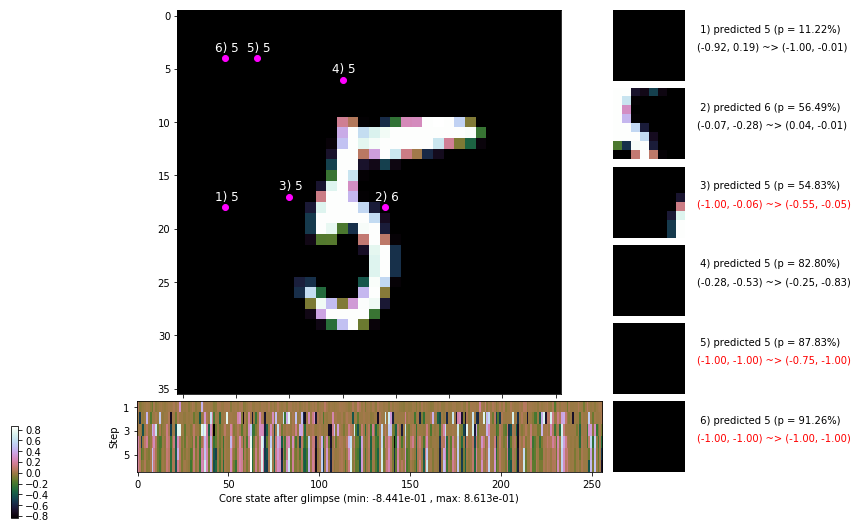

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 138.1 ms/b | lr: 2.64e-04 | grad 2norm: 18.71 | grad inf norm:  5.670
         Weights || abs max:  3.75 ( 1368.86) | mean: -2.10e-04 ( 0.01) | var: 9.73e-02 (   38.05)
          Biases || abs max:  2.64 (  145.98) | mean: -1.32e-01 ( 0.15) | var: 7.65e-02 (  264.64)
                    class loss: 0.753 | steps: 2.793 | reward:  3.689 | acc.: 73.38%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 136.6 ms/b | lr: 2.64e-04 | grad 2norm: 18.47 | grad inf norm:  5.457
         Weights || abs max:  3.75 (288309.84) | mean: -2.21e-04 ( 0.53) | var: 9.73e-02 (45678036.00)
          Biases || abs max:  2.64 (  210.43) | mean: -1.32e-01 ( 0.16) | var: 7.66e-02 (  995.09)
                    class loss: 0.773 | steps: 2.803 | reward:  3.647 | acc.: 72.07%

	Target class: 8 | Discounted rewards: [3.686, 4.095,

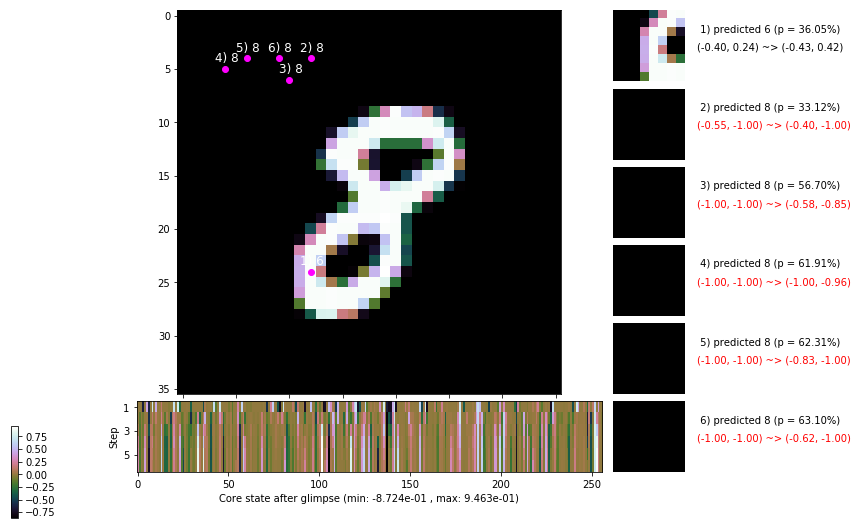

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 140.8 ms/b | lr: 2.64e-04 | grad 2norm: 18.52 | grad inf norm:  5.602
         Weights || abs max:  3.76 ( 1910.67) | mean: -2.09e-04 ( 0.01) | var: 9.74e-02 (   87.33)
          Biases || abs max:  2.64 (  124.07) | mean: -1.32e-01 ( 0.14) | var: 7.66e-02 (   56.40)
                    class loss: 0.754 | steps: 2.784 | reward:  3.666 | acc.: 72.85%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 145.4 ms/b | lr: 2.63e-04 | grad 2norm: 18.45 | grad inf norm:  5.627
         Weights || abs max:  3.76 ( 1649.82) | mean: -2.06e-04 ( 0.01) | var: 9.74e-02 (   59.80)
          Biases || abs max:  2.64 (  146.15) | mean: -1.32e-01 ( 0.15) | var: 7.66e-02 (  103.41)
                    class loss: 0.757 | steps: 2.817 | reward:  3.668 | acc.: 73.27%

	Target class: 8 | Discounted rewards: [4.686, 4.095, 3.4

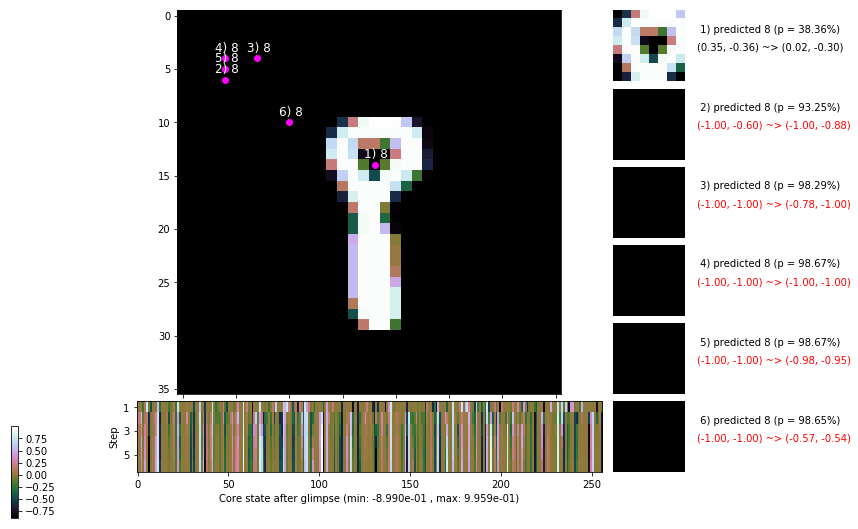

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 3 | Discounted rewards: [3.686, 4.095, 3.439, 2.710, 1.900, 1.000]


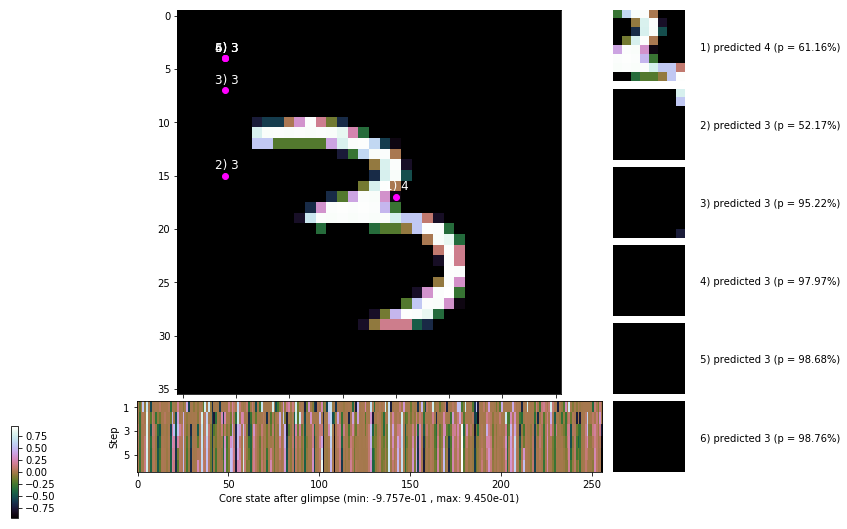


	Target class: 9 | Discounted rewards: [3.686, 4.095, 3.439, 2.710, 1.900, 1.000]


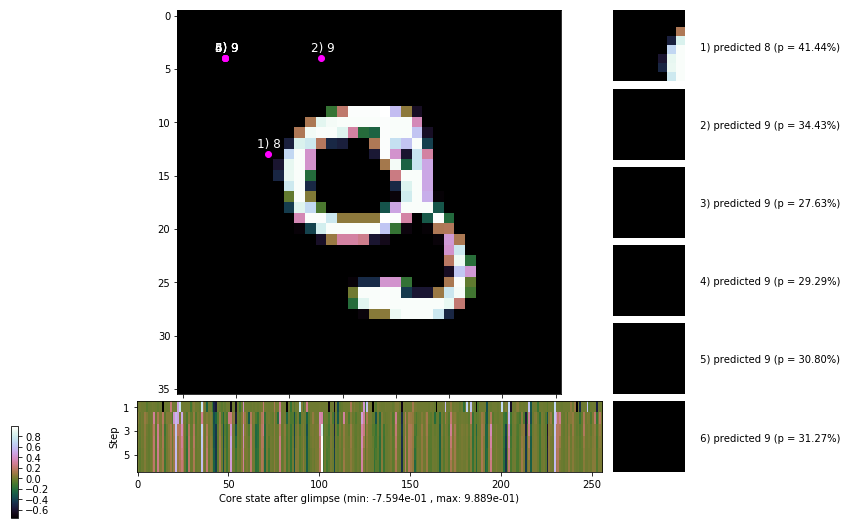

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


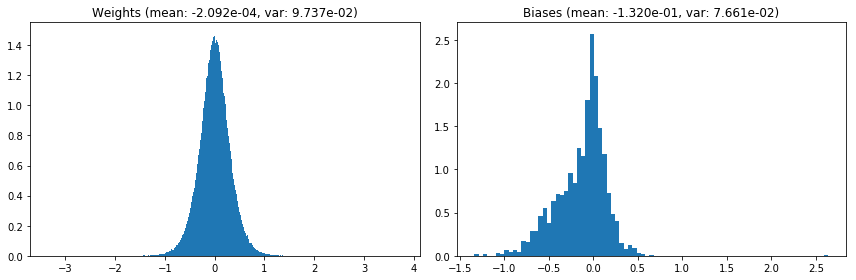

                                      Location network weights and biases


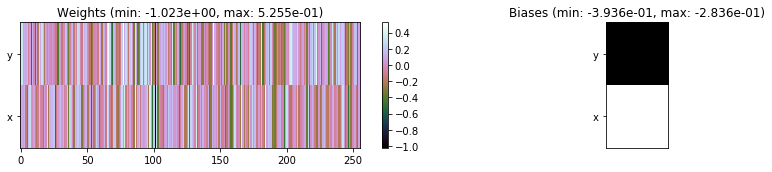

---------------------------------------------------------------------------------------------------------------
Elapsed time:  416.06 sec | TRAIN >> class loss: 0.7545 | steps:  2.795 :( | reward:  3.6820 :( | acc.: 73.175% :(
                          | VAL   >> class loss: 0.7501 | steps:  2.723 :( | reward:  3.7508 :( | acc.: 72.900% :(


Epoch  90/400) lr = 0.000263
 b    300/  3000 >> 147.0 ms/b | lr: 2.63e-04 | grad 2norm: 18.26 | grad inf norm:  5.531
         Weights || abs max:  3.76 ( 1001.48) | mean: -2.10e-04 ( 0.01) | var: 9.74e-02 (   31.04)
          Biases || abs max:  2.64 (   85.06) | mean: -1.32e-01 ( 0.10) | var: 7.66e-02 (   24.02)
                    class loss: 0.737 | steps: 2.768 | reward:  3.718 | acc.: 74.23%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 147.0 ms/b | lr: 2.62e-04 | grad 2norm: 18.52 | grad inf norm:  5.559
         Weights || abs max:  3.76 ( 2351.94) | mean: -2.15e-04 ( 

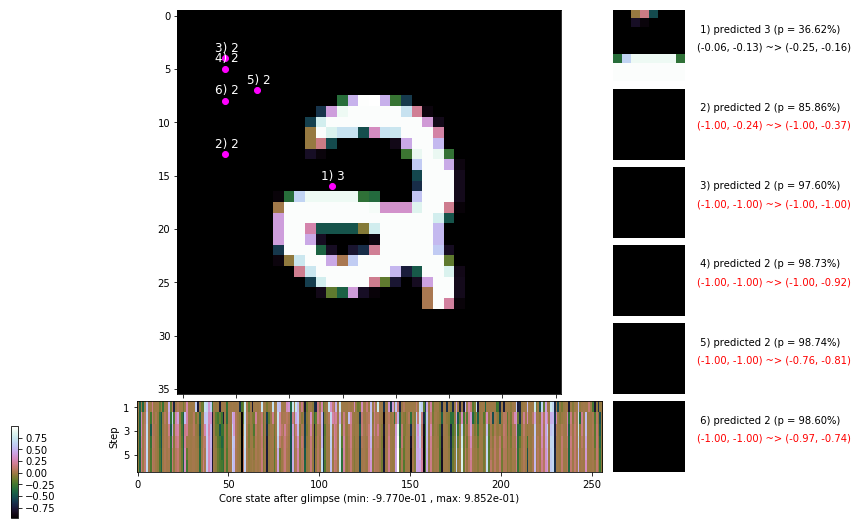

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 146.2 ms/b | lr: 2.62e-04 | grad 2norm: 18.39 | grad inf norm:  5.726
         Weights || abs max:  3.76 ( 1443.63) | mean: -2.17e-04 ( 0.01) | var: 9.74e-02 (   66.12)
          Biases || abs max:  2.64 (  160.36) | mean: -1.32e-01 ( 0.14) | var: 7.66e-02 (  542.50)
                    class loss: 0.759 | steps: 2.804 | reward:  3.673 | acc.: 72.97%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 141.9 ms/b | lr: 2.62e-04 | grad 2norm: 18.27 | grad inf norm:  5.536
         Weights || abs max:  3.77 ( 1394.13) | mean: -2.10e-04 ( 0.01) | var: 9.74e-02 (   30.02)
          Biases || abs max:  2.64 (  529.85) | mean: -1.32e-01 ( 0.28) | var: 7.66e-02 (10856.75)
                    class loss: 0.777 | steps: 2.842 | reward:  3.635 | acc.: 72.80%

	Target class: 0 | Discounted rewards: [3.686, 4.095, 3.4

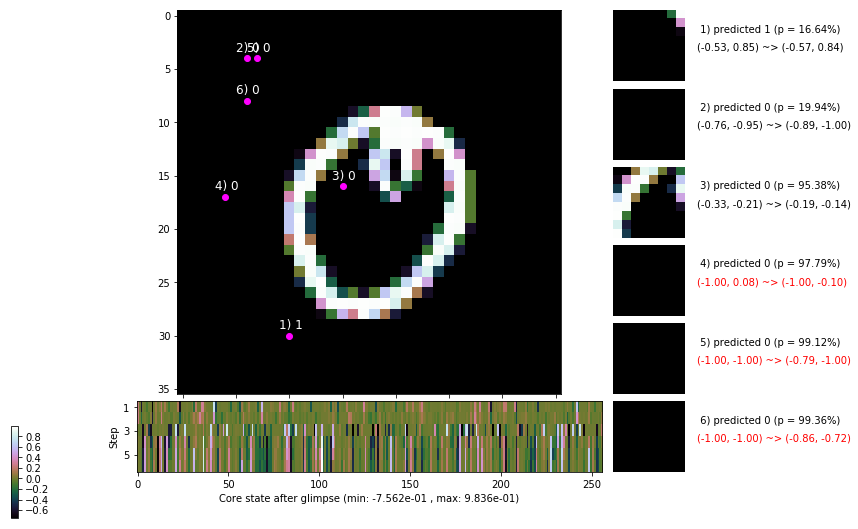

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 144.7 ms/b | lr: 2.61e-04 | grad 2norm: 18.55 | grad inf norm:  5.725
         Weights || abs max:  3.77 ( 1557.13) | mean: -2.18e-04 ( 0.01) | var: 9.75e-02 (  191.45)
          Biases || abs max:  2.64 (  188.01) | mean: -1.32e-01 ( 0.15) | var: 7.66e-02 (  112.27)
                    class loss: 0.751 | steps: 2.789 | reward:  3.694 | acc.: 73.55%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 142.3 ms/b | lr: 2.61e-04 | grad 2norm: 18.27 | grad inf norm:  5.583
         Weights || abs max:  3.77 ( 3675.41) | mean: -2.21e-04 ( 0.01) | var: 9.75e-02 (  658.59)
          Biases || abs max:  2.64 (   74.95) | mean: -1.32e-01 ( 0.09) | var: 7.66e-02 (   12.28)
                    class loss: 0.742 | steps: 2.785 | reward:  3.724 | acc.: 74.73%

	Target class: 8 | Discounted rewards: [2.786, 3.095, 3.4

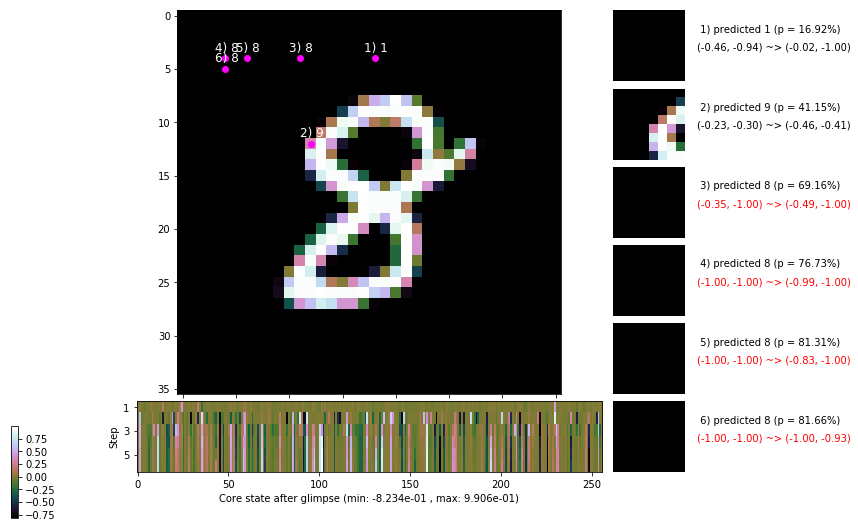

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 143.8 ms/b | lr: 2.60e-04 | grad 2norm: 18.24 | grad inf norm:  5.219
         Weights || abs max:  3.77 ( 1857.92) | mean: -2.30e-04 ( 0.01) | var: 9.75e-02 (   91.87)
          Biases || abs max:  2.64 (  117.59) | mean: -1.32e-01 ( 0.12) | var: 7.66e-02 (  123.74)
                    class loss: 0.748 | steps: 2.763 | reward:  3.712 | acc.: 73.82%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 143.9 ms/b | lr: 2.60e-04 | grad 2norm: 18.24 | grad inf norm:  5.308
         Weights || abs max:  3.78 ( 2548.86) | mean: -2.37e-04 ( 0.01) | var: 9.75e-02 (  152.36)
          Biases || abs max:  2.64 (  189.17) | mean: -1.32e-01 ( 0.16) | var: 7.66e-02 (  325.75)
                    class loss: 0.748 | steps: 2.759 | reward:  3.710 | acc.: 73.85%

	Target class: 4 | Discounted rewards: [3.686, 4.095, 3.4

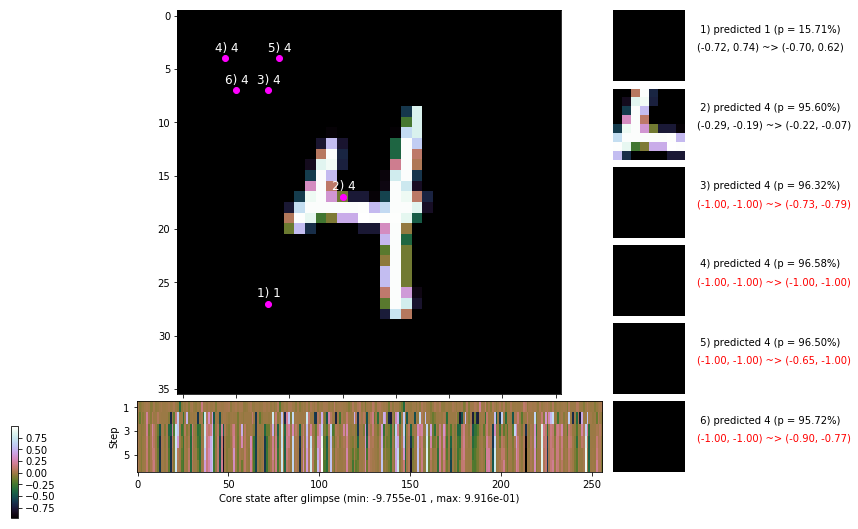

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 142.7 ms/b | lr: 2.60e-04 | grad 2norm: 18.44 | grad inf norm:  5.482
         Weights || abs max:  3.78 ( 2756.56) | mean: -2.33e-04 ( 0.01) | var: 9.75e-02 (  881.88)
          Biases || abs max:  2.64 (  262.57) | mean: -1.32e-01 ( 0.20) | var: 7.67e-02 (  417.96)
                    class loss: 0.740 | steps: 2.788 | reward:  3.701 | acc.: 73.72%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 141.8 ms/b | lr: 2.59e-04 | grad 2norm: 18.36 | grad inf norm:  5.420
         Weights || abs max:  3.78 ( 1364.31) | mean: -2.24e-04 ( 0.01) | var: 9.75e-02 (   64.60)
          Biases || abs max:  2.64 (  117.29) | mean: -1.32e-01 ( 0.12) | var: 7.68e-02 (   68.97)
                    class loss: 0.743 | steps: 2.800 | reward:  3.678 | acc.: 73.40%

	Target class: 8 | Discounted rewards: [3.686, 4.095, 3.4

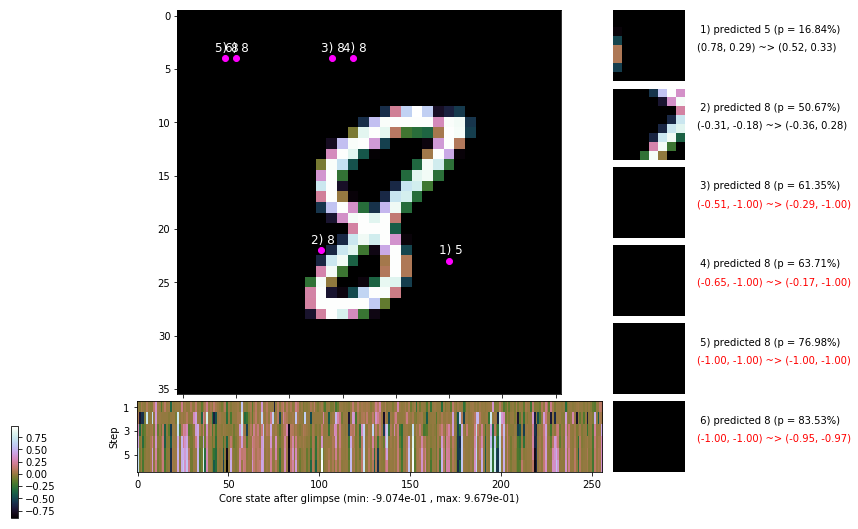

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 5 | Discounted rewards: [0.000, 0.000, 0.000, 0.000, 0.000, 0.000]


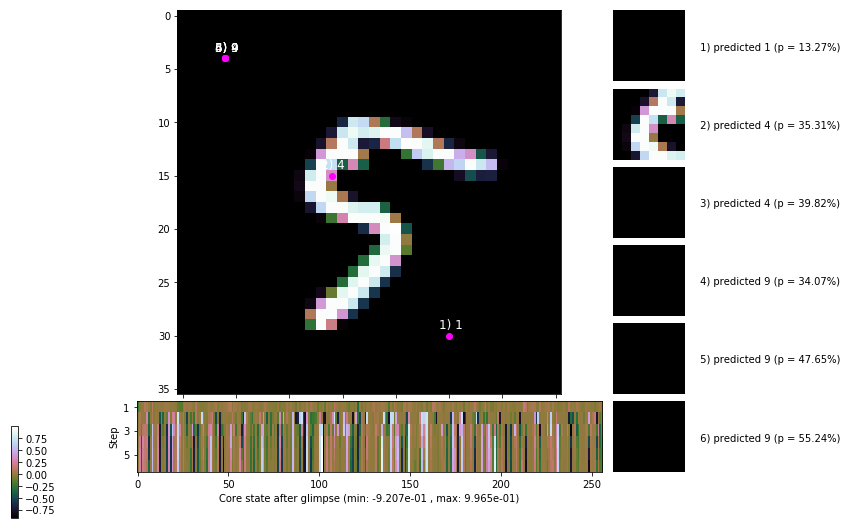


	Target class: 7 | Discounted rewards: [1.000, 0.000, 0.000, 0.000, 0.000, 0.000]


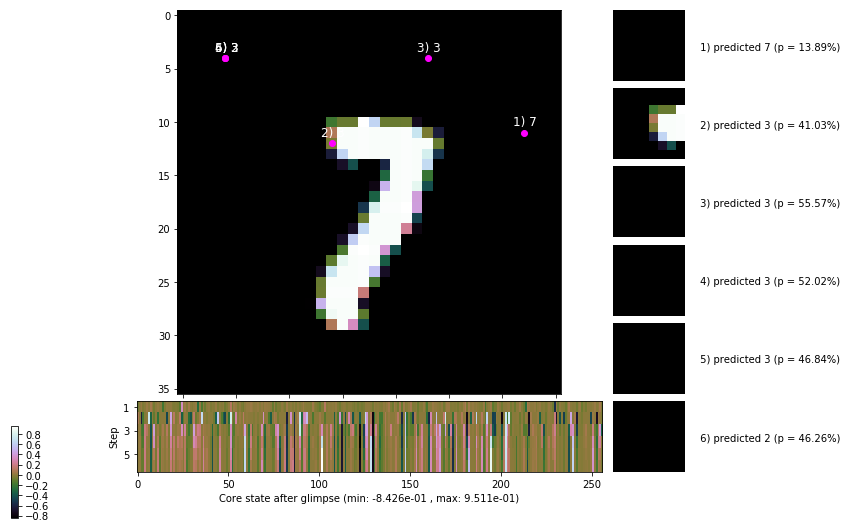

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


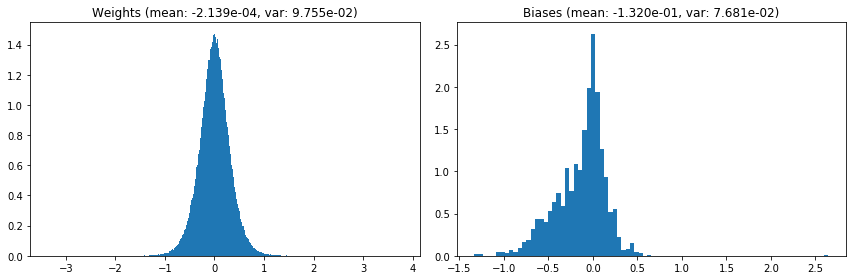

                                      Location network weights and biases


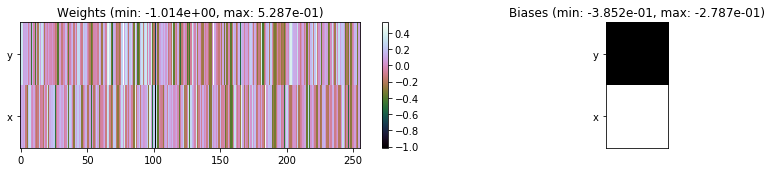

---------------------------------------------------------------------------------------------------------------
Elapsed time:  433.25 sec | TRAIN >> class loss: 0.7522 | steps:  2.792 :( | reward:  3.6903 :( | acc.: 73.587% :(
                          | VAL   >> class loss: 0.7483 | steps:  2.764 :( | reward:  3.7260 :( | acc.: 73.340% :(



			---~~~=== End of training ===~~~---

Evaluating on the TEST dataset...

	Target class: 0 | Discounted rewards: [0.000, 0.000, 0.000, 0.000, 0.000, 0.000]


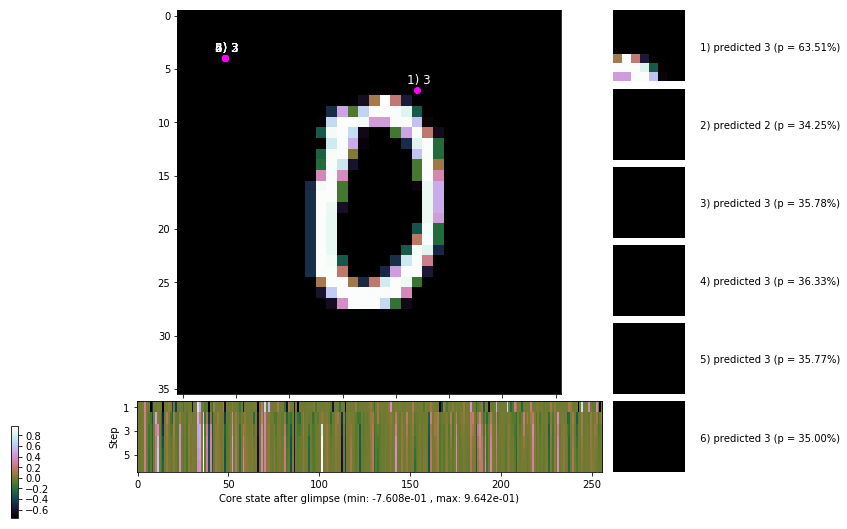


	Target class: 6 | Discounted rewards: [4.686, 4.095, 3.439, 2.710, 1.900, 1.000]


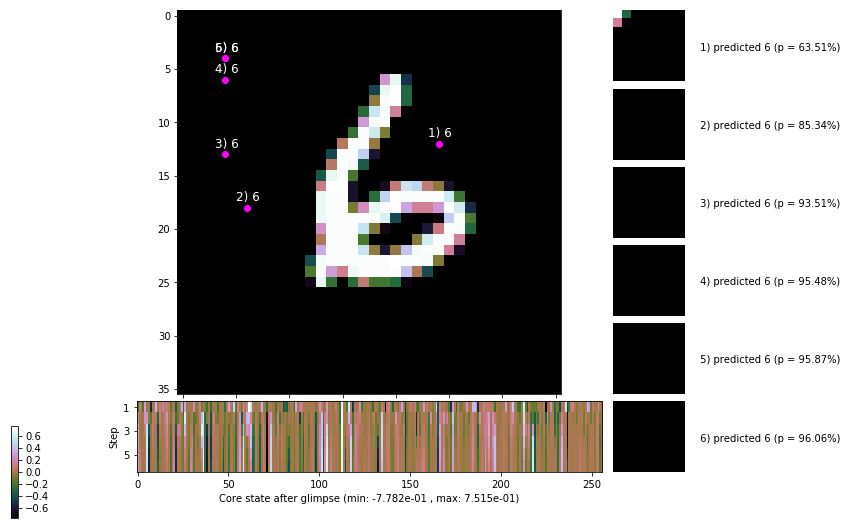

	>> class loss: 0.6965 | steps:  2.667 | reward:  3.8320 | acc.: 75.040%


In [7]:
model_info, train_info, val_info, test_info, epochs = train_eval_loop(
    model = model, epochs = num_epochs, image_size = image_size,
    train_data = train_data, val_data = val_data, test_data = test_data,
    padding = padding, optimizer = optimizer, lr_scheduler = lr_scheduler,
    class_criterion = class_criterion, error_penalty = error_penalty,
    loc_std = loc_std, random_start_loc = random_start_loc, gamma = gamma,
    grad_clip = grad_clip, steps_per_epoch = steps_per_epoch,
    max_ep_len = max_ep_len, log_freq = log_freq, viz_freq = viz_freq,
    early_stopping = early_stopping, eval_viz_freq = eval_viz_freq,
    reward_all_correct = True
)

In [8]:
print('Trained over %d epochs\n' % epochs)

for name, best_stats in zip(['train', 'val'], [train_info['bests'], val_info['bests']]):
    print('Best %s stats:' % name)
    for k, v in best_stats.items():
        print('    %s: %.2f (epoch %d)' % (k, v[k], v['epoch']))
    print('')

Trained over 90 epochs

Best train stats:
    steps: 2.77 (epoch 81)
    reward: 3.71 (epoch 82)
    accuracy: 0.74 (epoch 82)

Best val stats:
    steps: 2.63 (epoch 76)
    reward: 3.89 (epoch 76)
    accuracy: 0.76 (epoch 76)



### Training curves

In [9]:
epoch_range = range(1, epochs+1)
train_col = (1, 0, 0); train_err_col = (1, 0.1, 0.1)
val_col = (0, 0, 1); val_err_col = (0.1, 0.1, 1)

Text(0.5,1,'Weight and bias values over training time')

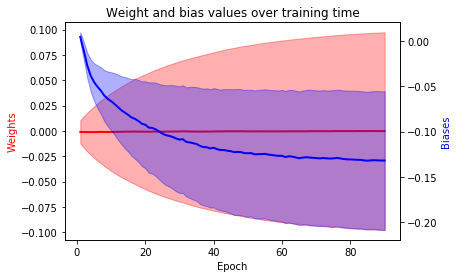

In [10]:
wts_mean = np.array(model_info['weights']['mean'])
wts_var = np.array(model_info['weights']['var'])
bias_mean = np.array(model_info['biases']['mean'])
bias_var = np.array(model_info['biases']['var'])

fig, wts_ax = plt.subplots()
wts_ax.plot(epoch_range, wts_mean, color = train_col, linewidth = 2)
wts_ax.fill_between(epoch_range,
    wts_mean - wts_var, wts_mean + wts_var,
    alpha = 0.35, edgecolor = train_col, facecolor = train_err_col
)
wts_ax.set_xlabel('Epoch')
wts_ax.set_ylabel('Weights', color = train_col)

bias_ax = wts_ax.twinx()
bias_ax.plot(epoch_range, bias_mean, color = val_col, linewidth = 2)
bias_ax.fill_between(epoch_range,
    bias_mean - bias_var, bias_mean + bias_var,
    alpha = 0.35, edgecolor = val_col, facecolor = val_err_col
)
bias_ax.set_ylabel('Biases', color = val_col)

plt.title('Weight and bias values over training time')

Text(0.5,1,'Max absolute weight and bias values over training time')

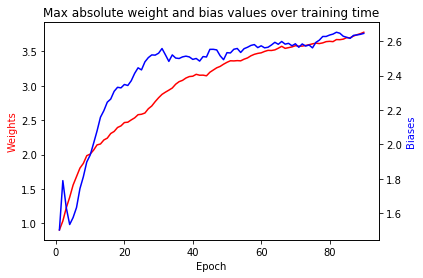

In [11]:
wts_absmax = np.array(model_info['weights']['abs max'])
bias_absmax = np.array(model_info['biases']['abs max'])

fig, wts_ax = plt.subplots()
wts_ax.plot(epoch_range, wts_absmax, color = train_col)
wts_ax.set_xlabel('Epoch')
wts_ax.set_ylabel('Weights', color = train_col)

bias_ax = wts_ax.twinx()
bias_ax.plot(epoch_range, bias_absmax, color = val_col)
bias_ax.set_ylabel('Biases', color = val_col)

plt.title('Max absolute weight and bias values over training time')

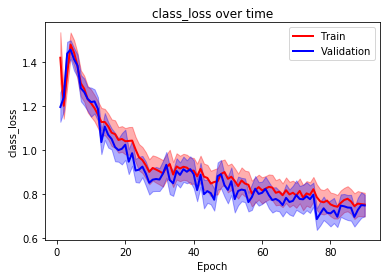

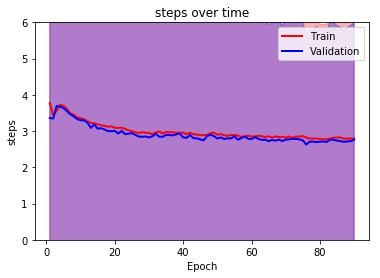

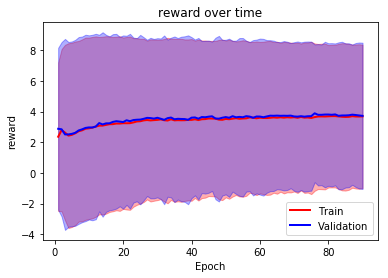

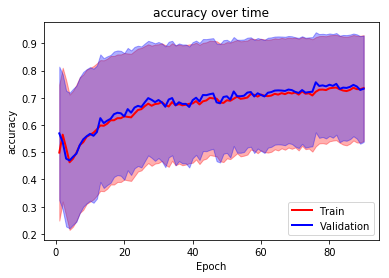

In [12]:
things_to_plot = ['class_loss', 'steps', 'reward', 'accuracy']
for thing in things_to_plot:
    train_avg = np.array([info['averages'][thing] for info in train_info['stats']])
    train_err = np.array([np.var(info['histories'][thing]) for info in train_info['stats']])
    
    val_avg = np.array([info['averages'][thing] for info in val_info['stats']])
    val_err = np.array([np.var(info['histories'][thing]) for info in val_info['stats']])
    
    plt.plot(epoch_range, train_avg, color = train_col, linewidth = 2)
    plt.plot(epoch_range, val_avg, color = val_col, linewidth = 2)
    plt.fill_between(epoch_range,
        train_avg - train_err, train_avg + train_err, alpha = 0.35,
        edgecolor = train_col, facecolor = train_err_col
    )
    plt.fill_between(epoch_range,
        val_avg - val_err, val_avg + val_err, alpha = 0.35,
        edgecolor = val_col, facecolor = val_err_col
    )
    if thing == 'steps':
        plt.ylim([0, 6])
    plt.legend(['Train', 'Validation'], loc = 'upper right' if thing in ['class_loss', 'steps'] else 'lower right')
    plt.xlabel('Epoch'); plt.ylabel(thing)
    plt.title('%s over time' % thing)
    plt.show()
    print('')

Text(0.5,1,'Gradient norms over training time')

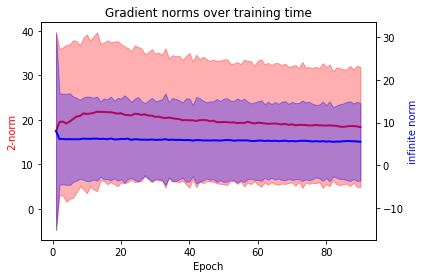

In [13]:
# Gradient stats
grad_2norm = np.array([info['averages']['grad_2norm'] for info in train_info['stats']])
grad_inf_norm = np.array([info['averages']['grad_inf_norm'] for info in train_info['stats']])
grad_2norm_err = np.array([np.var(info['histories']['grad_2norm']) for info in train_info['stats']])
grad_inf_norm_err = np.array([np.var(info['histories']['grad_inf_norm']) for info in train_info['stats']])

fig, pnorm_ax = plt.subplots()
pnorm_ax.plot(epoch_range, grad_2norm, color = train_col, linewidth = 2)
pnorm_ax.fill_between(epoch_range,
    grad_2norm - grad_2norm_err, grad_2norm + grad_2norm_err,
    alpha = 0.35, edgecolor = train_col, facecolor = train_err_col
)
pnorm_ax.set_xlabel('Epoch');
pnorm_ax.set_ylabel('2-norm', color = train_col)

infnorm_ax = pnorm_ax.twinx()
infnorm_ax.plot(epoch_range, grad_inf_norm, color = val_col, linewidth = 2)
infnorm_ax.fill_between(epoch_range,
    grad_inf_norm - grad_inf_norm_err, grad_inf_norm + grad_inf_norm_err,
    alpha = 0.35, edgecolor = val_col, facecolor = val_err_col
)
infnorm_ax.set_ylabel('infinite norm', color = val_col)

plt.title('Gradient norms over training time')